Python module to perform machine learning on the ST data and to visualize the results. This script was used on the 4 slides of the patient 34. The segmentation was made with KimiaNet.

# Import

In [33]:
import anndata as ad
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os
import seaborn as sns
from seaborn import objects as so
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.image as mpimg
import umap.umap_ as umap
from sklearn.preprocessing import MinMaxScaler
import scanpy as sc

# Input

An AnnData object containing a dataset where each row is a tile and each column is a feature (extracted from the image by segmentation). The AnnData object contains also a obs where you can find pathologist's annotation and the path to each tile. Moreover, you can find the segmentation data processed with a PCA in the obsm part of the AnnData object.

In [36]:
adataA = ad.read_h5ad('/disk2/user/cormey/outputs/Segmentation_objects/34A_Kimia.h5ad')
adataB = ad.read_h5ad('/disk2/user/cormey/outputs/Segmentation_objects/34B_Kimia.h5ad')
adataC = ad.read_h5ad('/disk2/user/cormey/outputs/Segmentation_objects/34C_Kimia.h5ad')
adataD = ad.read_h5ad('/disk2/user/cormey/outputs/Segmentation_objects/34D_Kimia.h5ad')

adataA.obs['batch'] = 'batch_A'
adataB.obs['batch'] = 'batch_B'
adataC.obs['batch'] = 'batch_C'
adataD.obs['batch'] = 'batch_D'

adata = ad.concat([adataA, adataB, adataC, adataD])
adata.obs_names_make_unique

sc.pp.combat(adata, key='batch')

/disk2/user/cormey/miniconda3/envs/my_env03/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [39]:
#Remove out cells from the dataset
# Define the cell type to filter out
cell_type_to_remove = 'Out'

# Create a boolean mask for rows where the cell type is not 'out'
mask = adata.obs['annotation'] != cell_type_to_remove

# Apply the mask to subset the AnnData object
adata = adata[mask, :]

# Output

Some graphs to visualize the performance of the machine learning and the quality of the features extracted by segmentation

# Visualize the AnnData object

In [40]:
adata

View of AnnData object with n_obs × n_vars = 9390 × 1024
    obs: 'annotation', 'barcode', 'batch'

In [41]:
print(adata.var_names)

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9',
       ...
       '1014', '1015', '1016', '1017', '1018', '1019', '1020', '1021', '1022',
       '1023'],
      dtype='object', length=1024)


In [42]:
print(adata.X[:10, :20])

[[ 5.30632205e-02  1.13557663e-01  1.82794172e-01 -5.64459323e-01
   6.55533469e-01  6.83571605e-01  6.97022499e-02  1.56927256e-01
  -7.40280856e-02  6.55390002e-02 -1.82450024e-01  1.58994199e-03
   1.20352883e-01  3.80655486e-02 -6.70987999e-02 -2.55099336e-01
   8.55469317e-02  7.35473875e-01 -6.99277296e-02  2.08979254e-01]
 [ 5.53511591e-02  1.55282123e-01  2.34337040e-01 -6.12962529e-01
   5.00856295e-01 -3.24512311e-01  8.74986377e-02  1.54219297e-01
  -3.62813382e-01  8.57212015e-03 -1.46919674e-01  4.84089153e-03
   1.14947918e-01  4.15921159e-04 -6.66380727e-02 -2.37023064e-01
   1.04383054e-01  4.35289017e-01  3.24974484e-02  1.90062029e-01]
 [ 6.44050715e-02  1.43925430e-01  1.39178742e-01 -4.82399909e-01
   4.04626115e-01  1.11629541e+00  7.31145656e-02  1.56503709e-01
  -2.16175166e-01 -4.39392243e-03 -5.86541889e-02  5.17845036e-02
   1.12104935e-01  1.56779102e-02 -7.32921705e-02 -2.28518458e-01
   1.33778004e-01  4.53465533e-01 -3.73123135e-02  2.04761800e-01]
 [ 6.91

In [43]:
adata.obs.head()

,annotation,barcode,batch
0,Mixed,AAACAAGTATCTCCCA-1,batch_A
1,Benign breast,AAACAATCTACTAGCA-1,batch_A
2,Stroma,AAACACCAATAACTGC-1,batch_A
3,Mixed,AAACAGAGCGACTCCT-1,batch_A
4,Stroma,AAACAGTGTTCCTGGG-1,batch_A


# Visualize the PCA

In [44]:
X=adata.X

# Create an PCA object with the number of wanted principal componants
pca = PCA(n_components=5)  # 5 PC

# Perform the PCA on the matrix X
reduced_features = pca.fit_transform(X)

# Check the results
print("Shape of reduced features:", reduced_features.shape)


Shape of reduced features: (9390, 5)


In [45]:
#See how much each components explain the total variance of the dataset

explained_variance_ratio = pca.explained_variance_ratio_

# Display results
for i, variance in enumerate(explained_variance_ratio):
    print(f"Principal component {i+1}: {variance:.2%} of the variance")

Principal component 1: 43.67% of the variance
Principal component 2: 9.56% of the variance
Principal component 3: 8.28% of the variance
Principal component 4: 5.15% of the variance
Principal component 5: 3.34% of the variance


In [46]:
#Visualize which variable are influencing the PC

# Stock the PC in a variable
loadings = pca.components_

# Convert the PC in a dataset to have a better readability
pc_loadings = pd.DataFrame(loadings.T, columns=[f'PC{i+1}' for i in range(loadings.shape[0])], index=adata.var_names)
print(pc_loadings)

           PC1       PC2       PC3       PC4       PC5
0     0.000538  0.000713 -0.000129  0.001145 -0.000177
1     0.000207 -0.000811  0.005026  0.000218 -0.002066
2    -0.004493 -0.000706  0.003702  0.009314 -0.000307
3     0.007000  0.003026 -0.005707 -0.006850  0.000964
4    -0.013627 -0.000472 -0.013295  0.012122 -0.016214
...        ...       ...       ...       ...       ...
1019 -0.030990  0.027630  0.045191  0.001955 -0.021971
1020  0.061843  0.007204  0.004864  0.022137  0.072179
1021  0.055709 -0.012157 -0.015014  0.037975 -0.006613
1022  0.047197 -0.005568 -0.014271 -0.004130 -0.013080
1023 -0.007845  0.010378 -0.002258 -0.012639 -0.018647

[1024 rows x 5 columns]


# Visualize with a UMAP

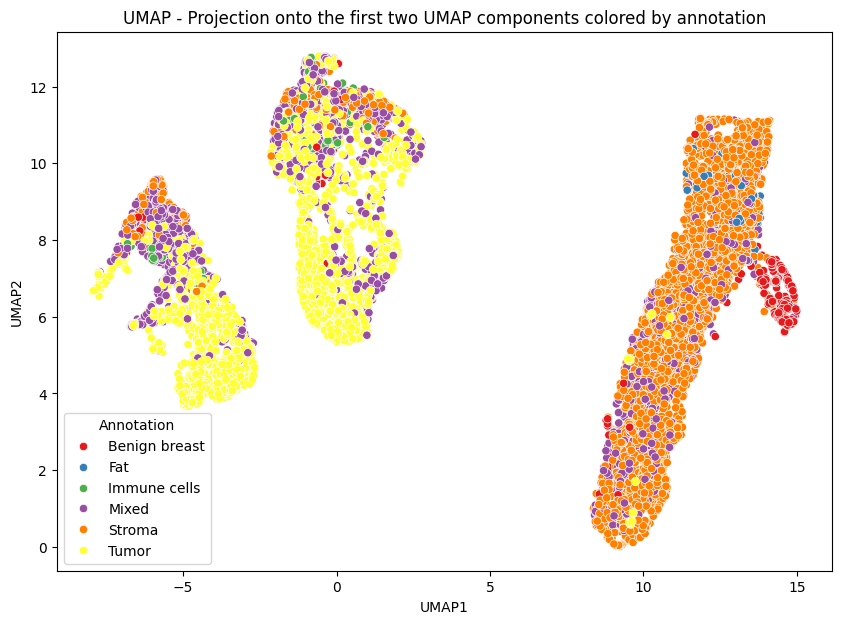

In [47]:
# Load the transcription dataset
X = adata.X
y = adata.obs['annotation']

# Dimensionality reduction with UMAP
reducer = umap.UMAP(n_components=2)
X_umap = reducer.fit_transform(X)

# Convert the UMAP result to a DataFrame for easier data manipulation
df_umap = pd.DataFrame(X_umap, columns=['UMAP1', 'UMAP2'])
df_umap['Label'] = y.values  # Ensure y is correctly assigned

# Scatter plot of the first two UMAP components colored by annotation
plt.figure(figsize=(10, 7))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='Label', palette='Set1', data=df_umap)
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.title('UMAP - Projection onto the first two UMAP components colored by annotation')
plt.legend(title='Annotation')
plt.show()

# Perform the Machine Learning

In [48]:
##Perform a machine learning algorithm on the segmented dataset

labels = adata.obs["annotation"]  # Extraction of pathologist's annotation

# Extract segmentation features and annotation
X = adata.X
y = labels

# Split data in a train dataset and a test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train the classification model
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predict on the test dataset
y_pred = model.predict(X_test)

# Display the classification report
print(classification_report(y_test, y_pred))

               precision    recall  f1-score   support

Benign breast       0.88      0.57      0.69        91
          Fat       0.00      0.00      0.00        26
 Immune cells       0.73      0.36      0.48        44
        Mixed       0.58      0.43      0.49       604
       Stroma       0.80      0.91      0.85      1178
        Tumor       0.84      0.91      0.87       874

     accuracy                           0.78      2817
    macro avg       0.64      0.53      0.57      2817
 weighted avg       0.76      0.78      0.76      2817



/disk2/user/cormey/miniconda3/envs/my_env03/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/disk2/user/cormey/miniconda3/envs/my_env03/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/disk2/user/cormey/miniconda3/envs/my_env03/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

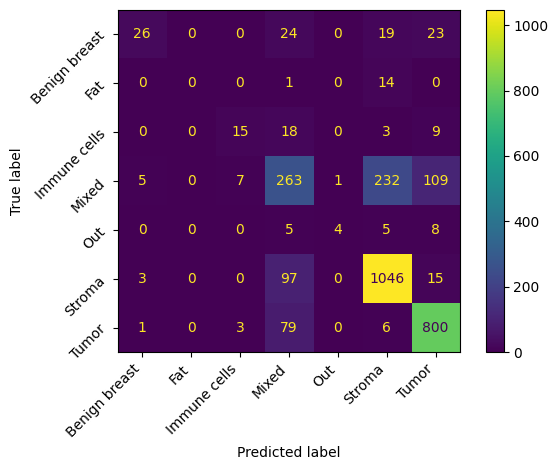

In [18]:
cm = confusion_matrix(y_test, y_pred)

# Display confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
disp.plot()

# Adjust the rotation of the x-axis labels and y-axis labels
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=45)

# Adjust layout to ensure everything fits without overlapping
plt.tight_layout()

# Observe which parameters represent the most each types of cell

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


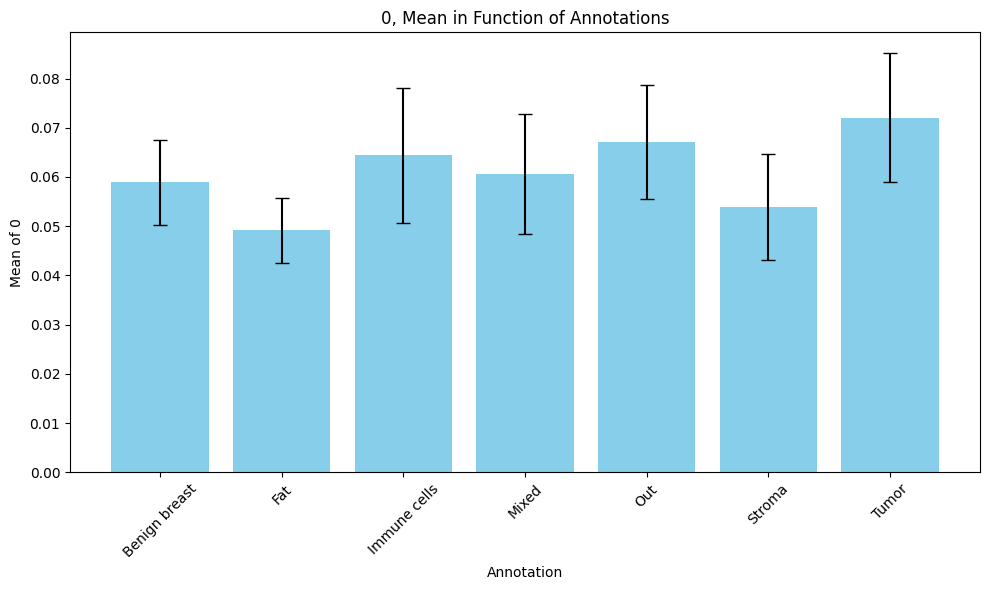

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


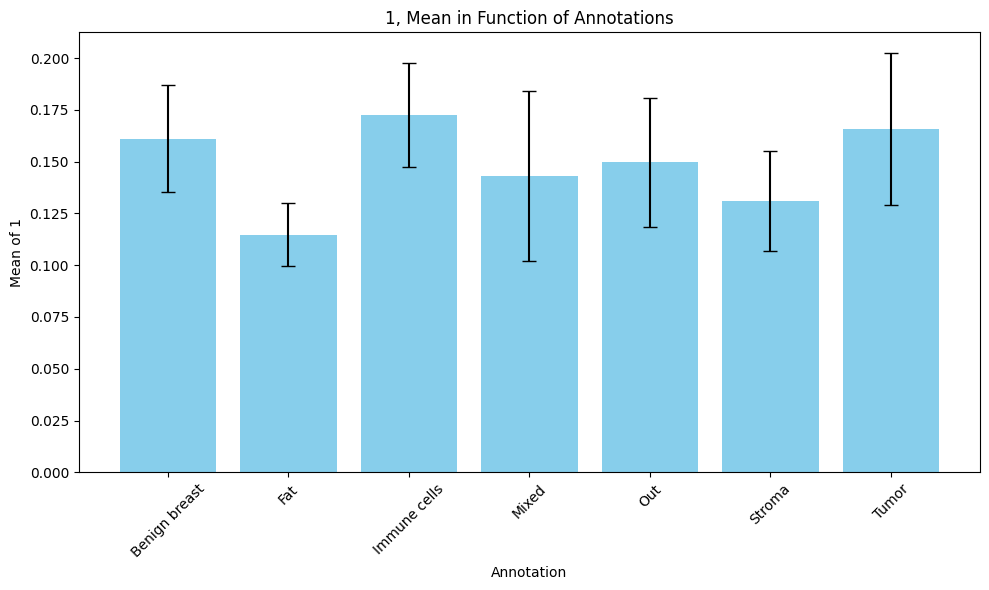

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


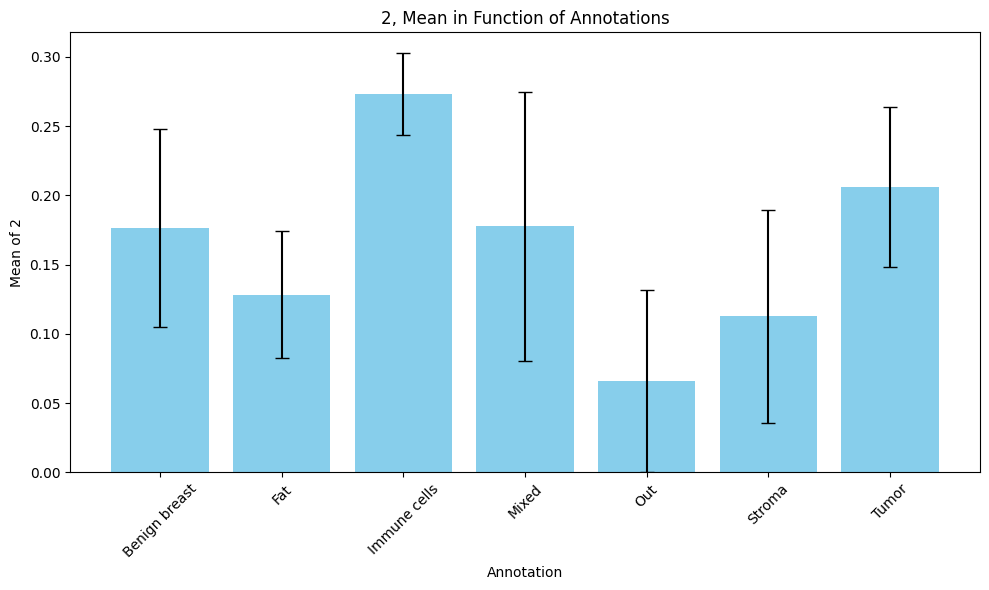

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


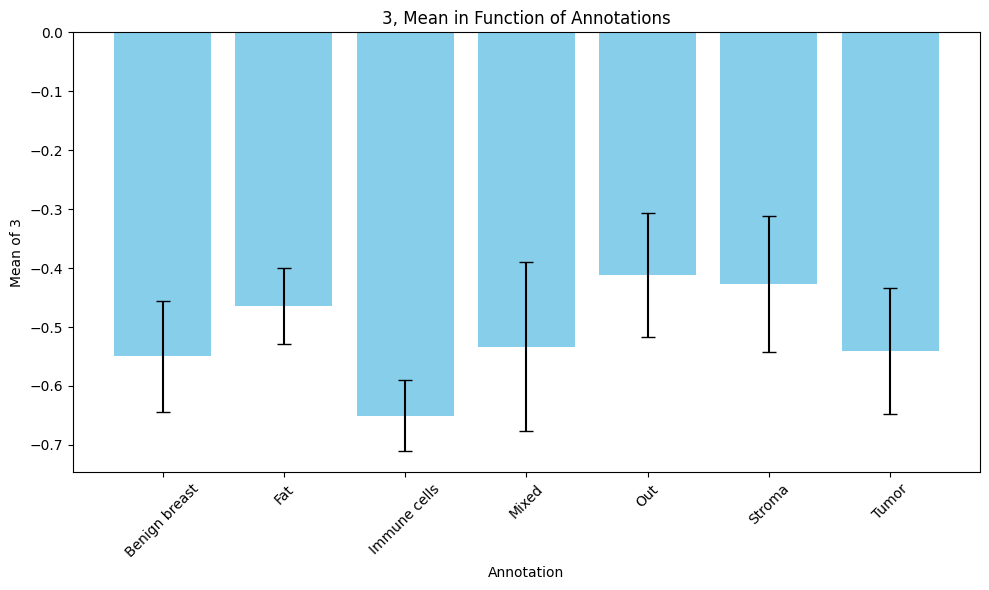

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


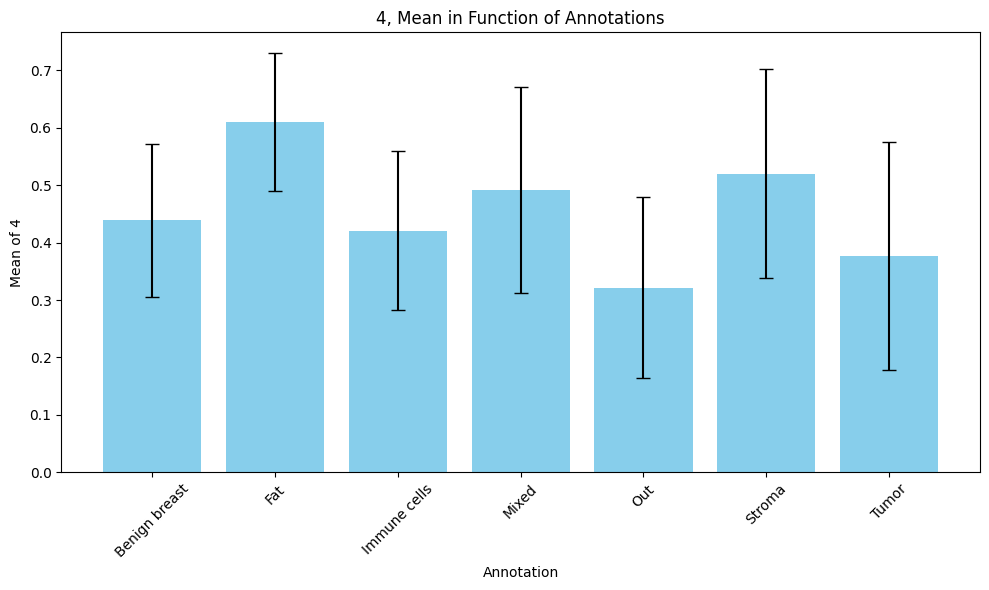

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


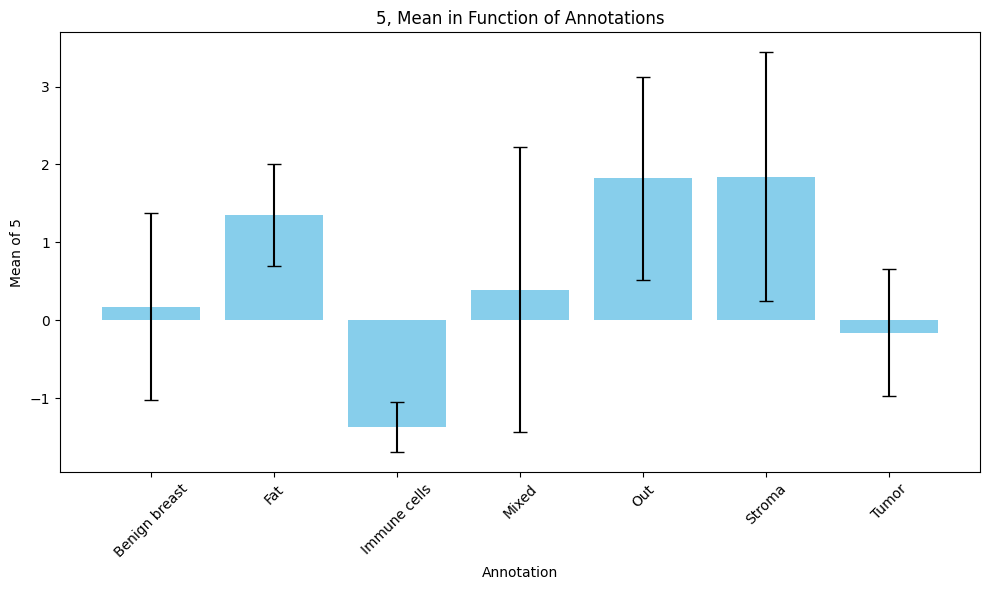

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


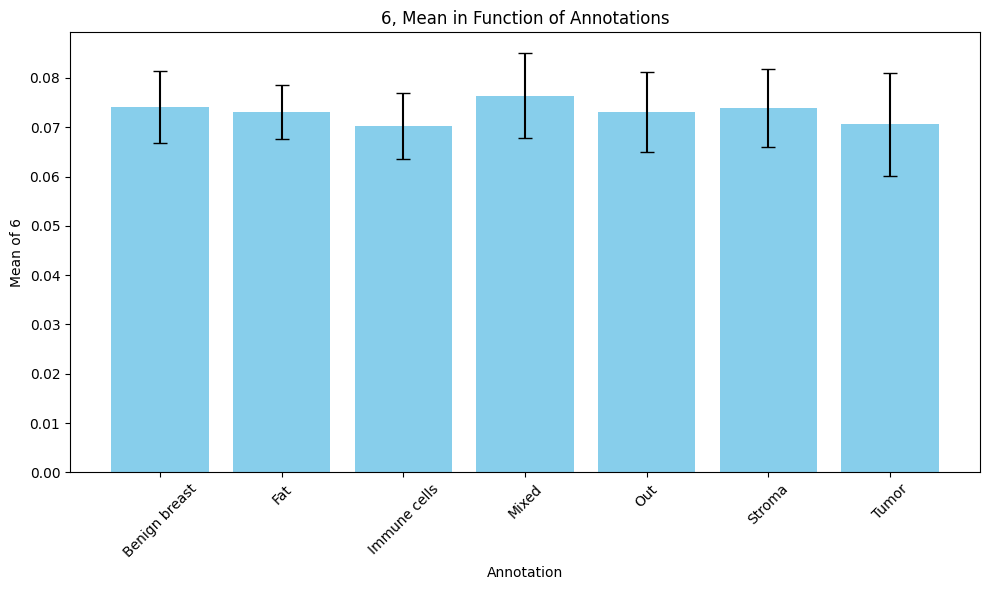

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


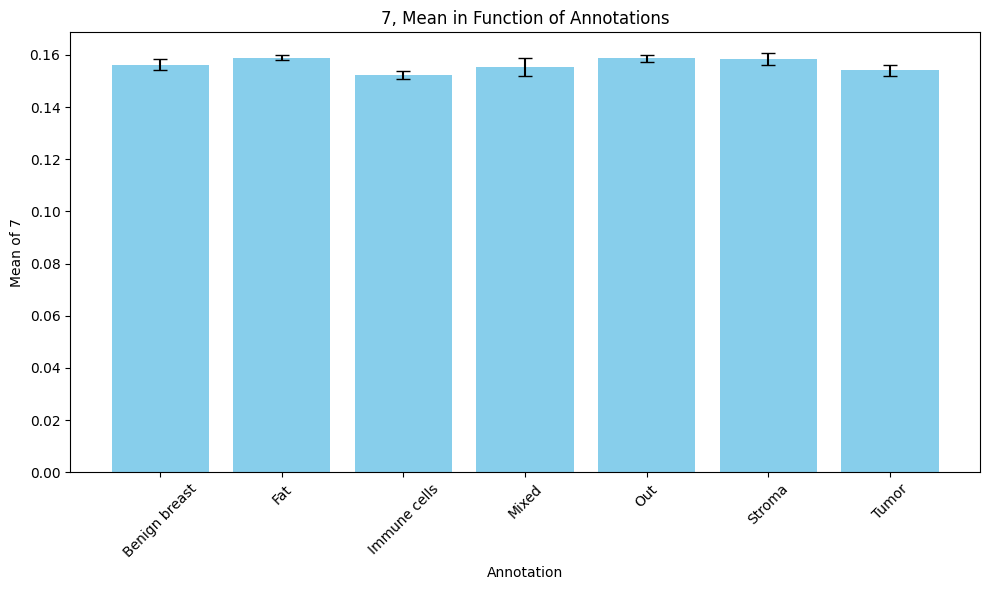

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


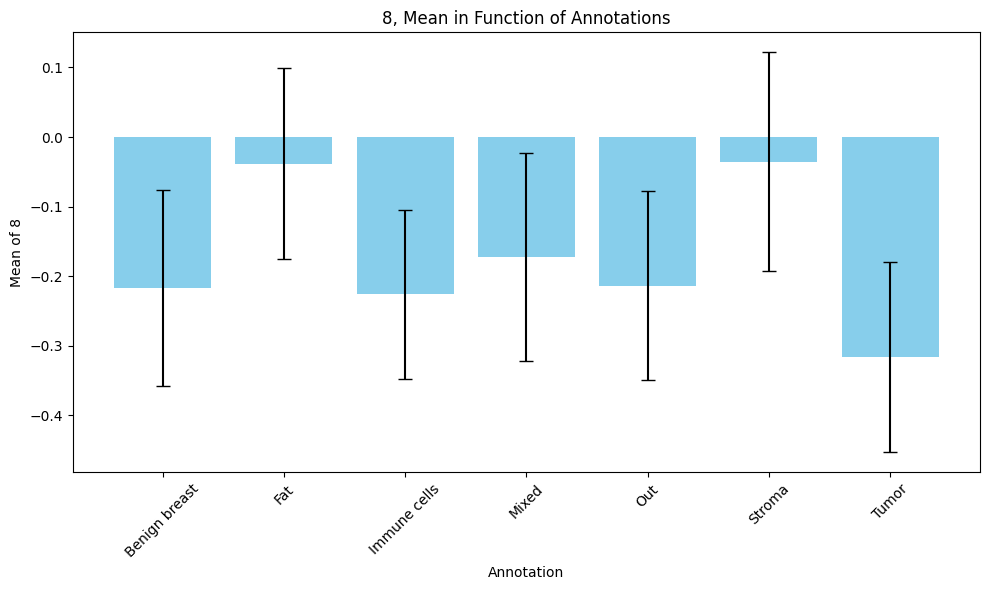

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


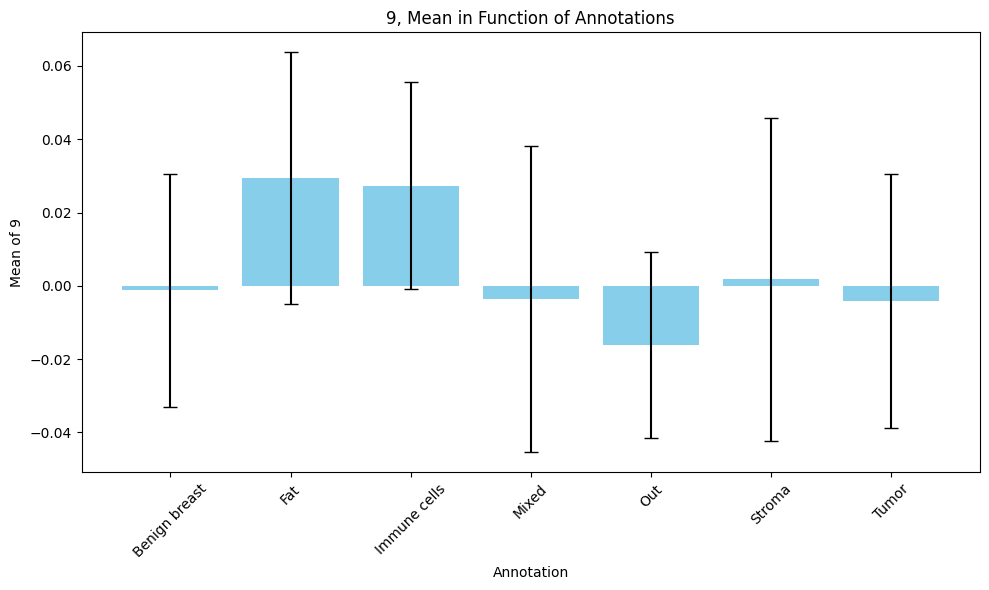

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


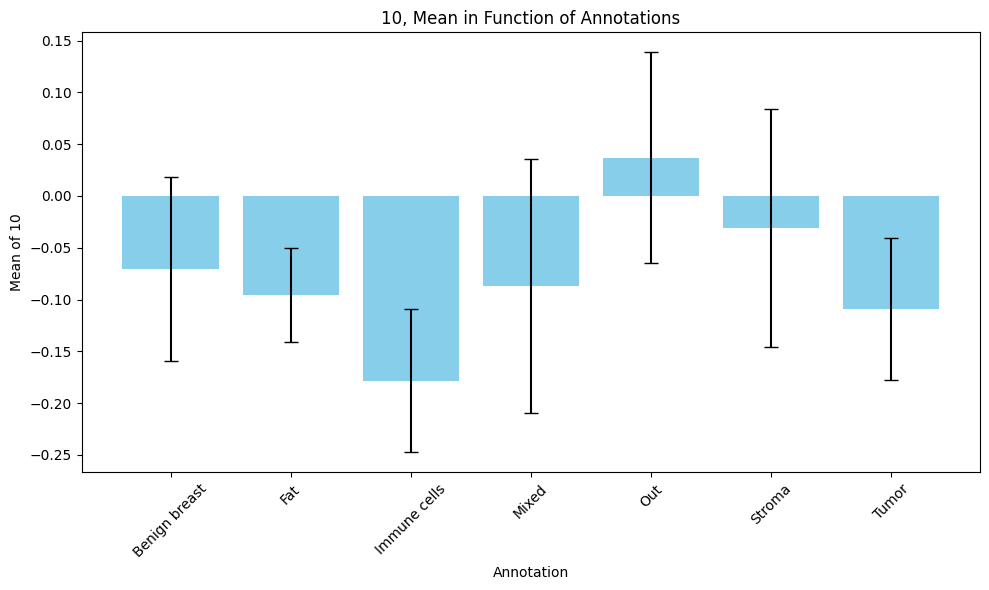

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


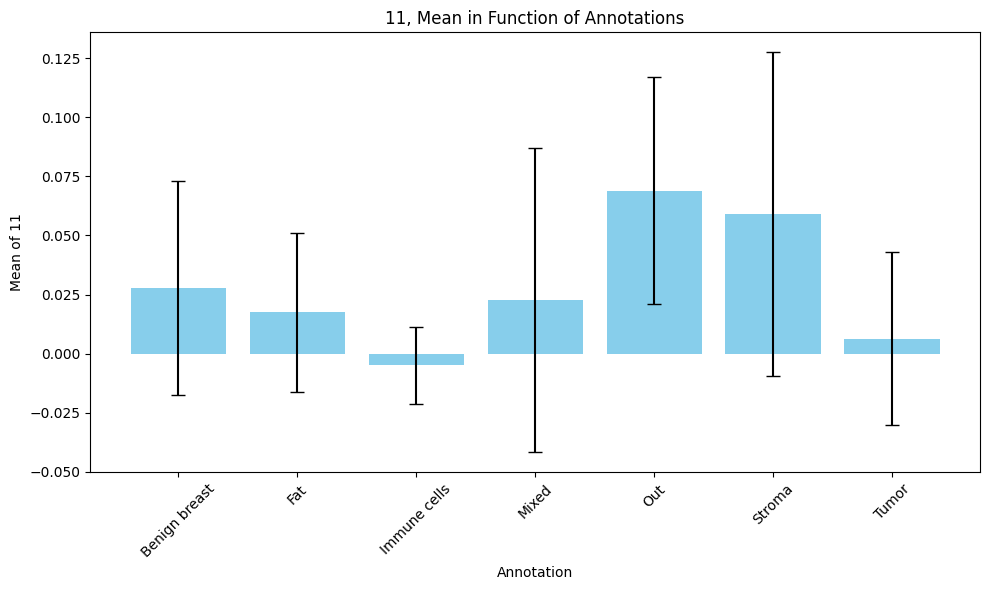

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


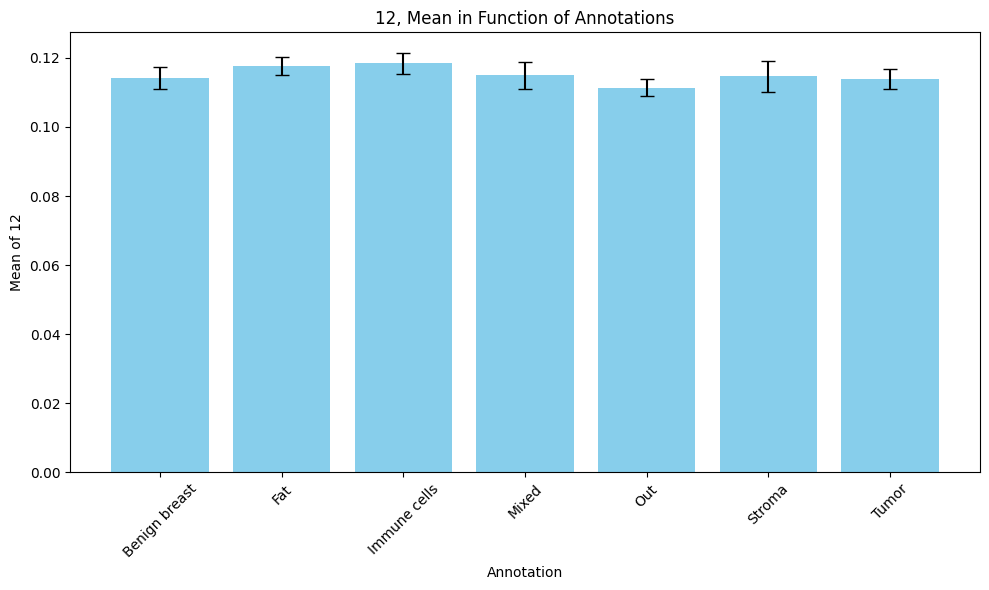

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


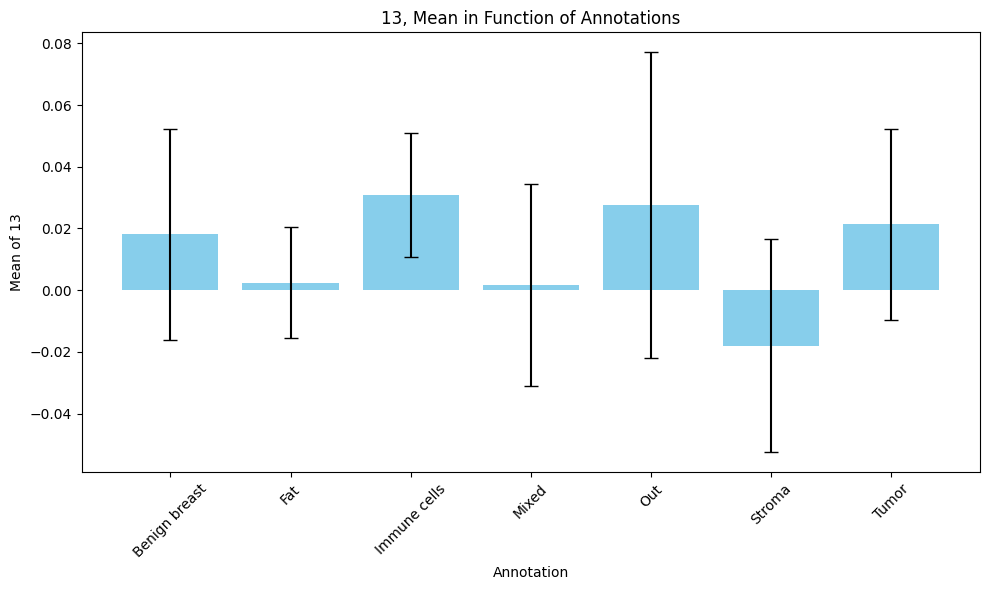

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


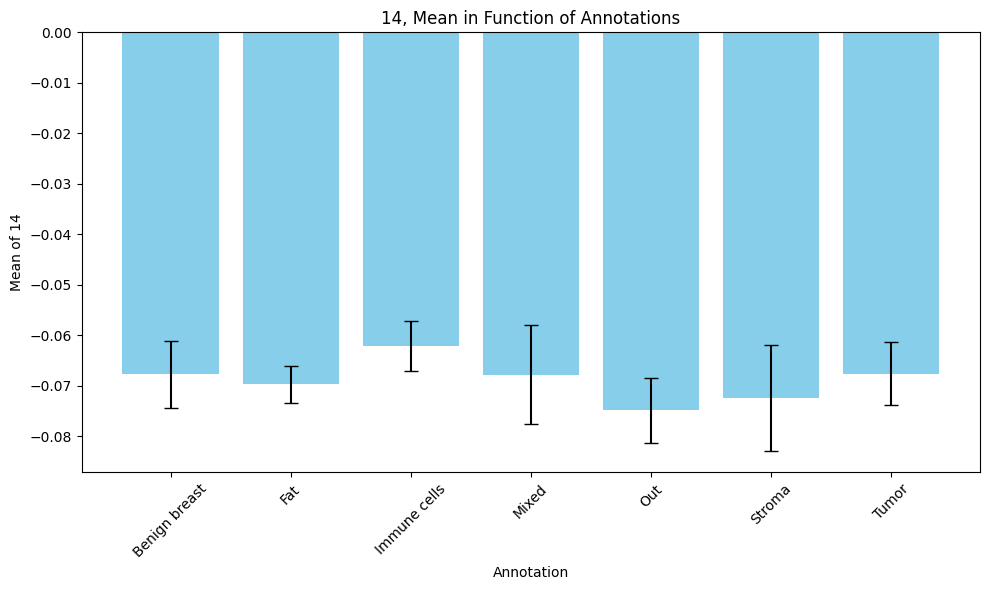

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


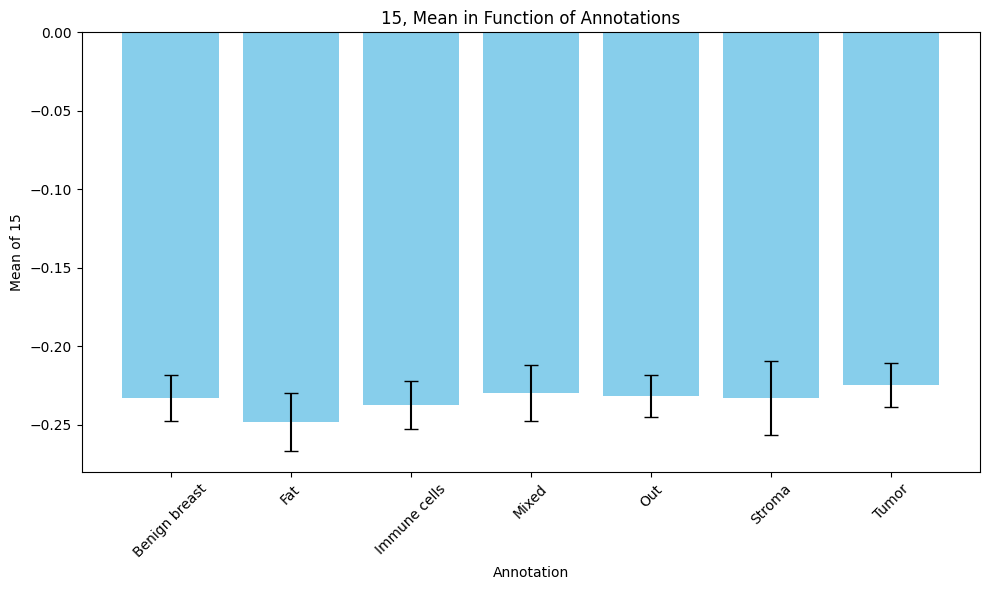

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


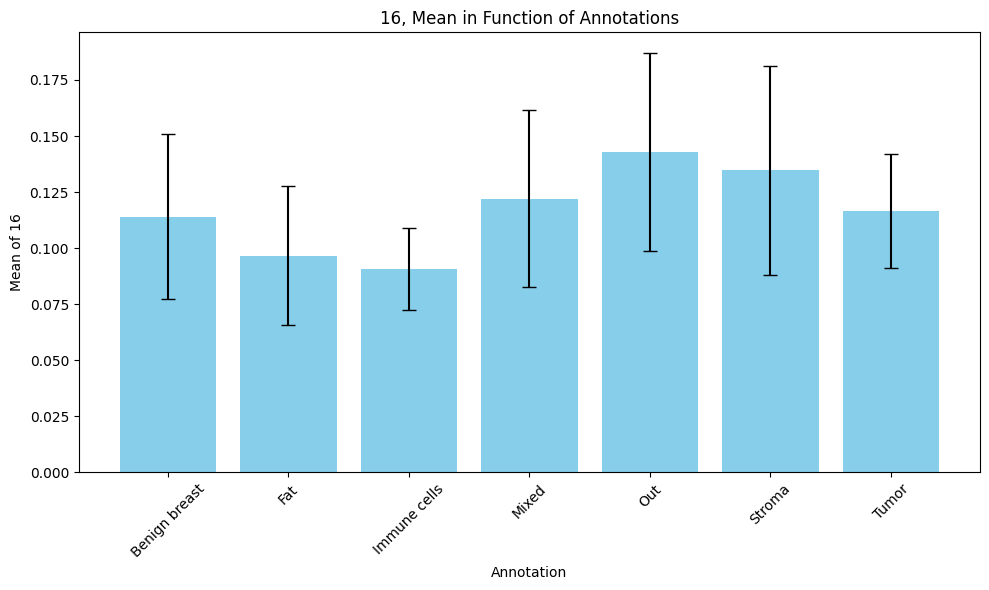

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


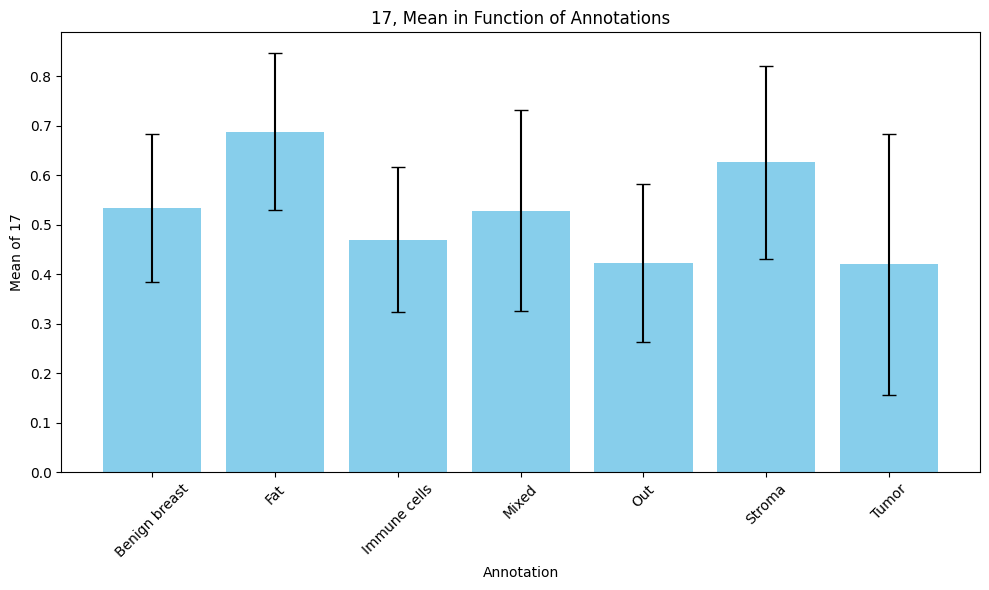

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


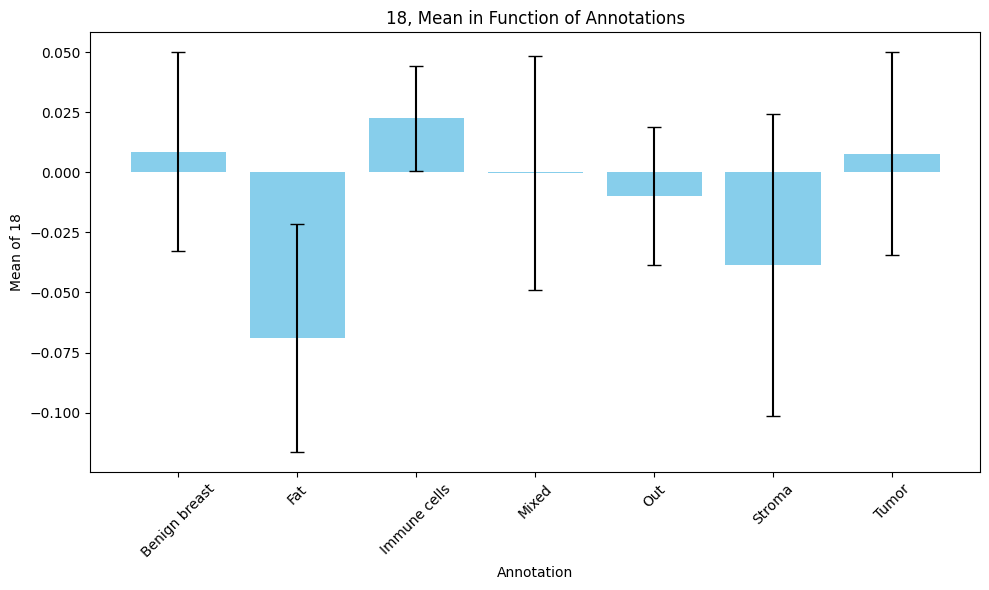

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


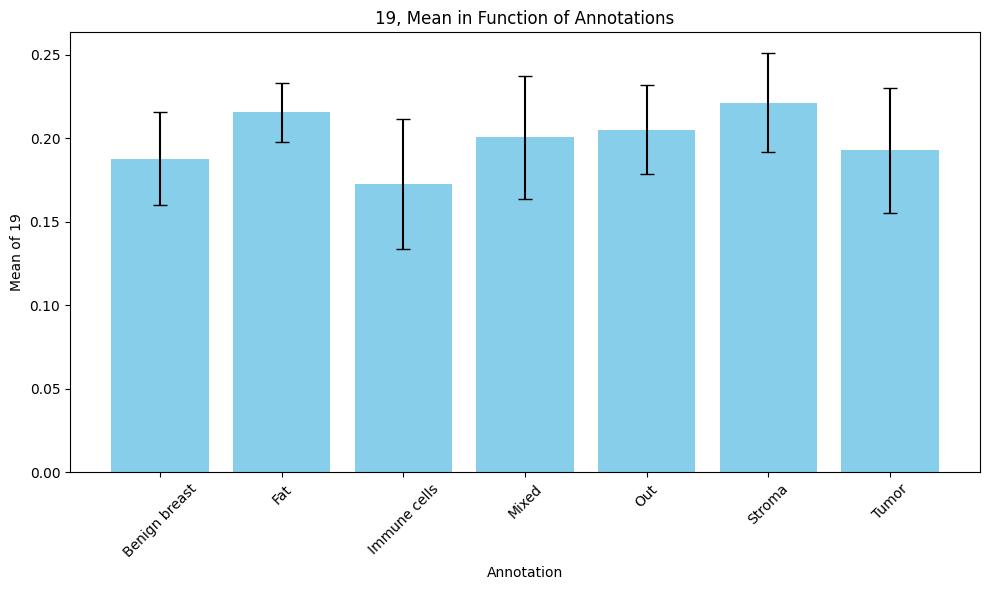

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


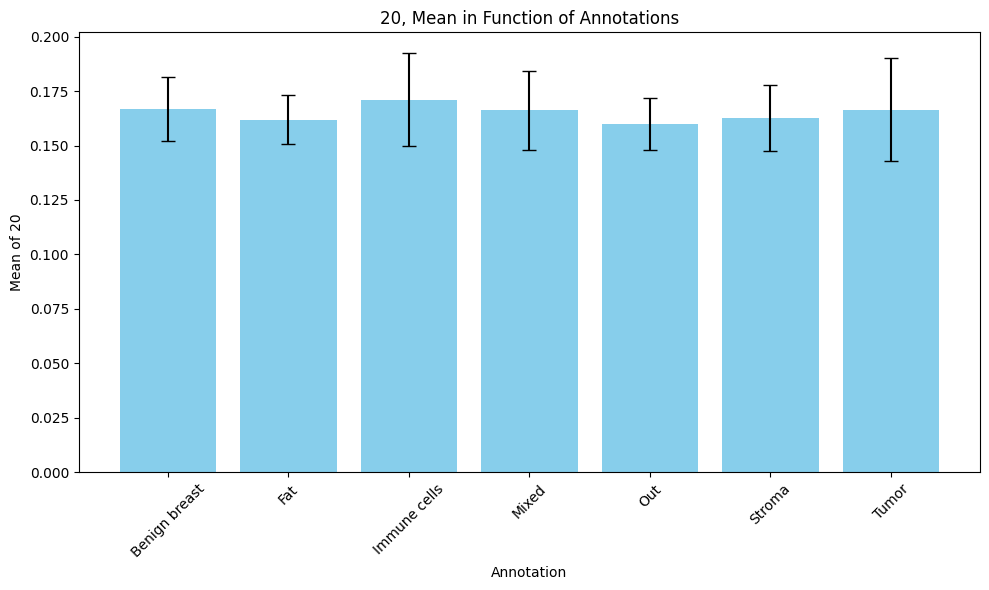

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


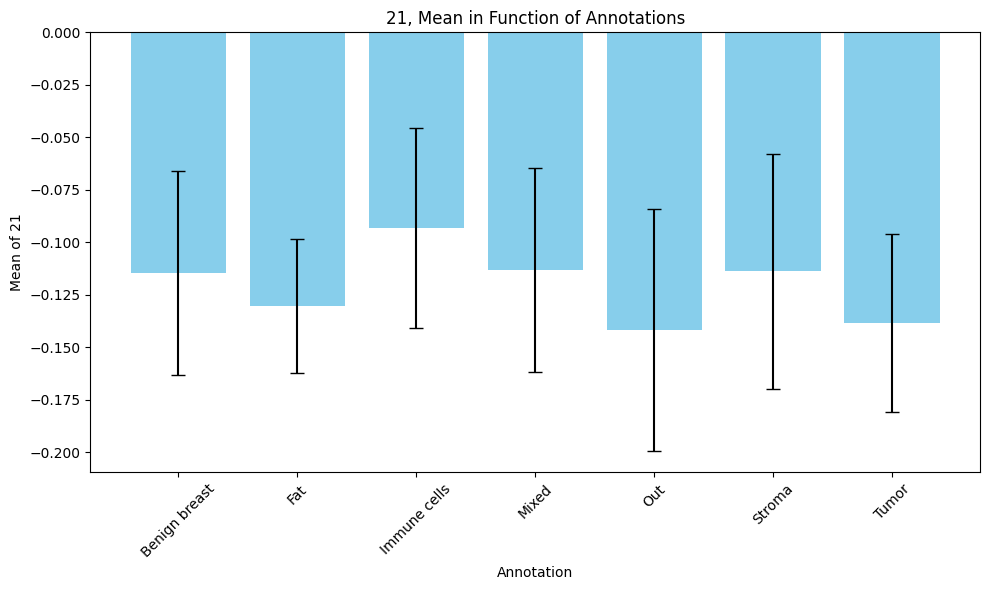

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


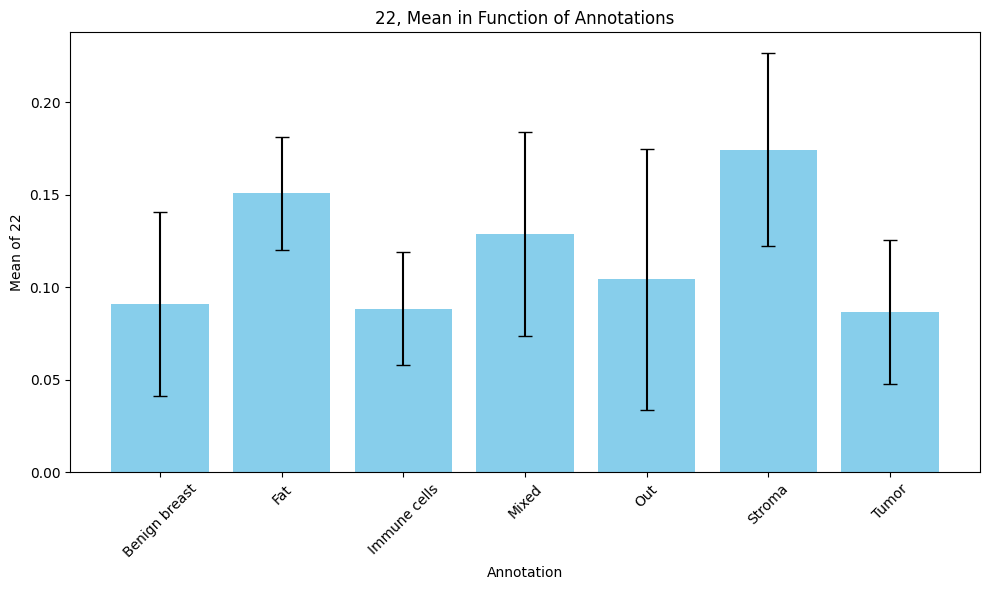

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


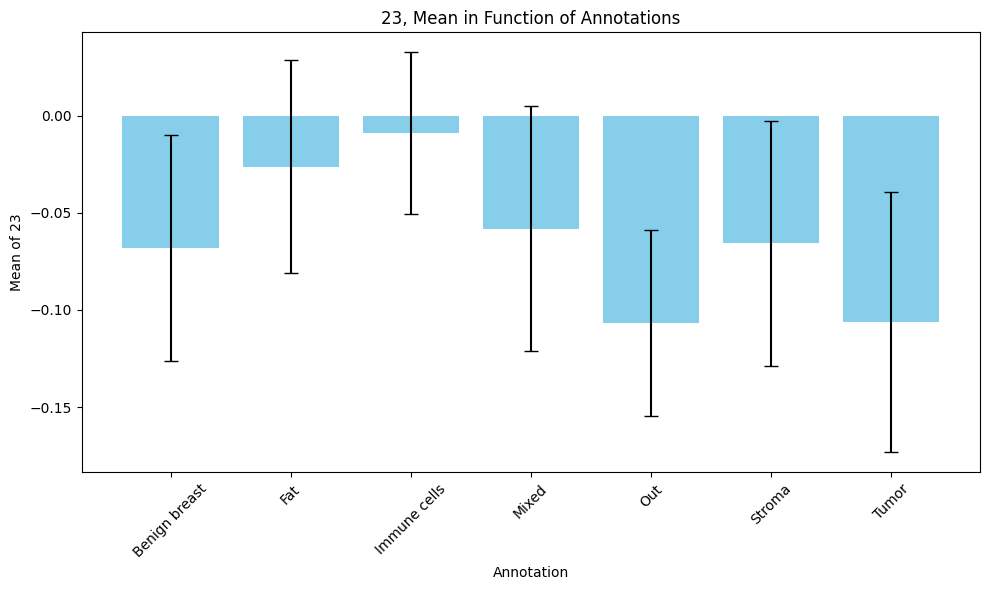

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


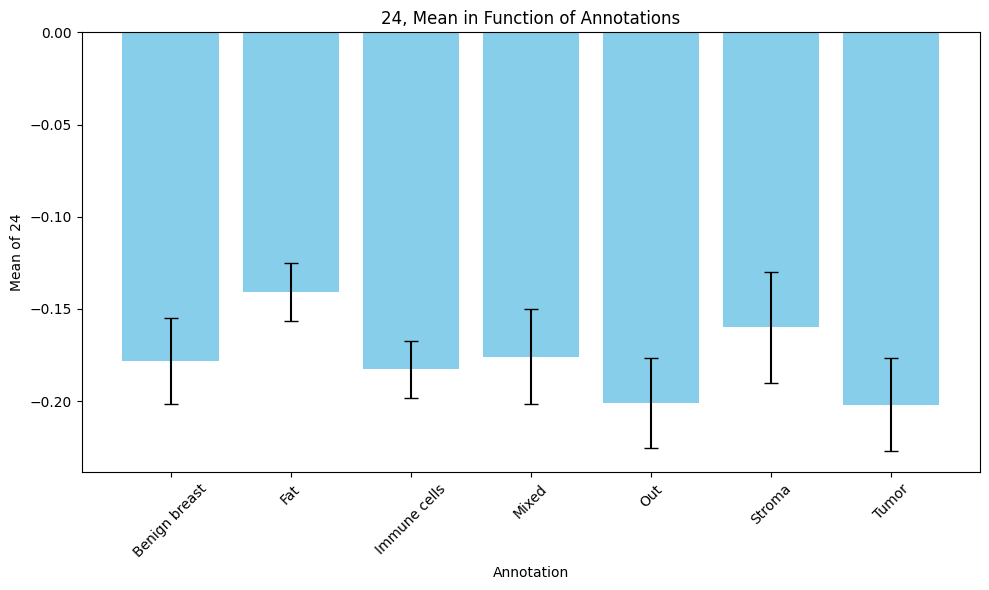

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


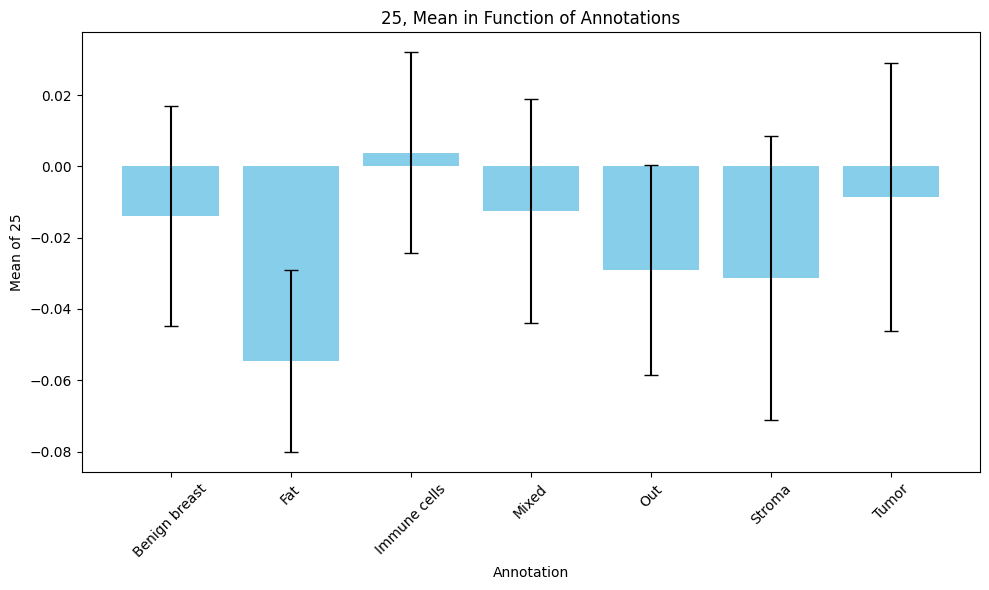

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


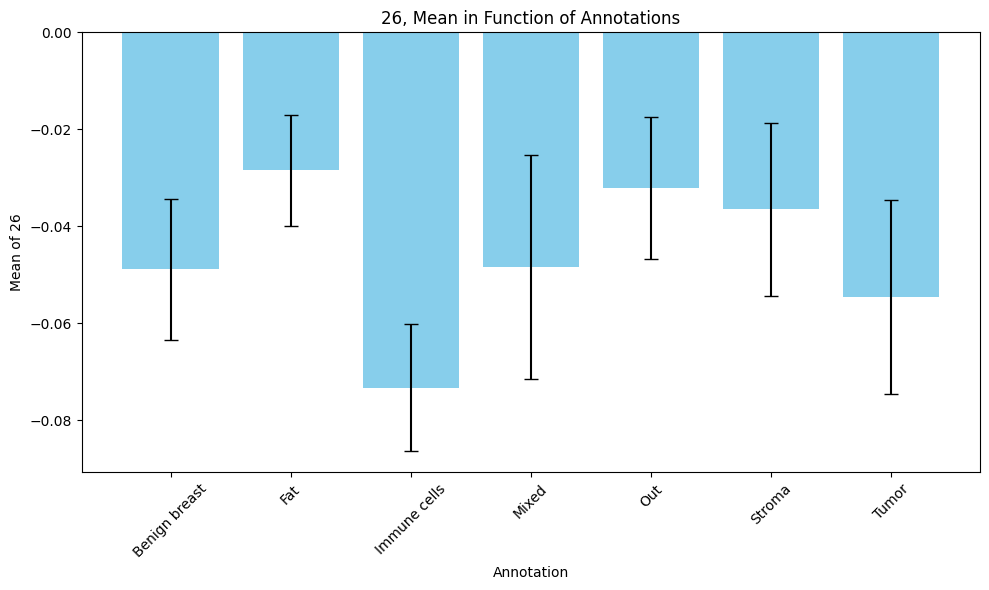

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


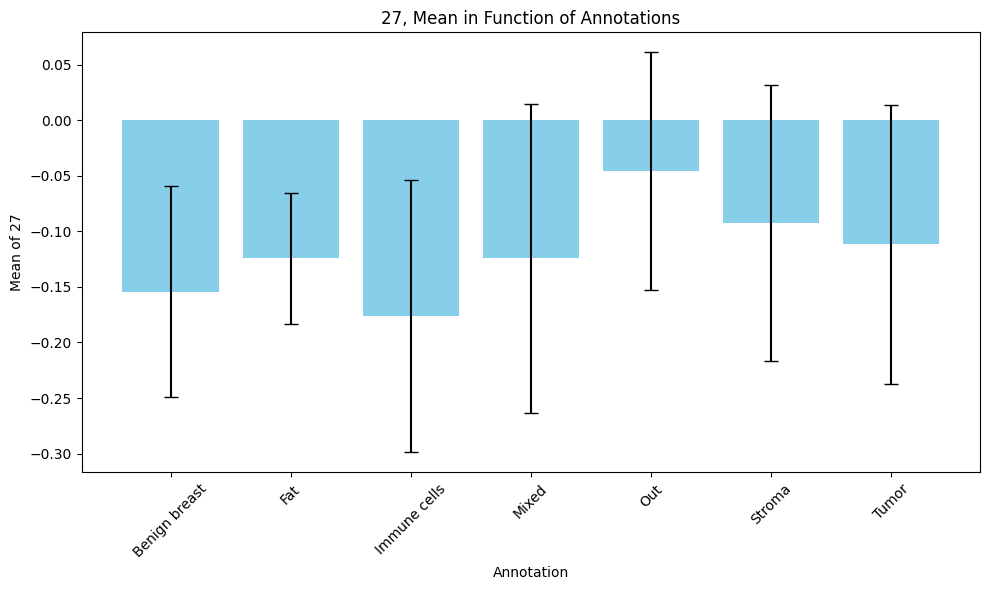

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


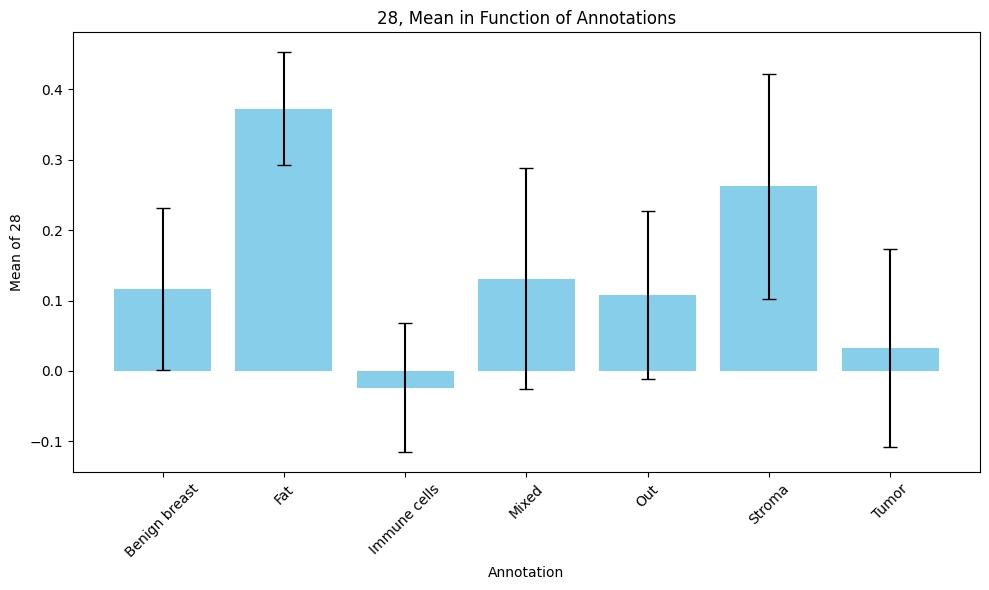

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


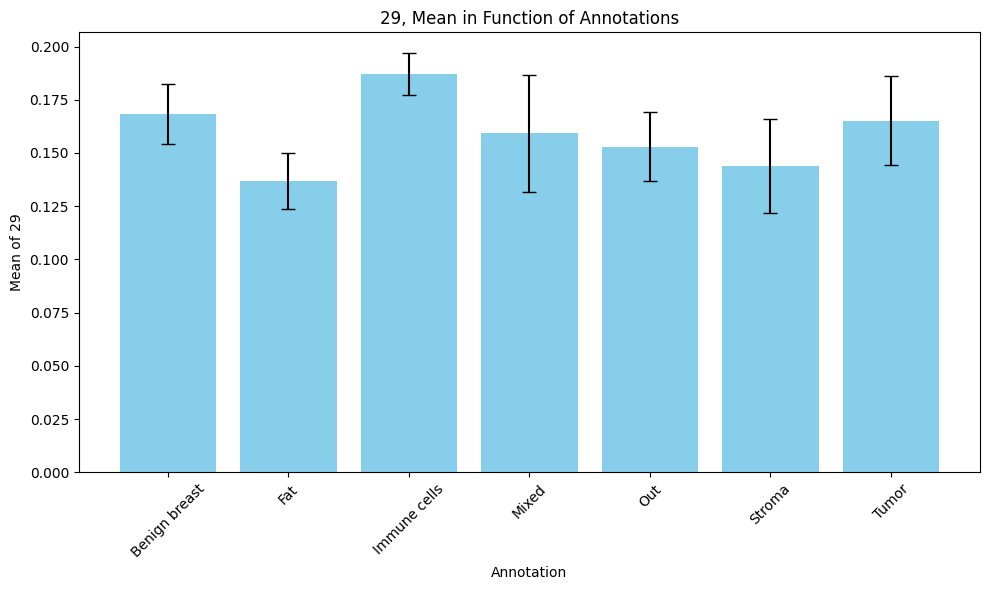

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


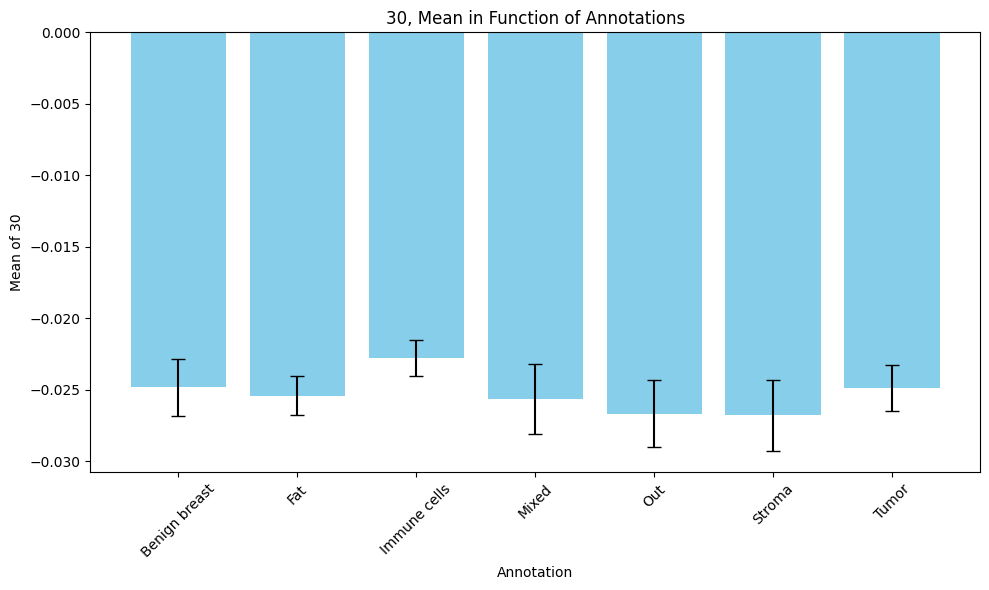

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


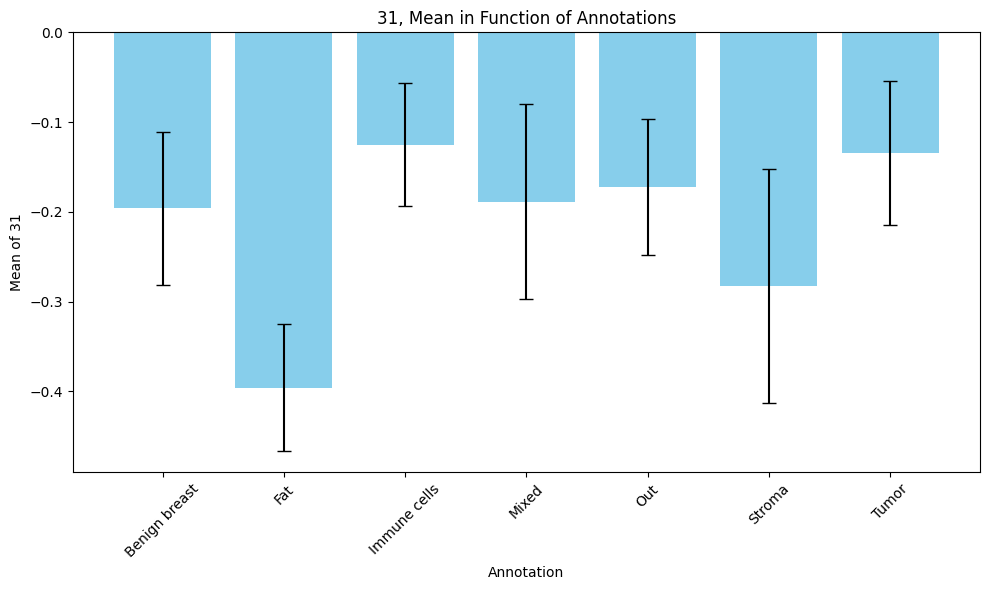

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


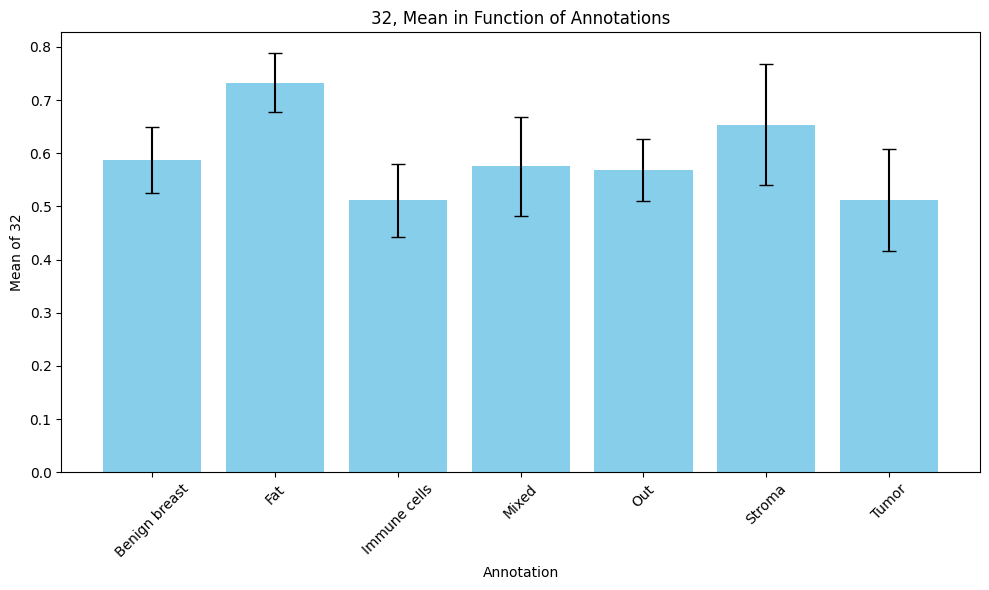

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


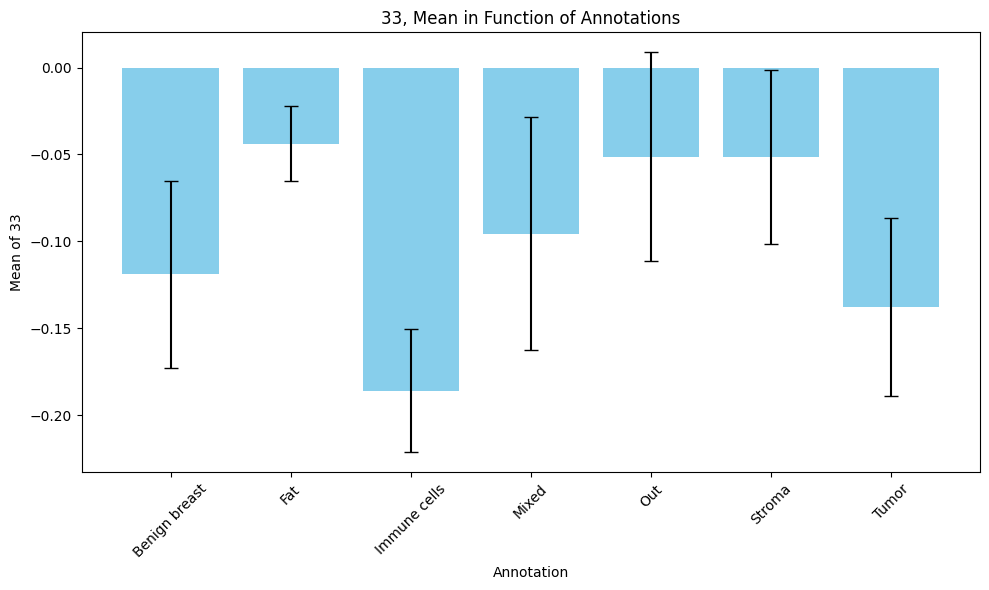

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


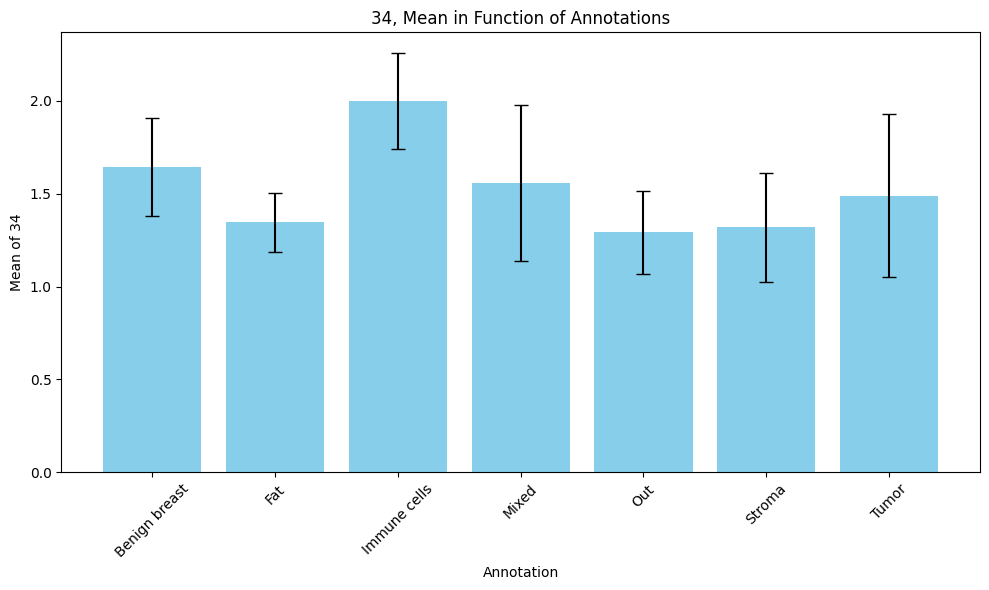

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


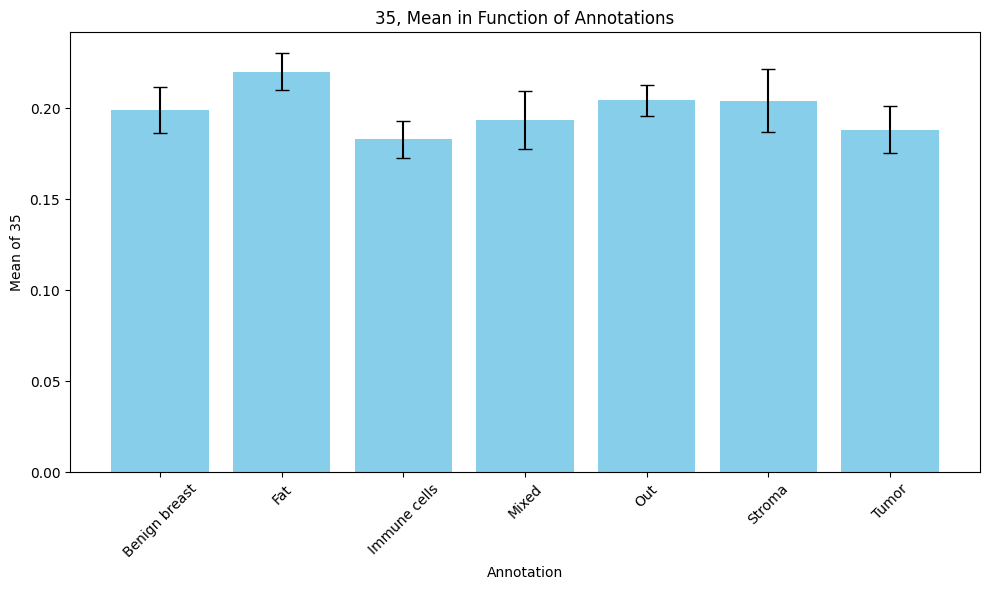

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


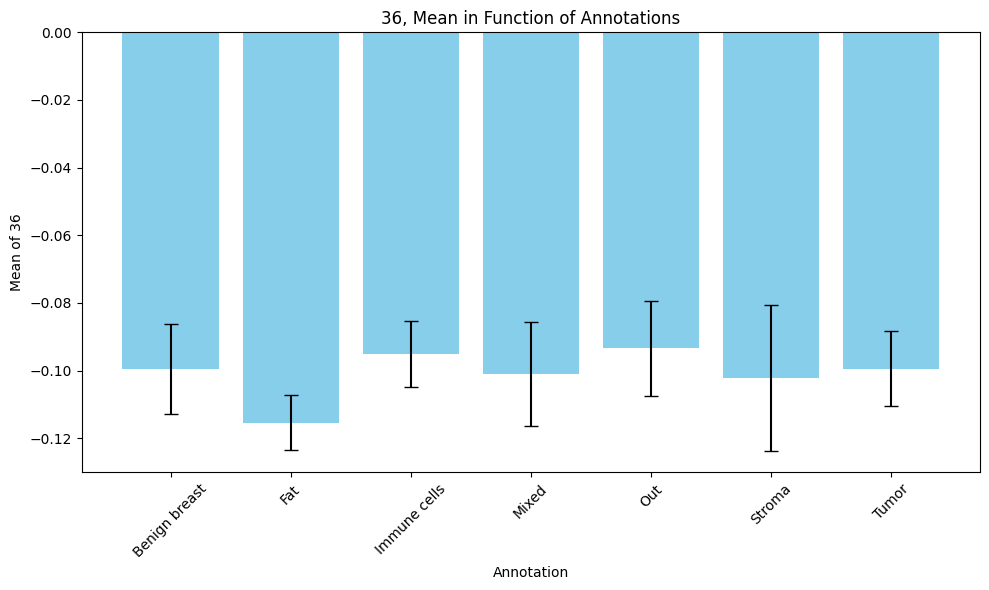

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


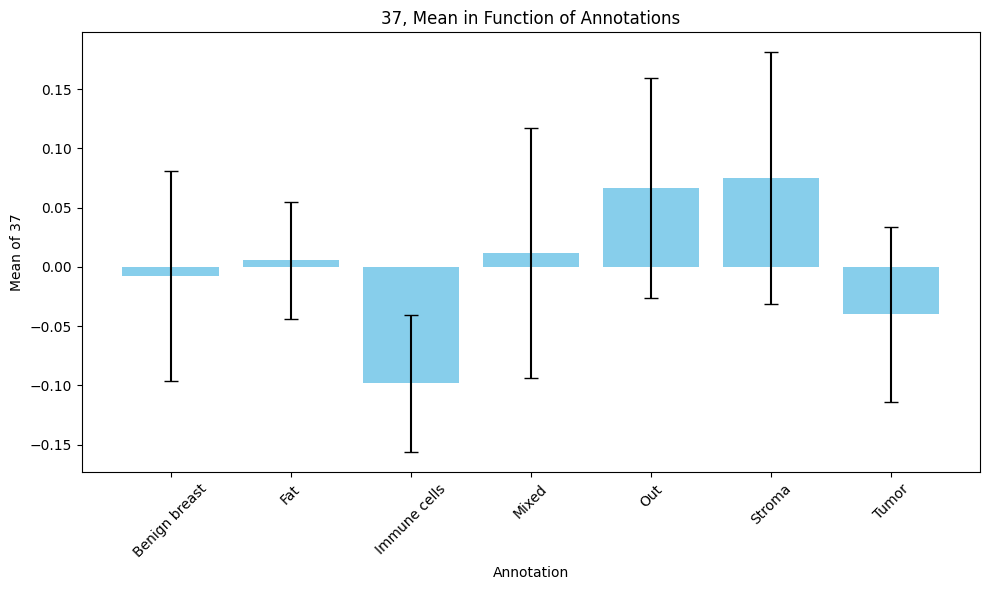

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


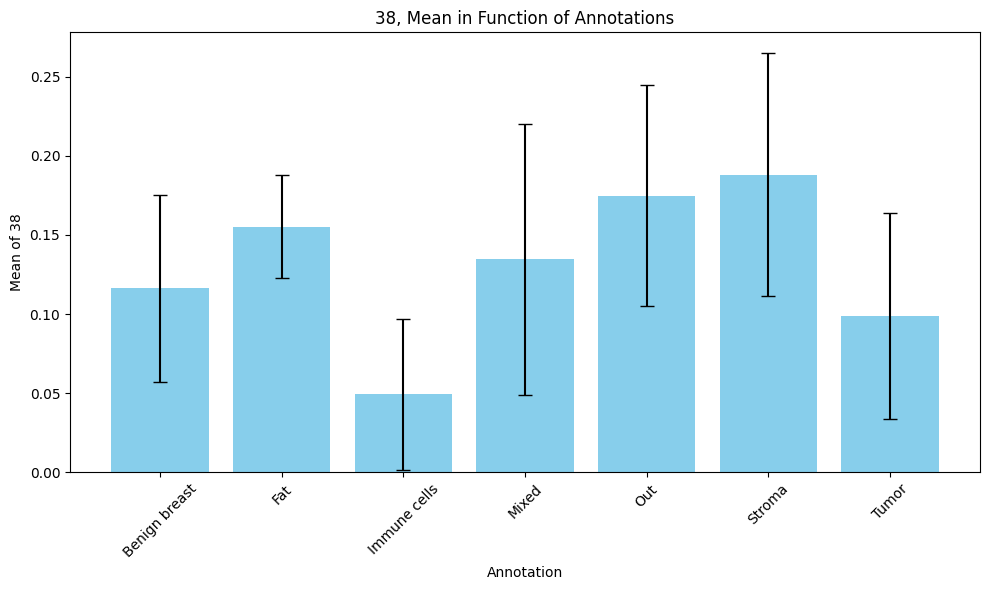

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


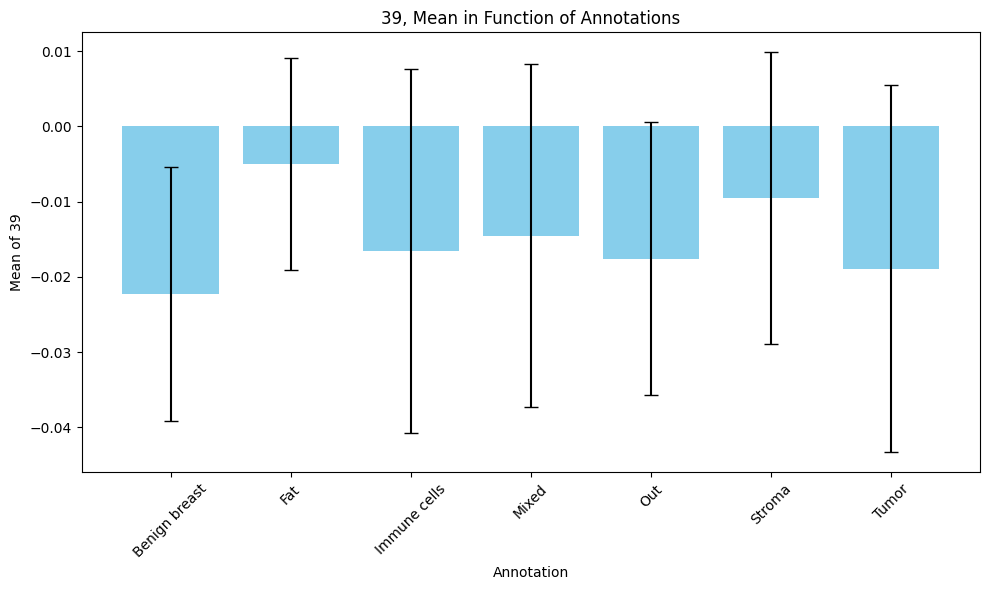

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


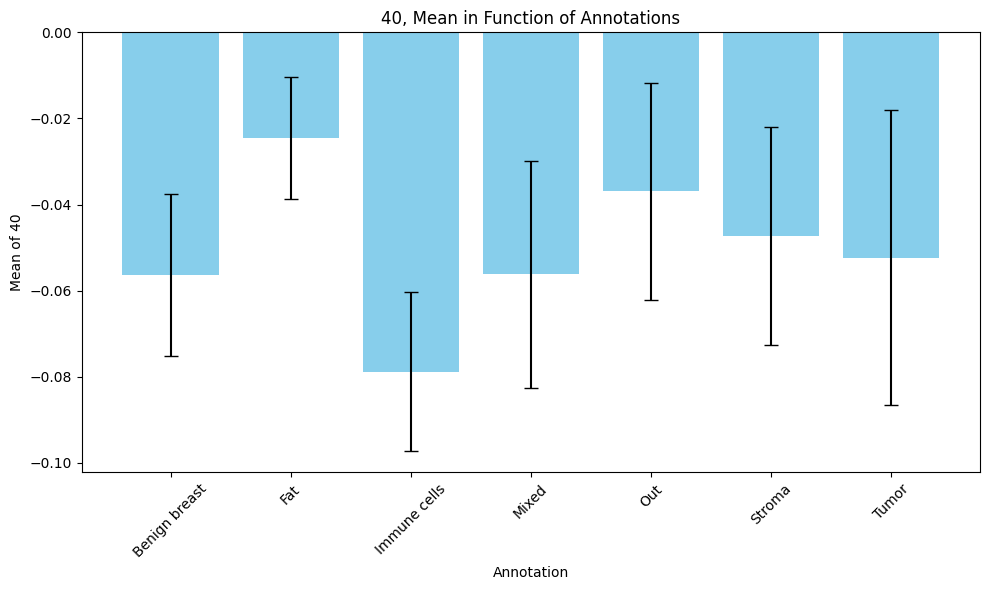

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


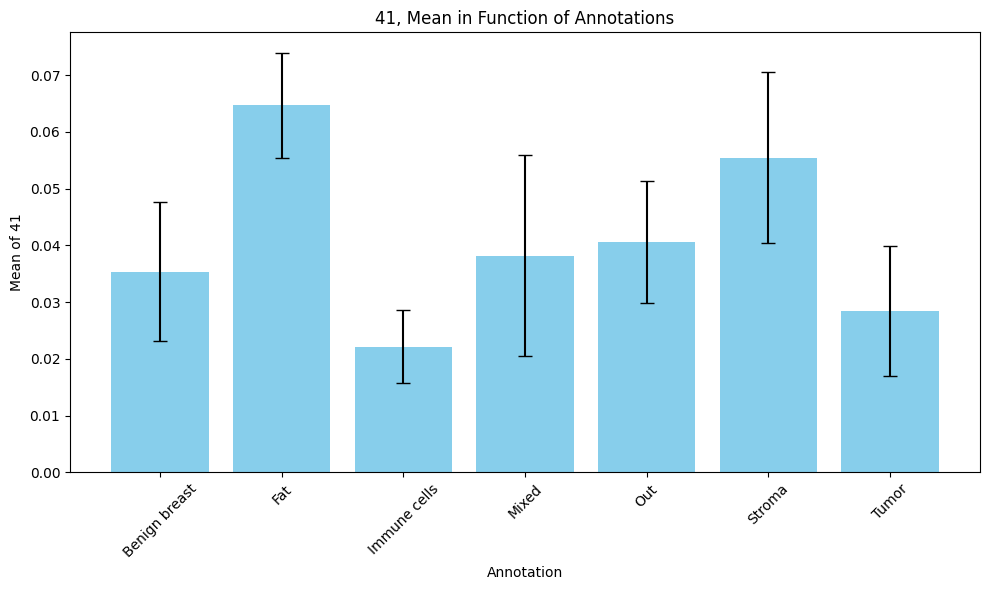

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


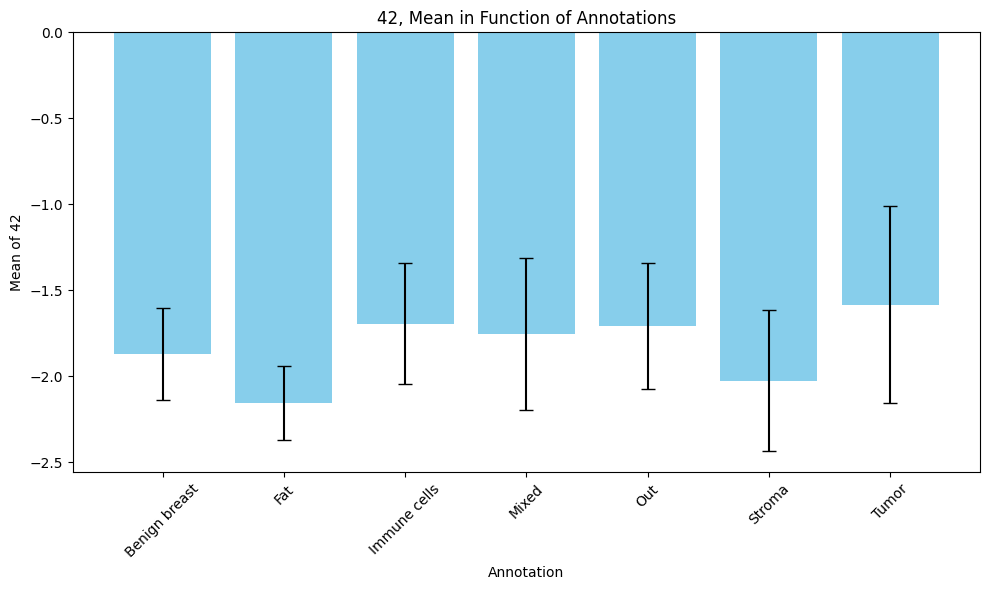

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


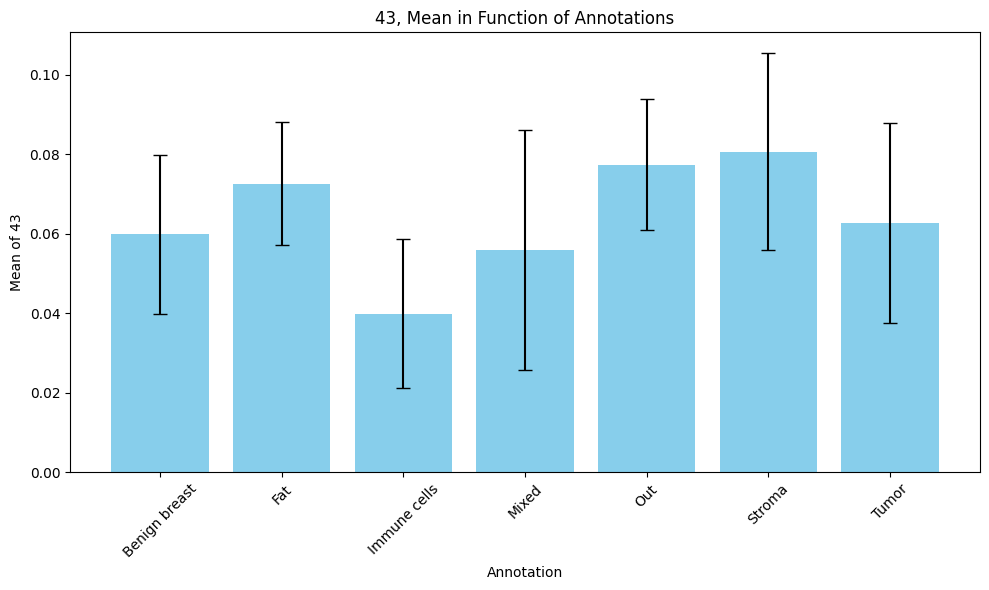

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


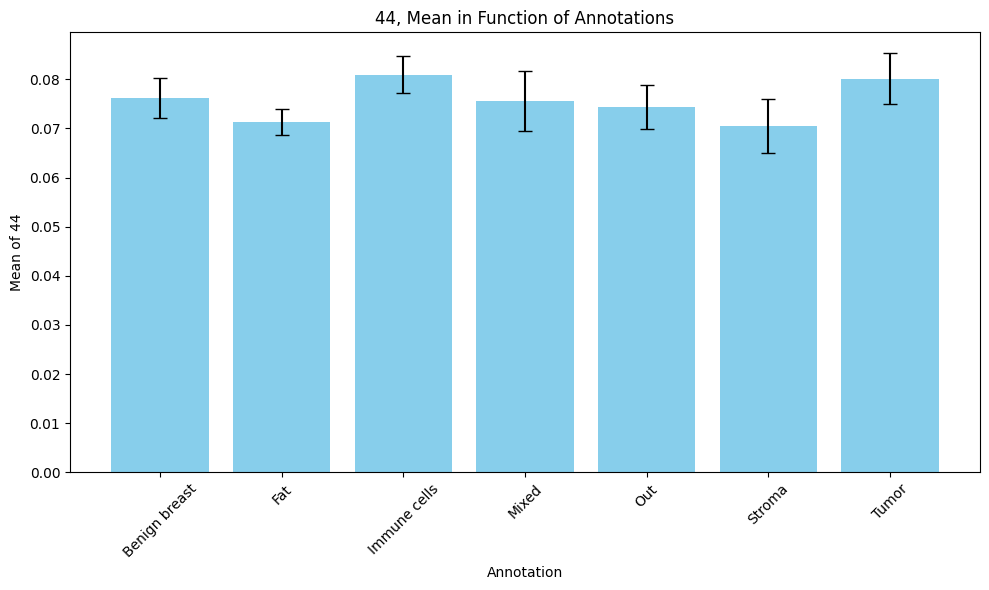

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


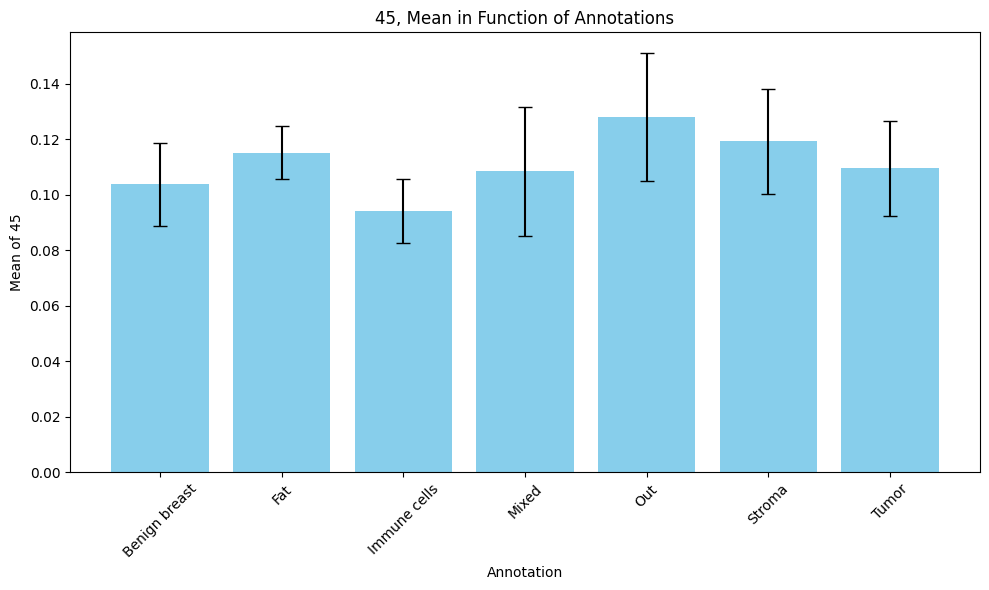

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


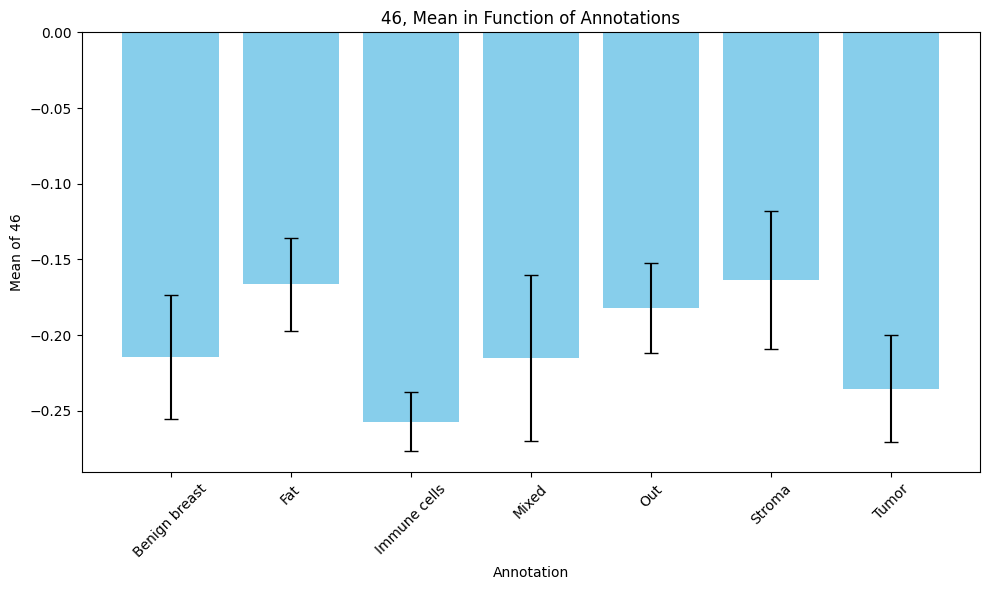

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


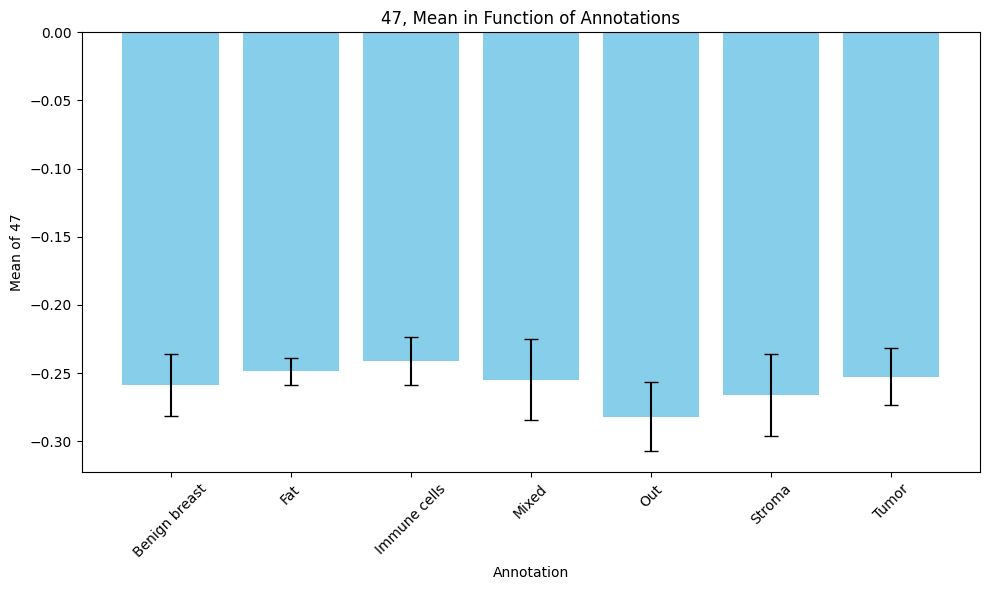

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


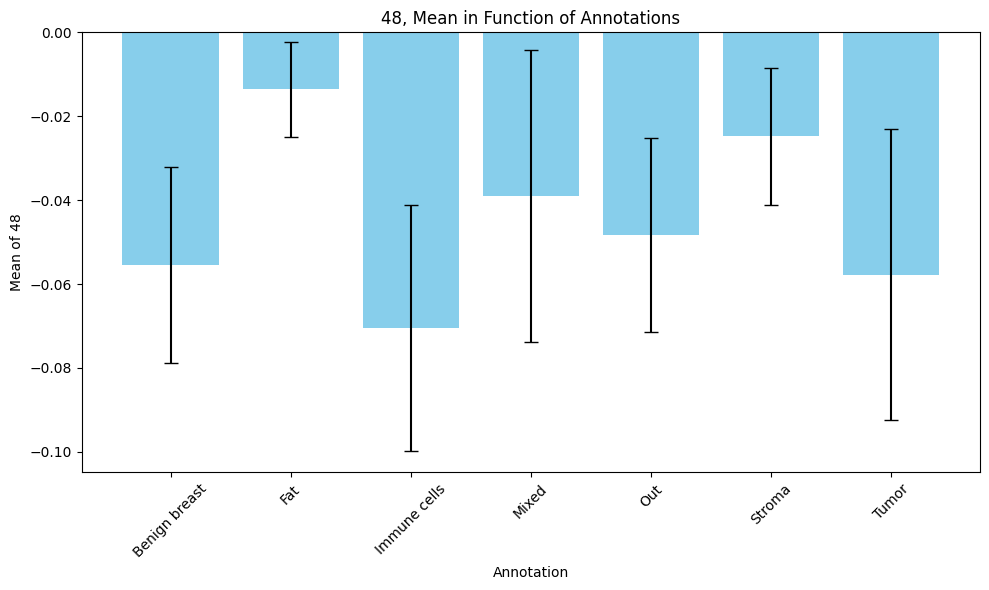

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


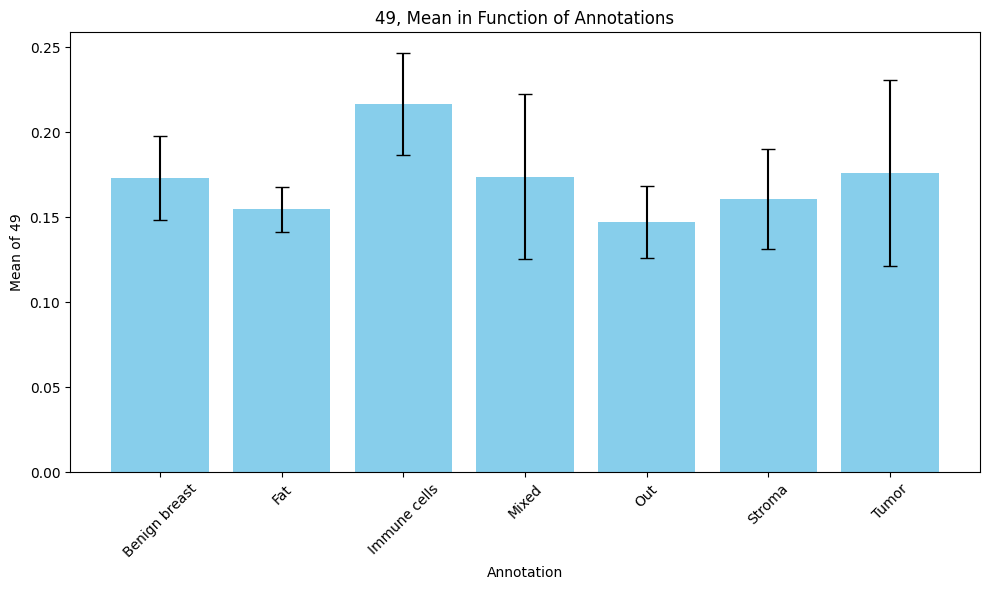

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


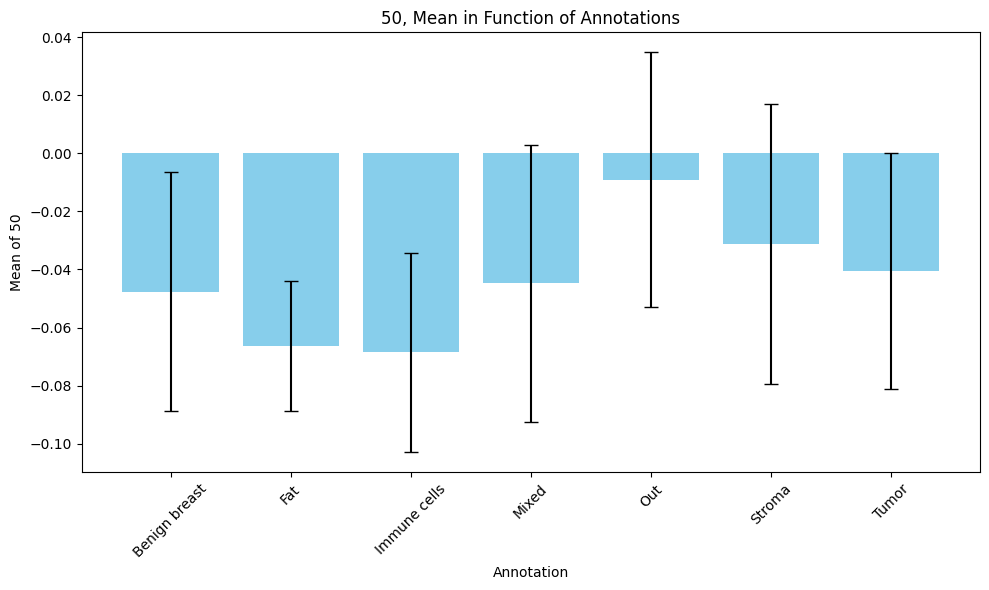

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


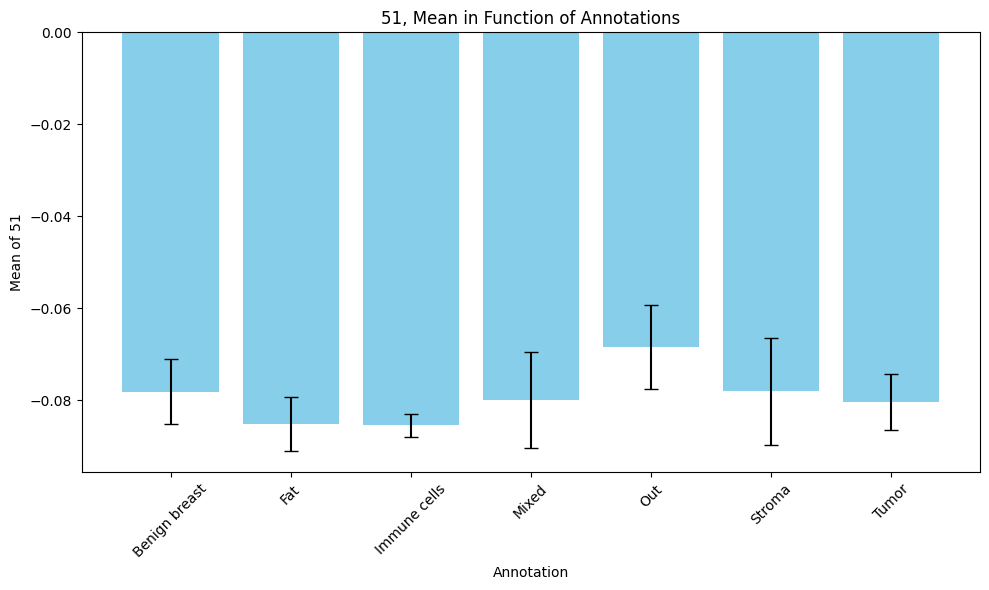

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


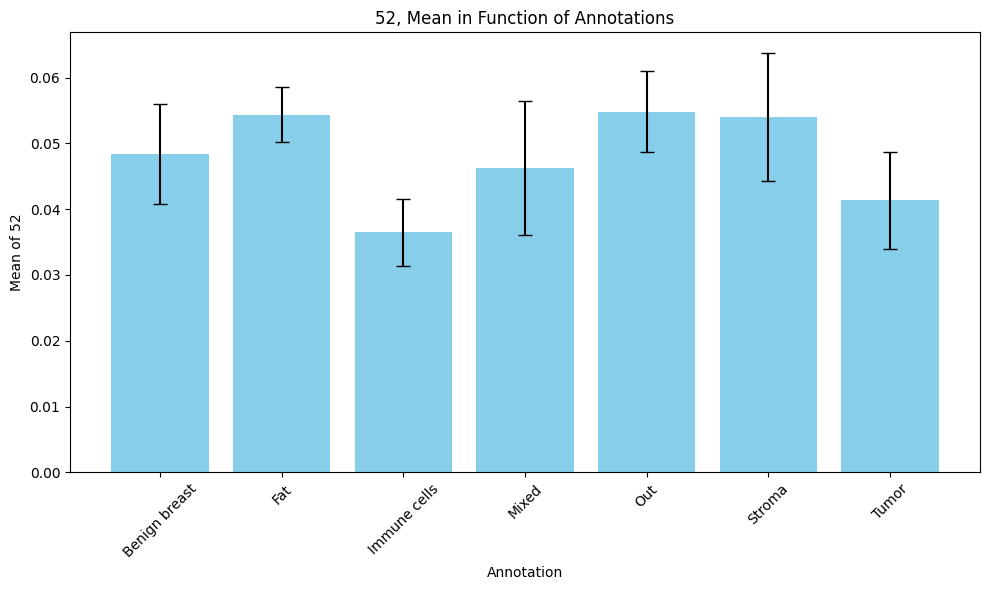

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


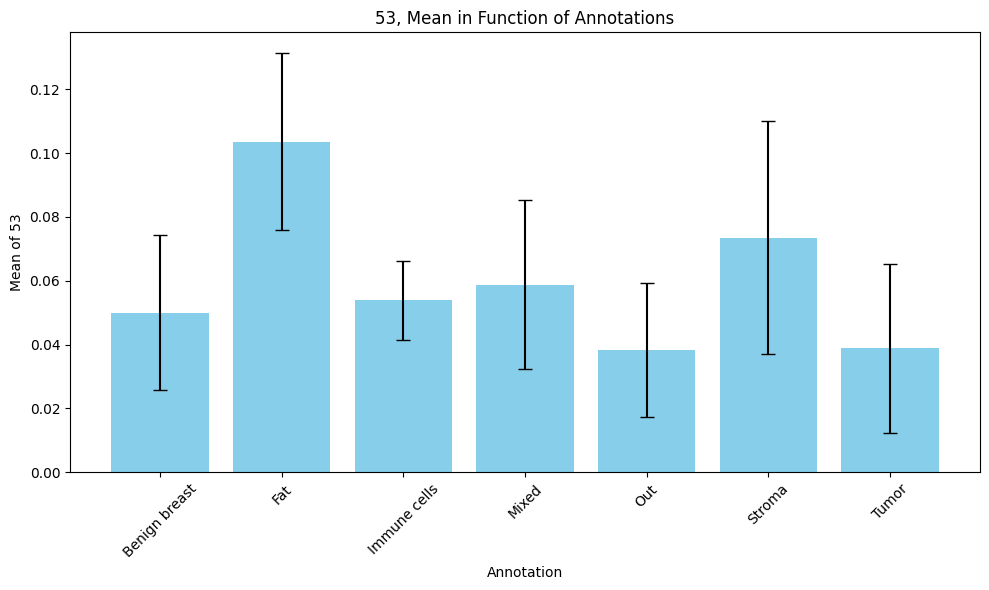

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


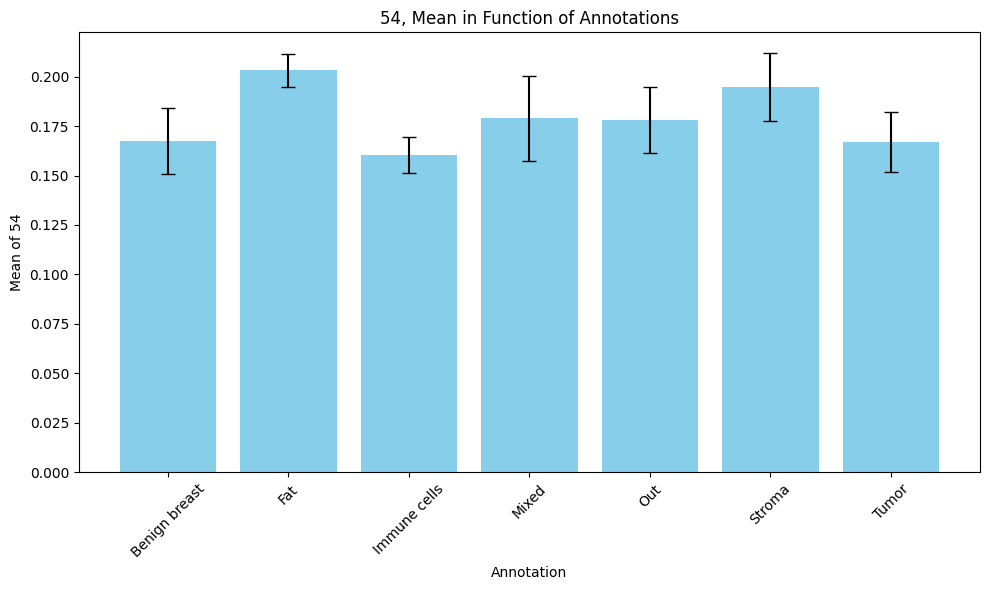

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


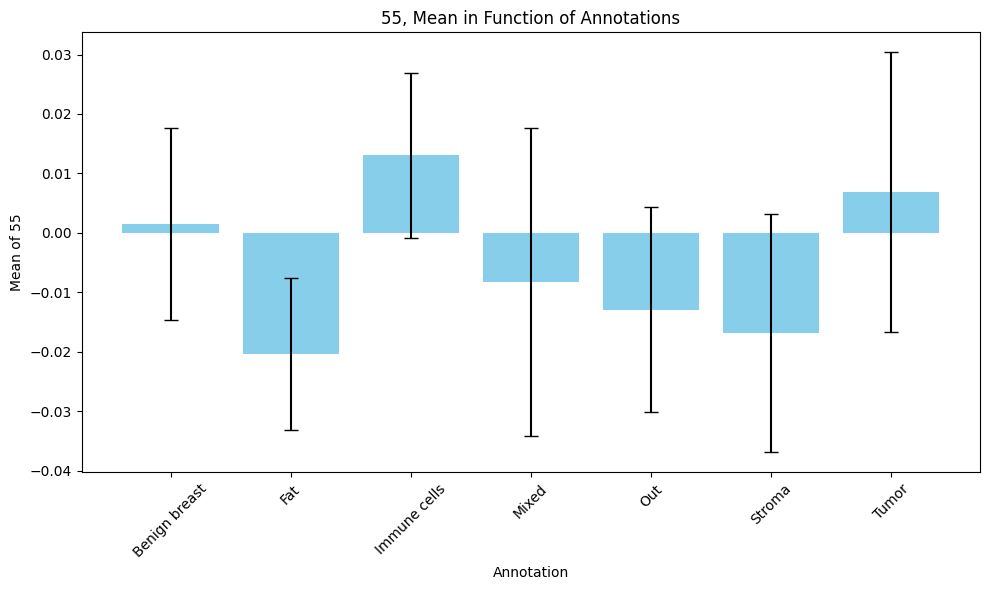

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


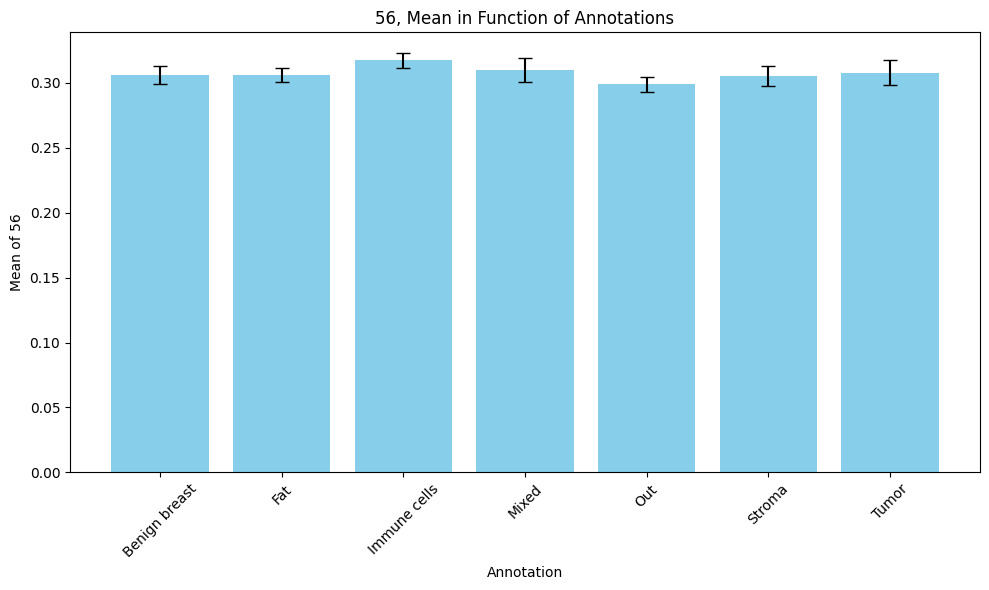

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


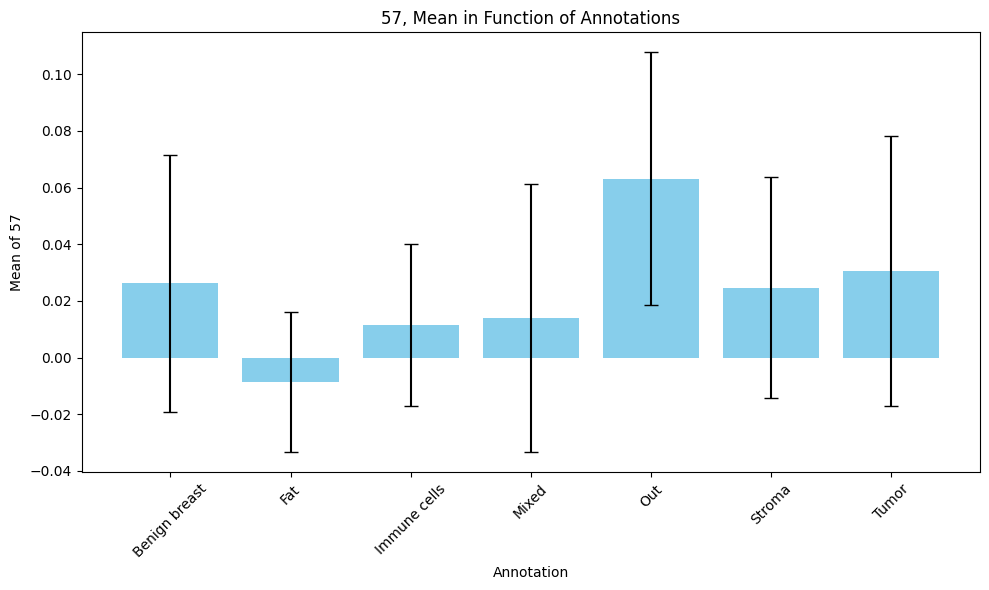

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


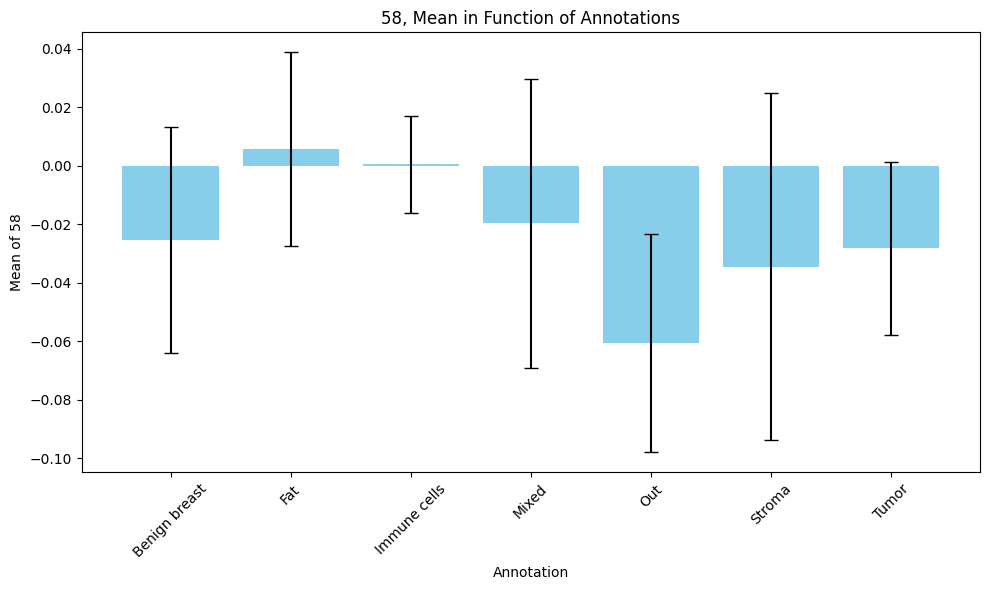

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


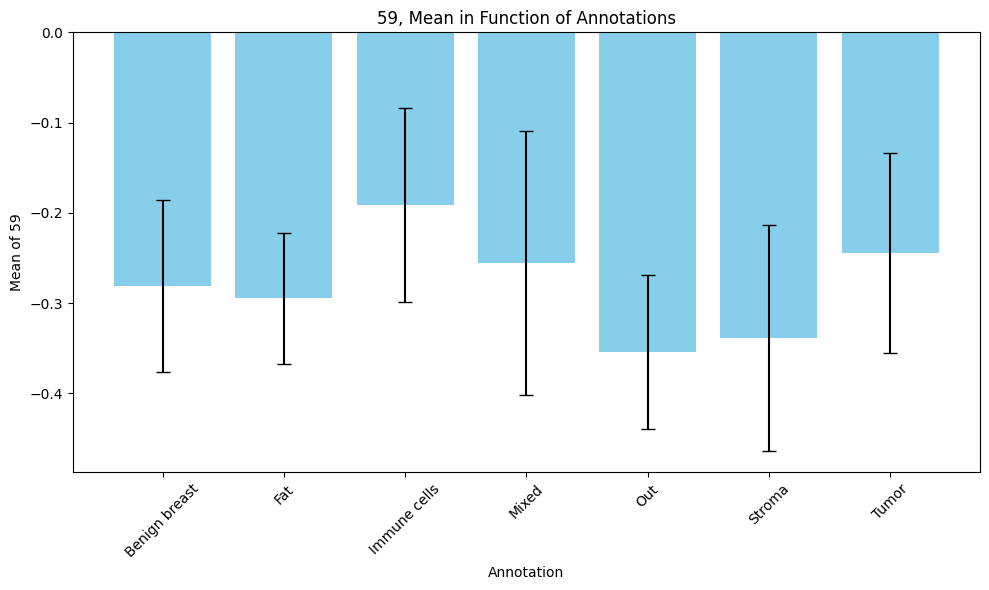

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


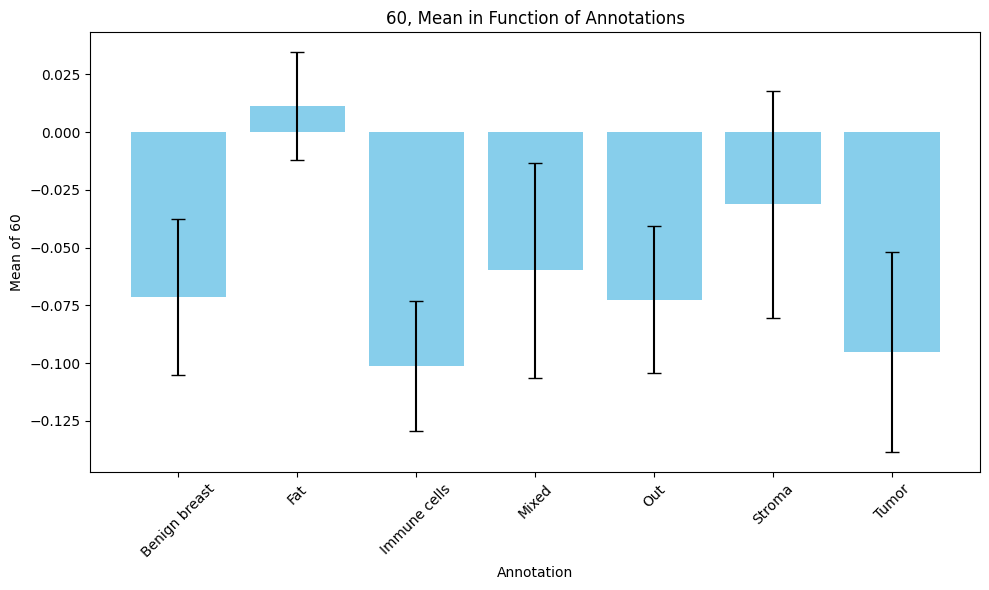

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


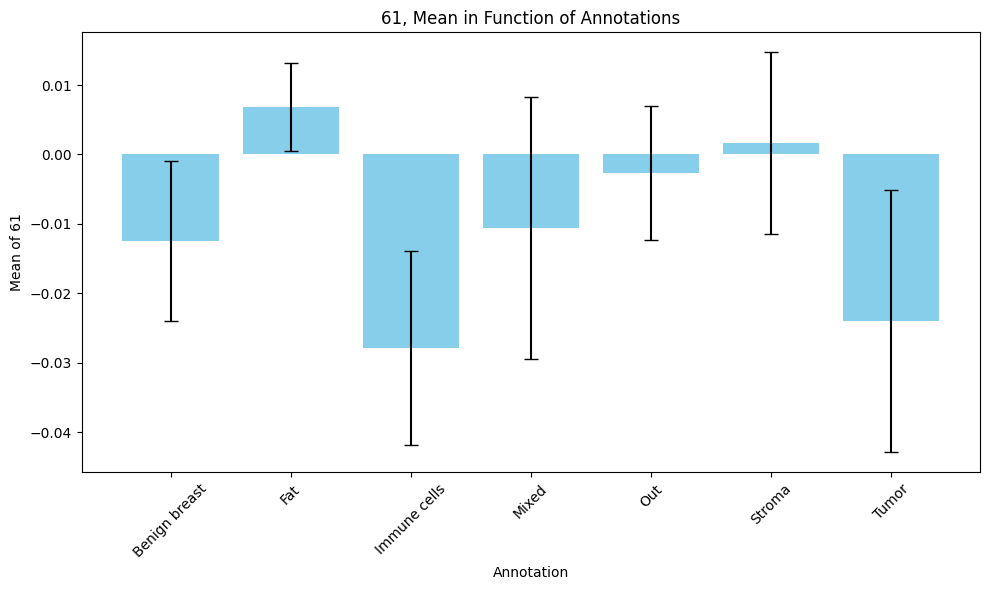

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


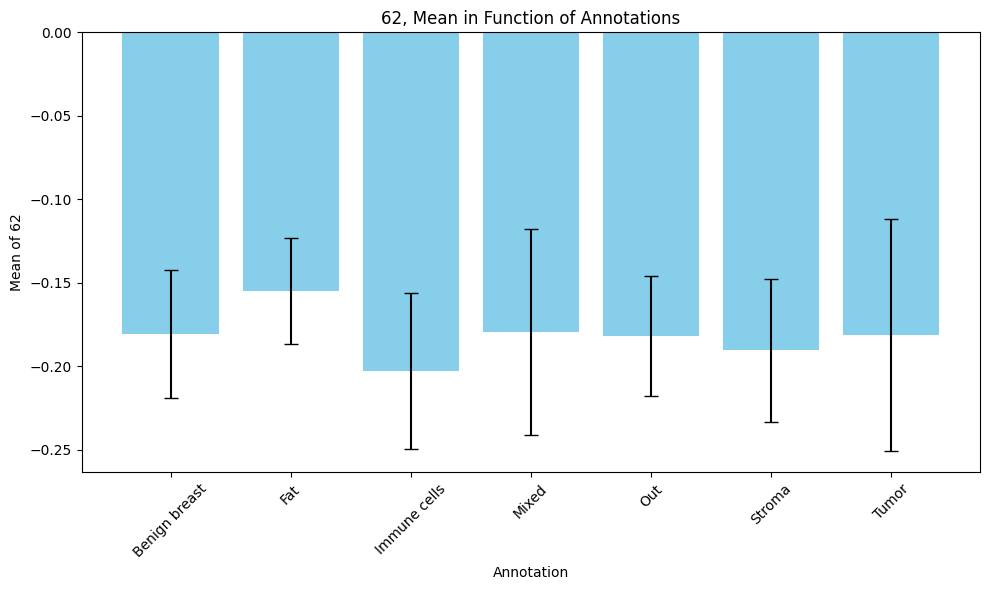

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


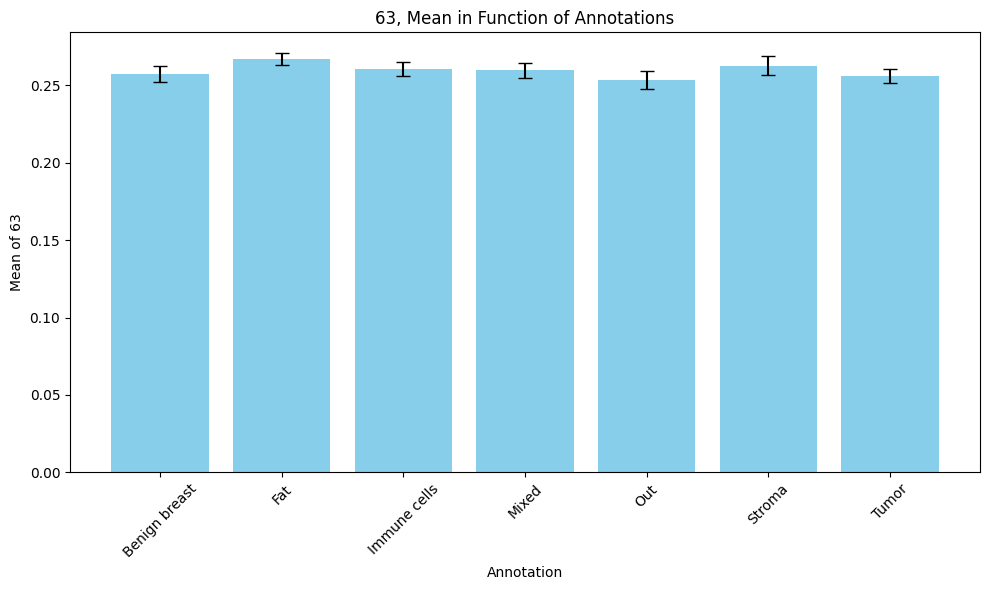

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


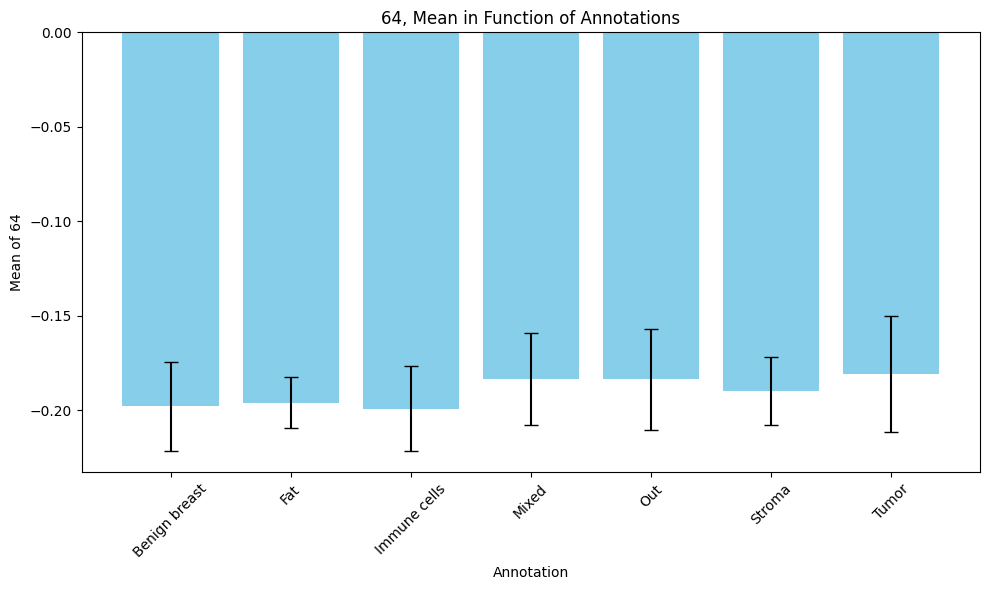

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


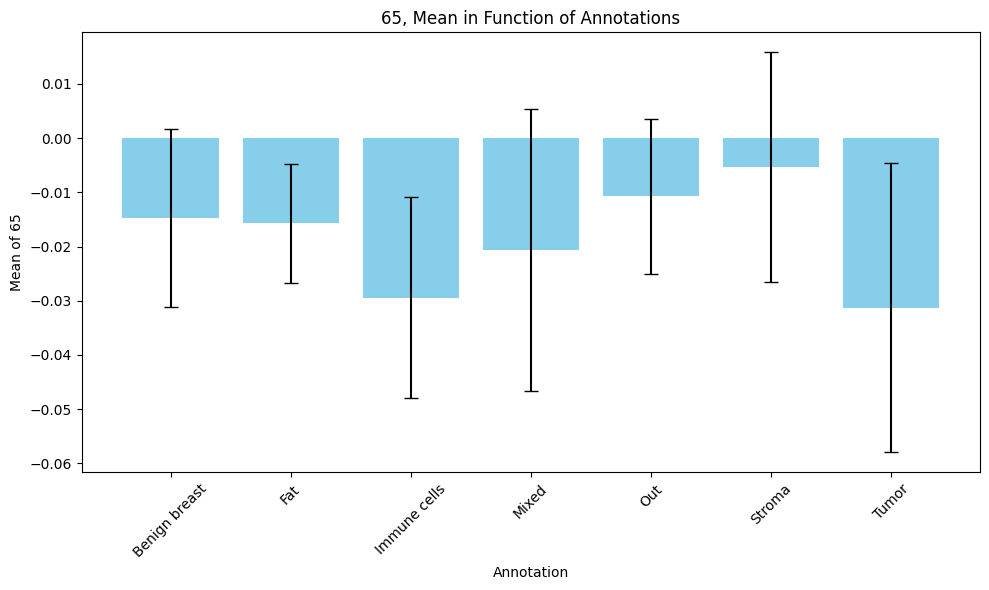

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


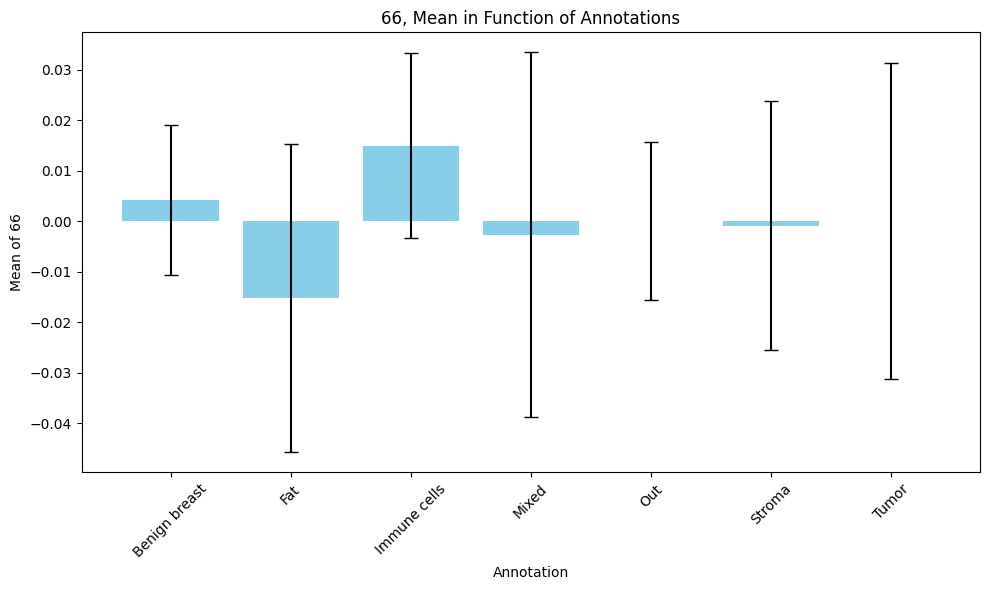

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


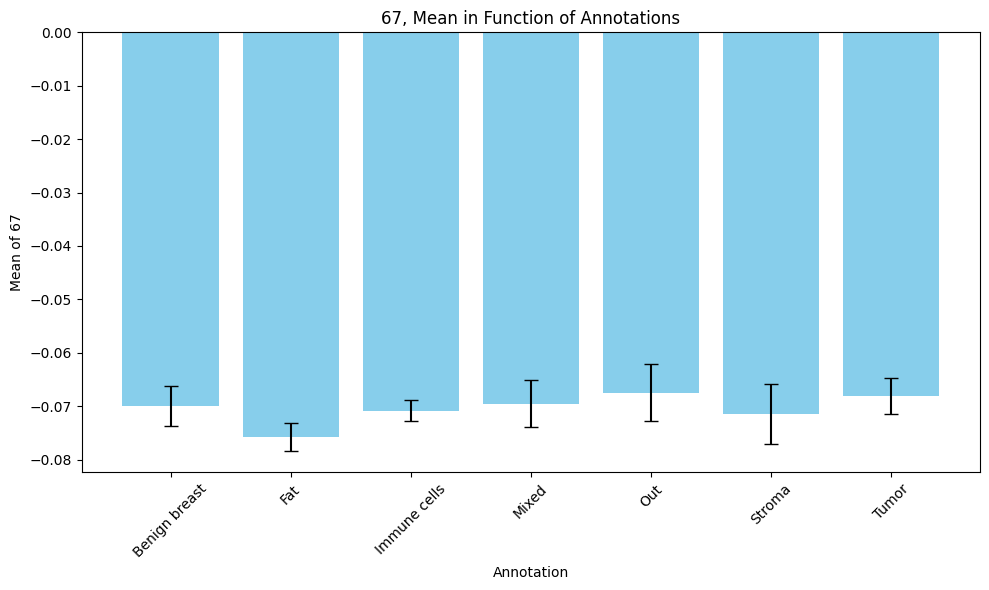

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


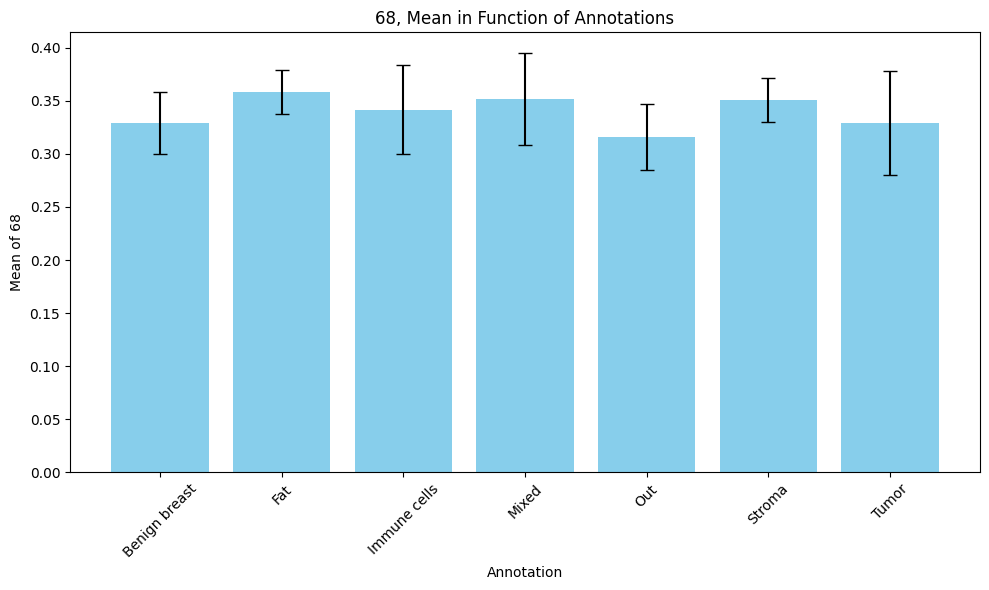

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


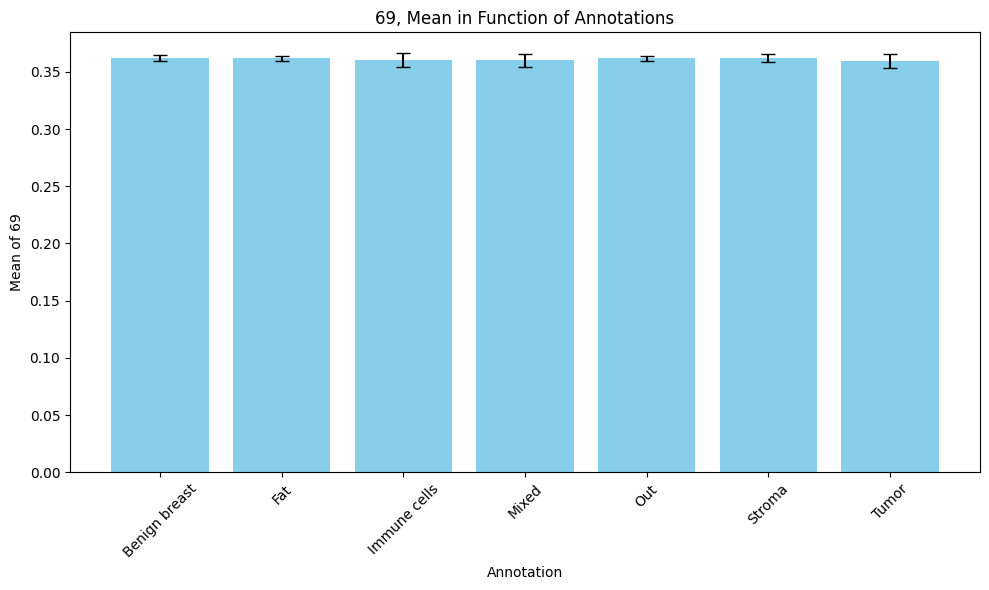

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


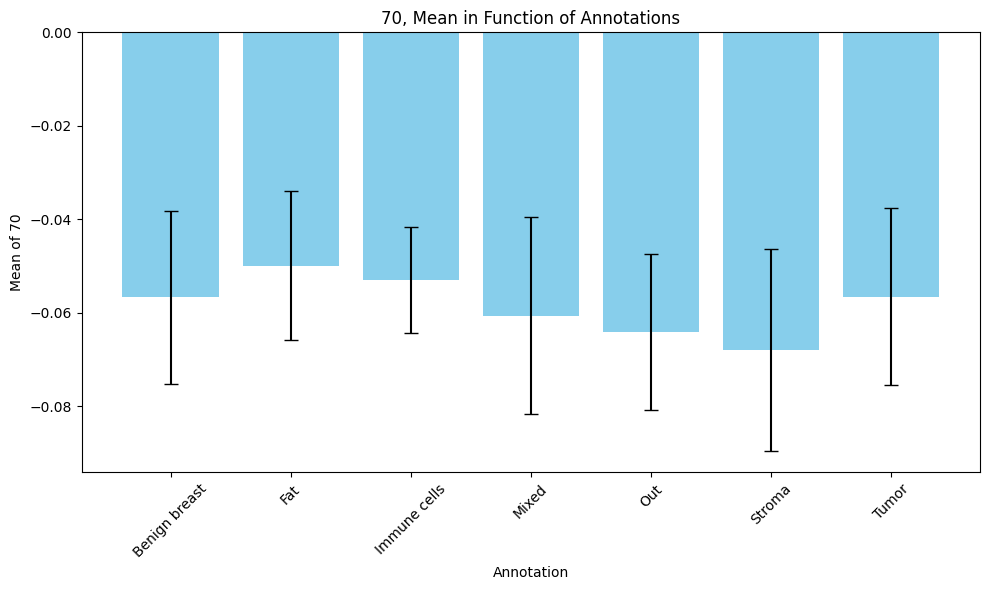

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


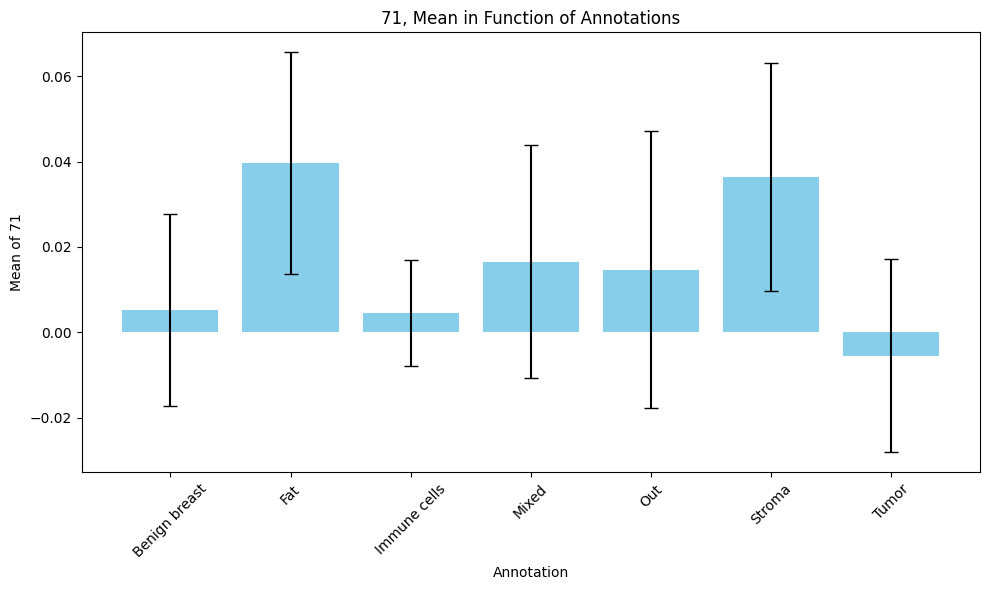

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


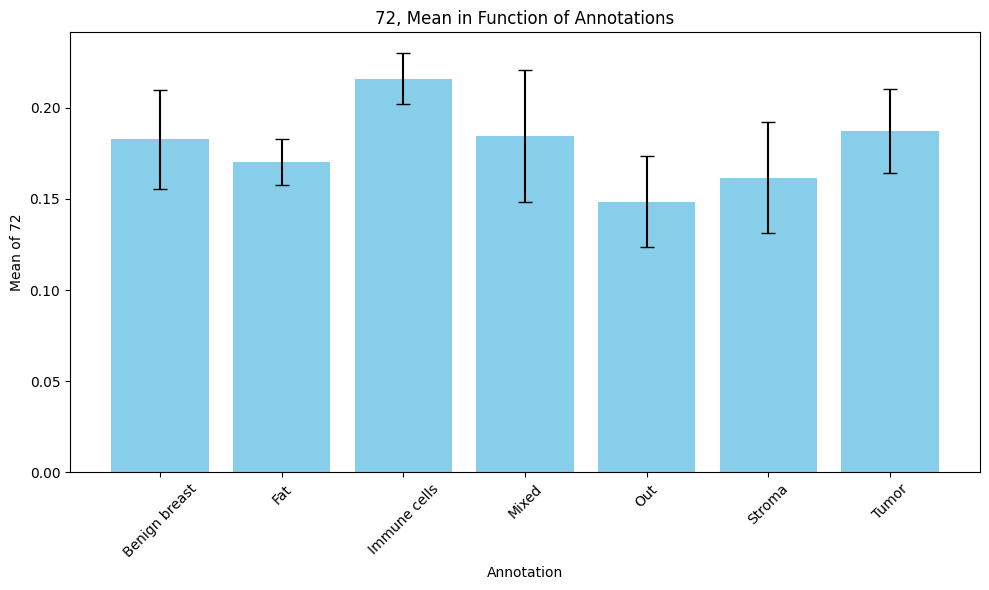

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


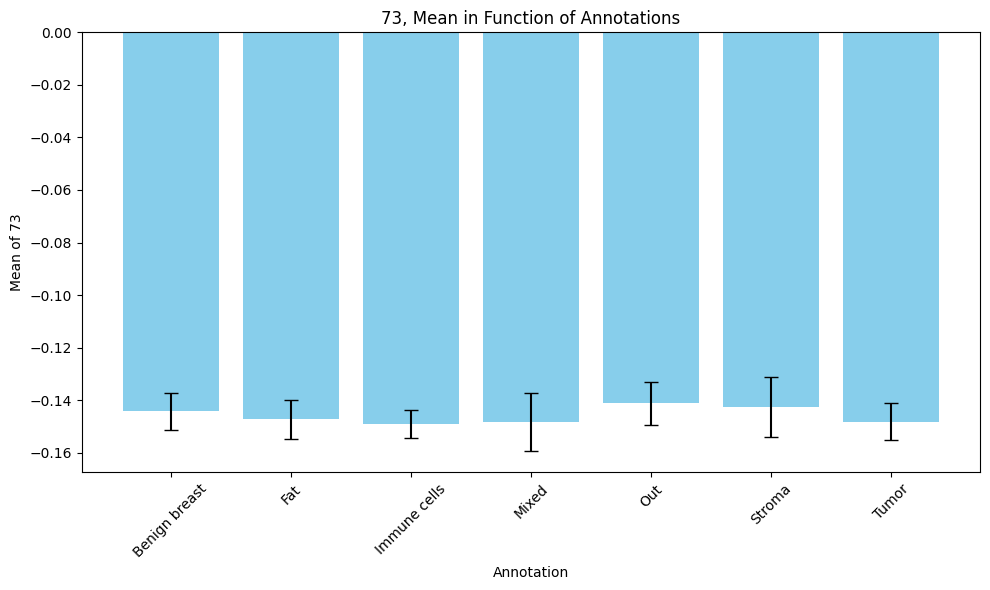

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


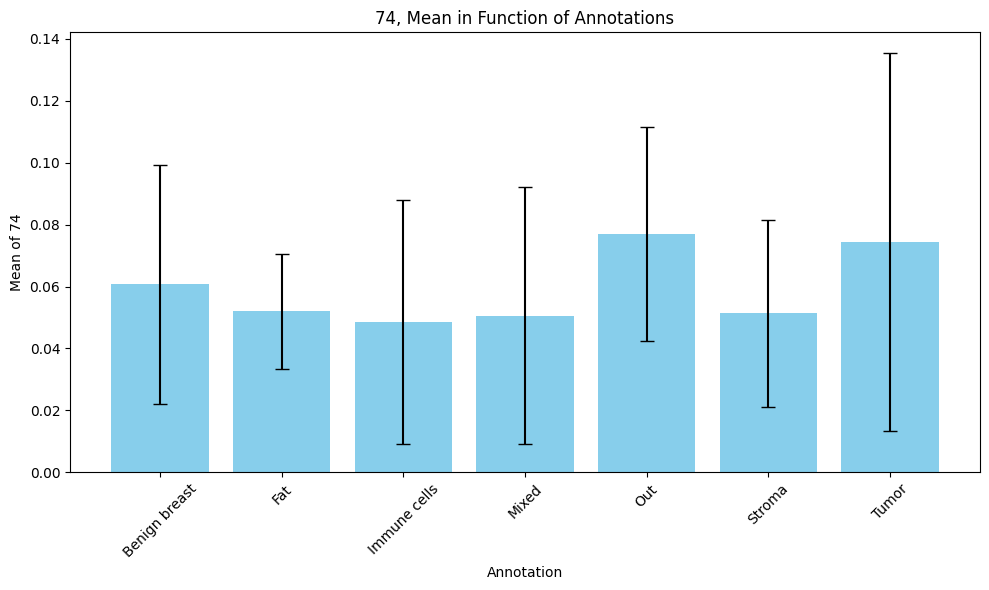

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


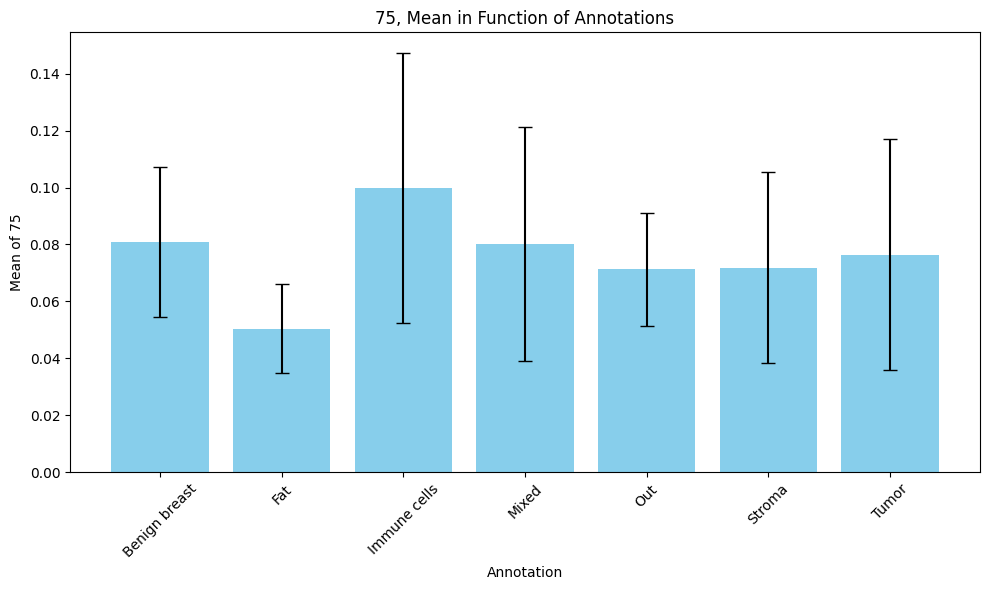

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


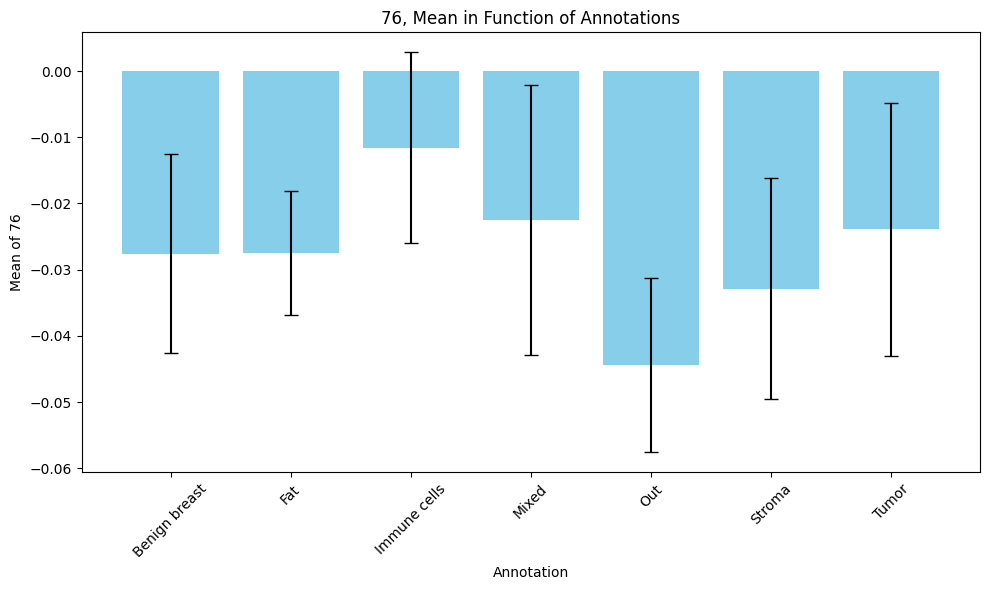

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


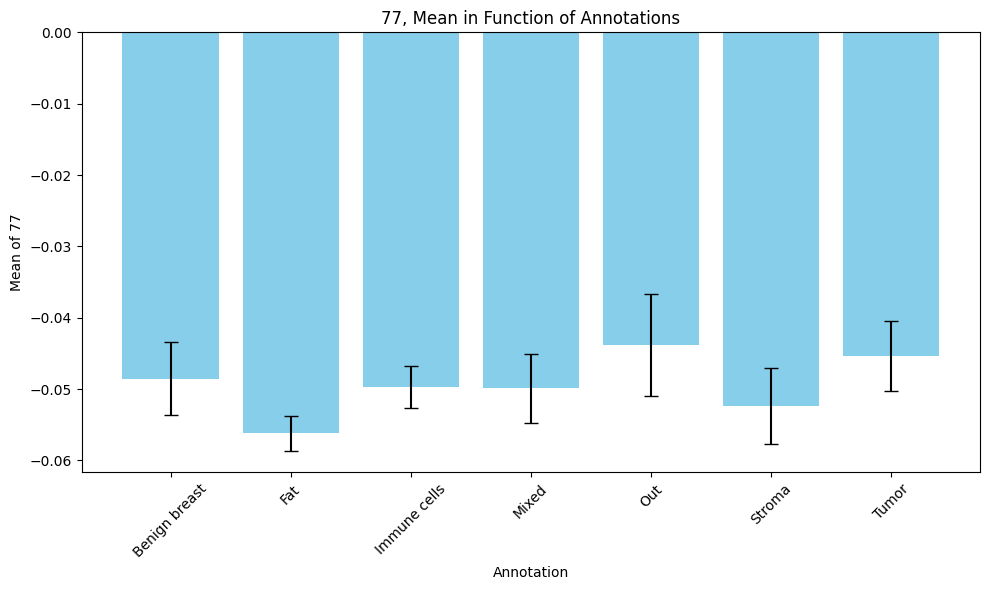

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


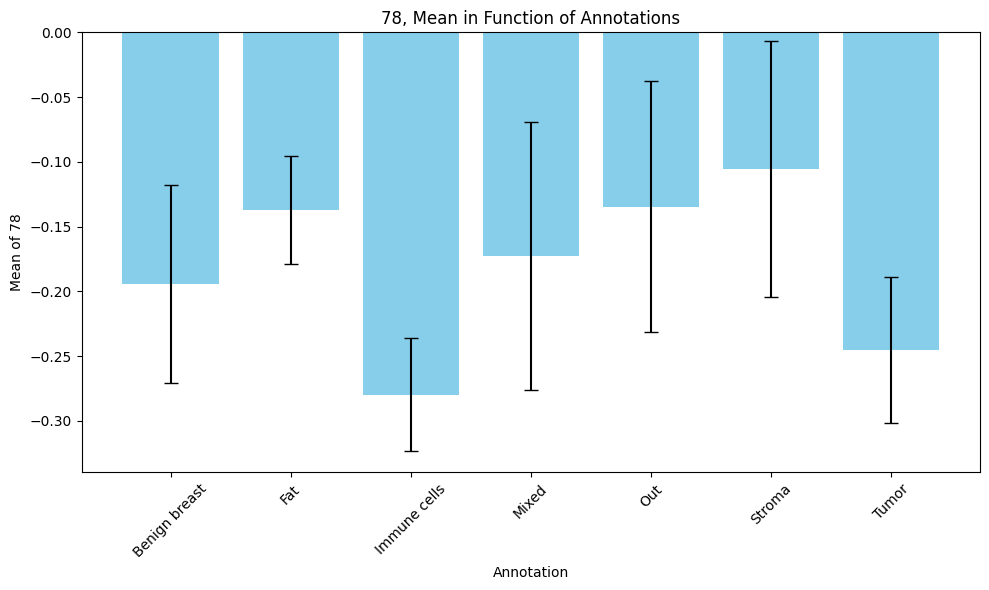

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


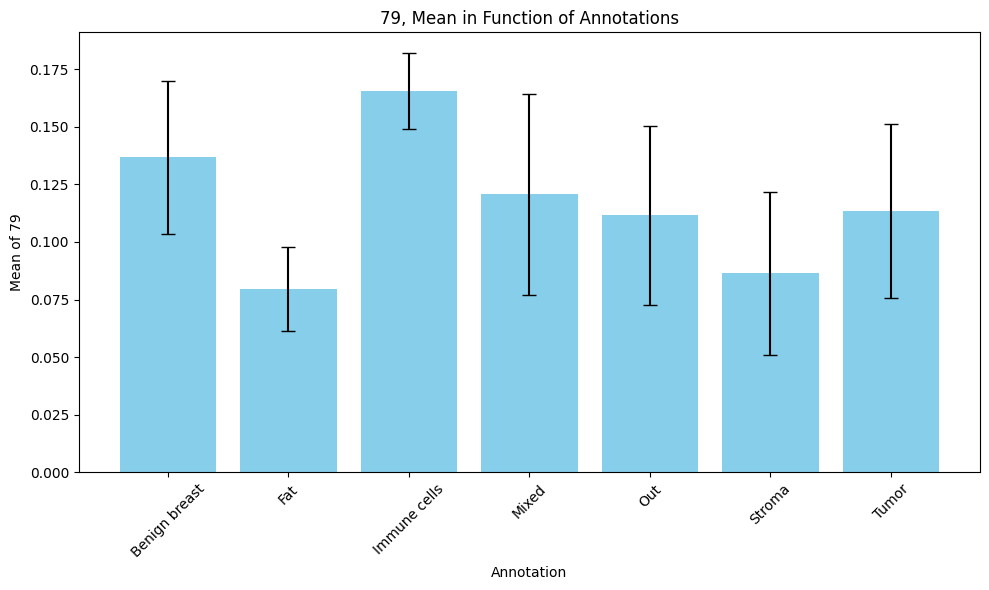

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


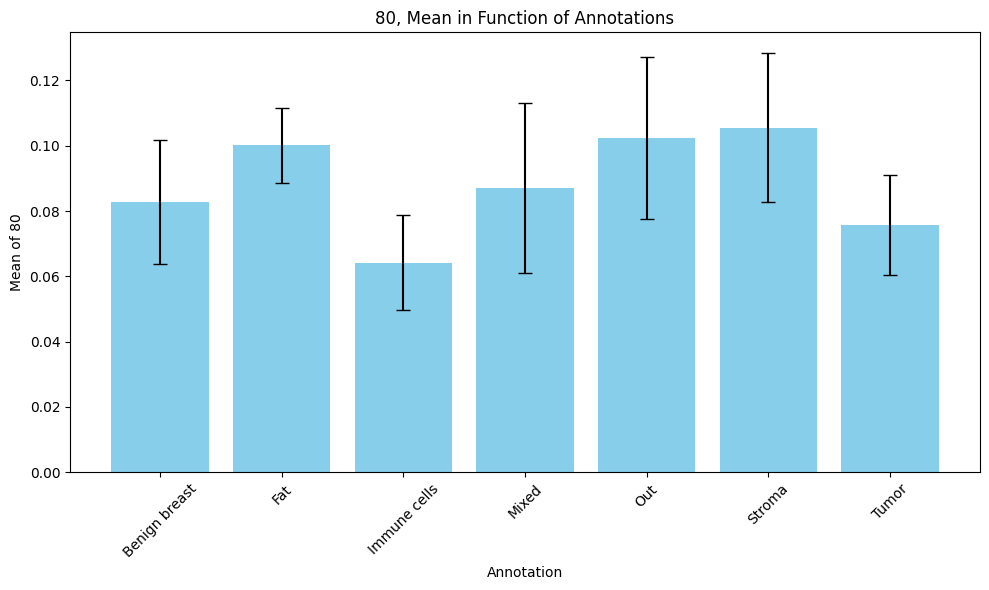

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


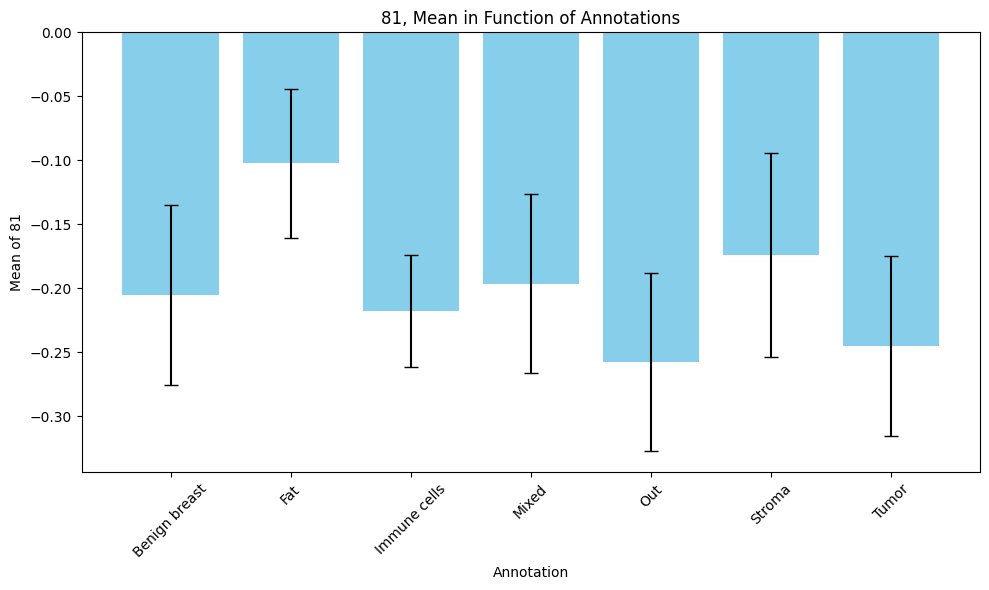

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


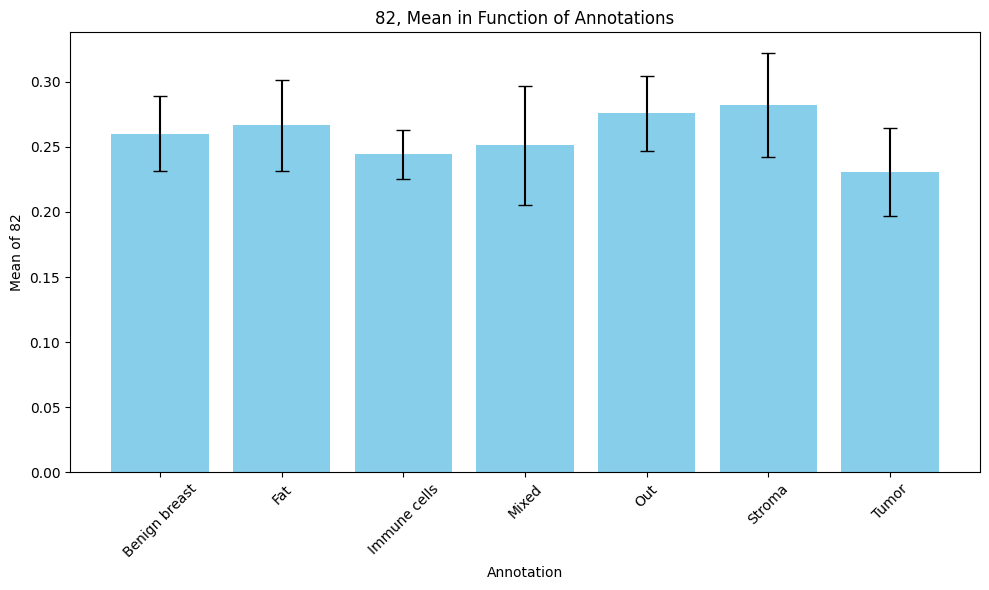

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


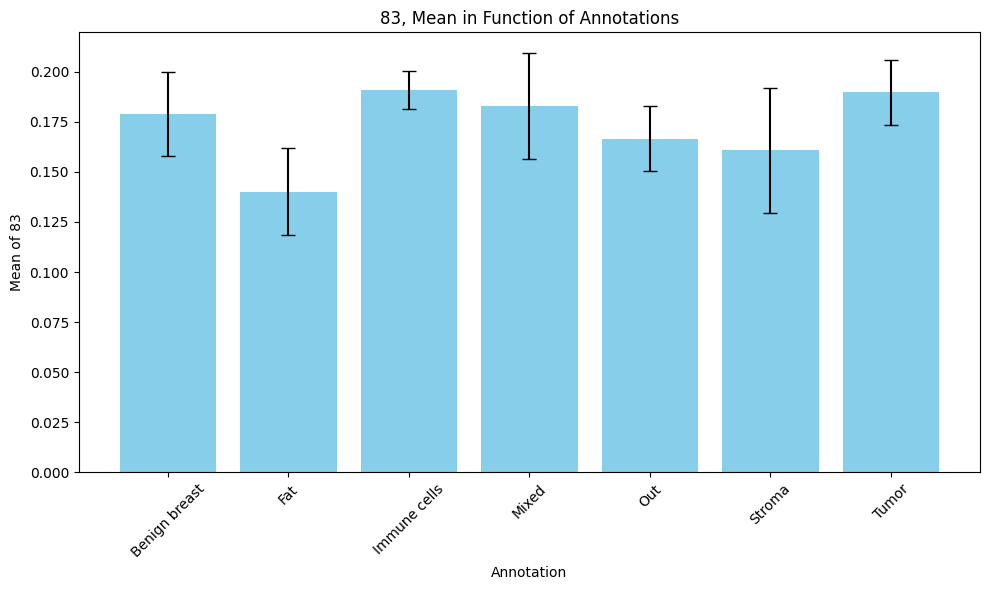

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


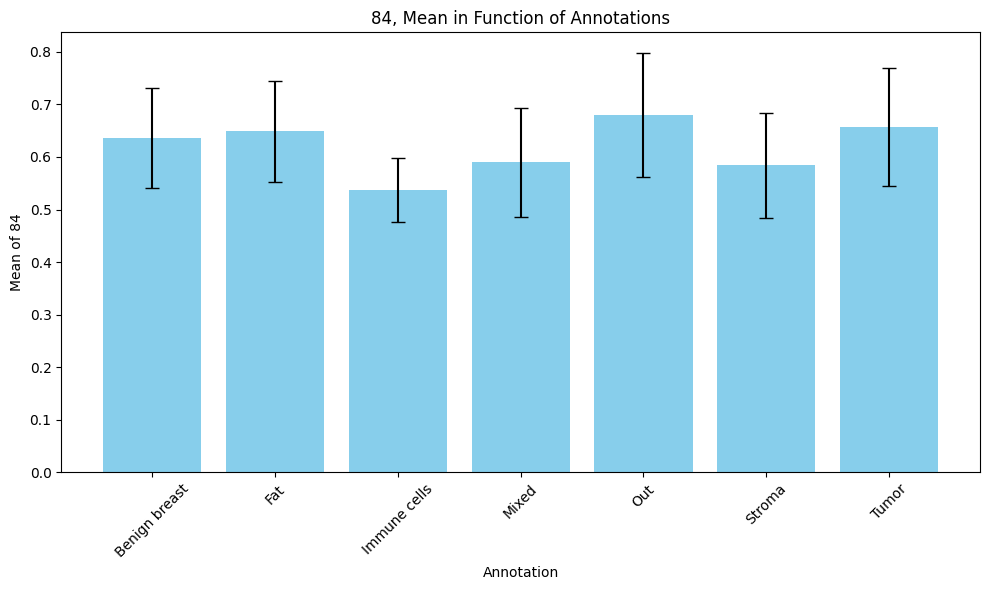

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


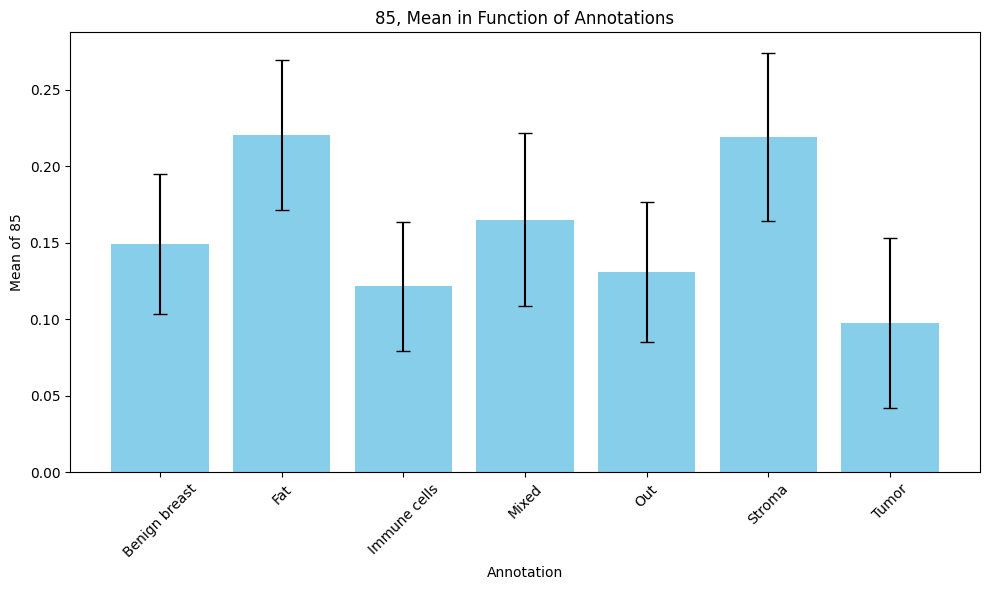

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


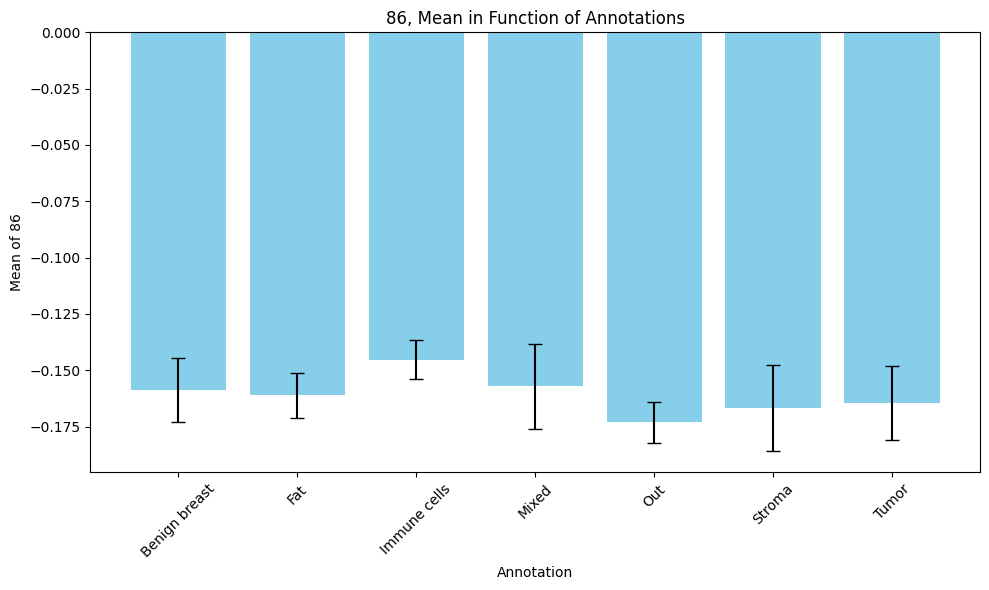

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


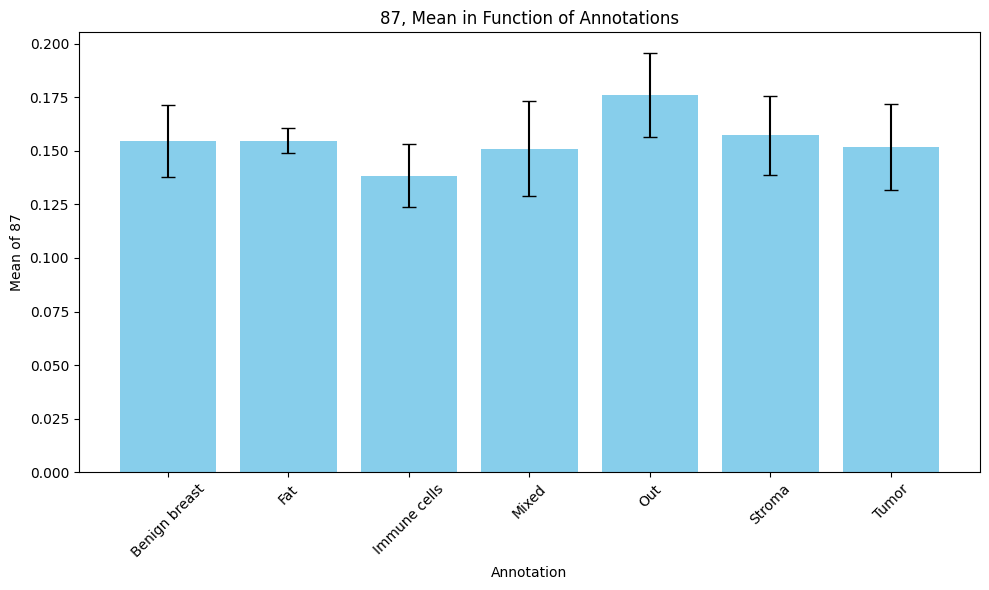

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


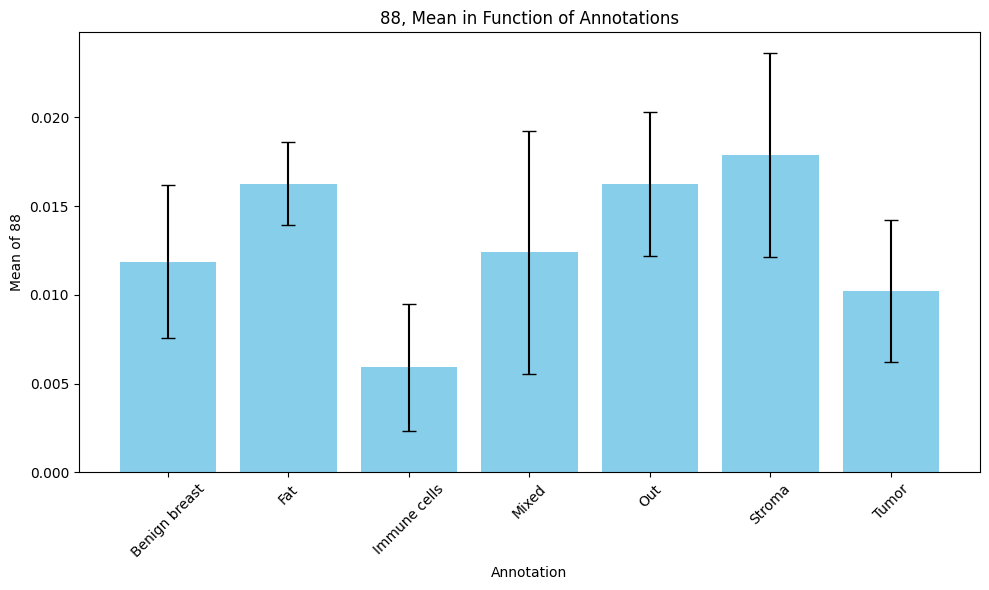

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


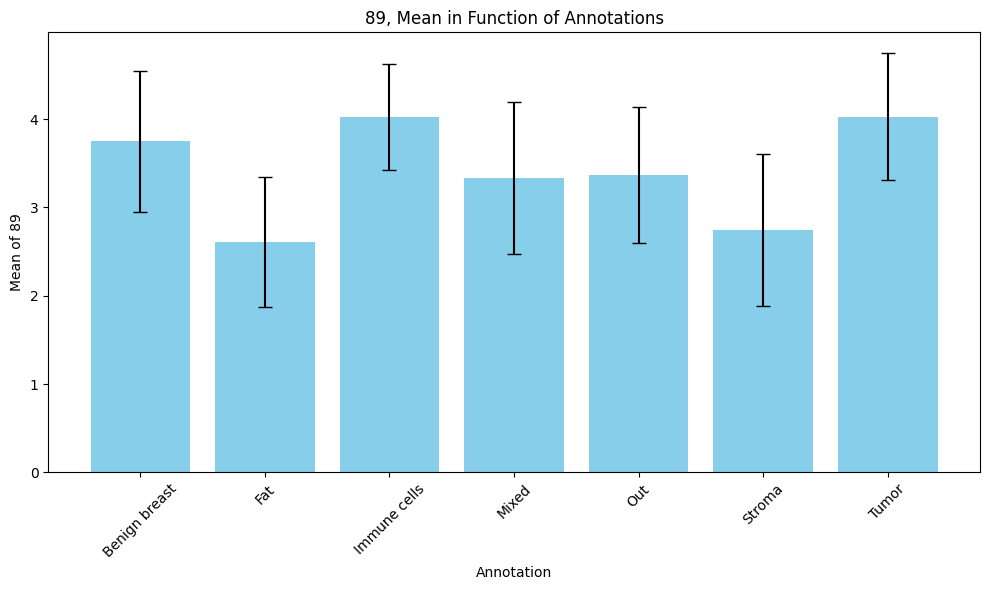

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


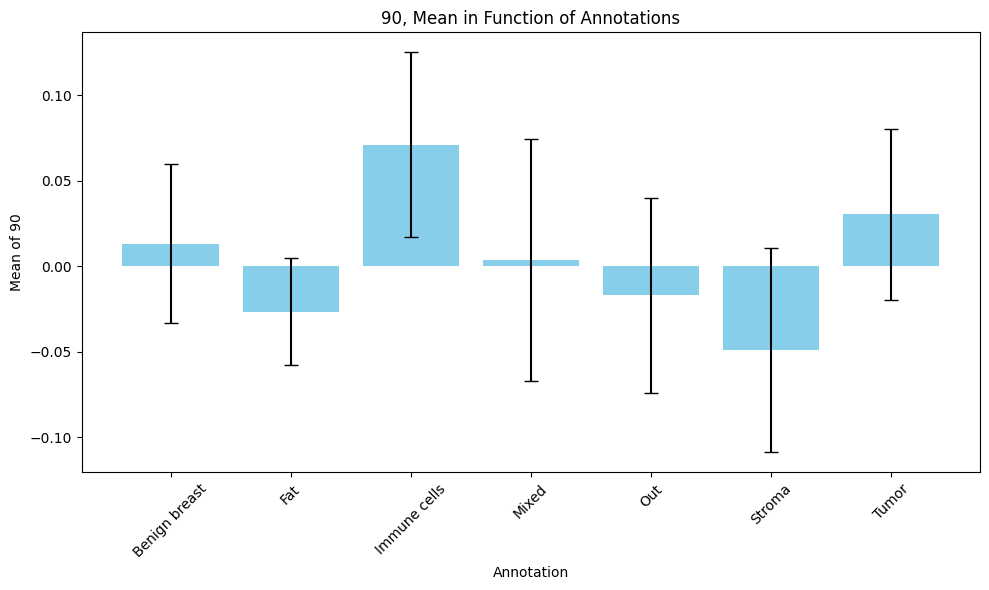

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


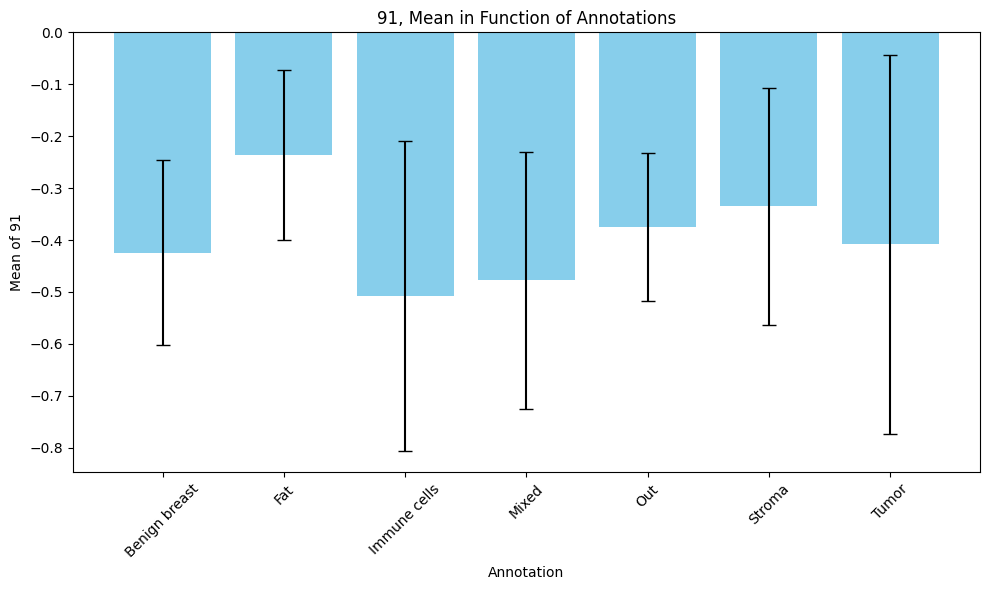

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


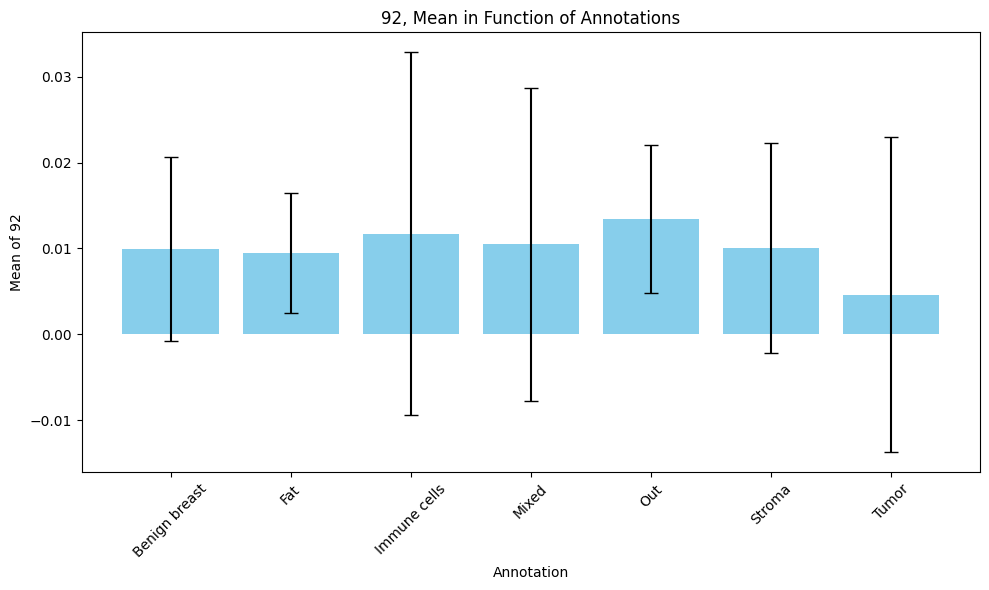

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


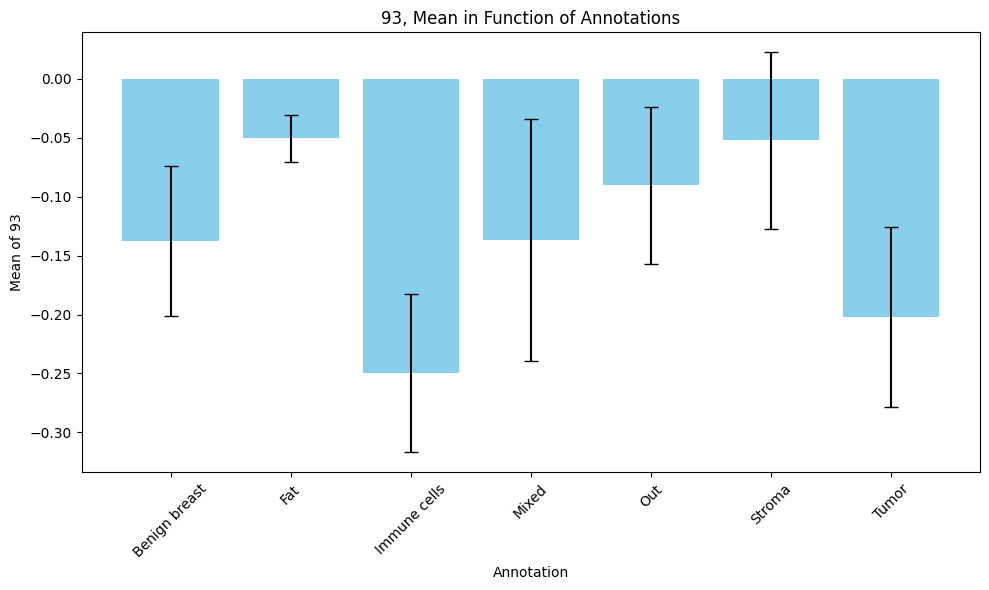

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


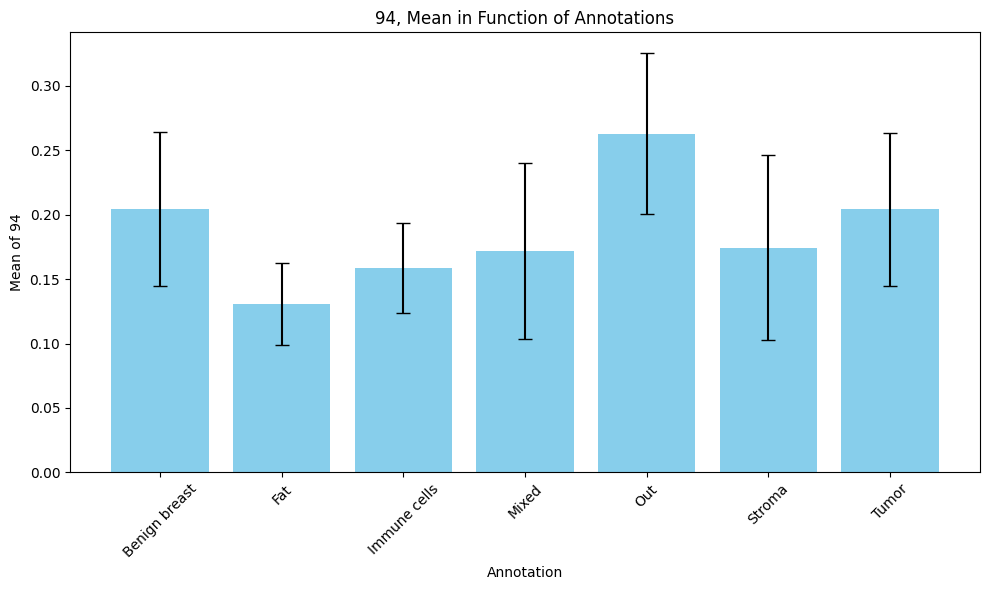

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


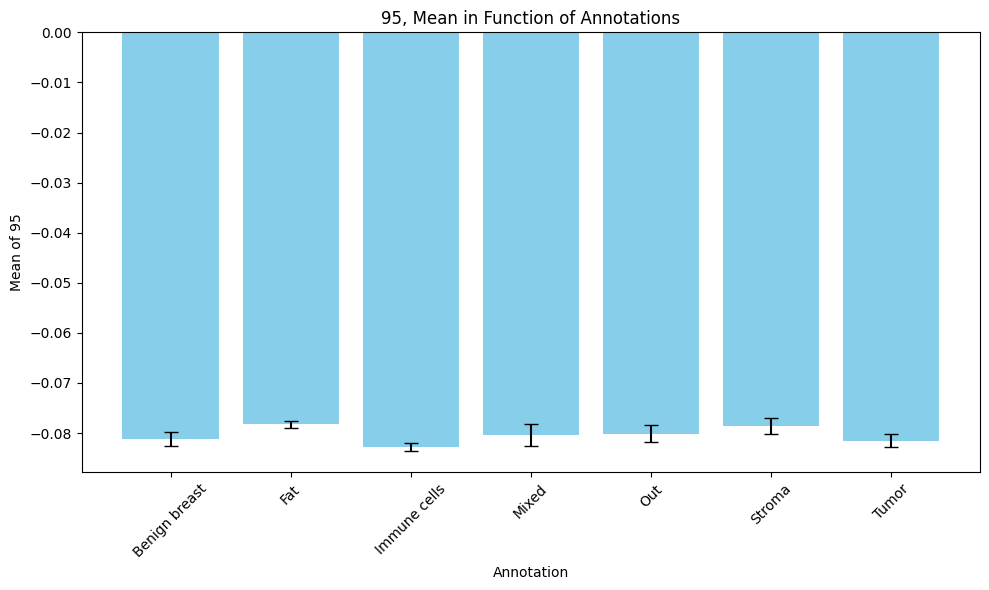

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


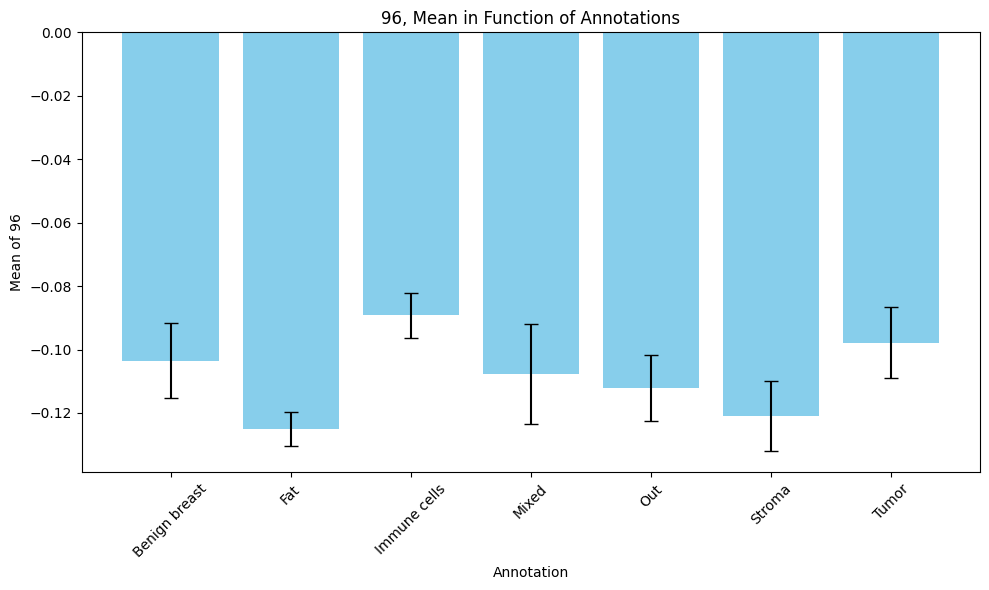

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


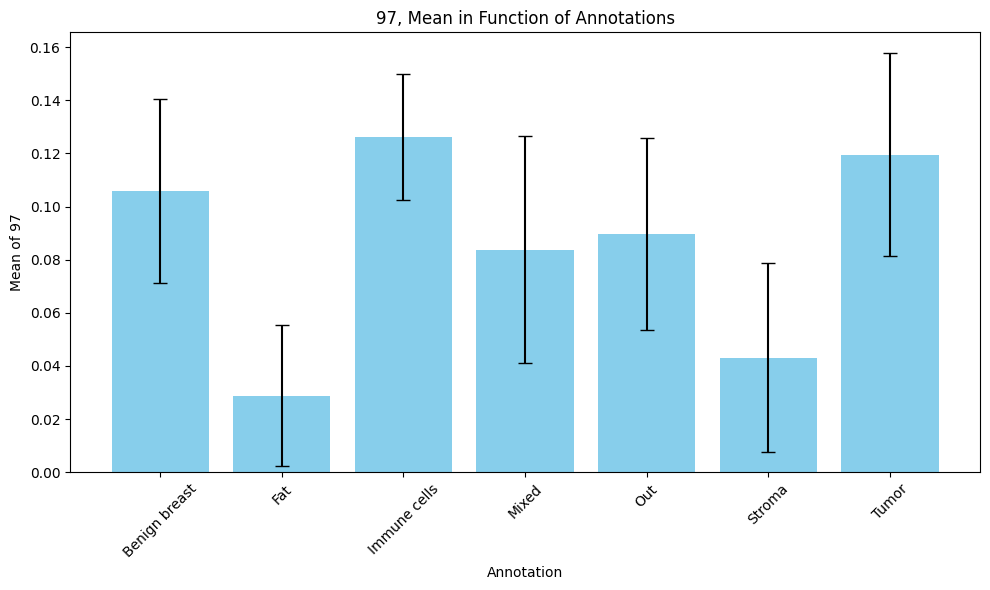

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


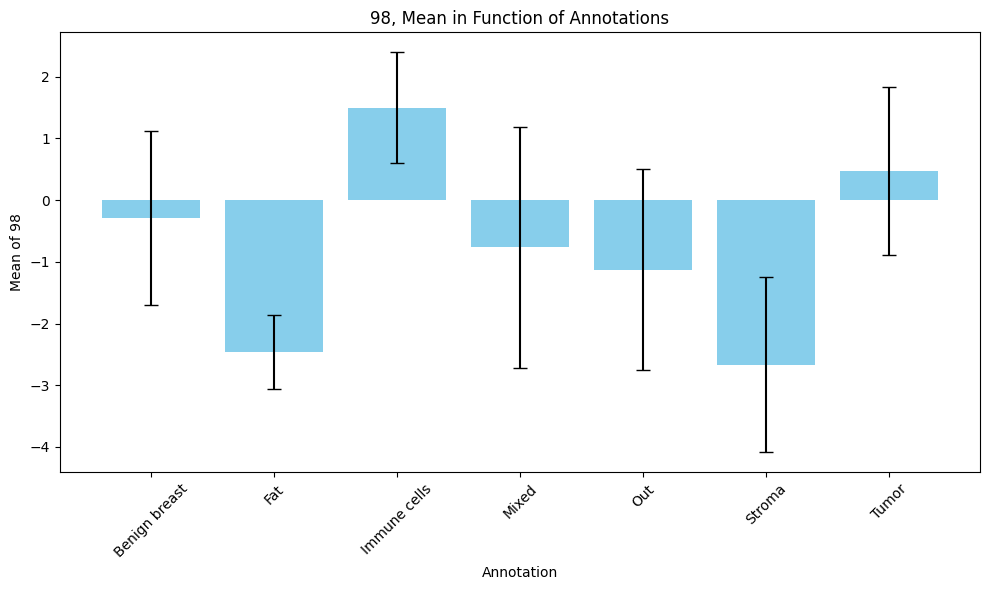

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


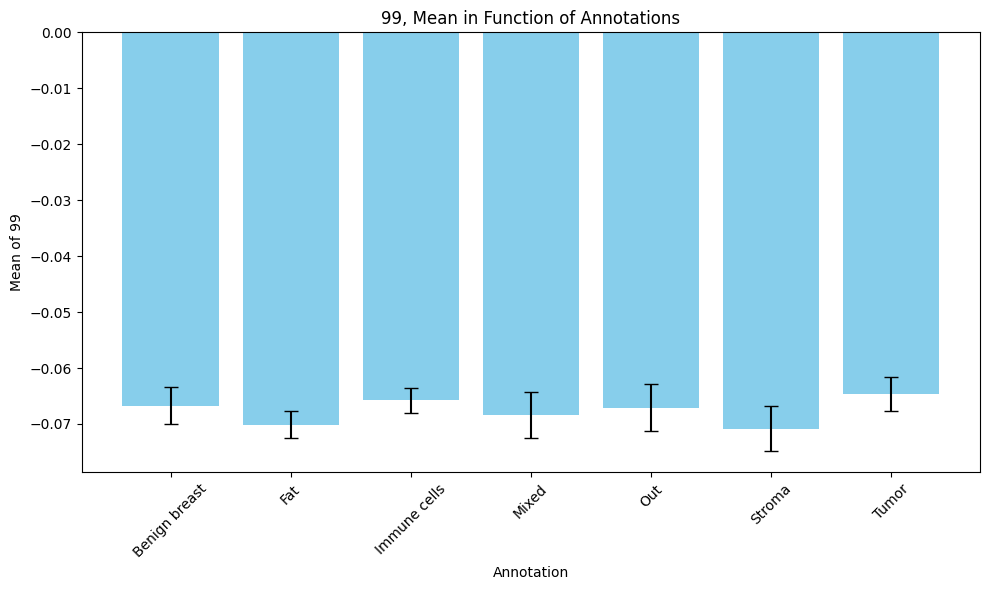

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


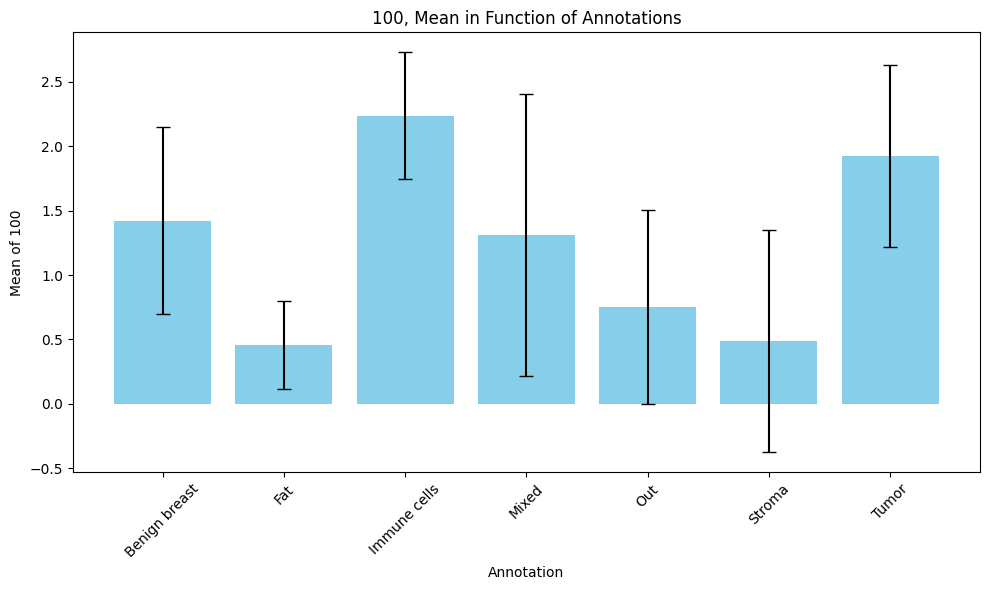

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


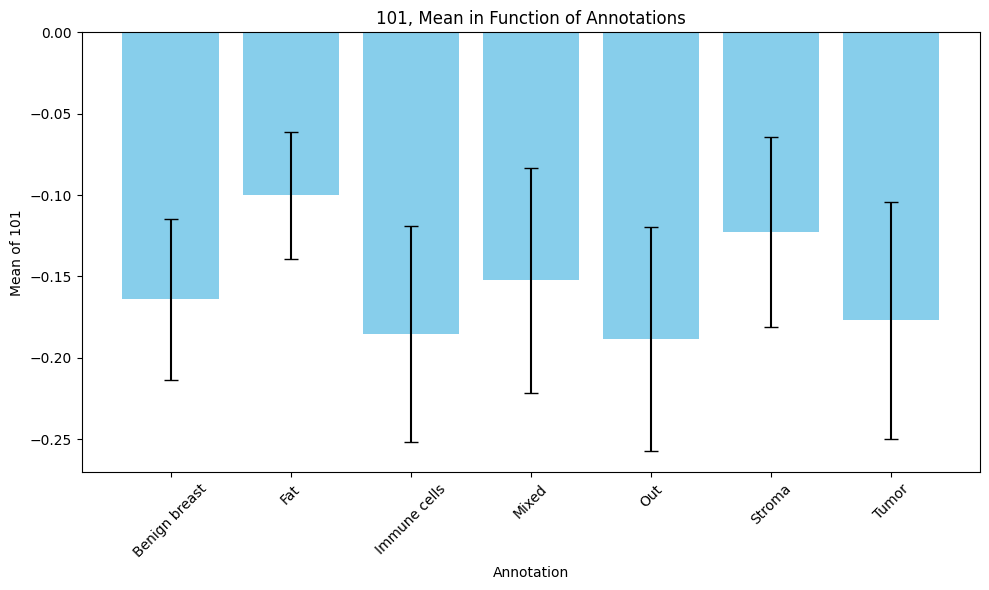

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


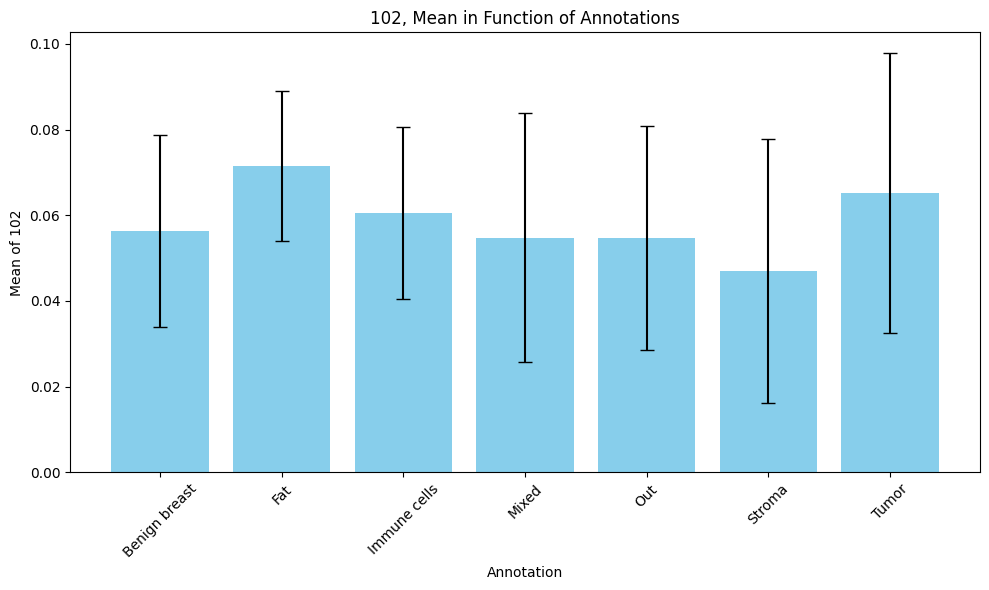

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


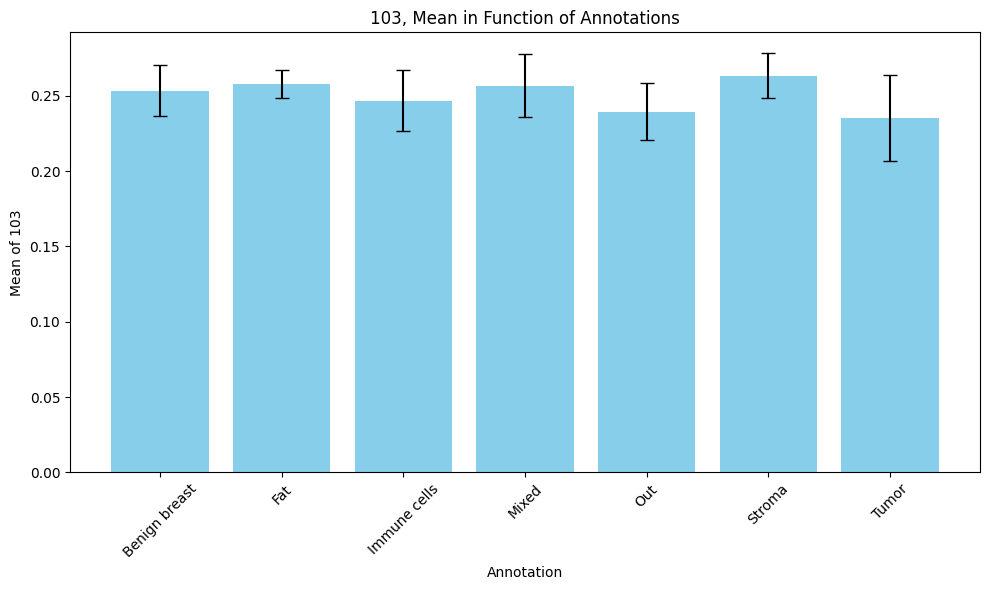

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


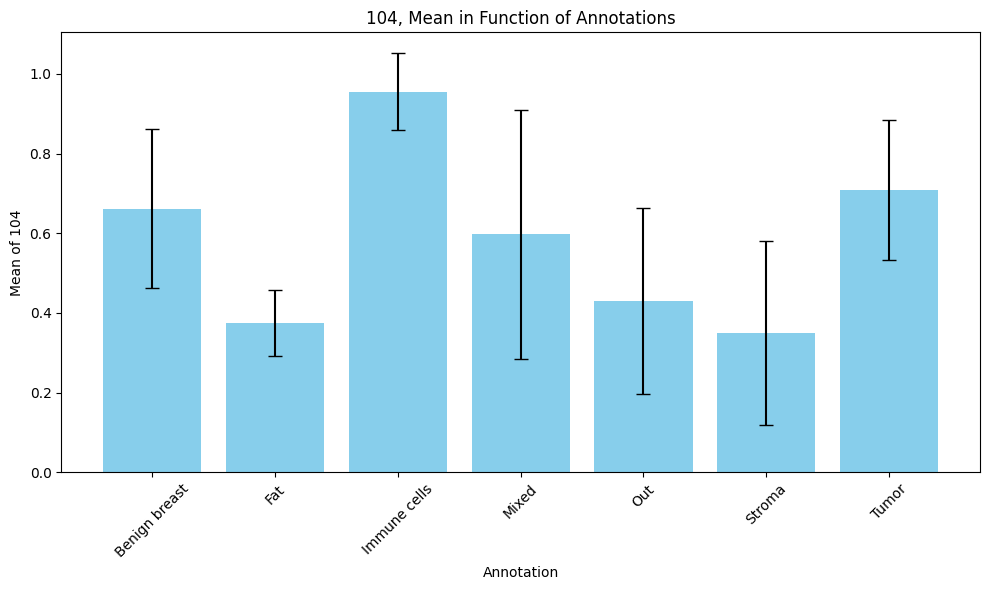

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


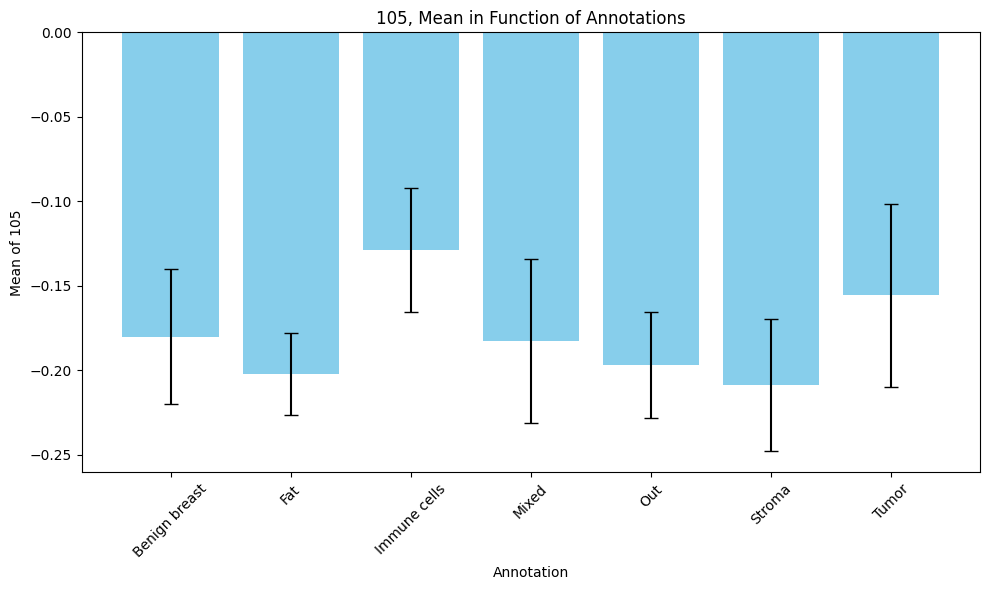

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


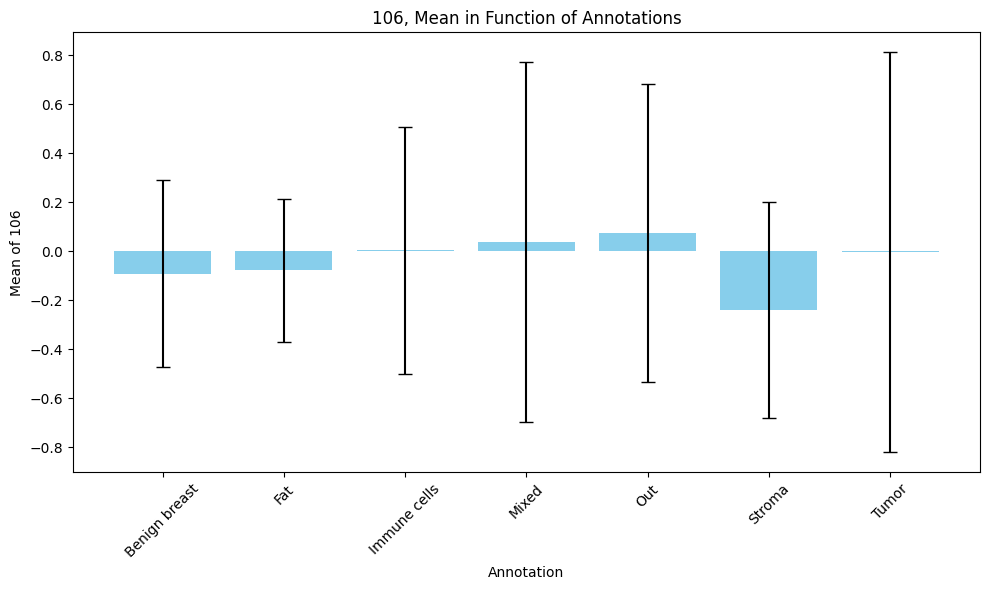

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


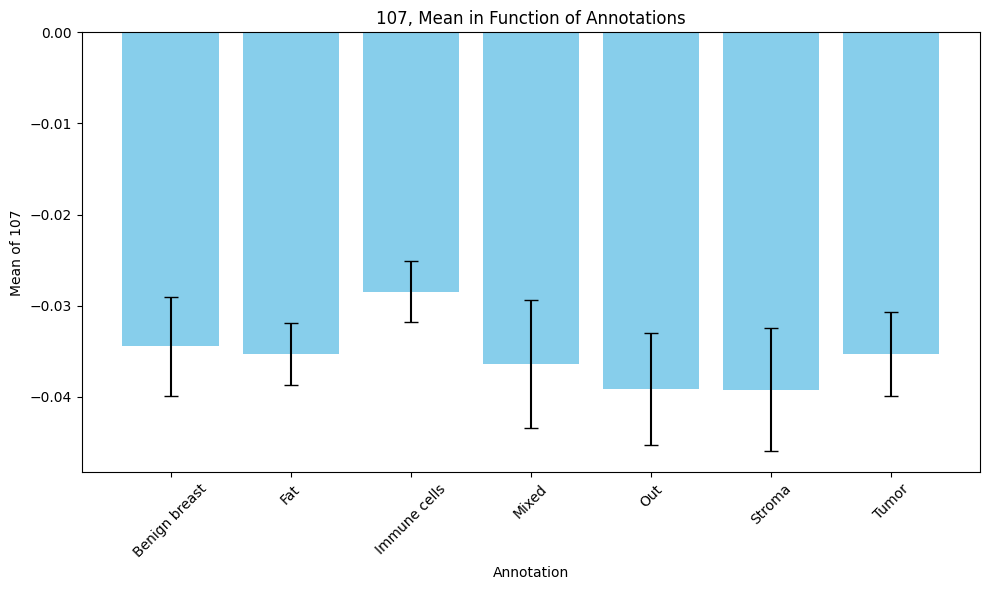

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


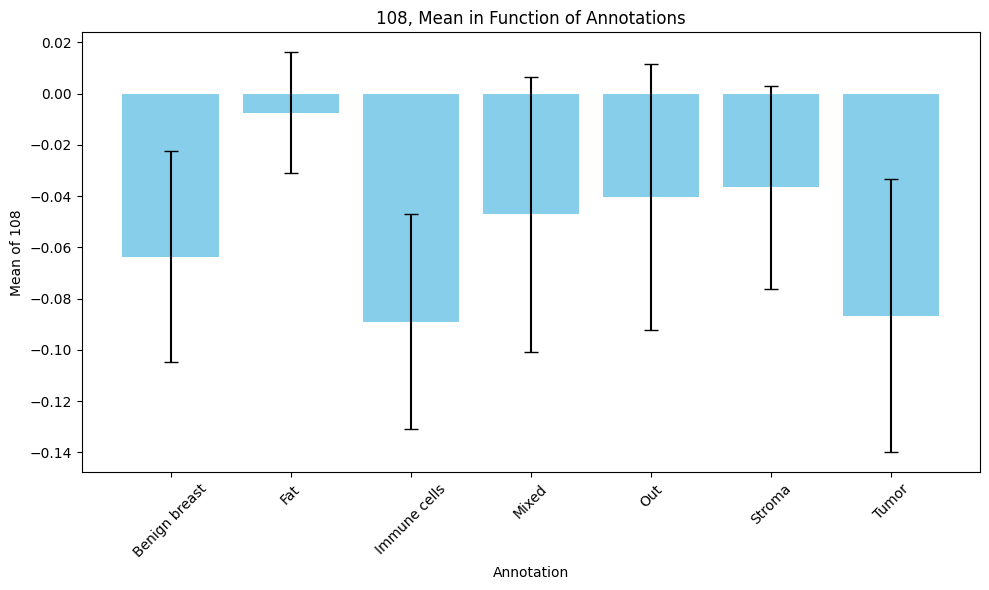

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


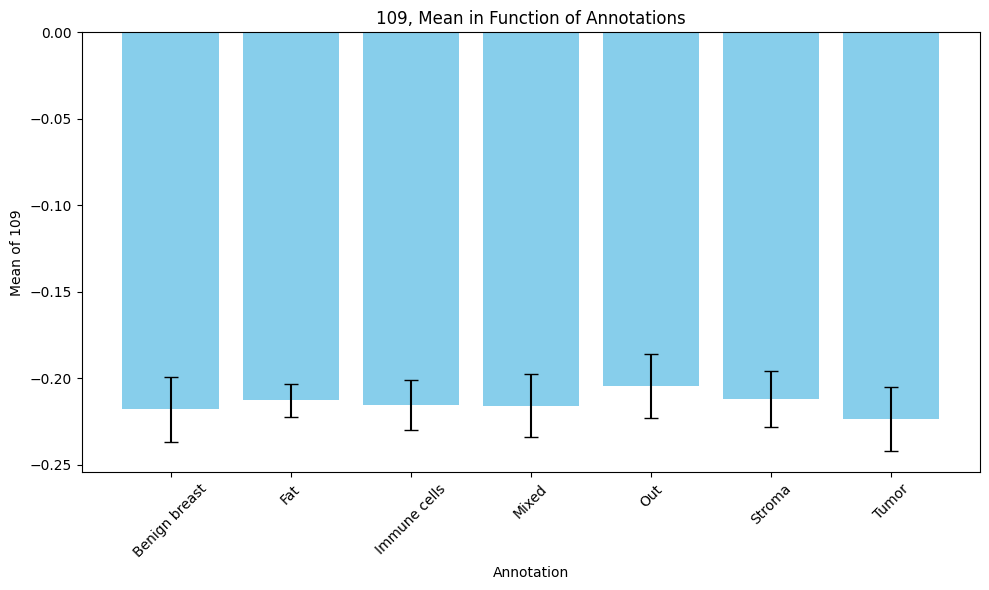

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


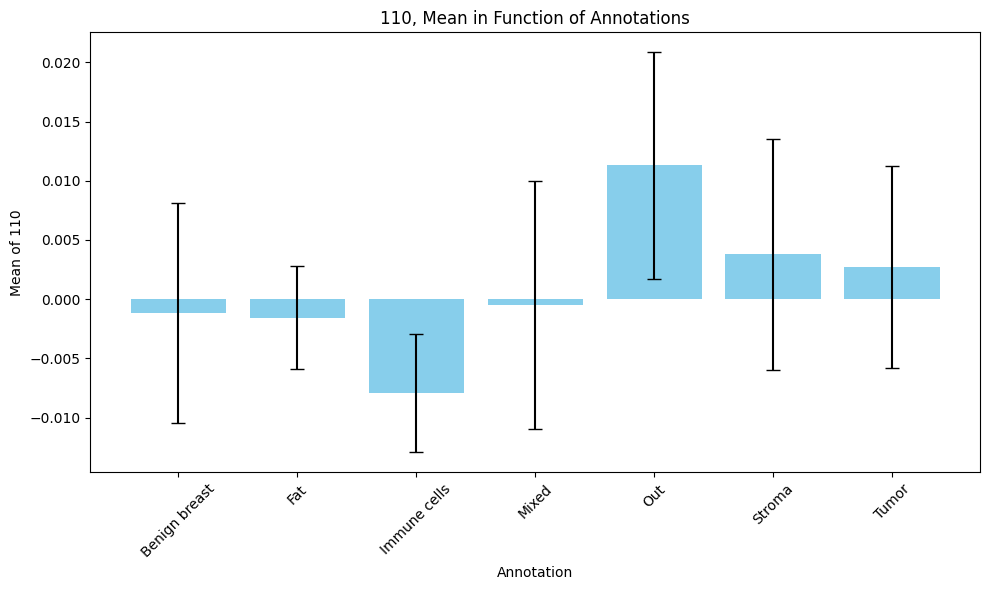

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


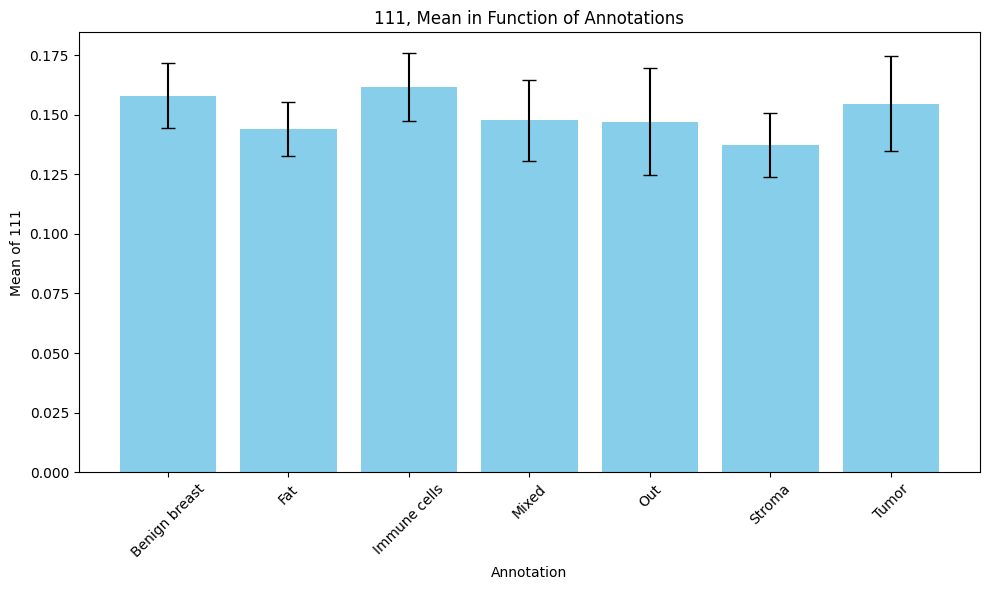

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


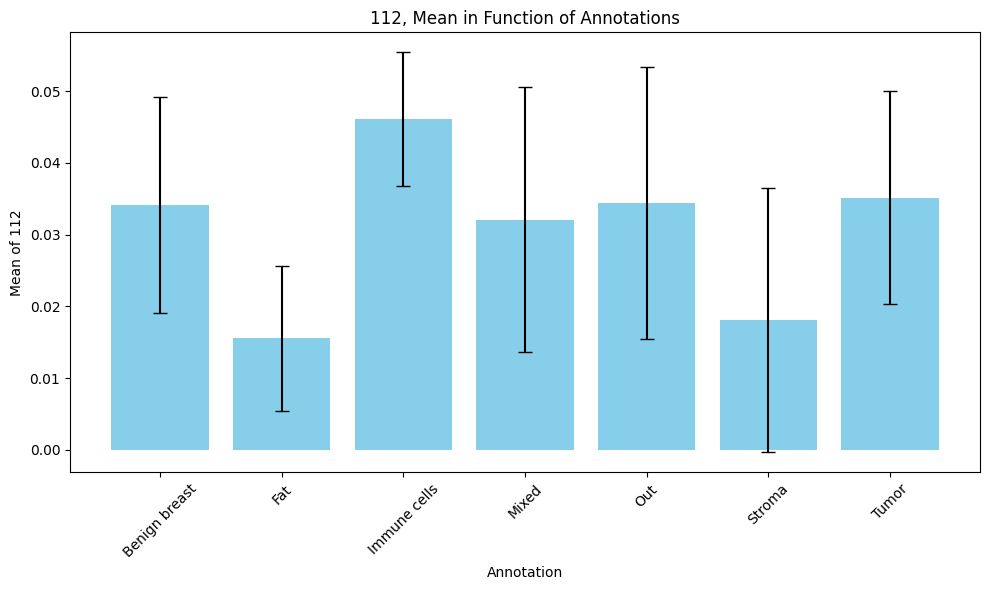

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


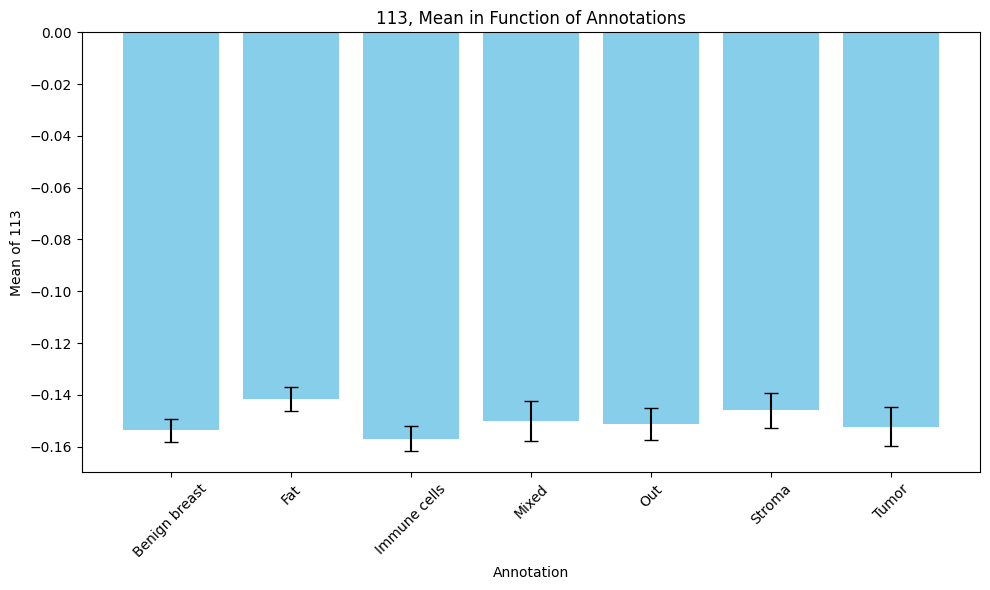

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


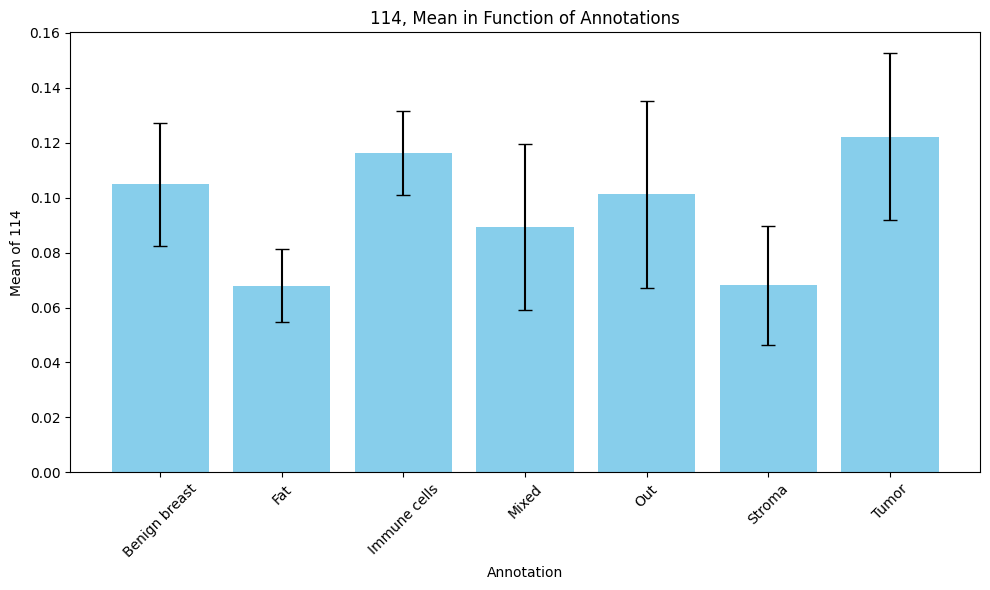

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


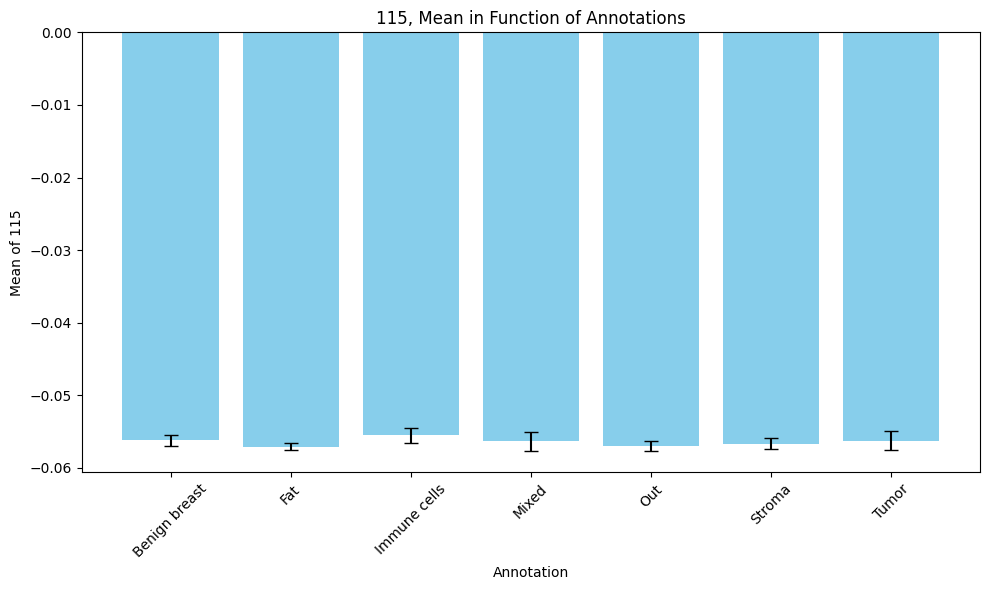

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


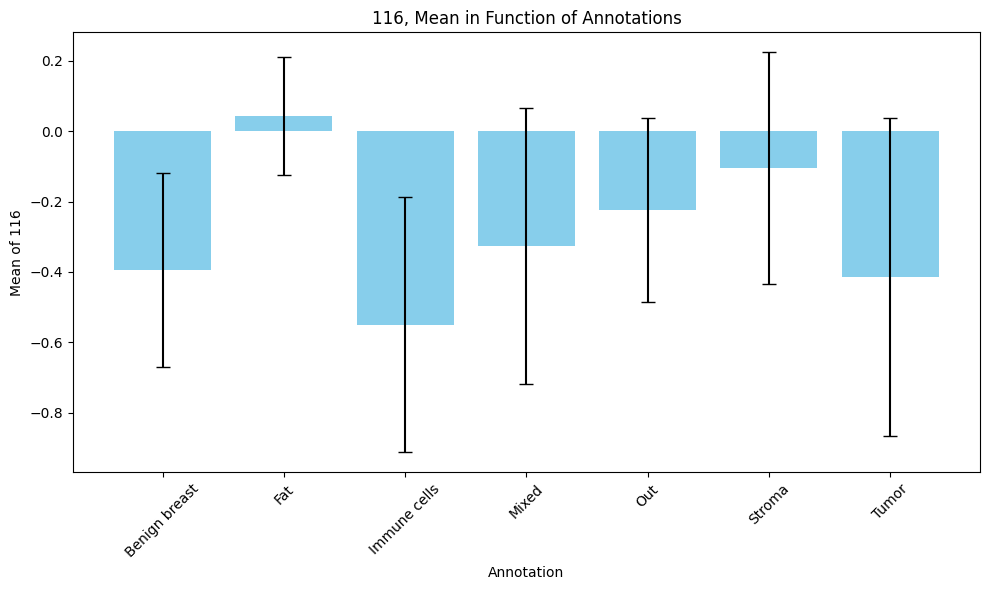

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


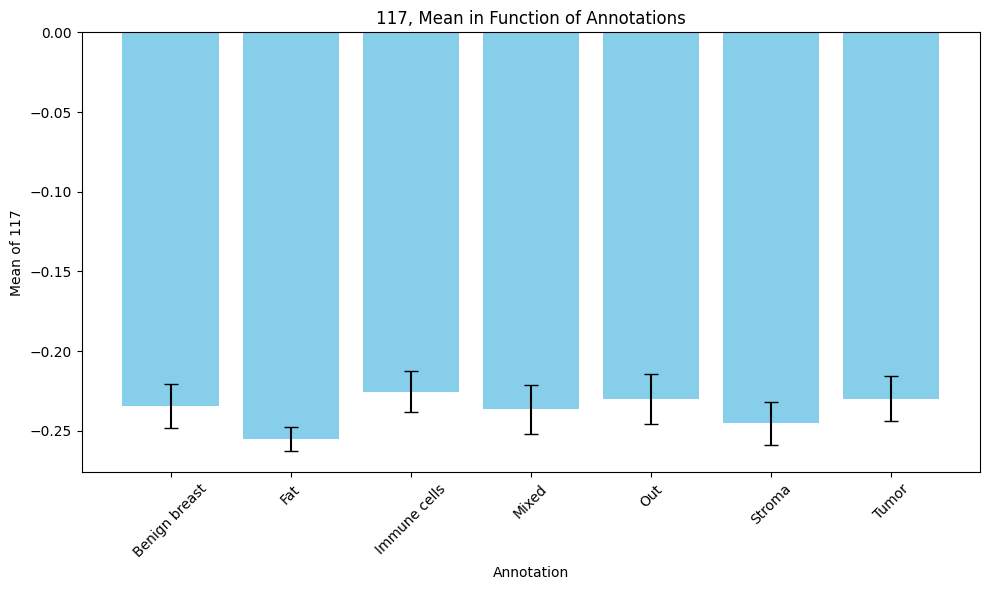

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


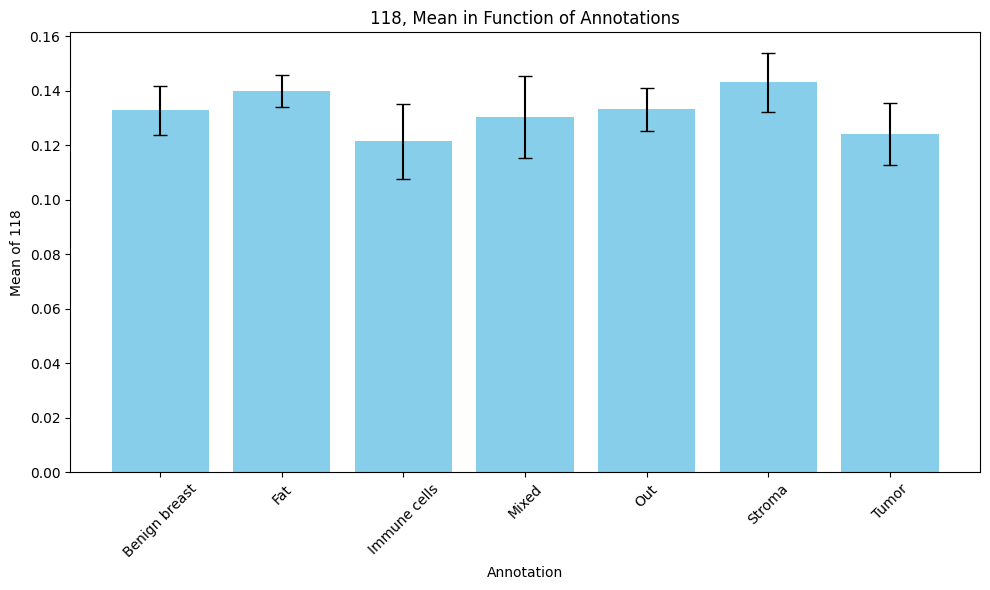

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


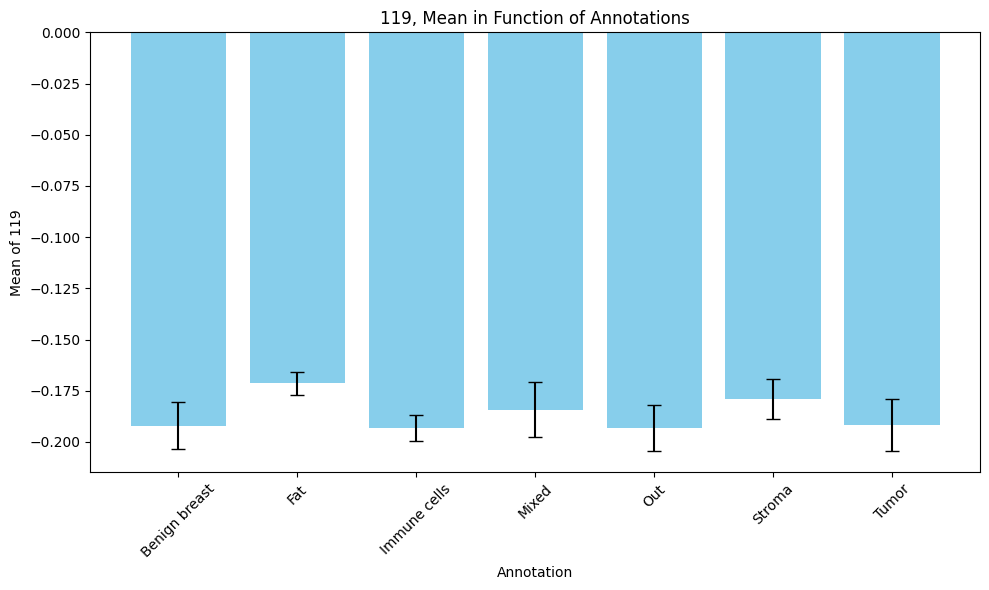

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


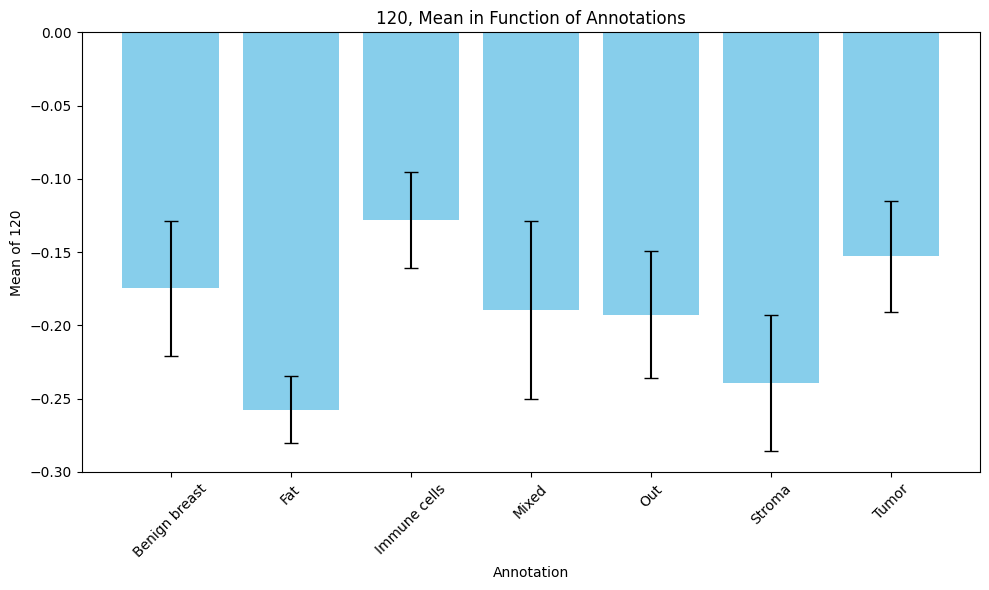

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


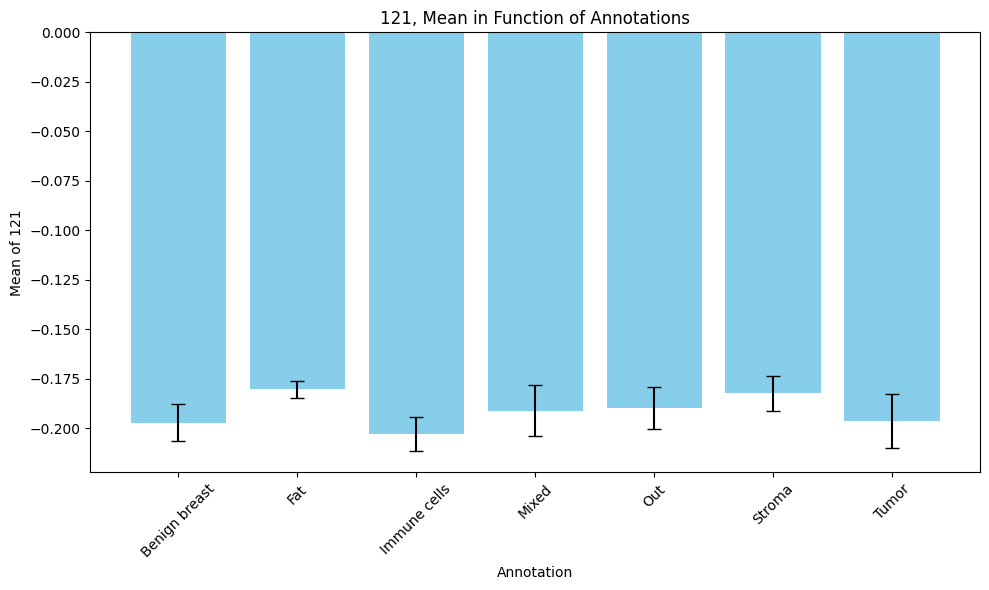

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


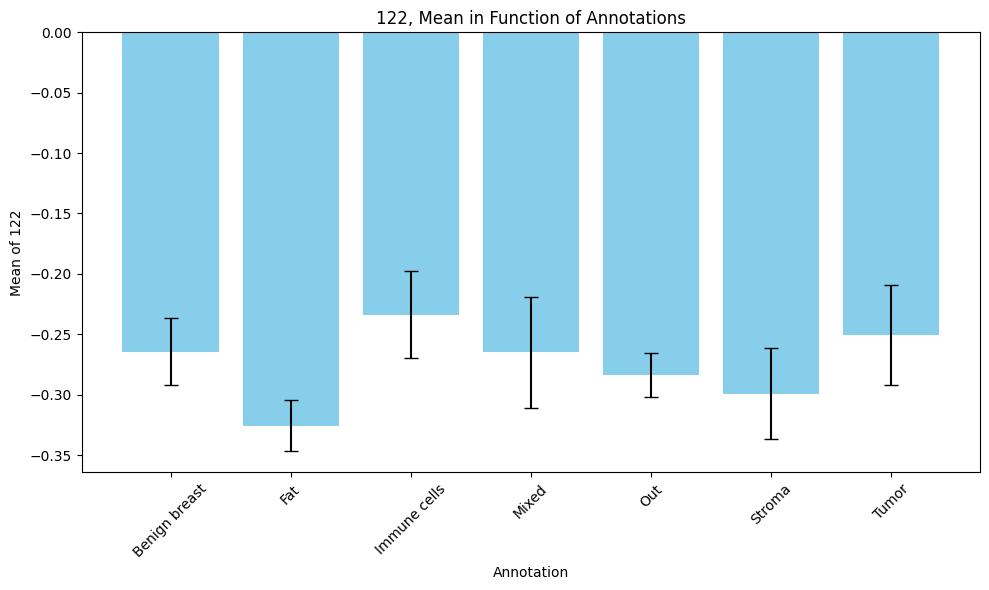

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


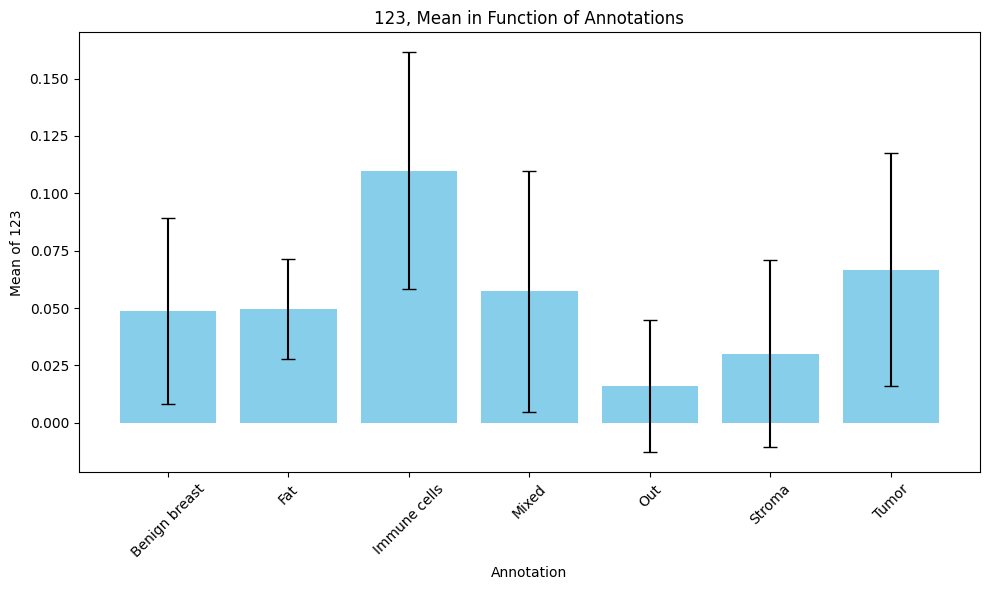

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


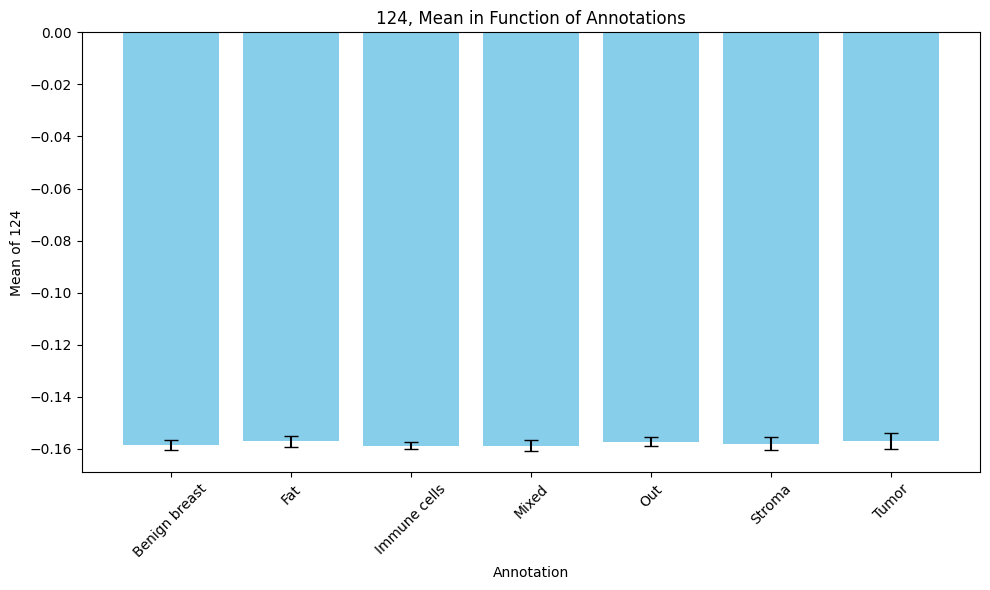

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


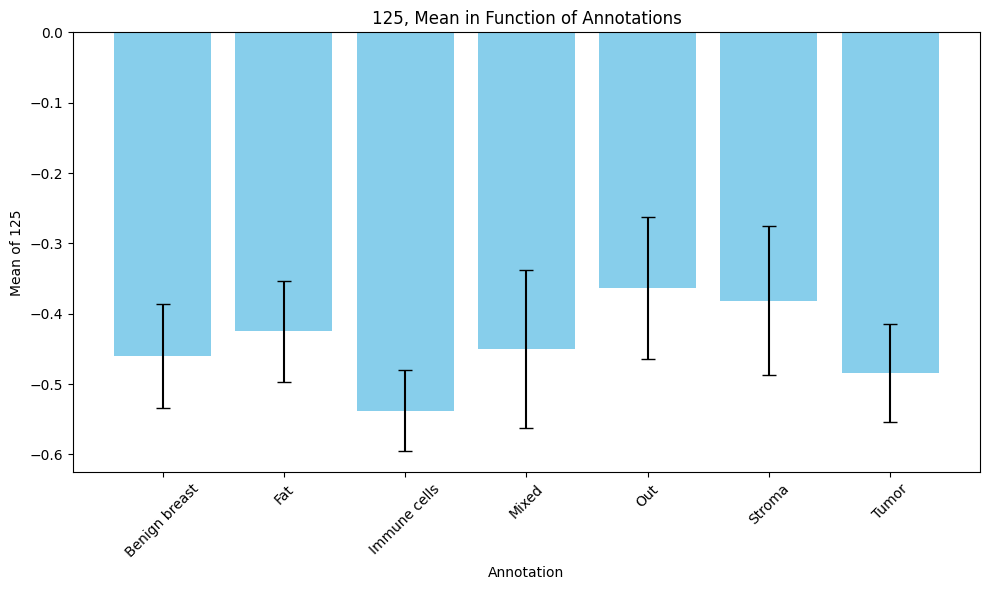

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


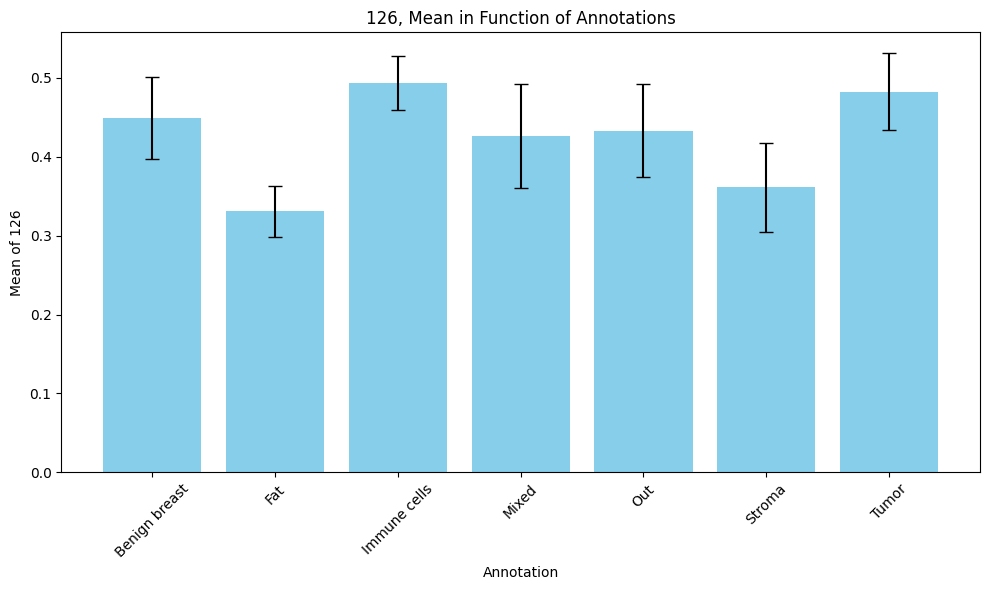

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


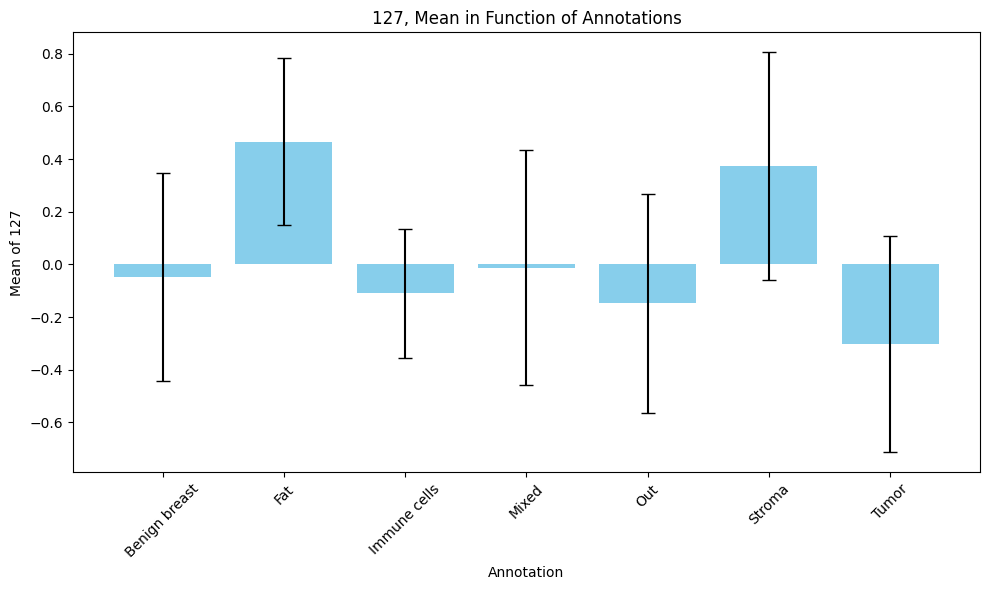

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


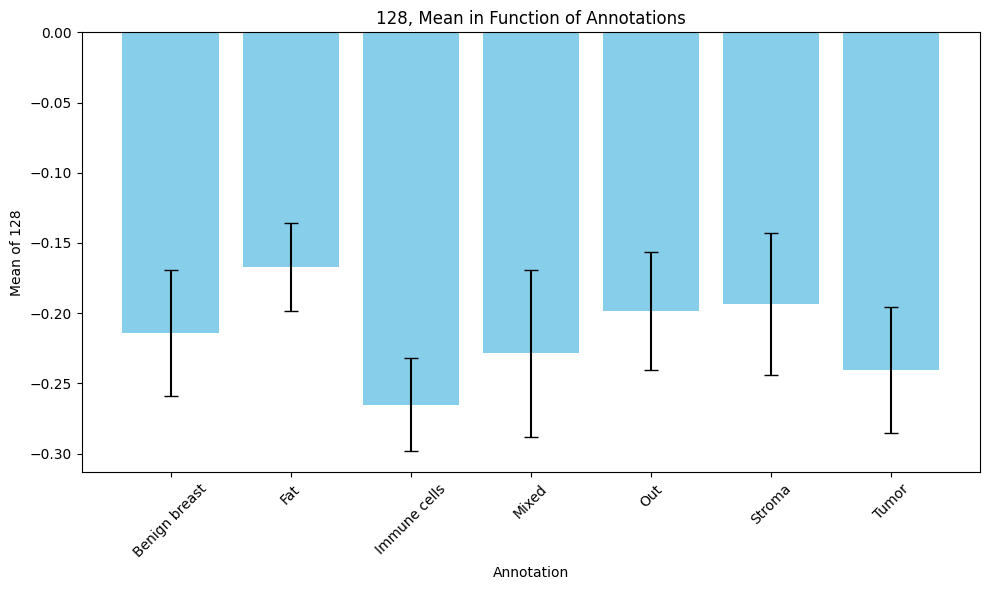

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


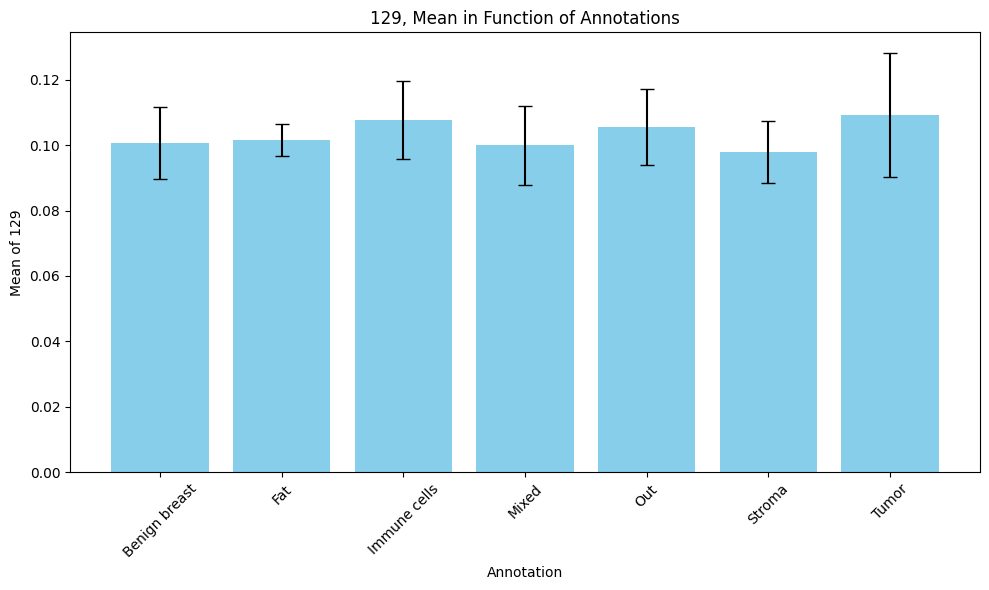

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


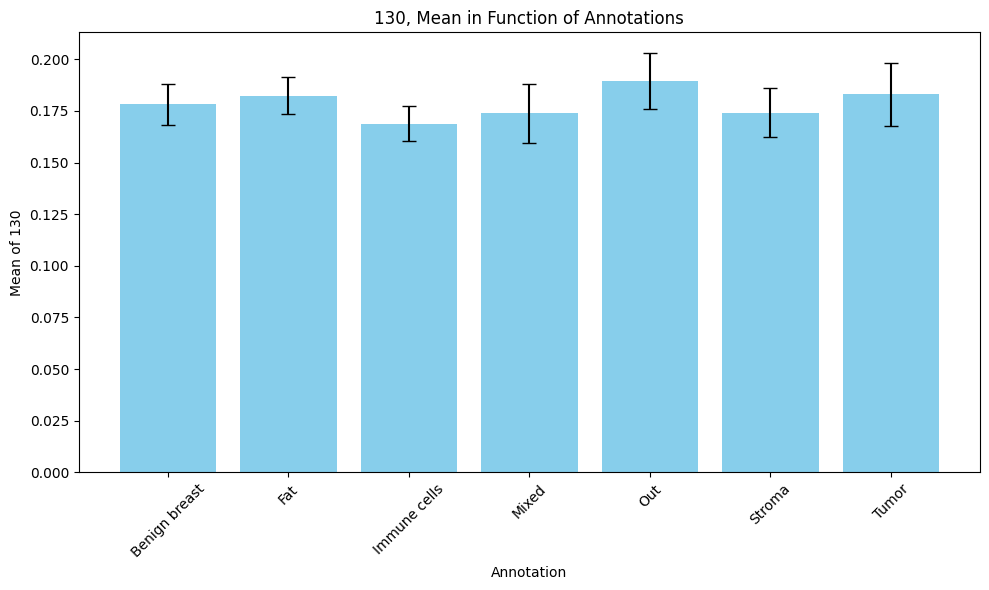

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


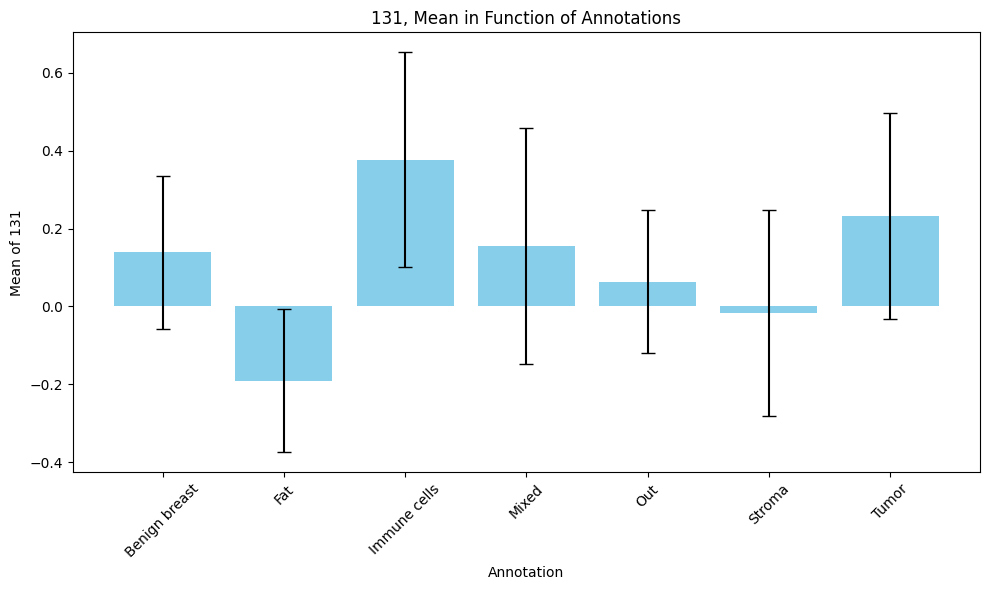

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


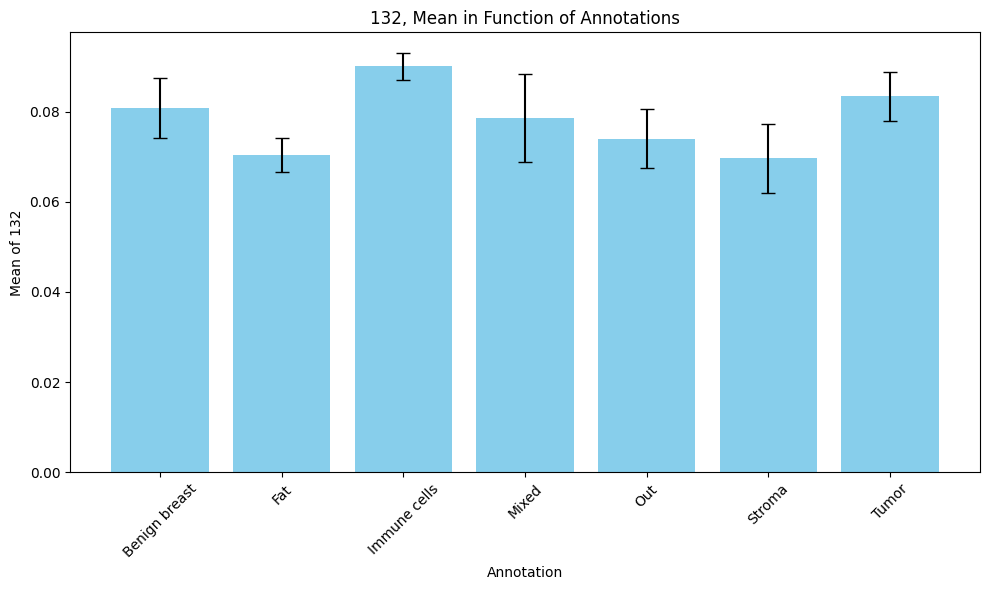

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


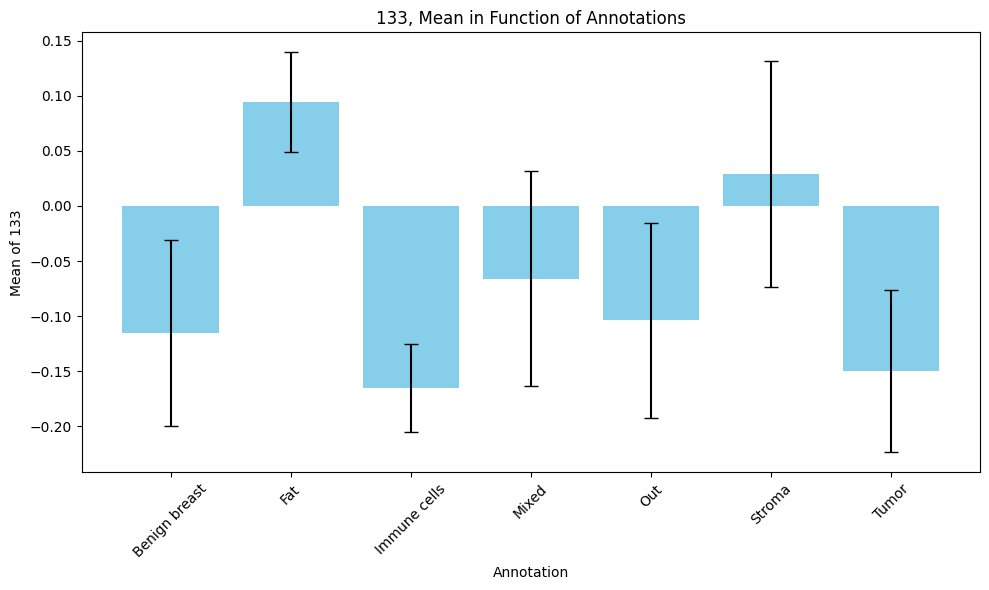

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


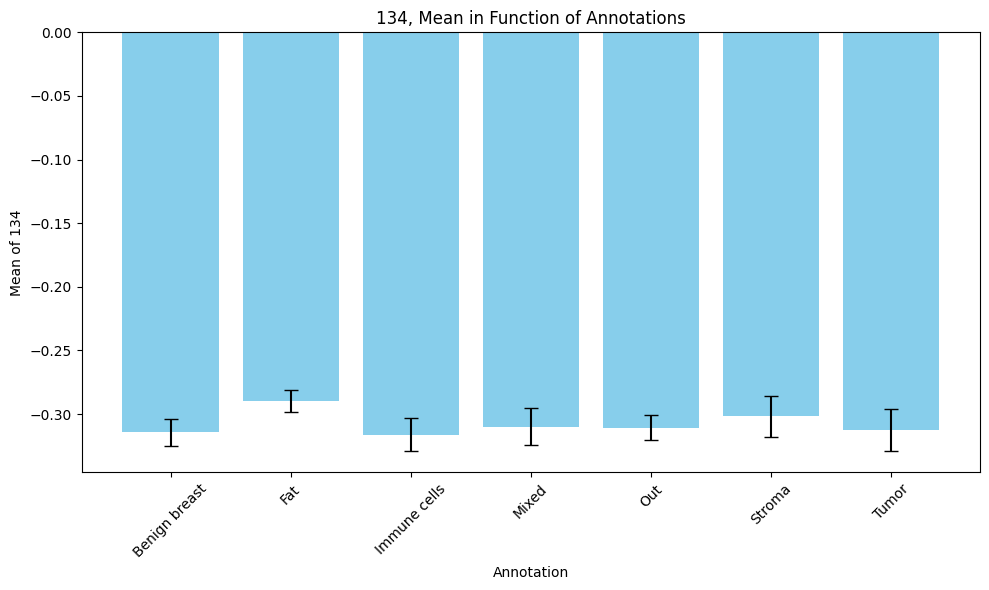

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


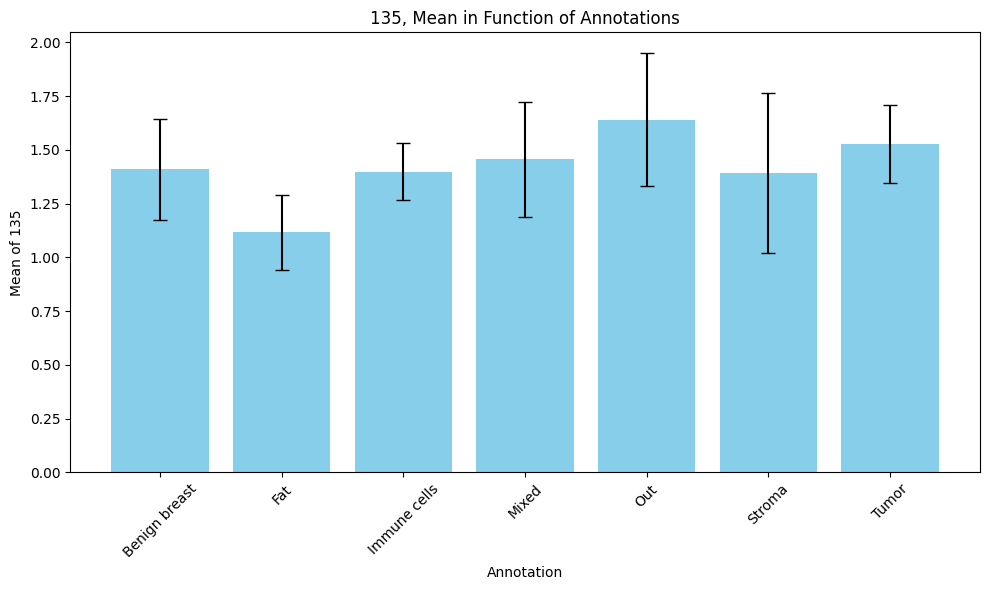

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


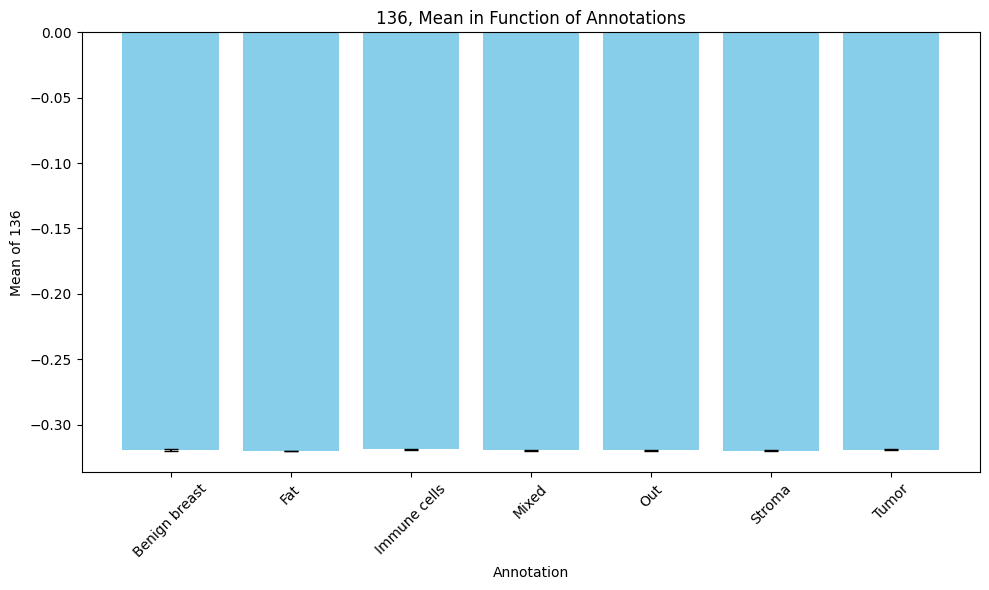

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


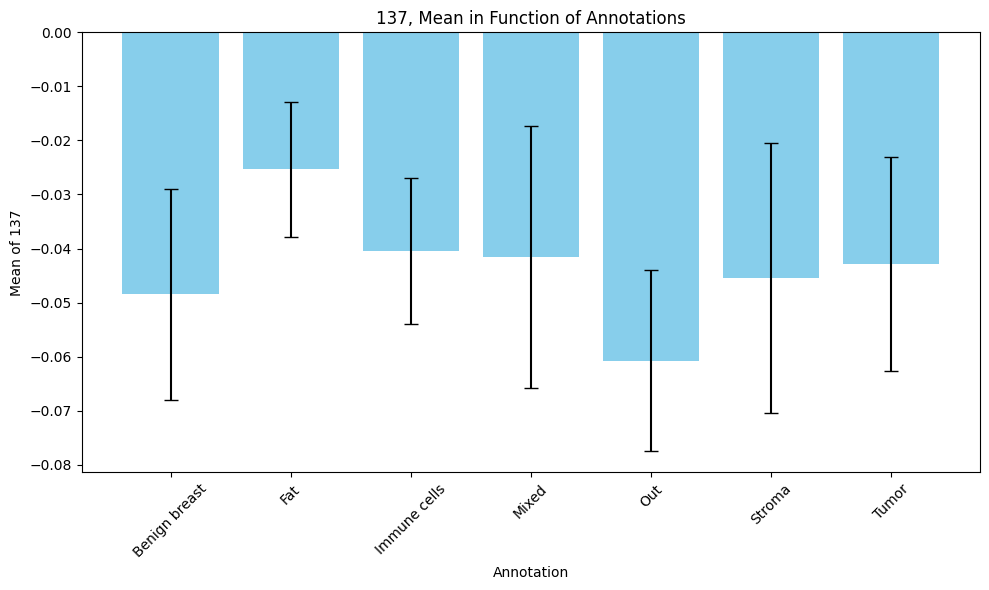

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


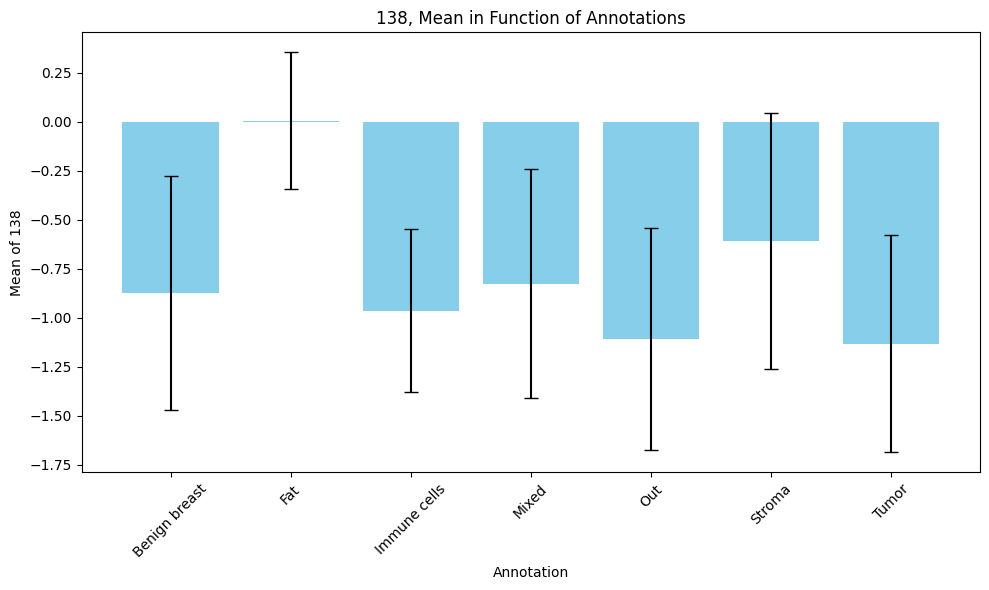

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


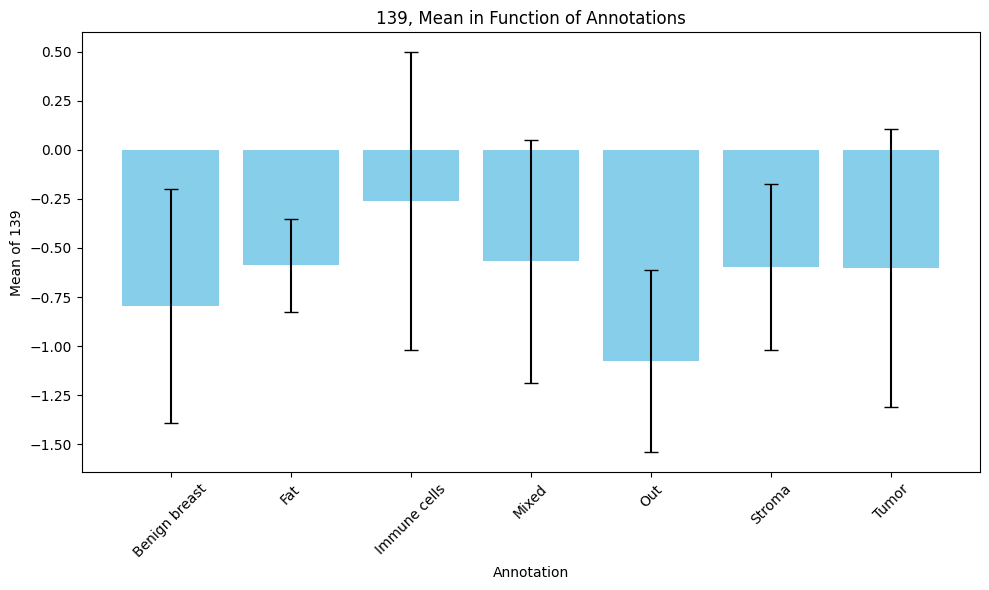

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


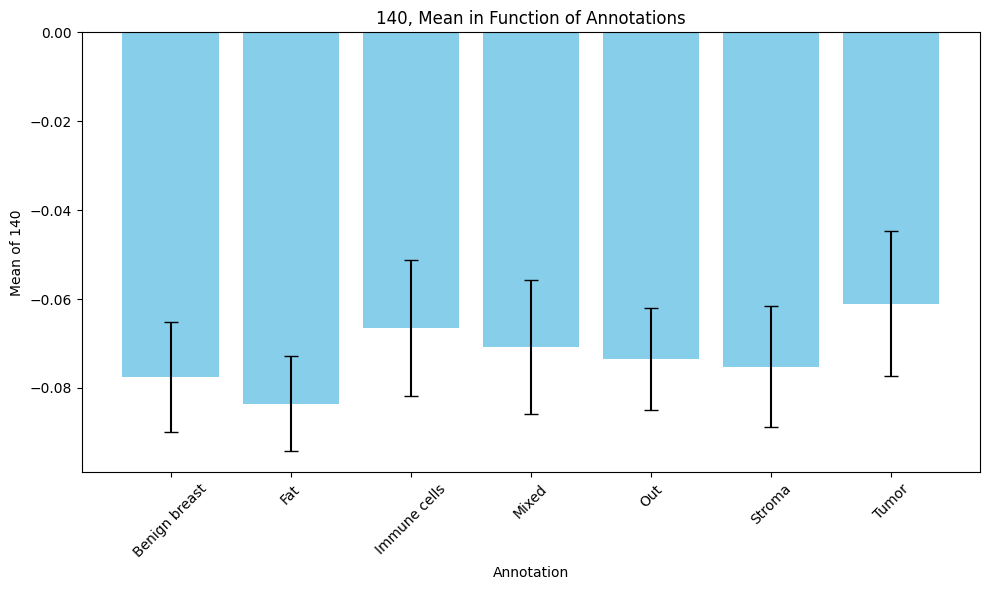

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


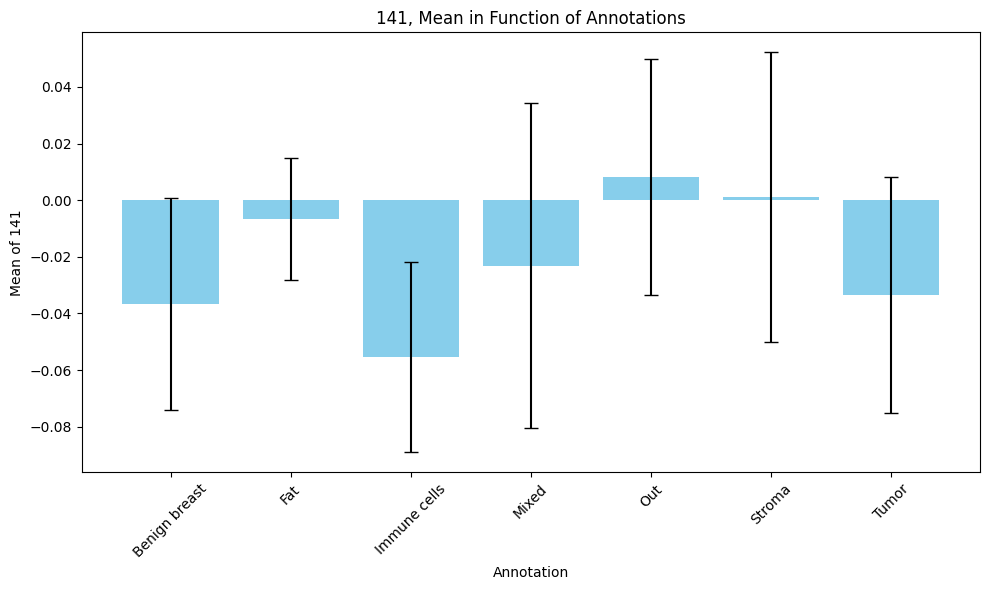

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


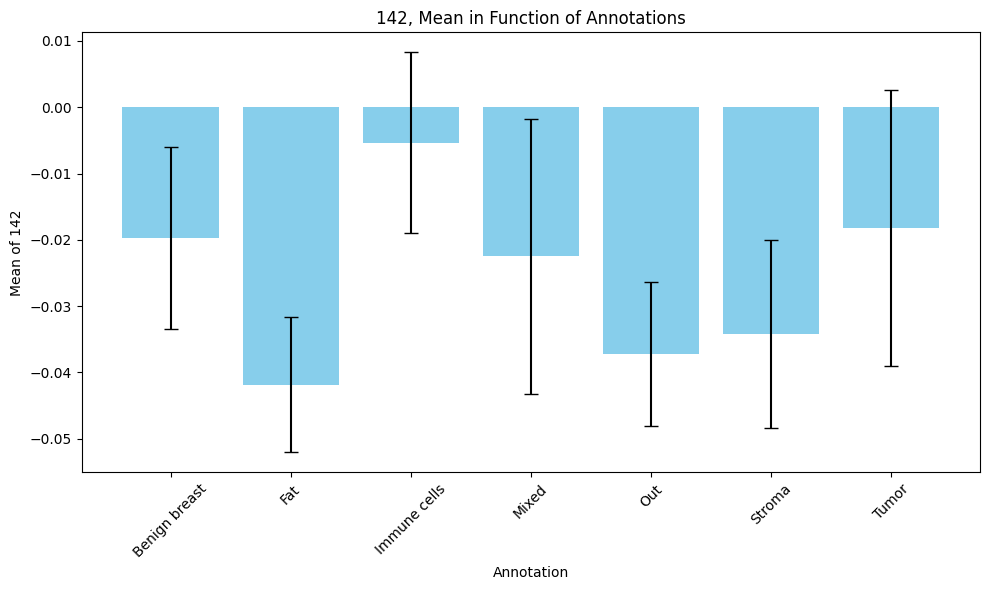

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


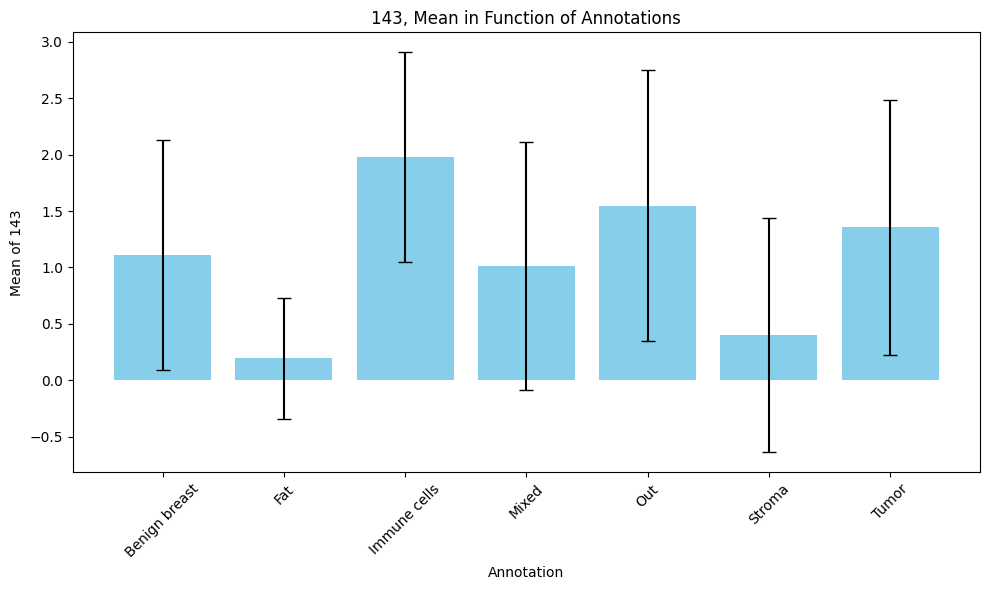

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


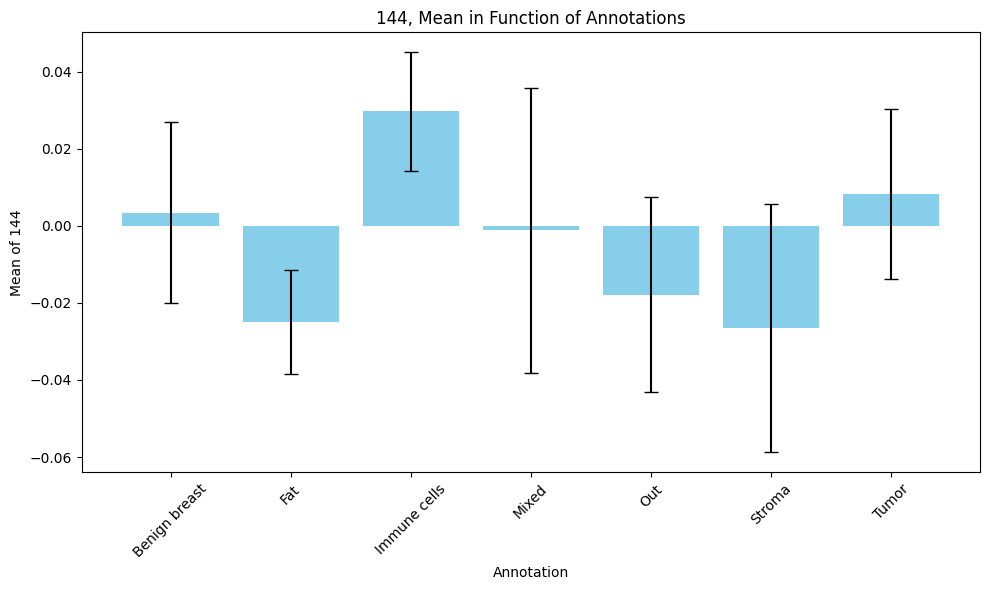

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


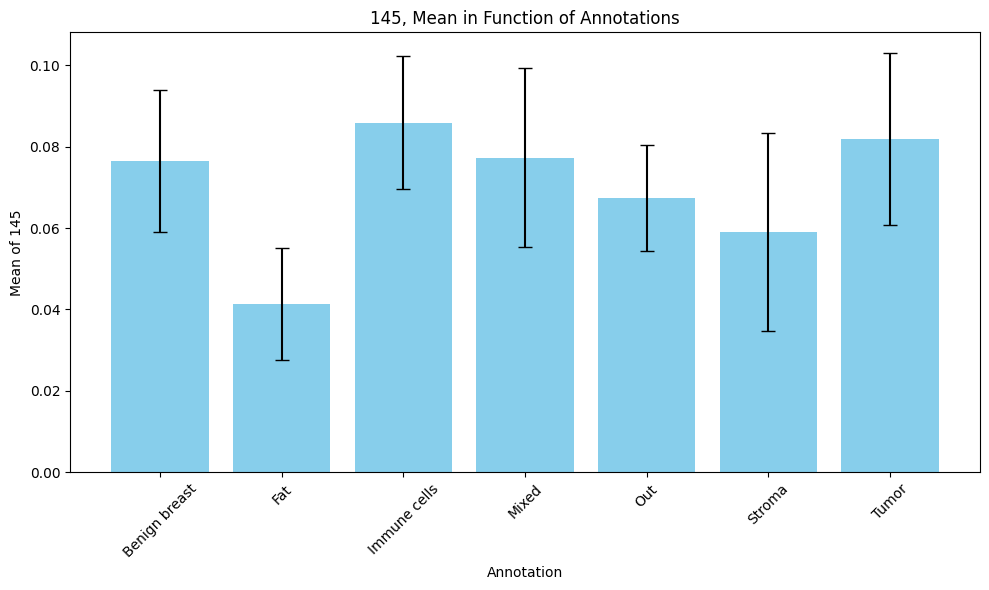

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


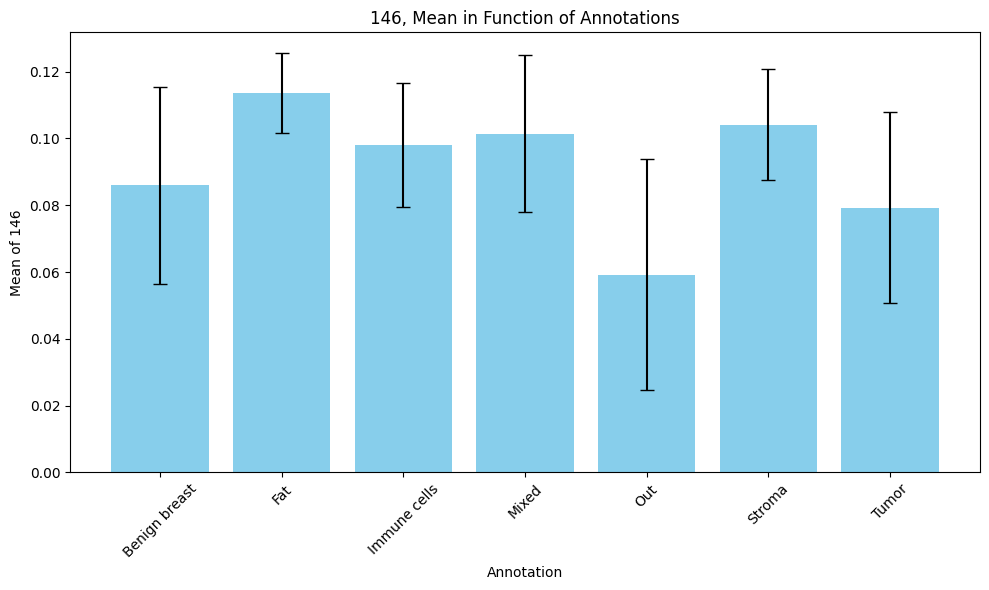

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


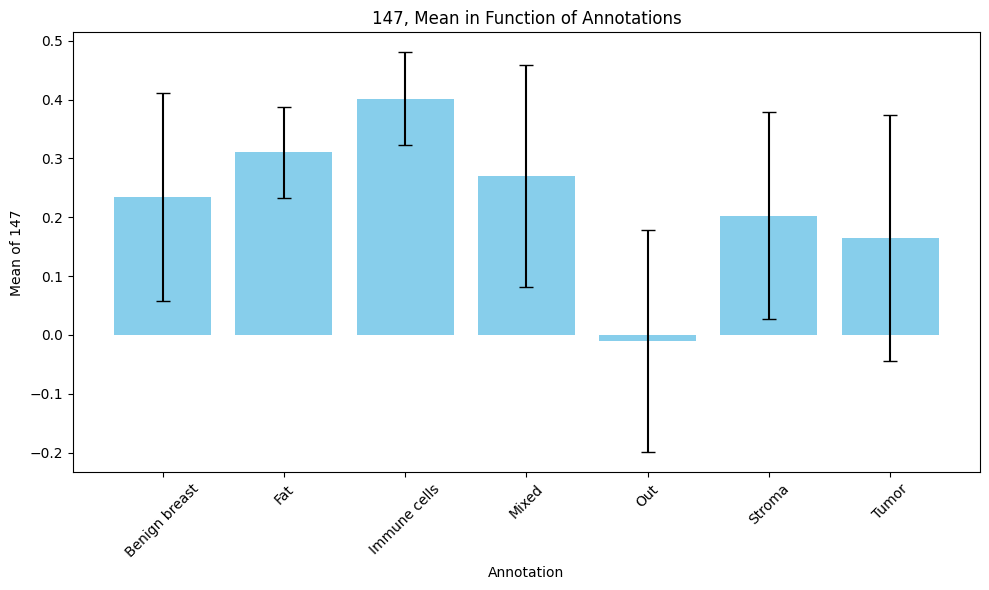

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


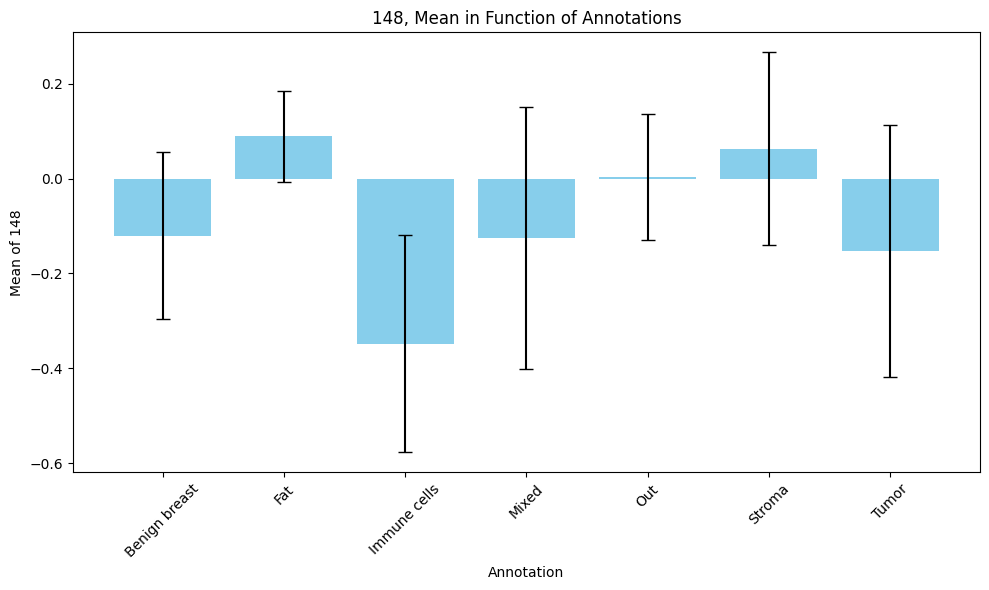

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


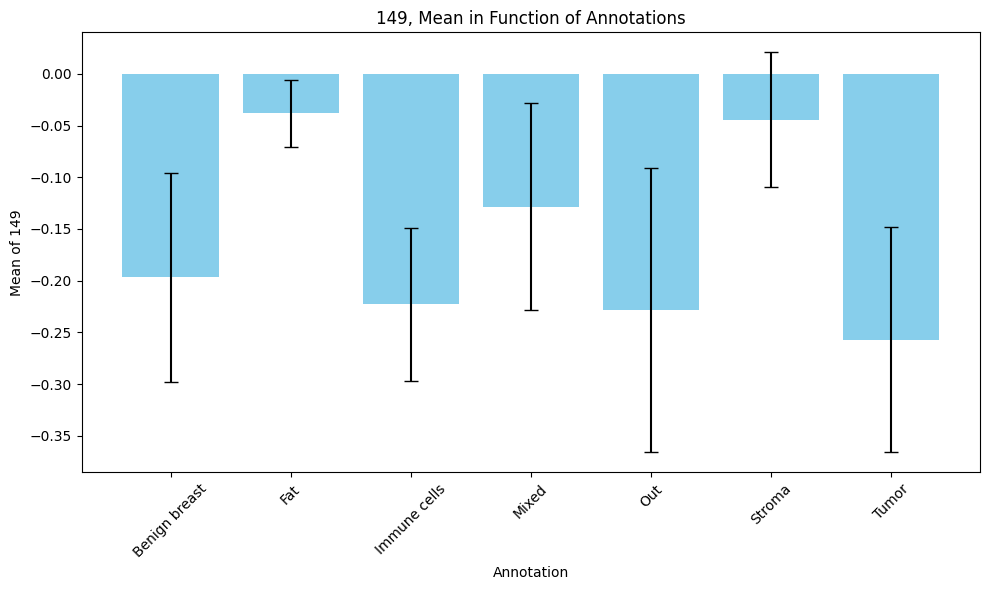

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


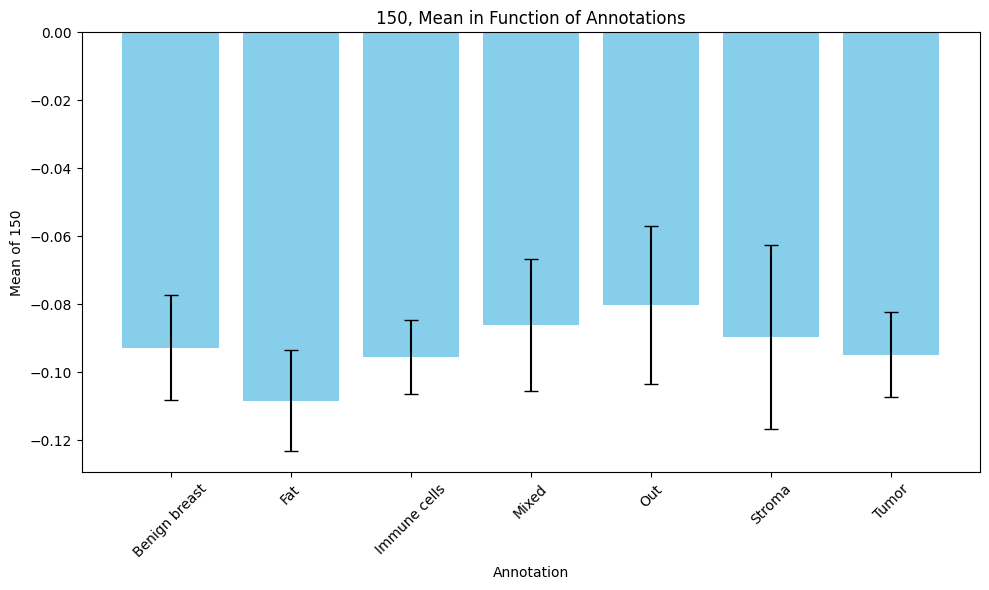

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


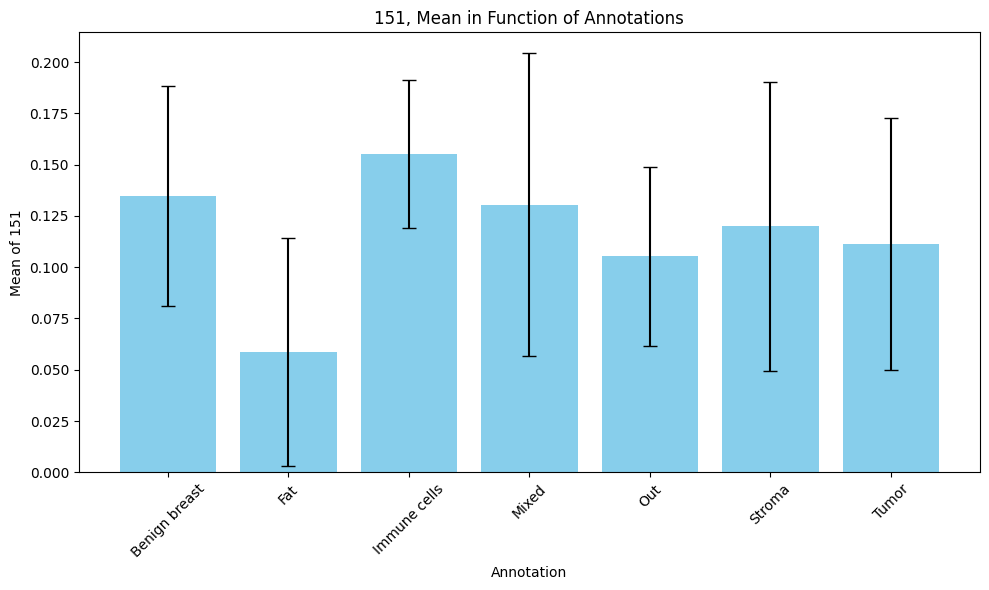

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


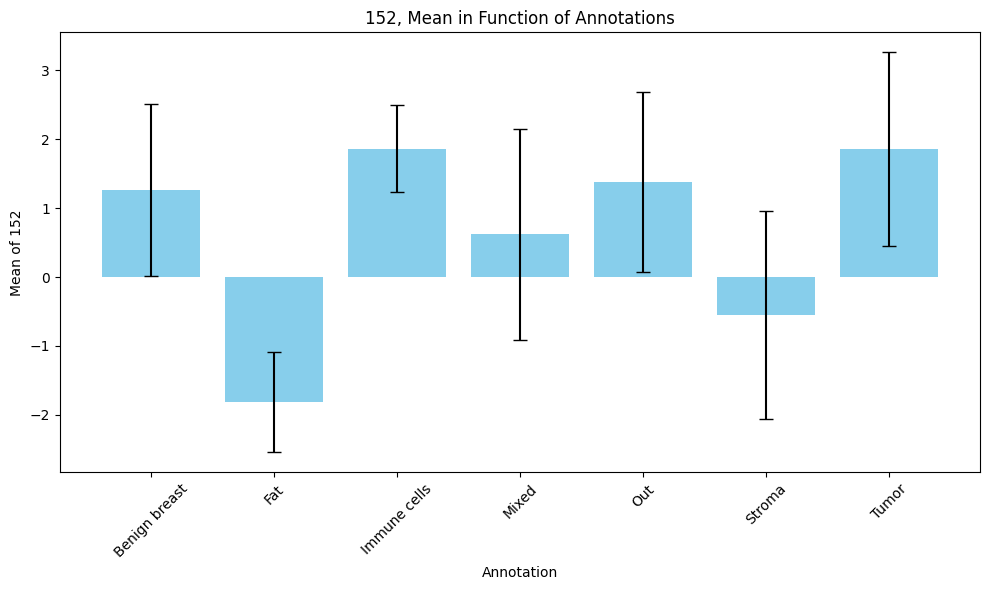

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


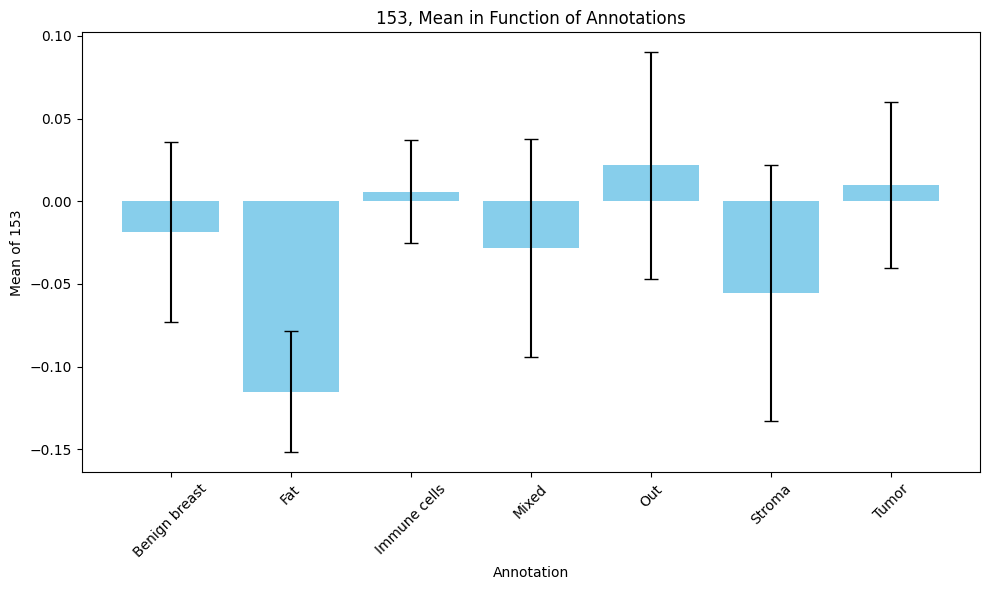

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


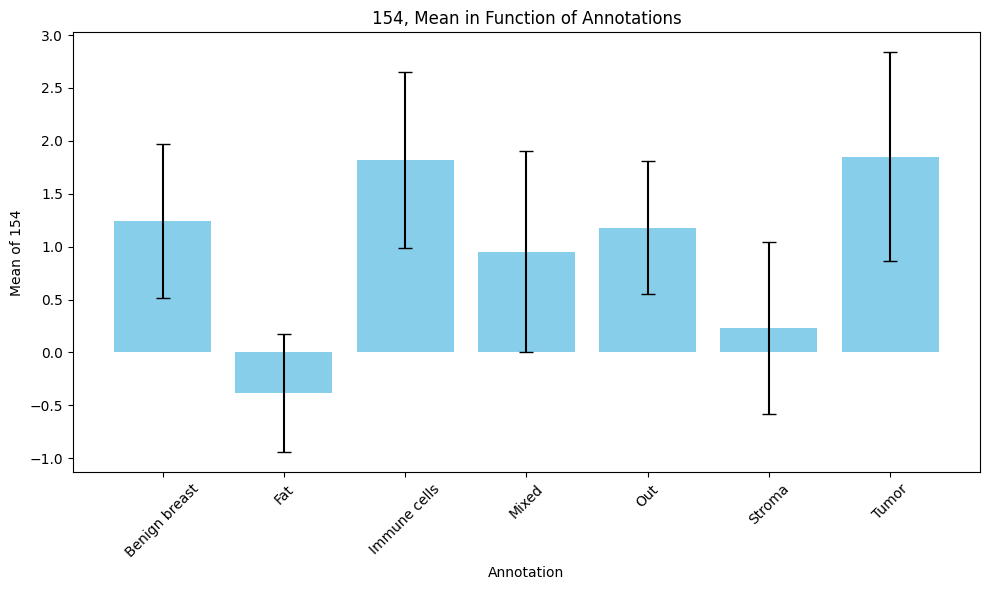

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


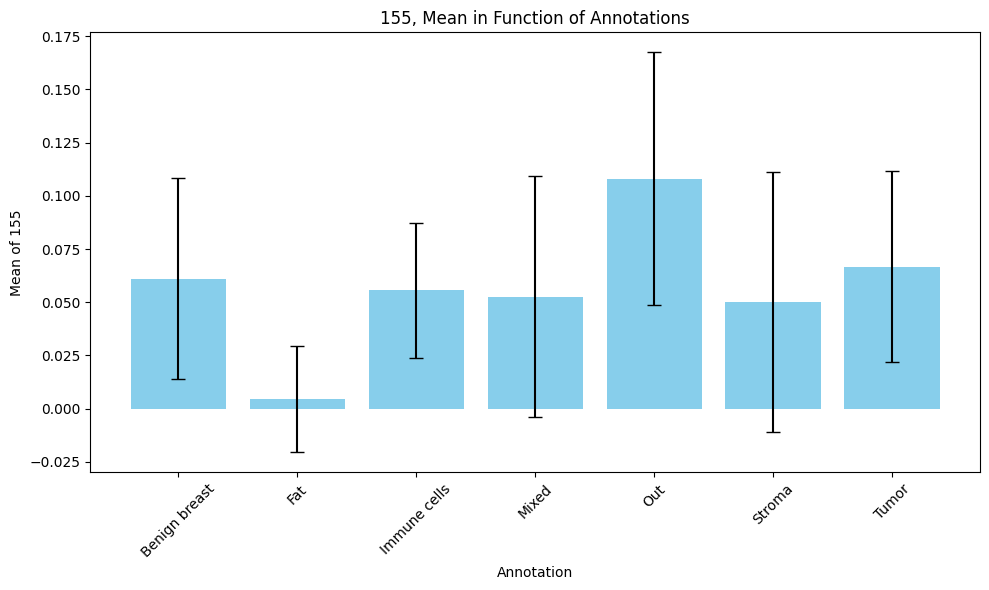

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


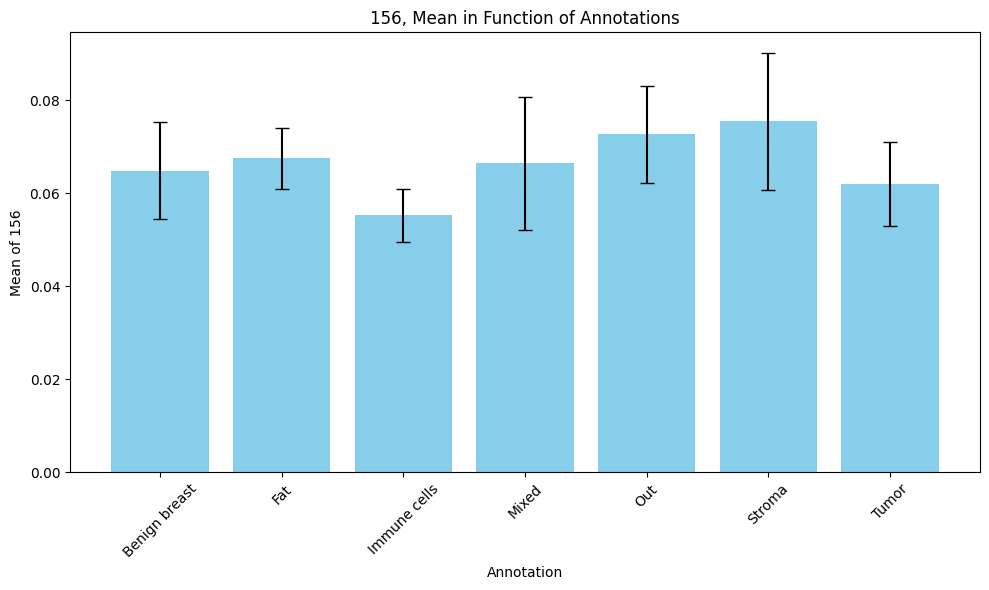

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


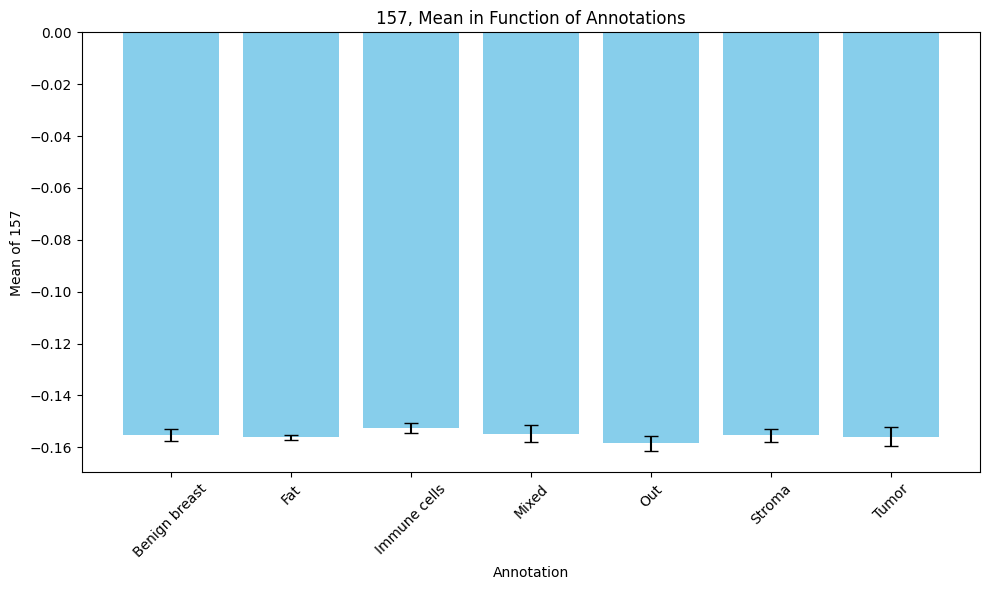

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


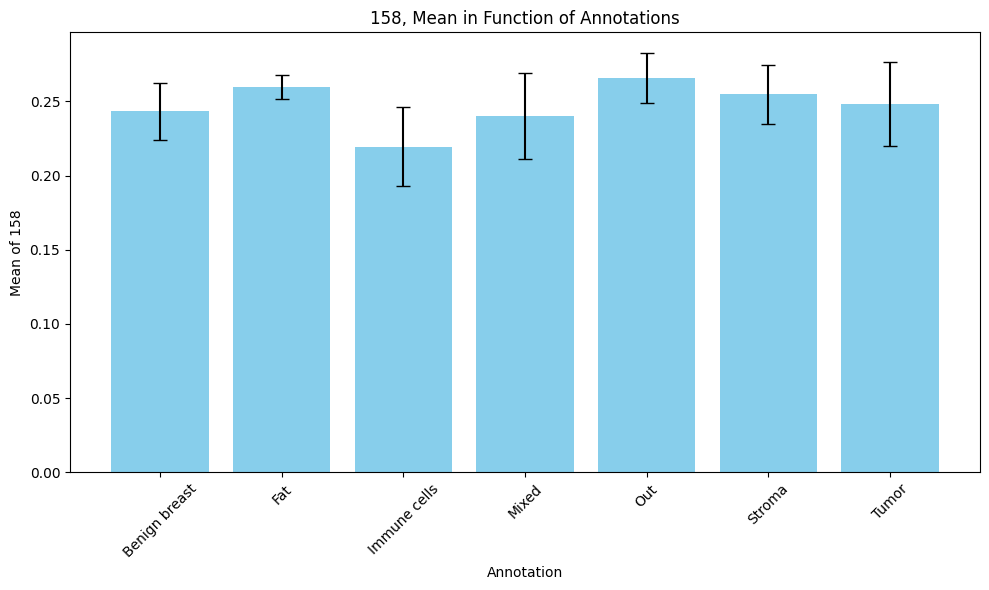

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


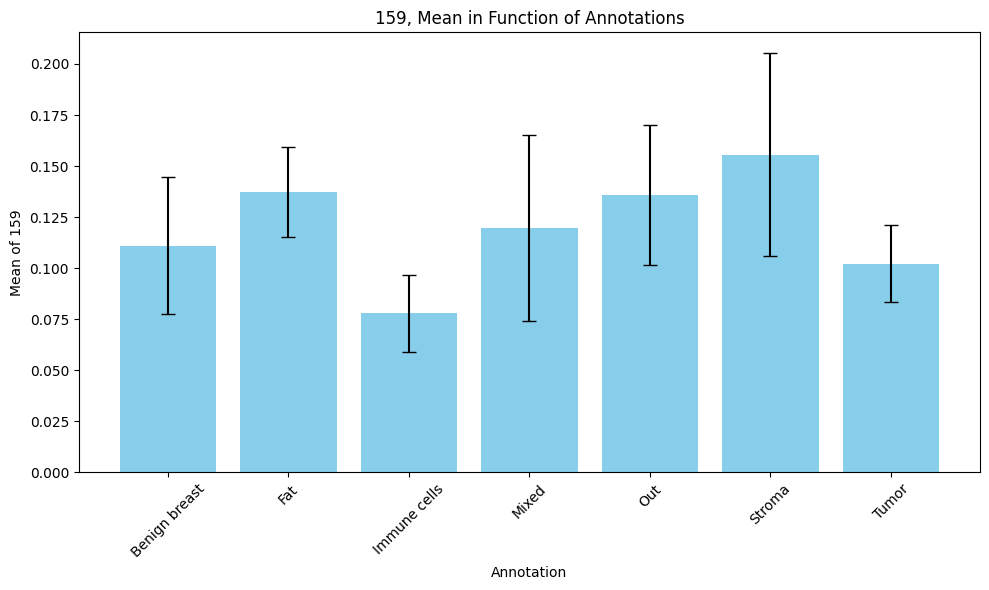

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


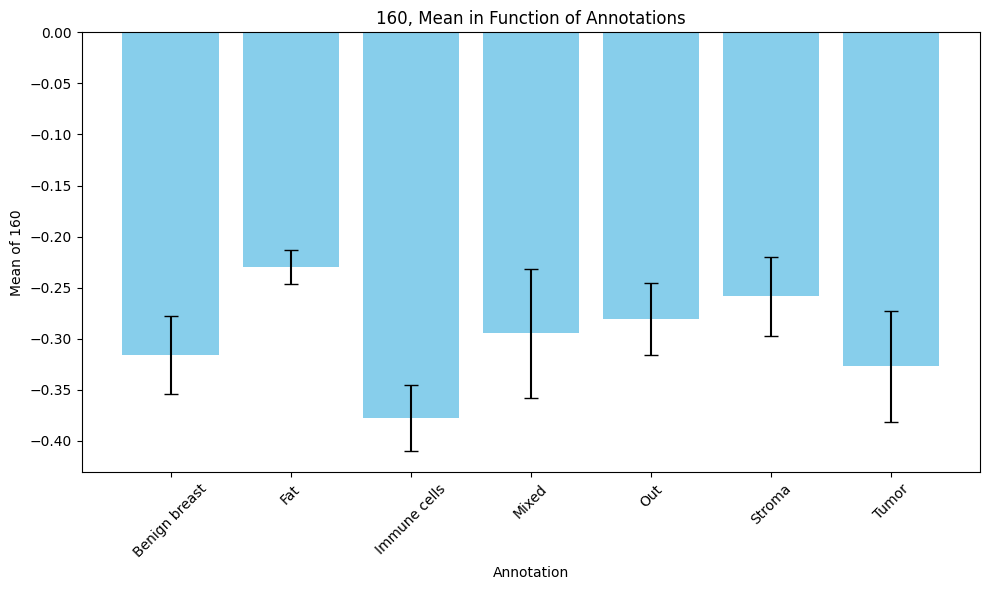

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


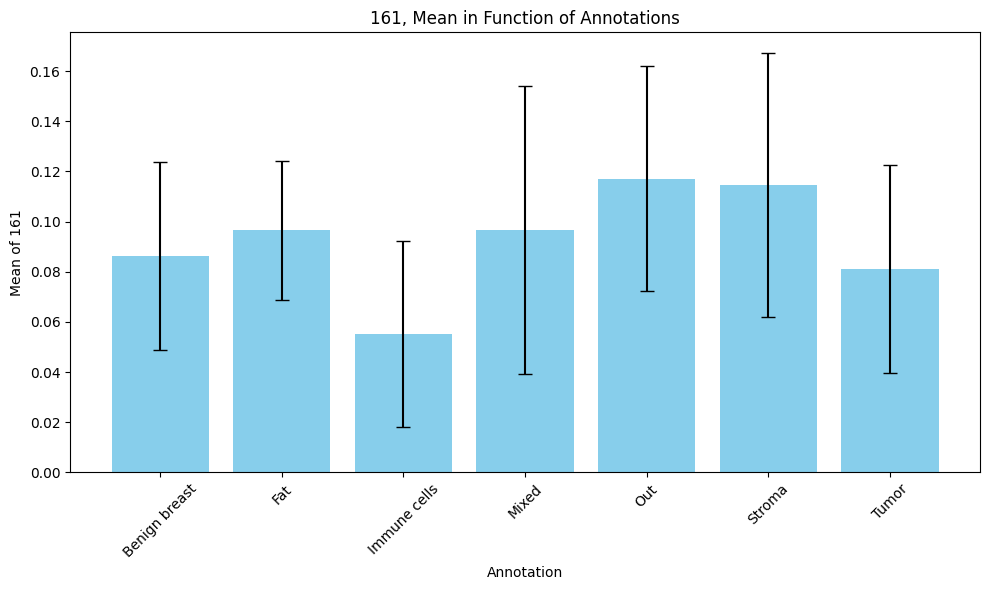

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


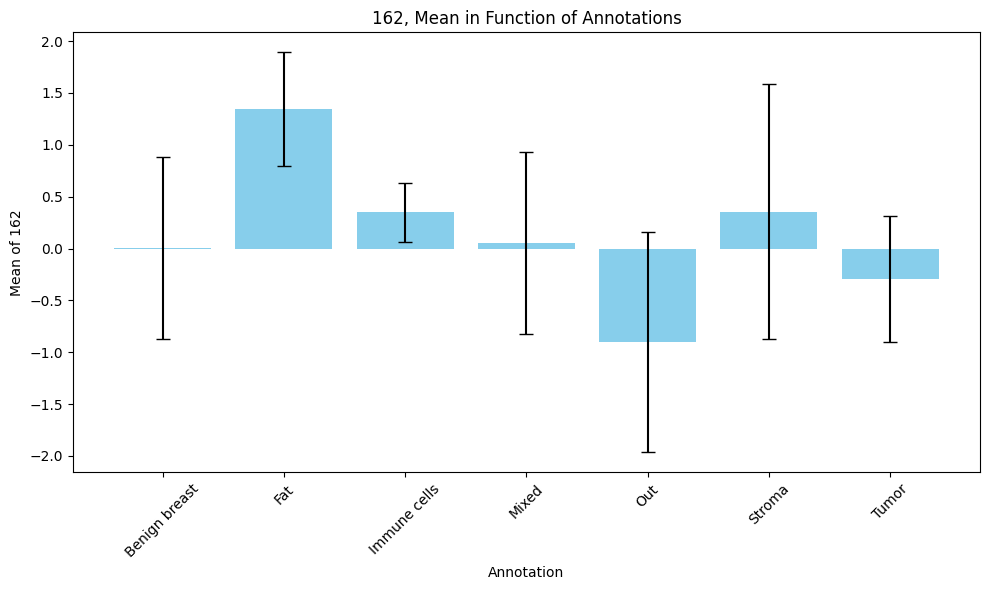

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


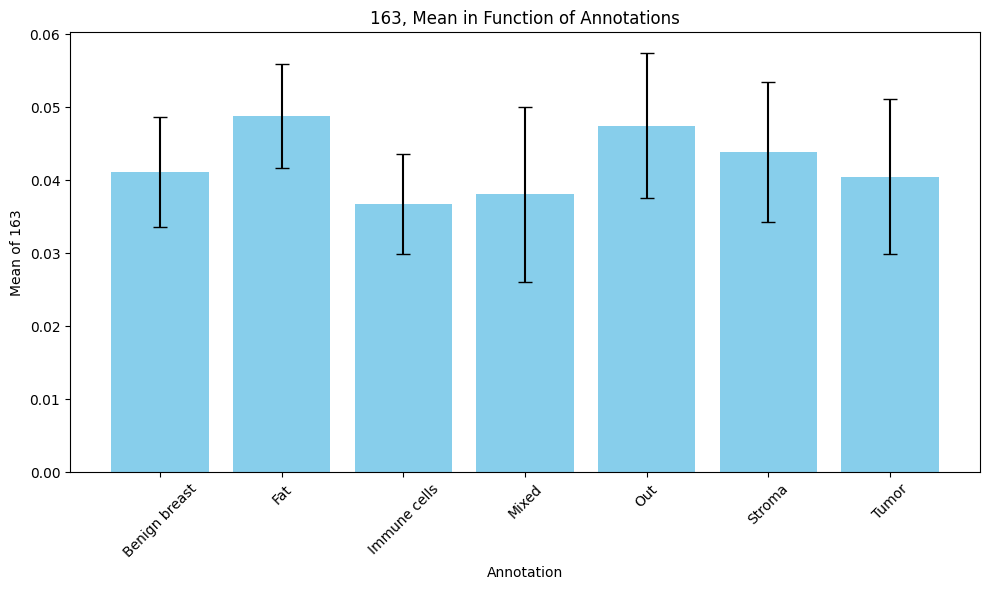

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


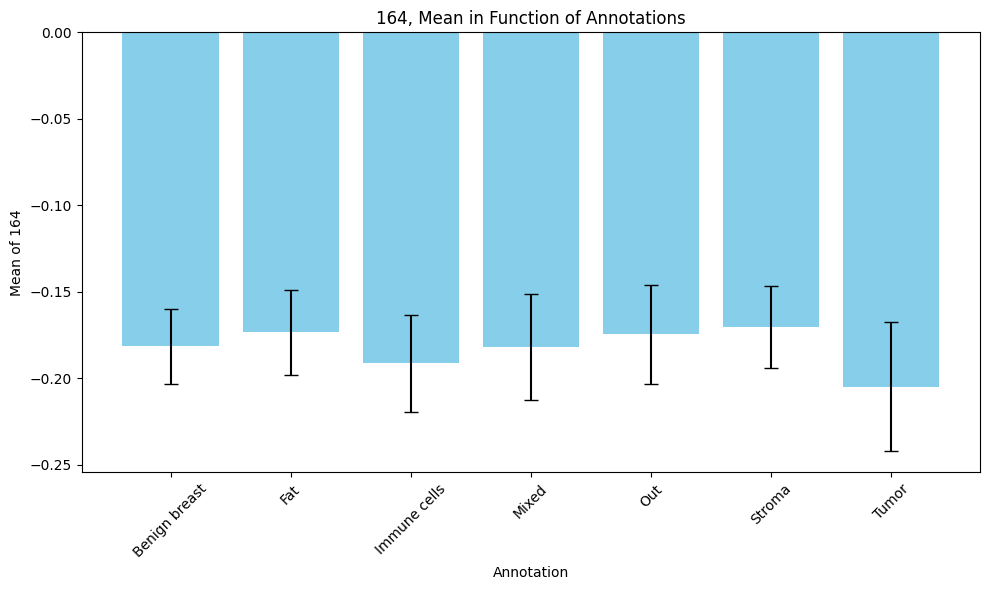

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


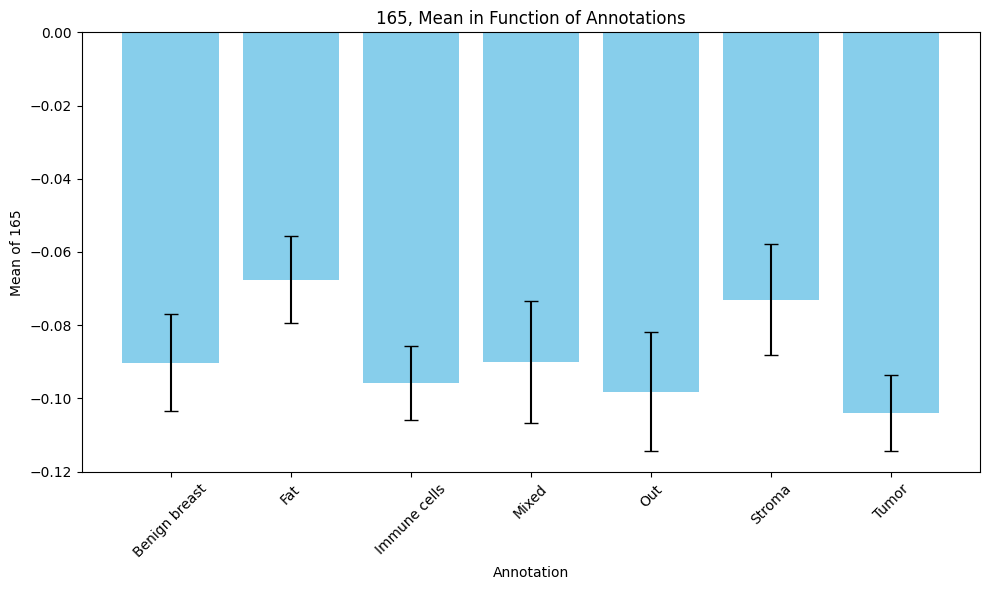

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


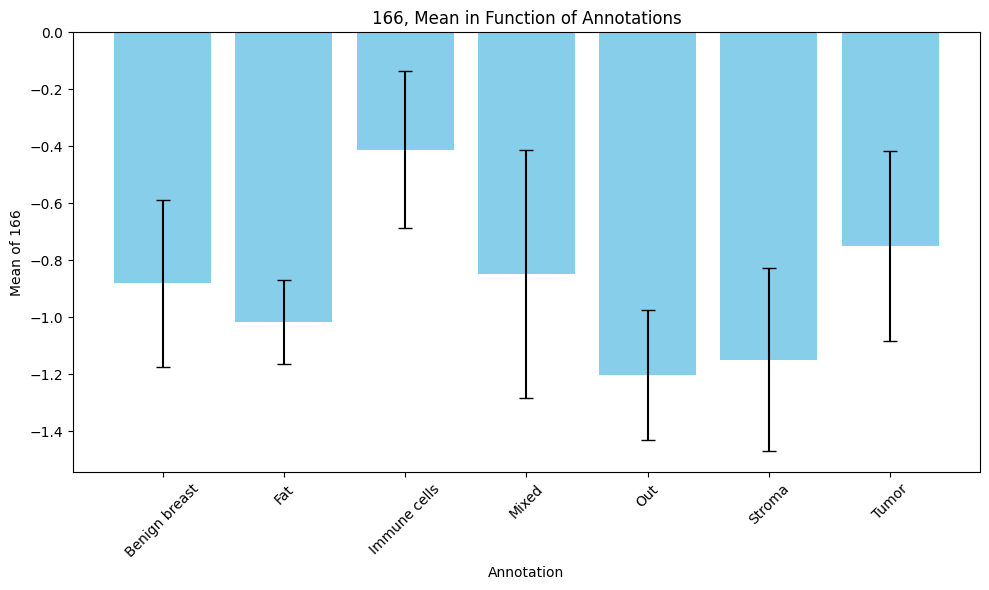

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


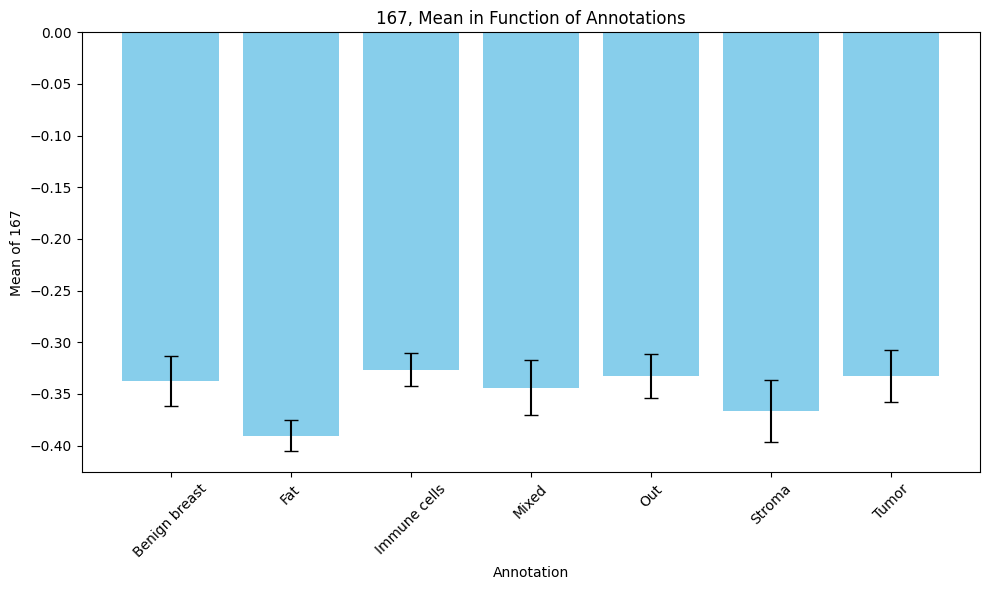

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


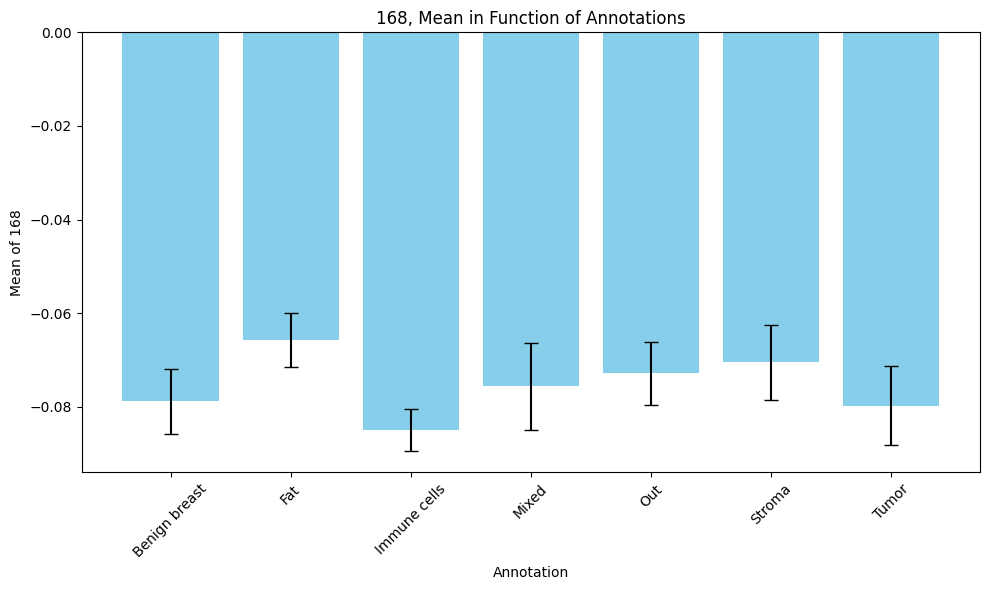

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


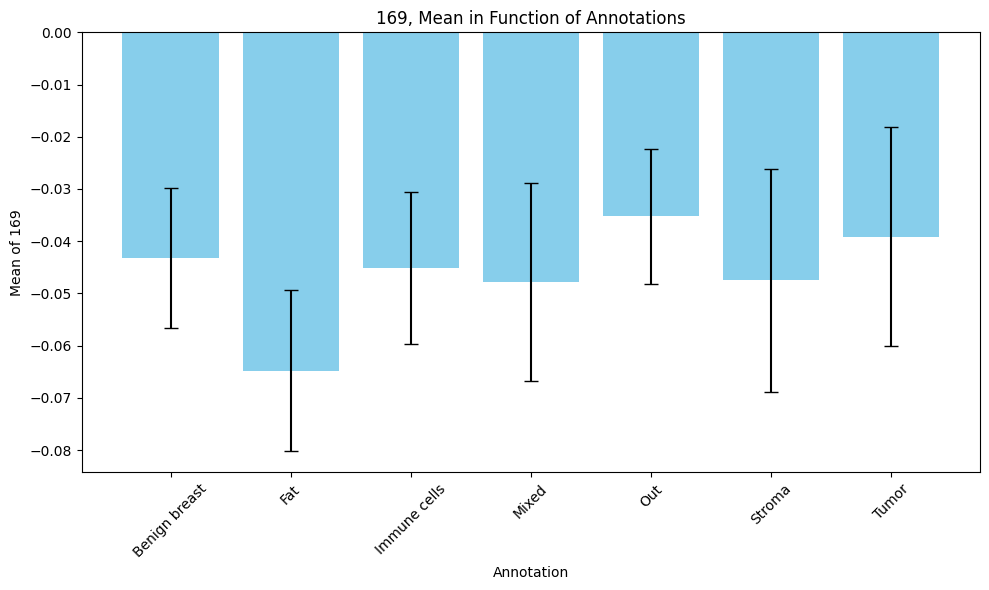

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


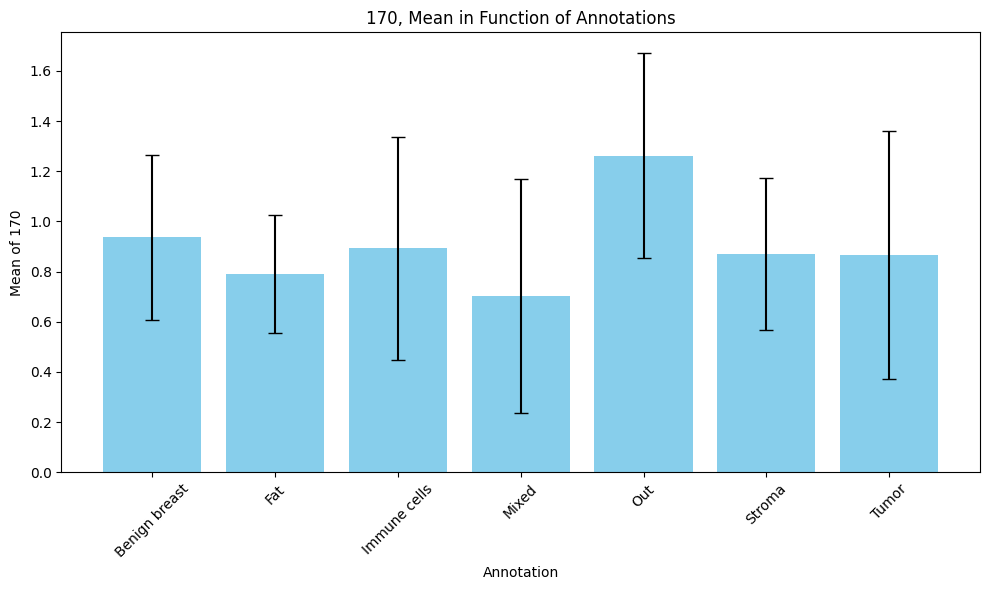

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


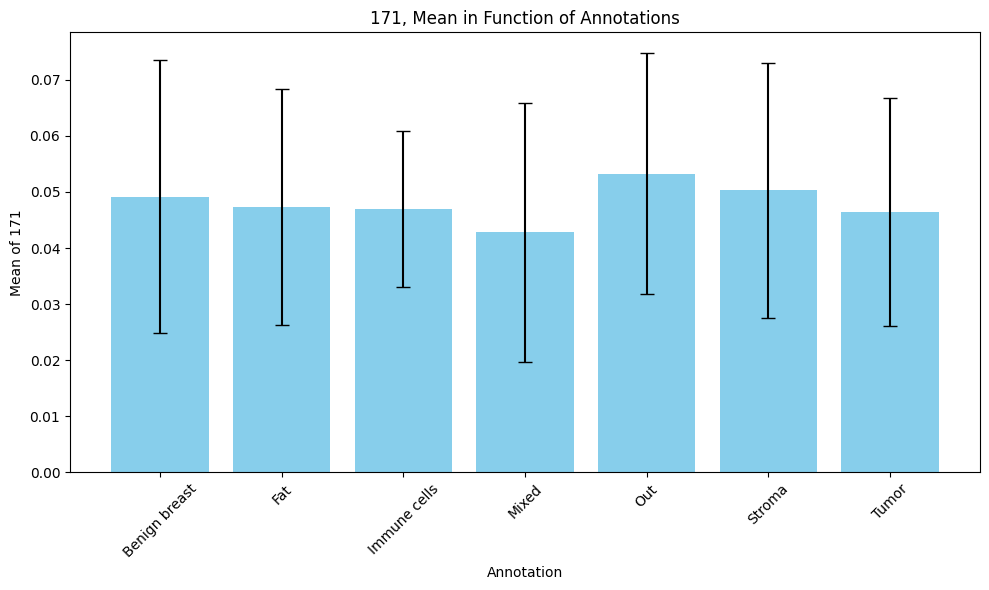

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


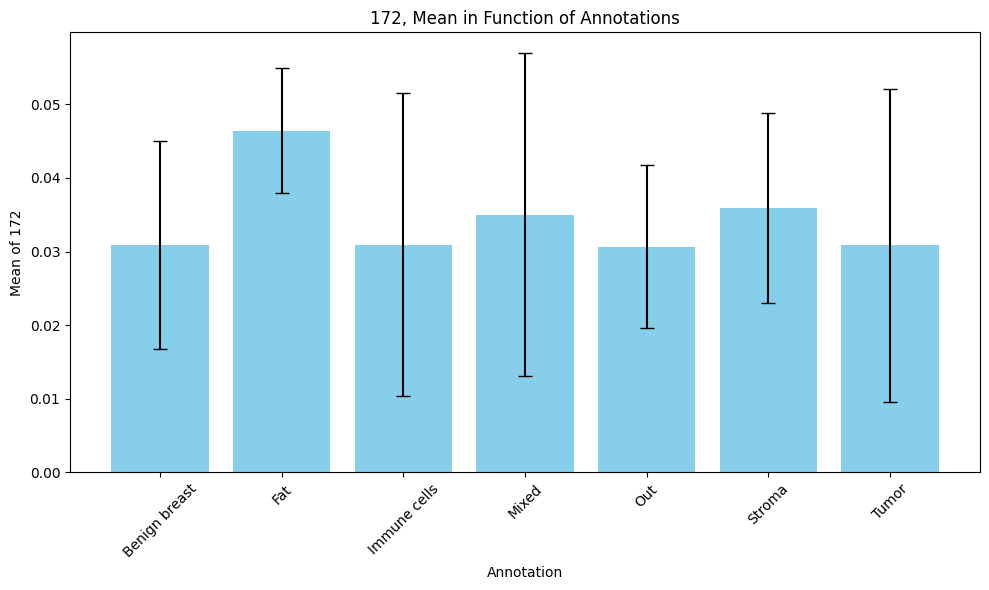

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


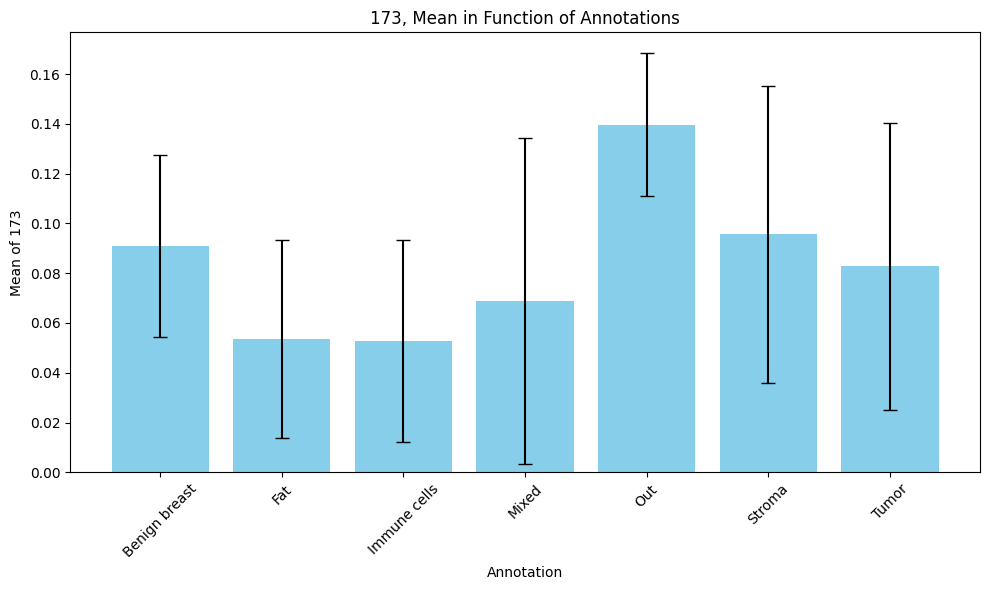

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


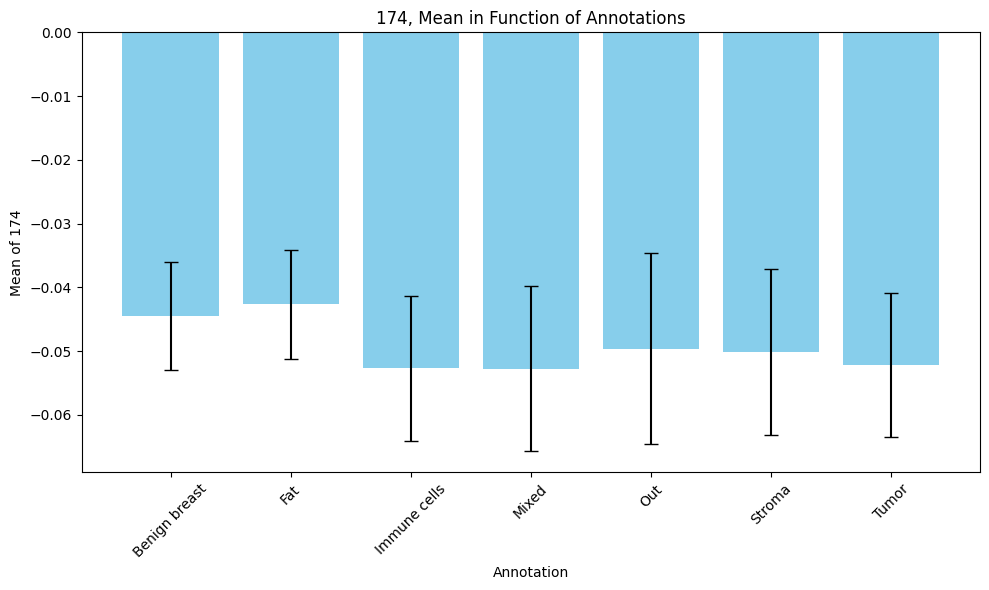

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


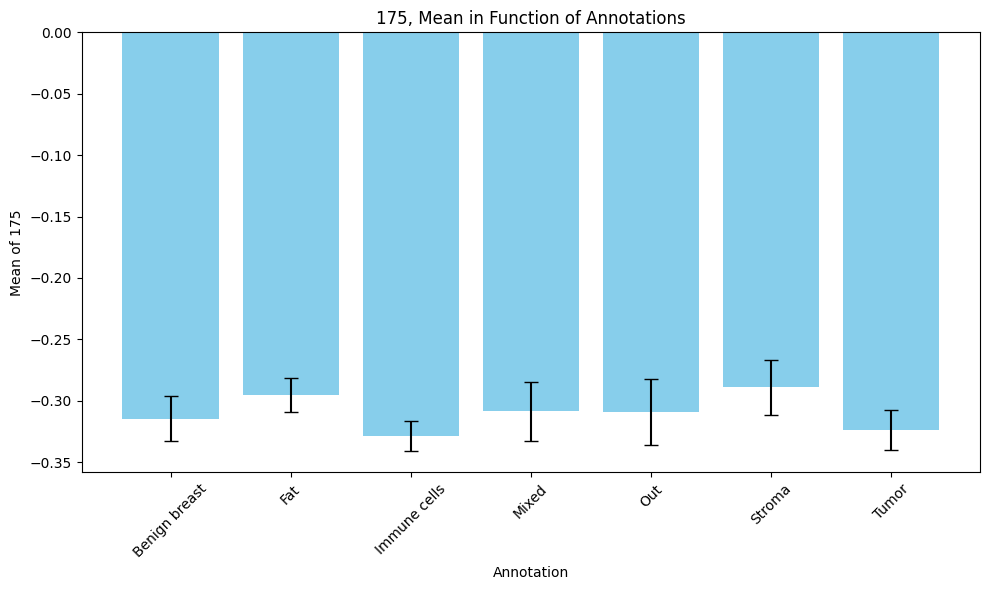

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


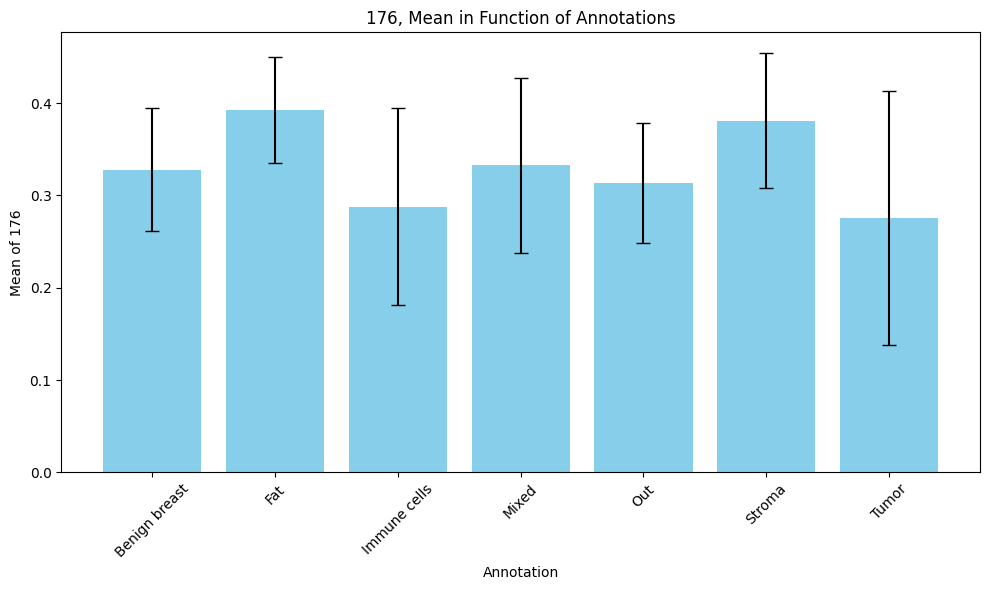

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


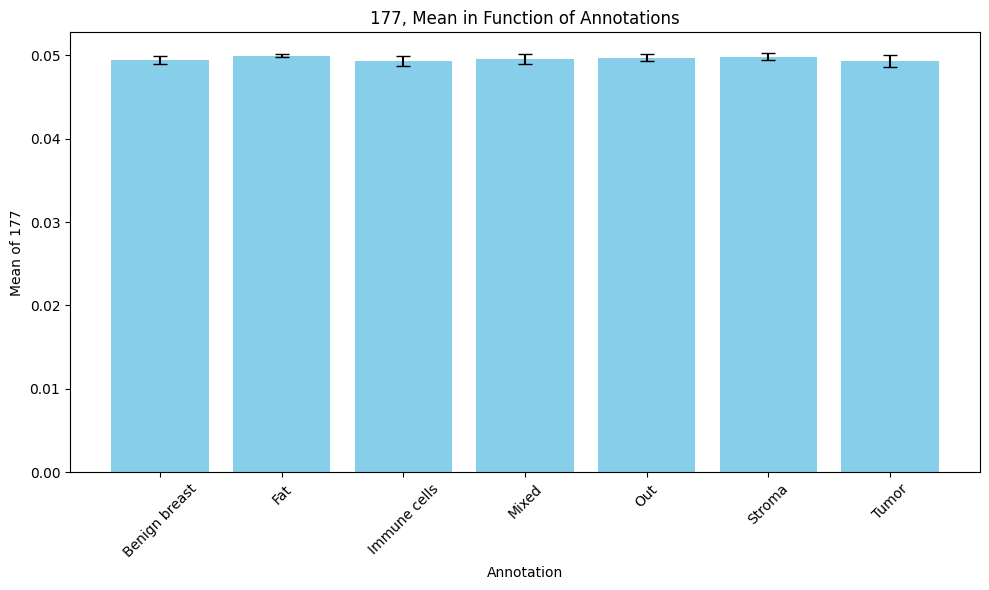

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


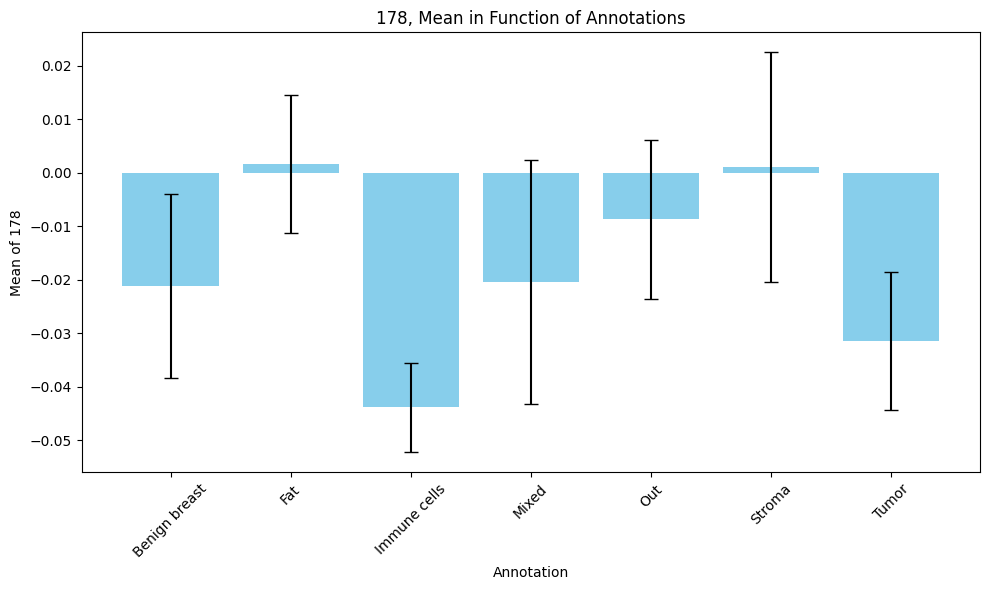

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


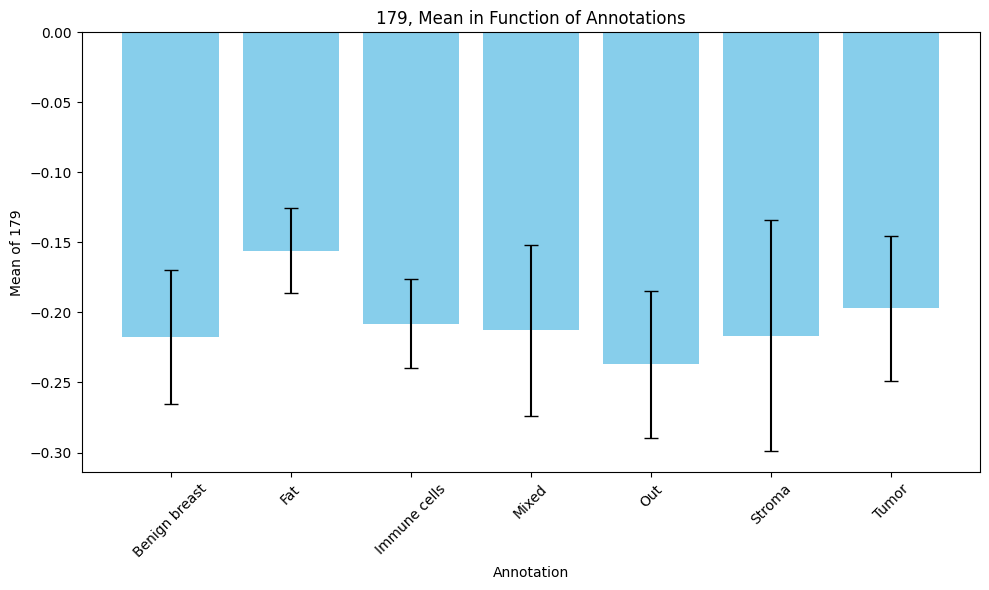

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


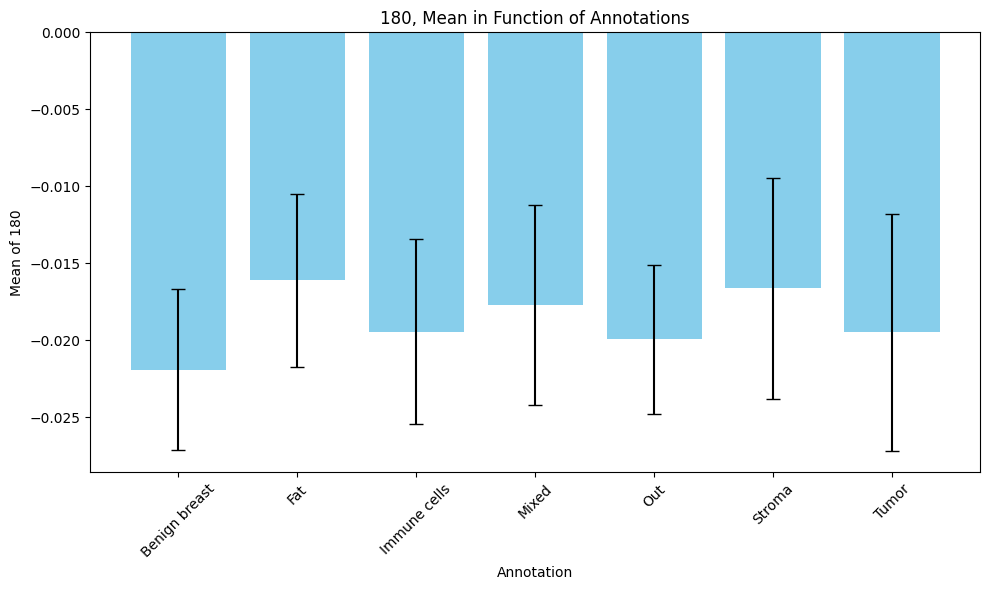

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


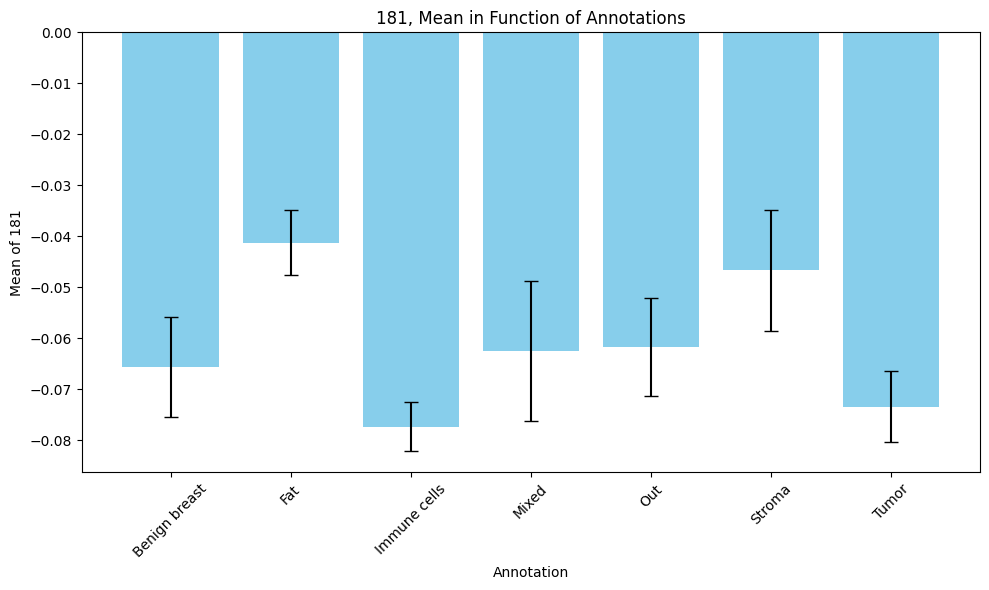

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


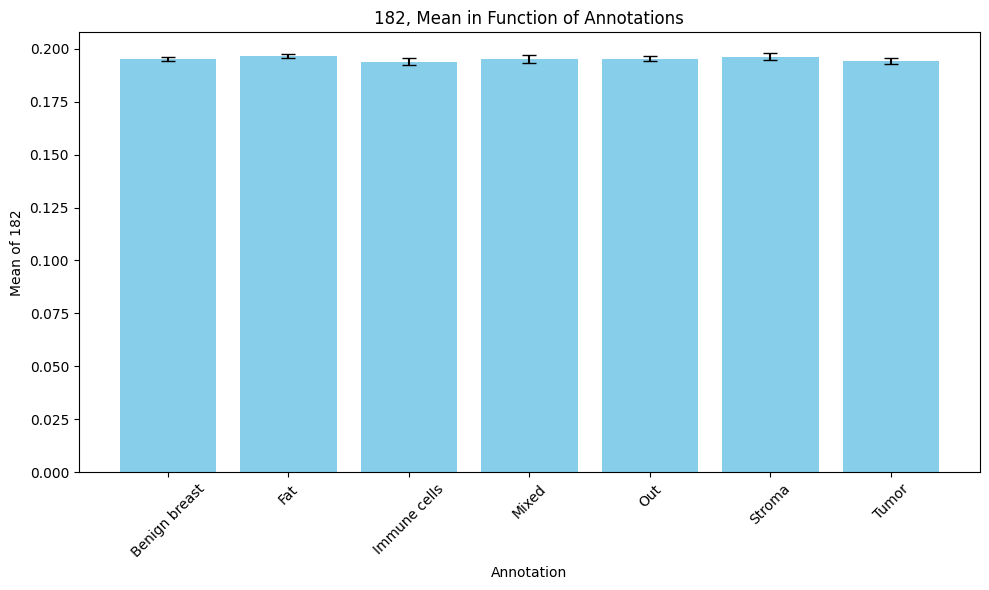

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


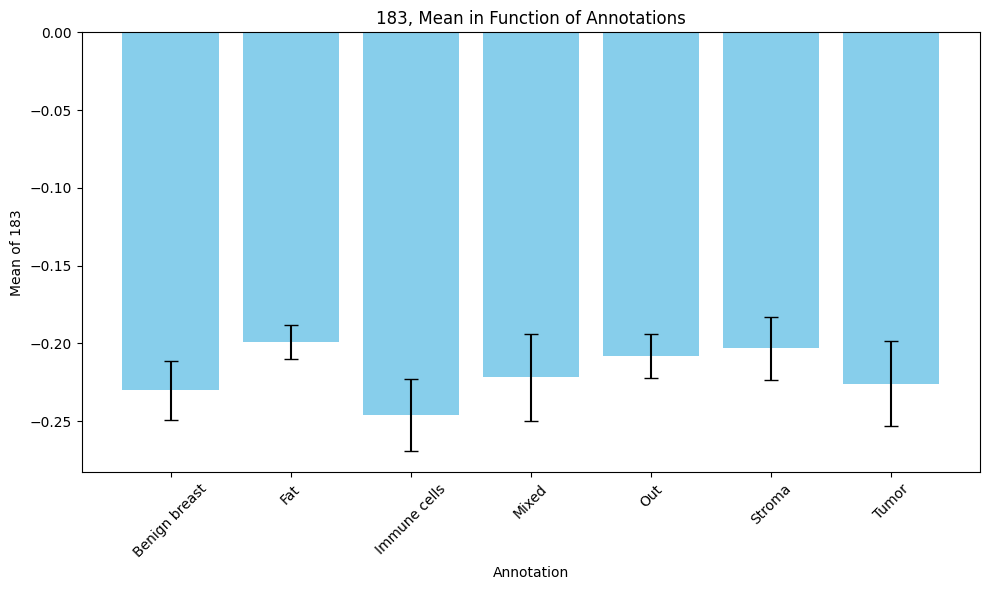

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


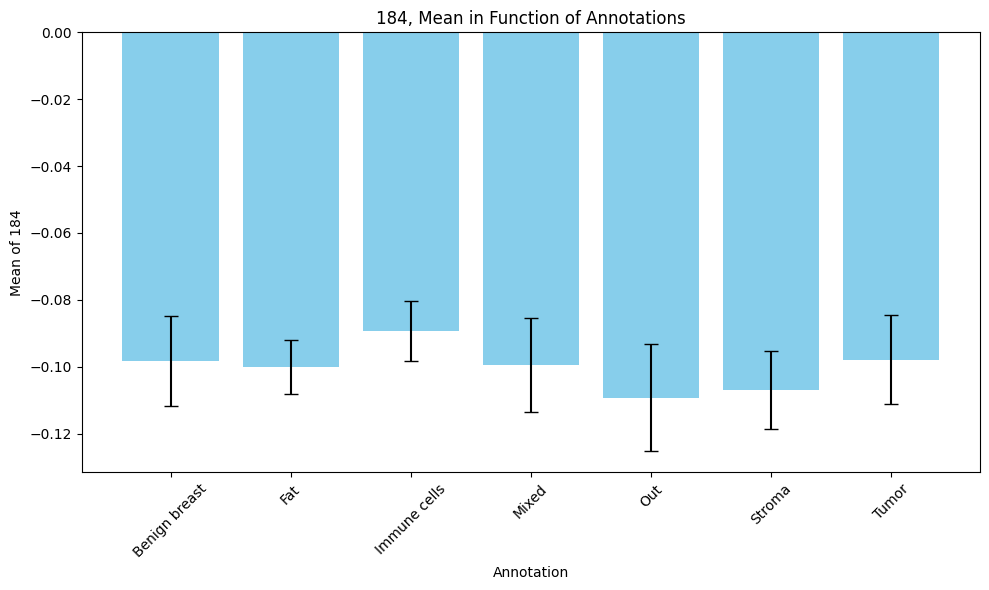

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


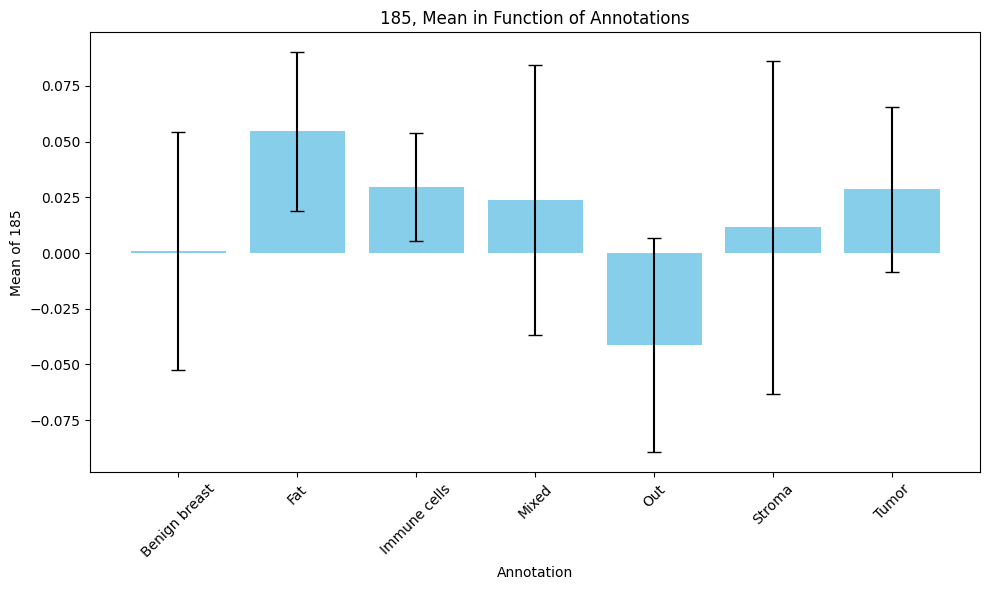

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


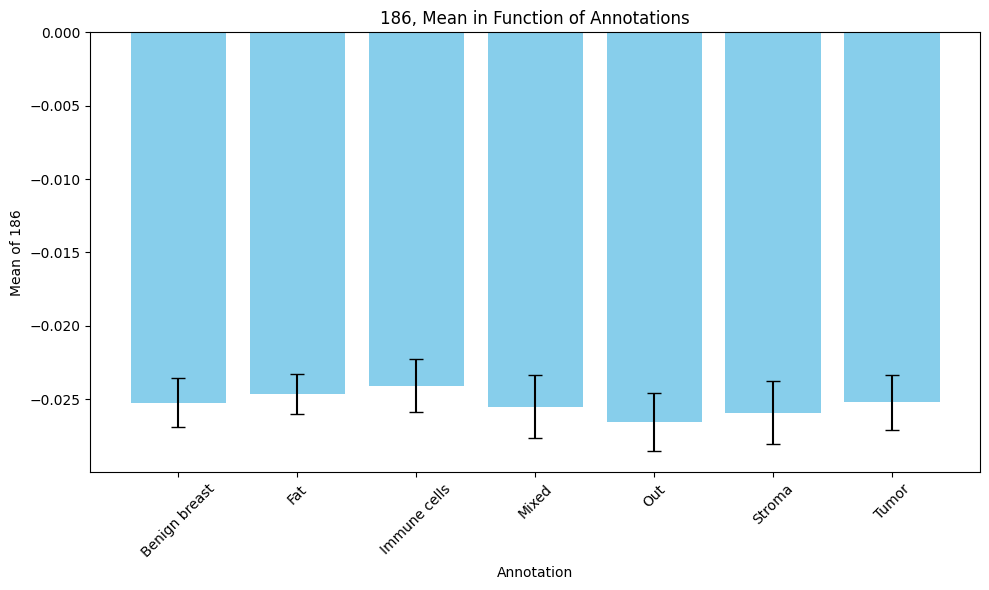

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


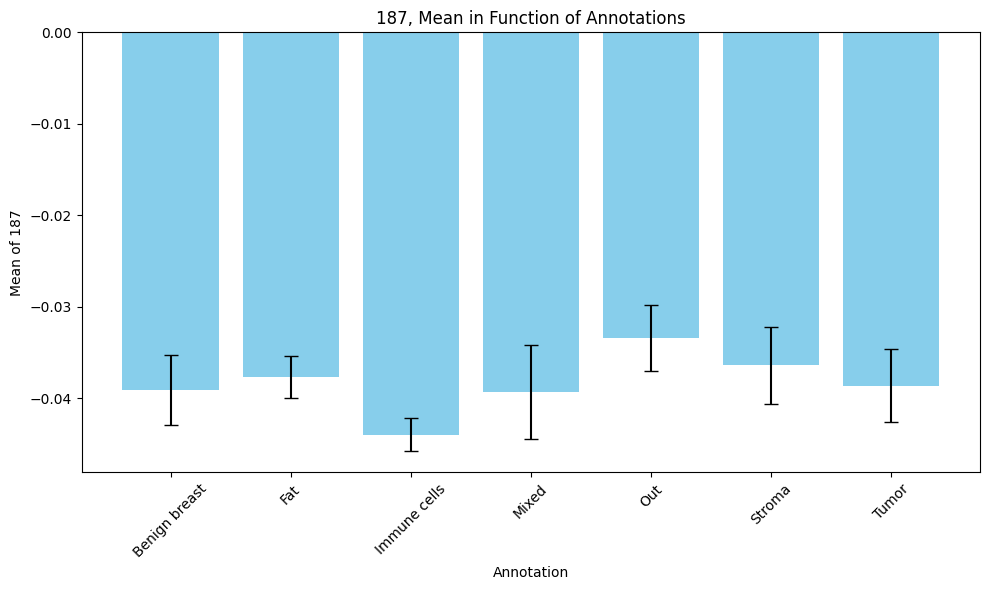

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


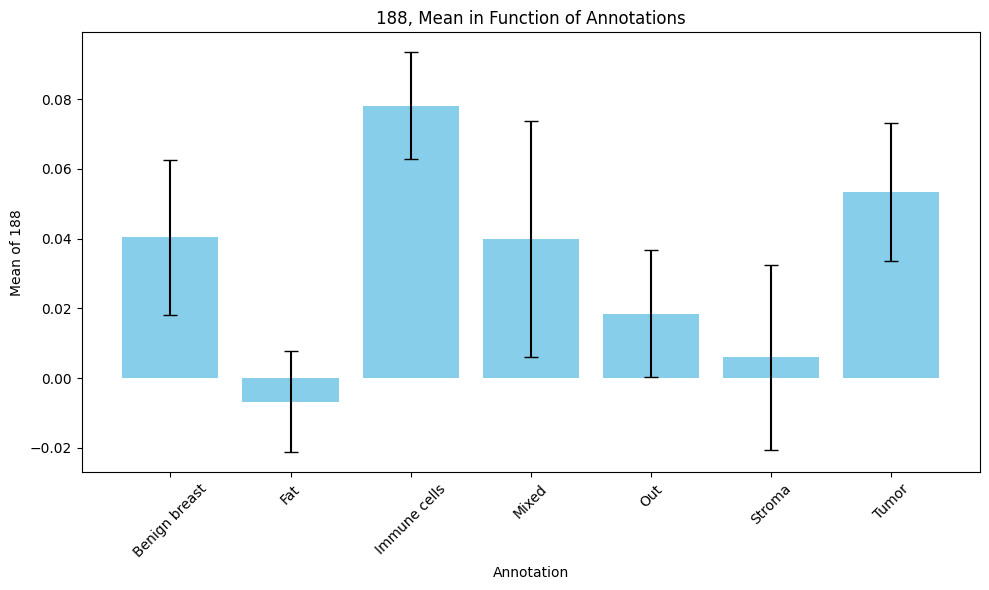

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


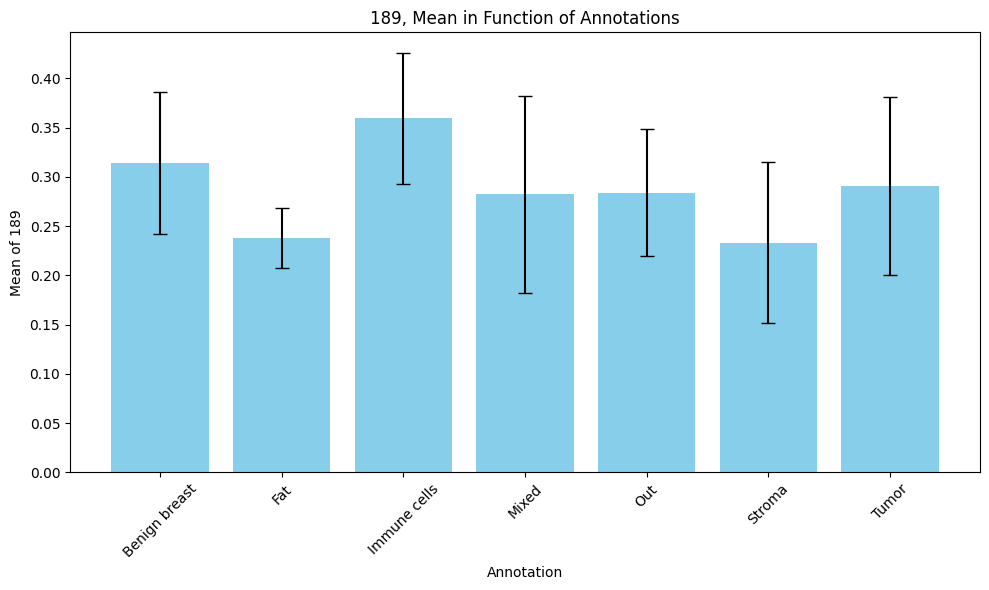

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


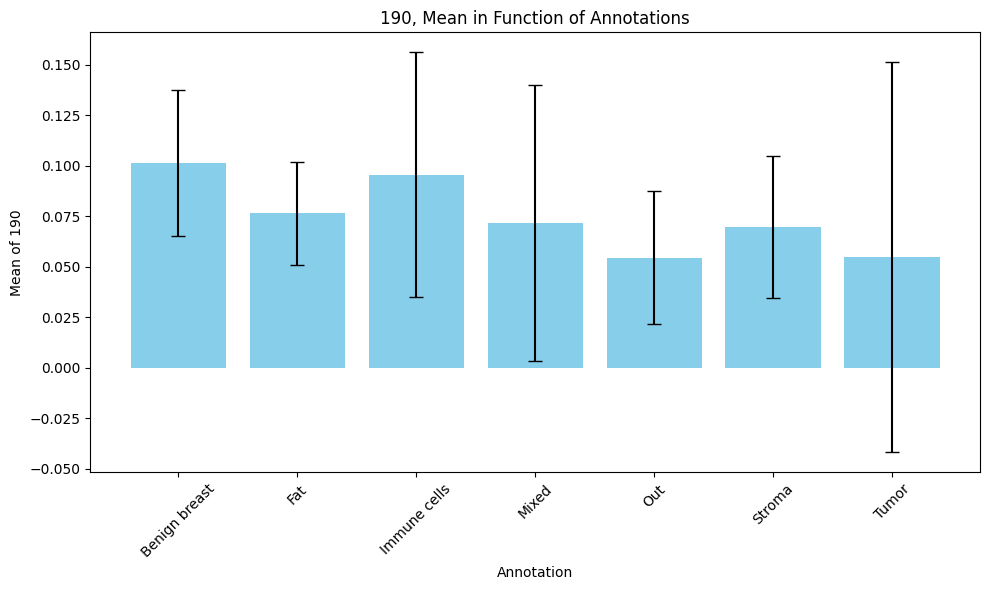

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


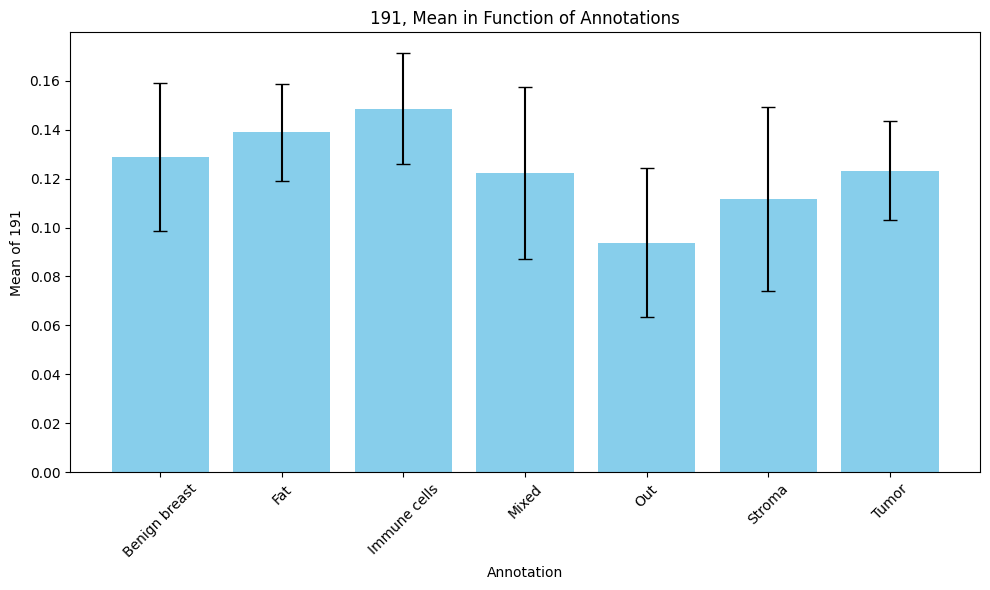

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


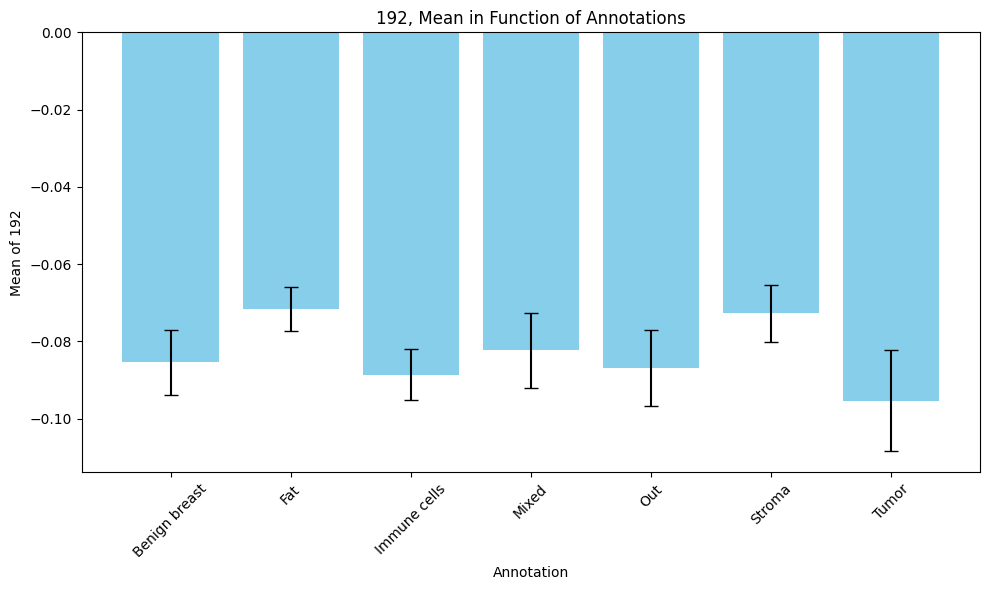

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


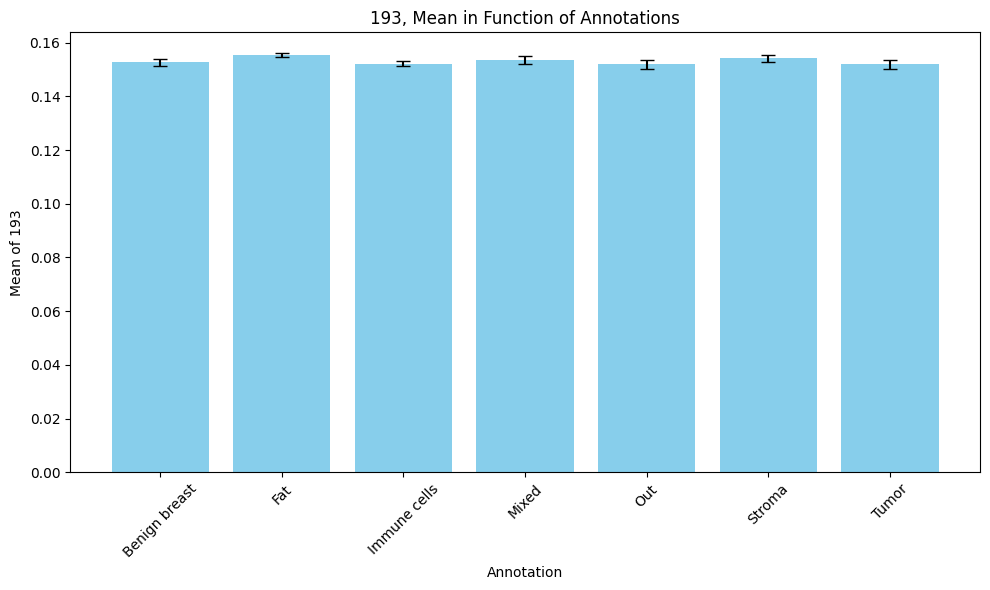

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


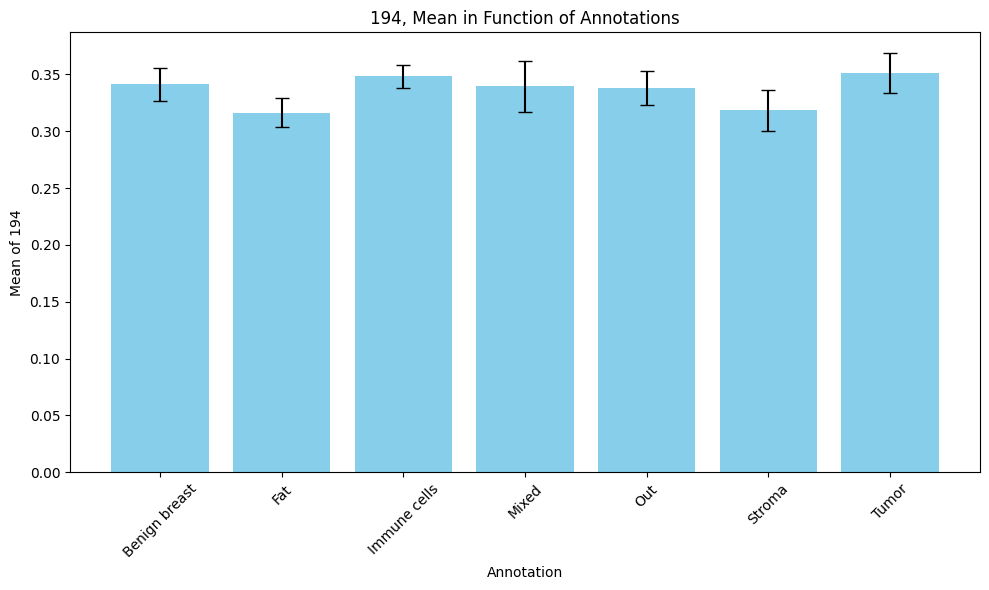

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


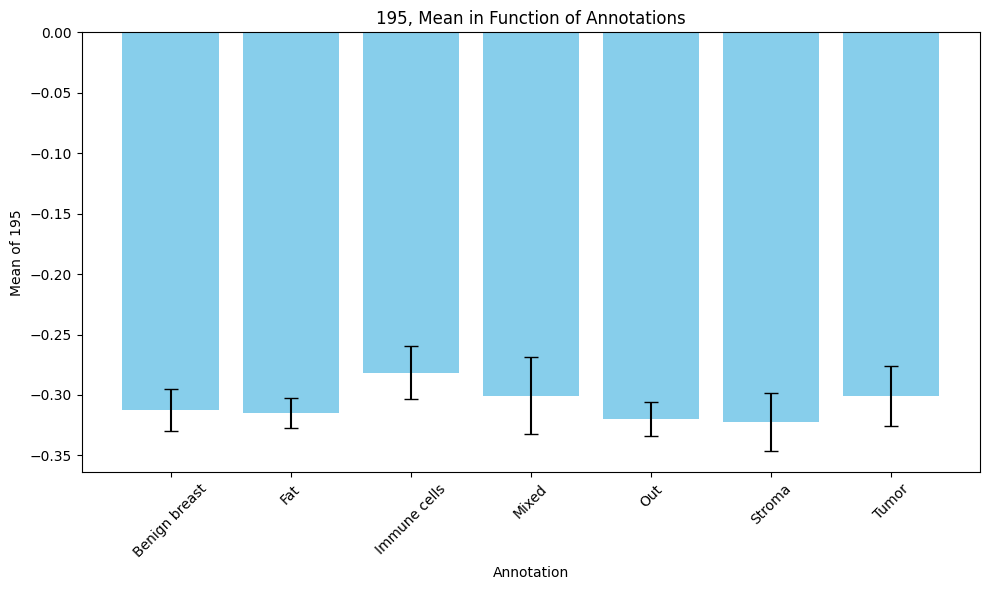

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


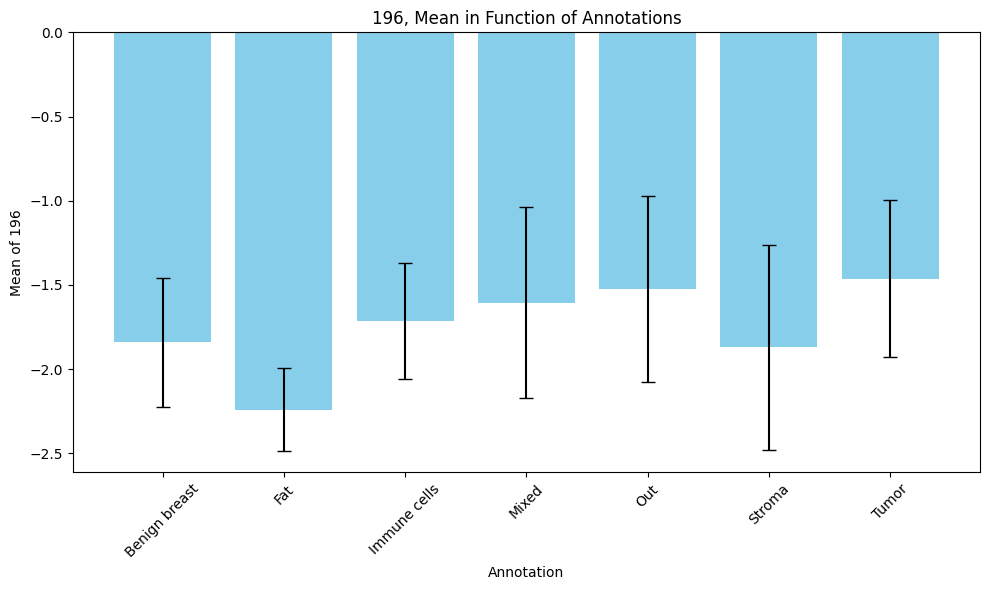

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


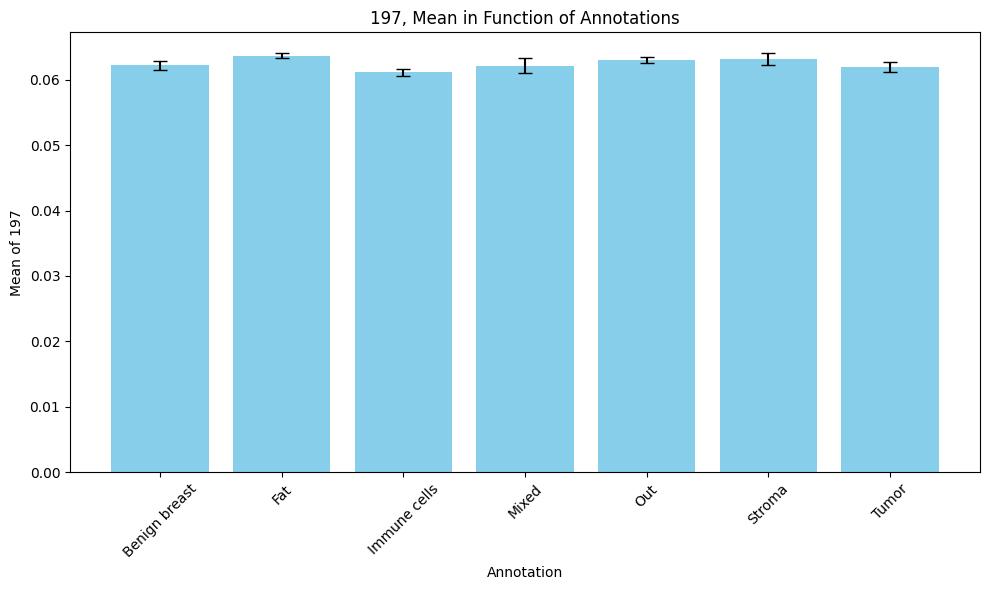

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


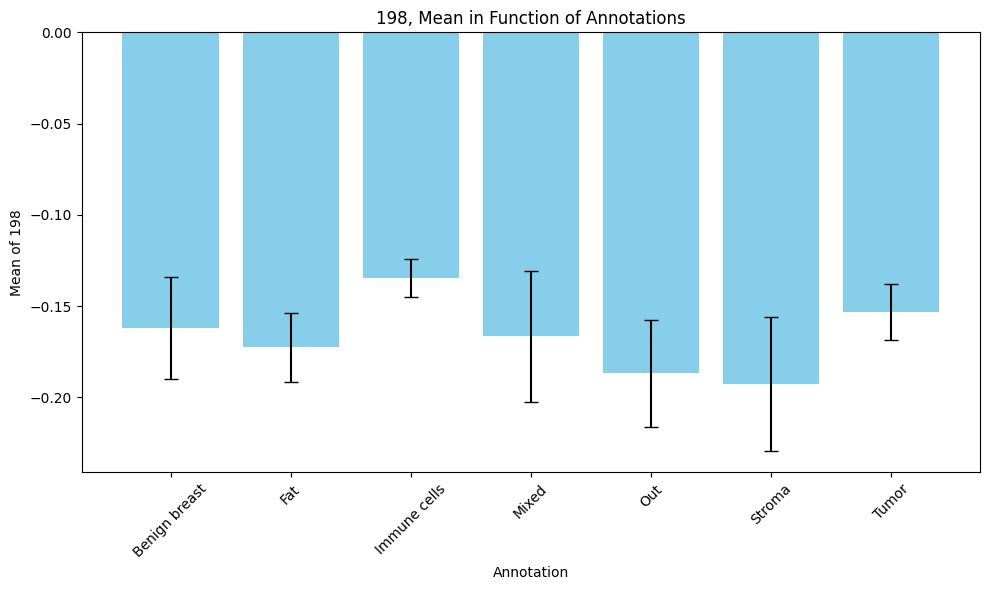

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


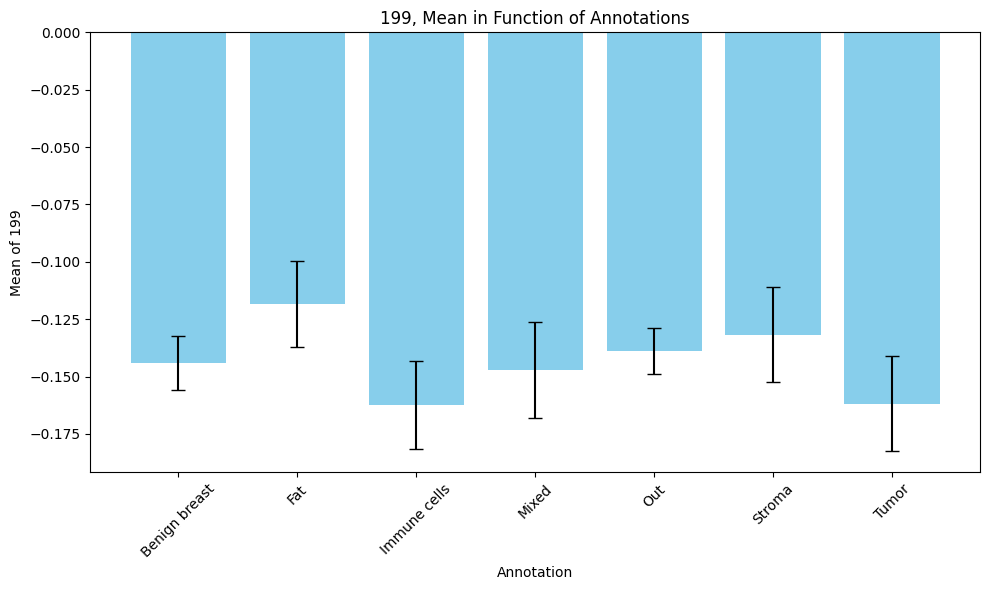

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


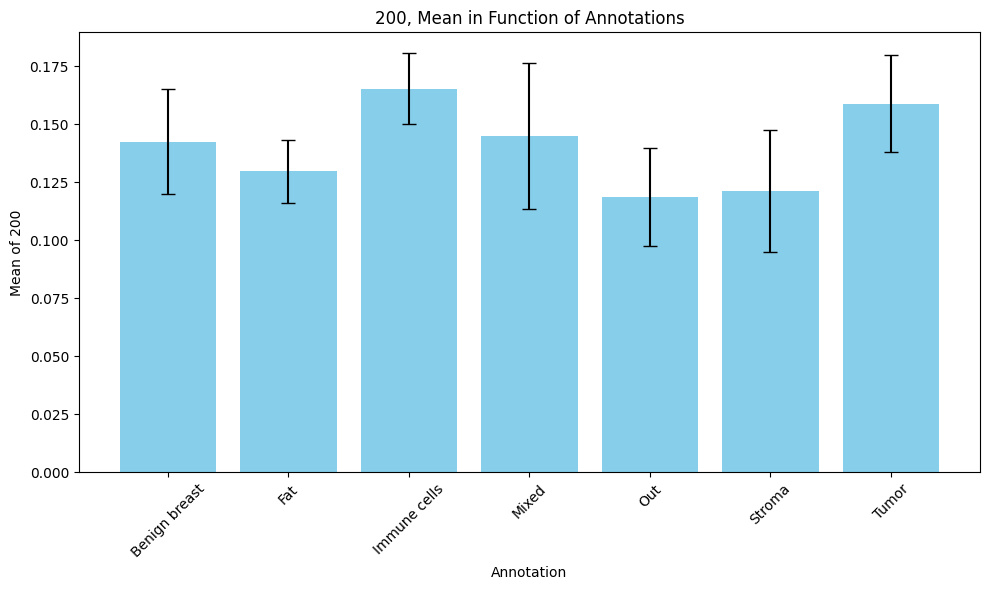

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


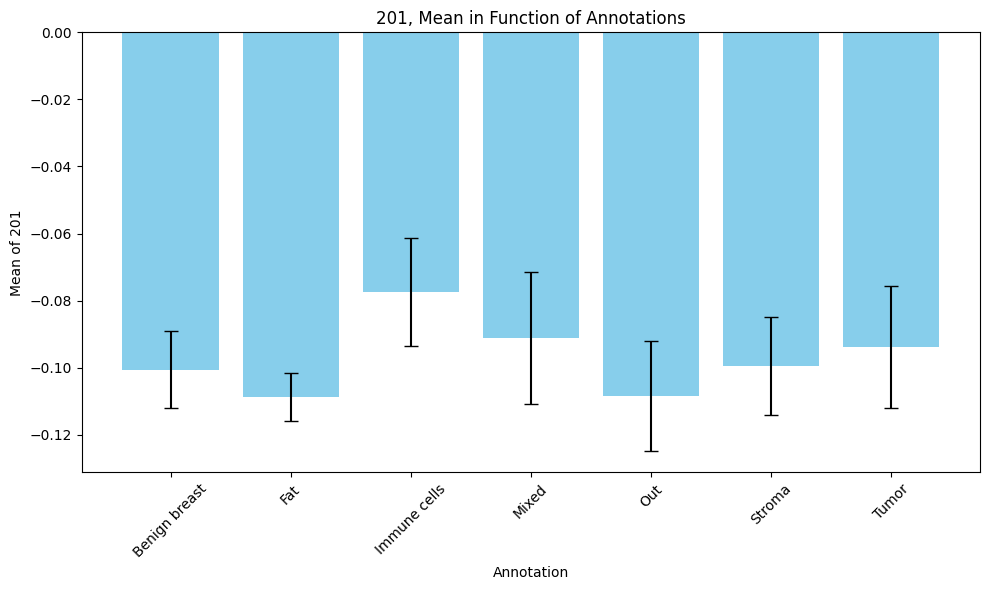

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


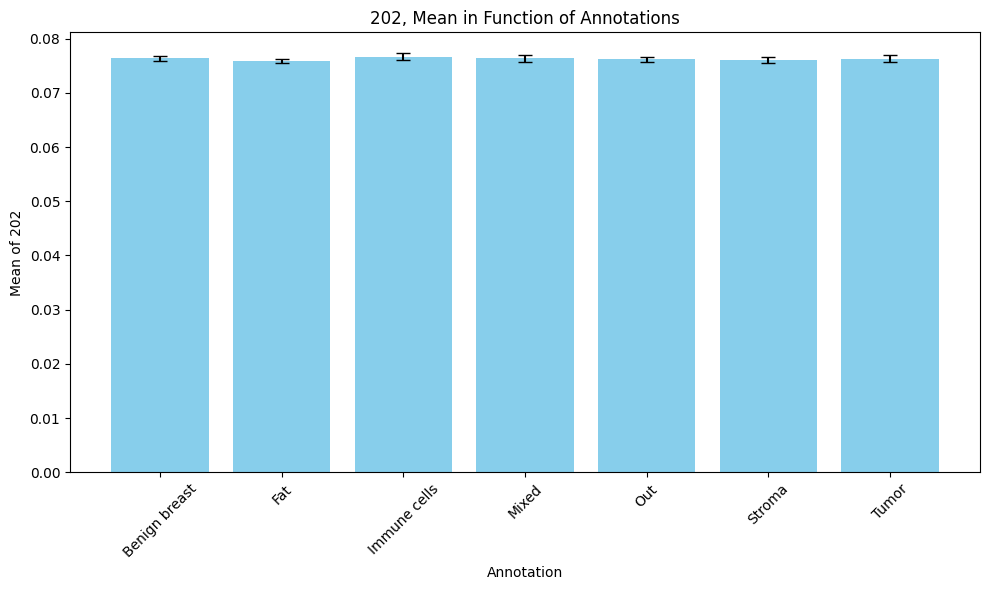

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


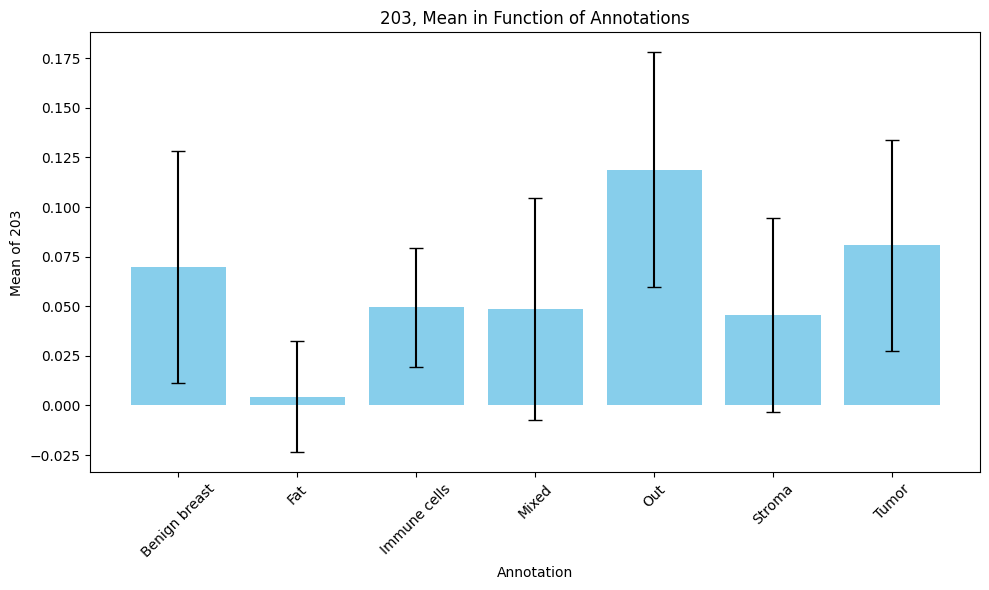

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


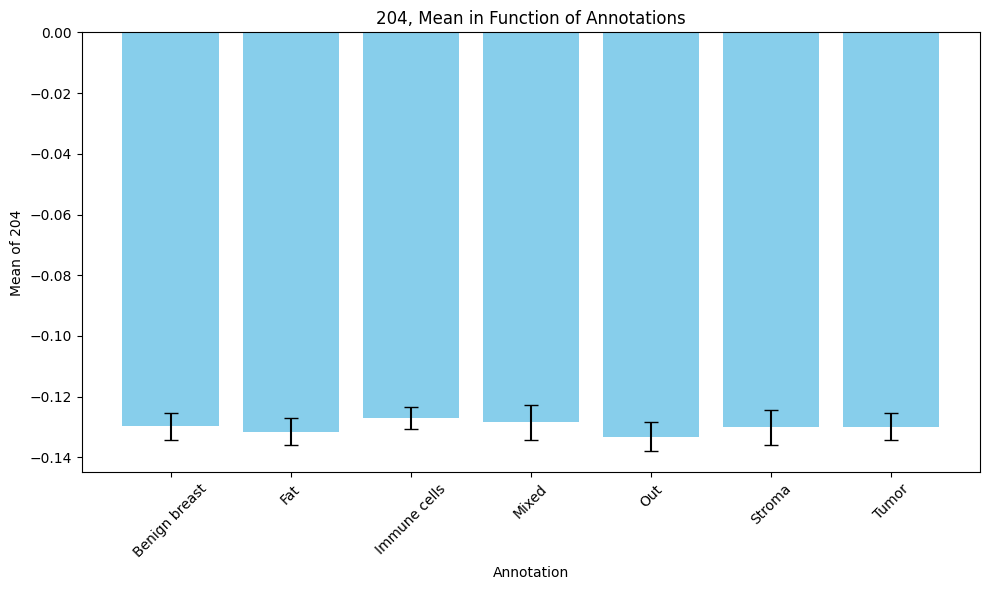

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


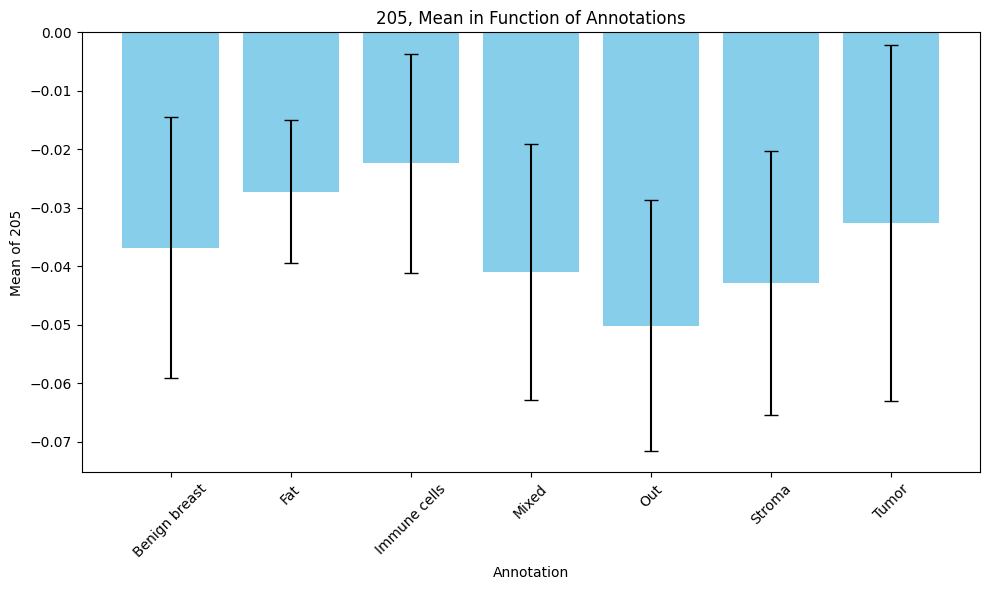

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


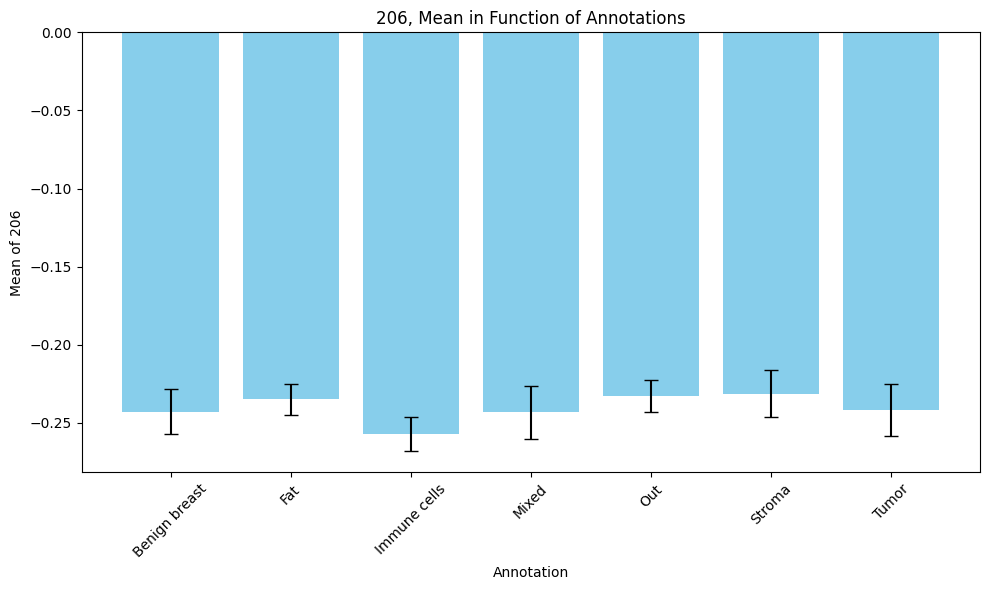

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


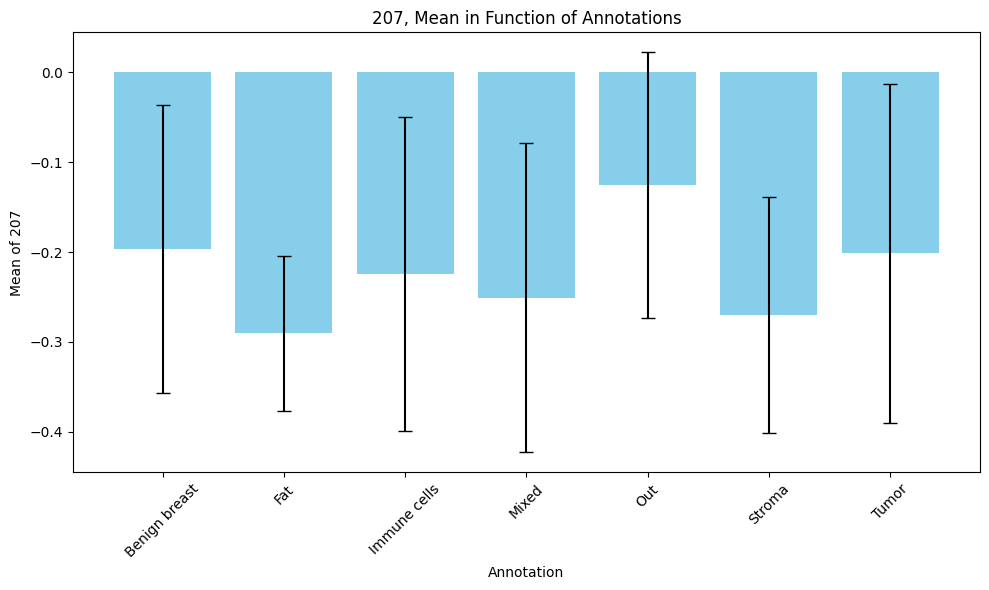

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


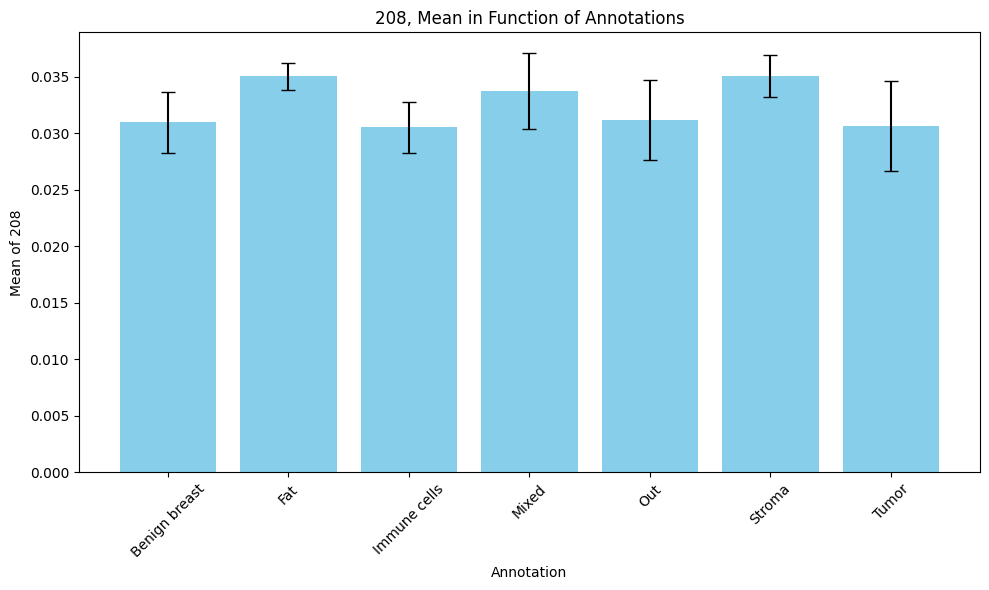

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


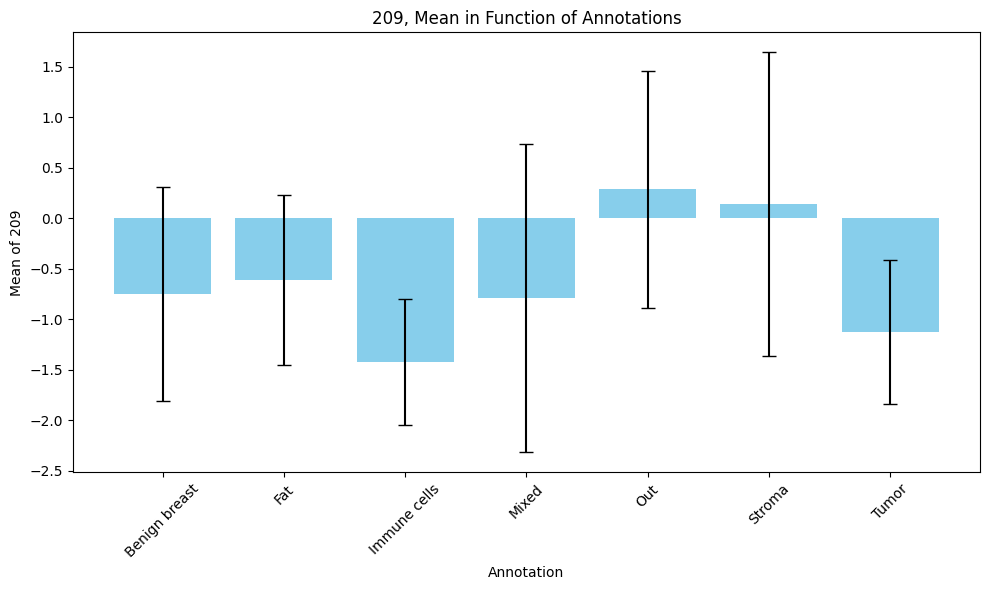

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


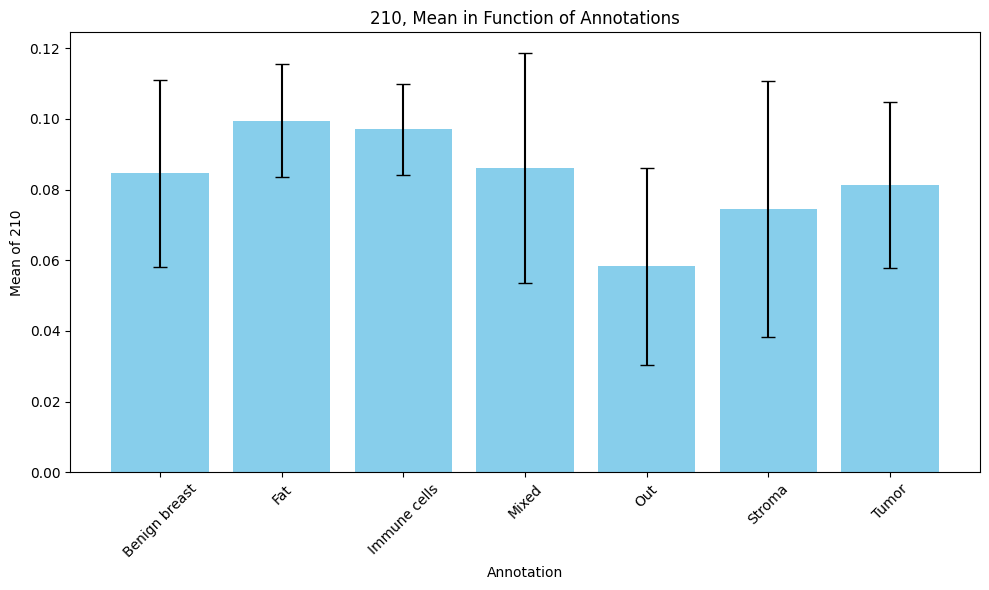

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


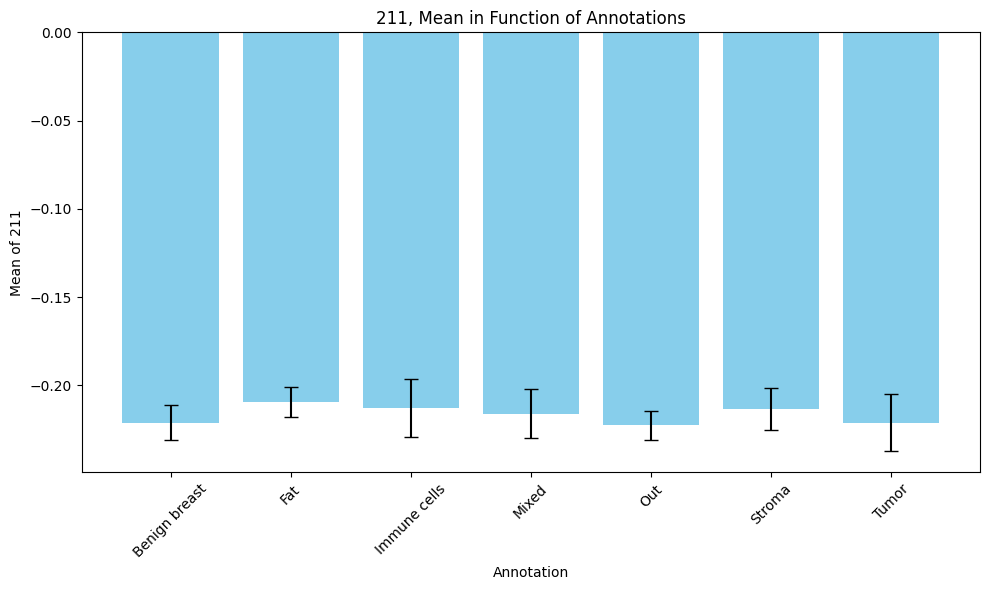

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


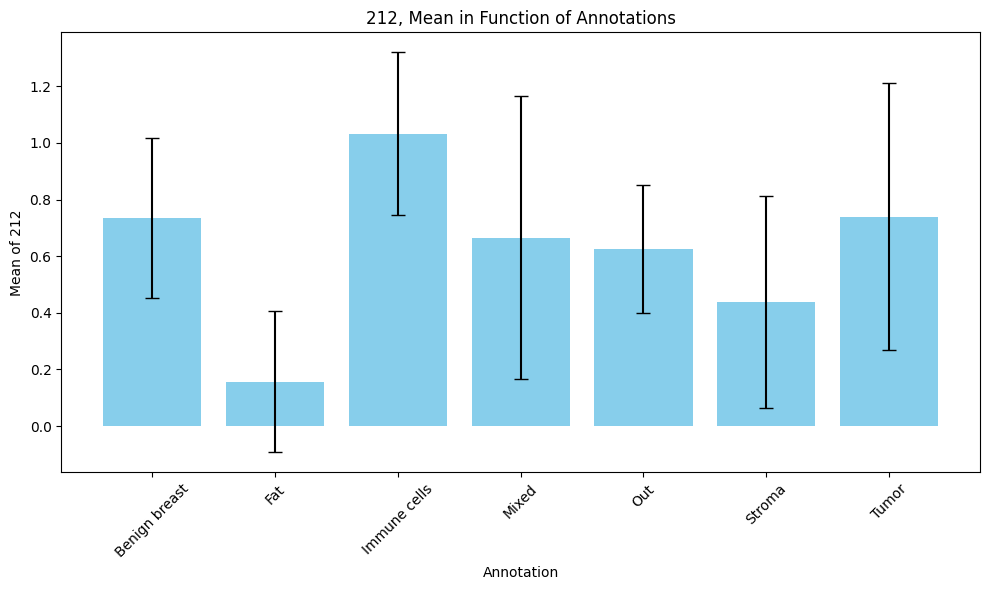

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


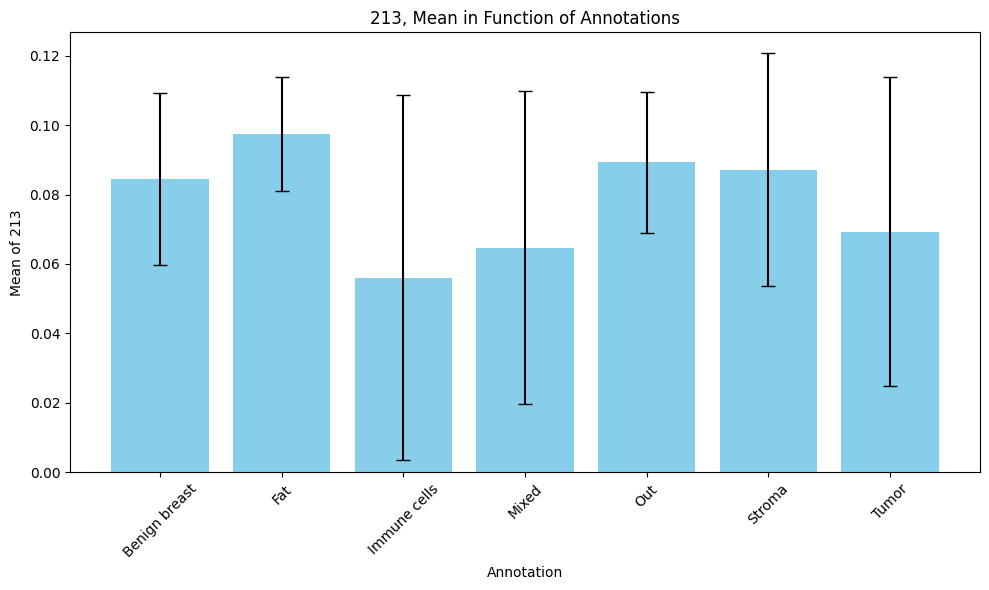

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


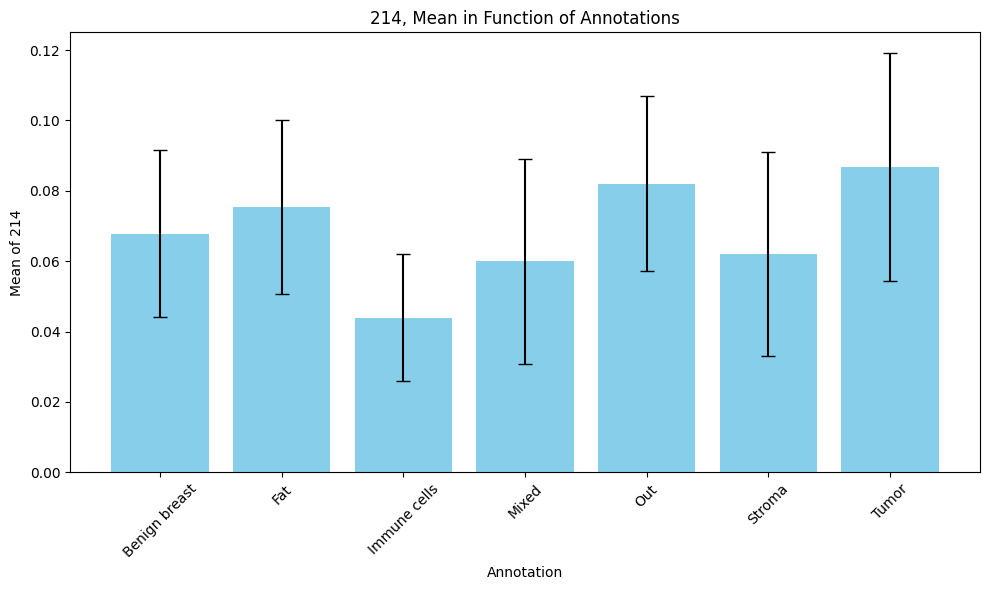

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


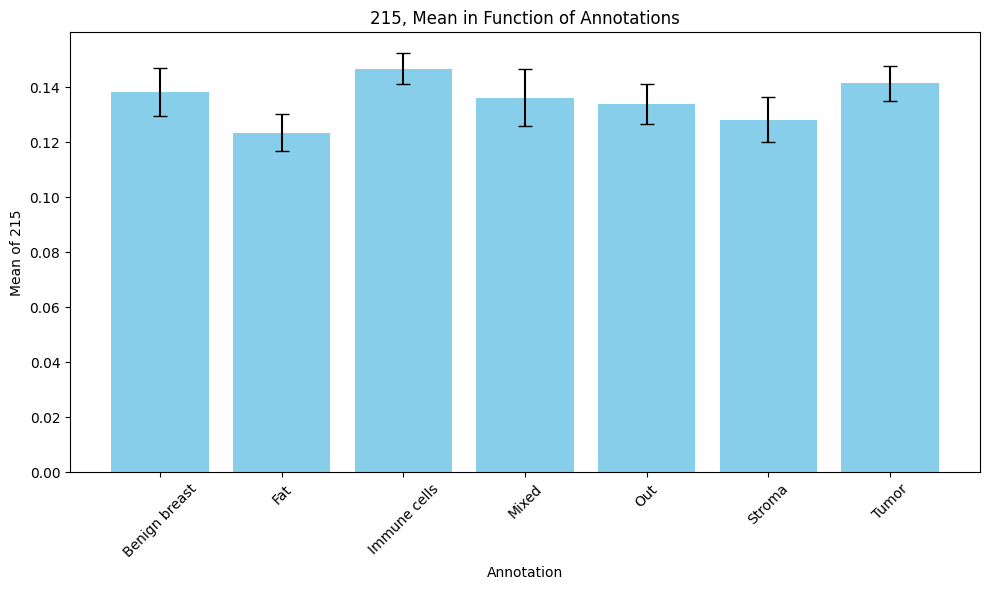

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


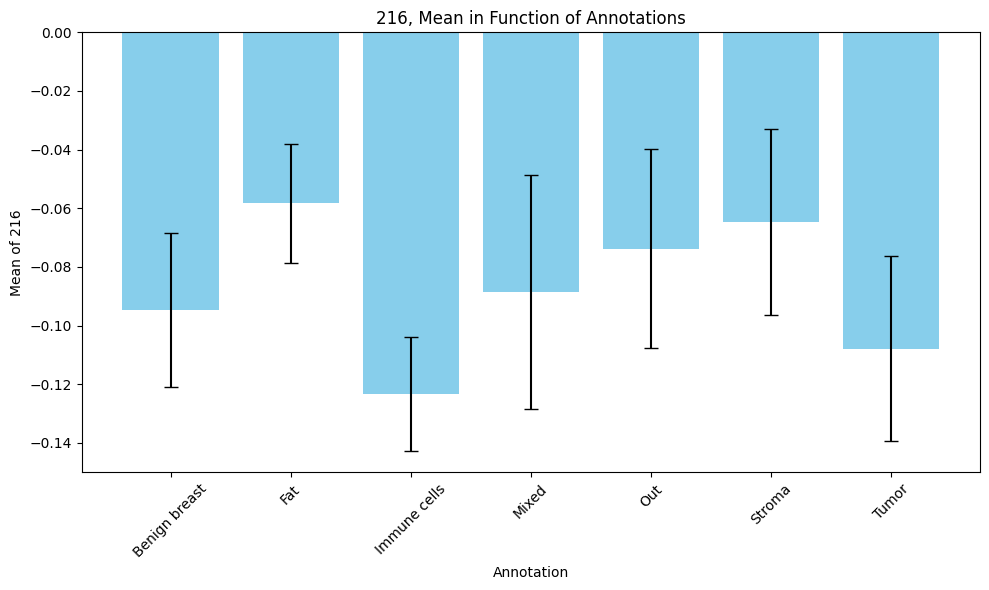

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


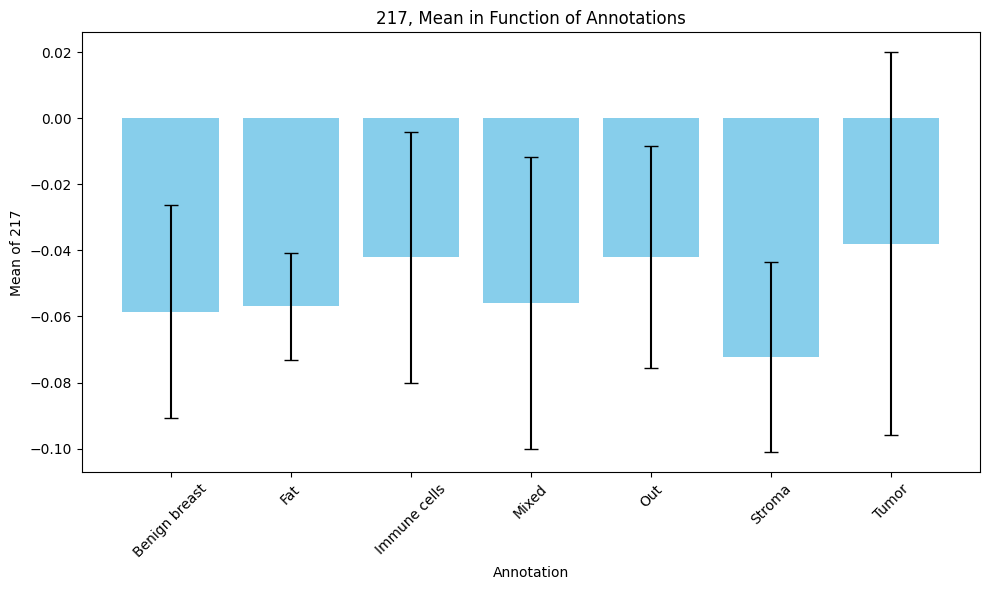

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


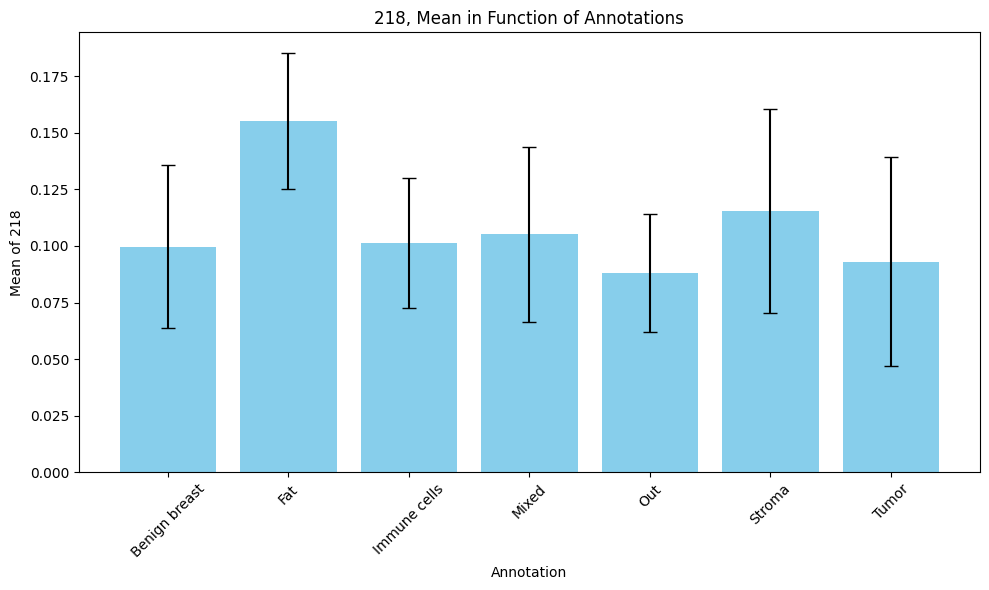

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


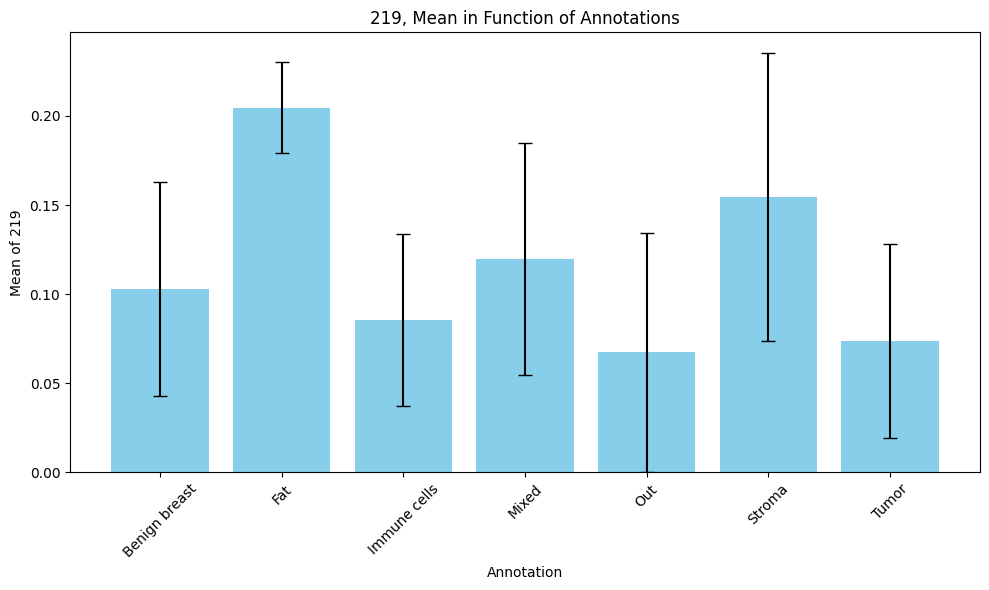

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


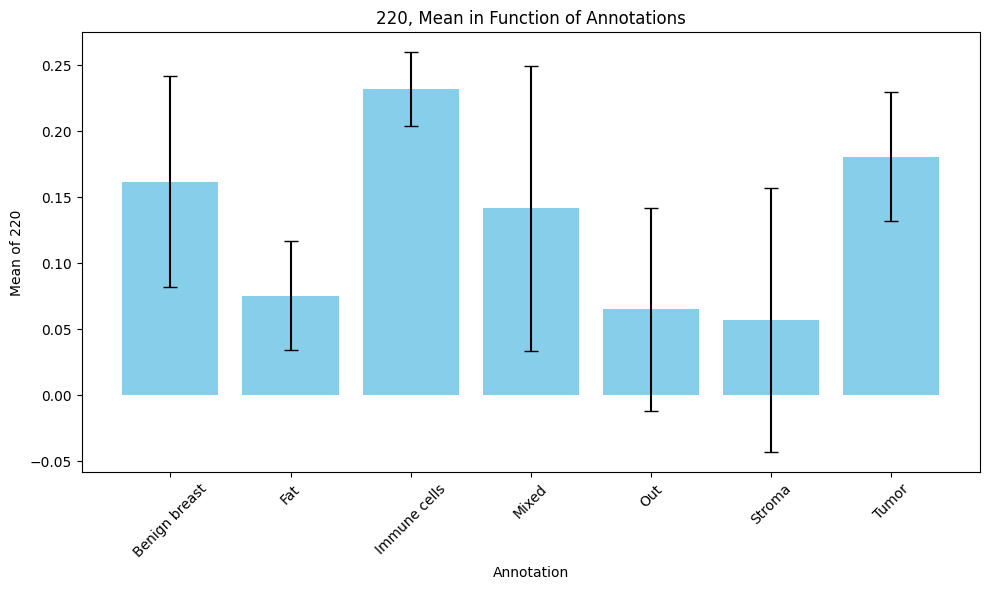

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


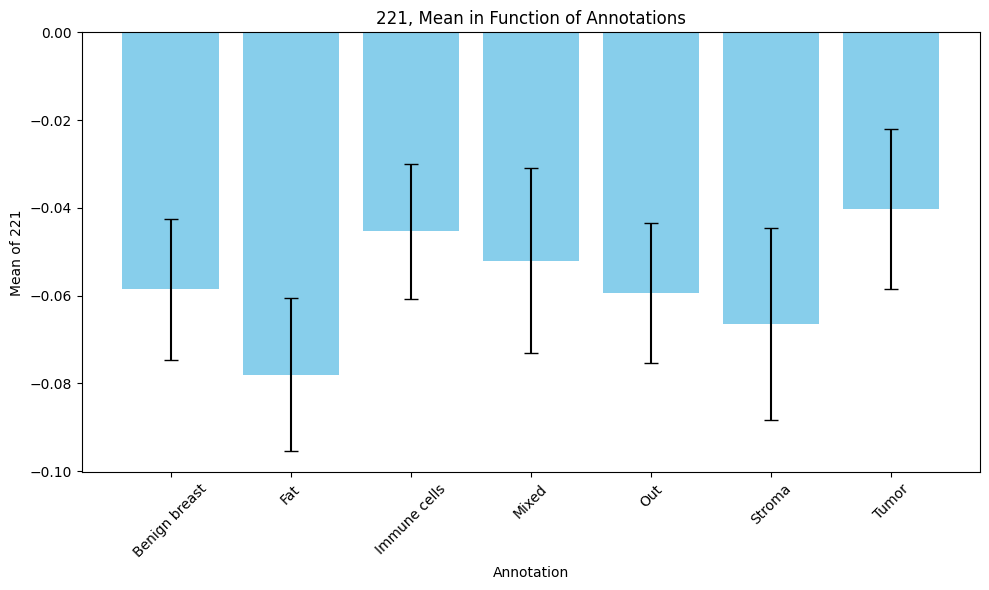

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


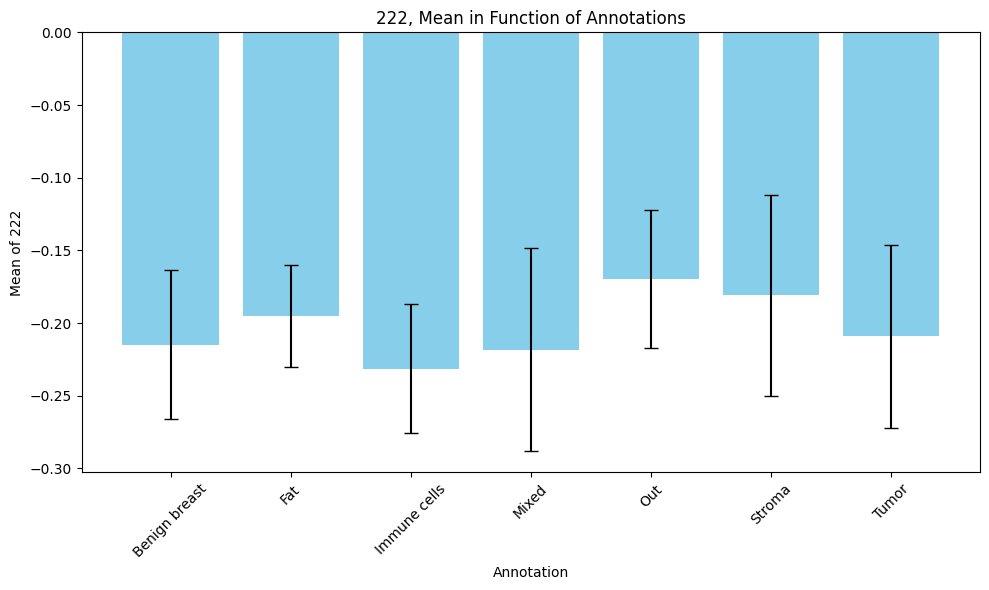

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


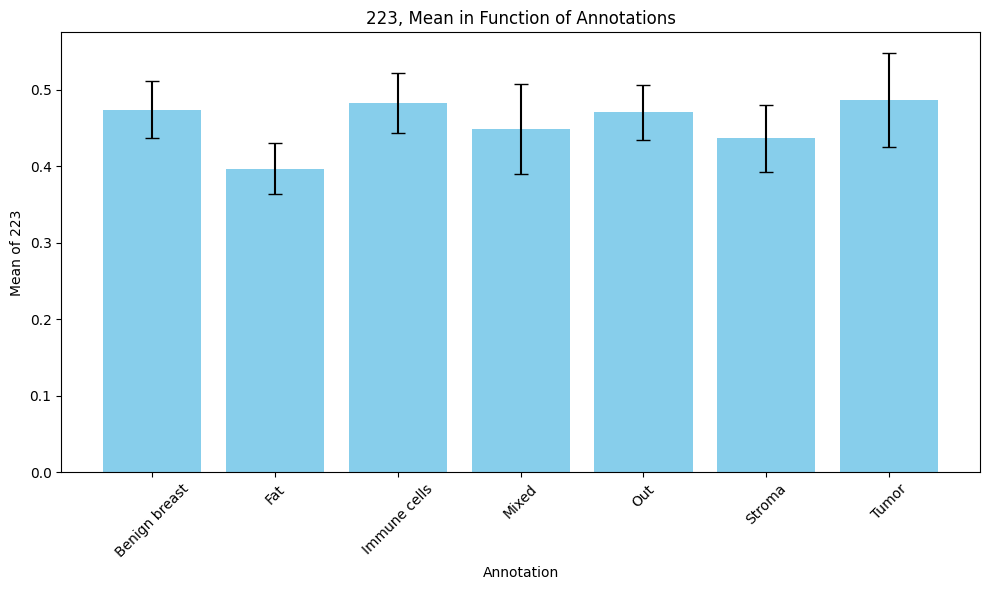

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


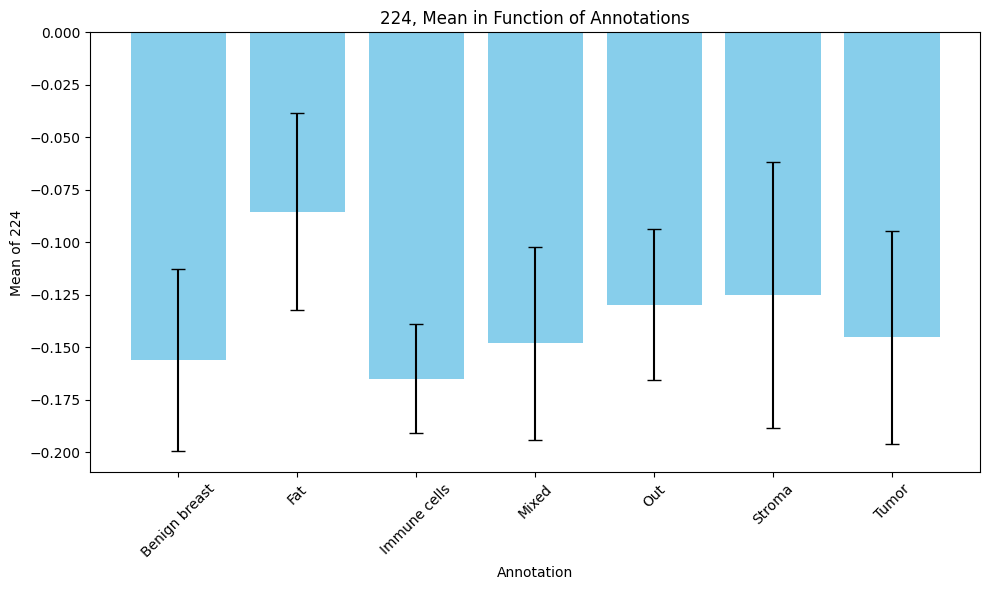

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


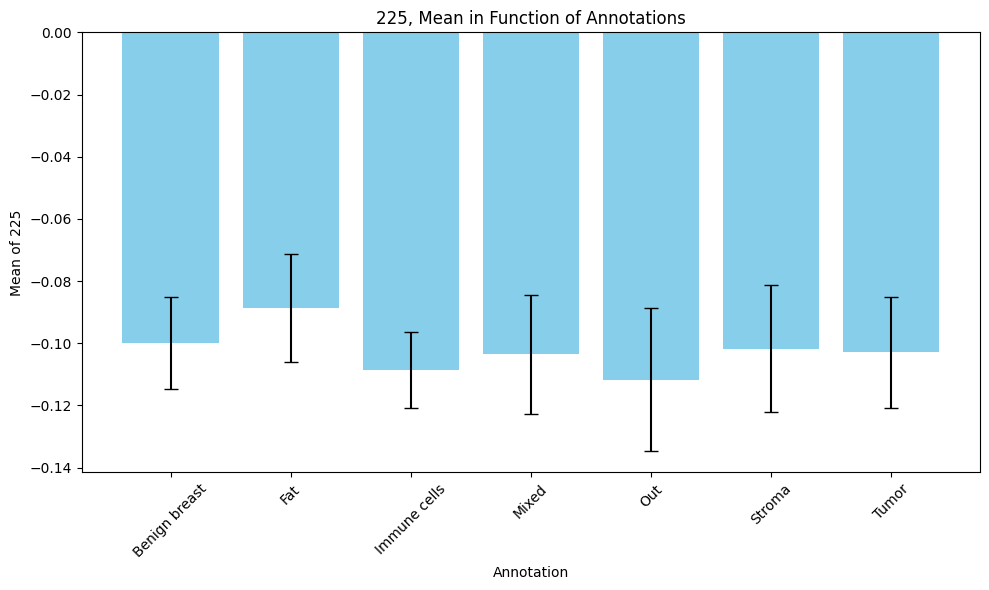

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


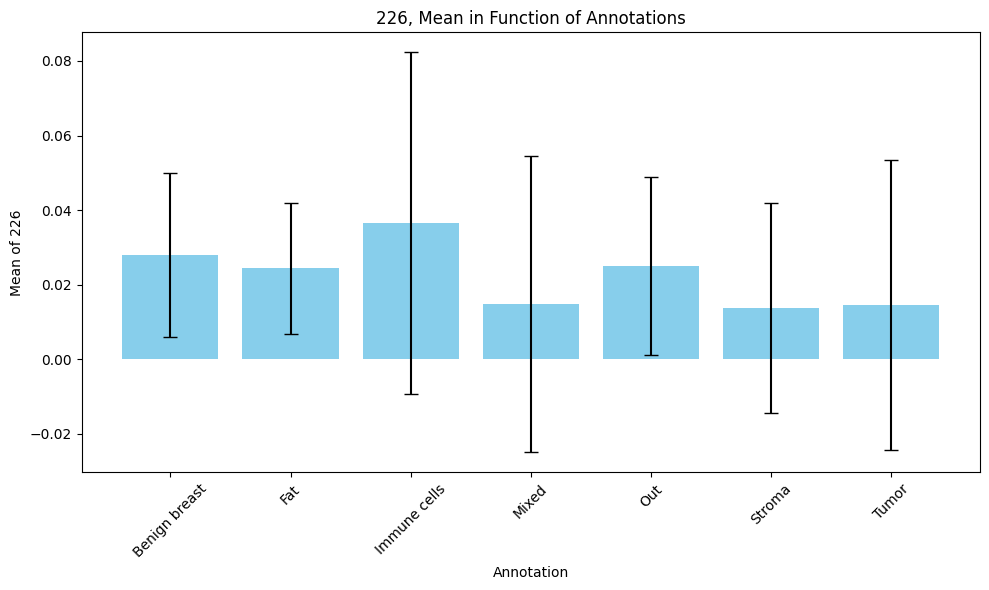

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


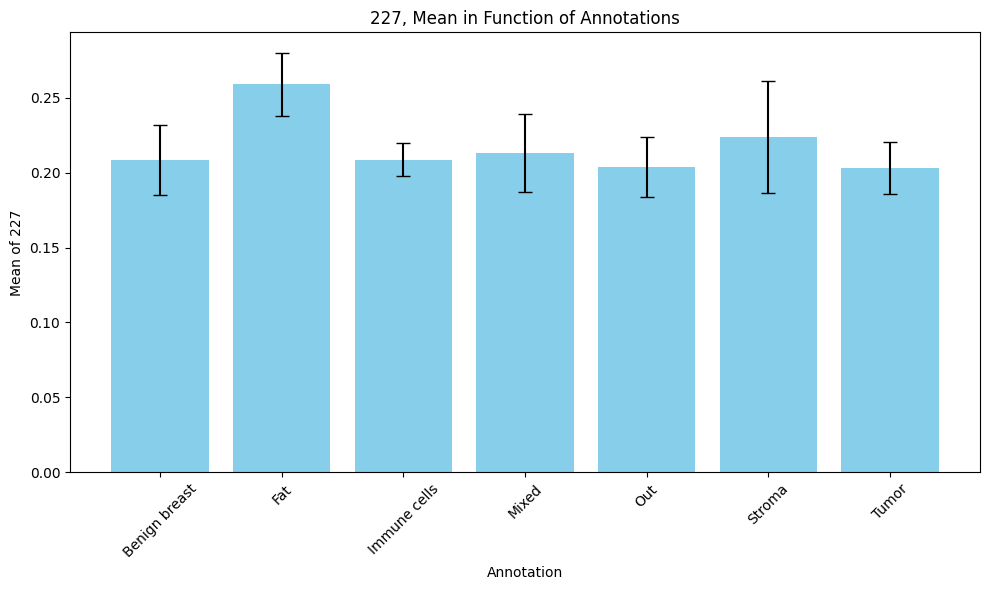

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


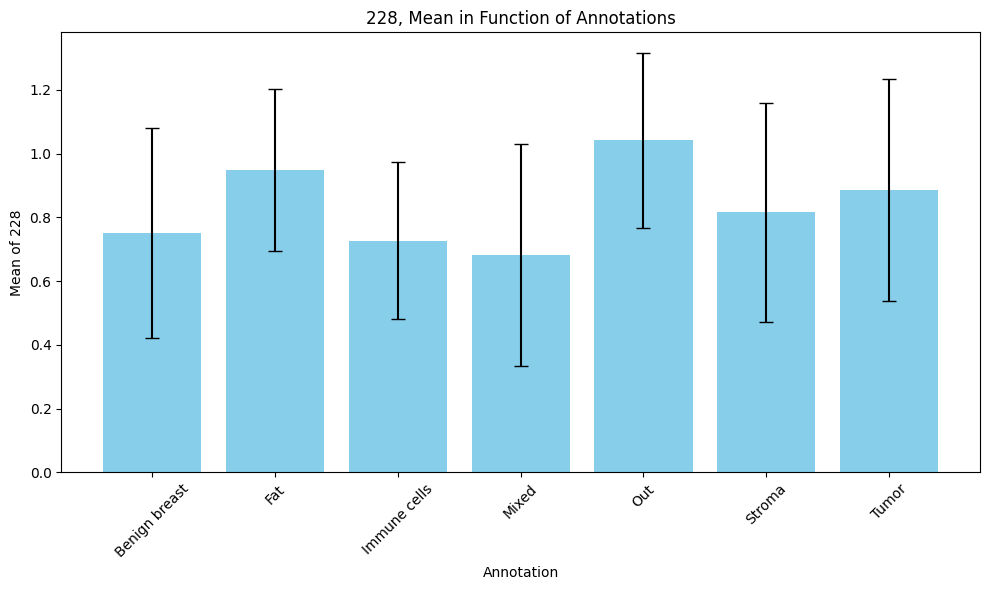

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


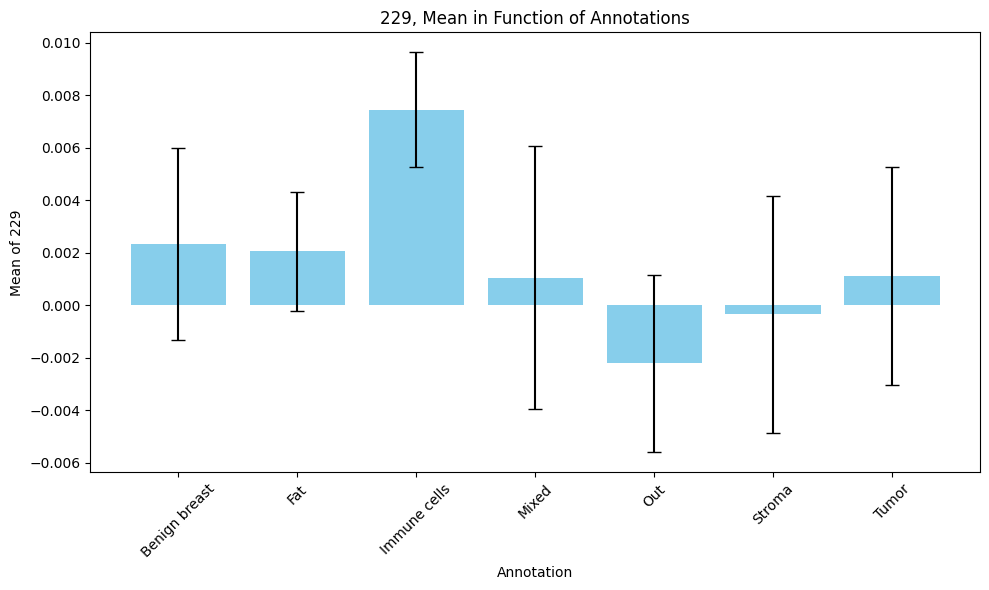

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


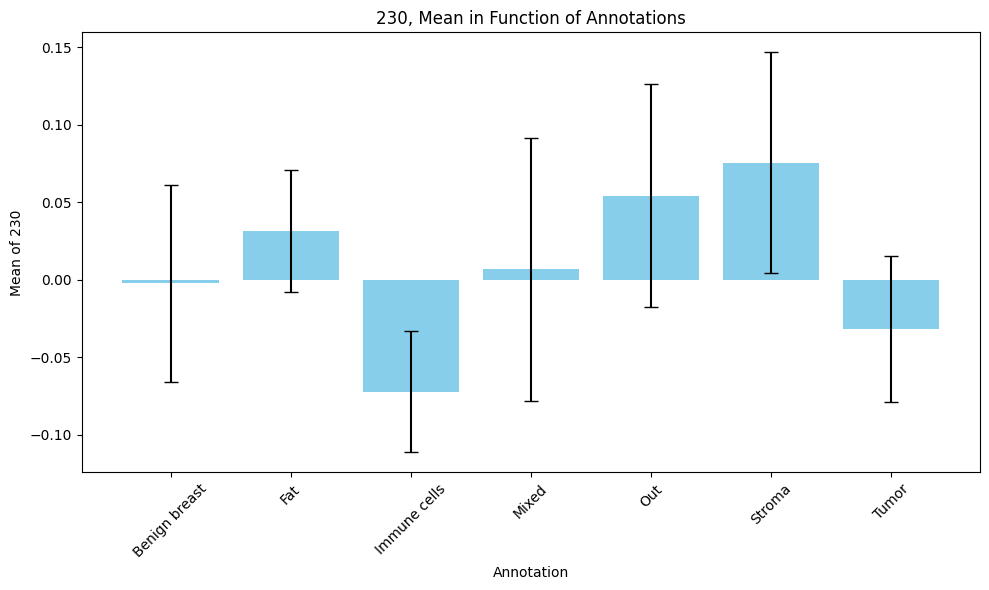

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


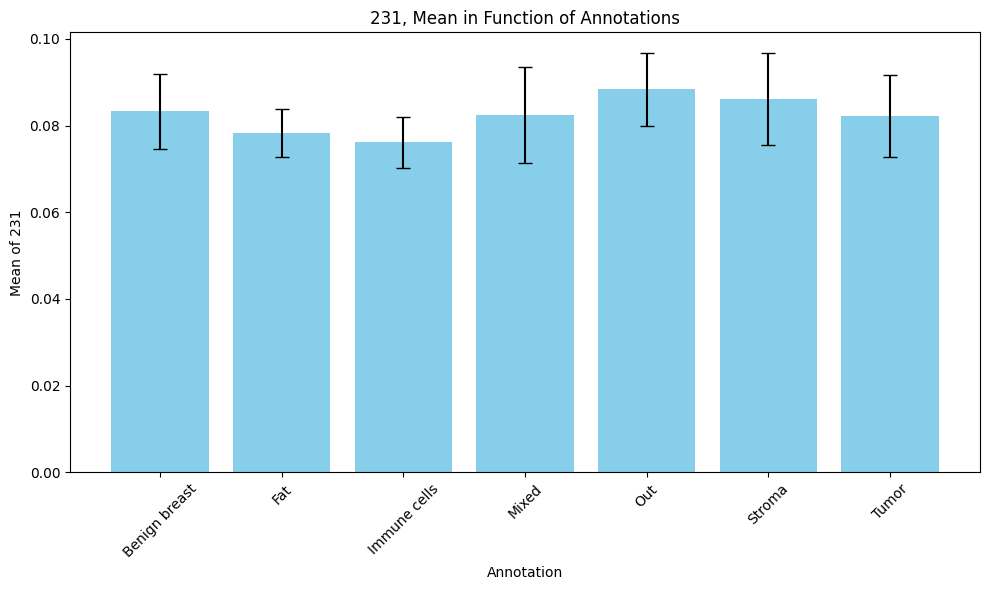

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


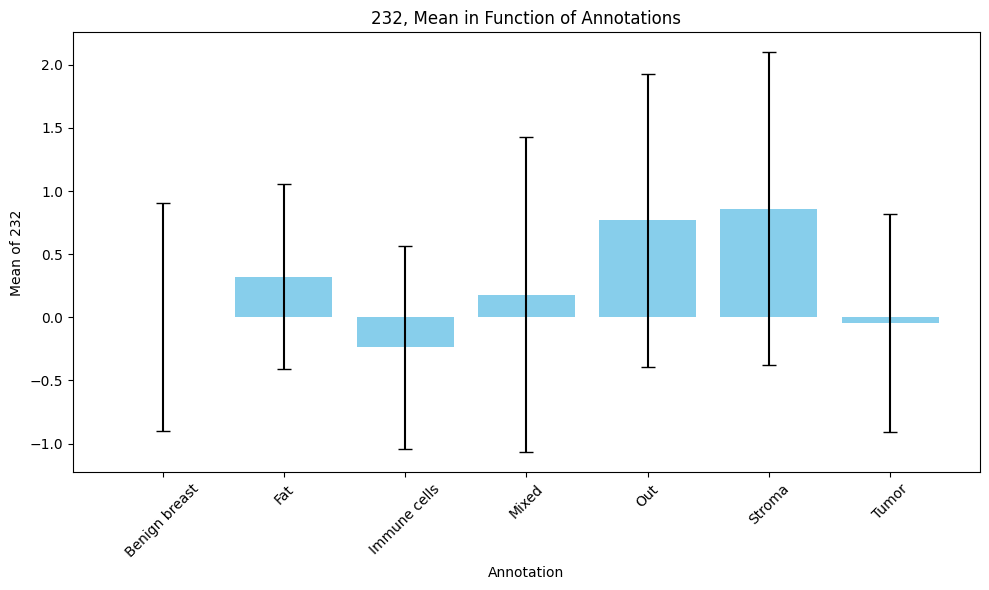

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


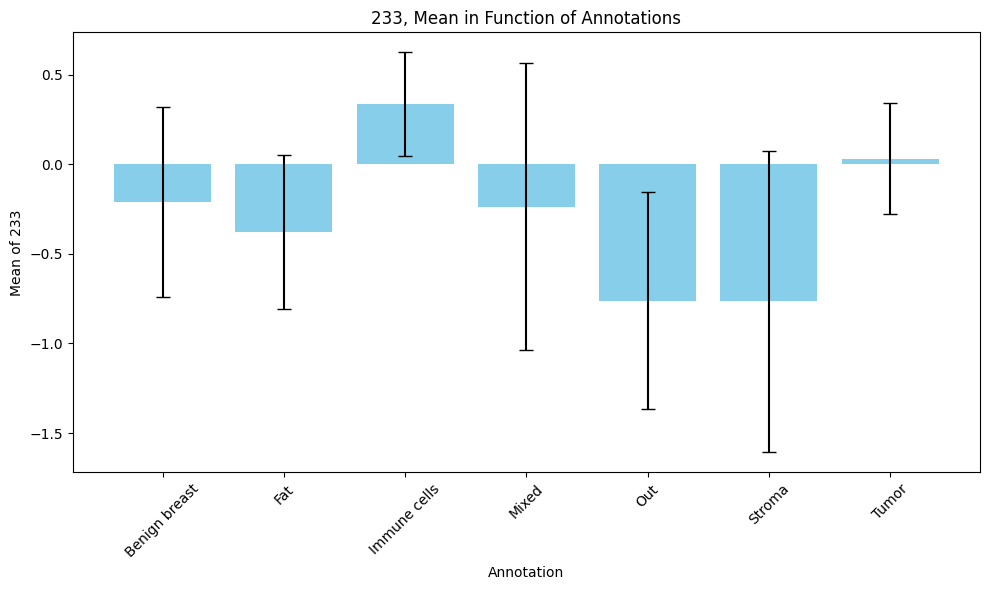

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


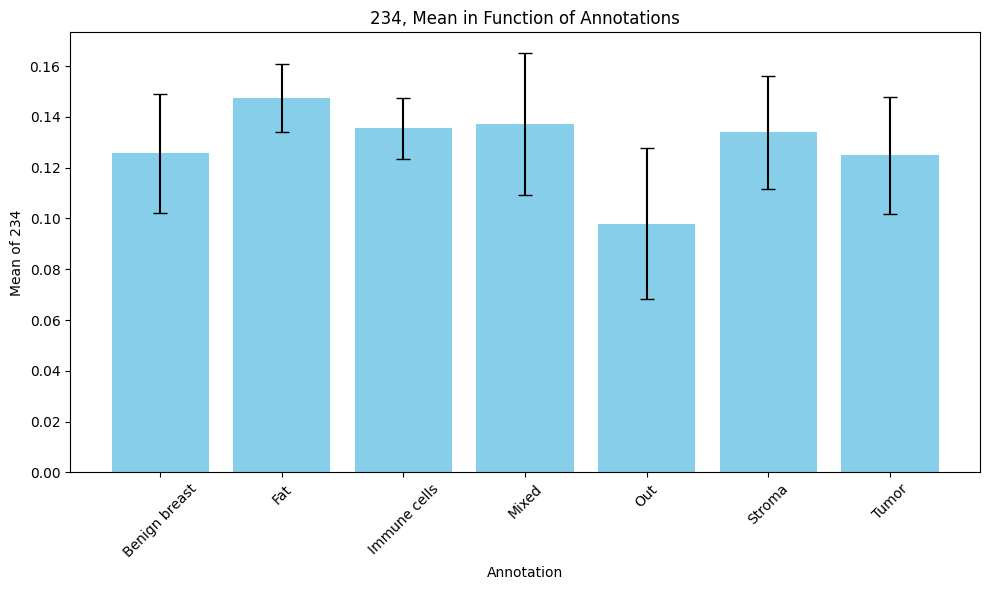

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


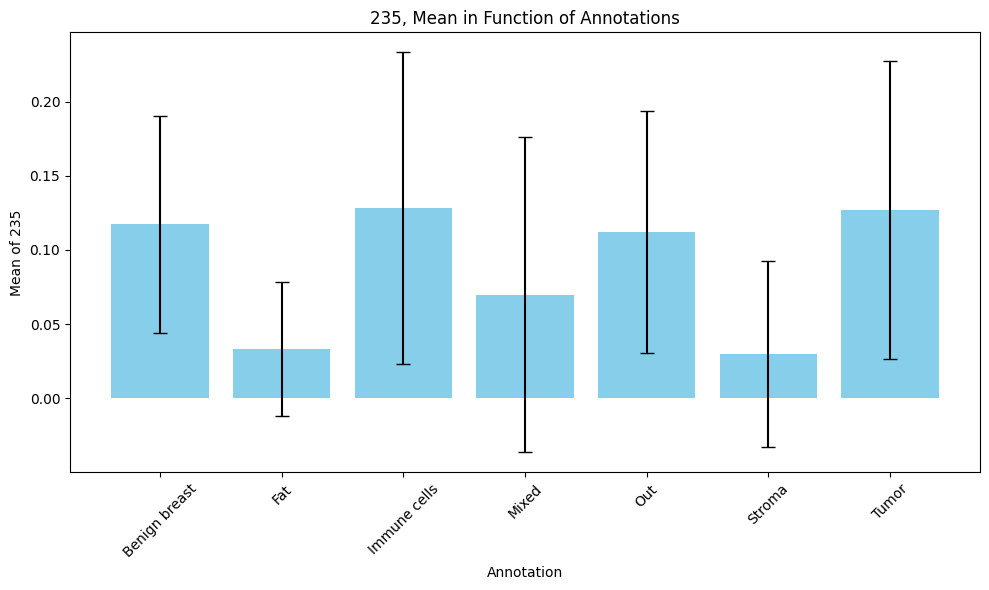

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


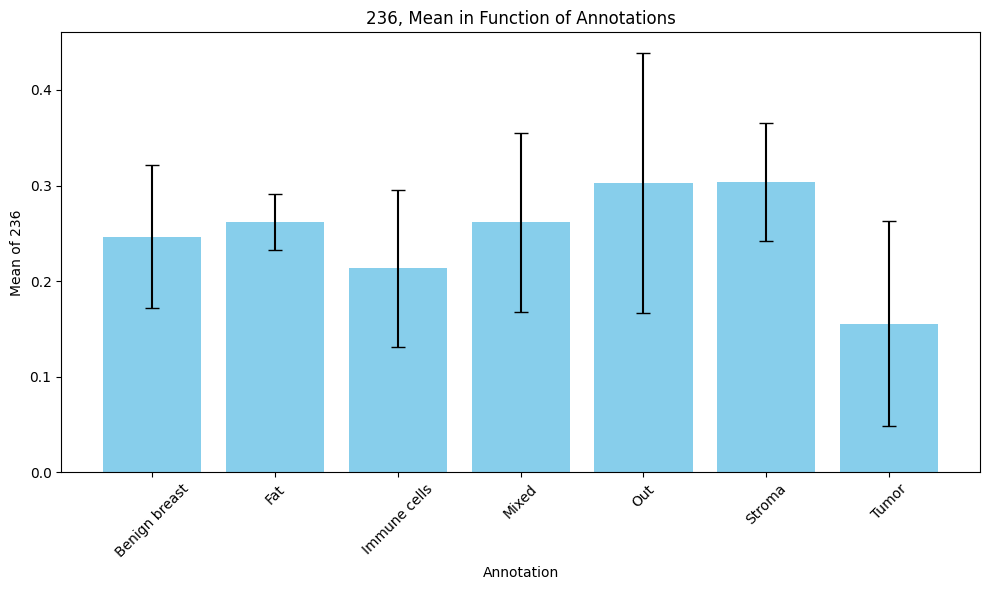

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


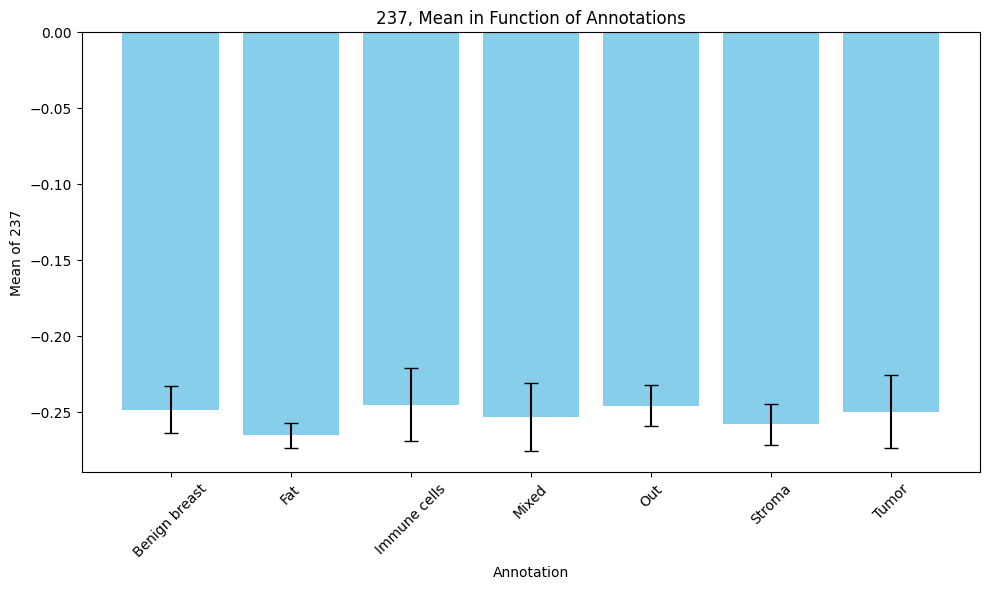

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


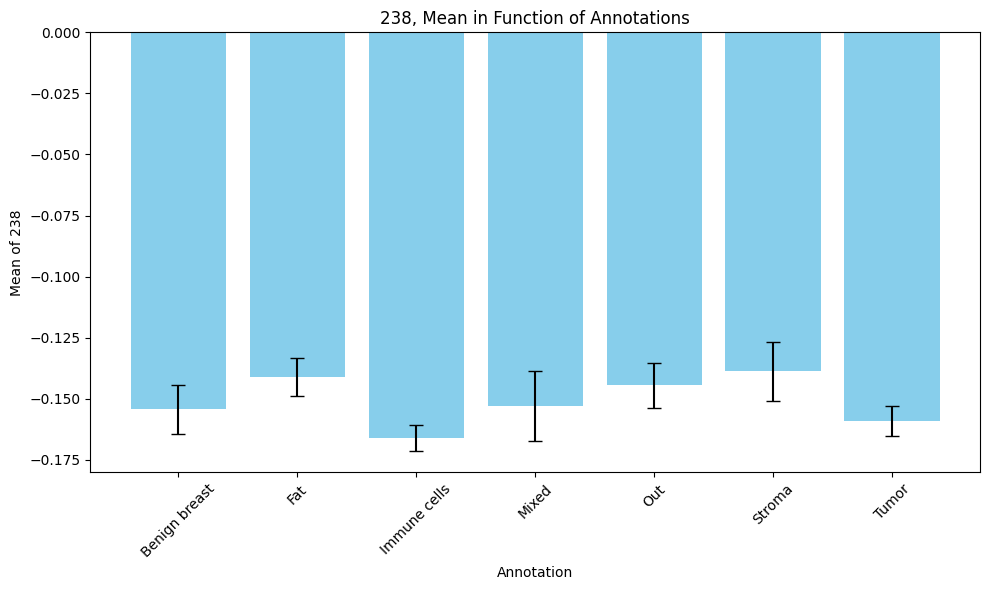

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


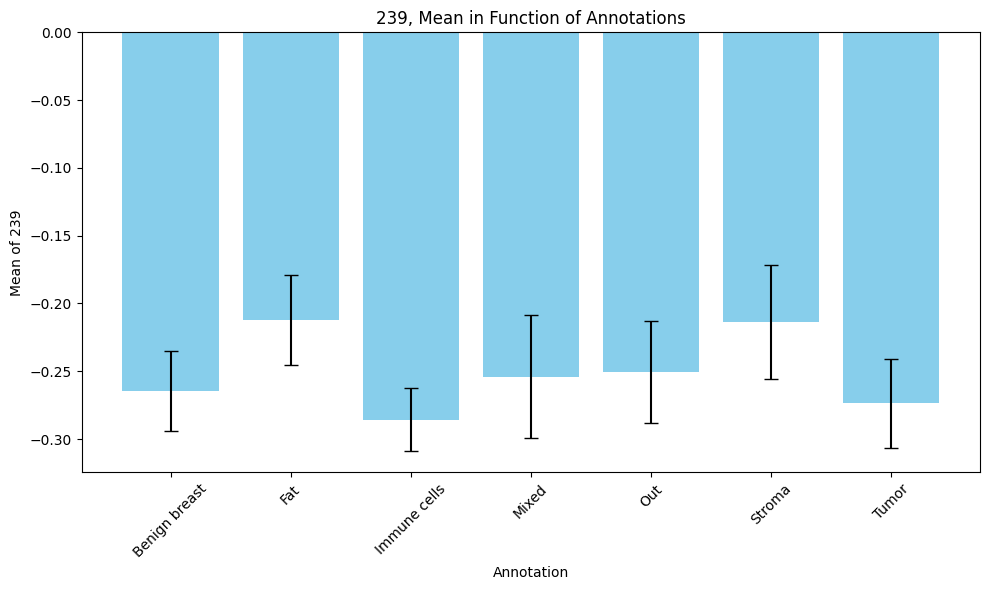

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


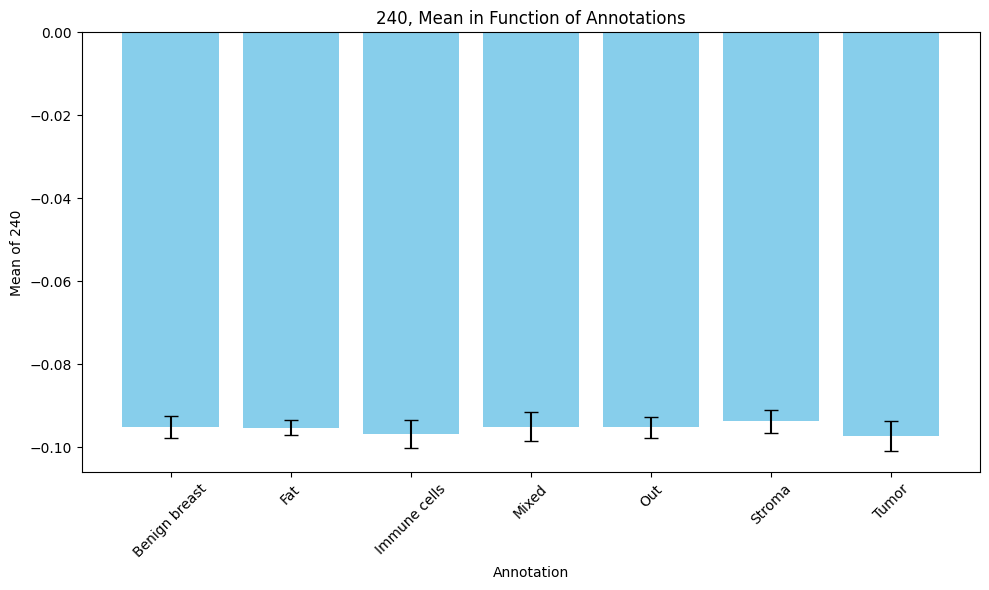

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


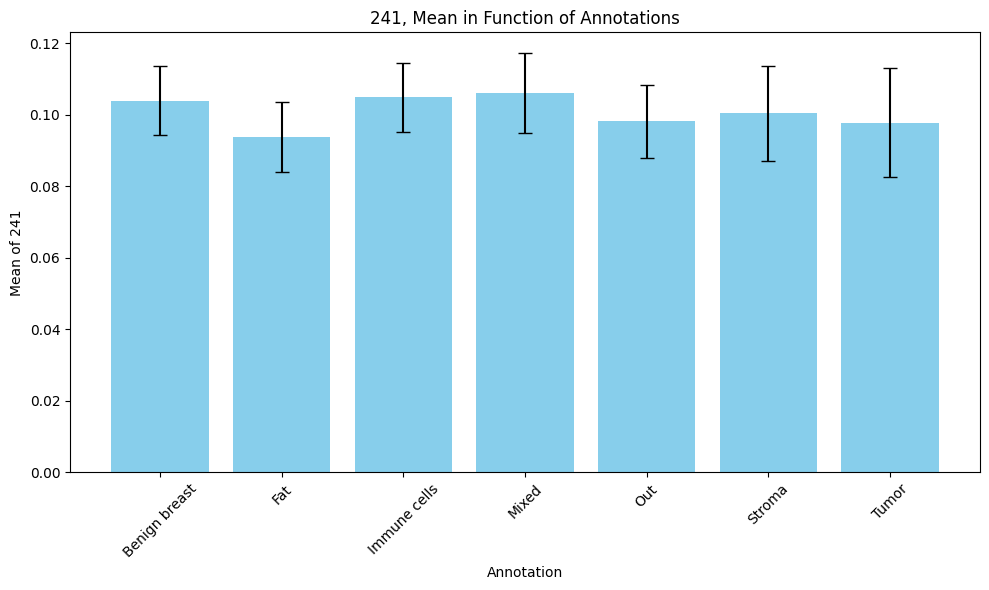

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


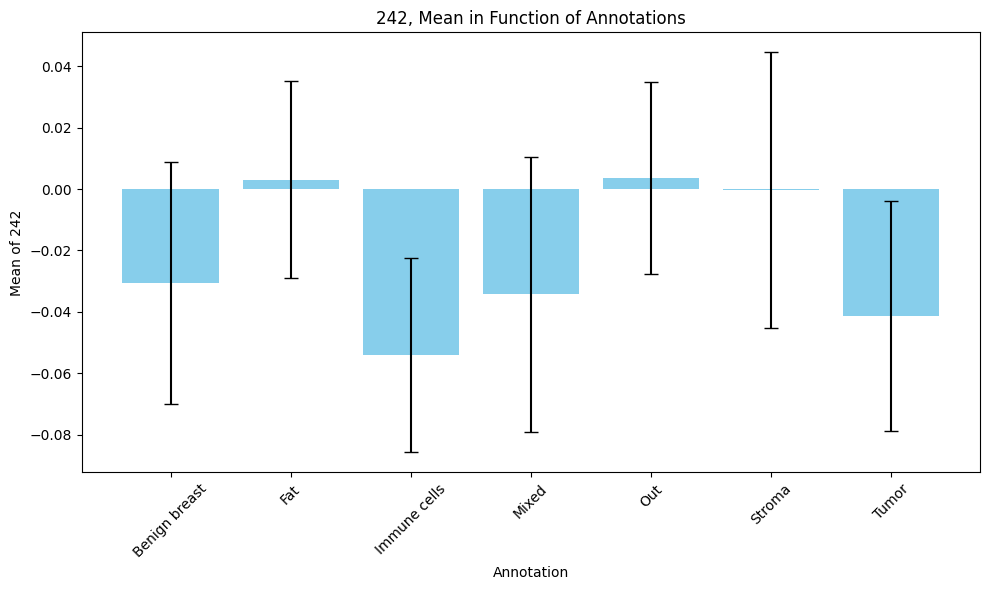

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


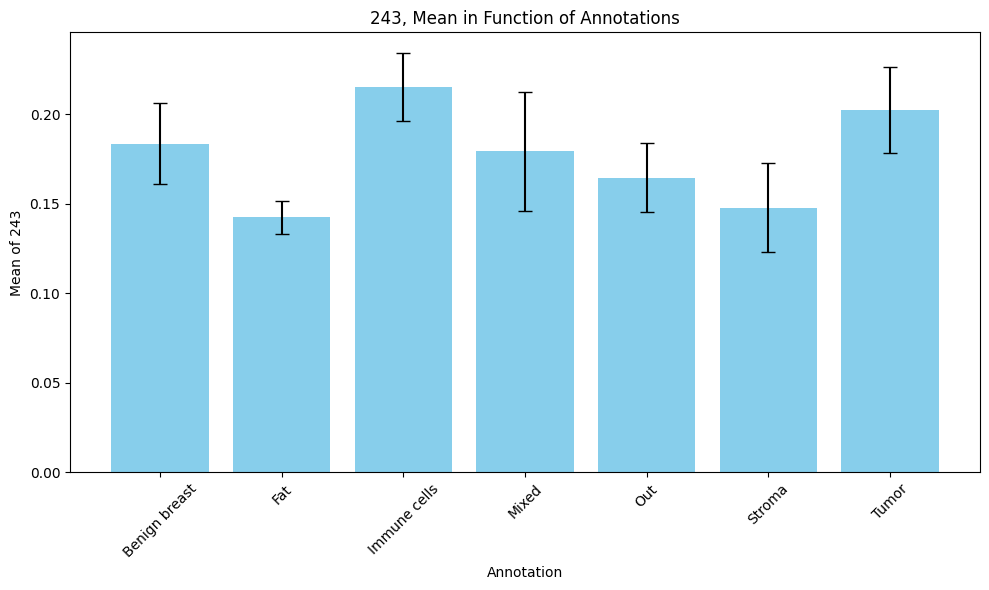

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


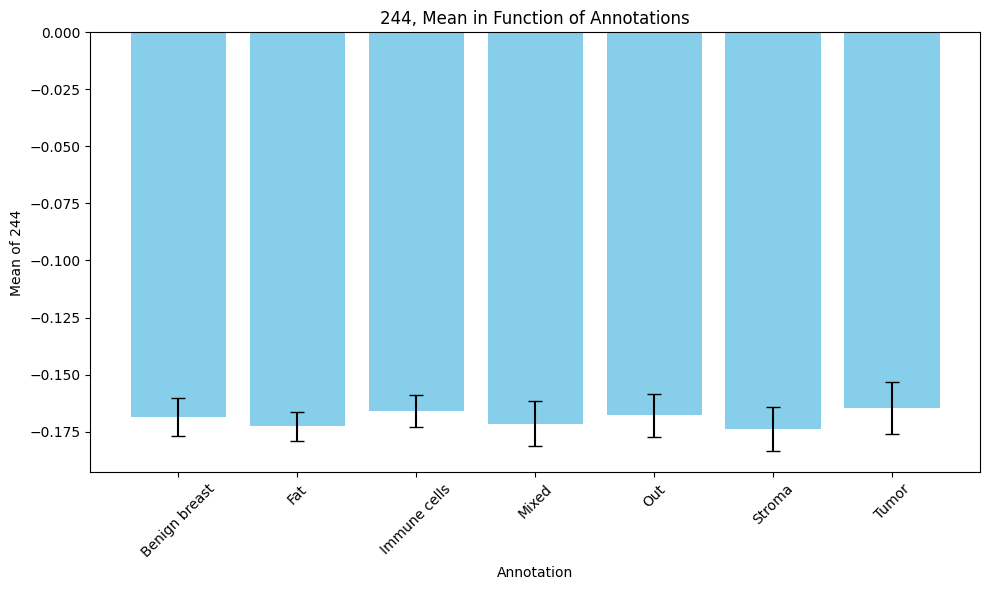

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


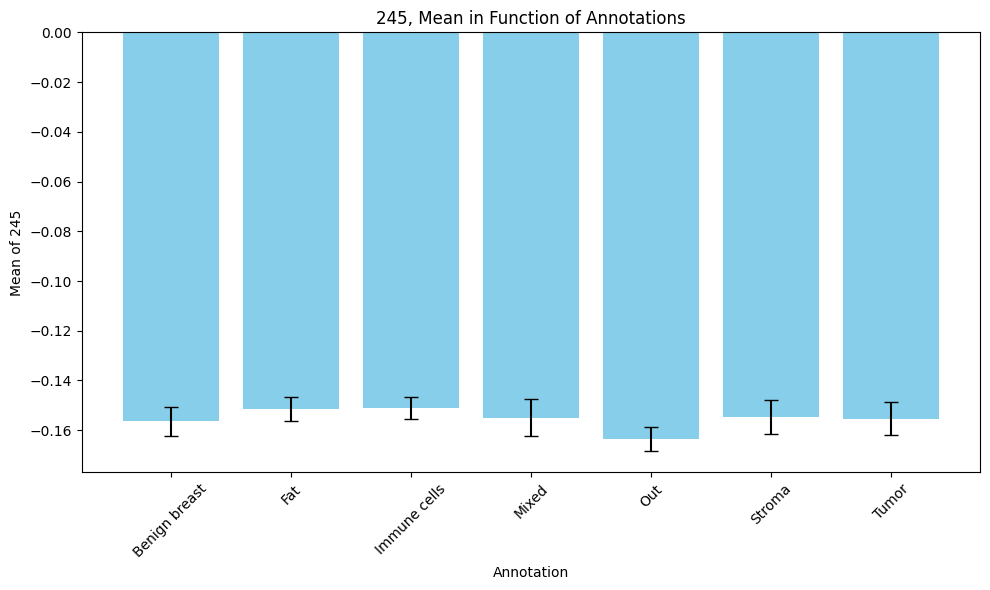

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


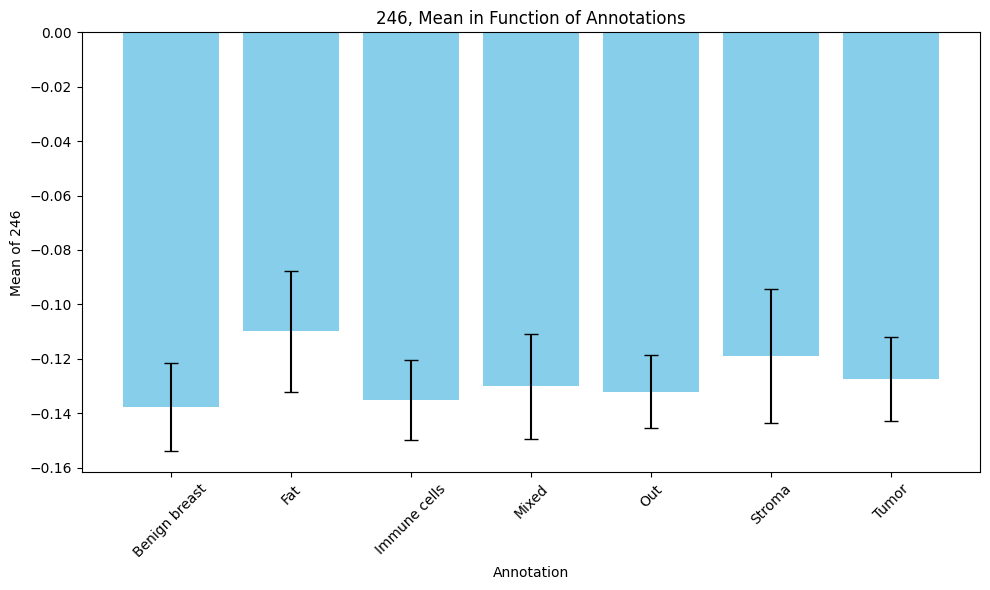

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


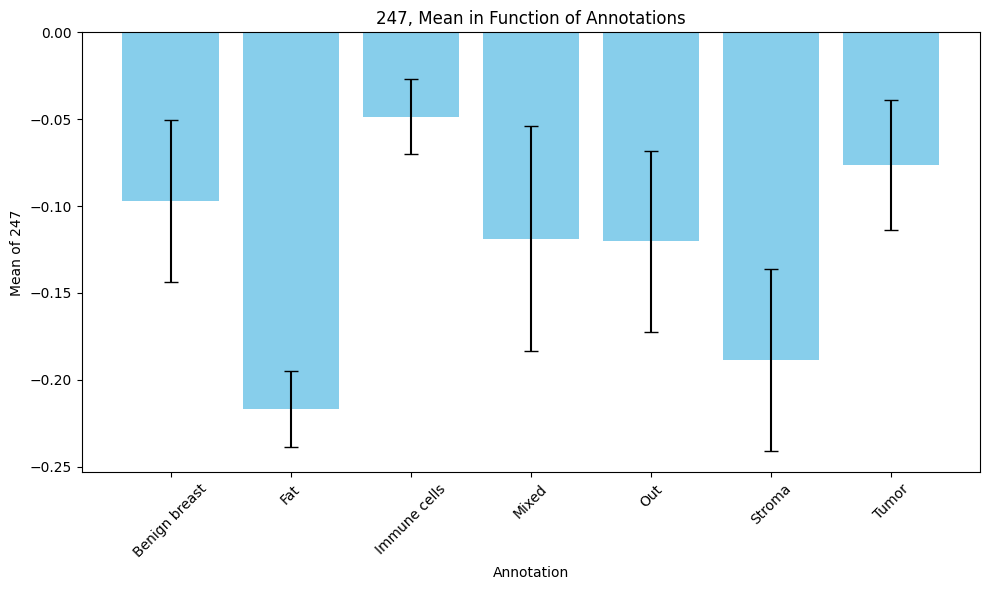

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


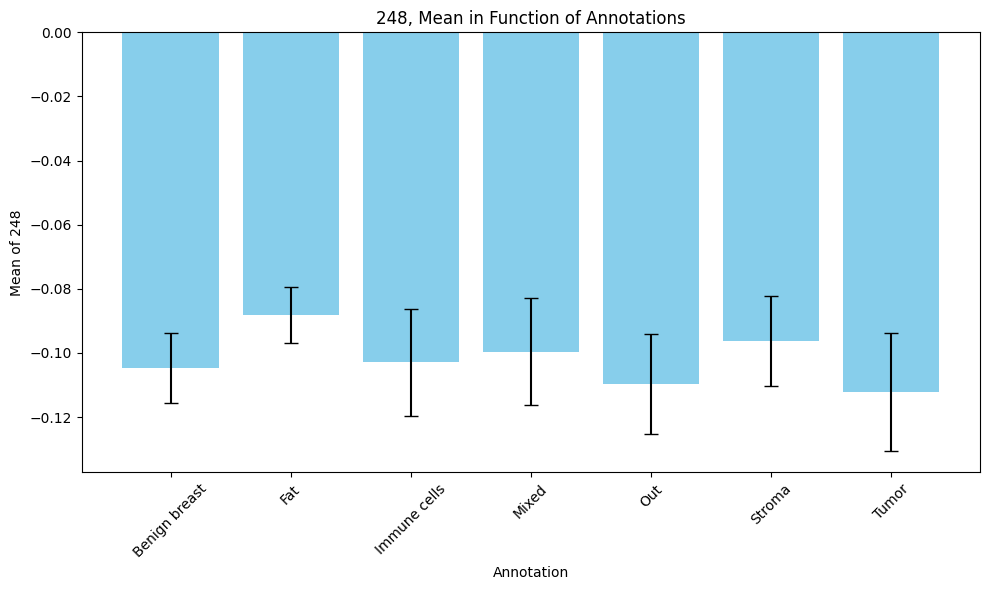

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


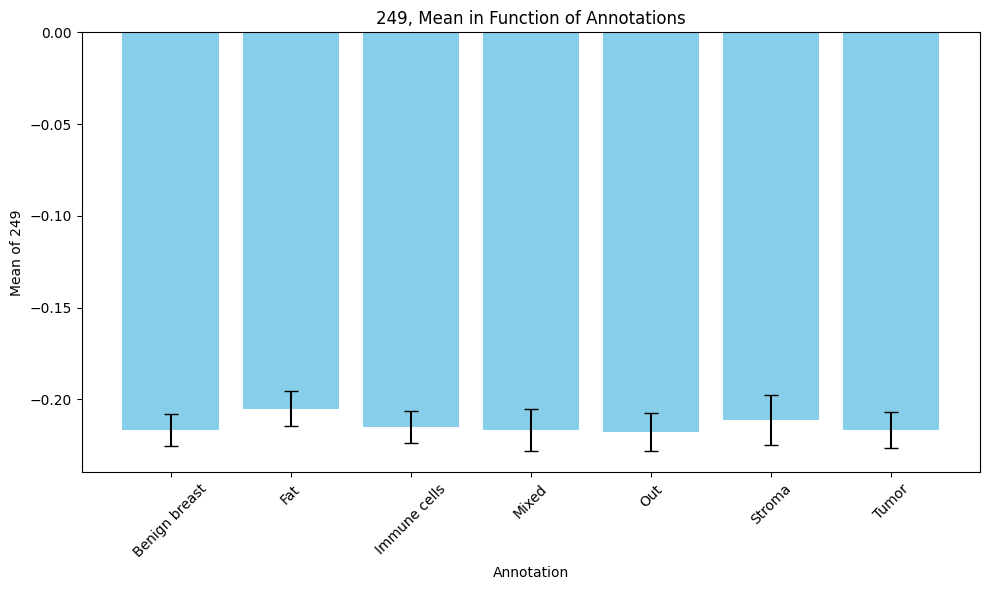

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


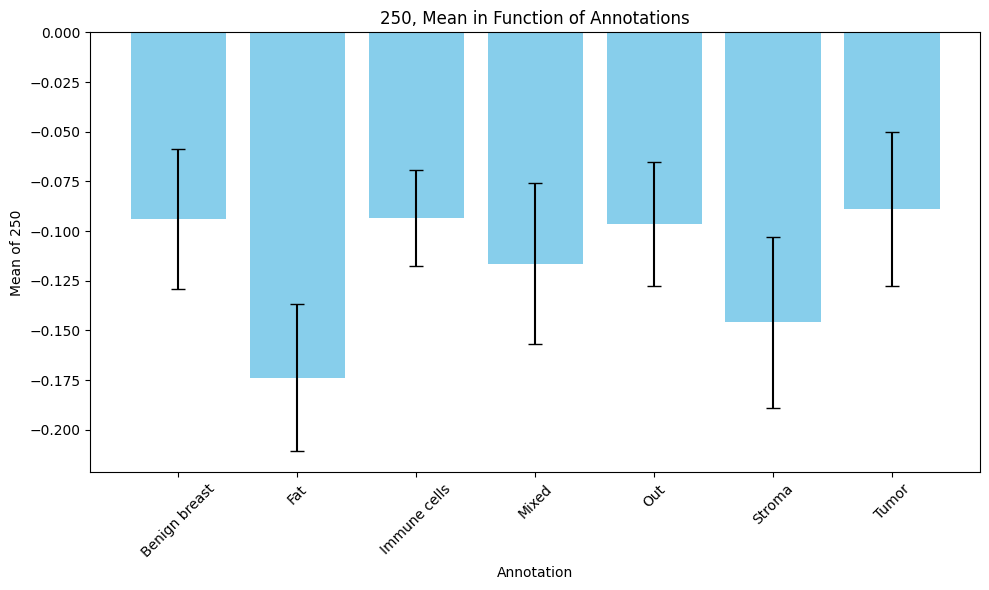

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


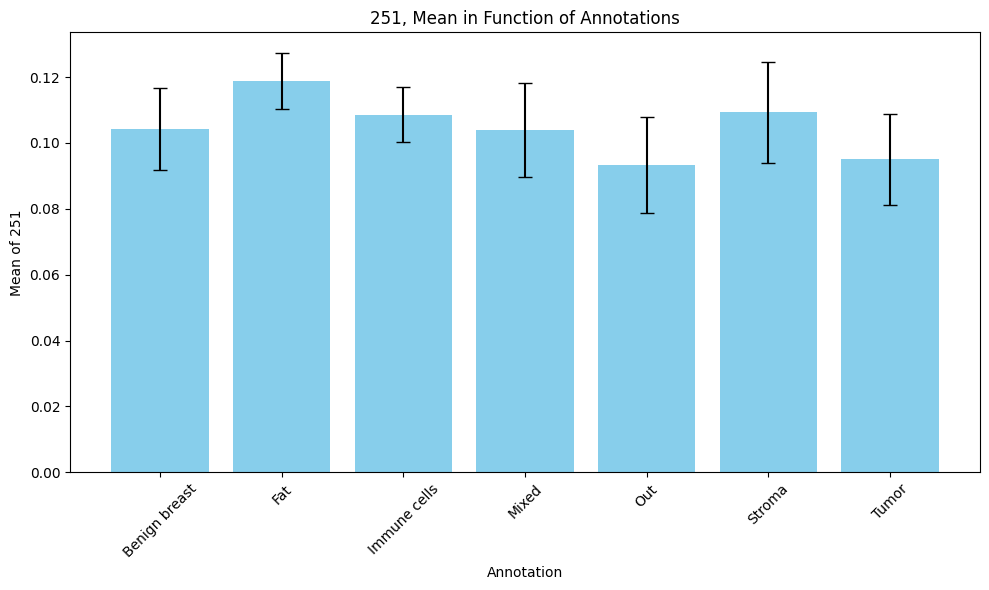

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


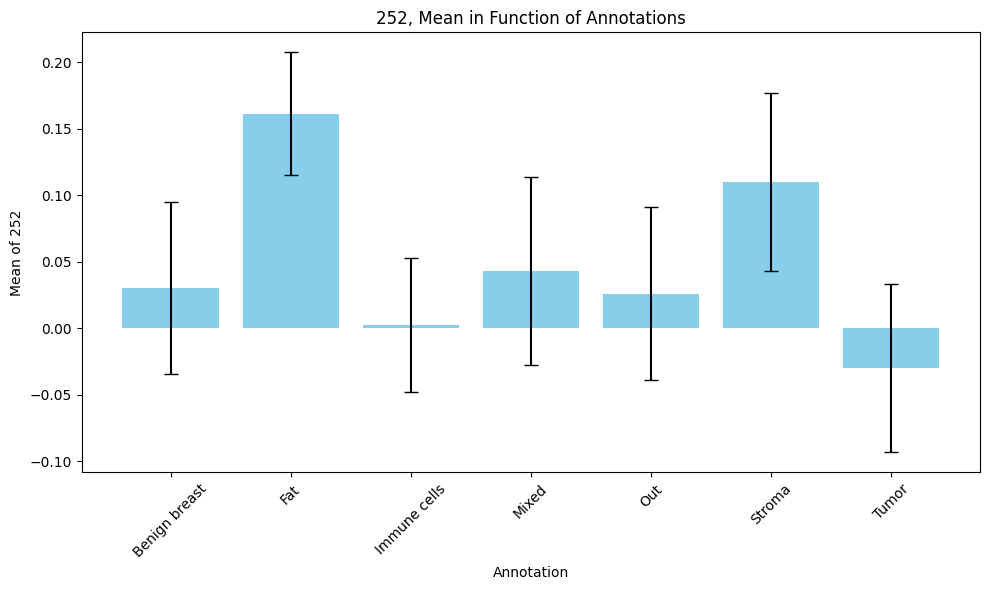

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


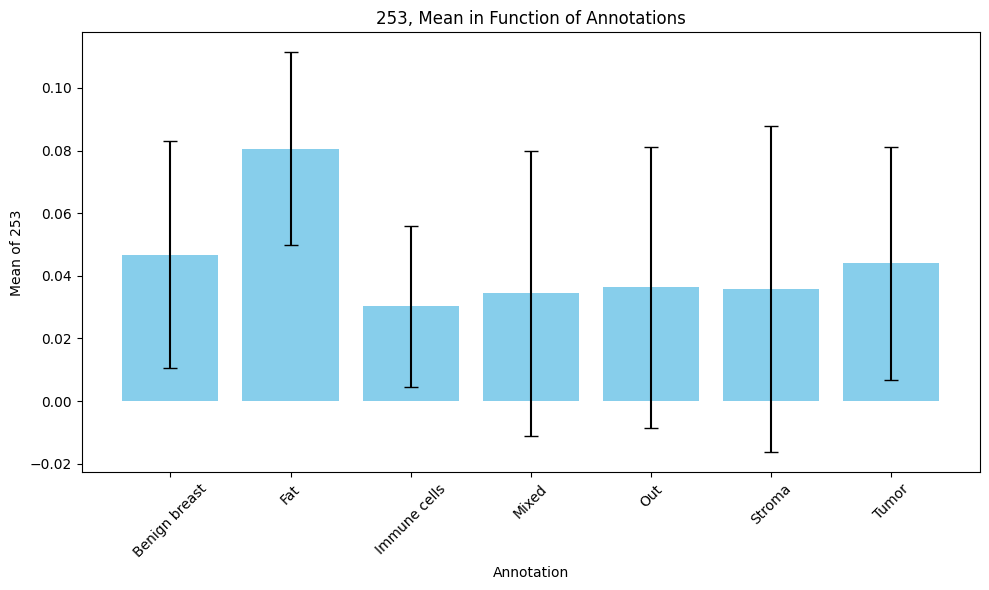

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


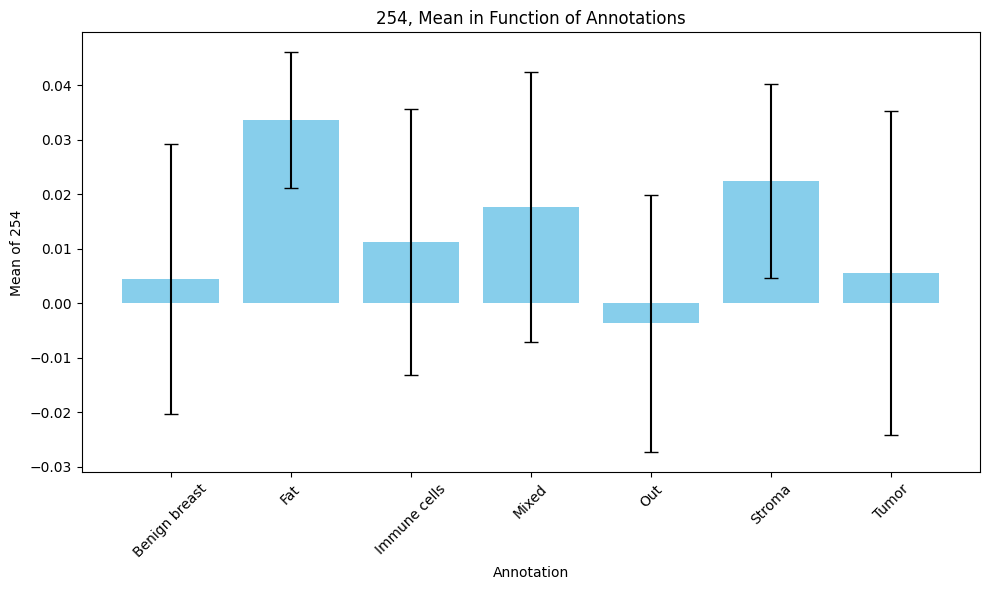

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


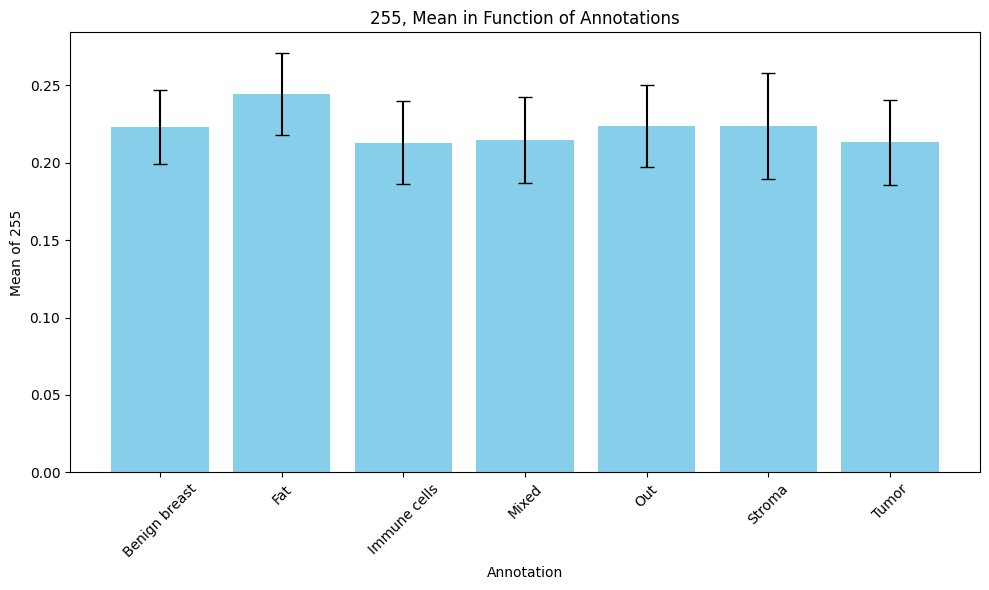

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


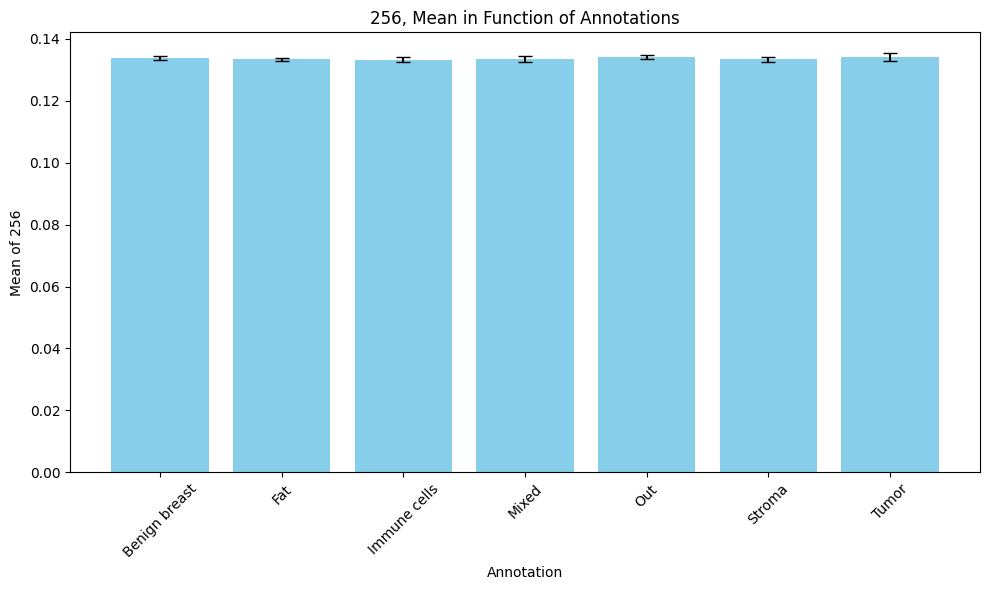

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


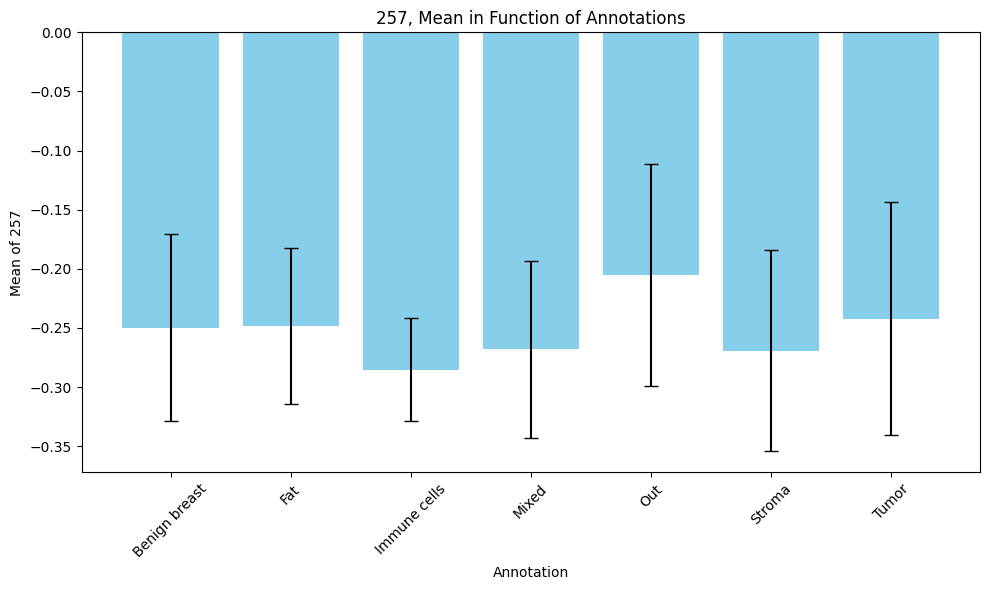

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


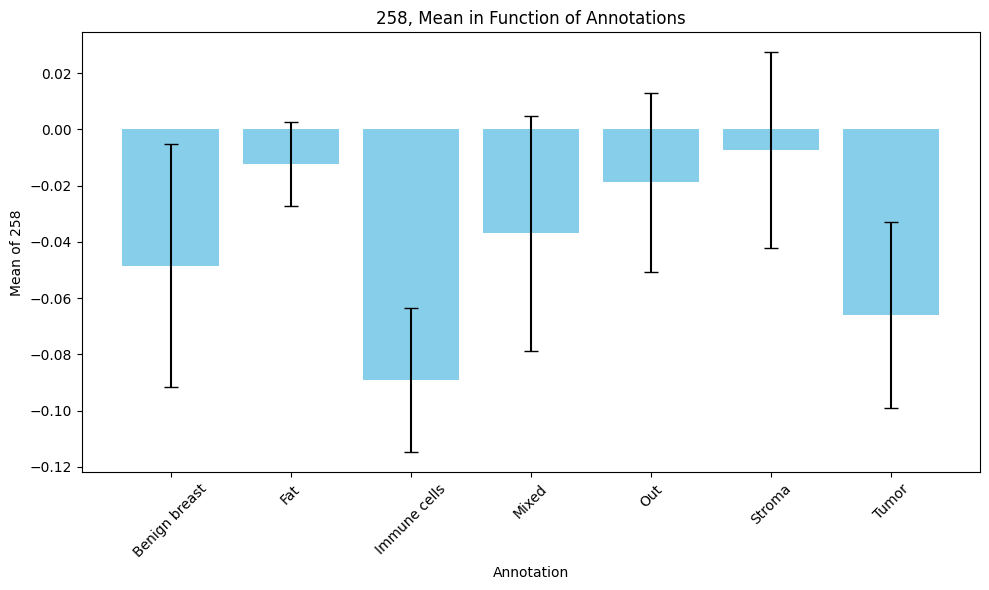

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


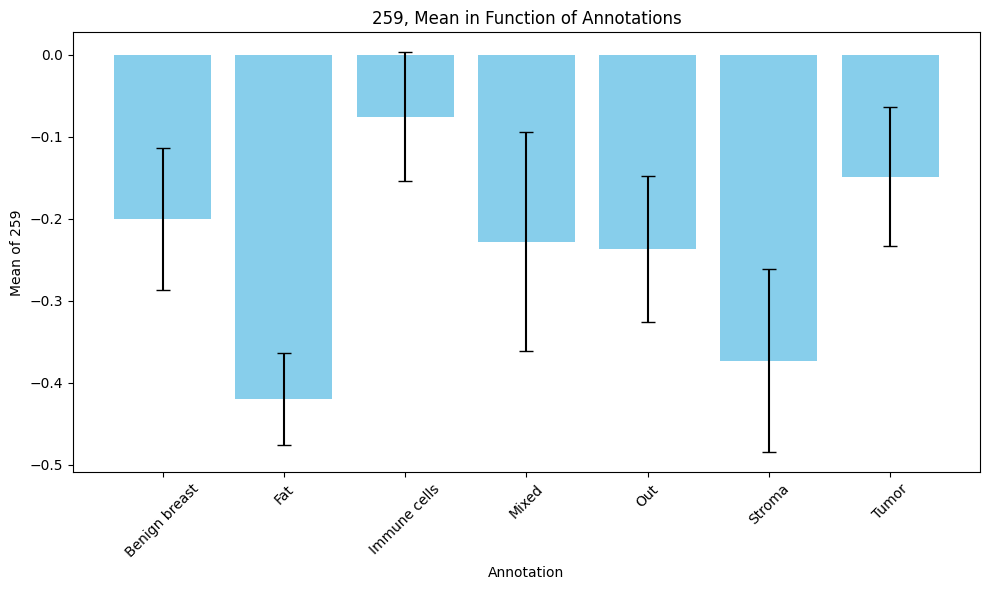

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


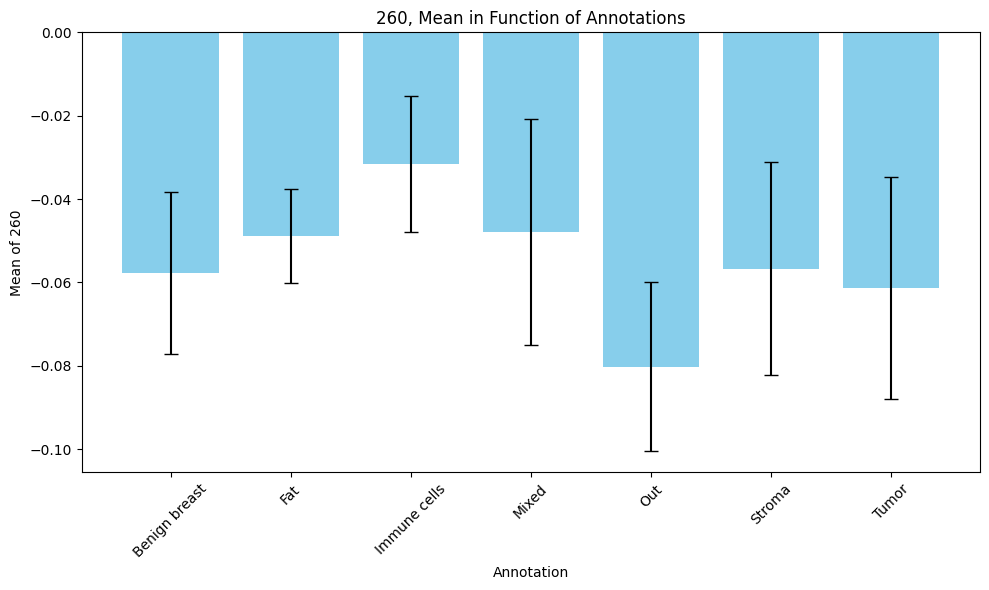

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


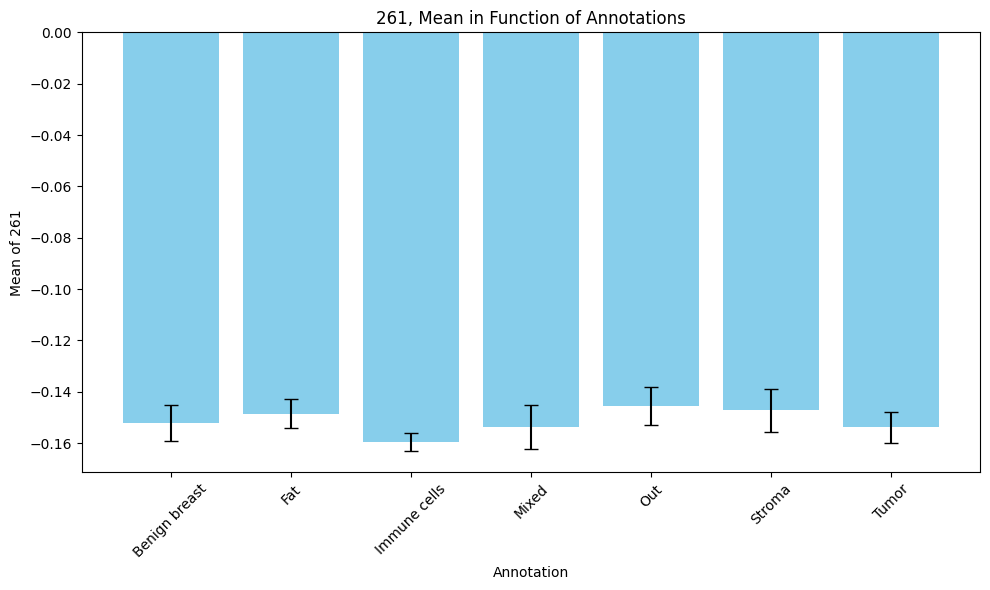

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


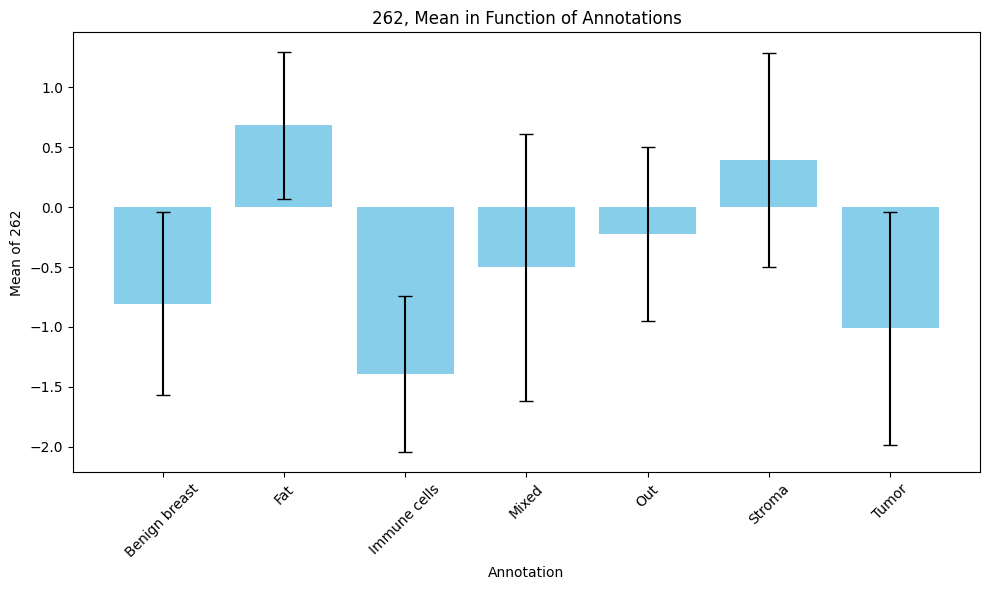

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


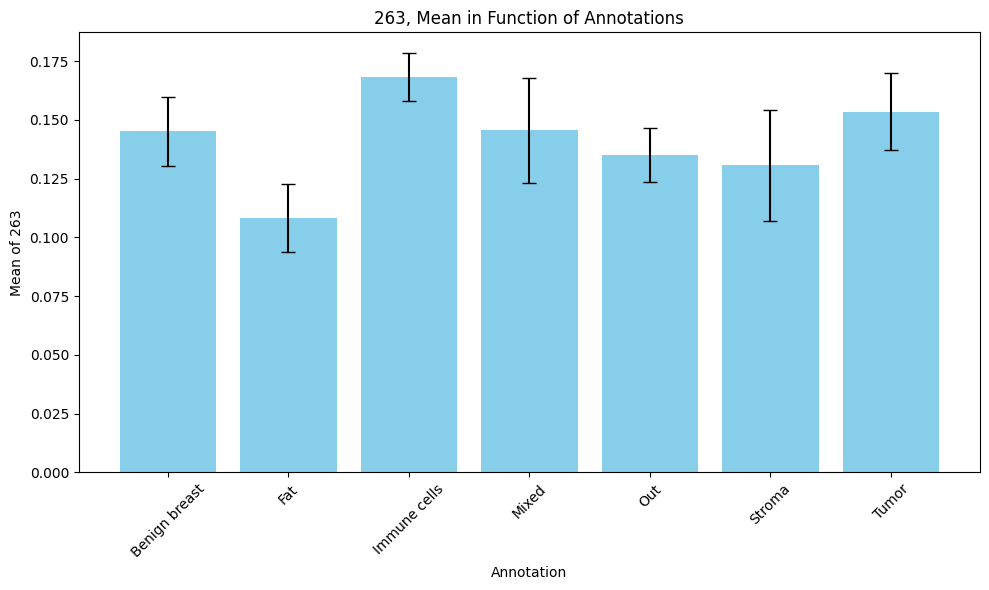

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


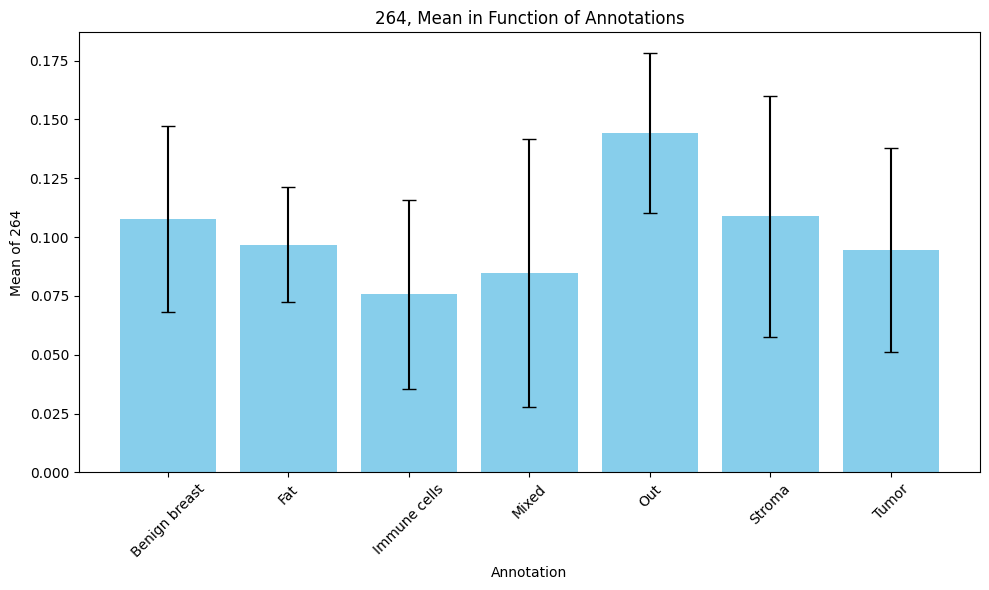

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


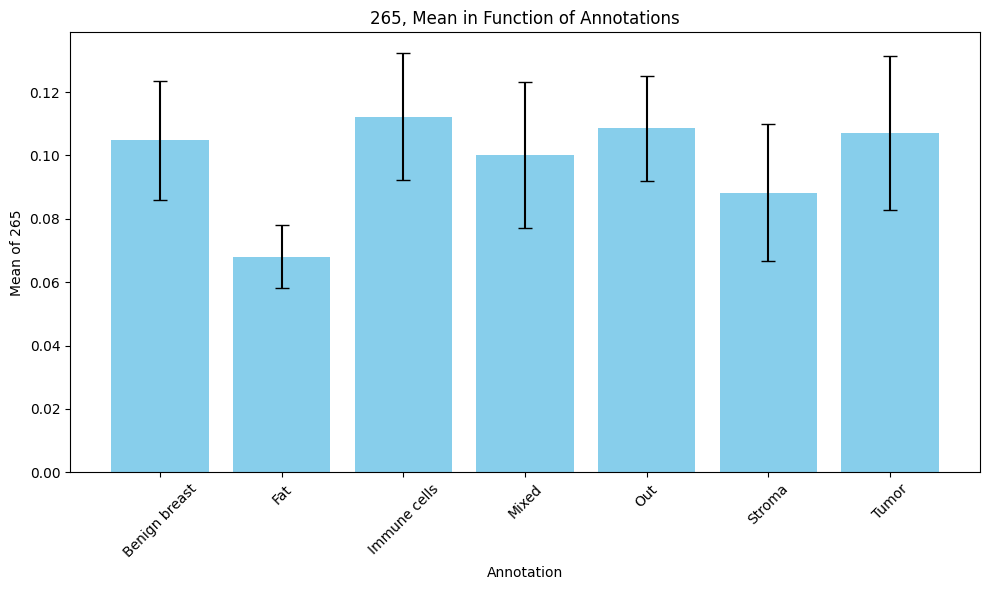

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


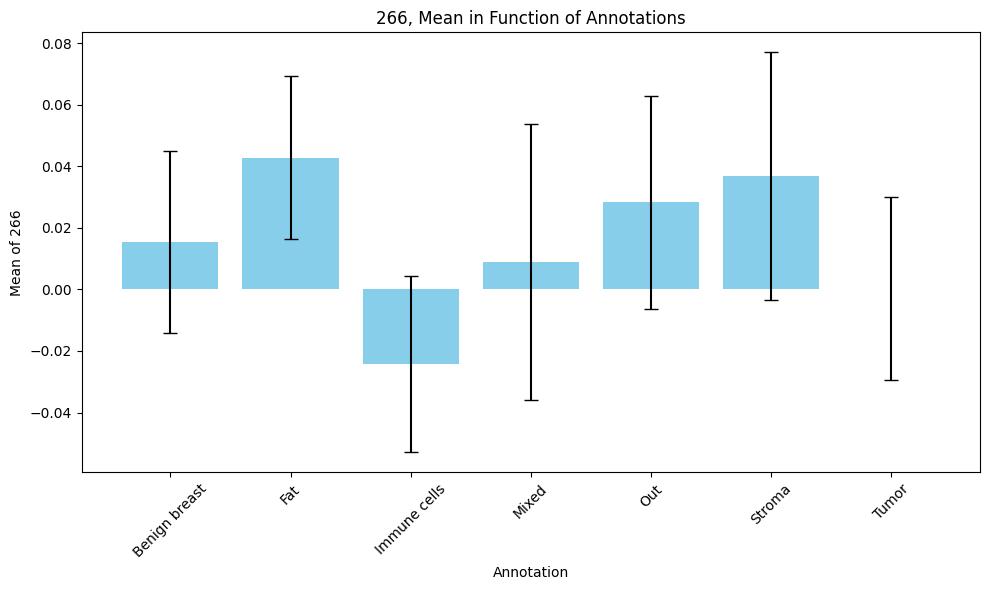

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


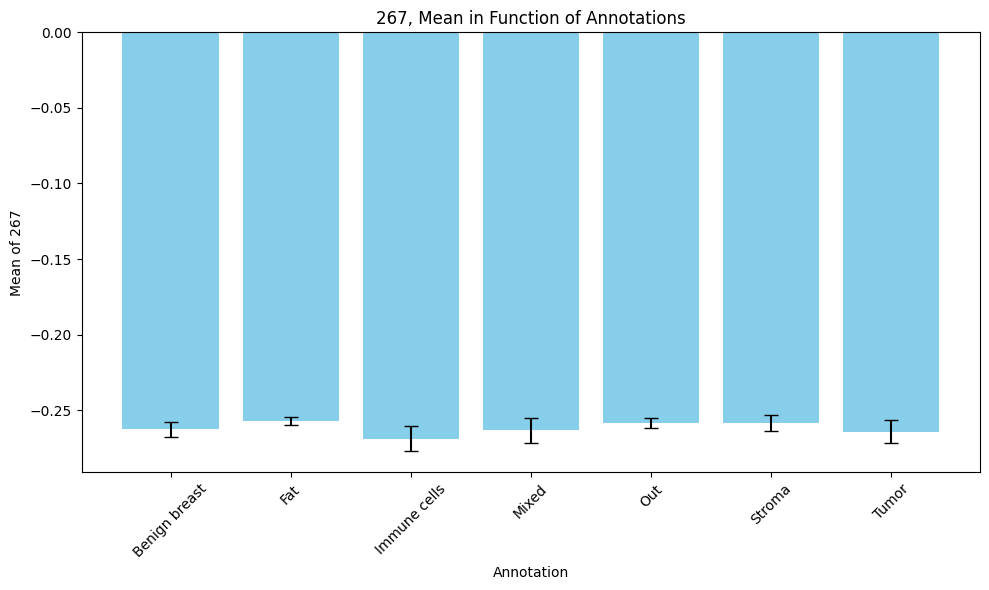

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


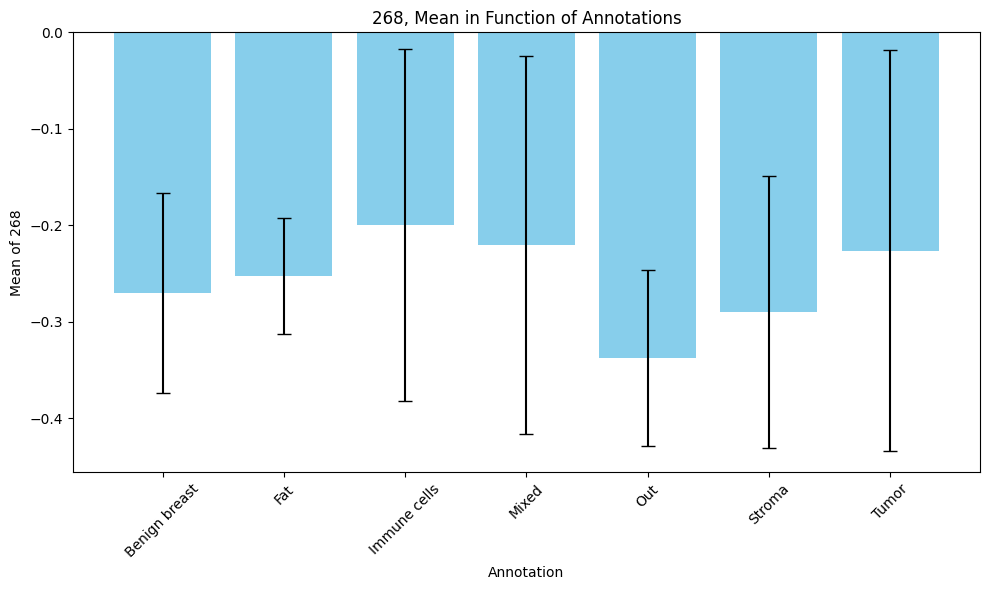

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


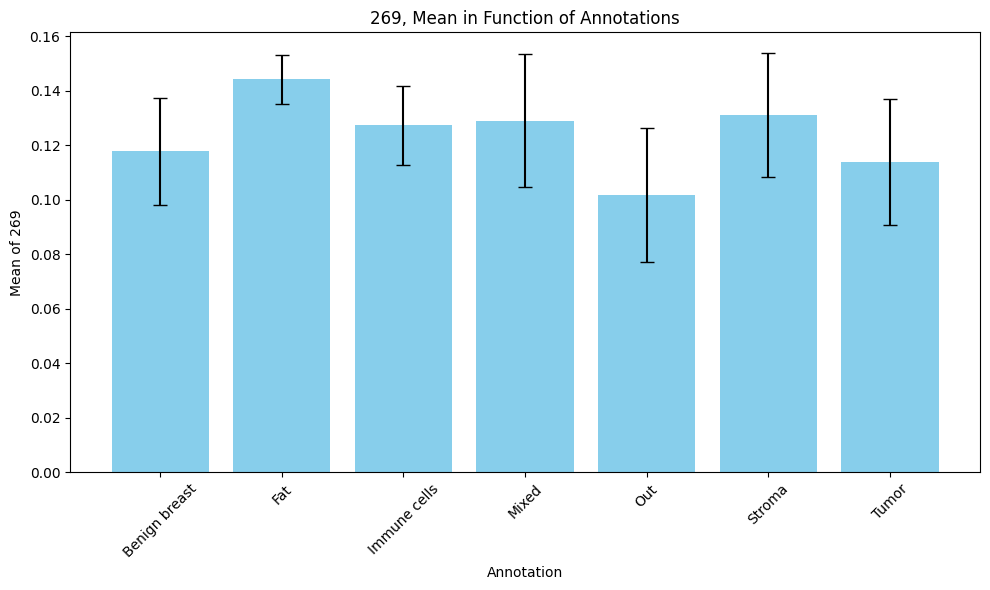

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


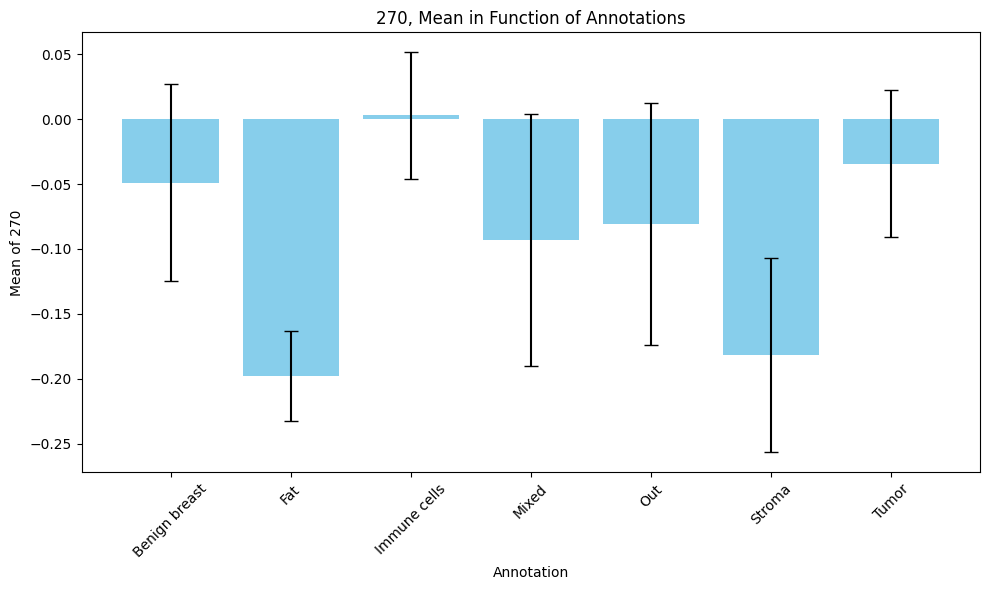

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


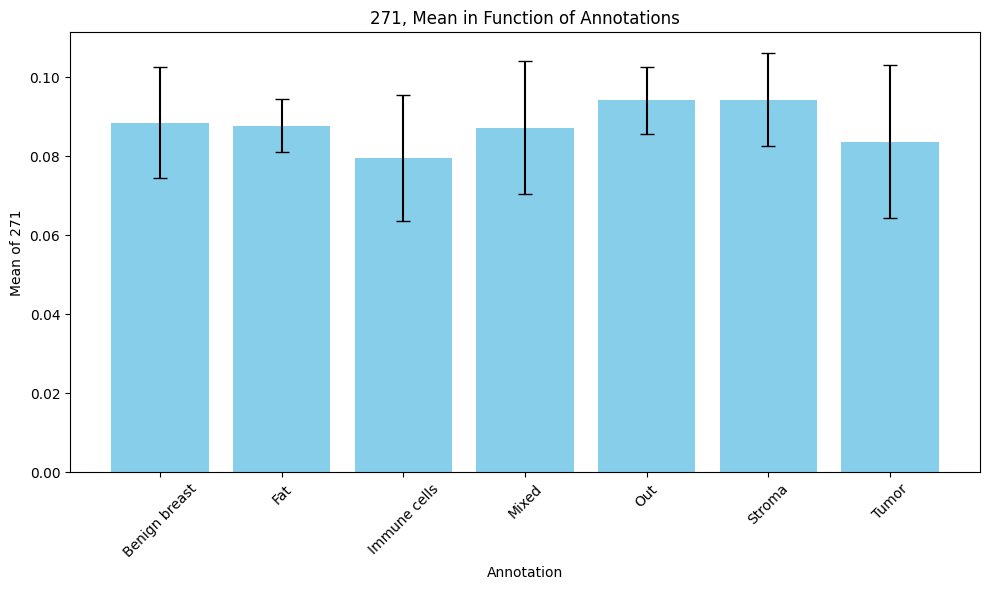

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


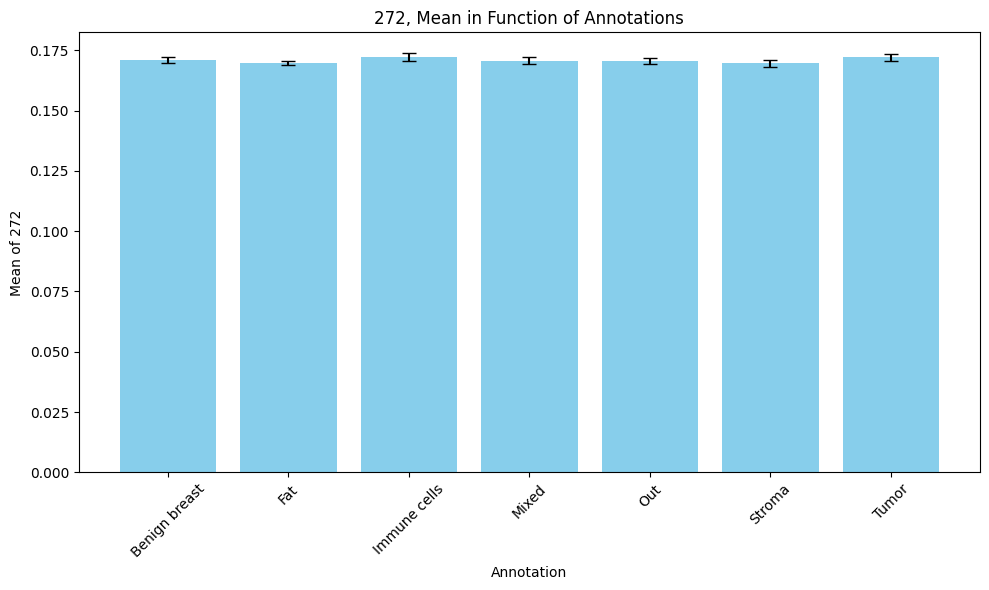

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


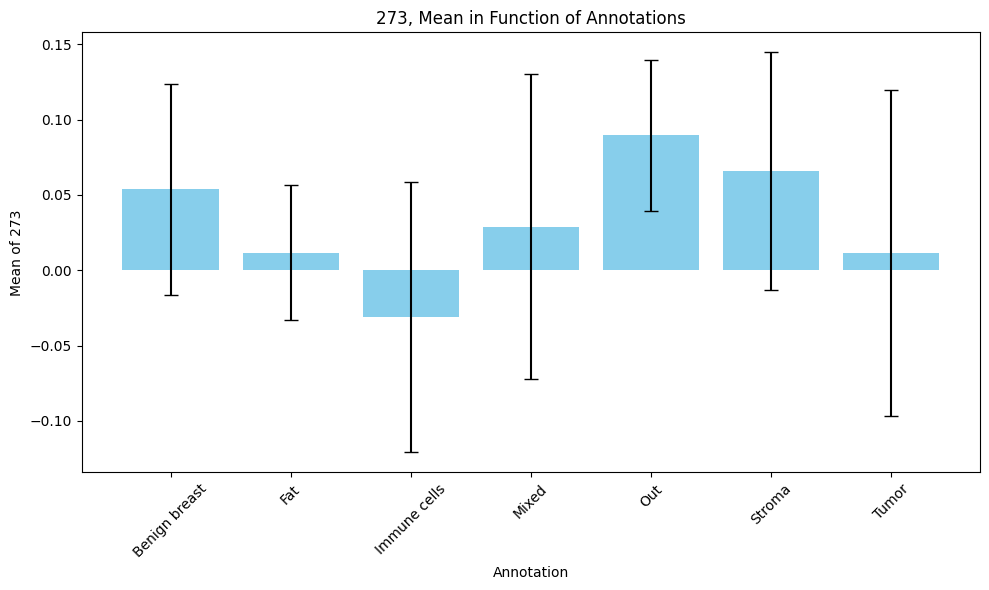

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


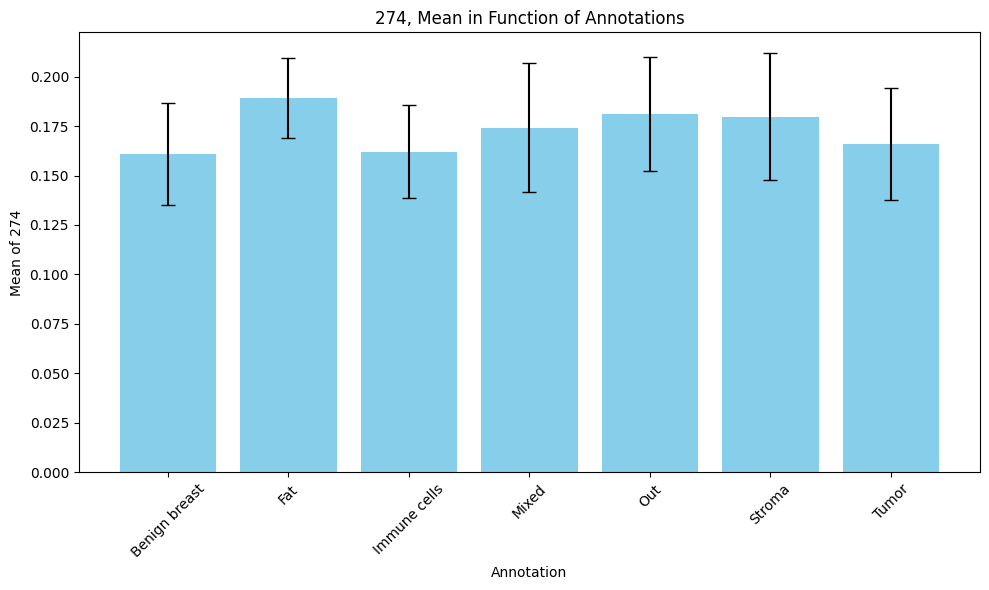

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


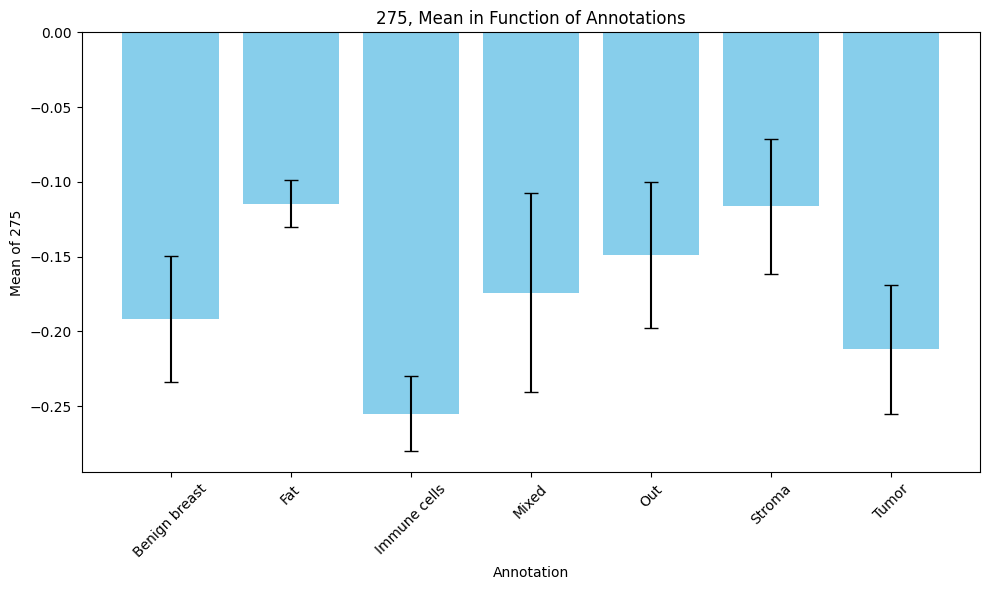

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


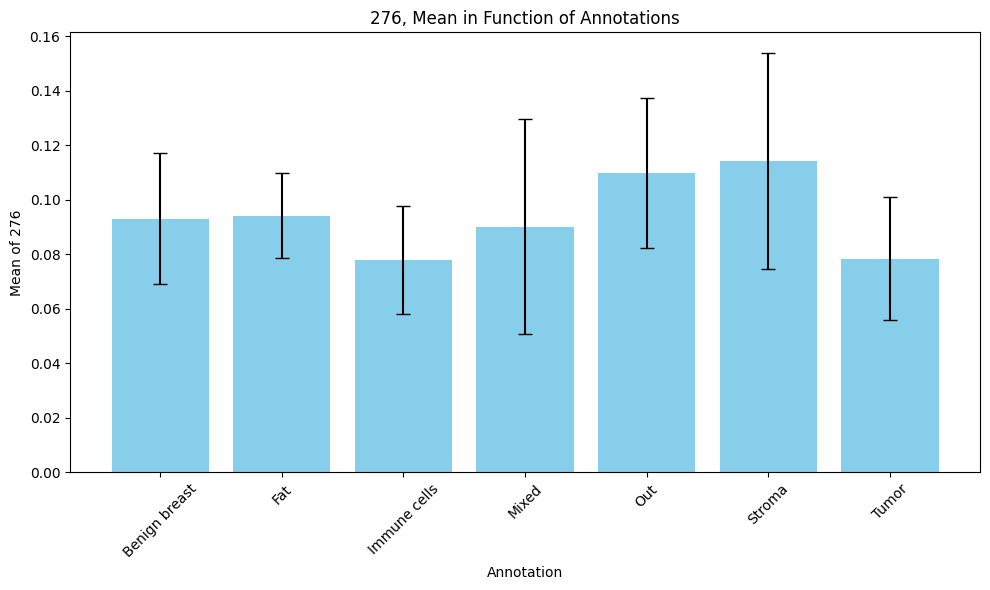

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


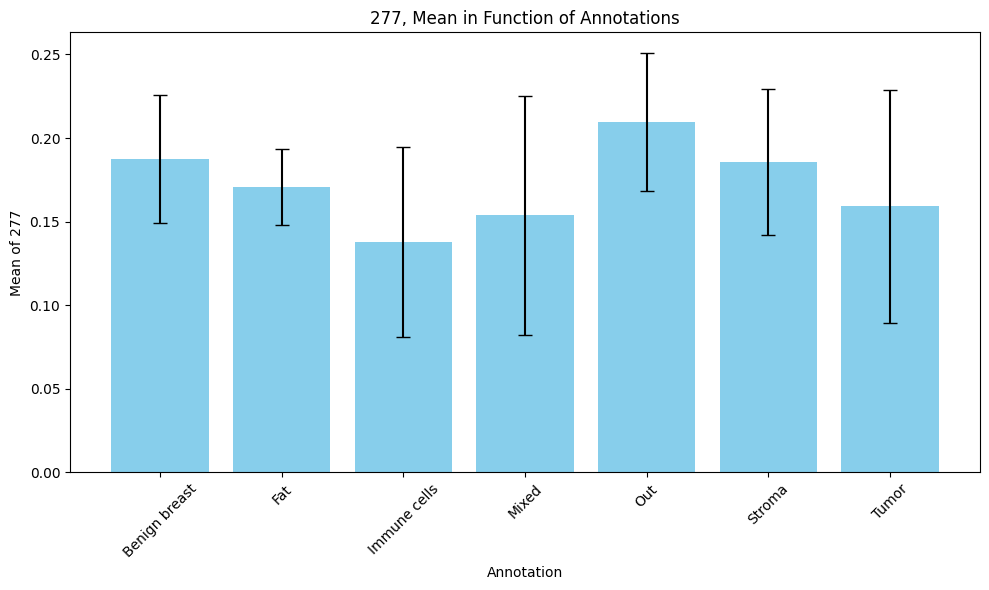

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


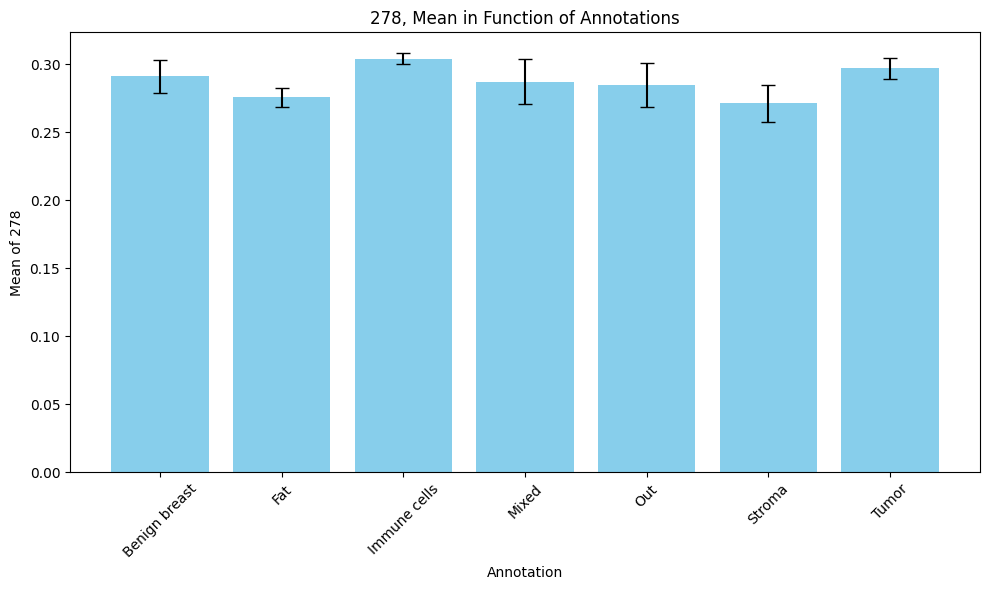

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


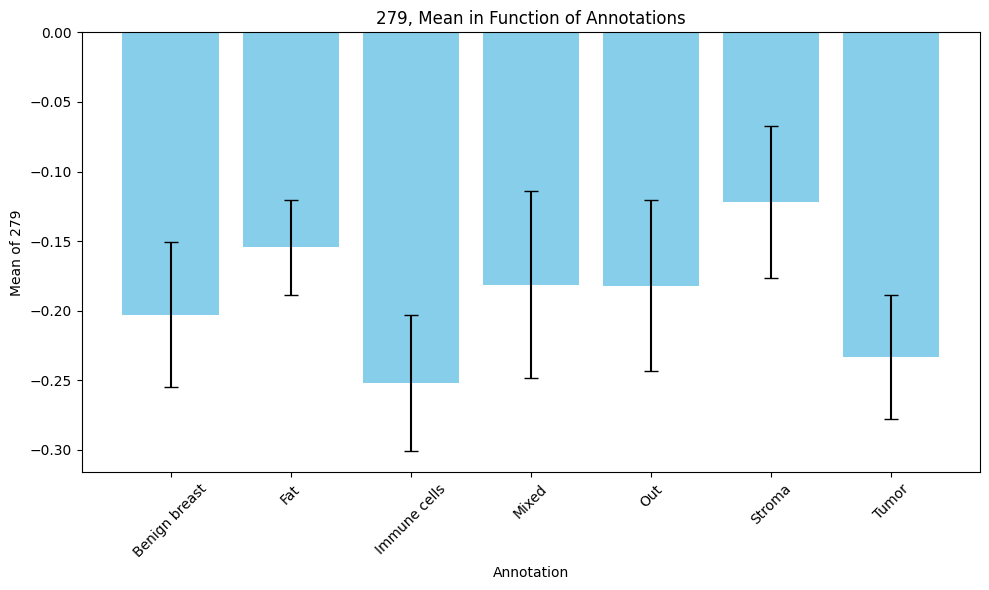

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


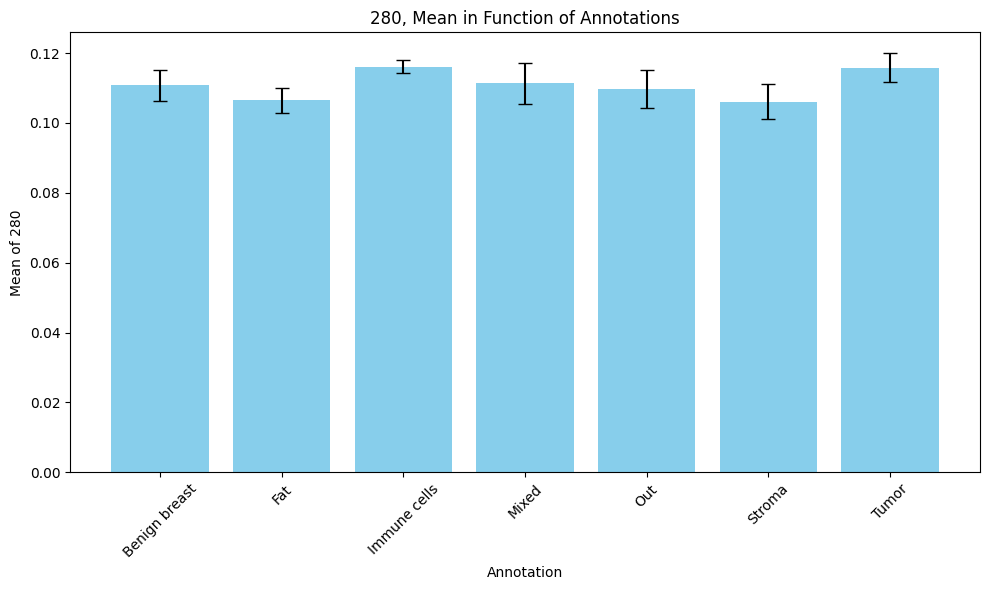

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


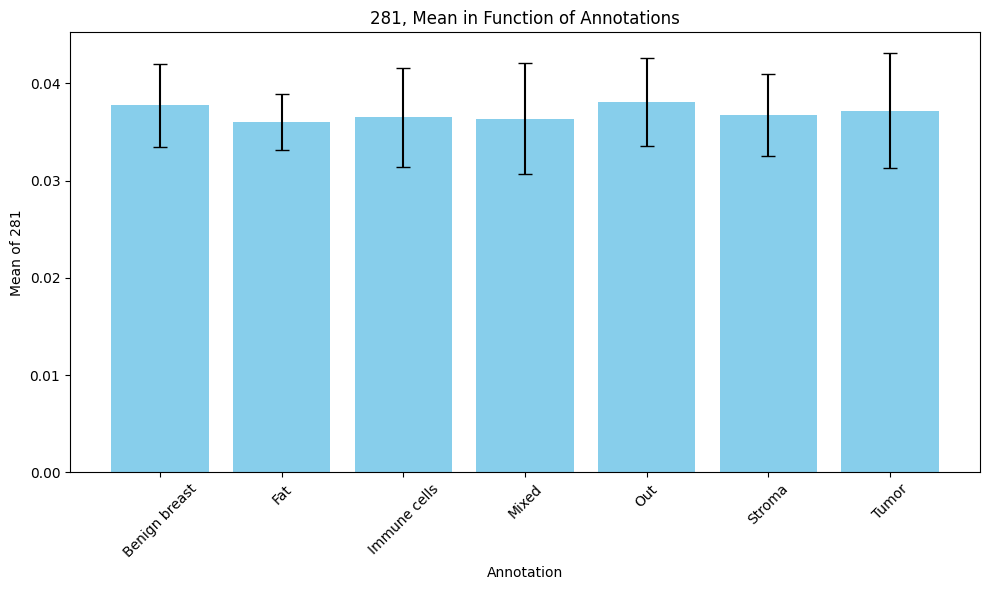

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


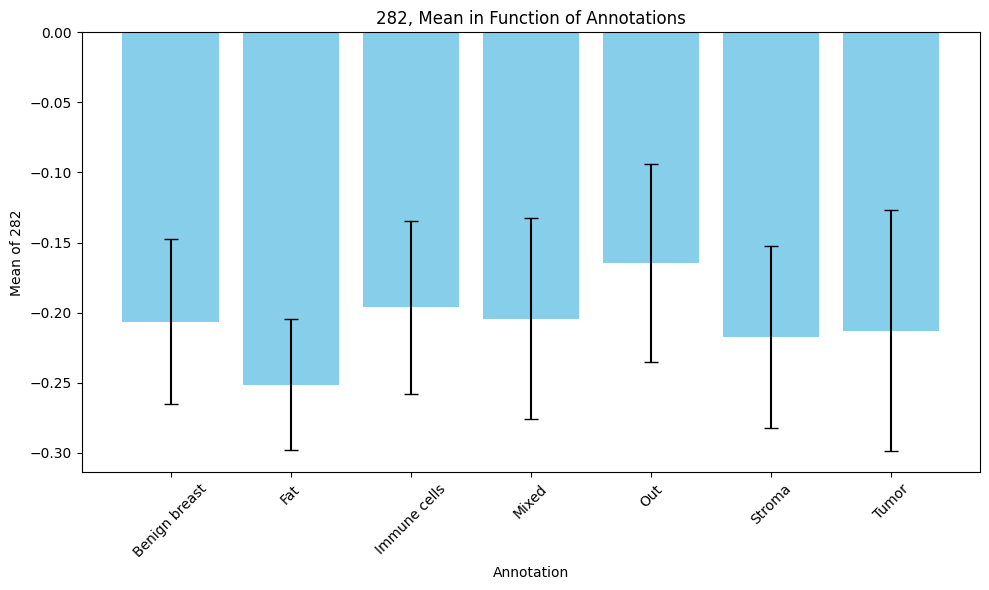

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


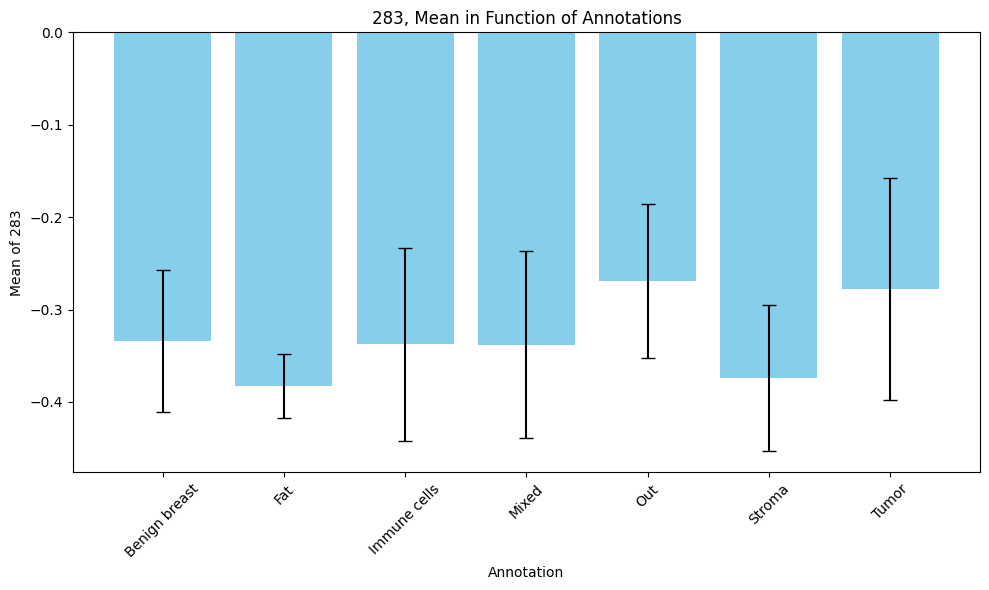

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


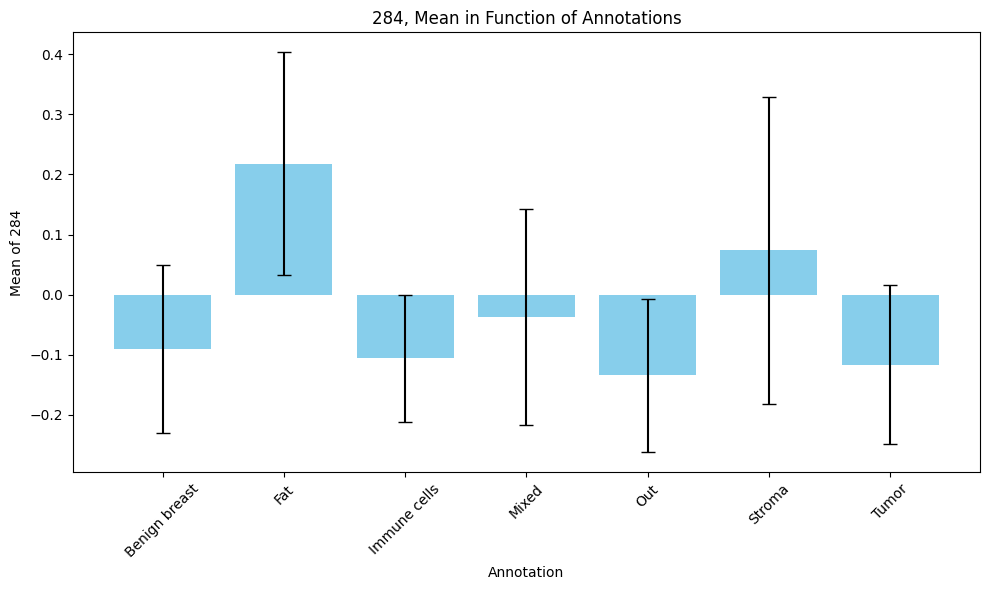

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


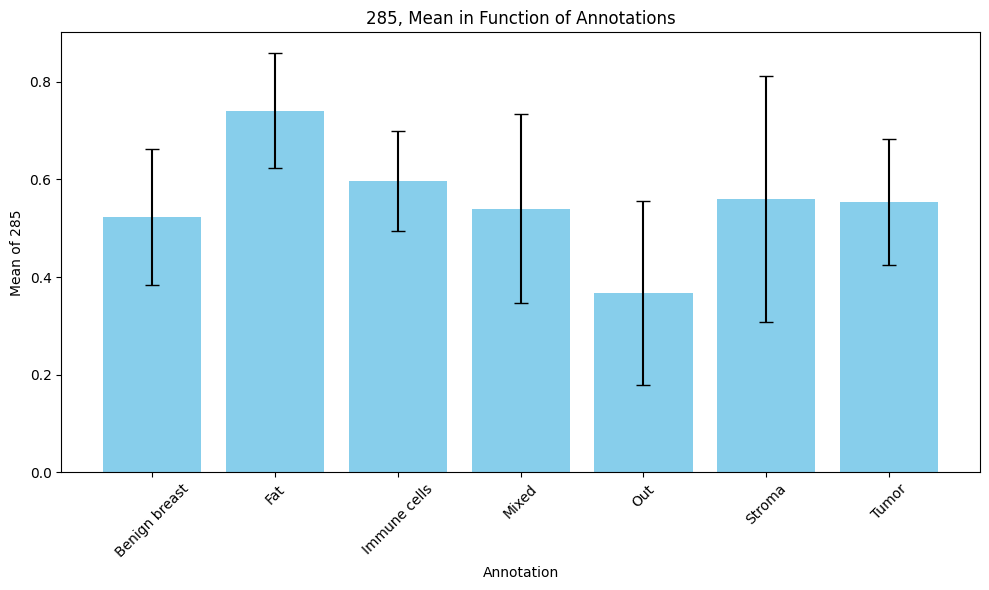

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


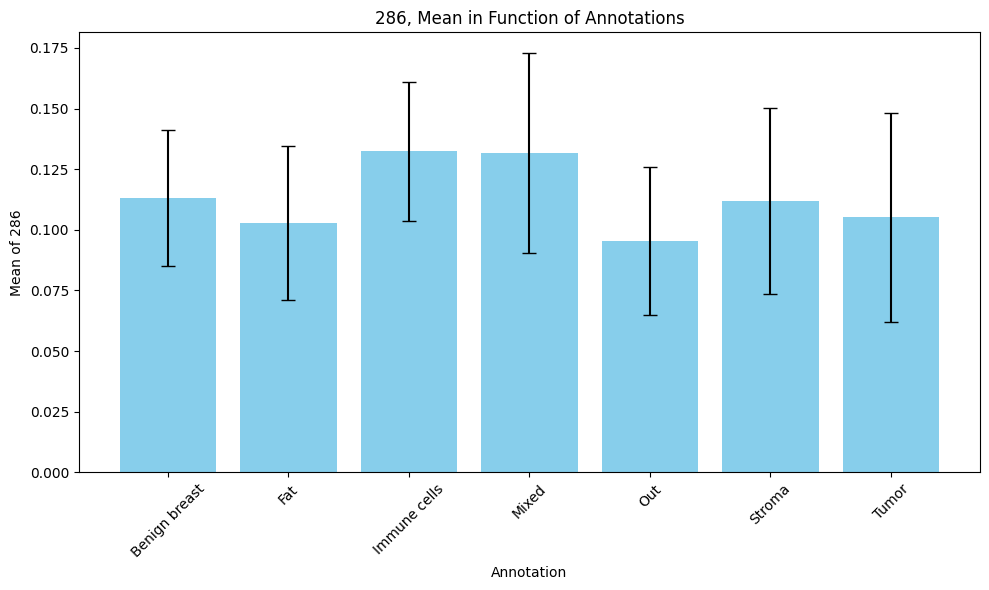

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


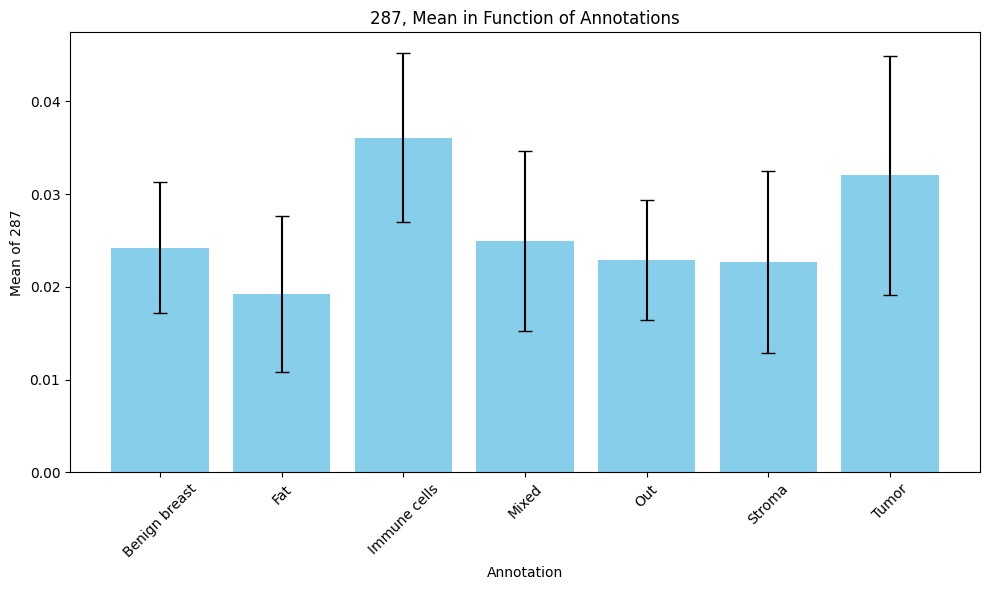

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


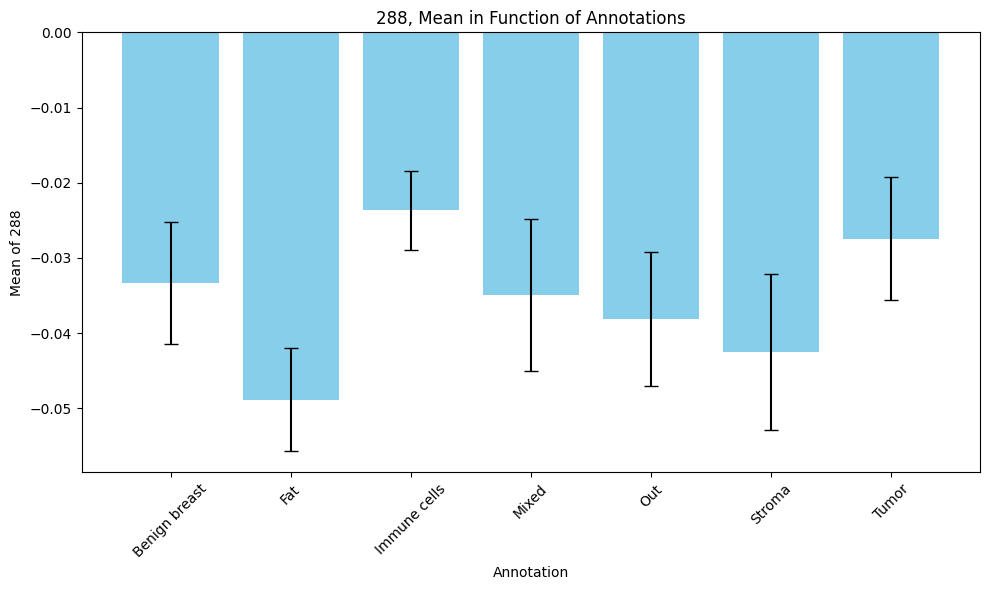

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


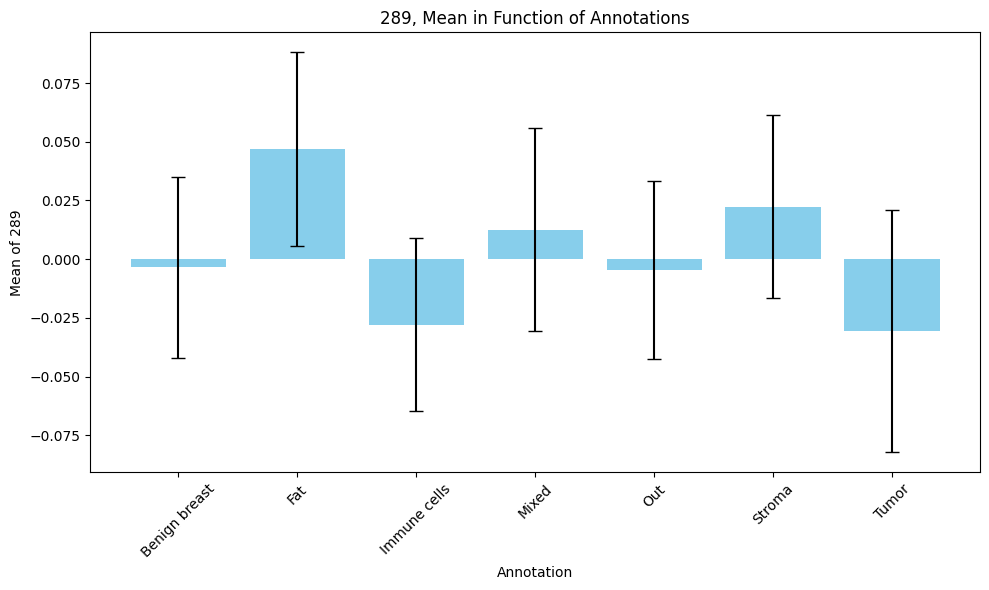

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


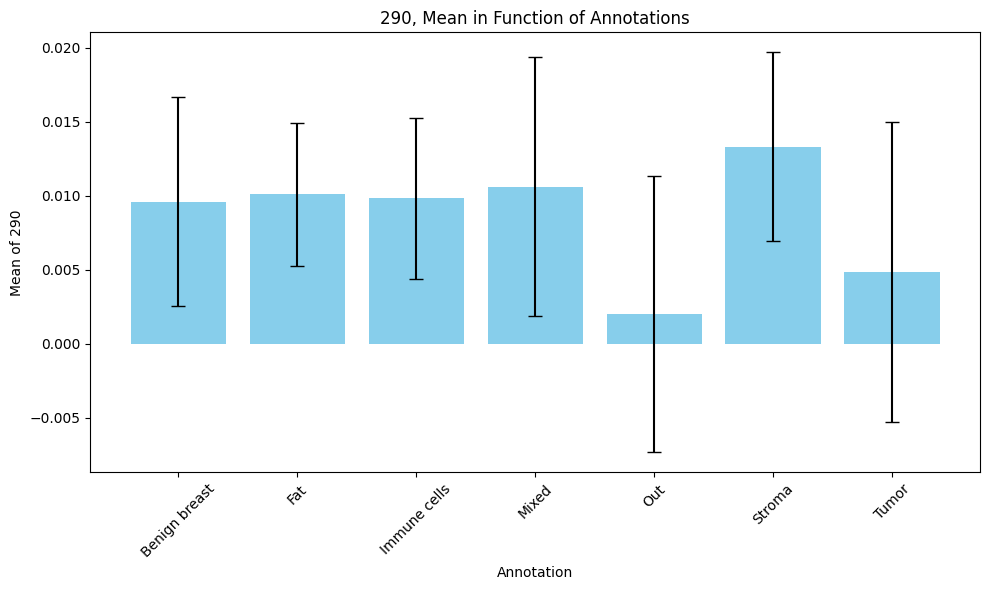

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


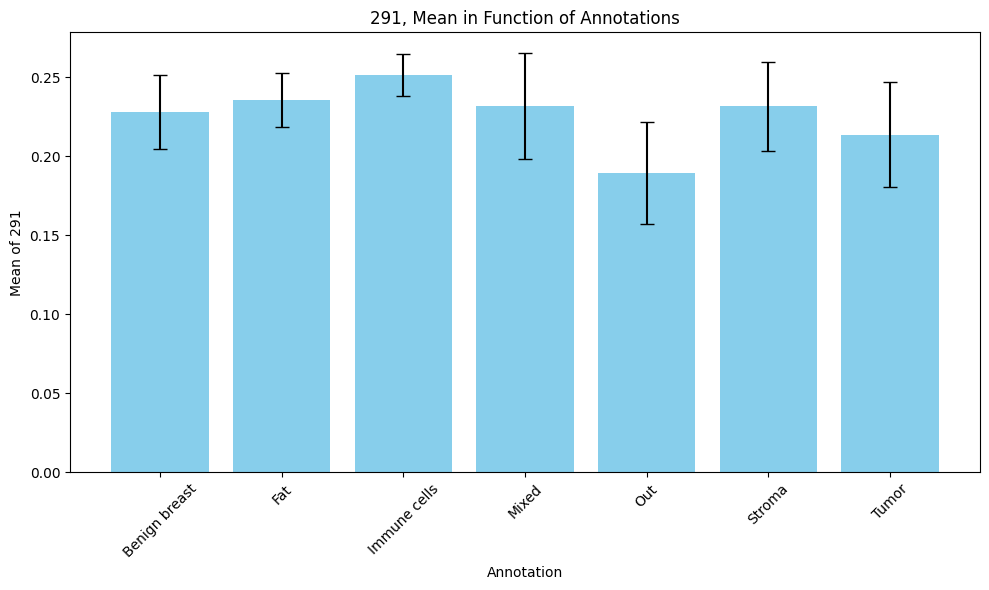

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


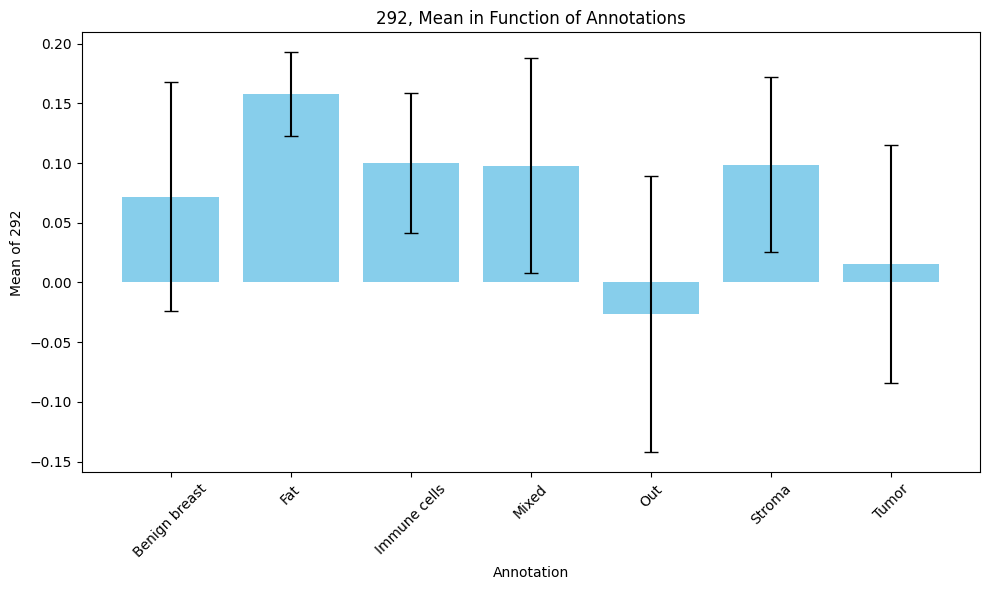

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


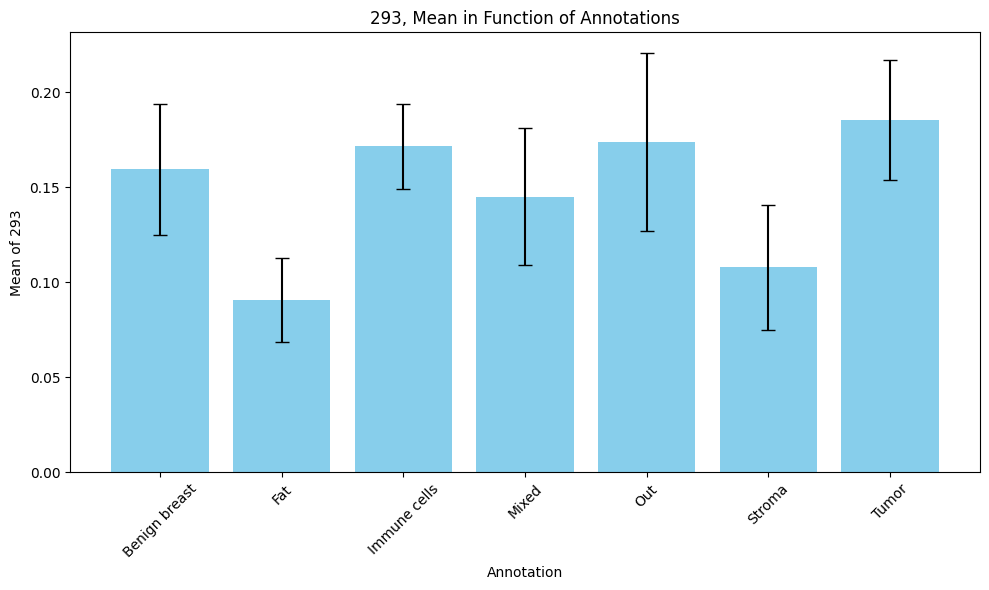

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


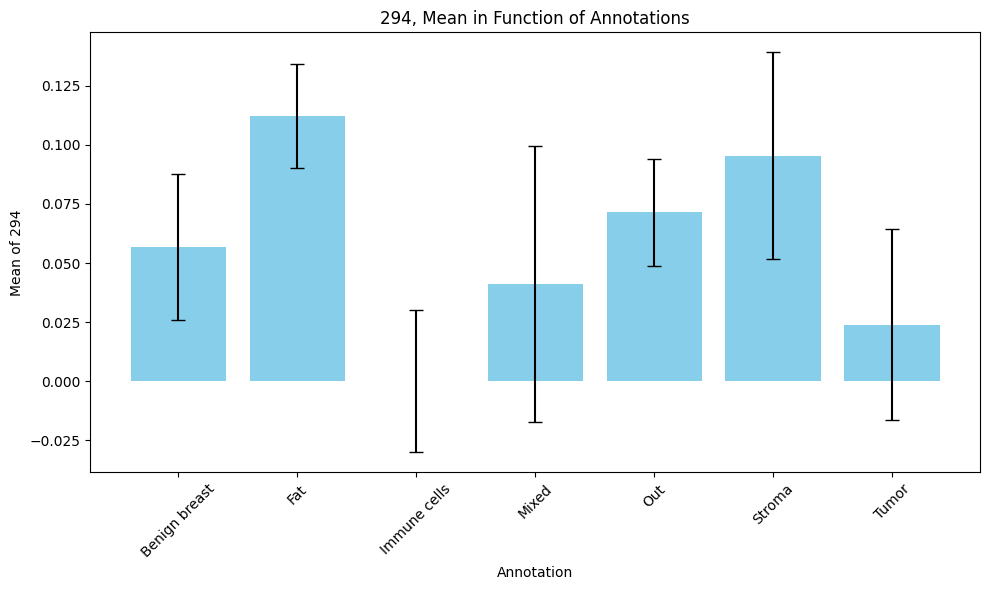

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


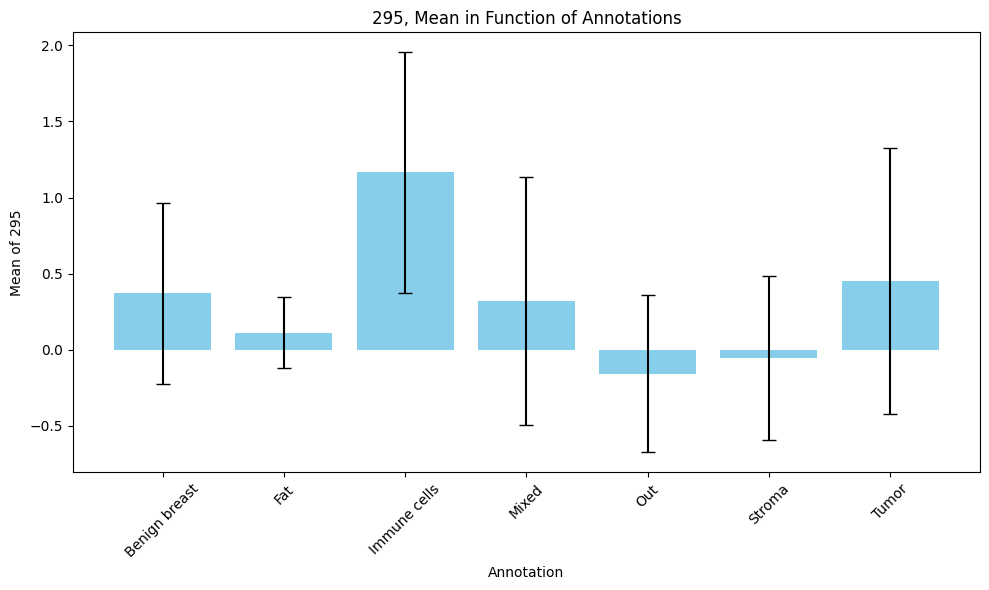

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


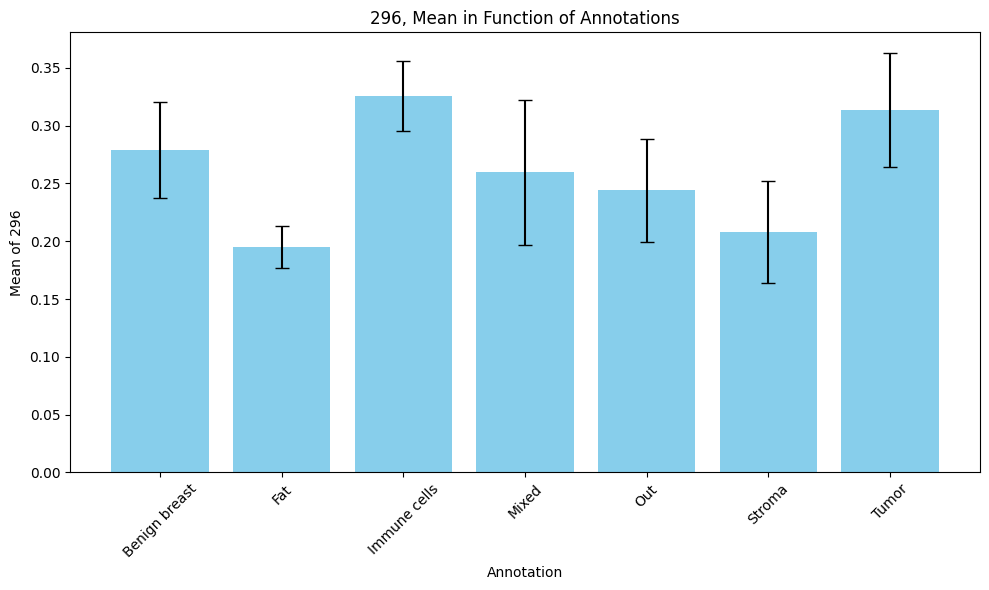

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


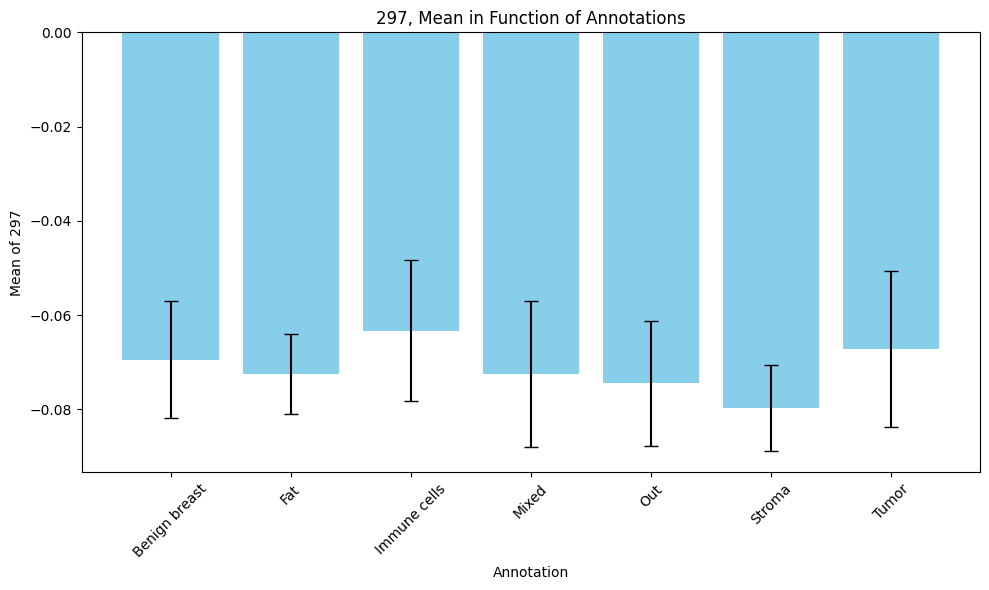

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


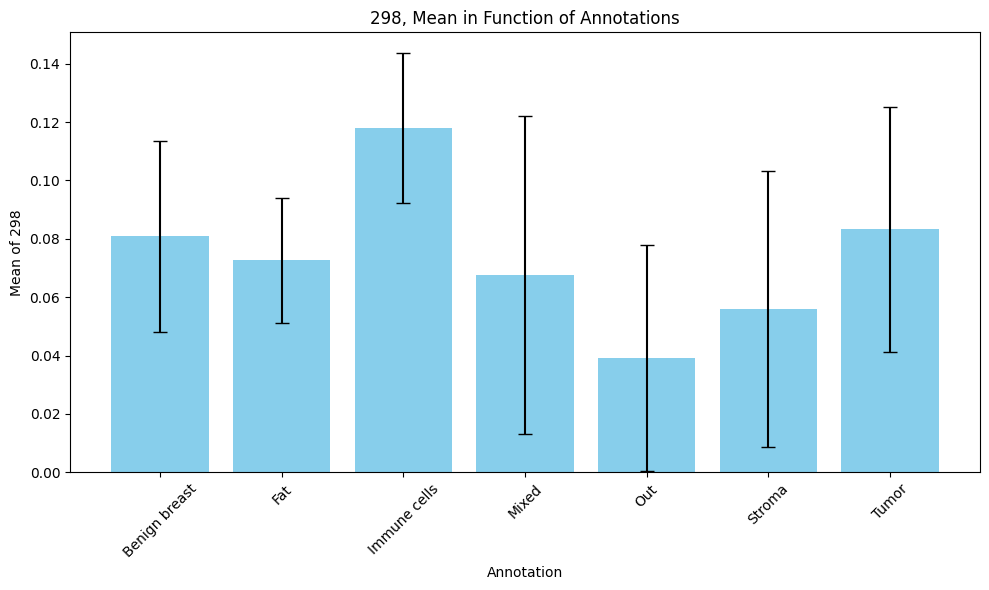

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


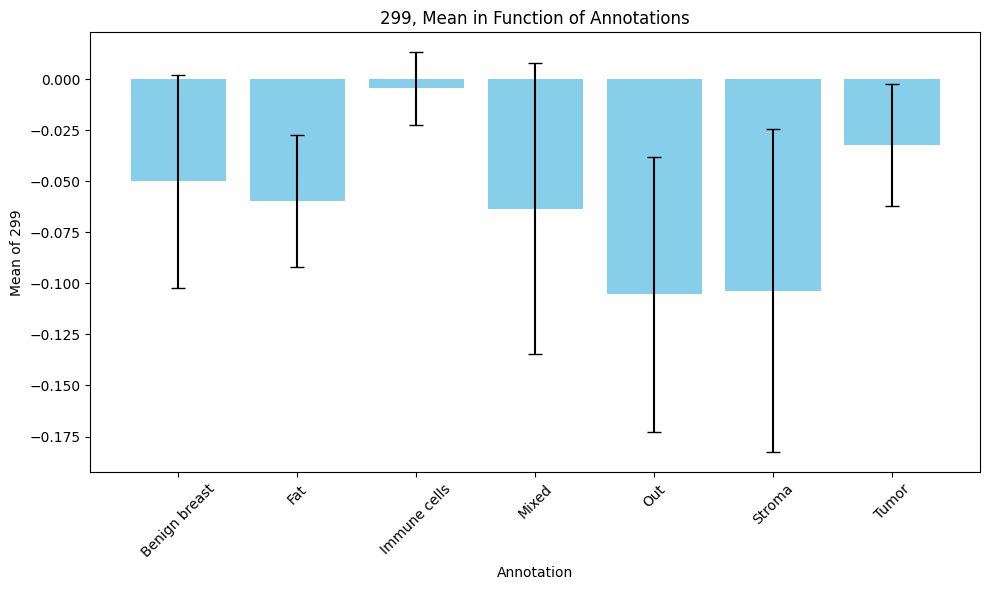

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


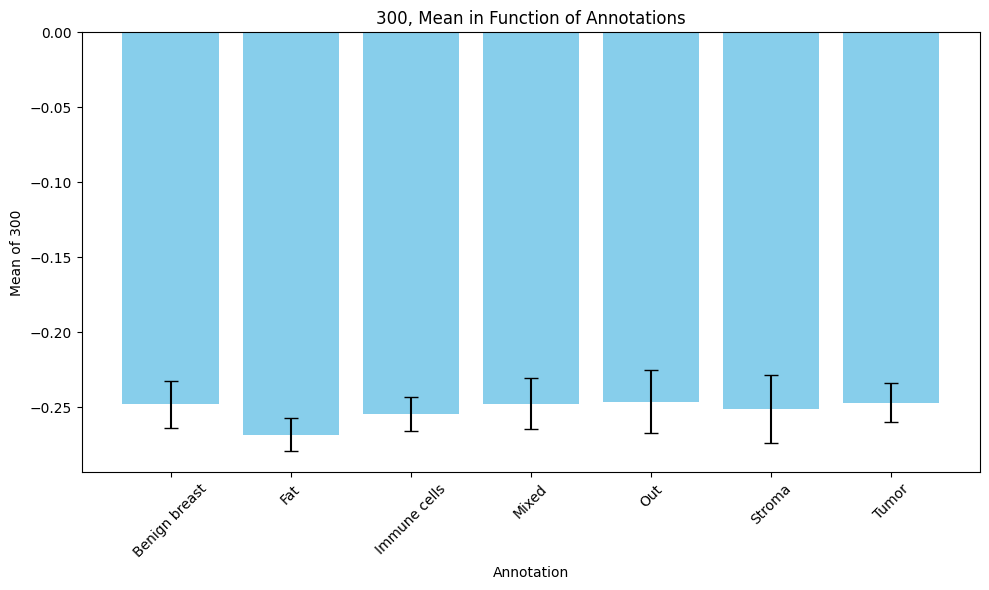

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


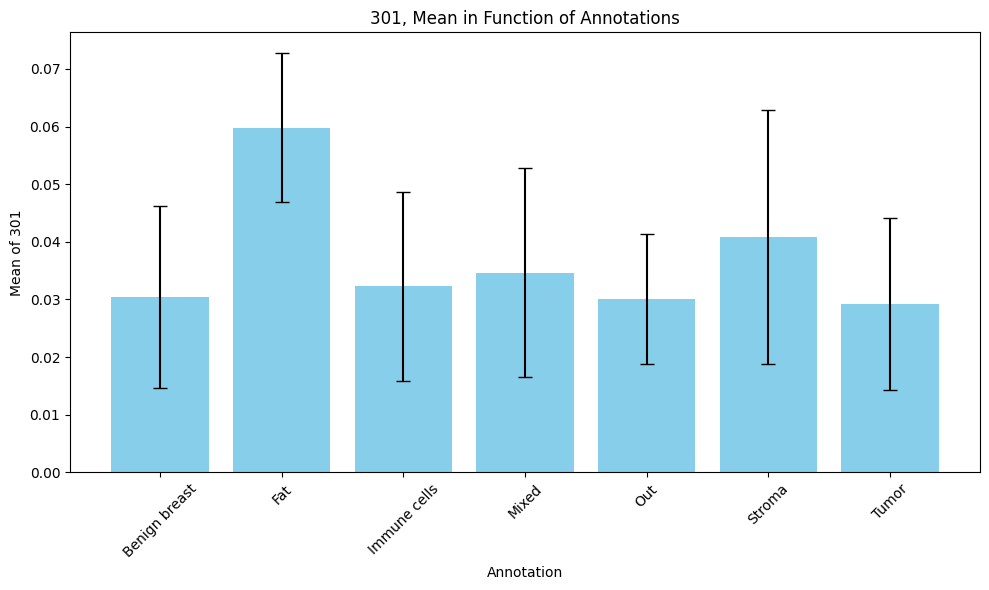

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


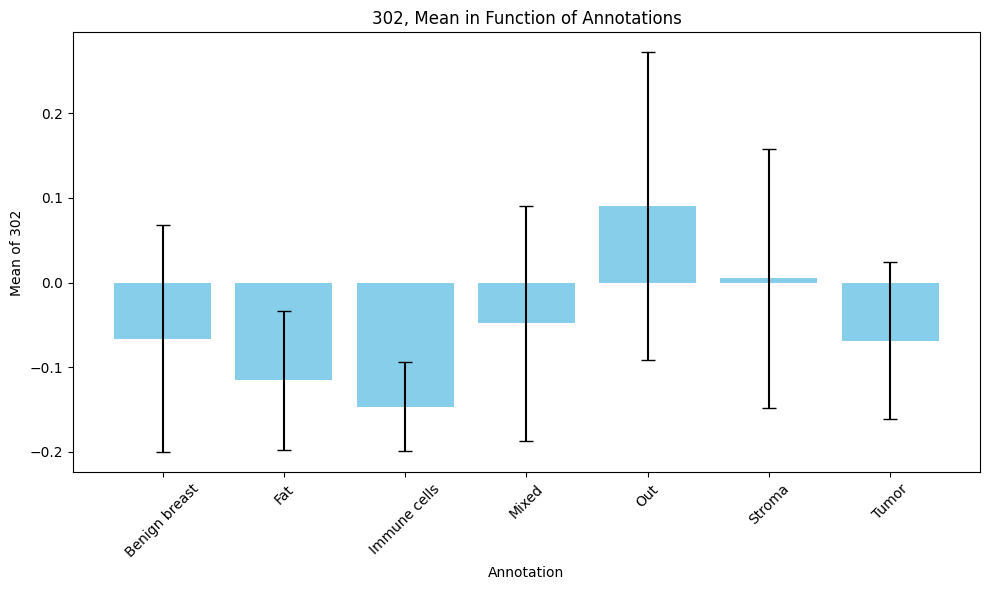

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


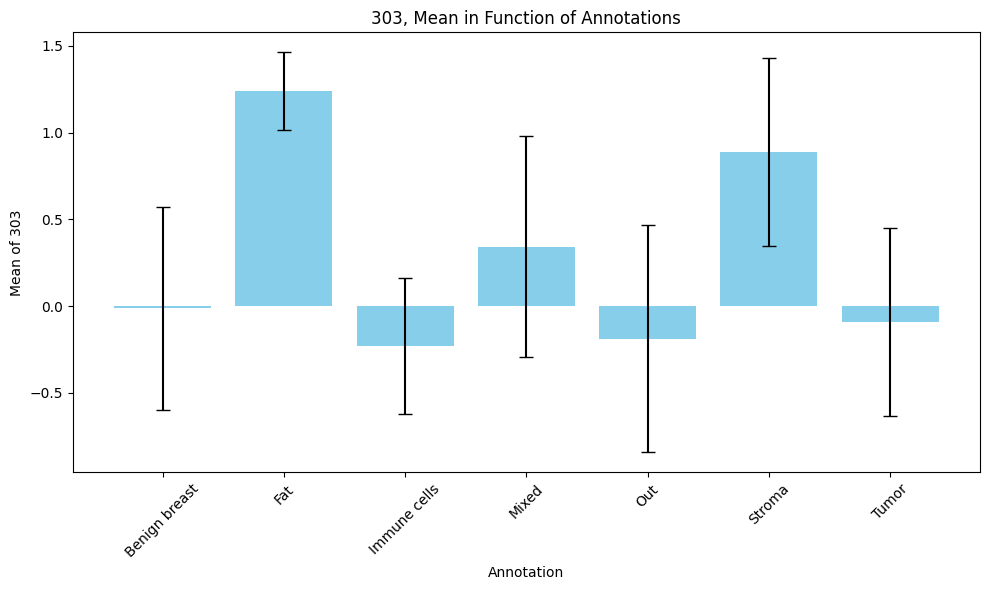

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


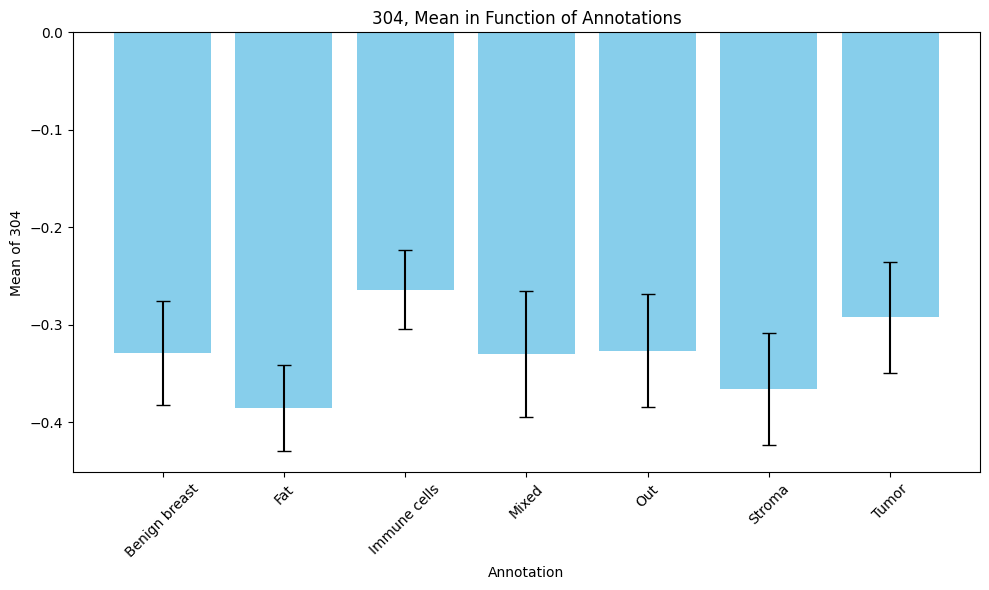

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


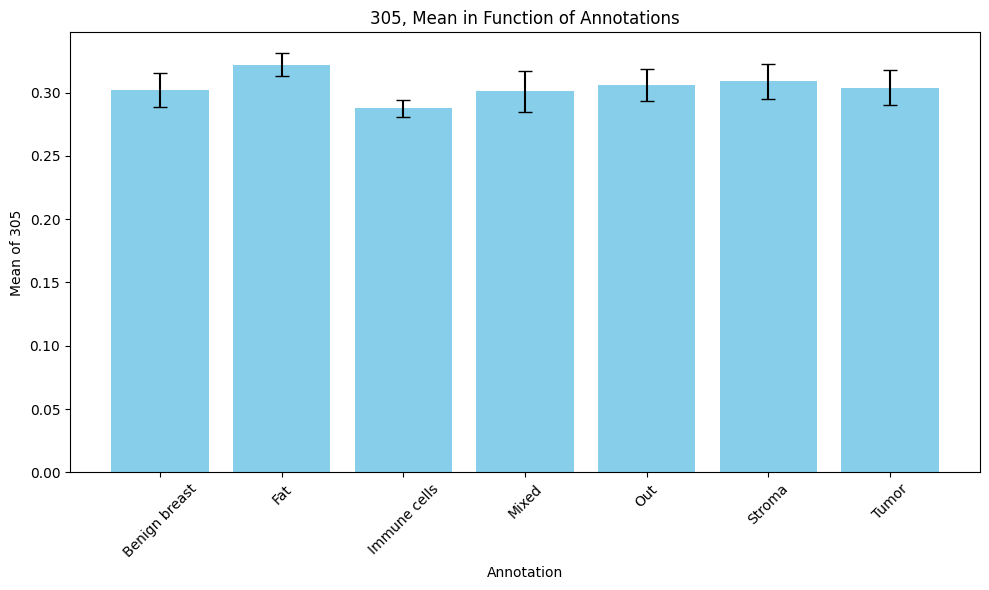

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


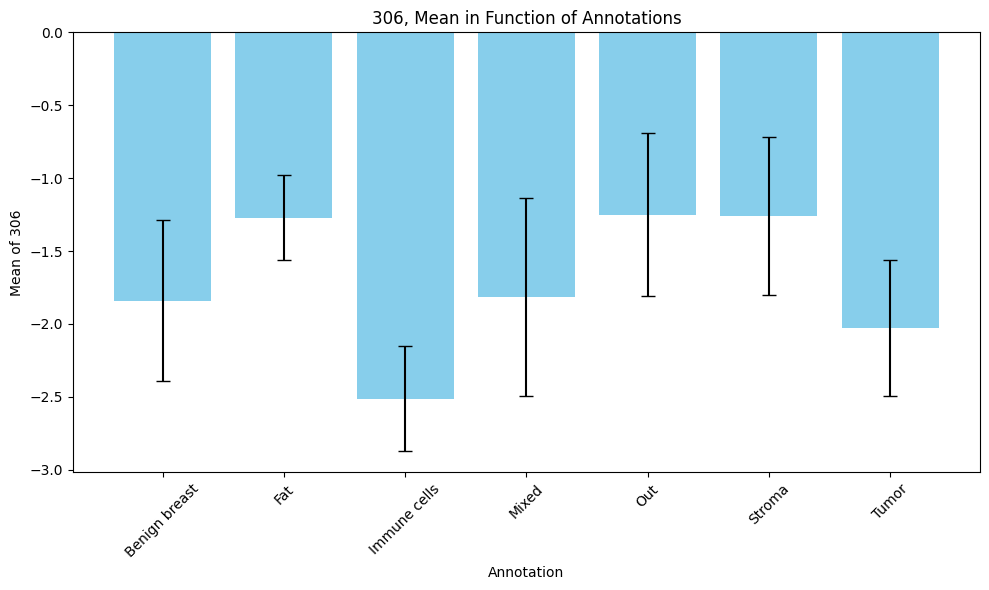

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


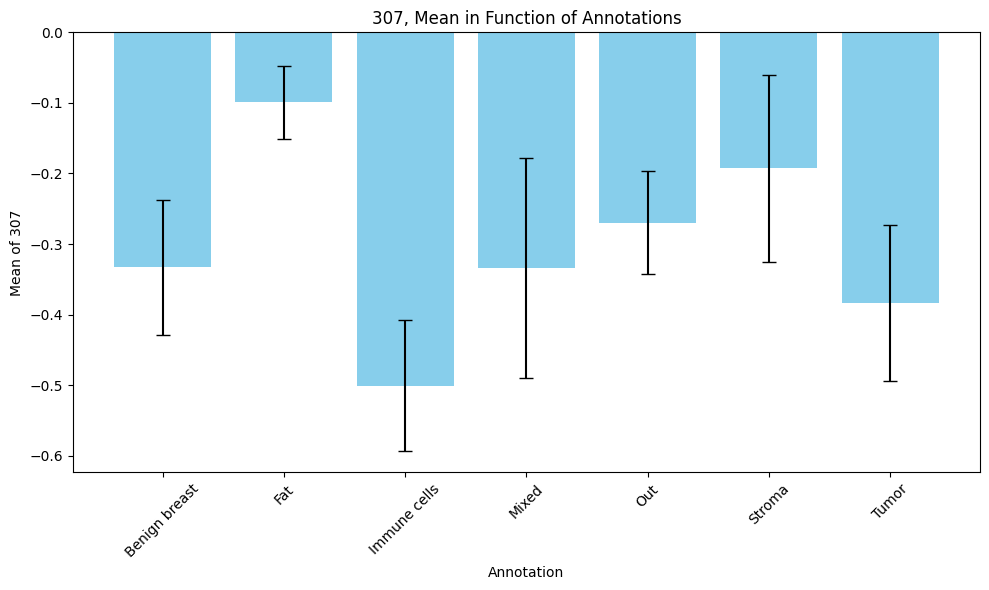

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


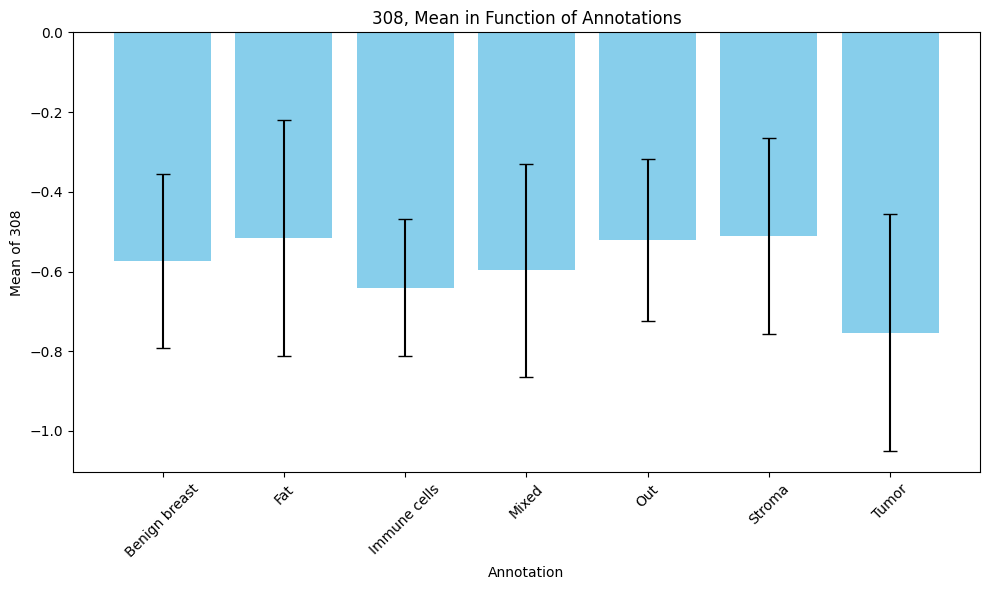

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


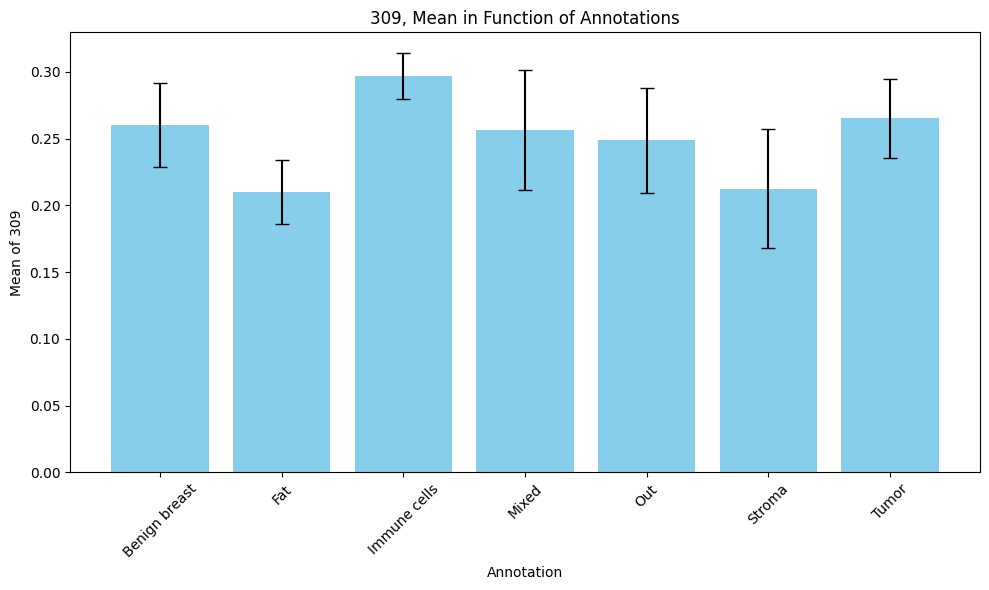

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


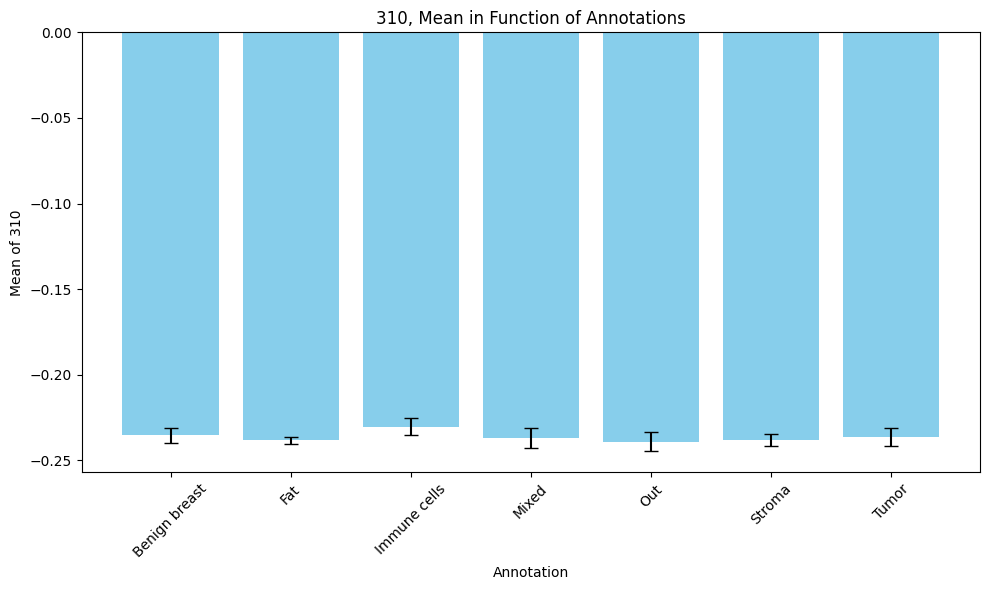

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


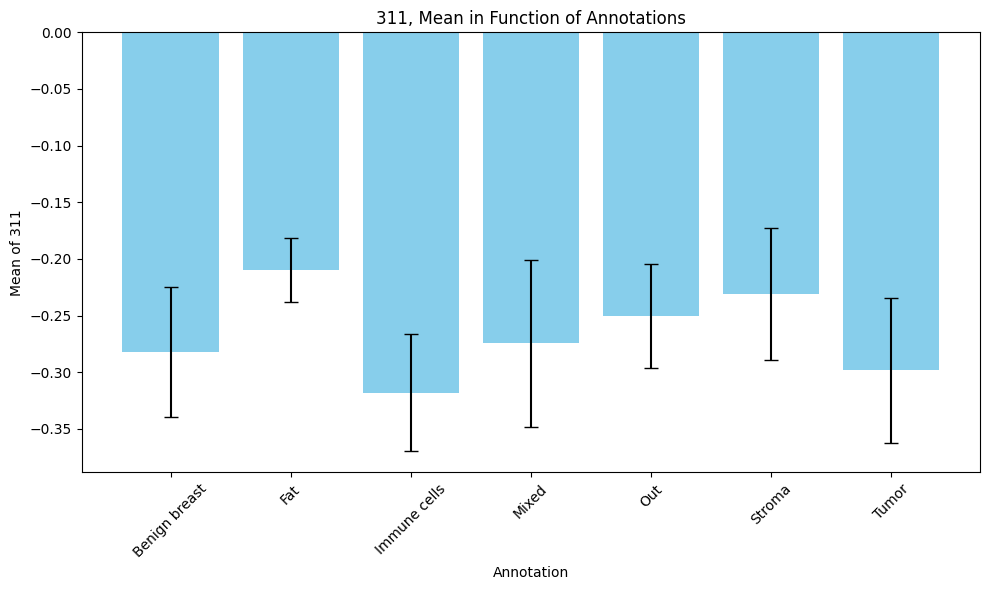

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


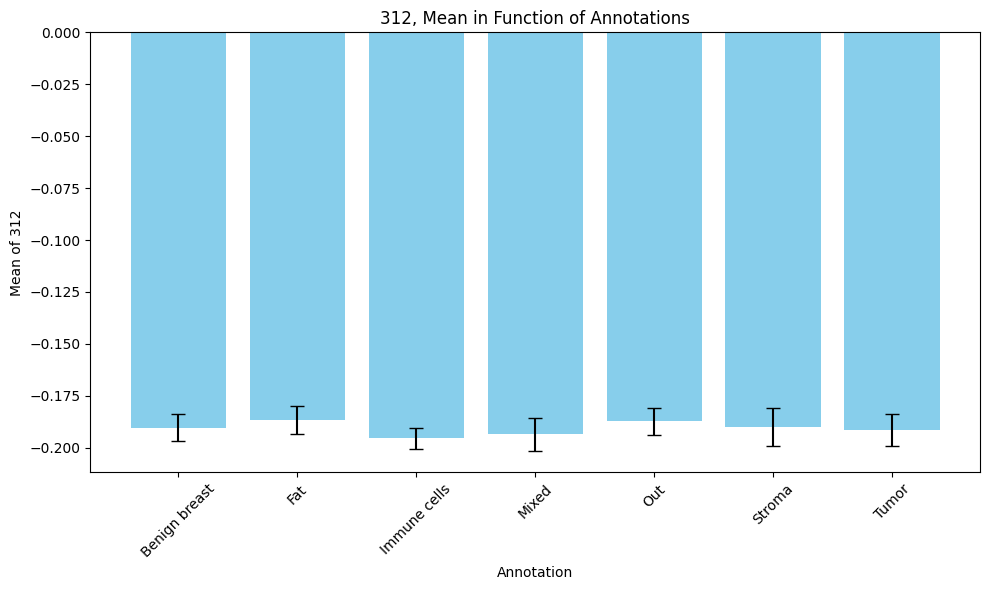

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


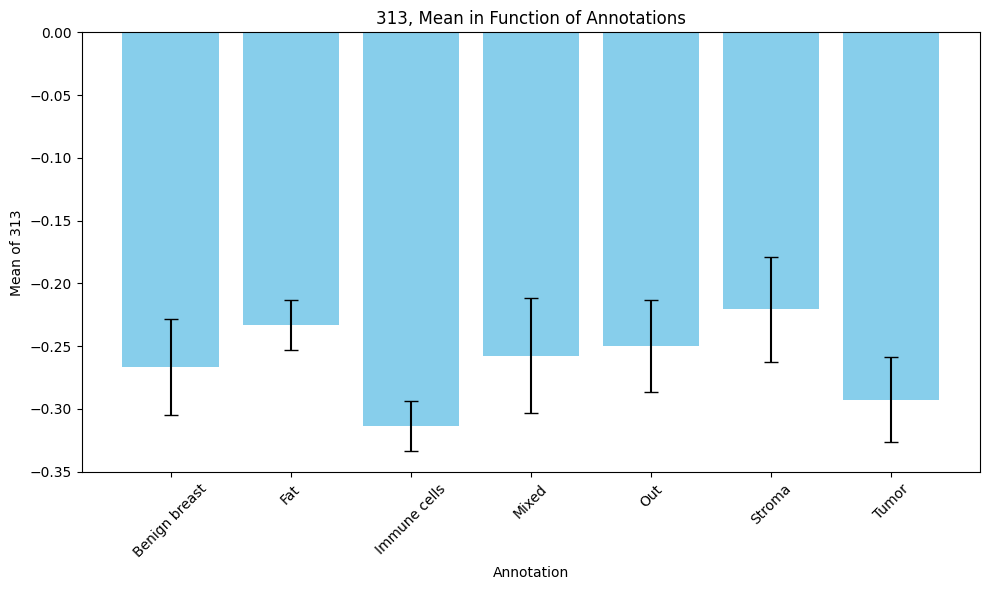

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


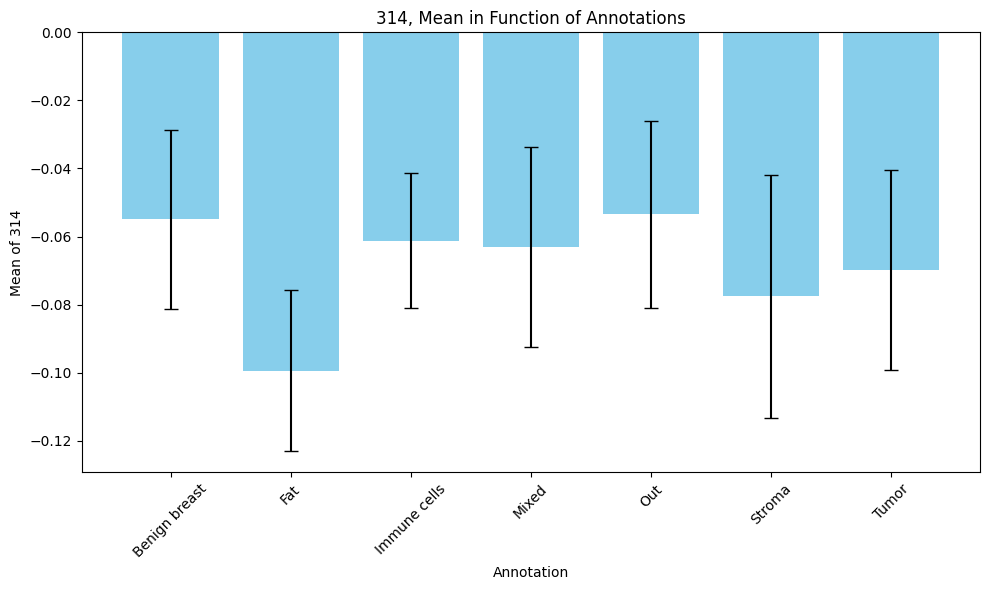

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


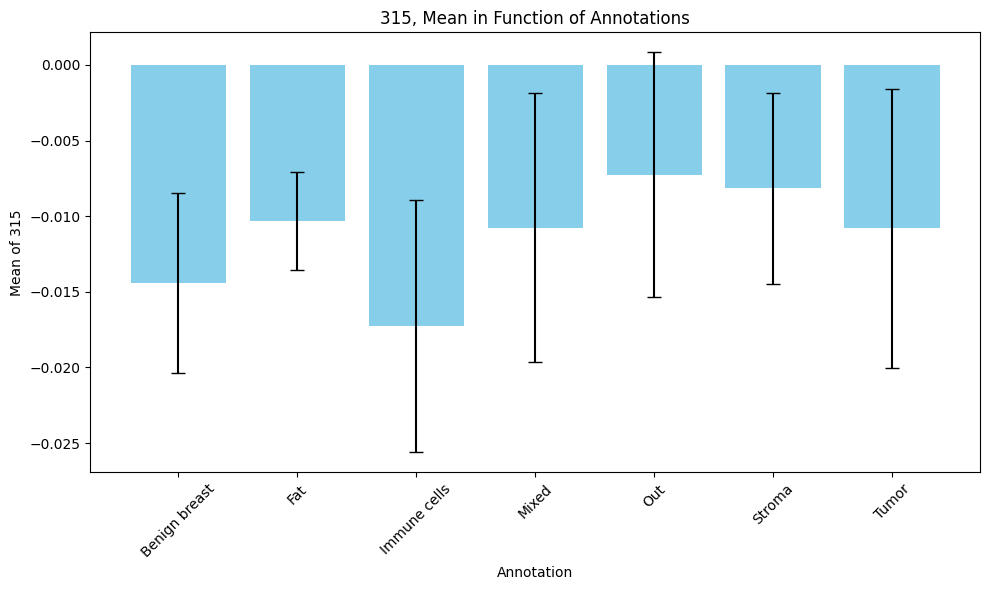

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


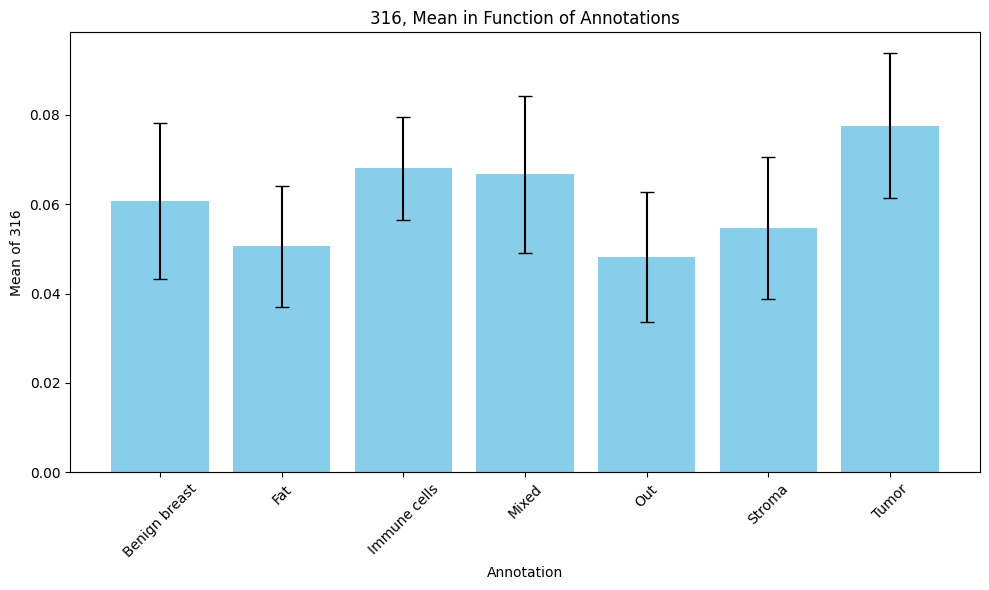

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


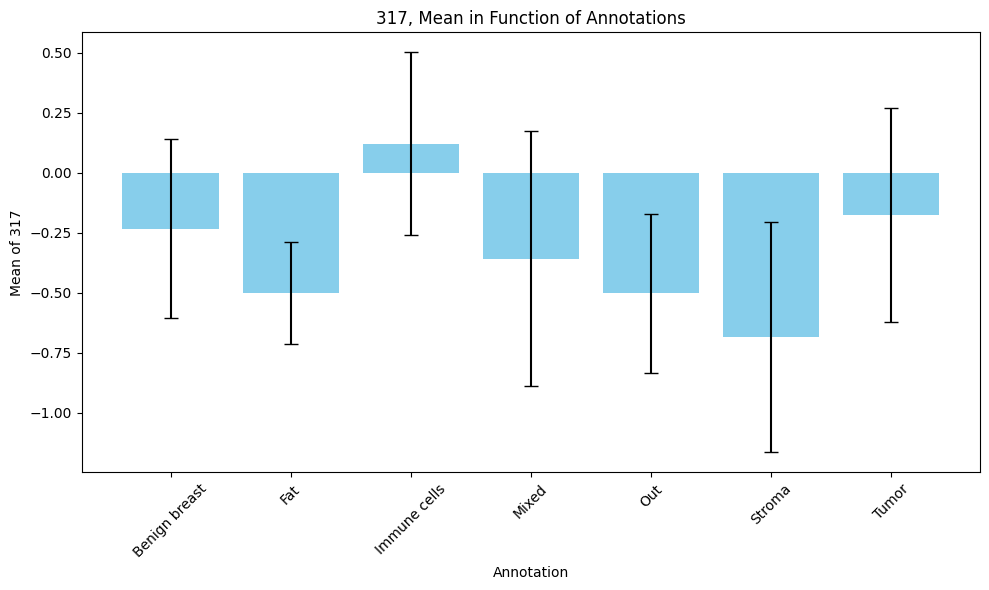

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


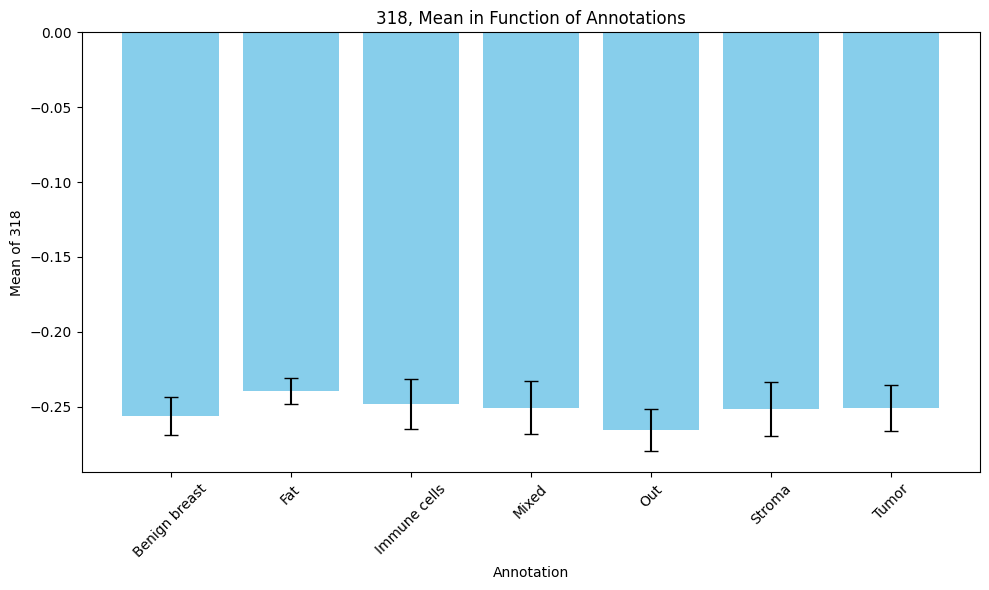

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


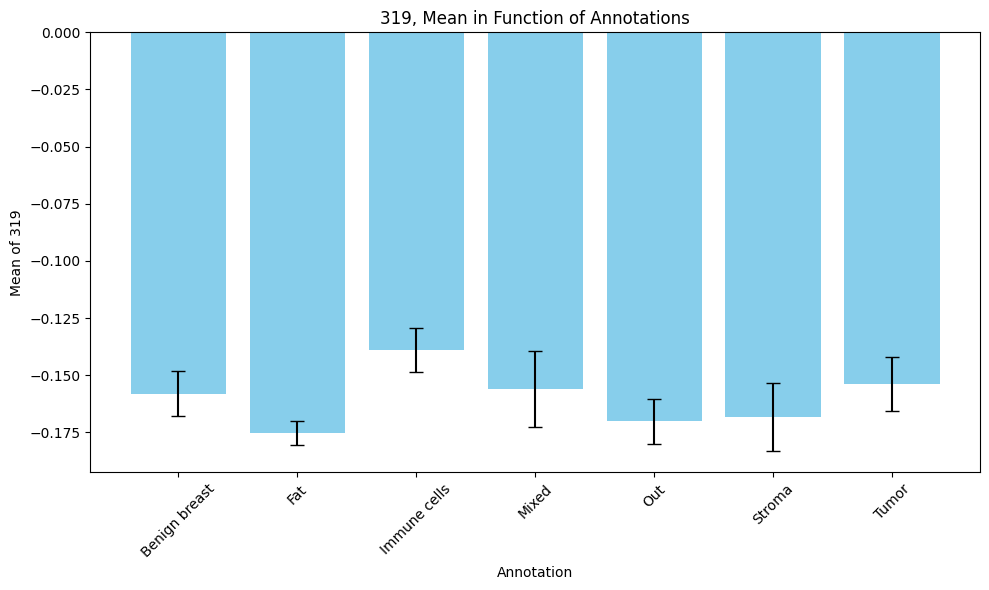

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


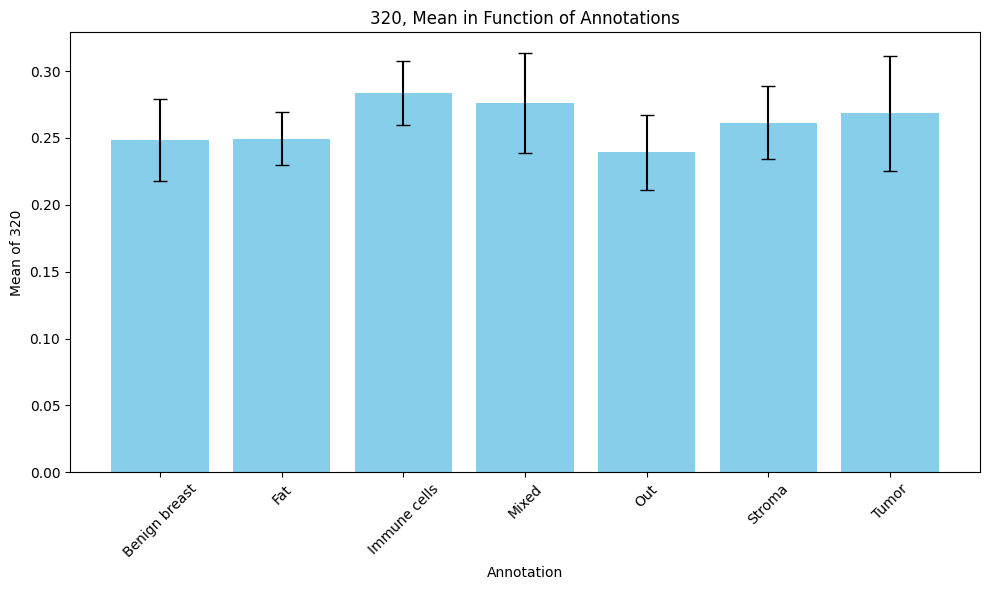

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


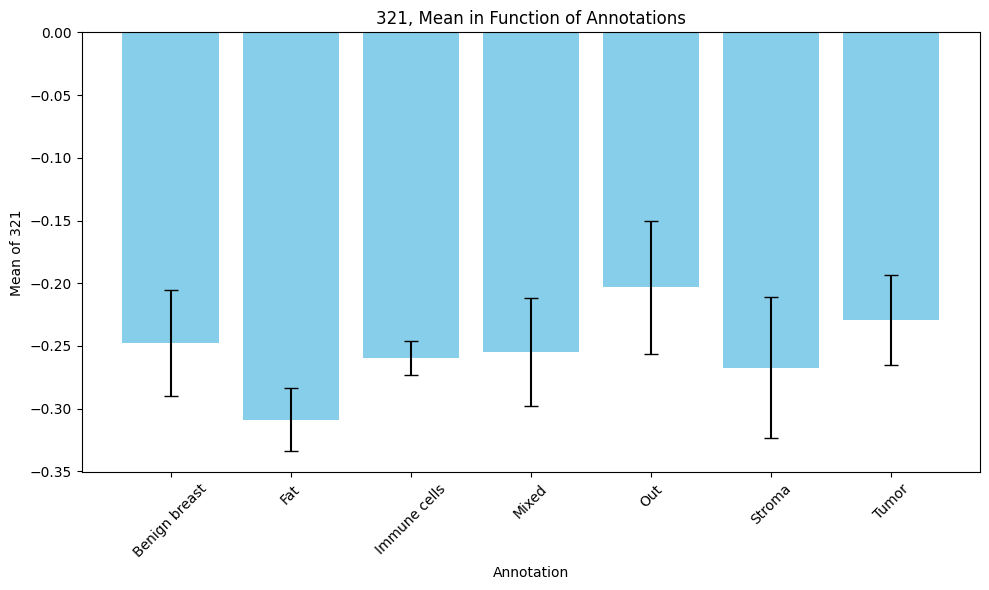

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


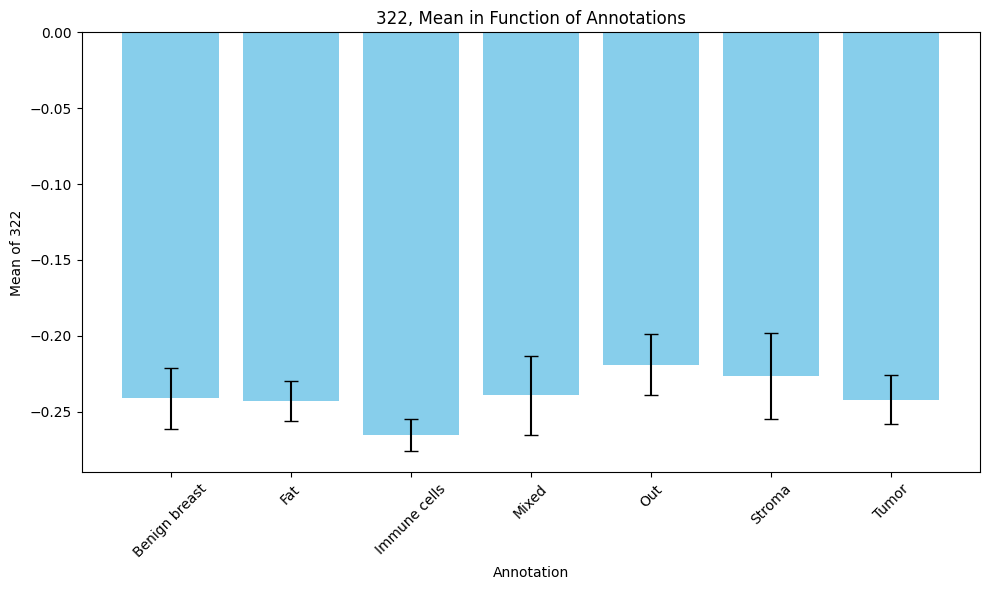

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


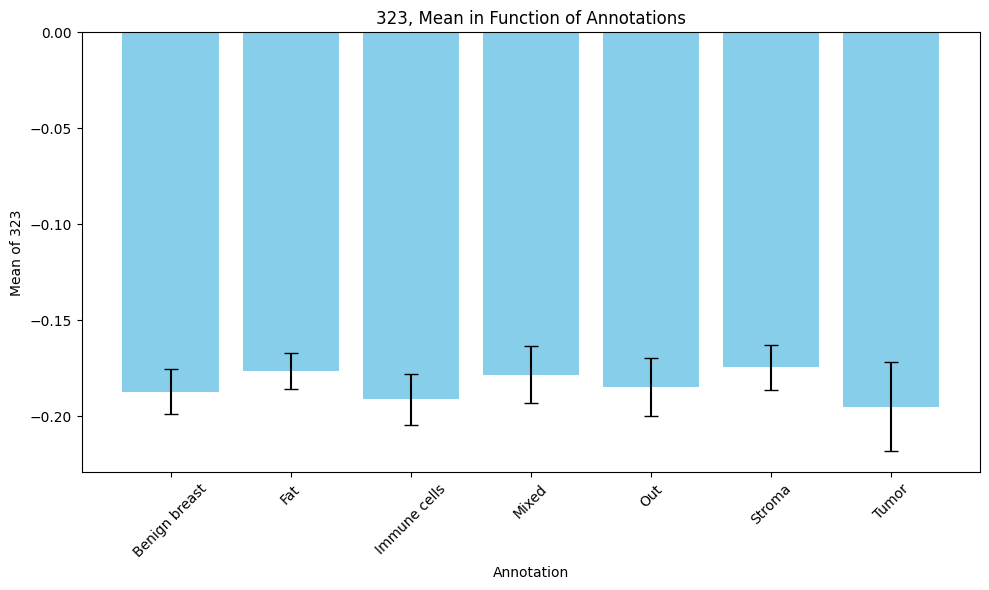

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


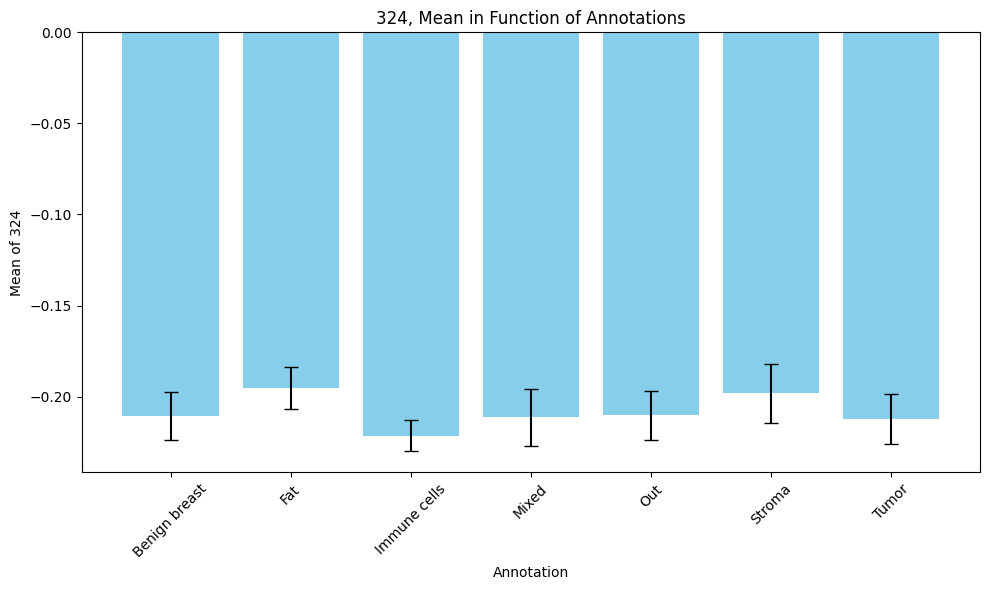

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


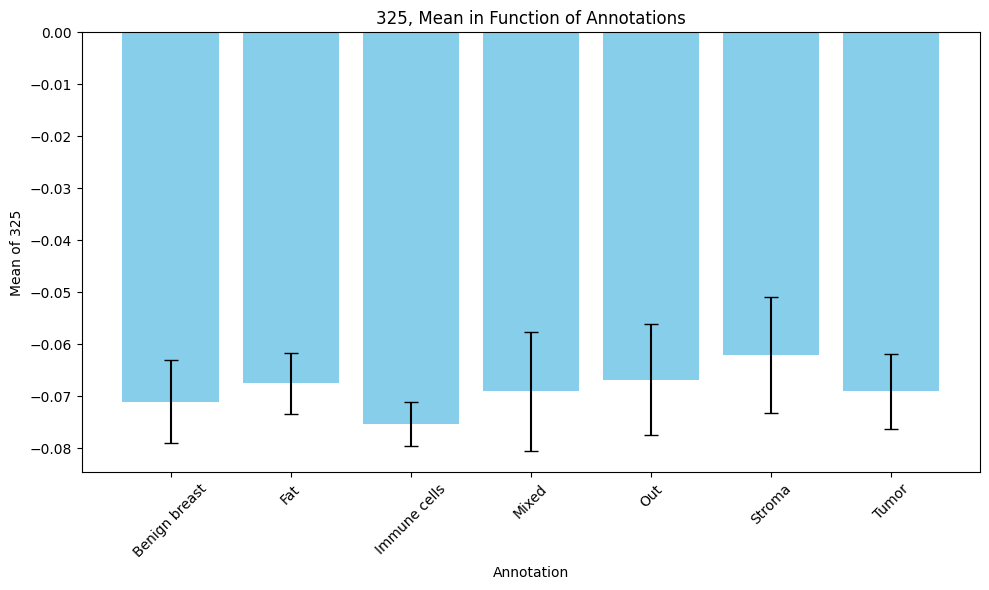

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


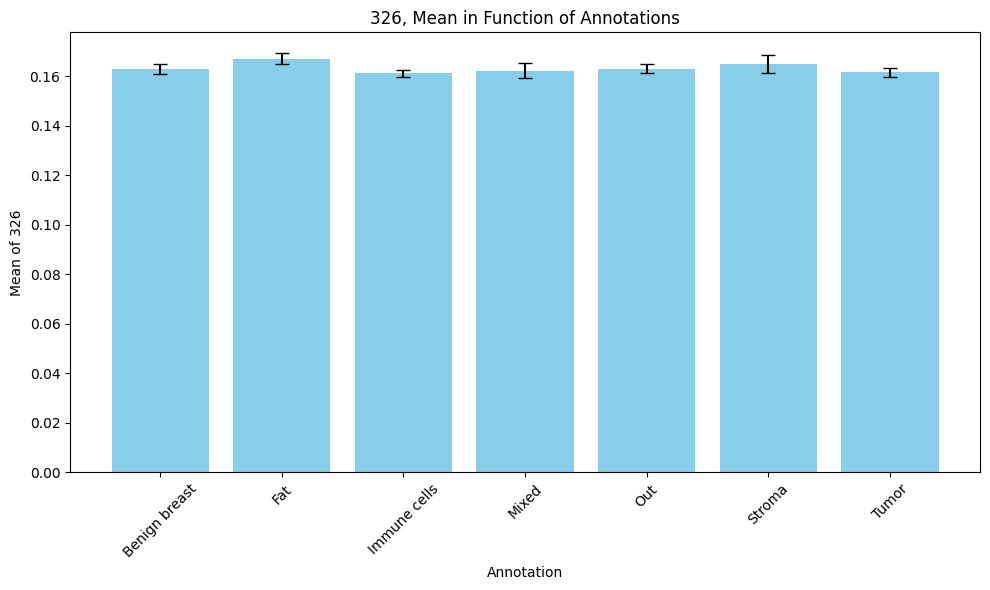

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


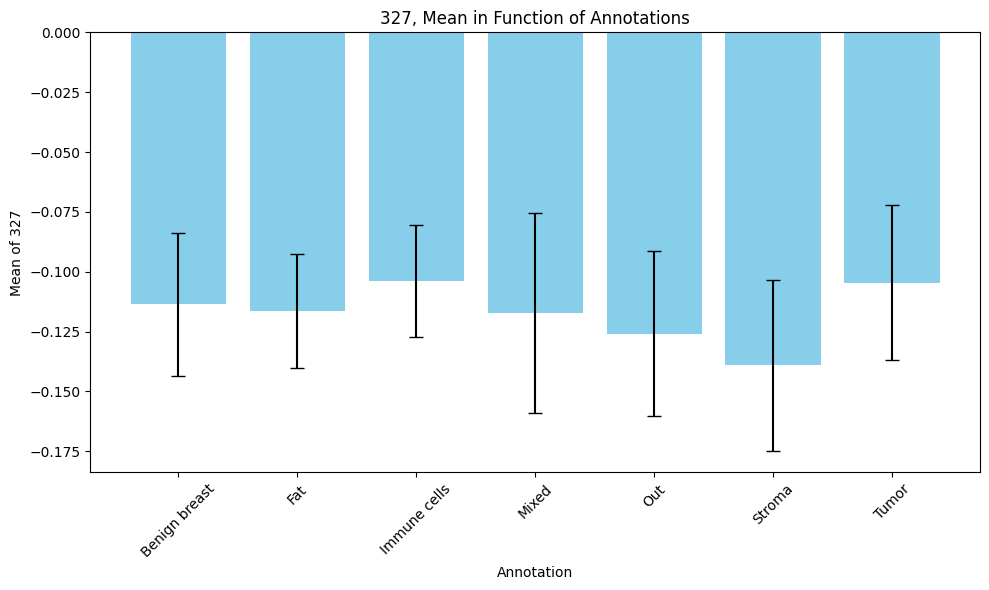

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


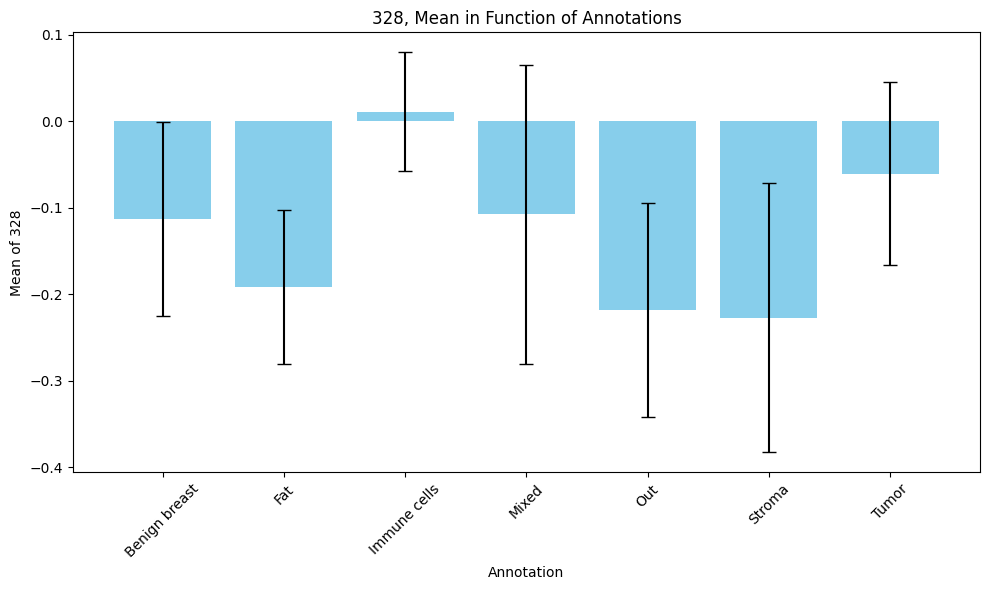

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


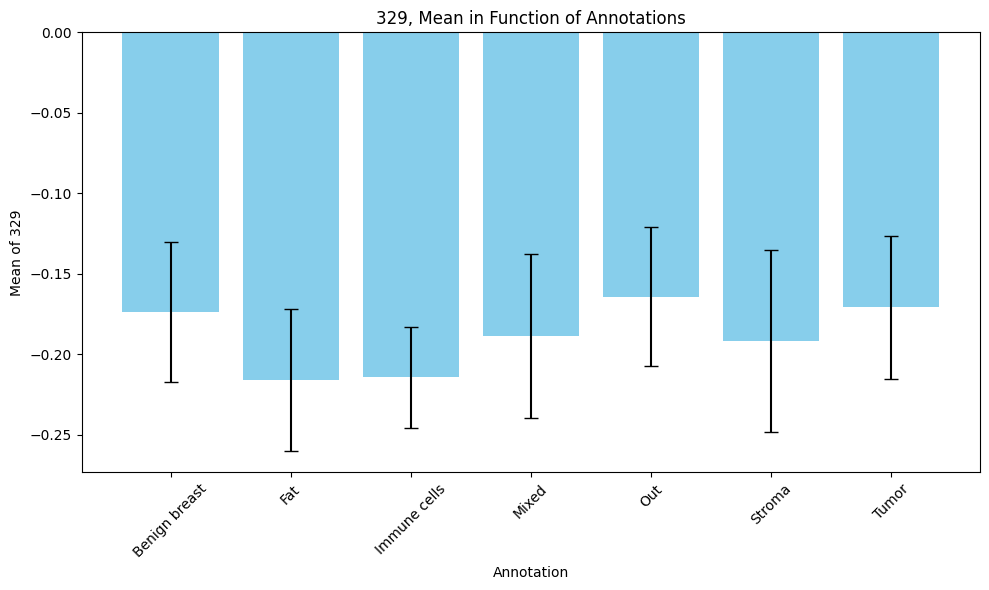

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


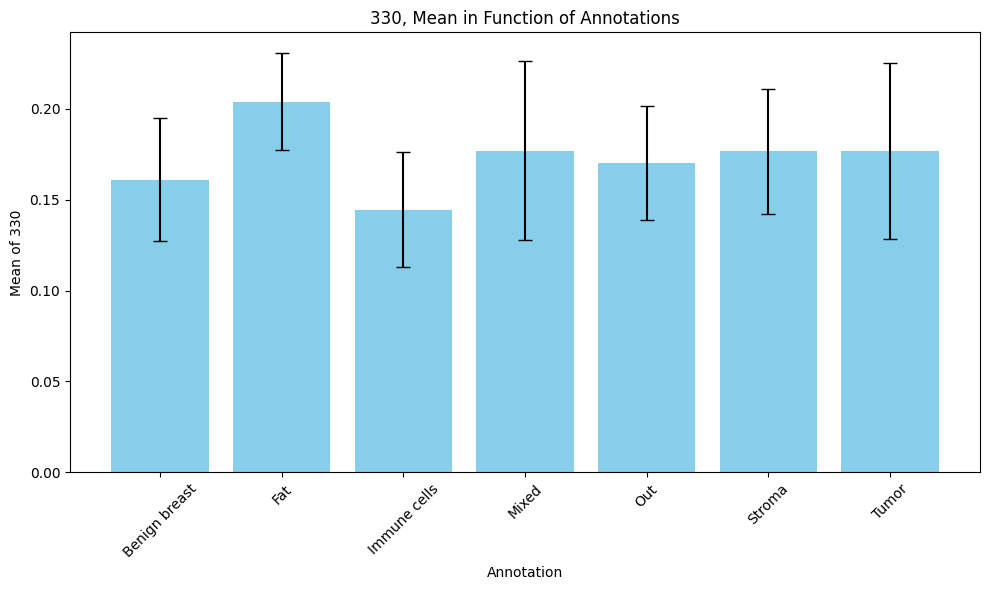

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


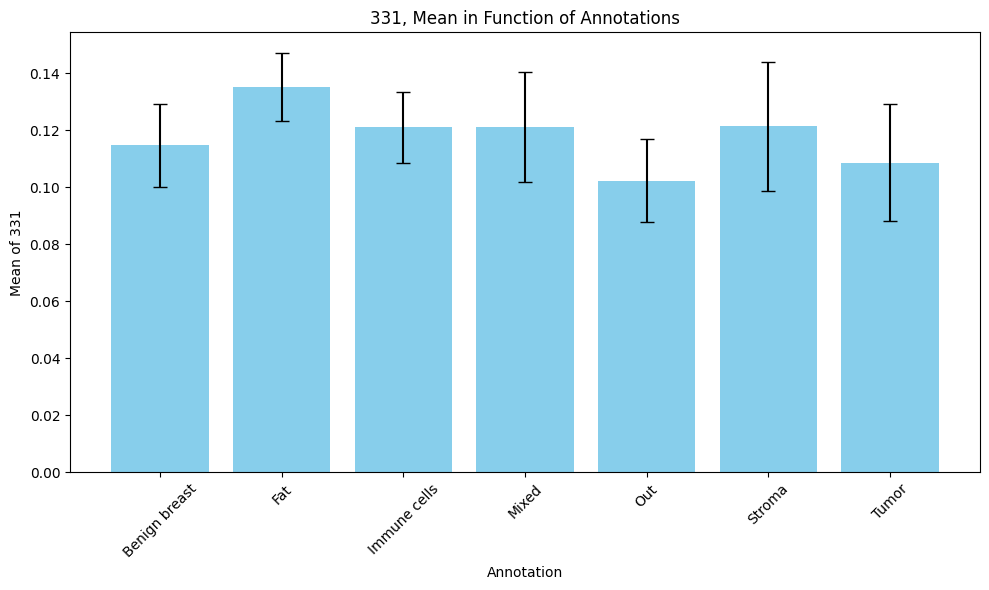

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


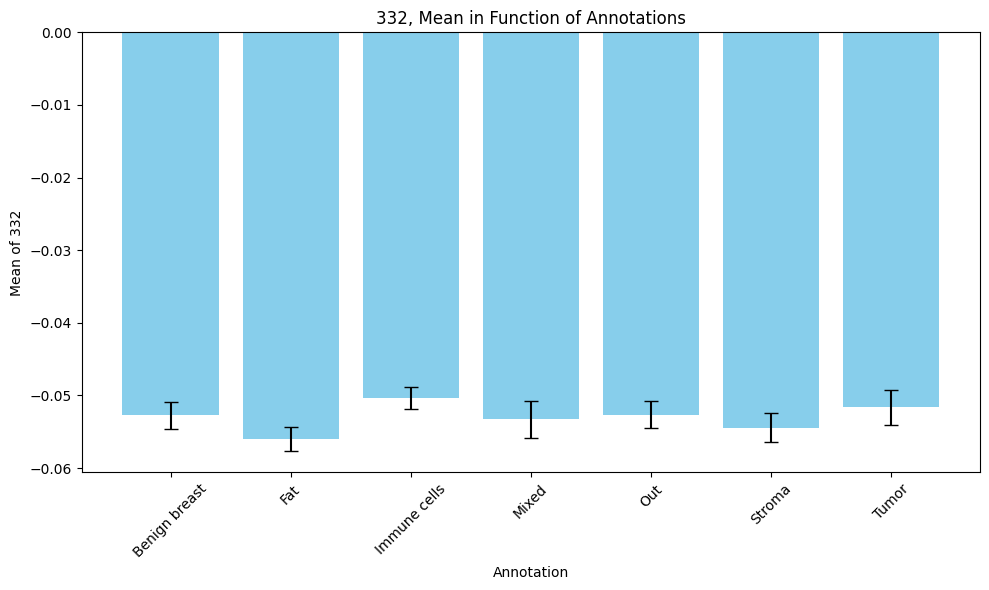

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


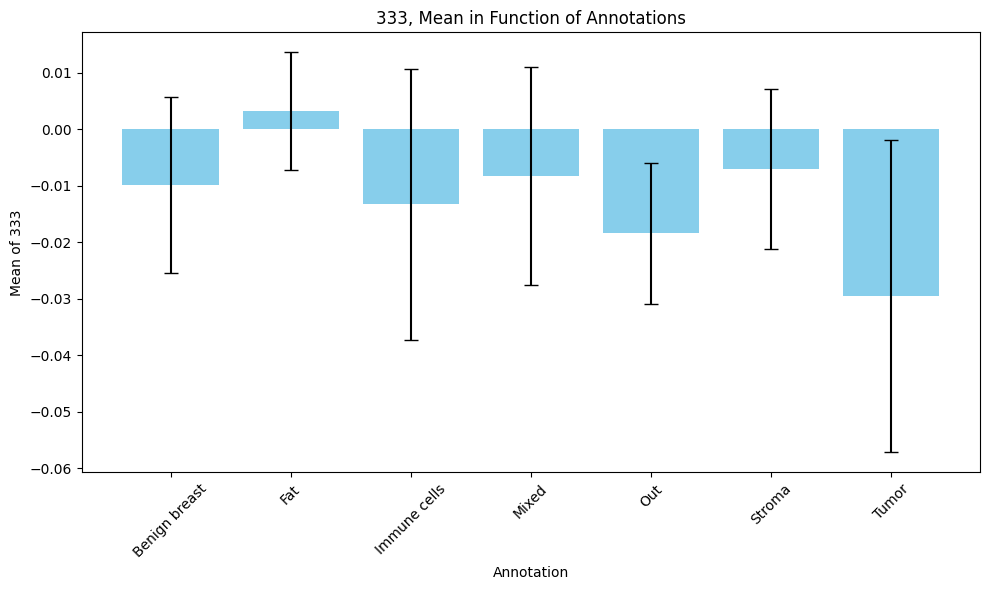

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


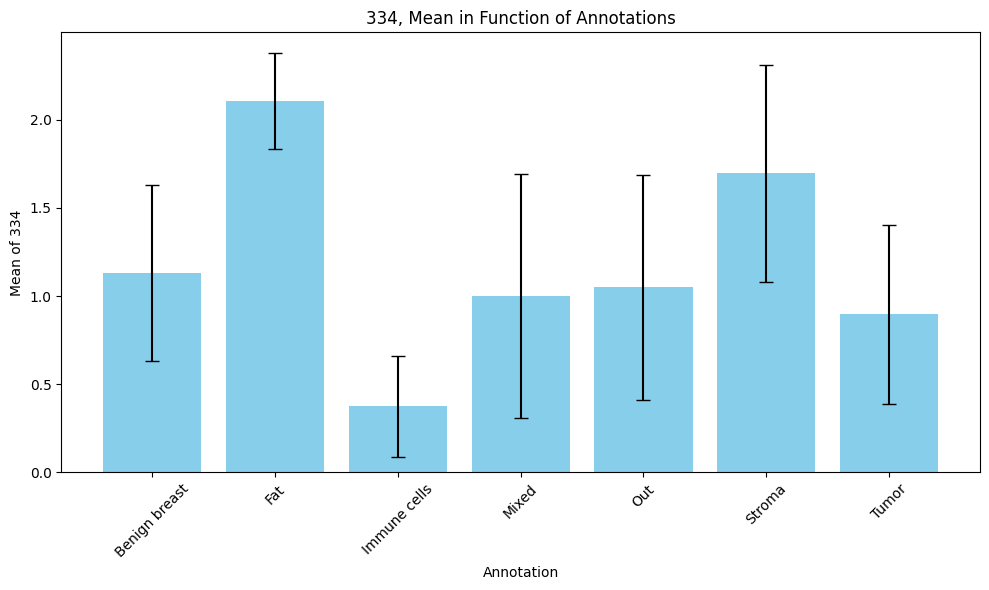

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


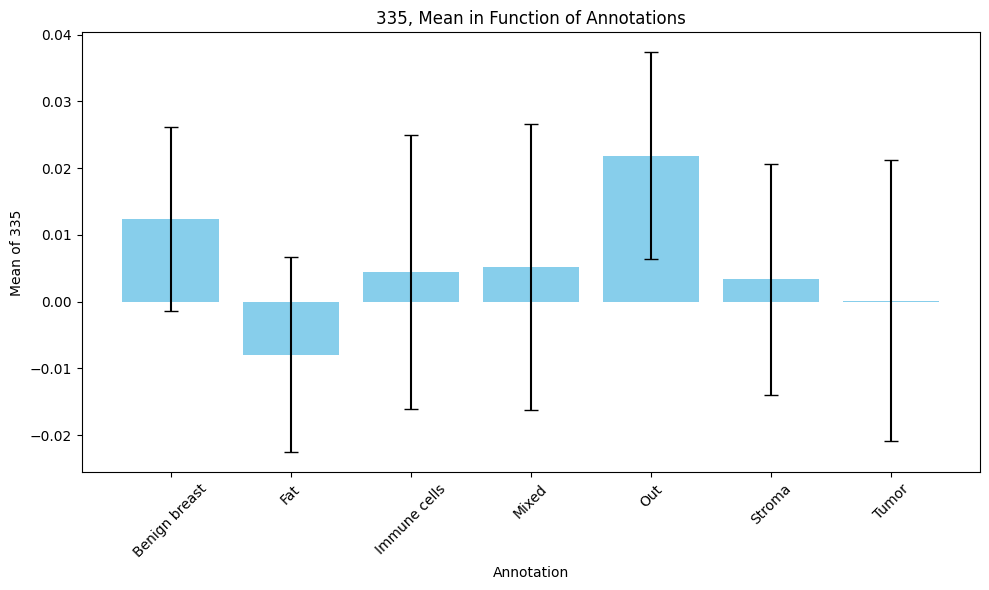

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


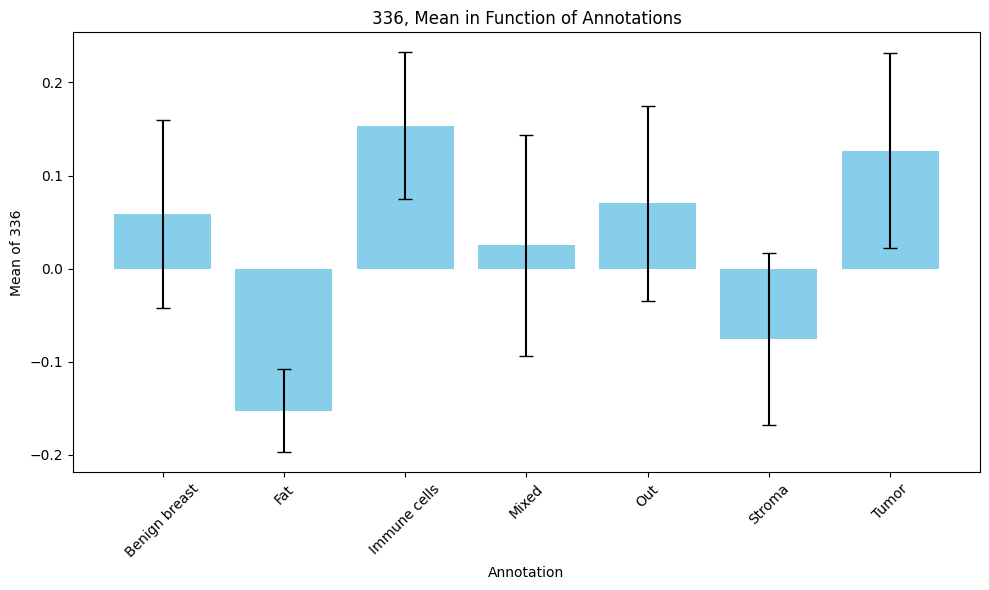

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


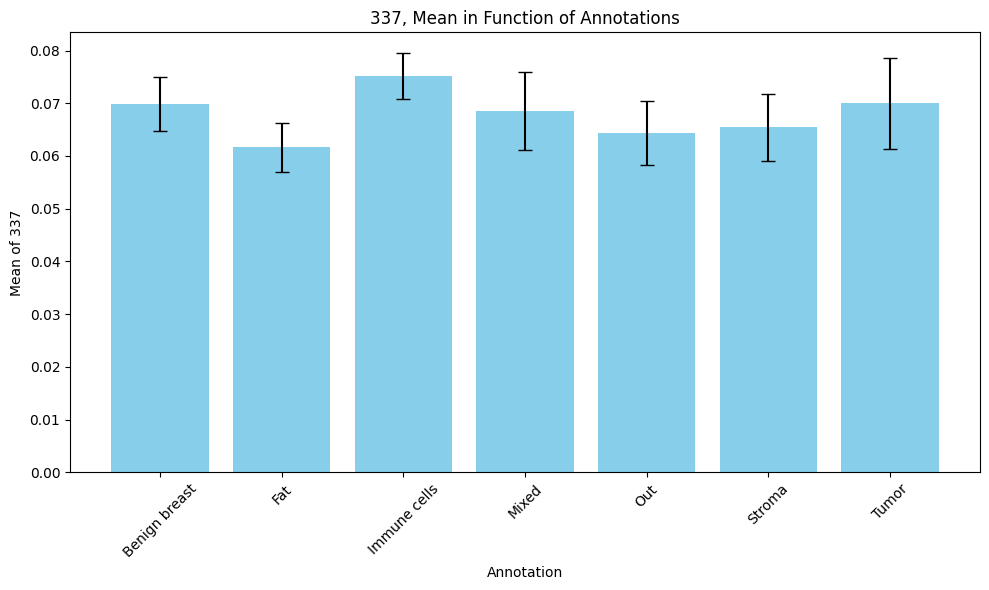

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


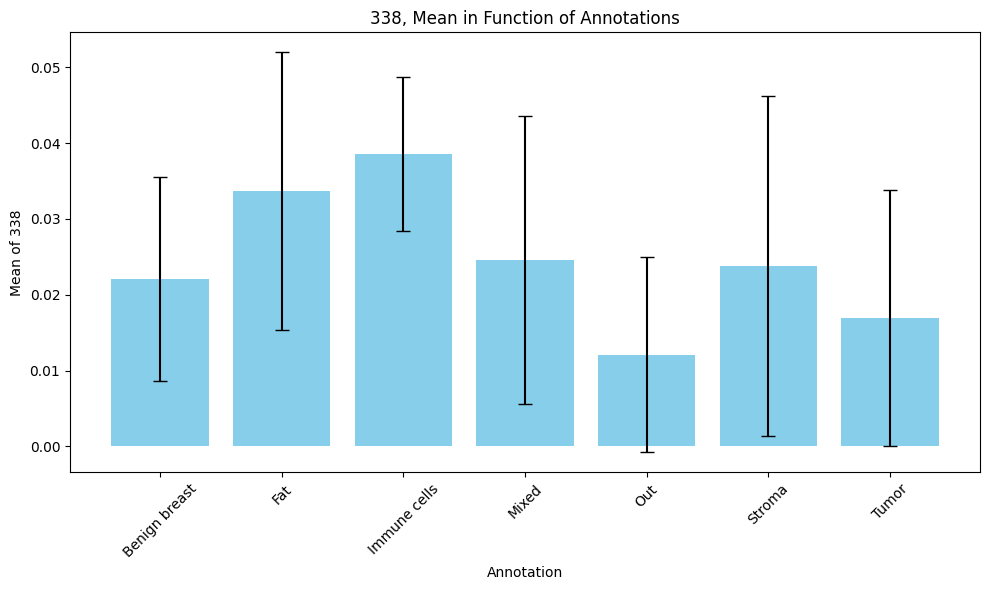

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


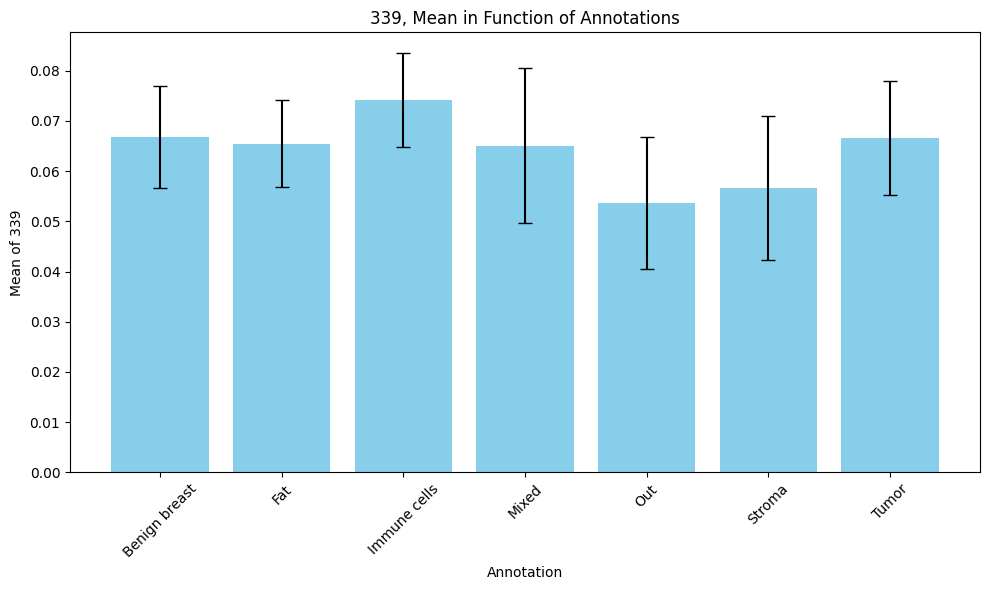

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


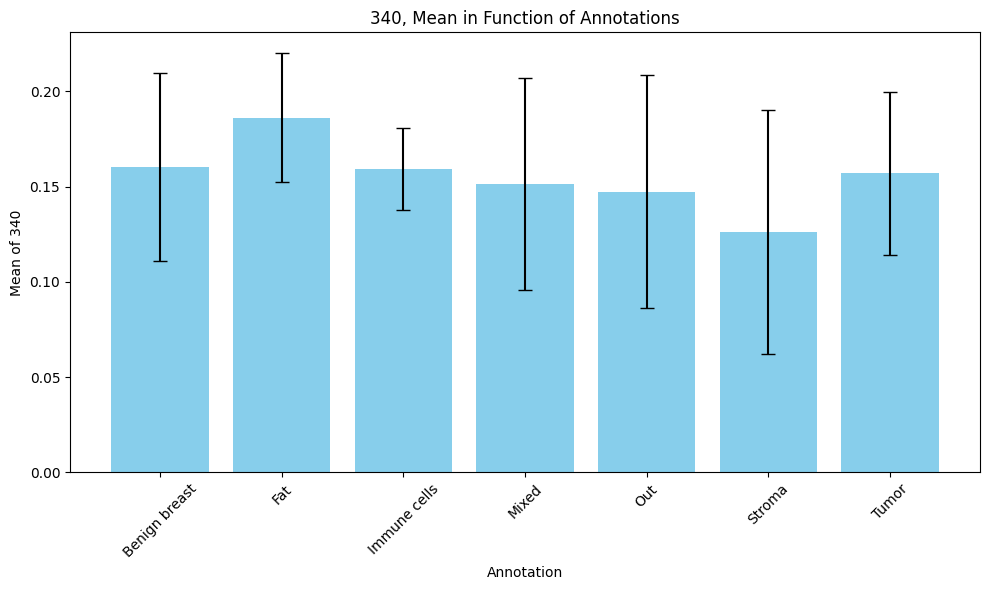

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


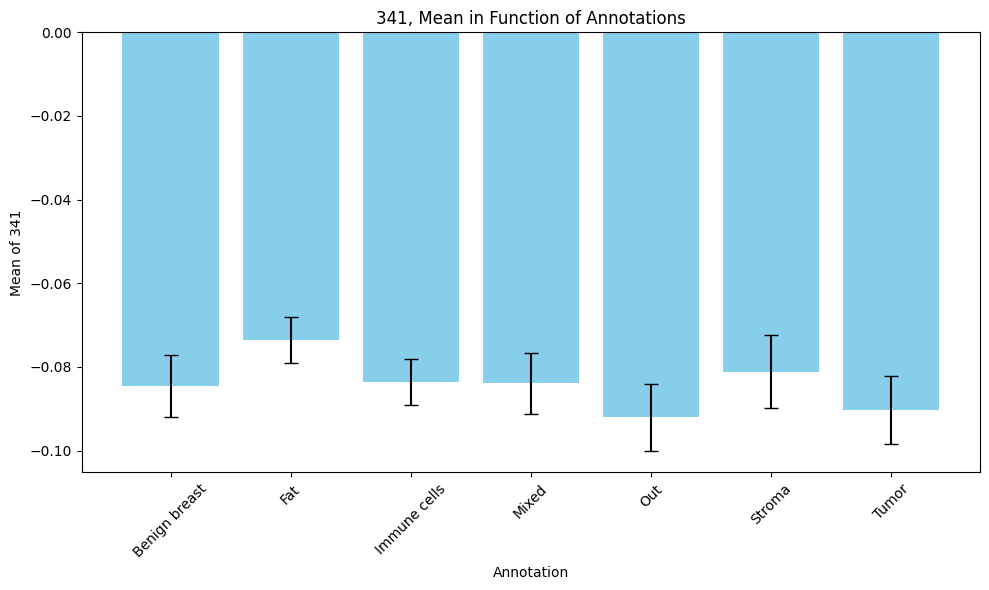

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


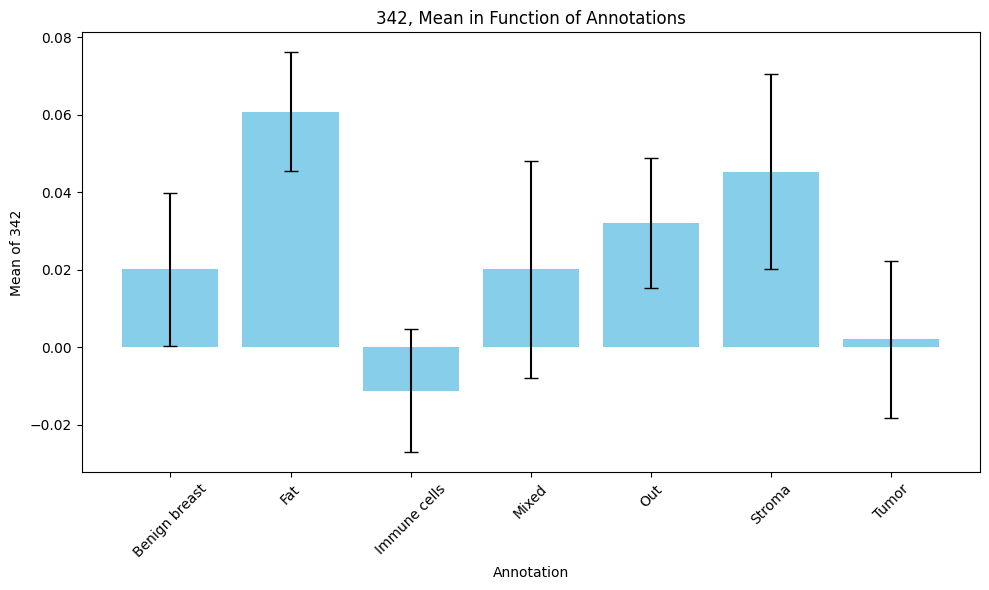

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


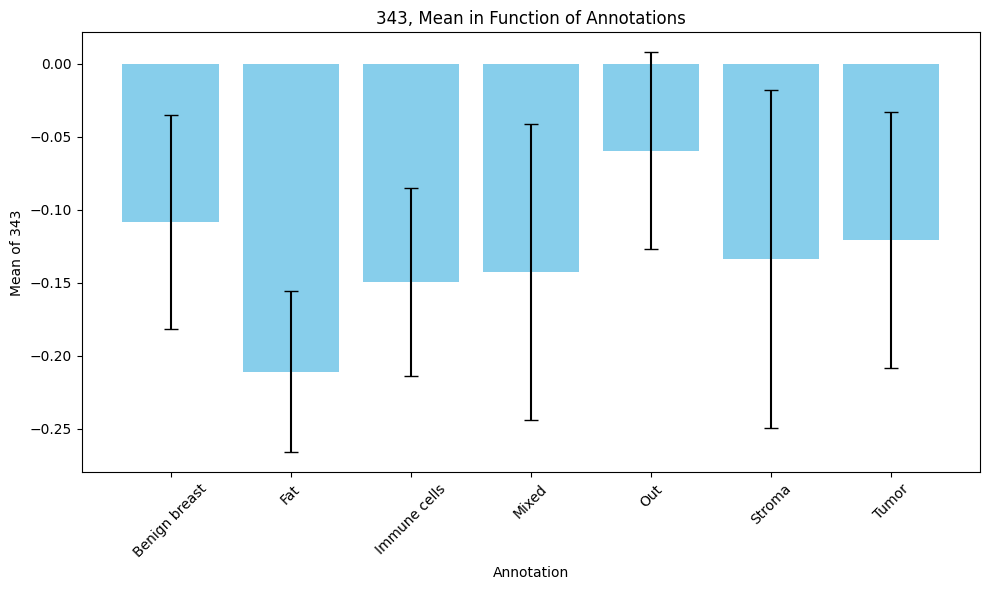

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


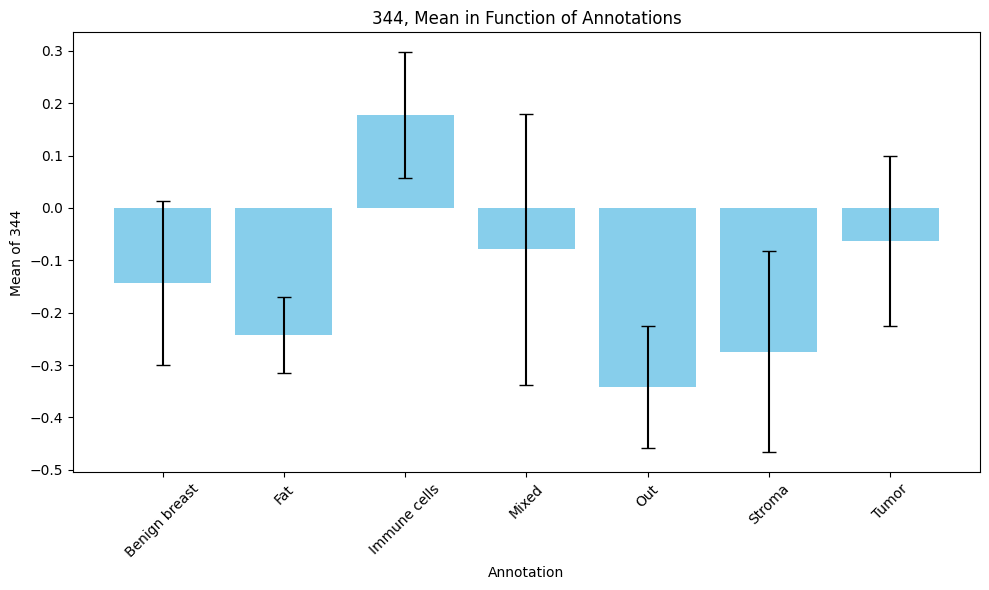

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


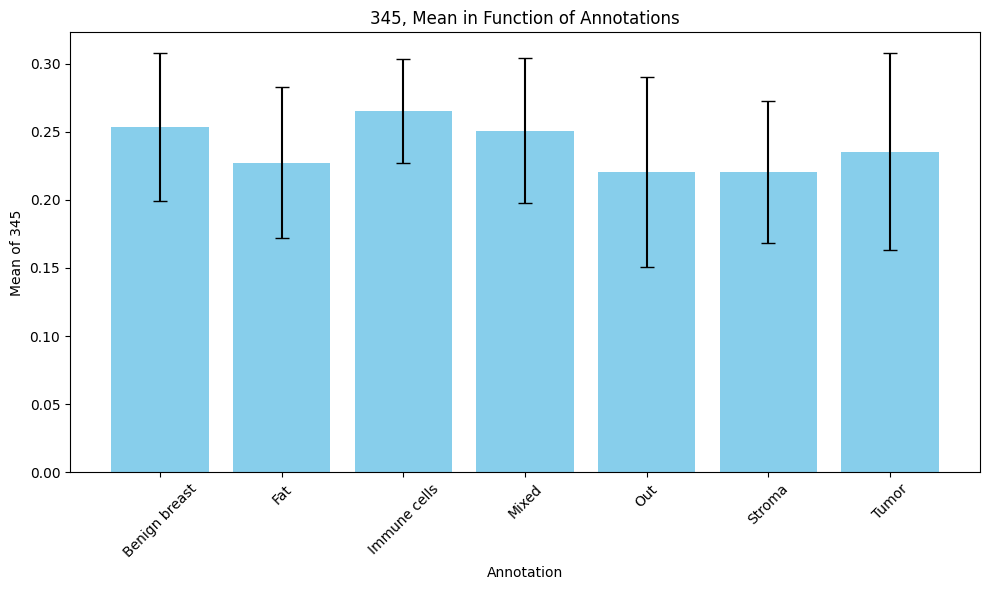

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


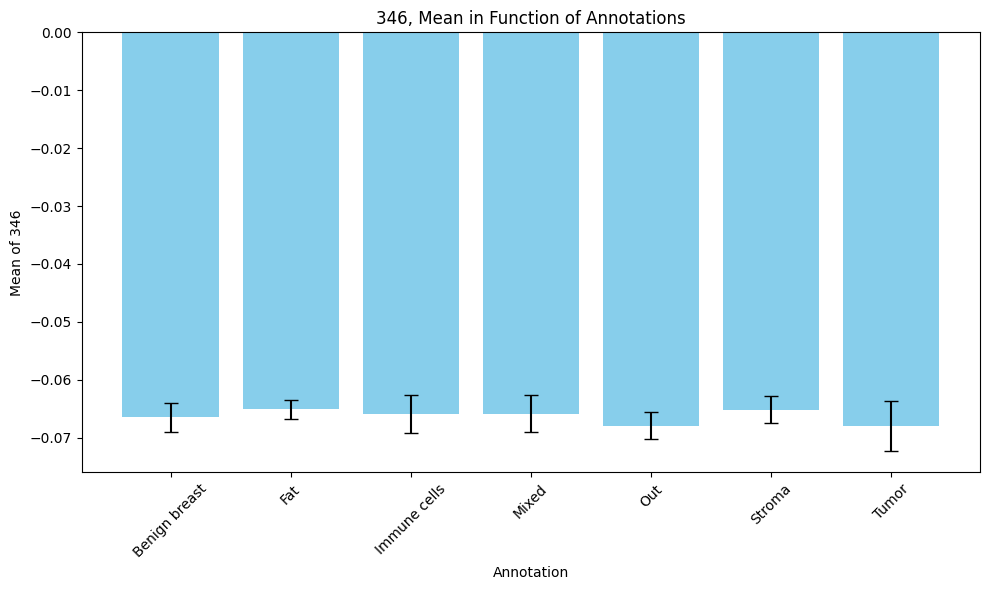

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


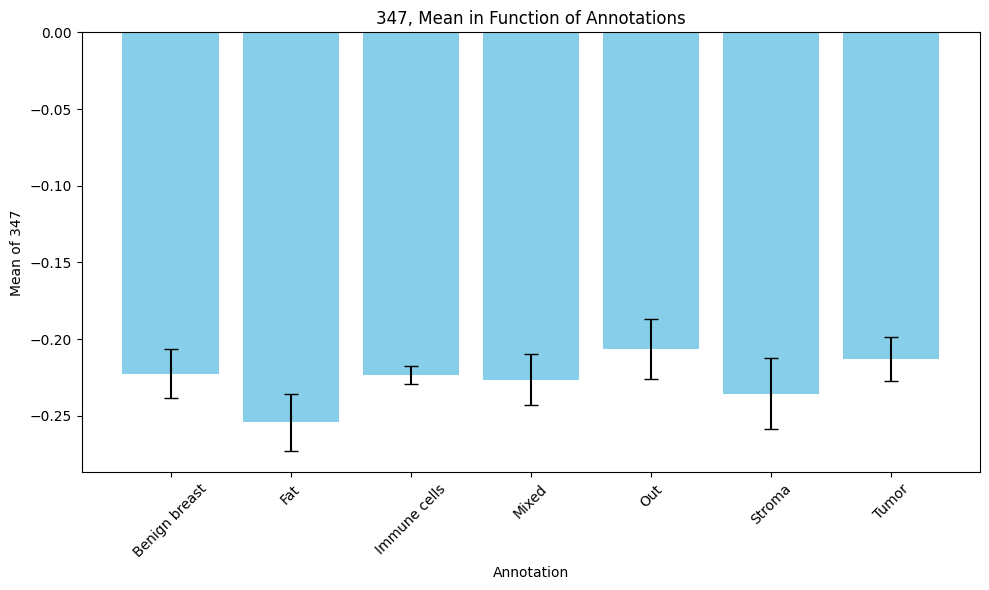

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


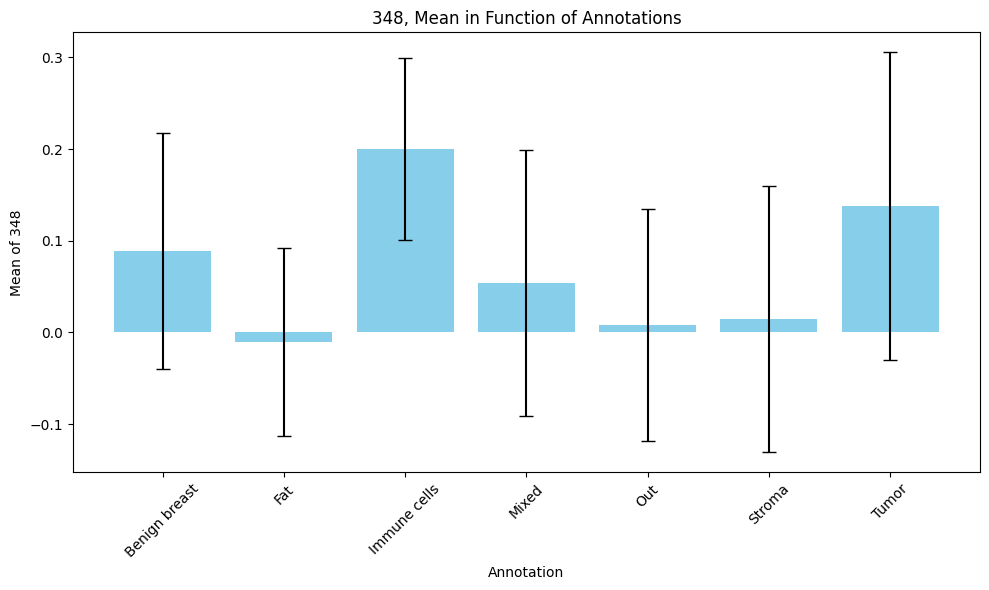

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


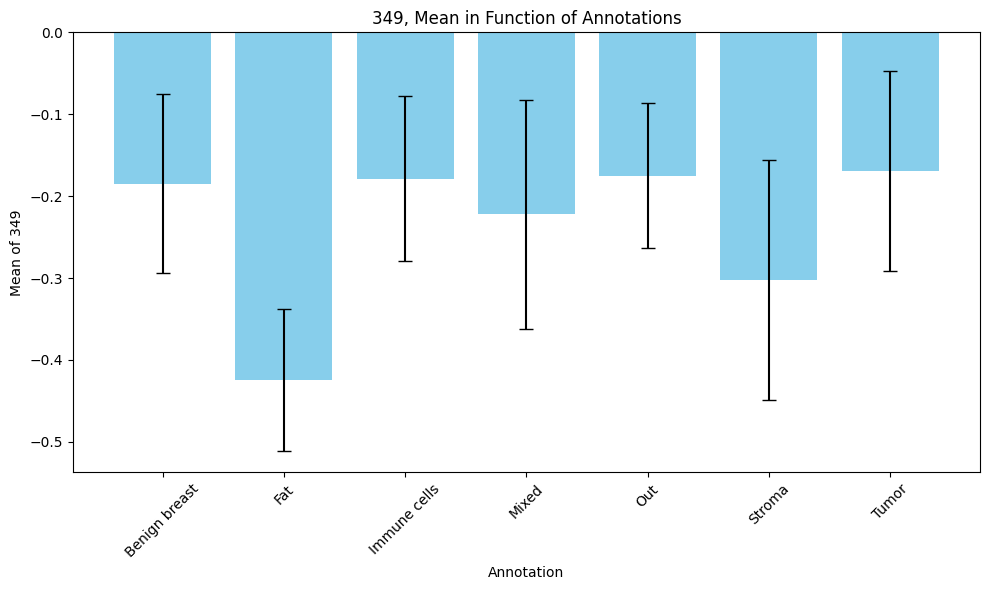

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


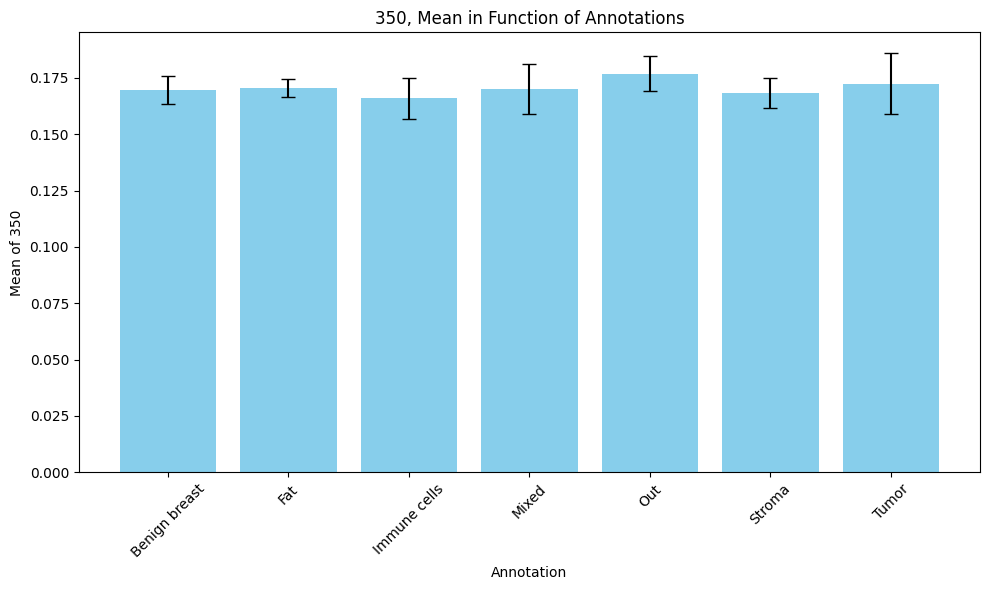

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


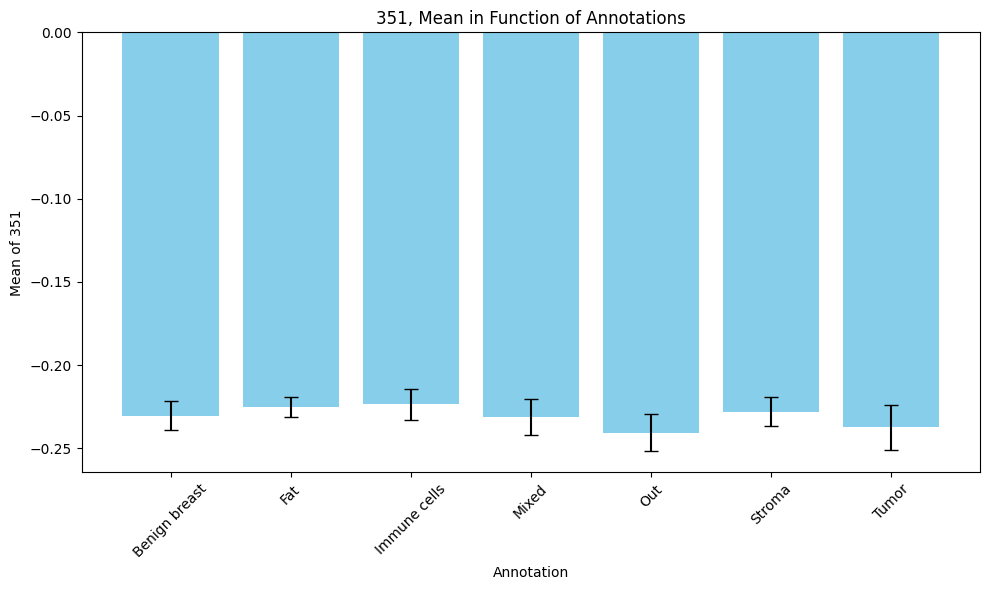

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


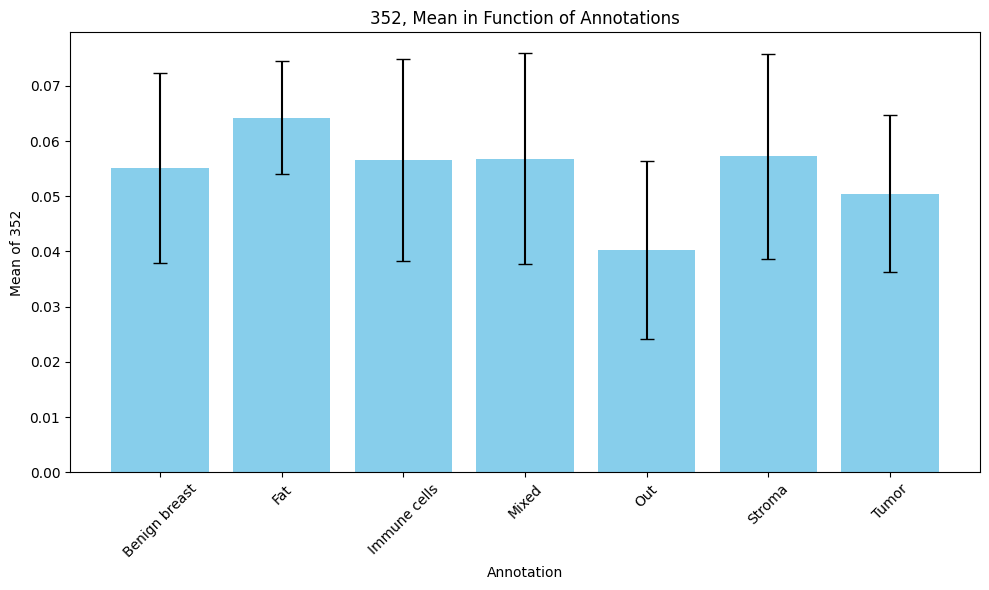

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


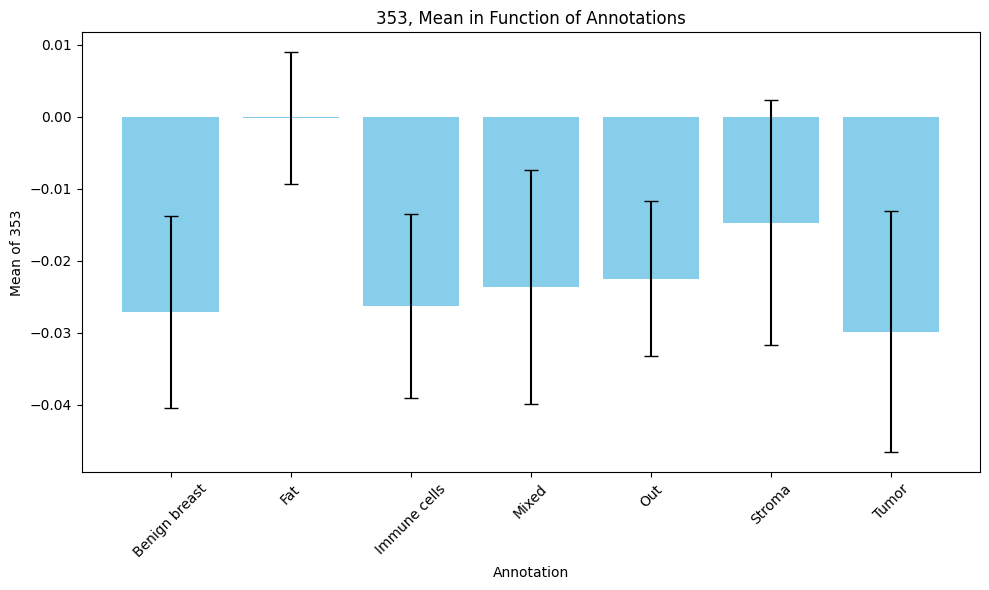

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


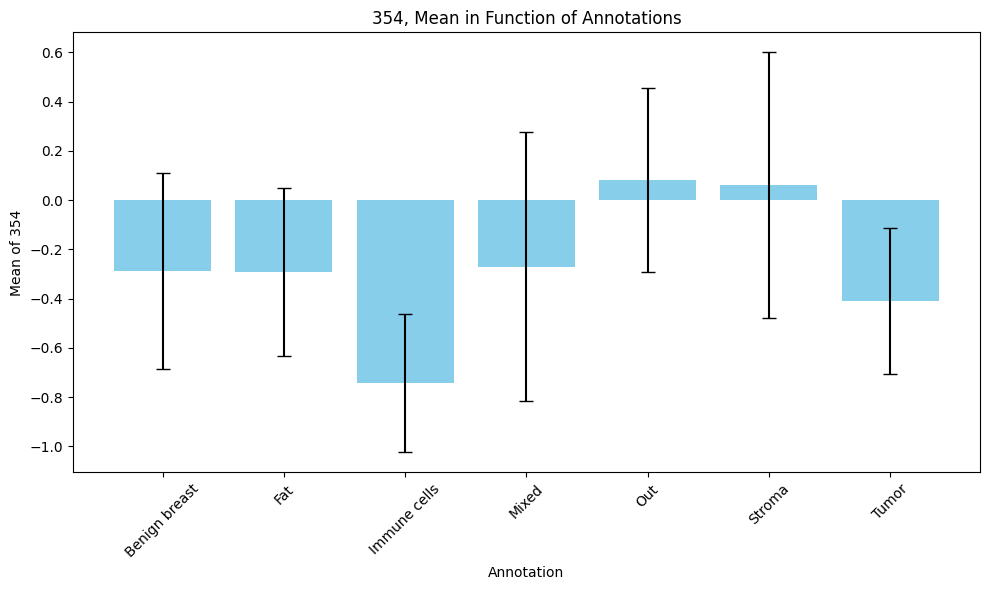

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


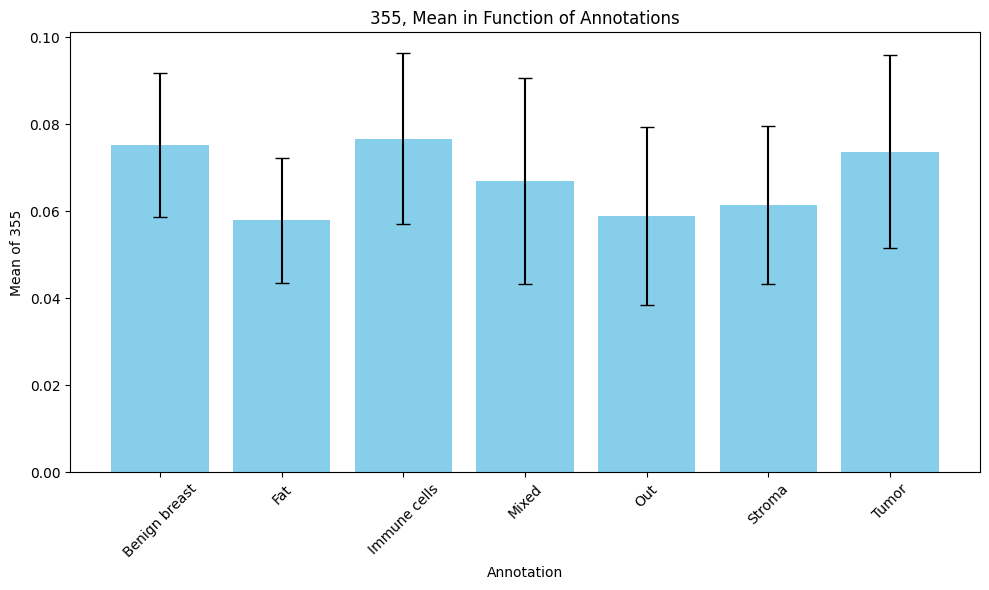

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


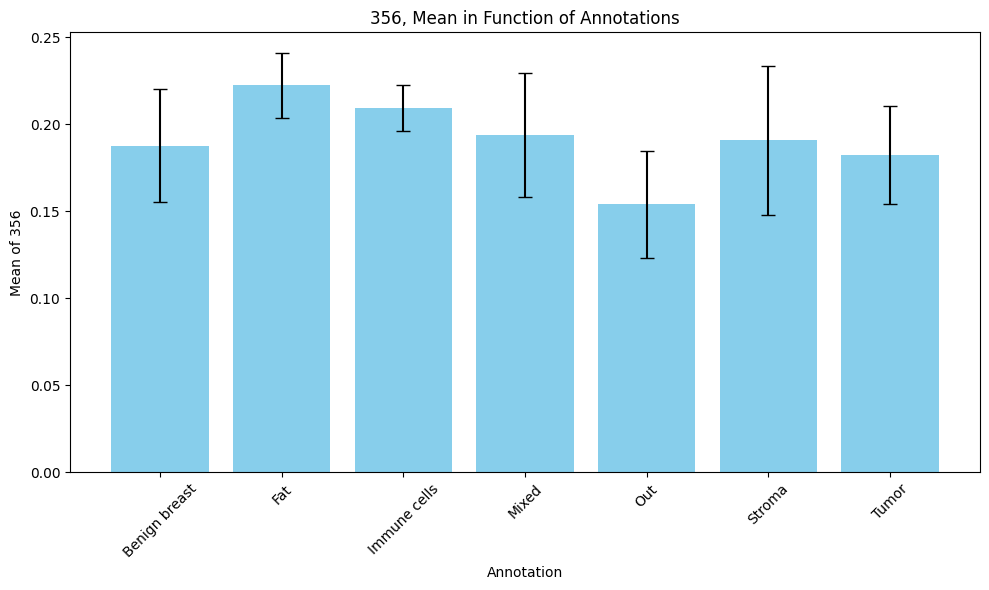

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


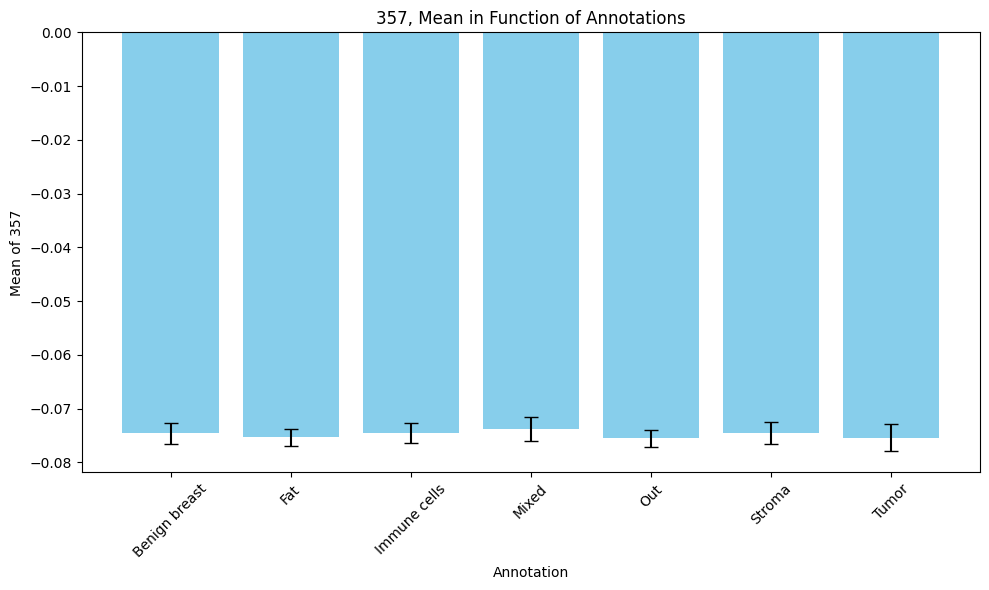

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


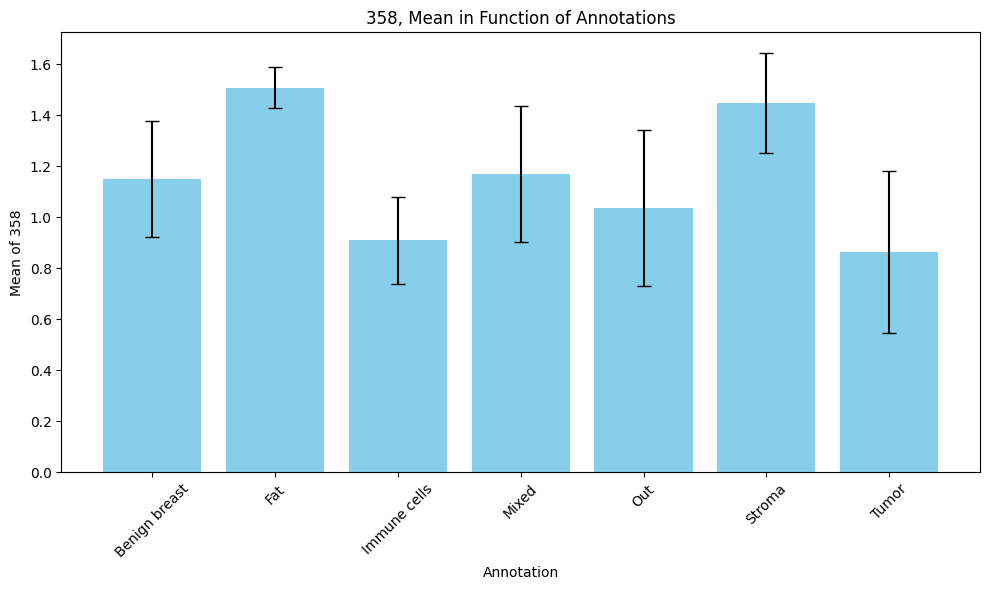

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


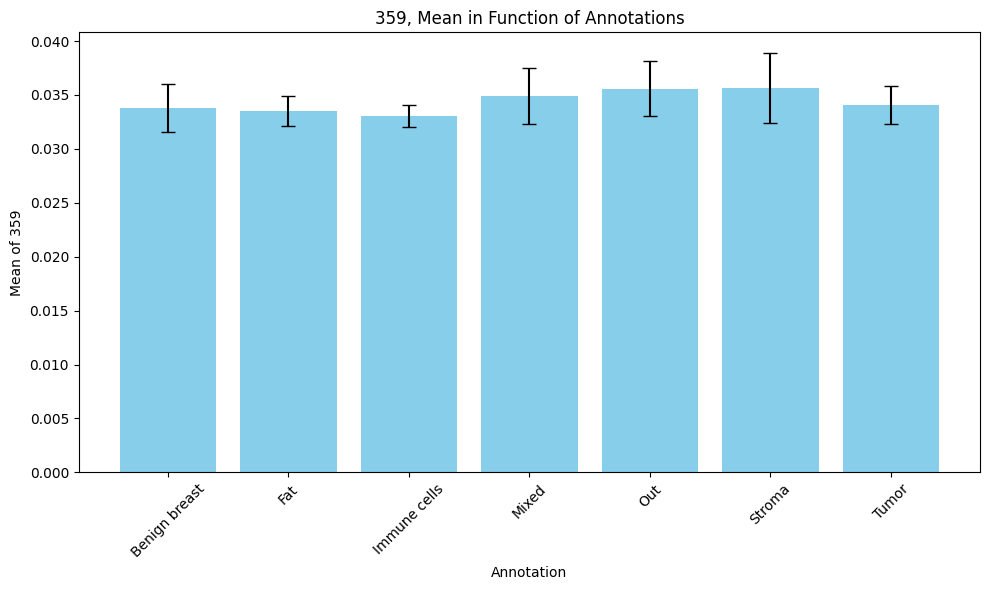

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


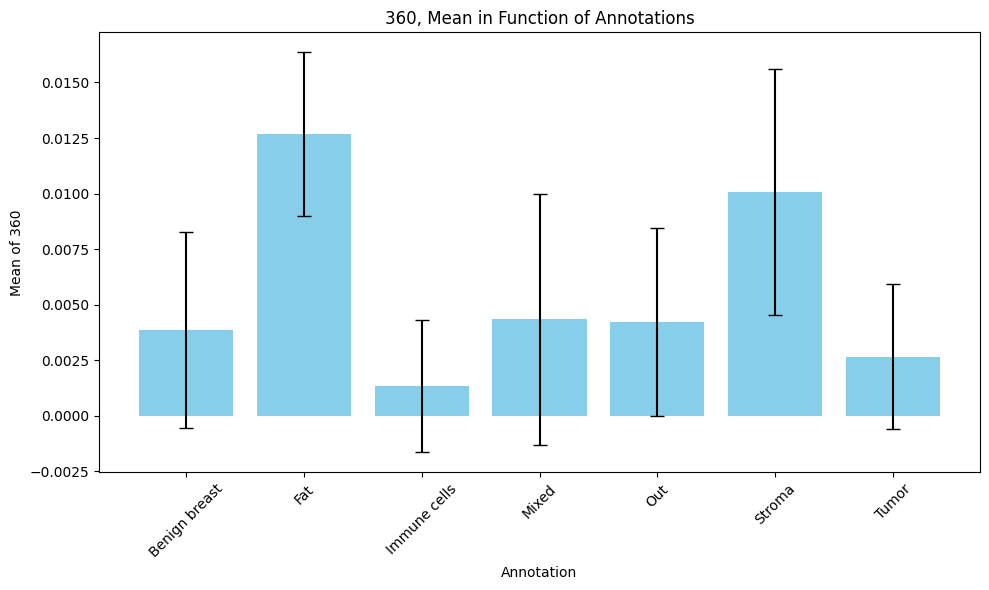

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


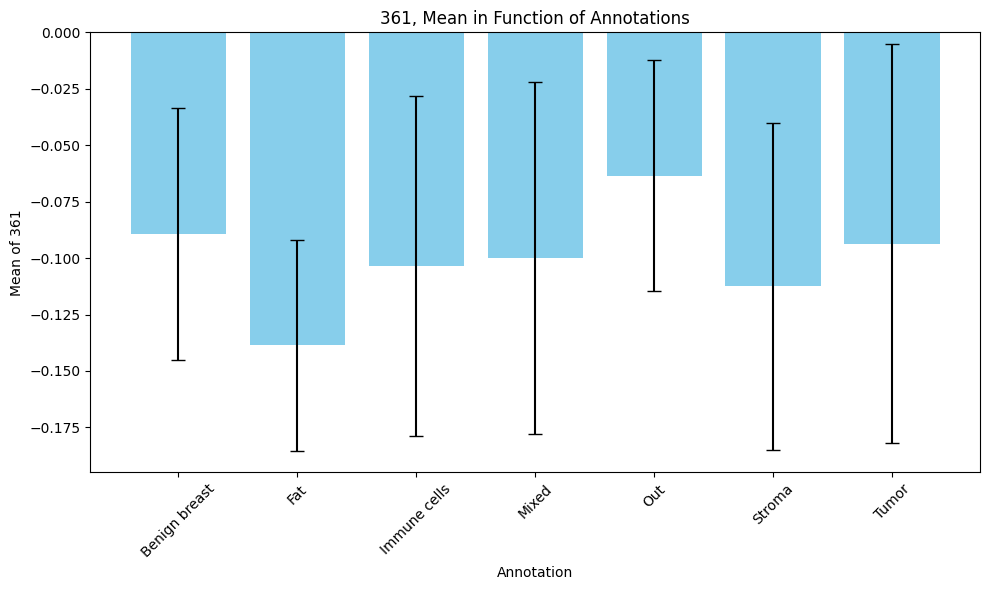

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


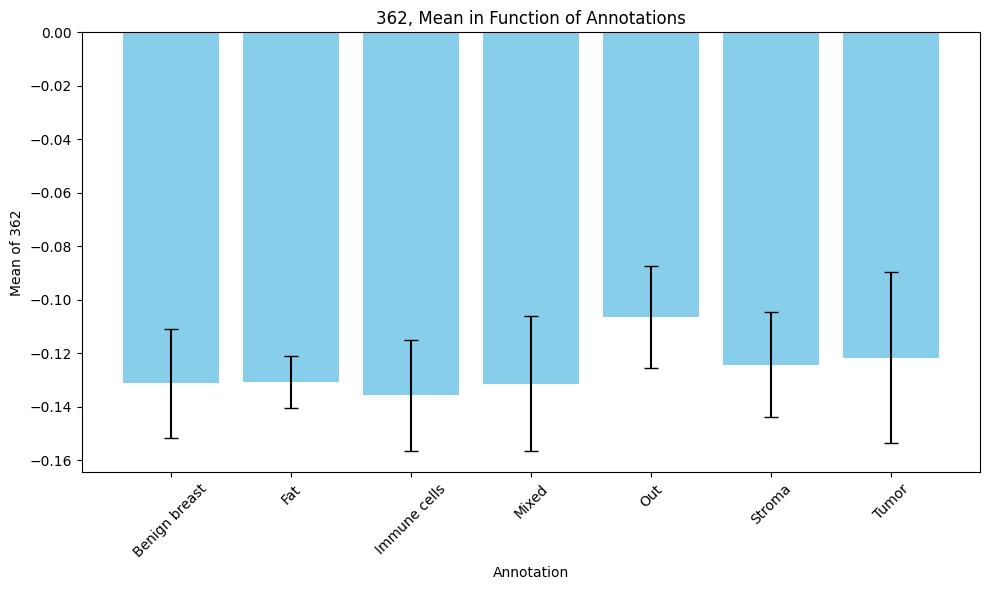

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


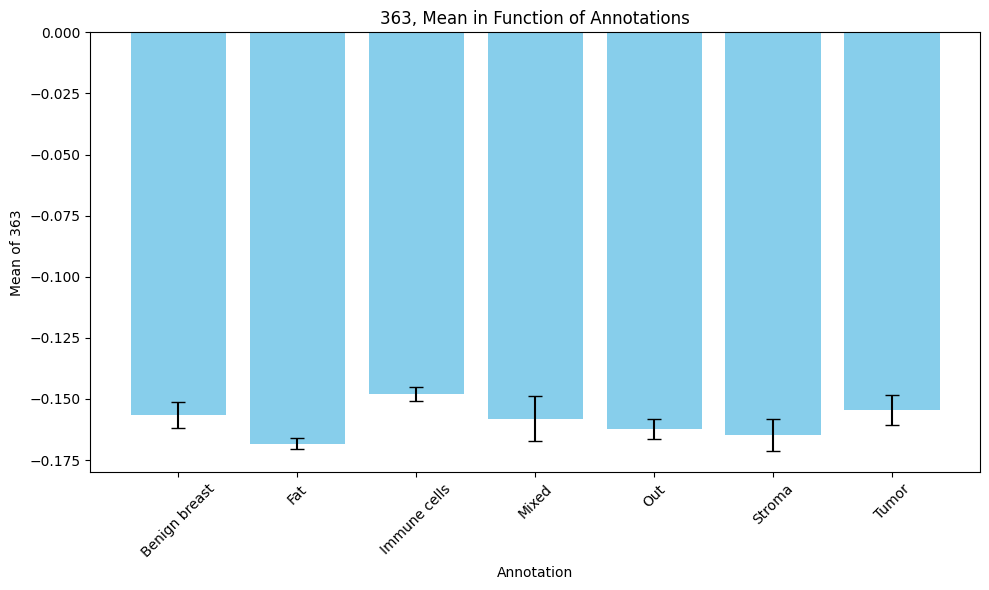

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


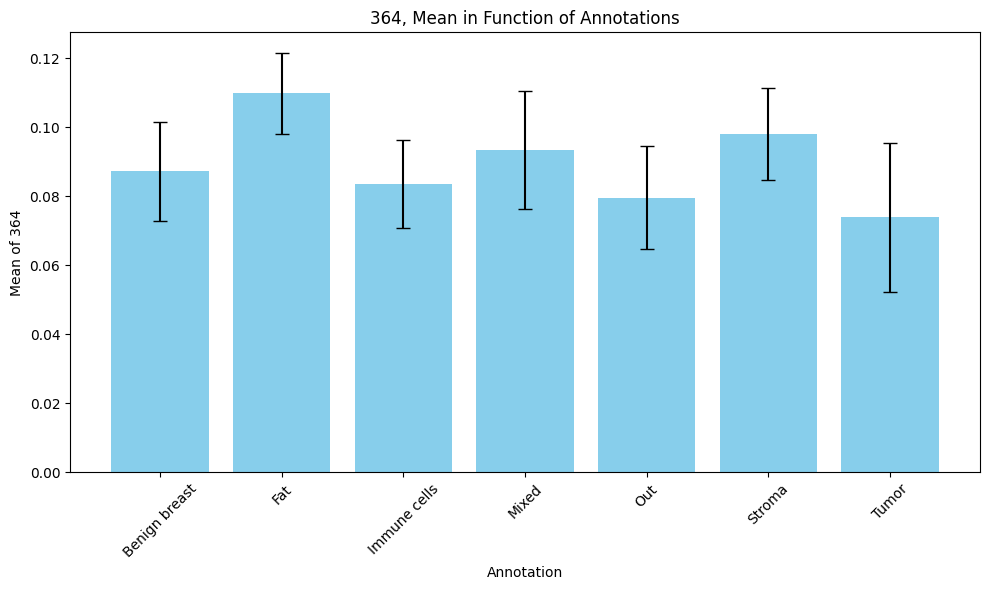

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


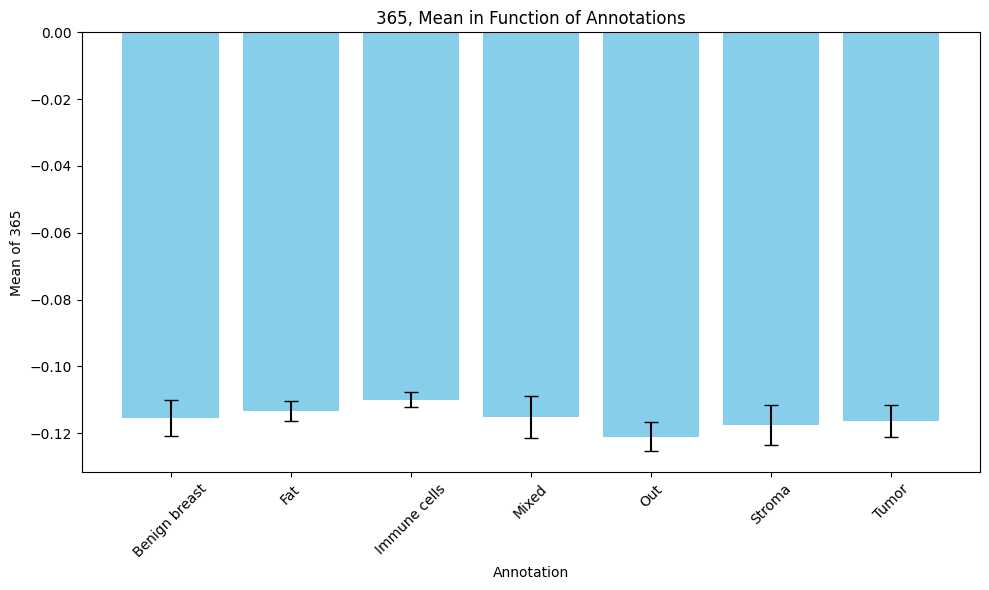

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


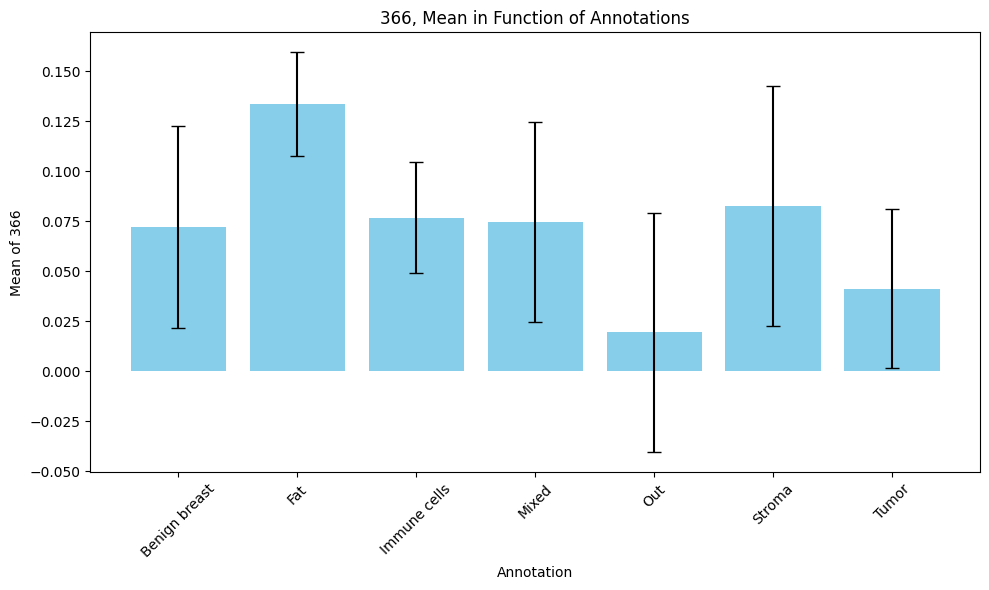

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


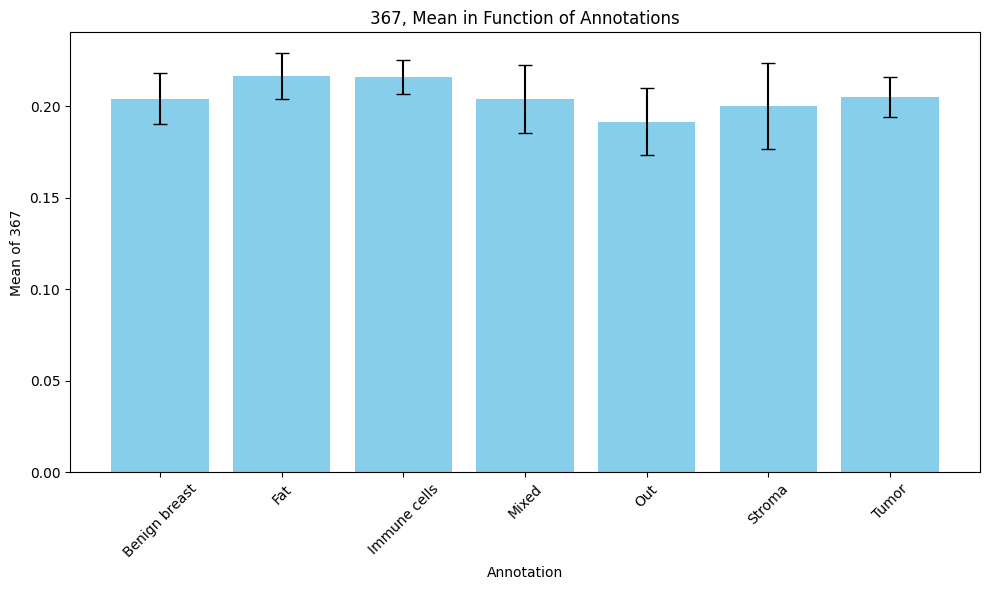

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


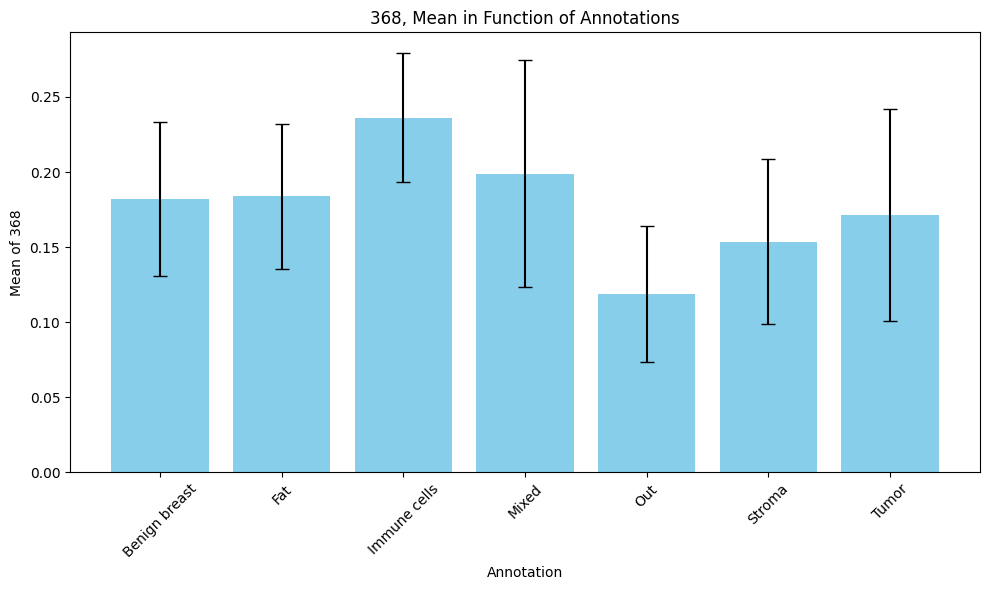

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


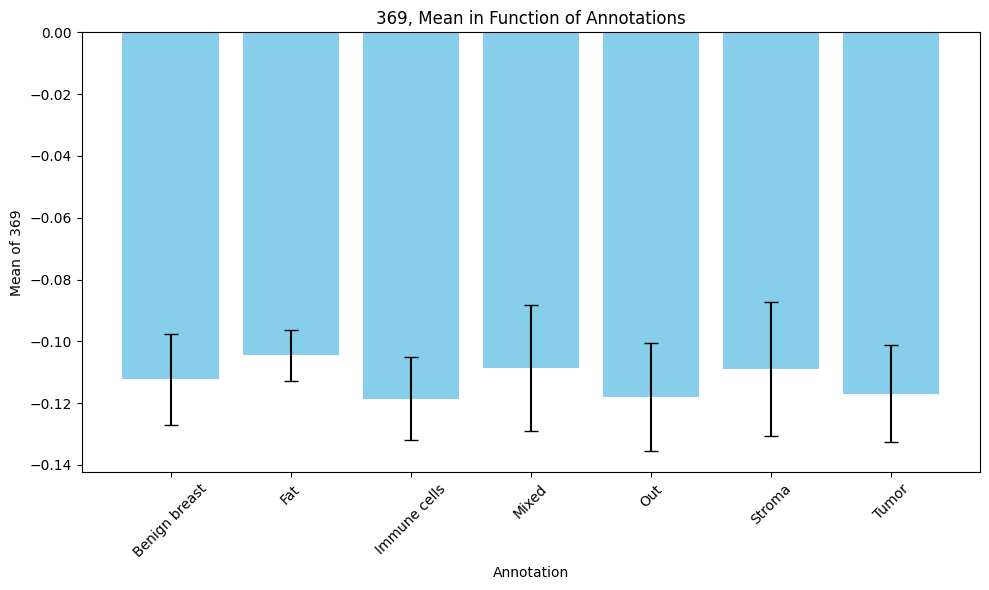

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


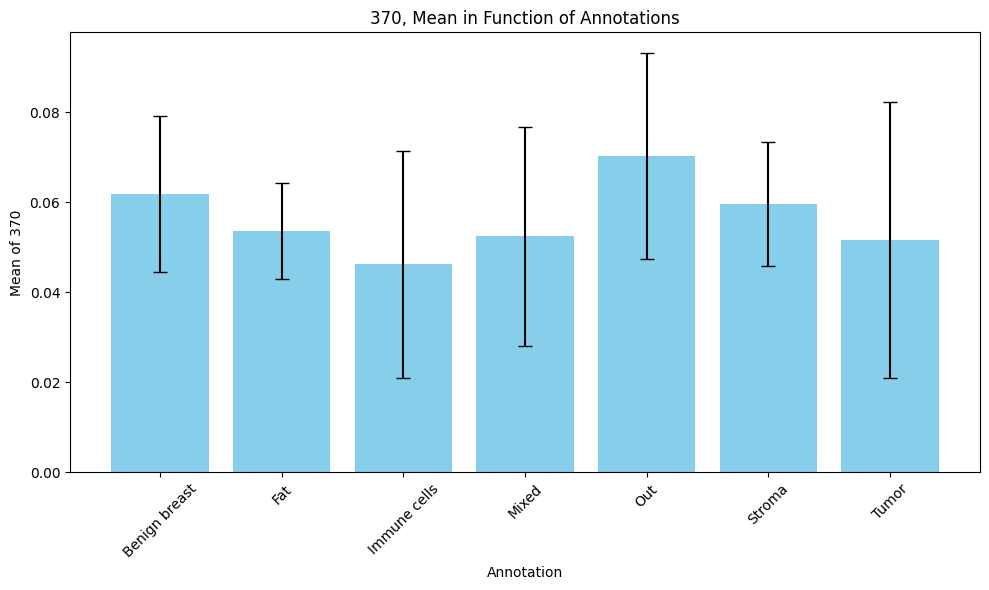

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


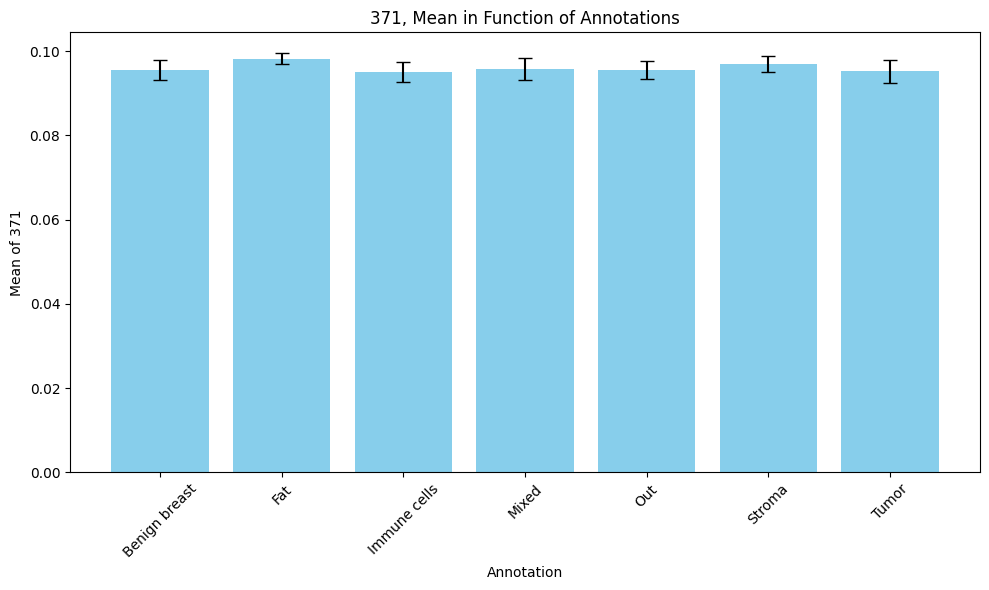

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


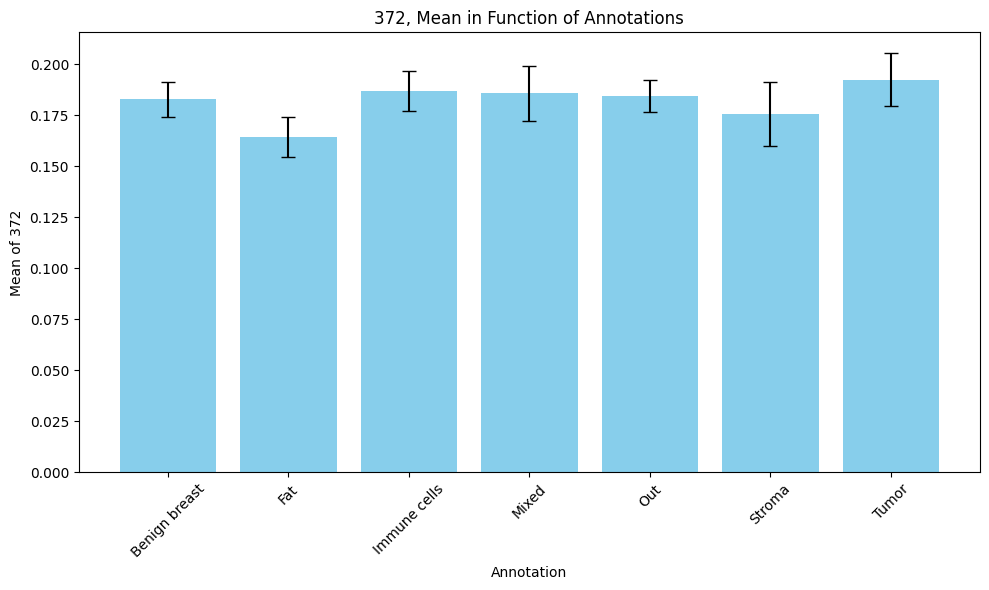

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


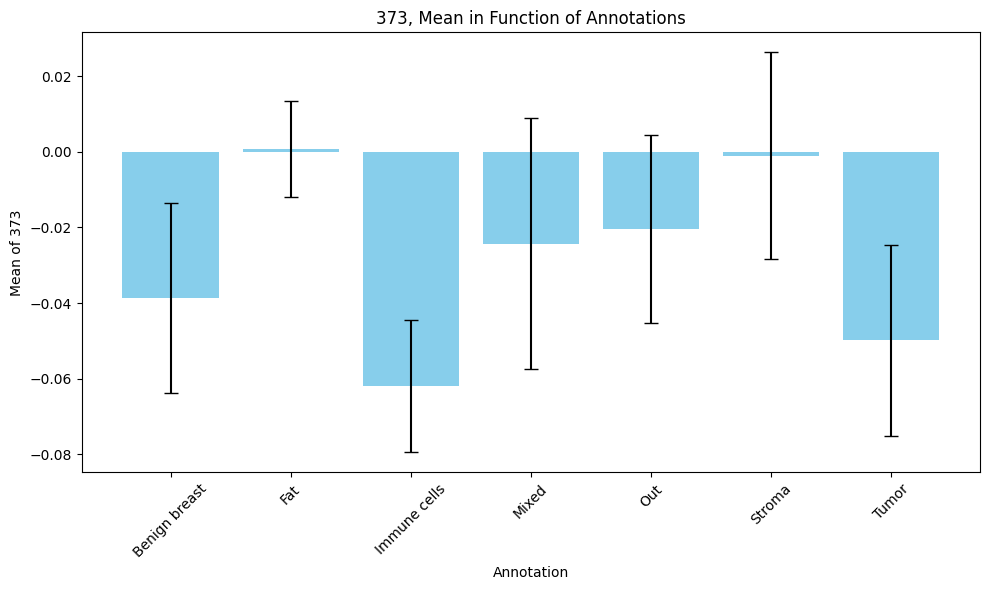

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


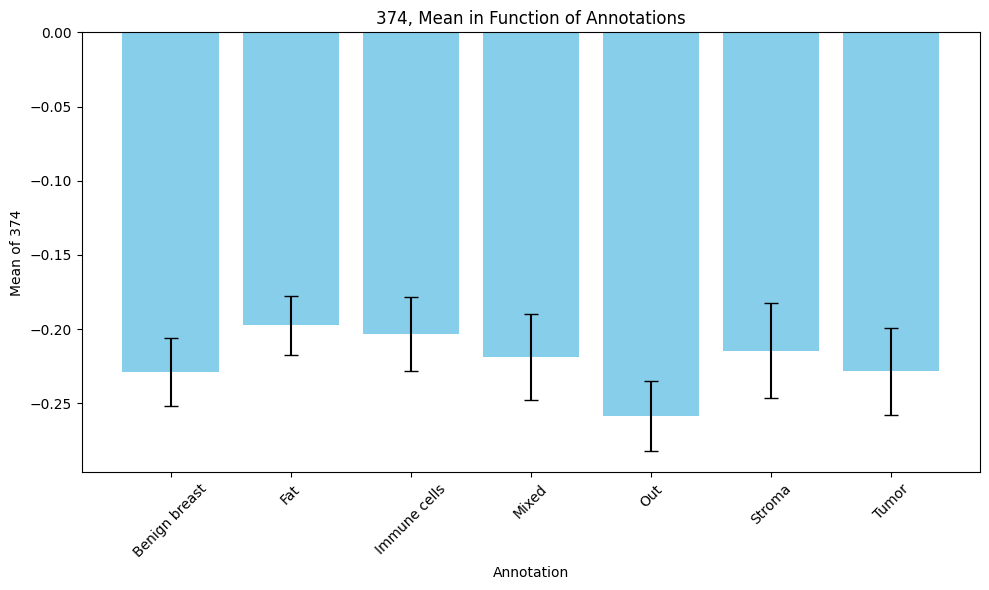

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


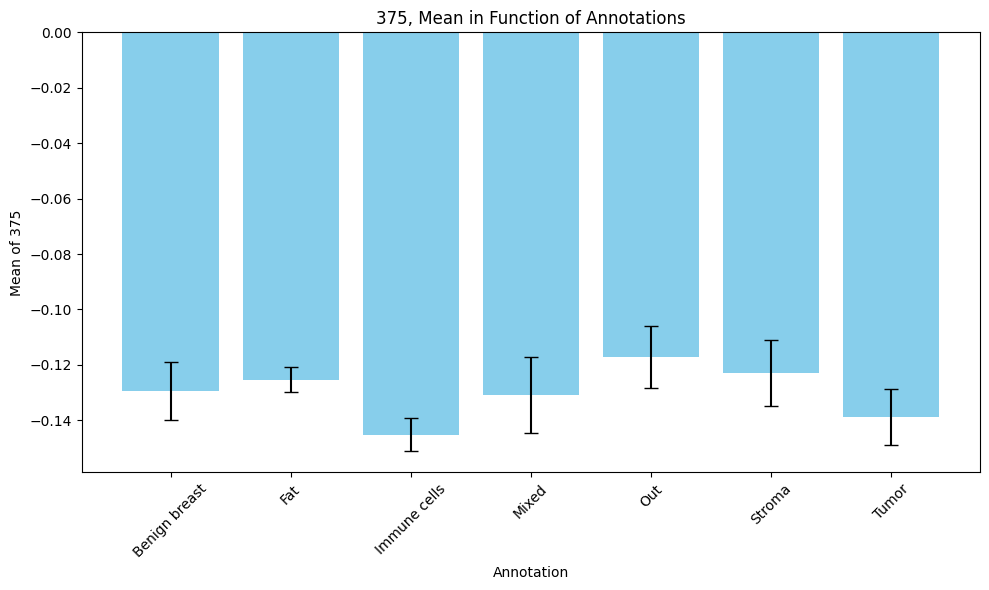

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


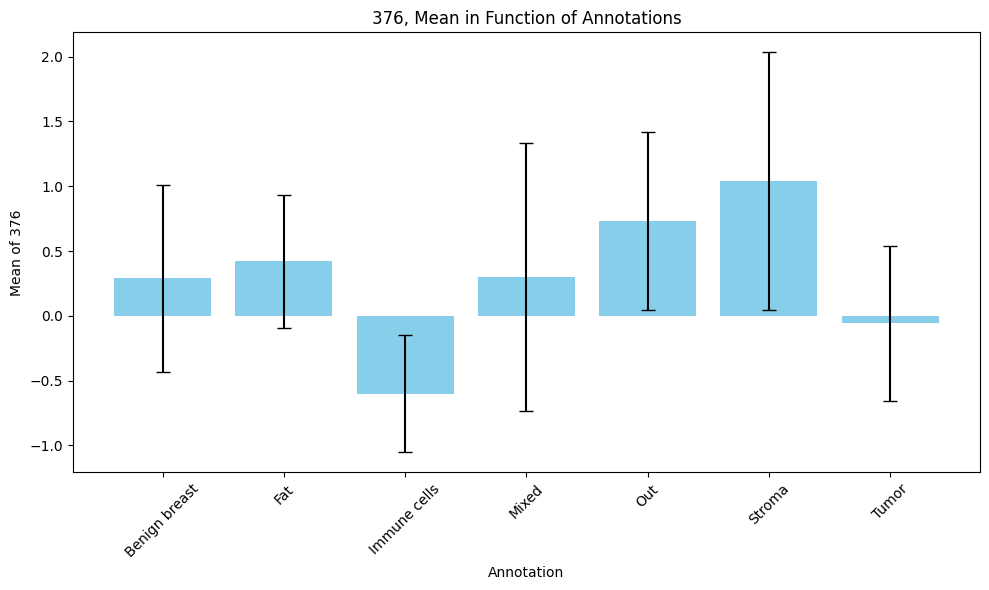

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


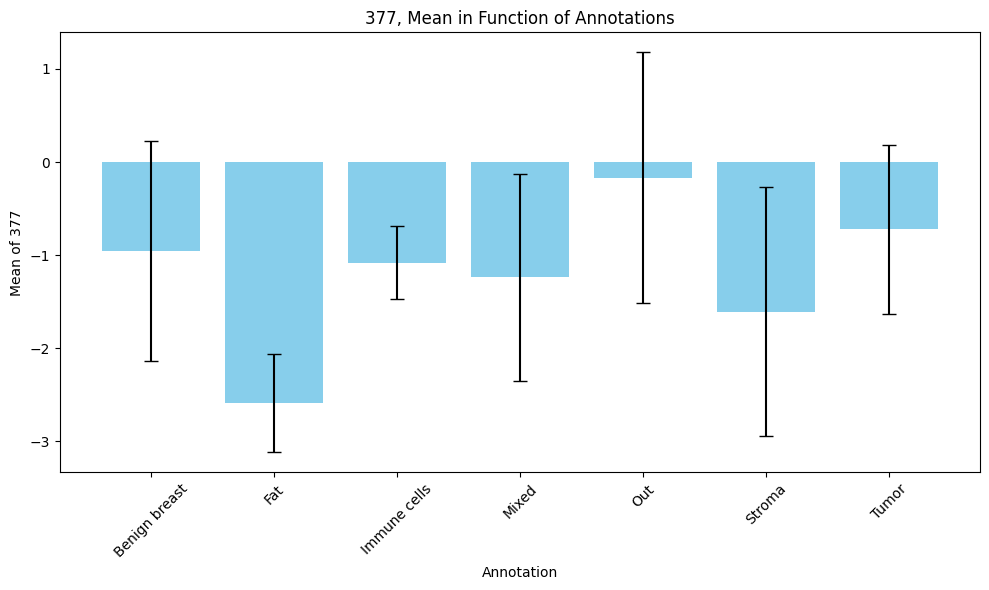

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


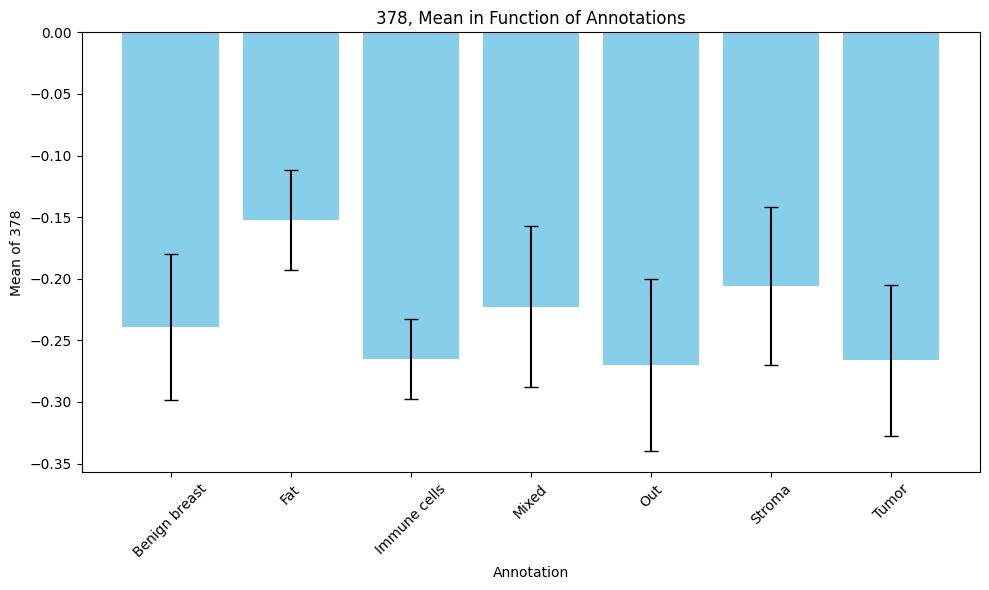

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


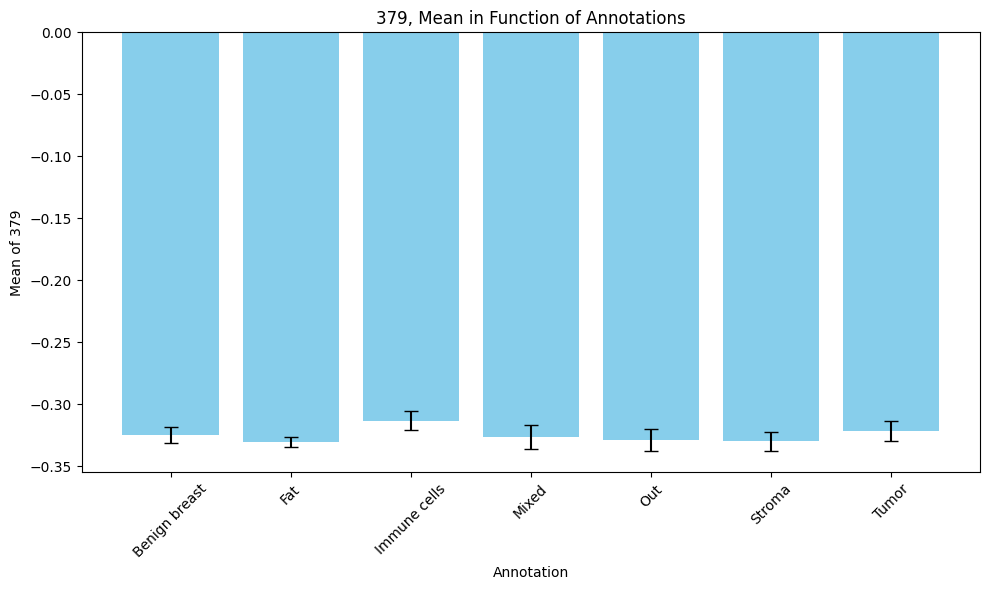

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


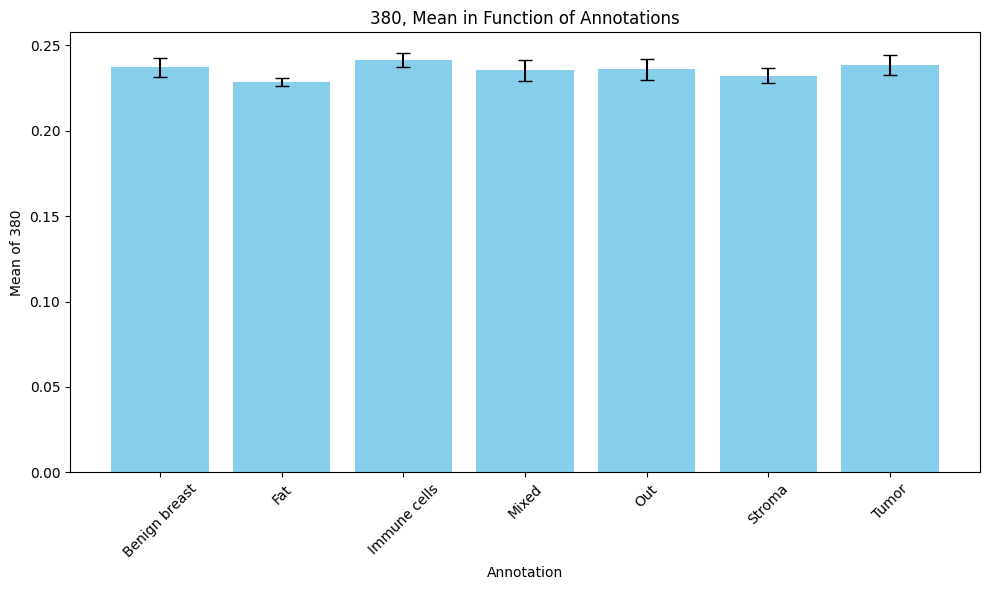

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


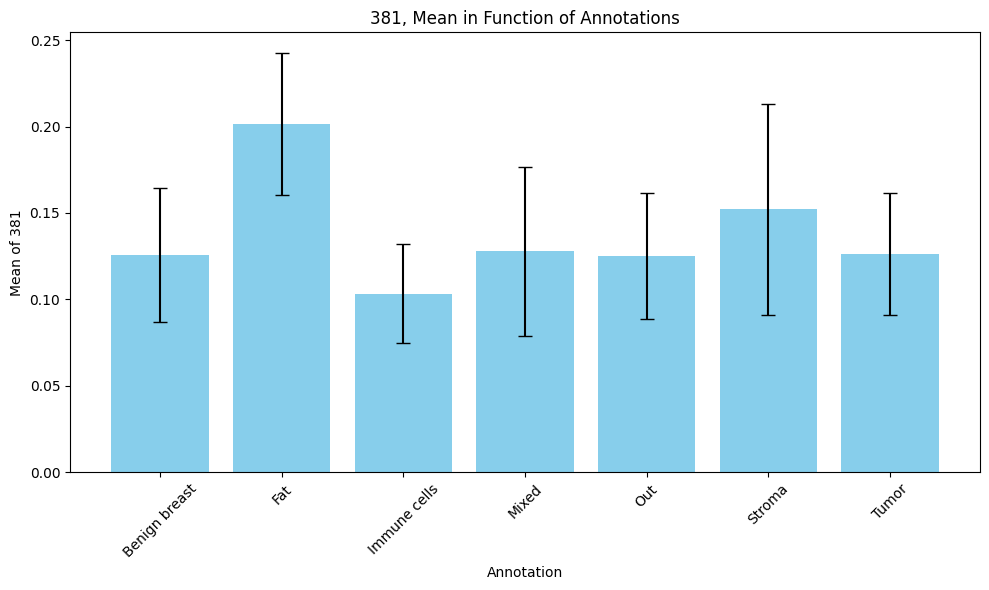

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


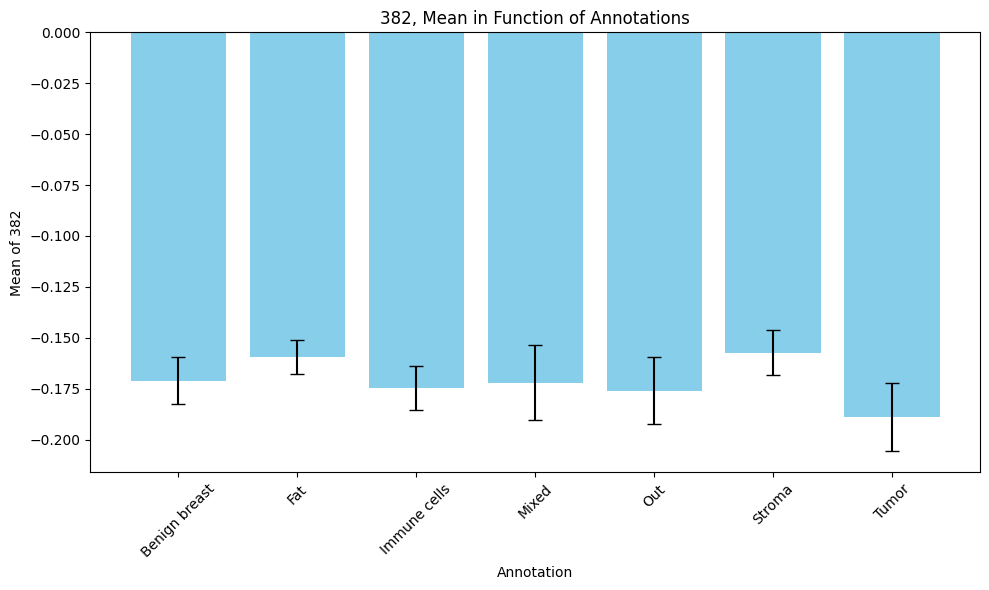

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


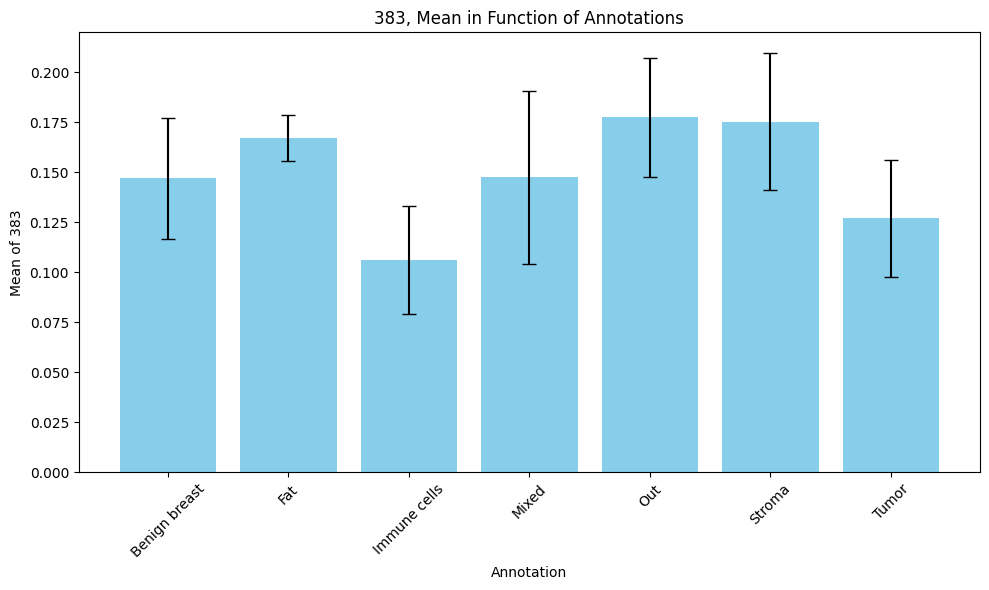

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


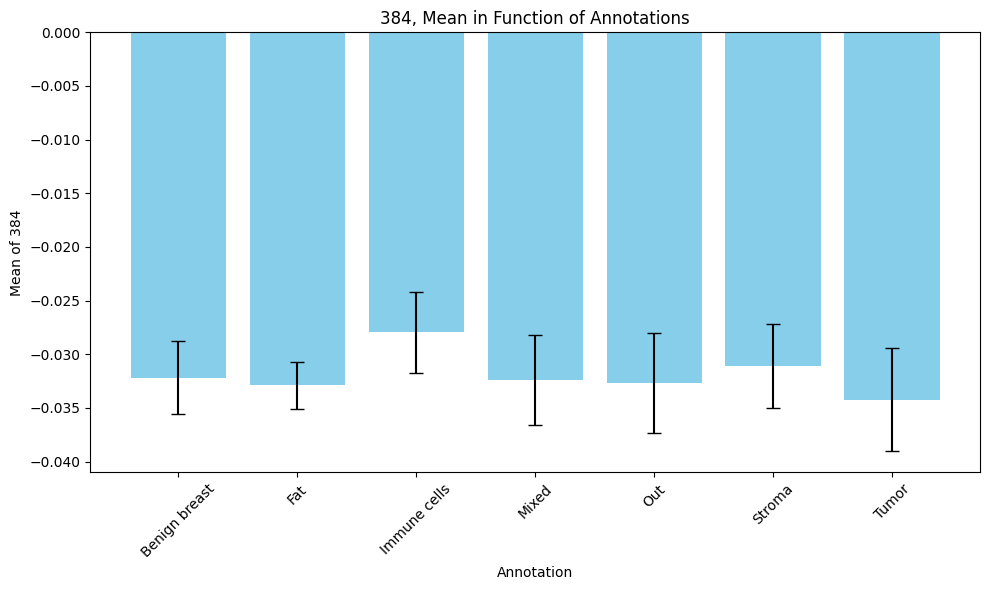

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


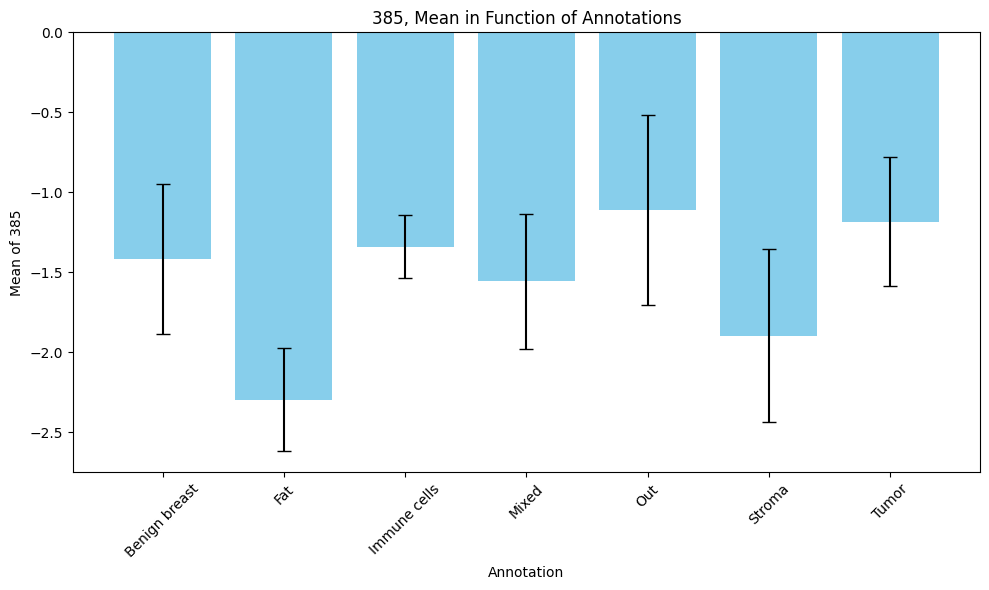

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


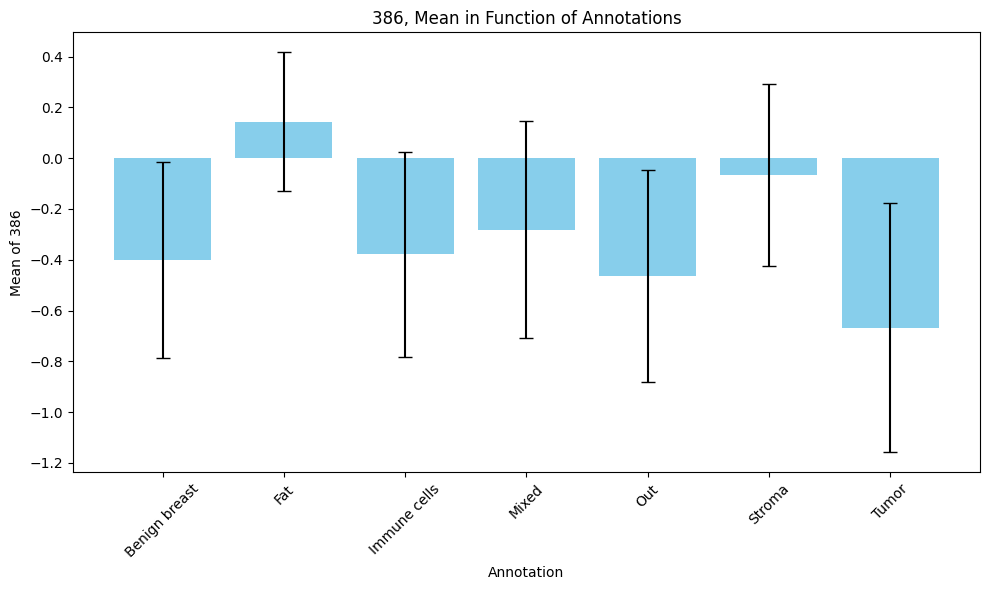

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


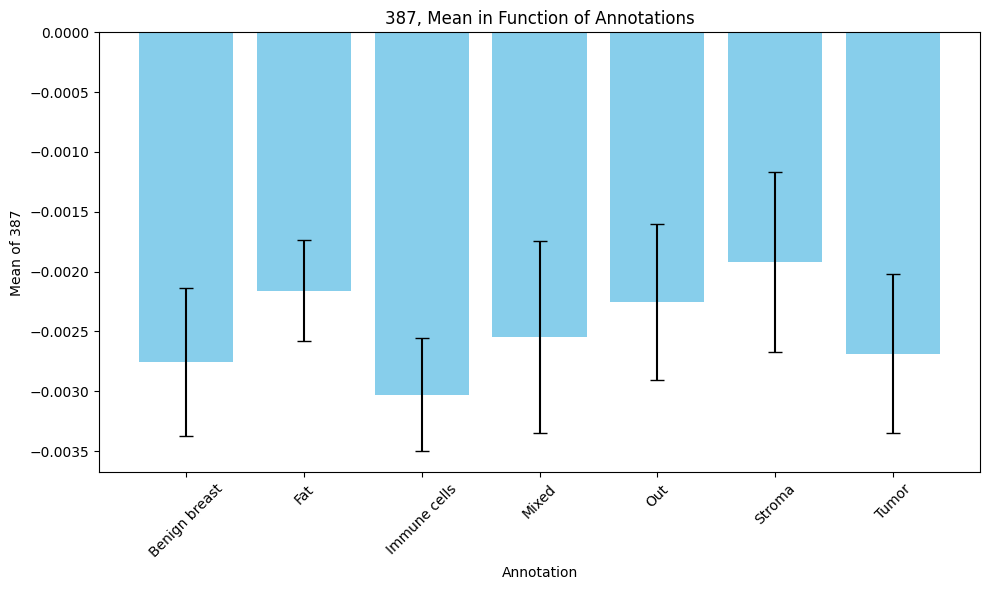

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


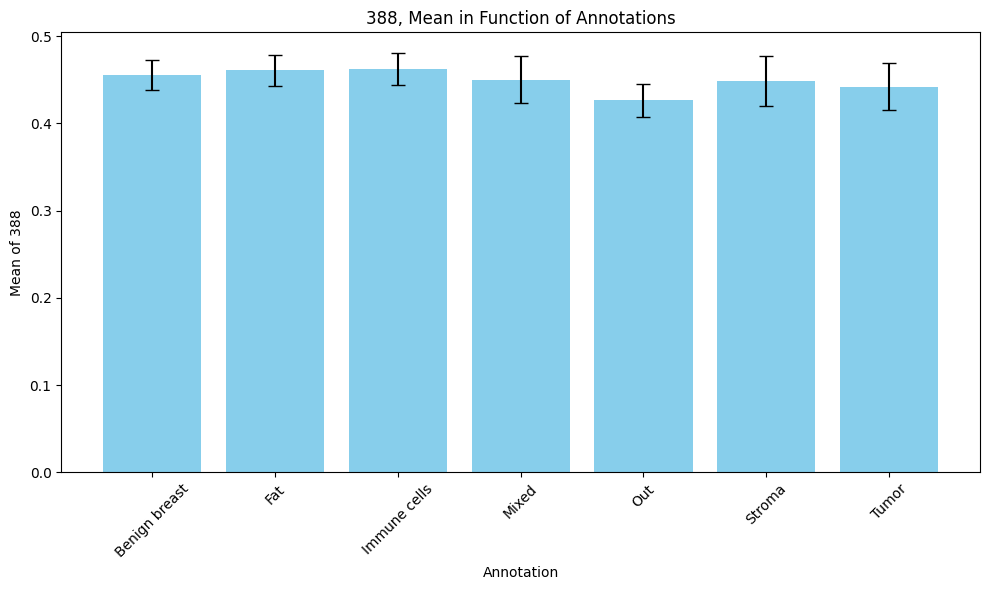

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


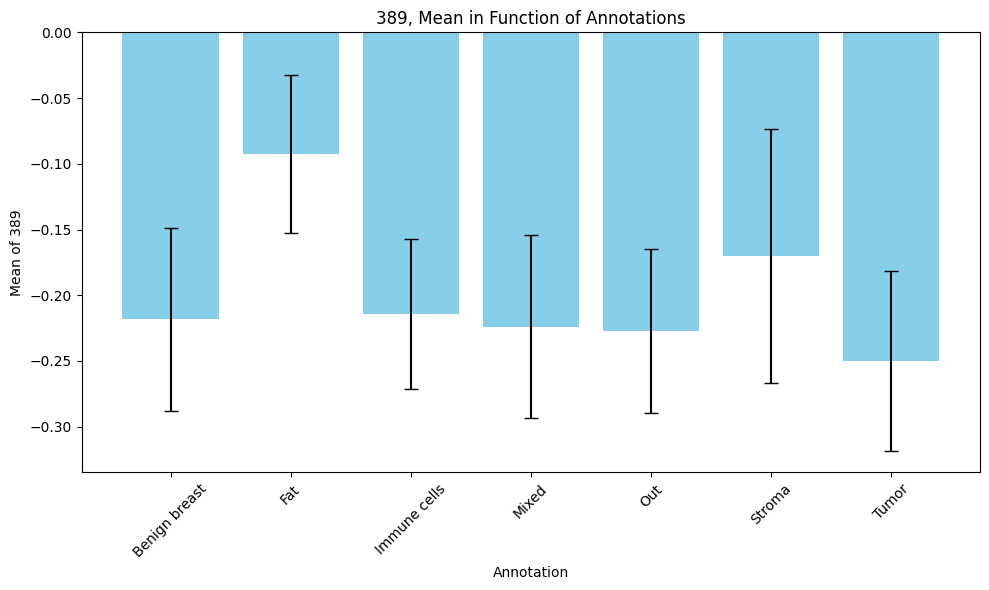

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


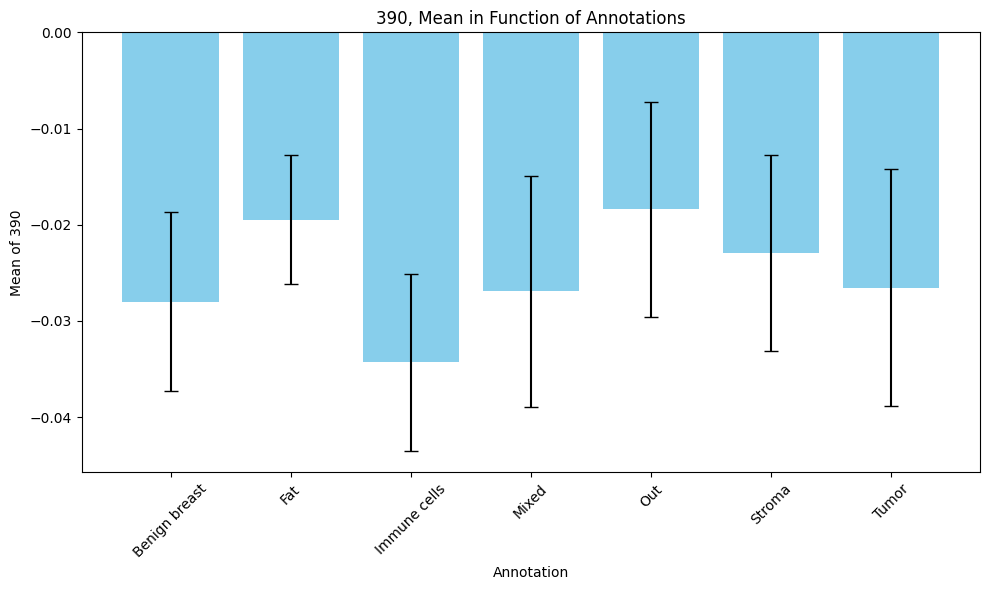

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


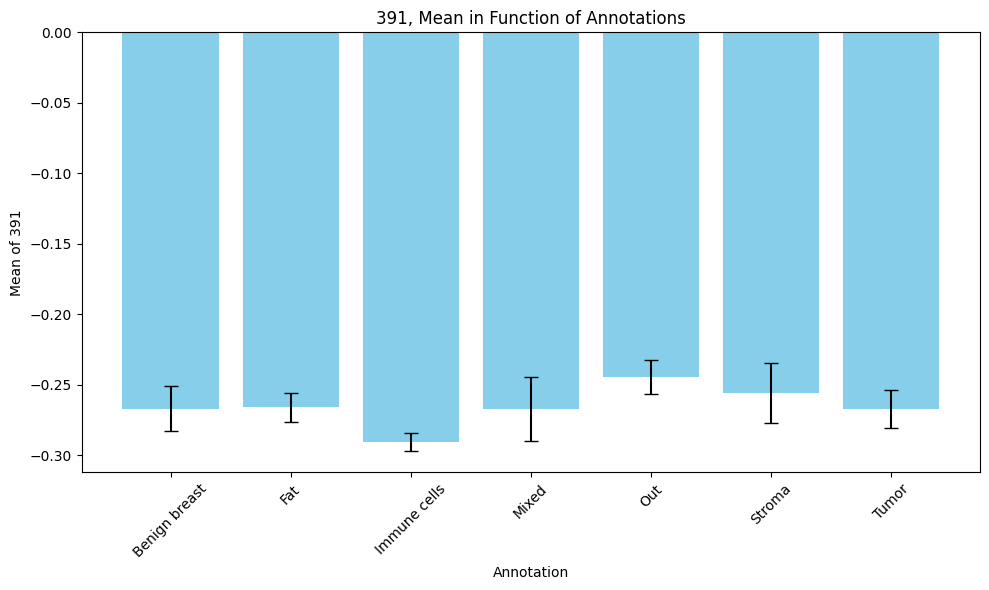

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


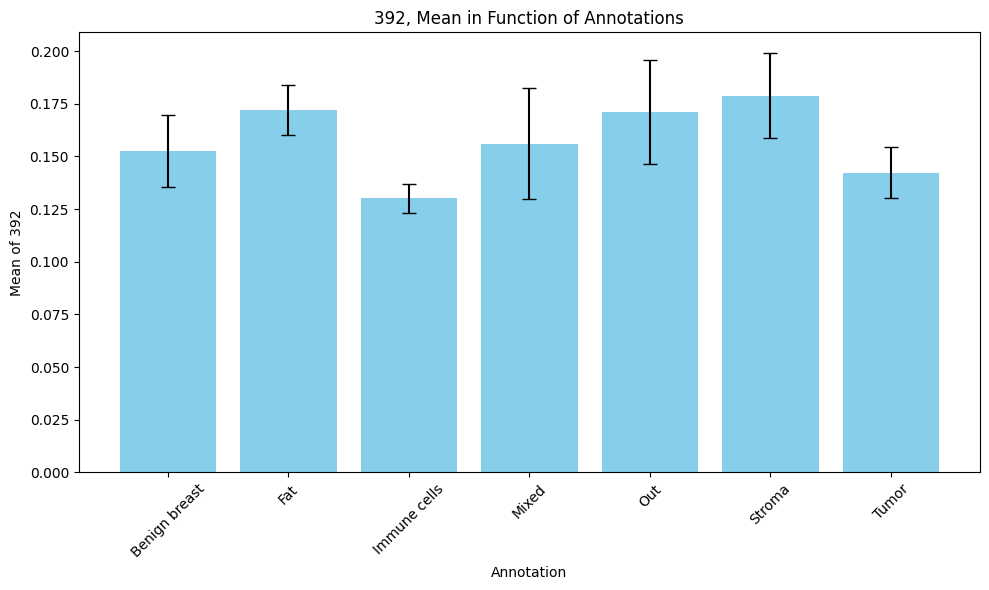

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


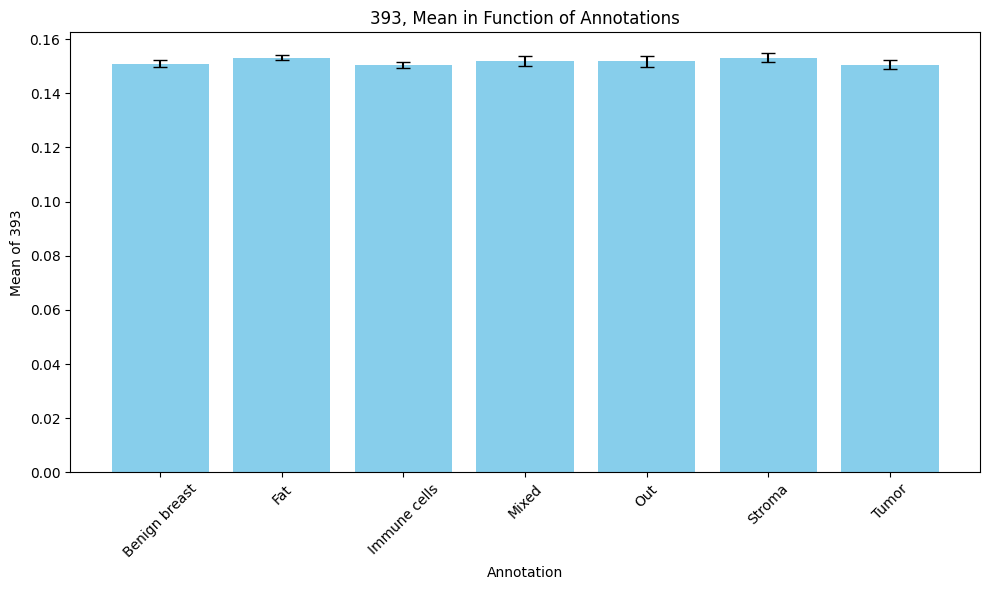

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


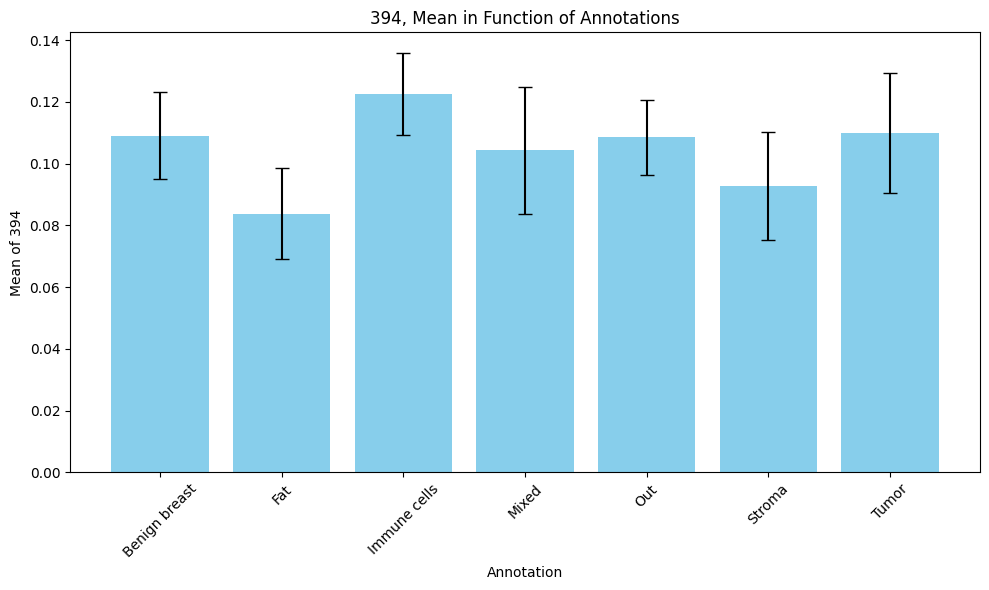

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


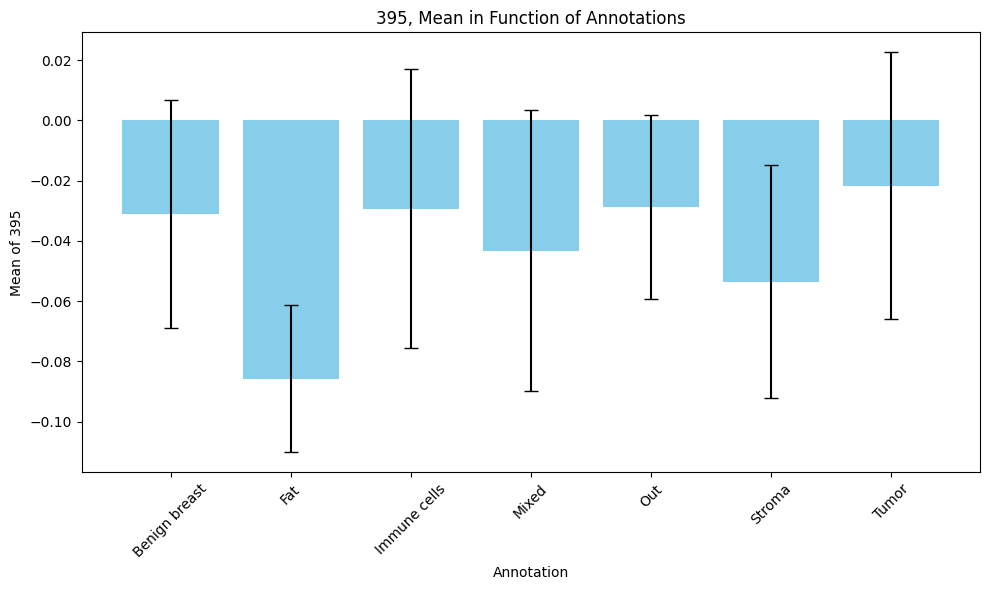

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


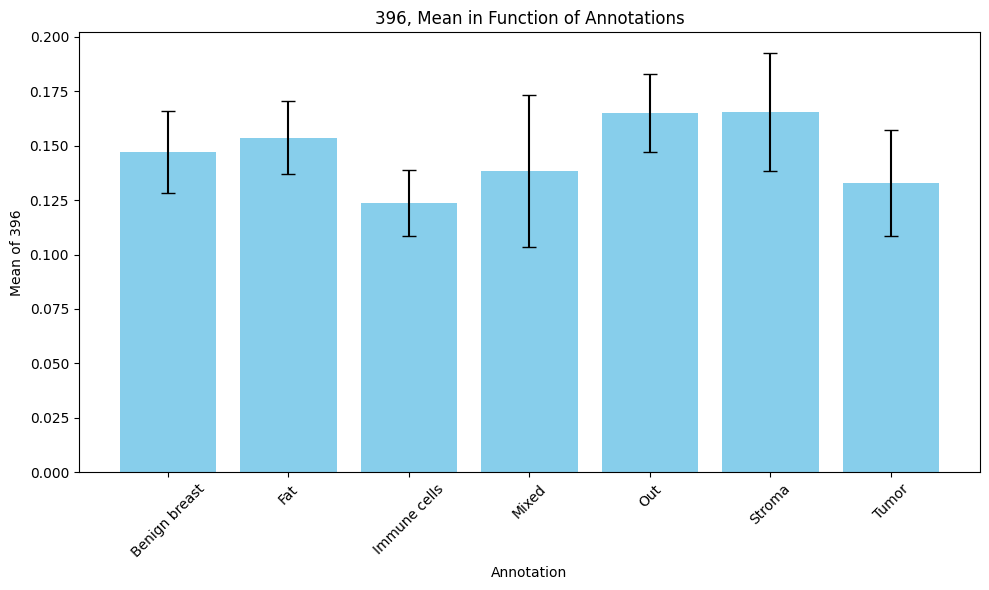

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


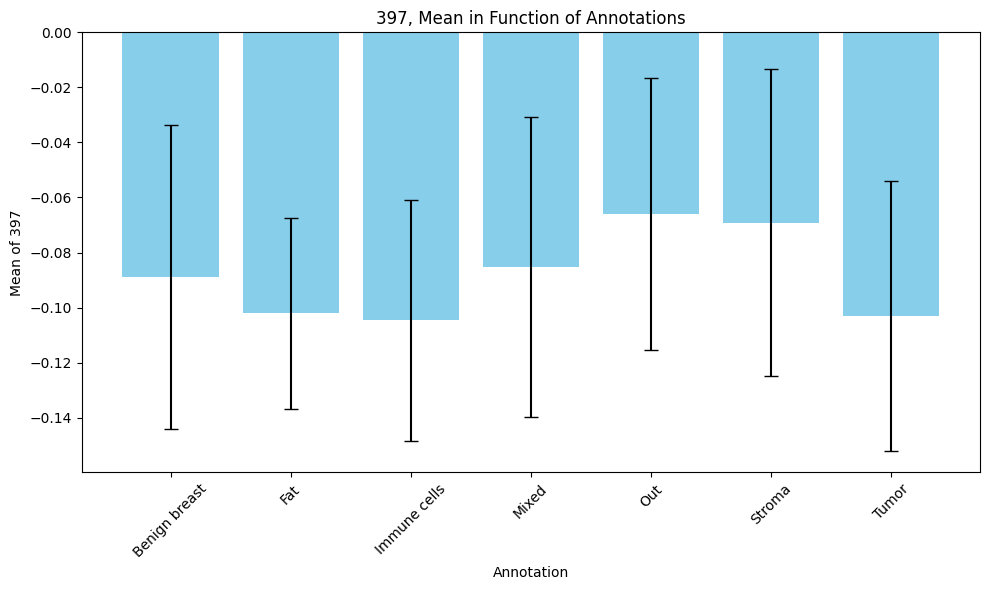

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


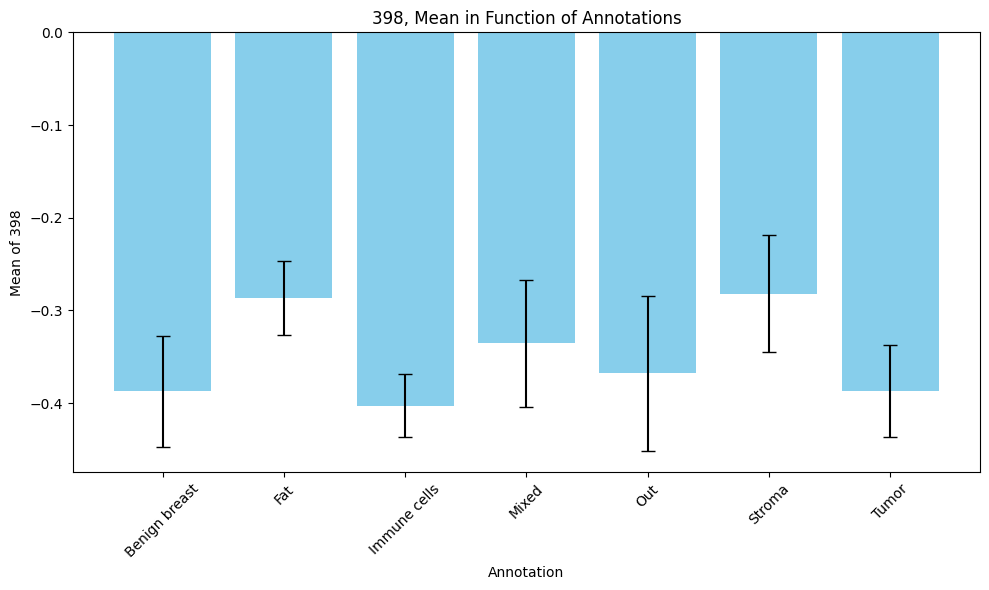

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


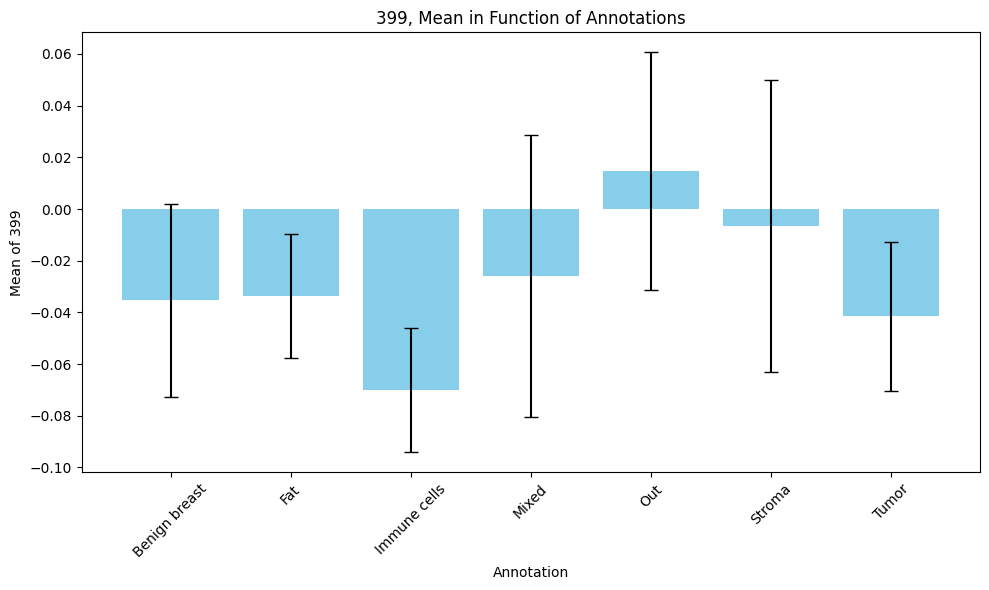

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


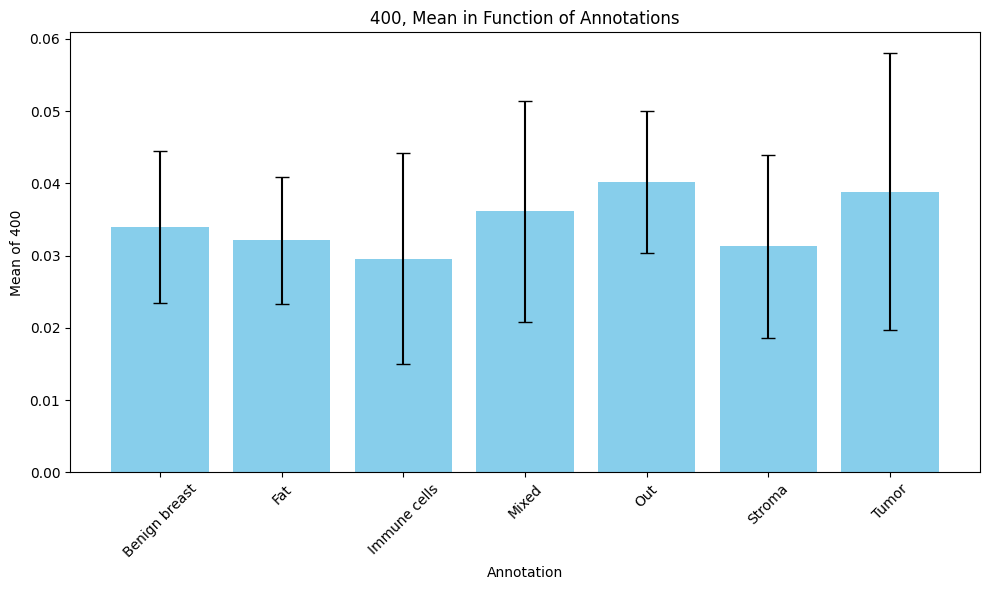

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


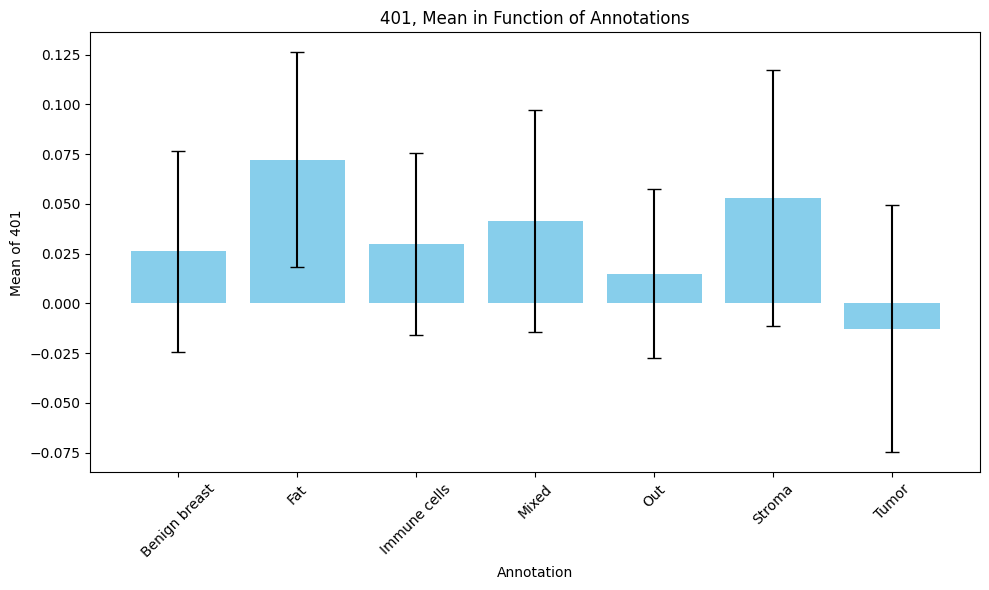

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


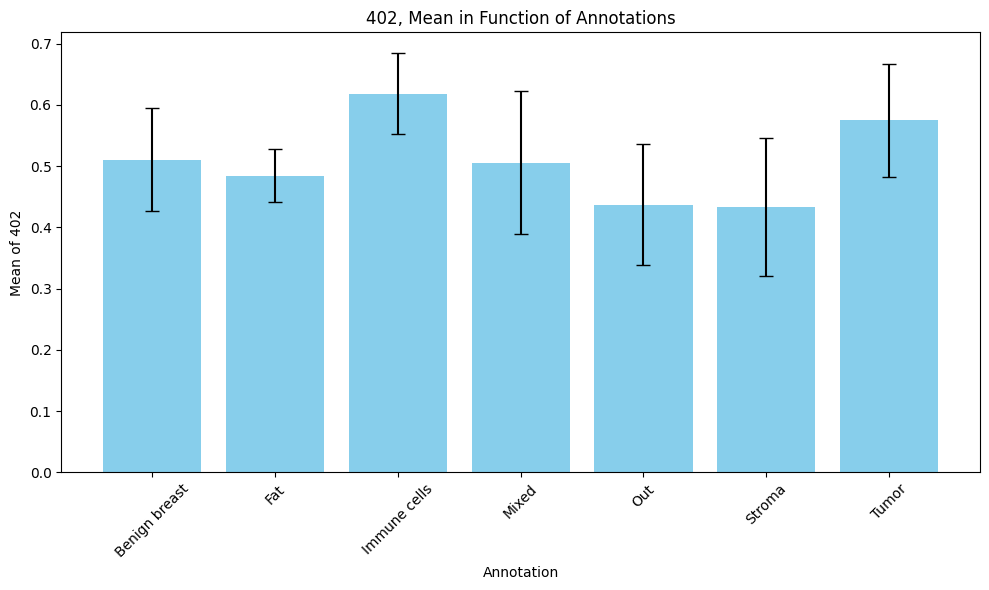

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


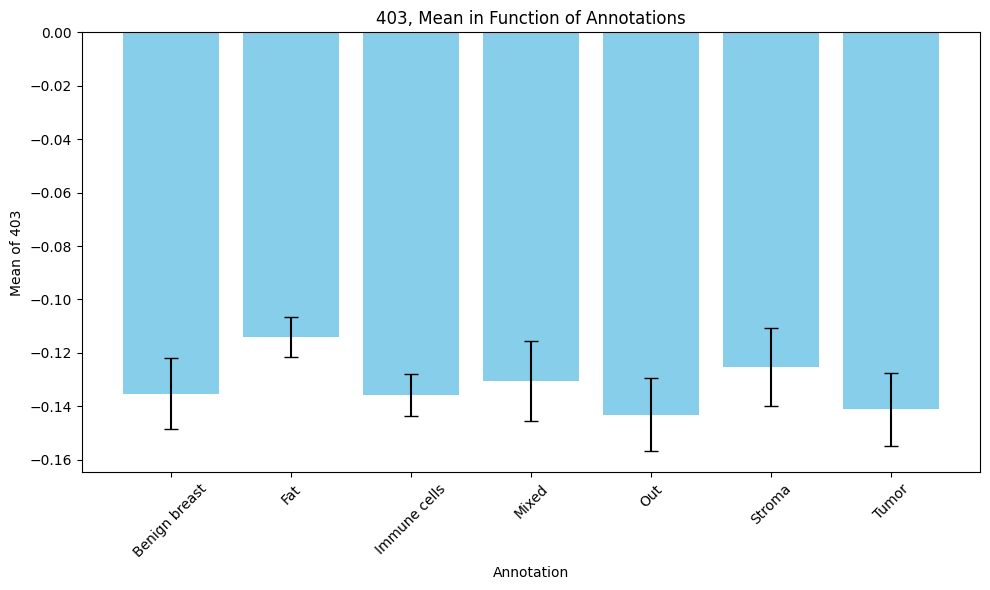

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


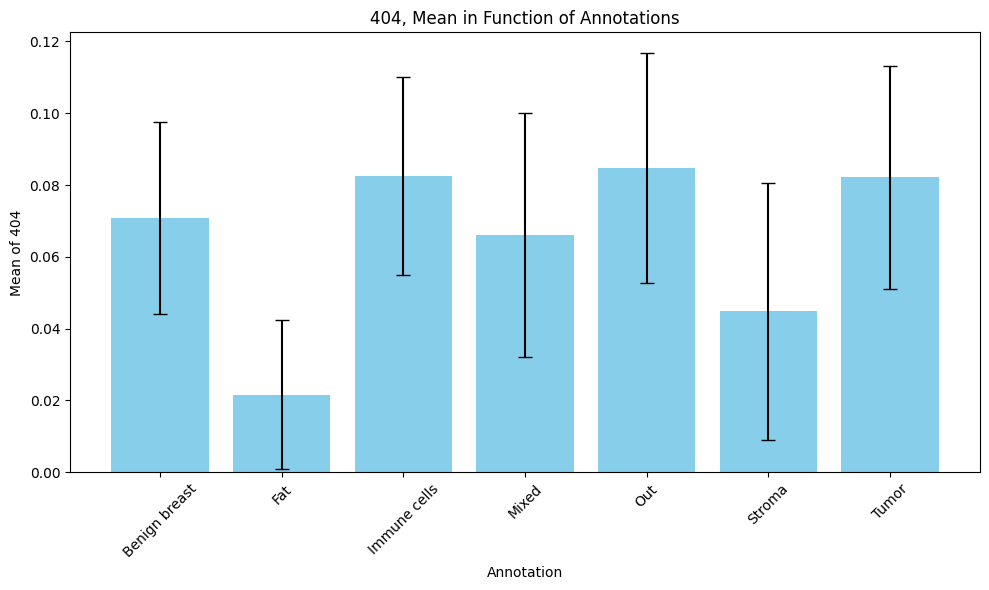

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


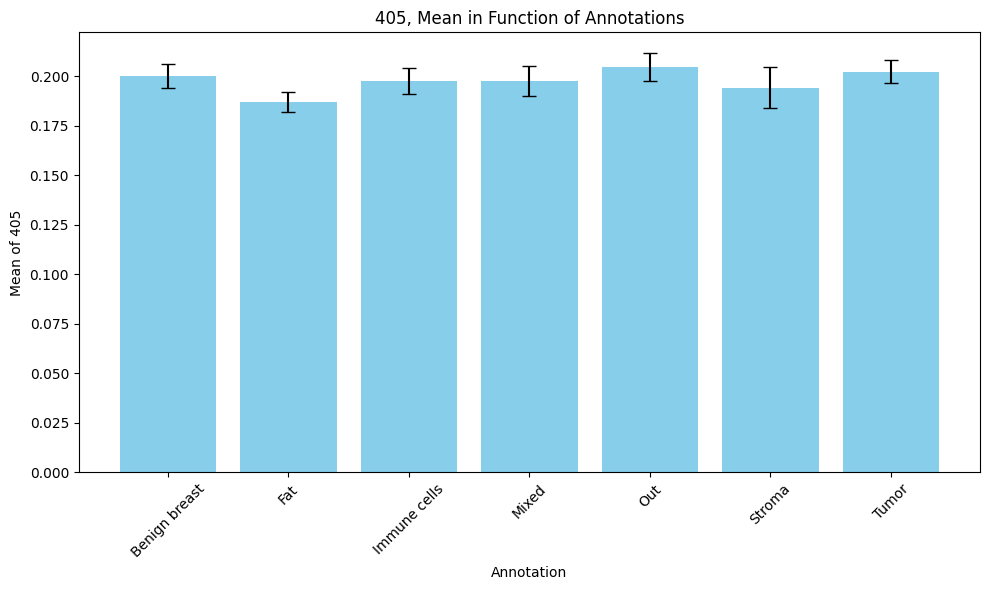

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


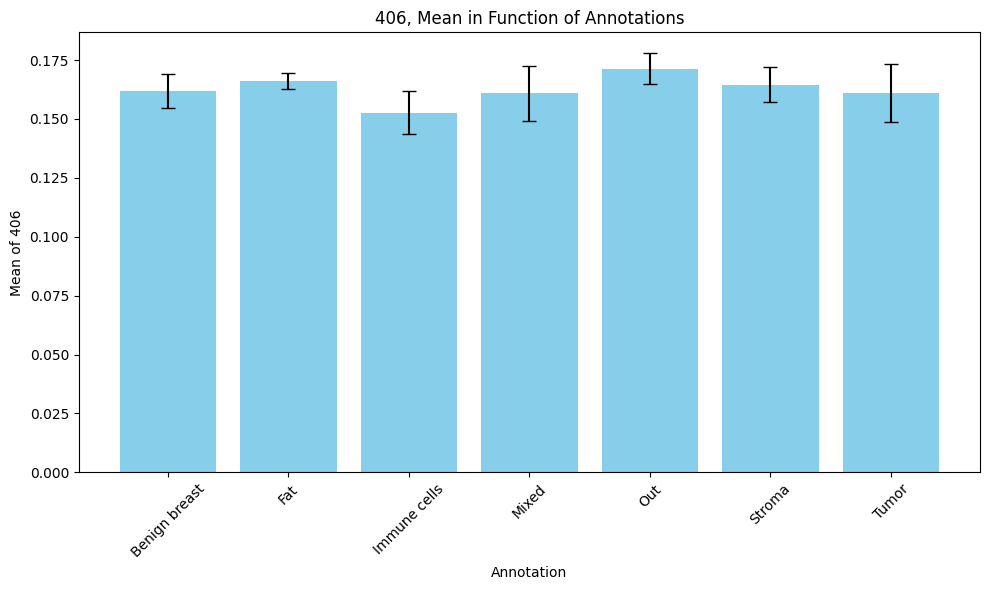

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


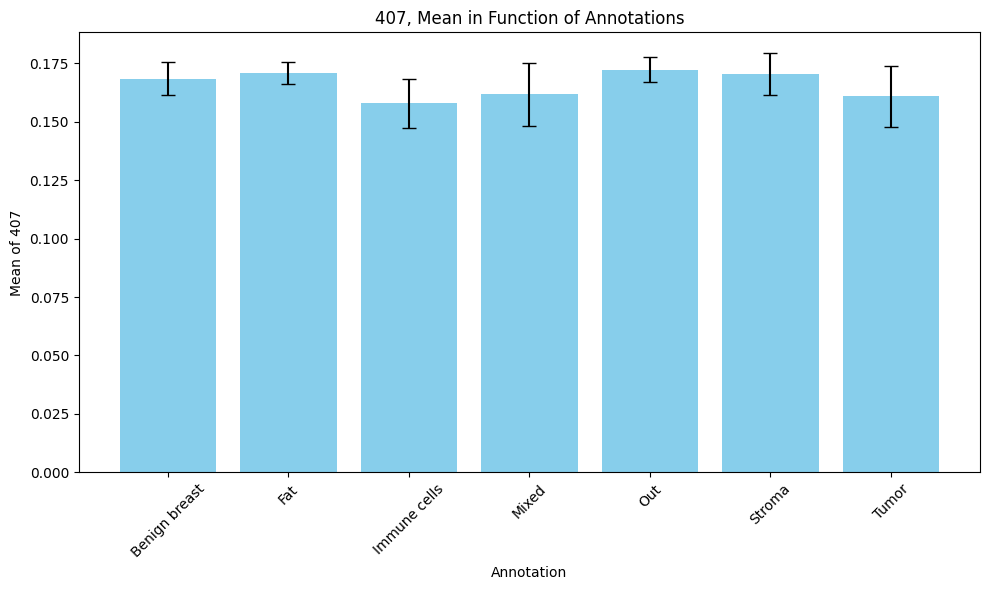

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


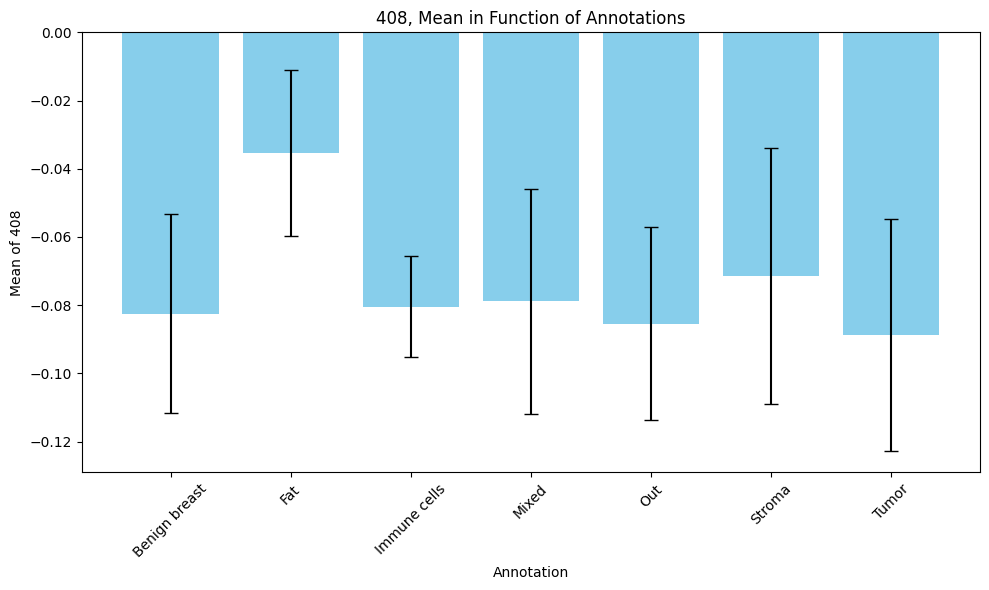

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


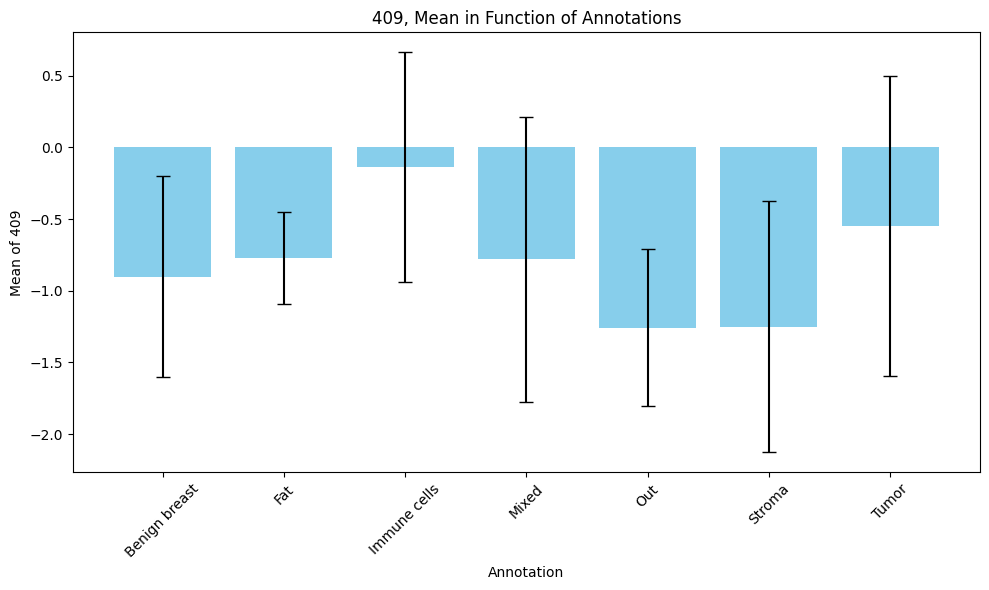

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


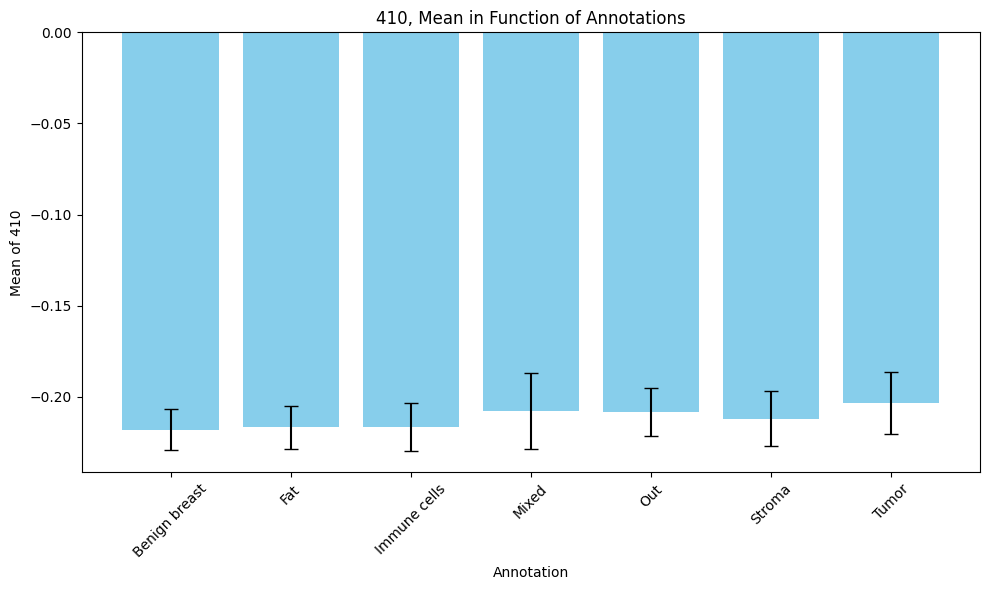

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


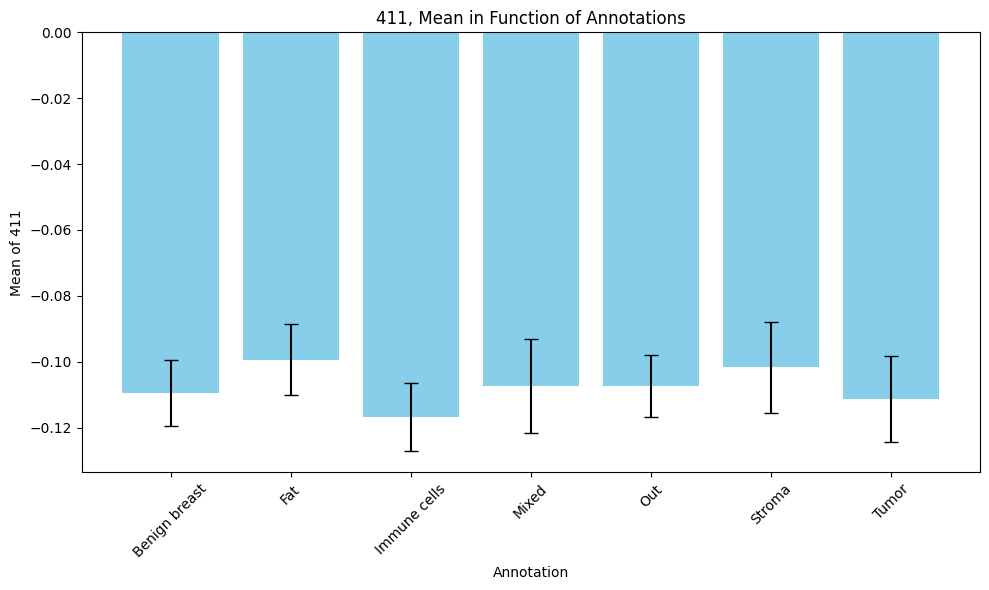

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


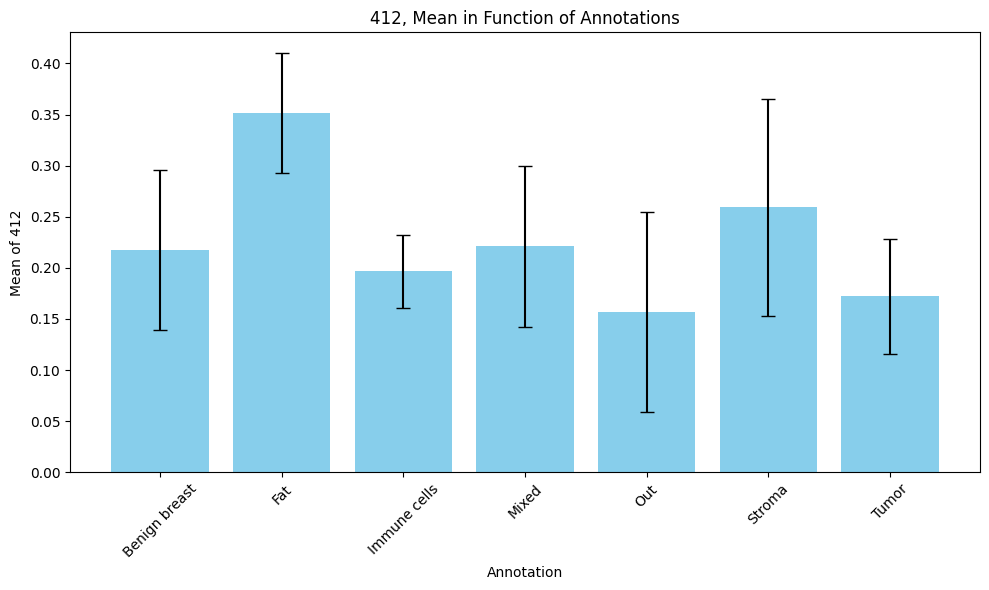

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


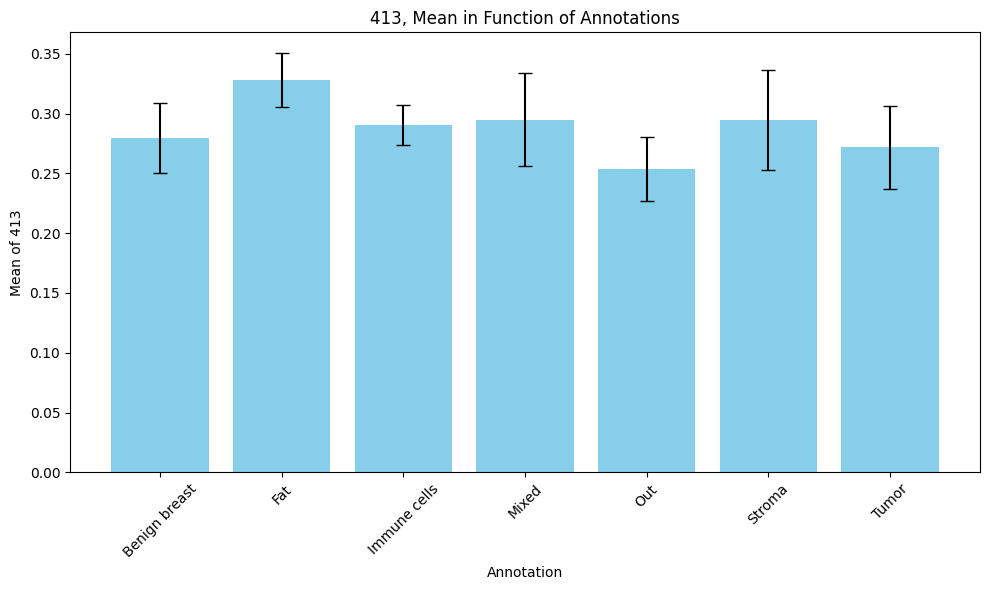

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


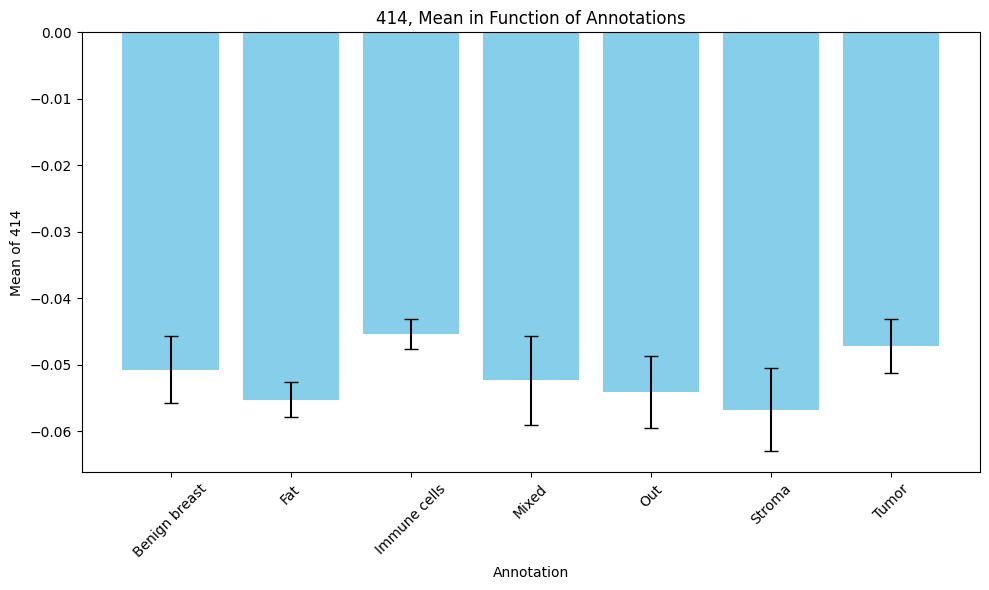

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


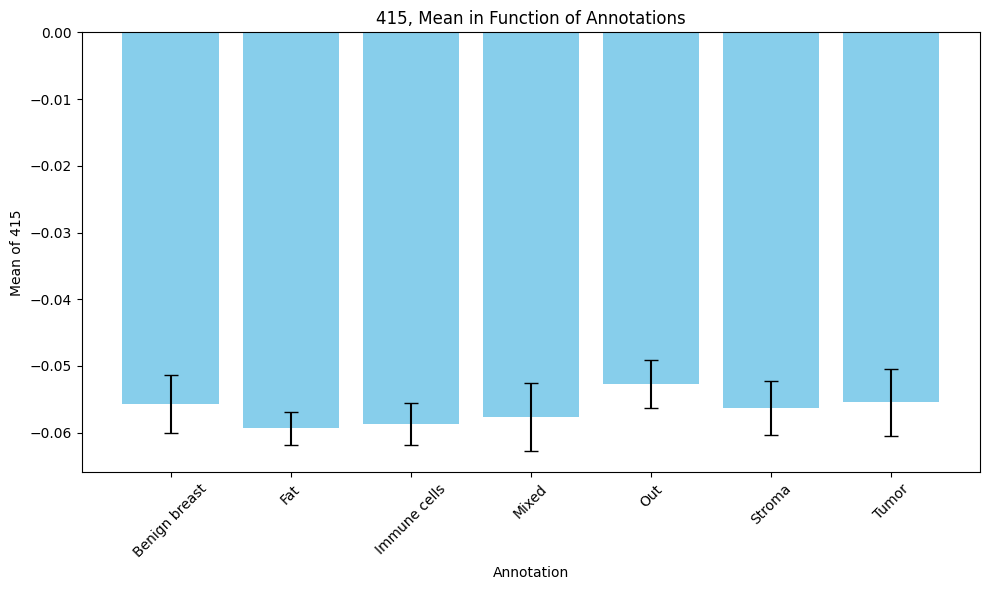

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


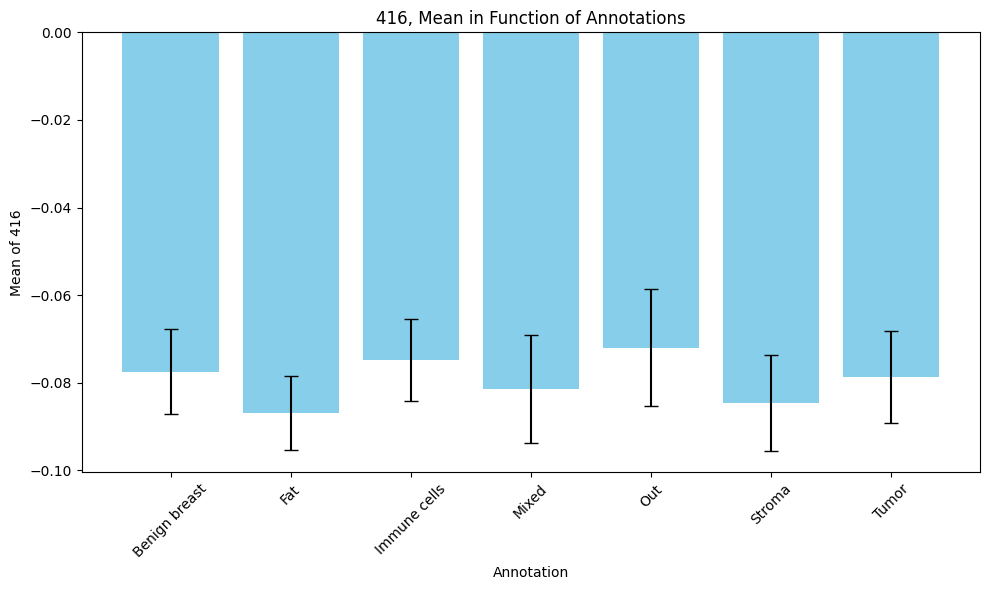

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


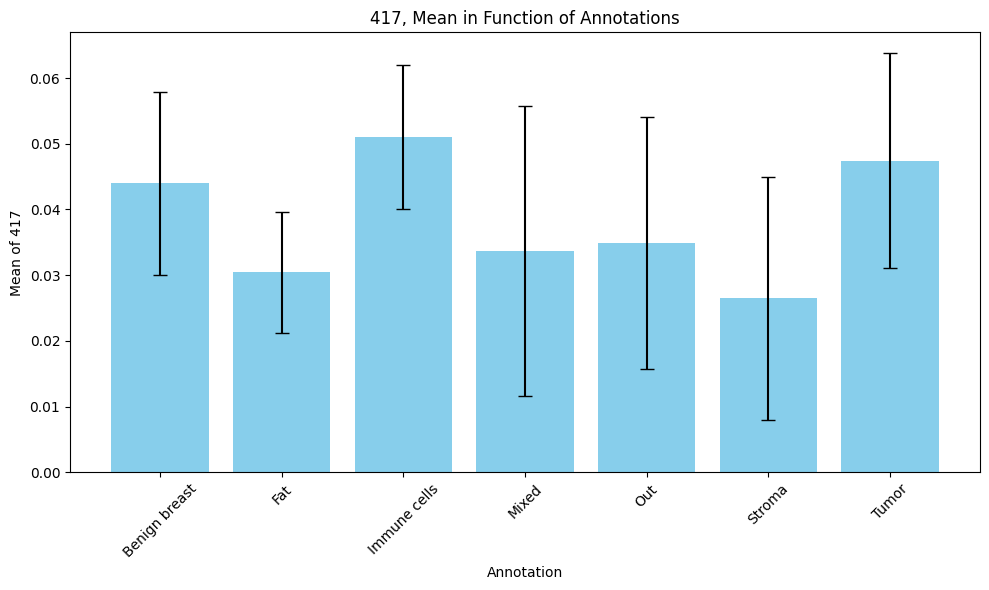

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


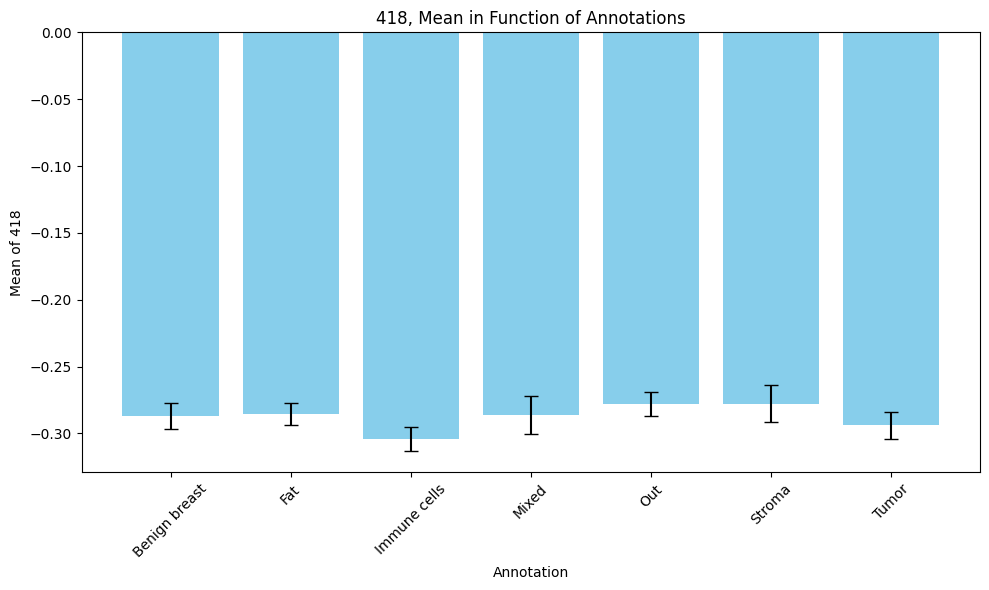

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


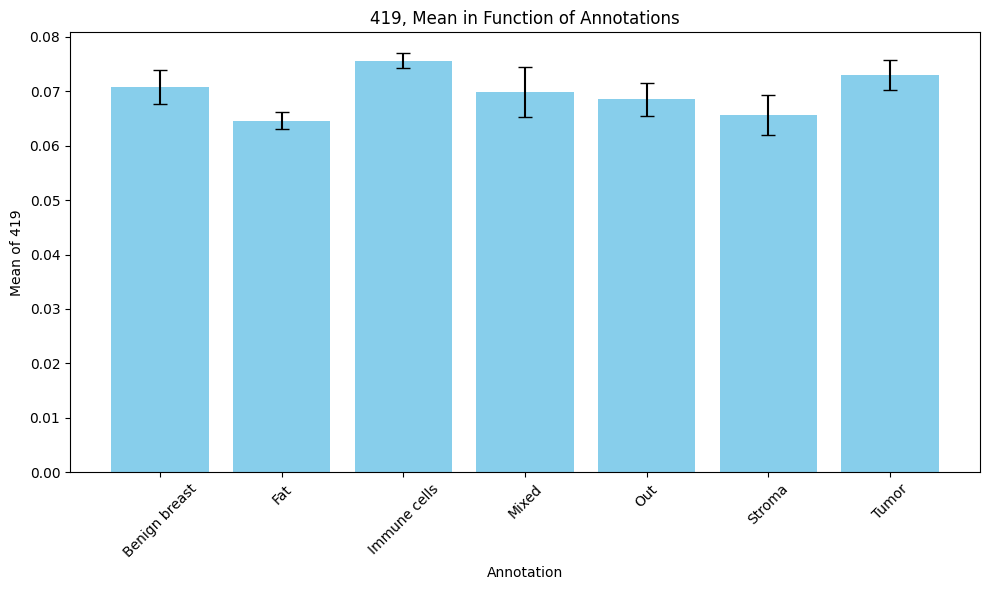

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


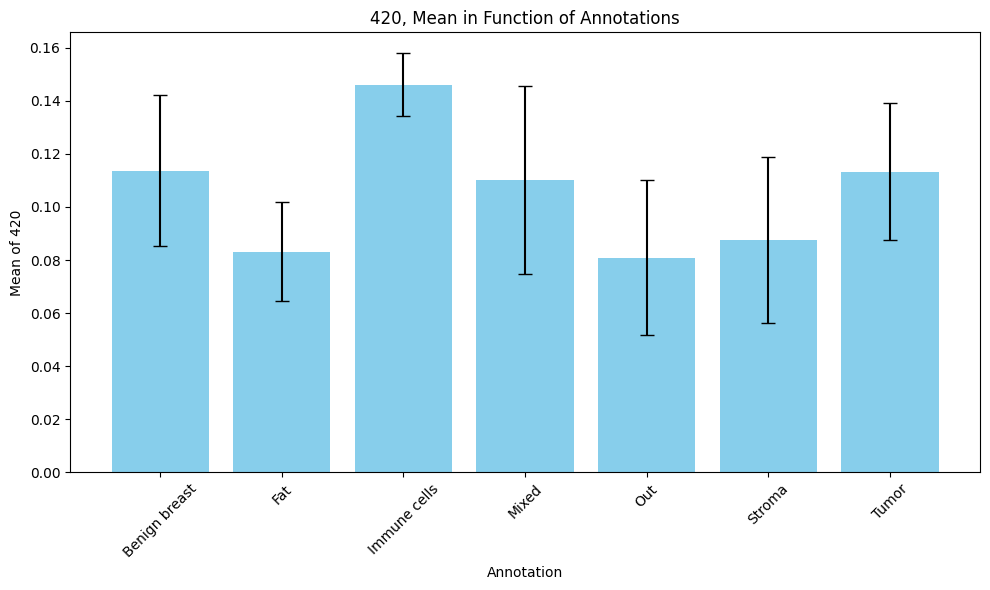

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


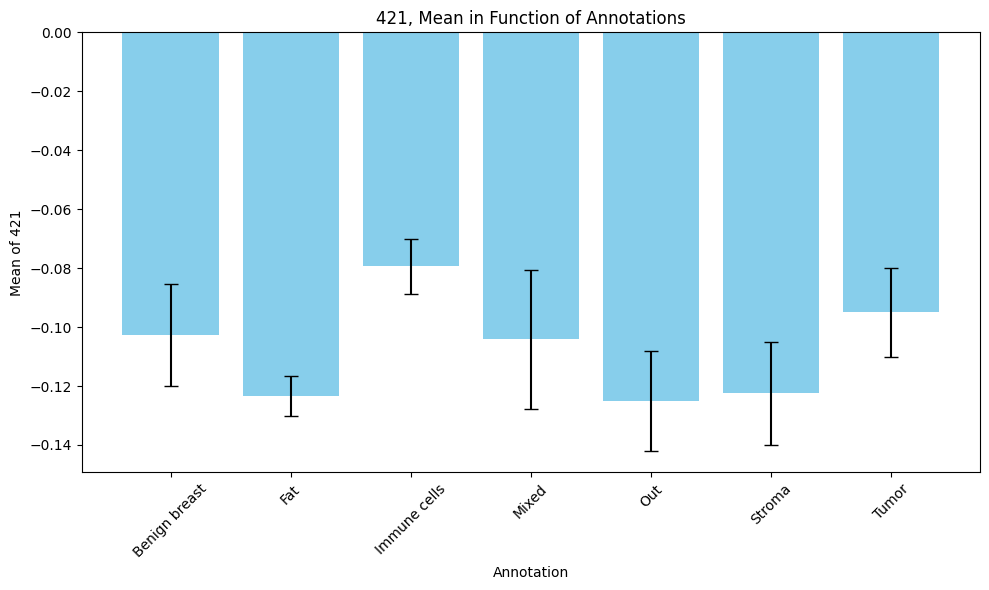

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


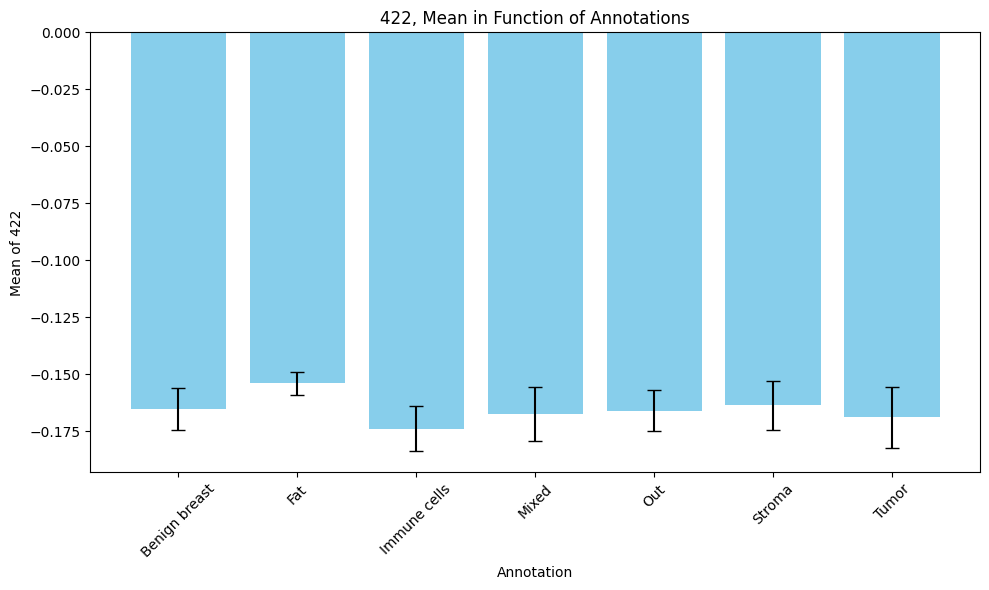

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


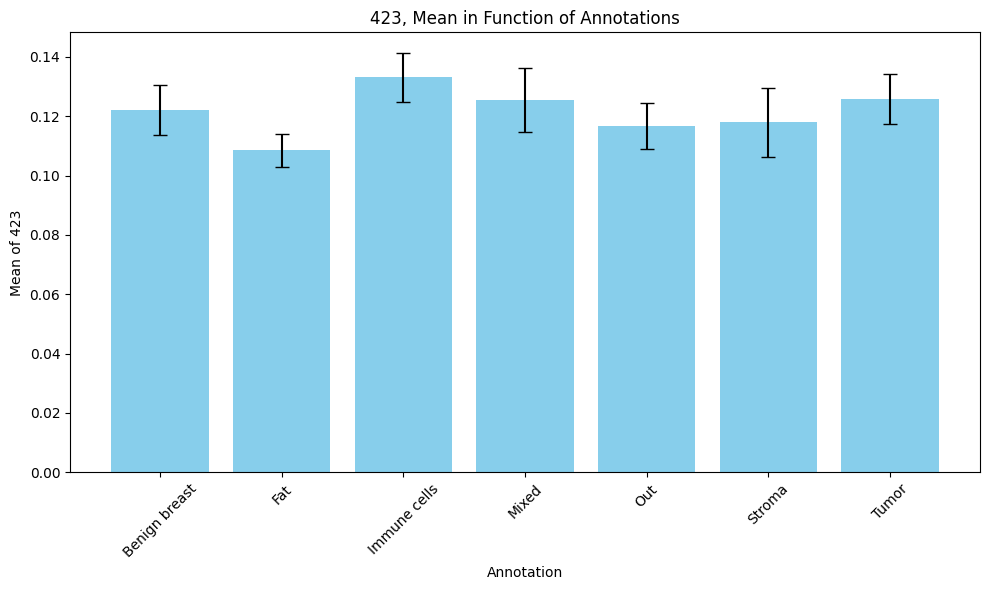

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


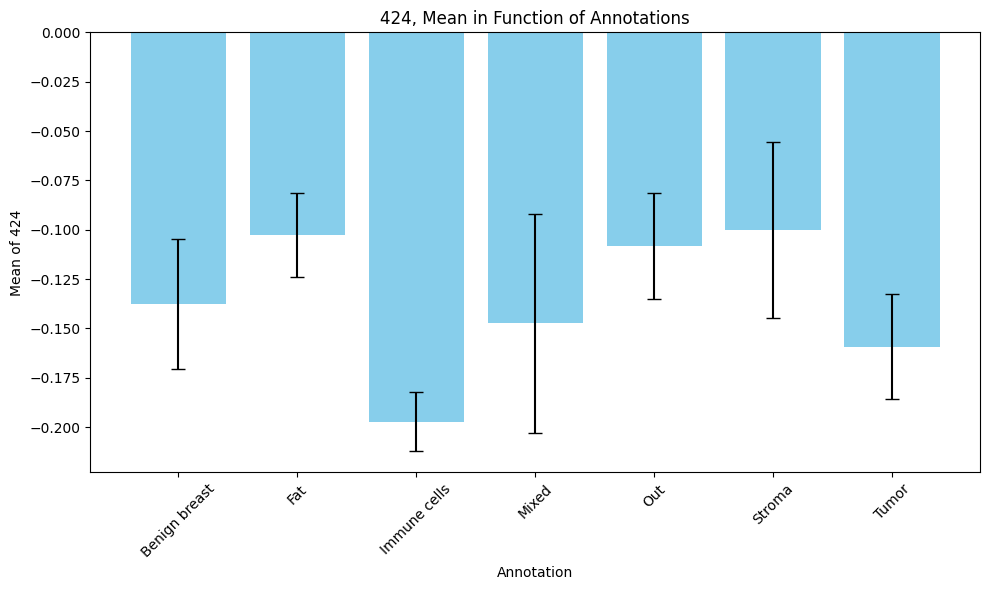

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


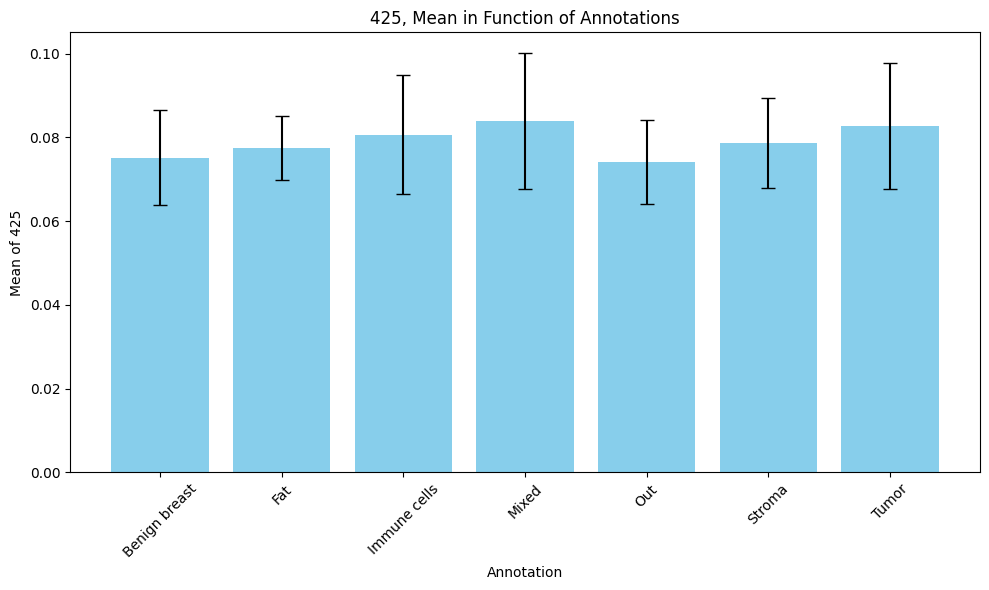

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


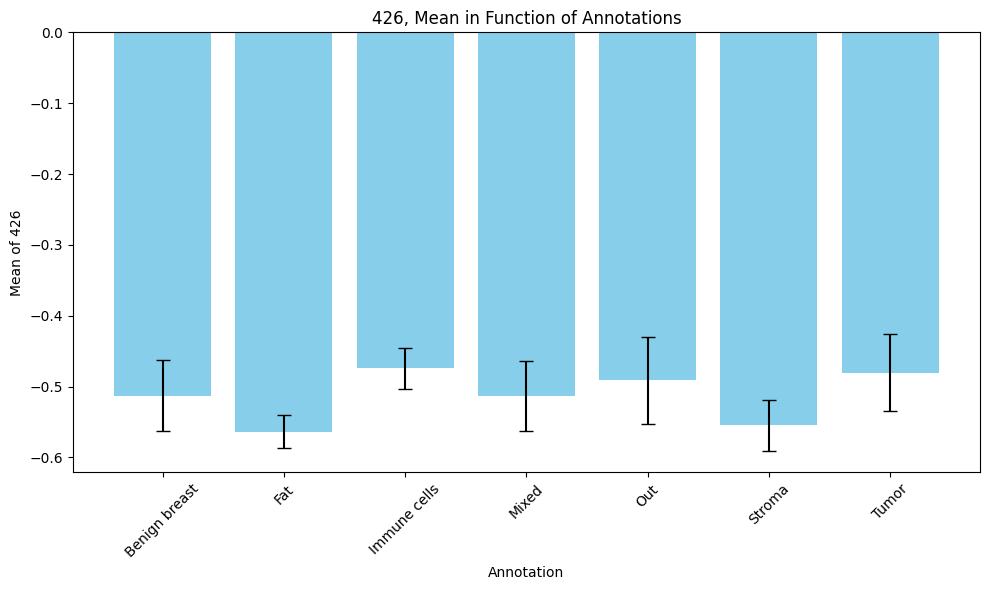

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


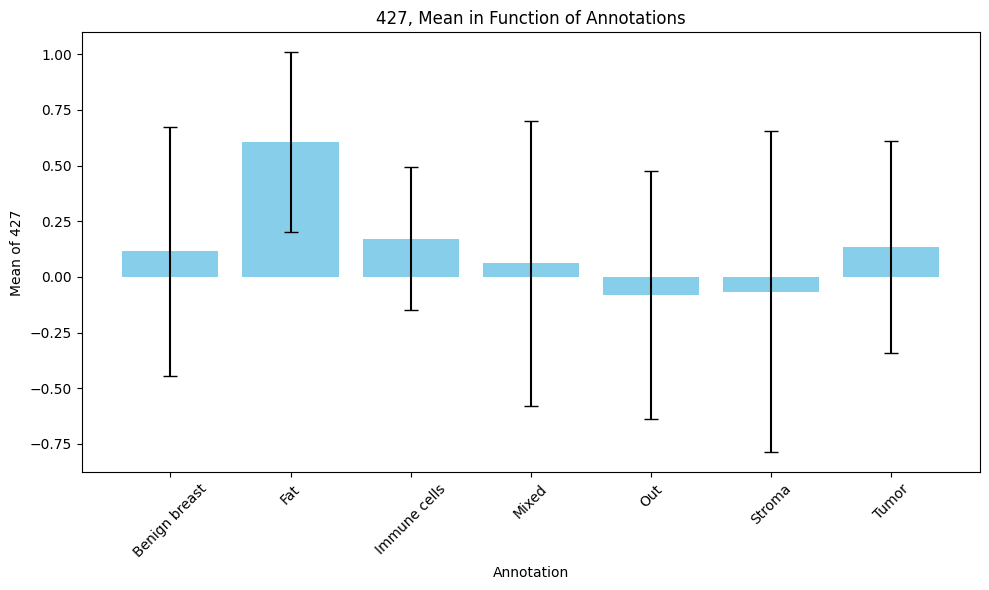

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


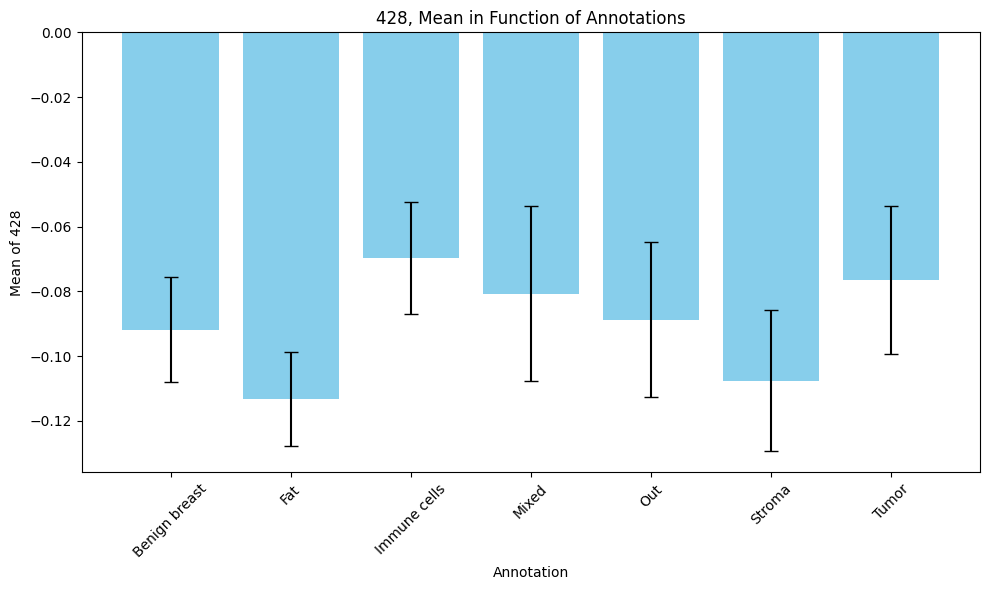

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


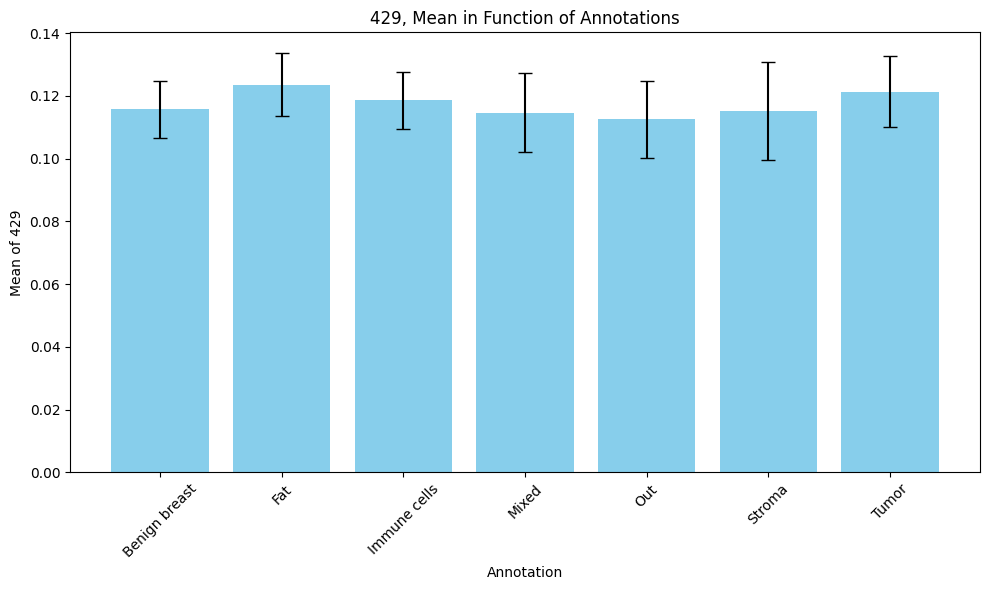

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


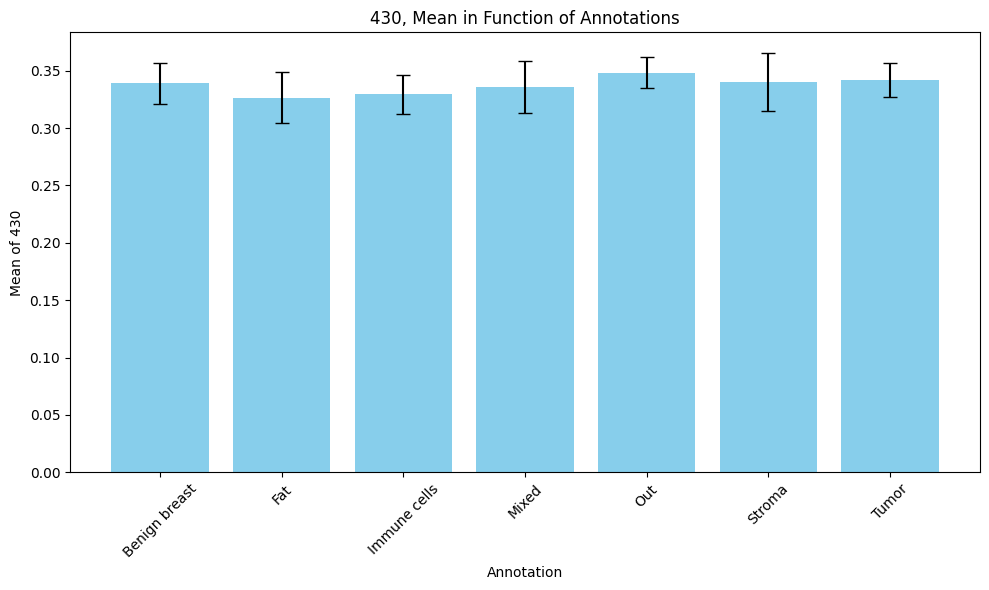

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


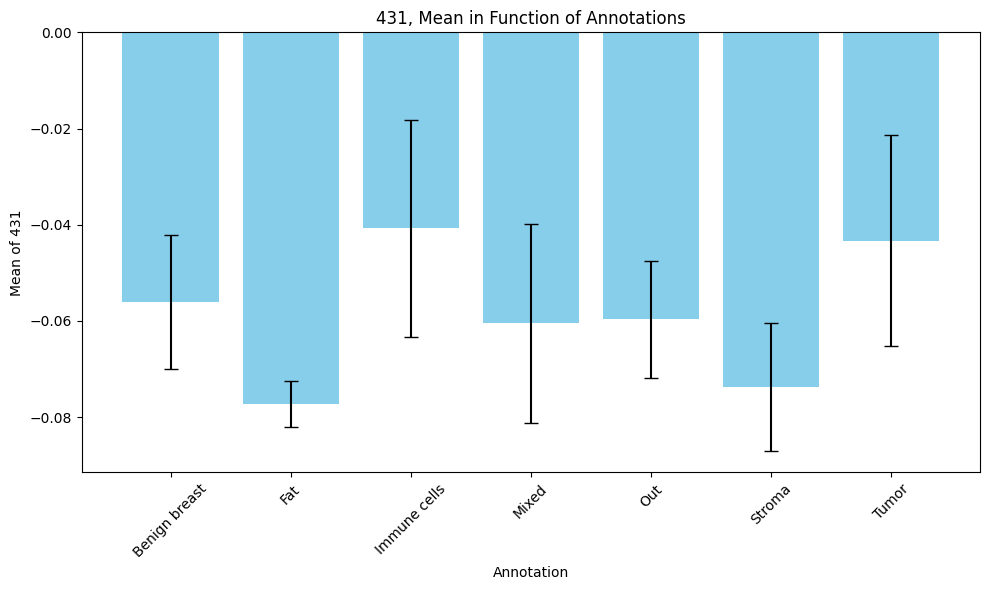

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


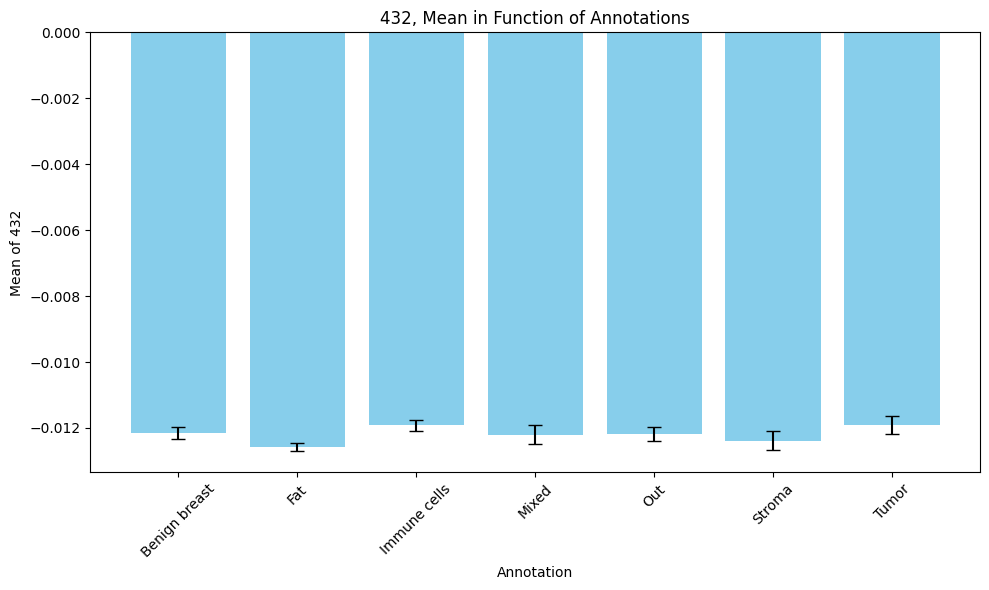

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


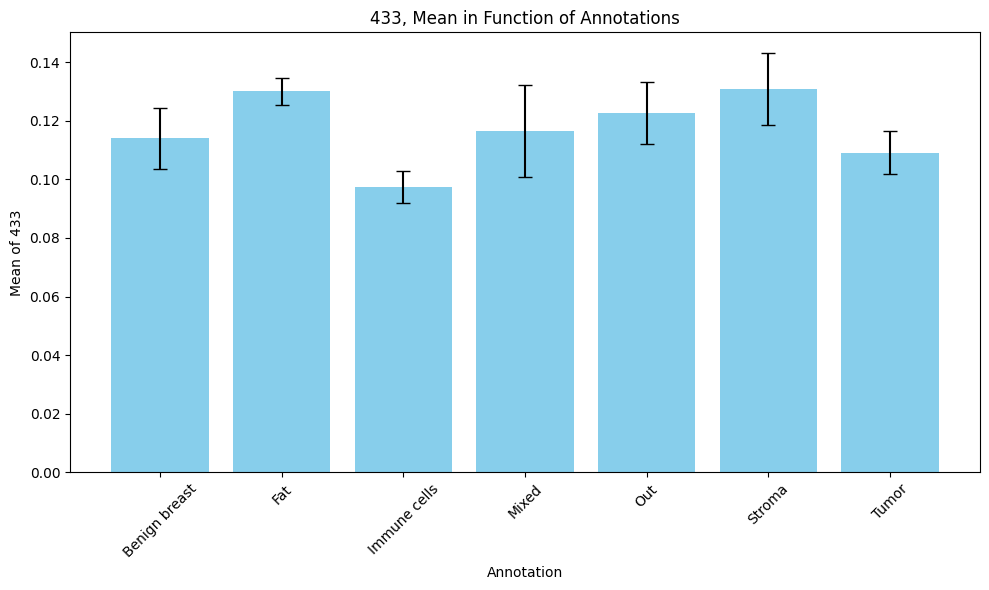

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


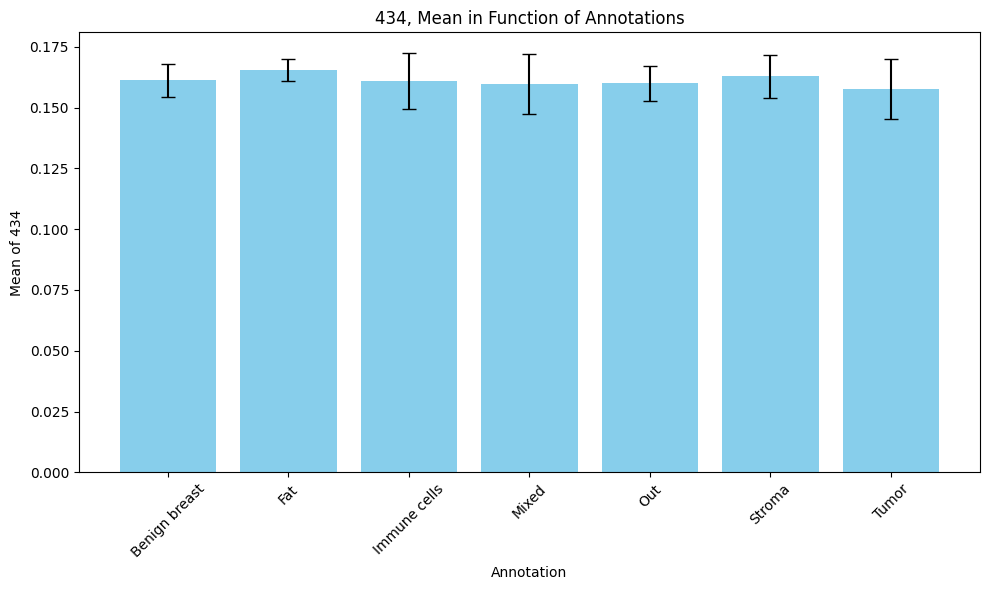

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


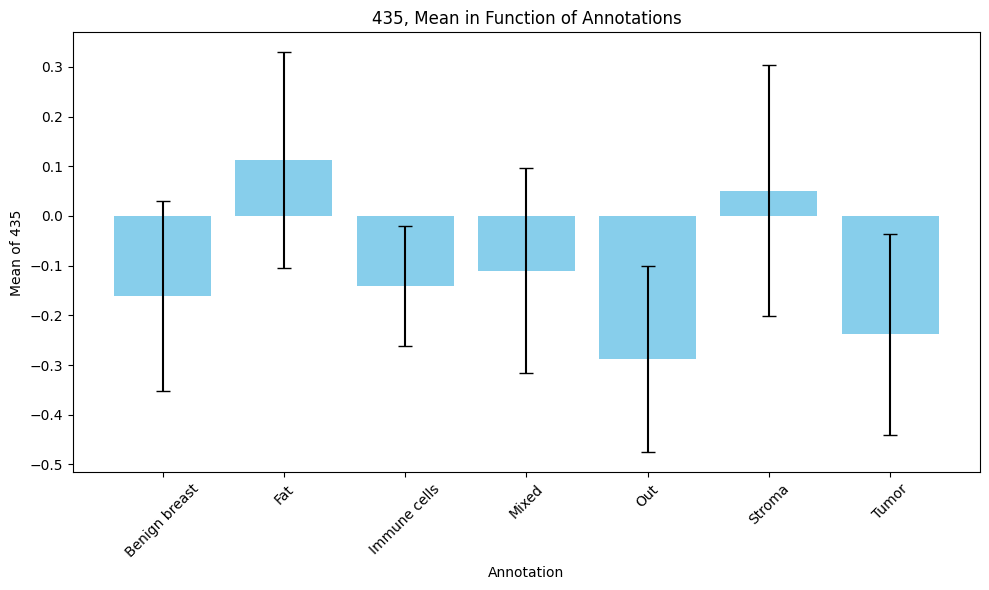

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


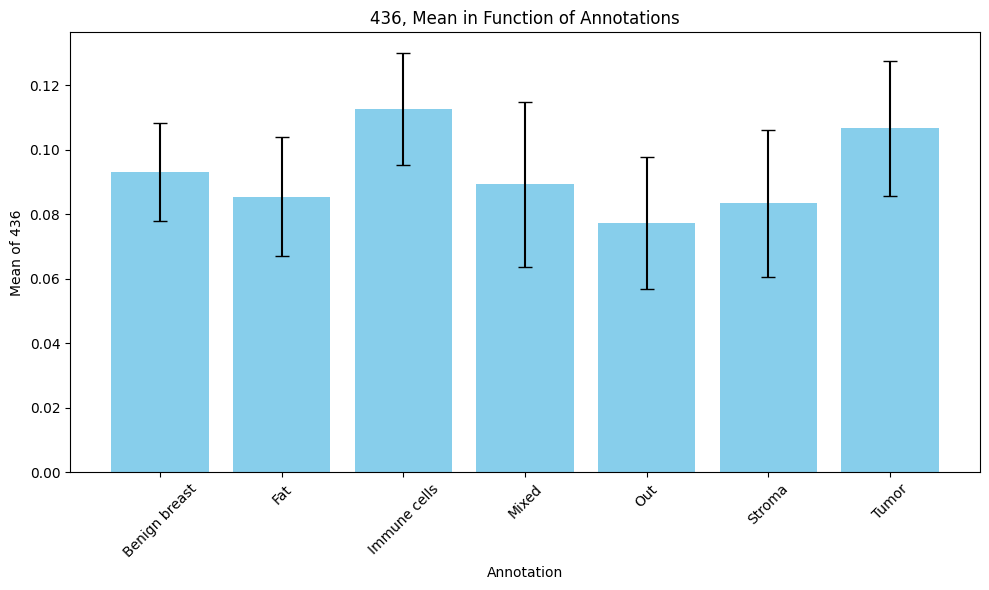

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


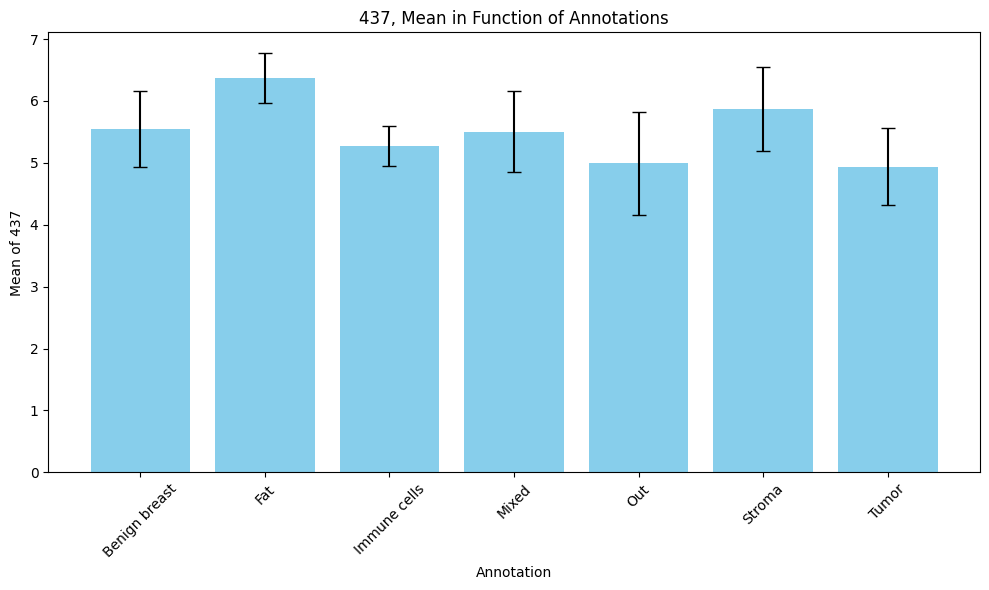

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


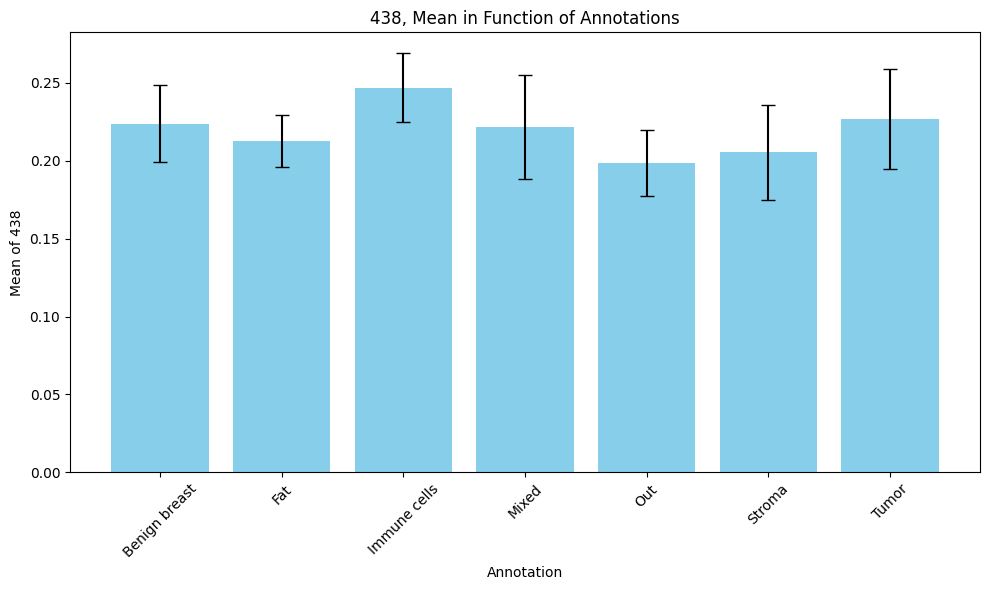

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


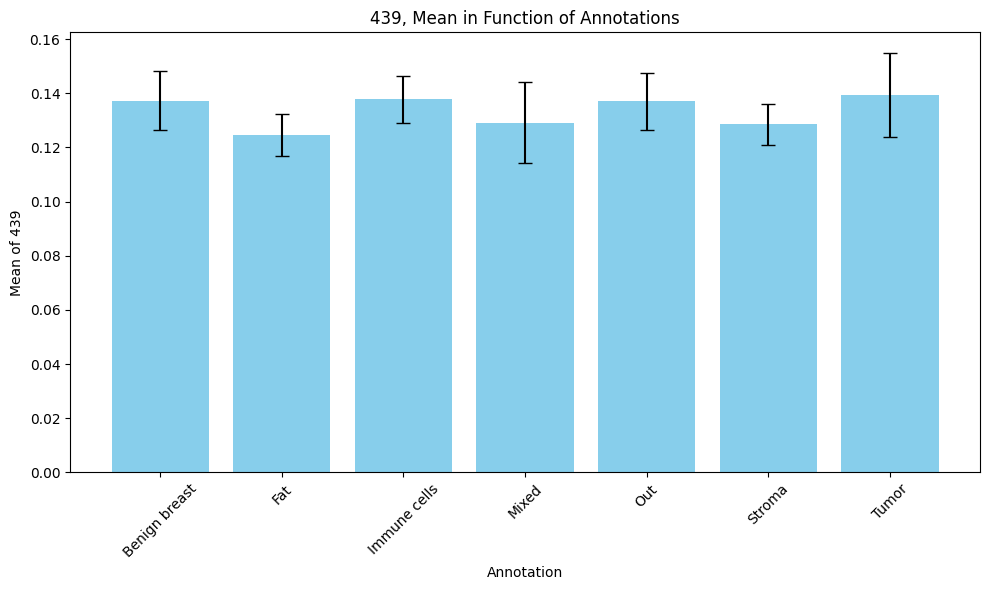

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


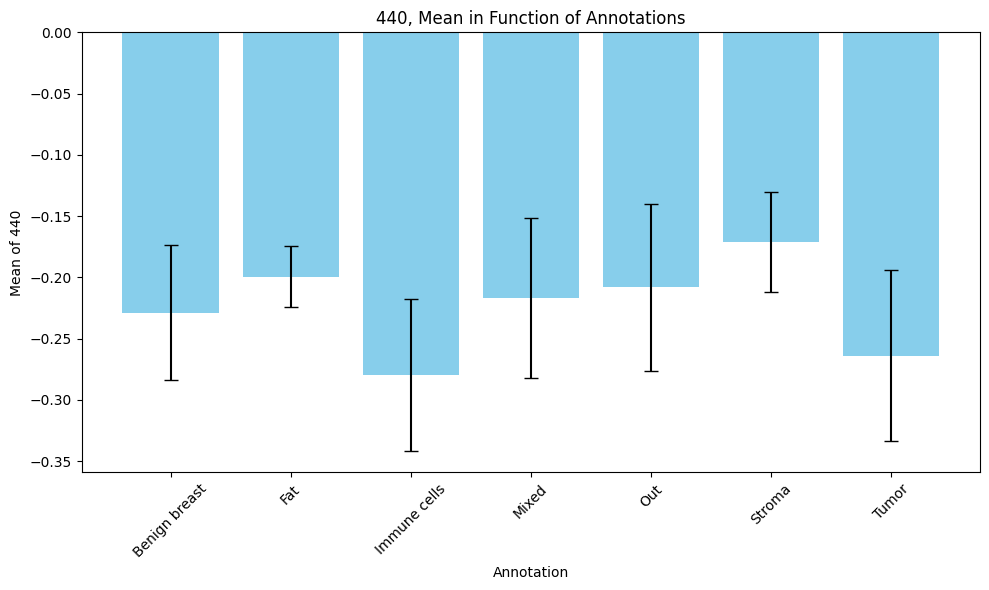

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


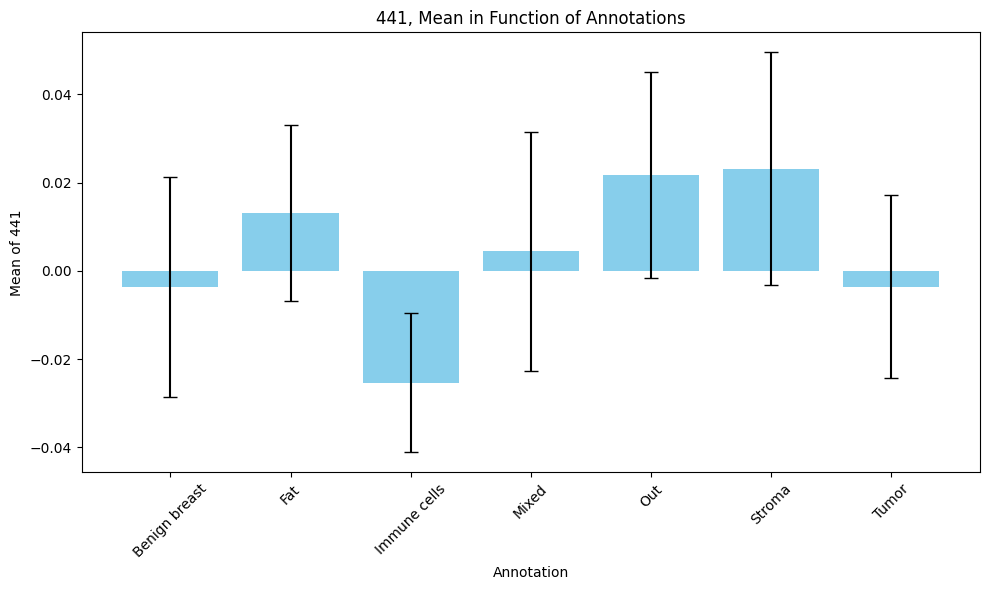

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


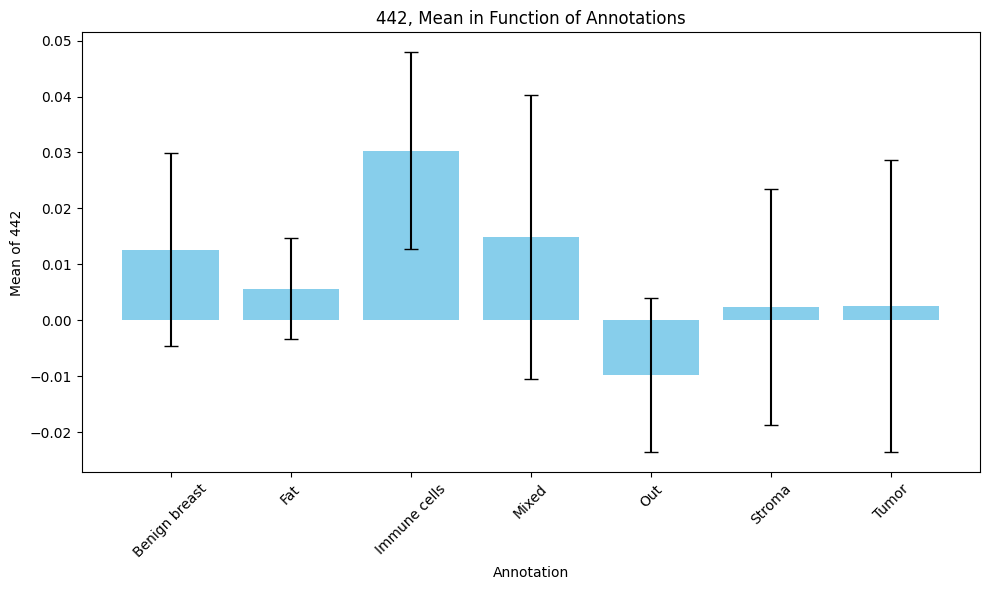

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


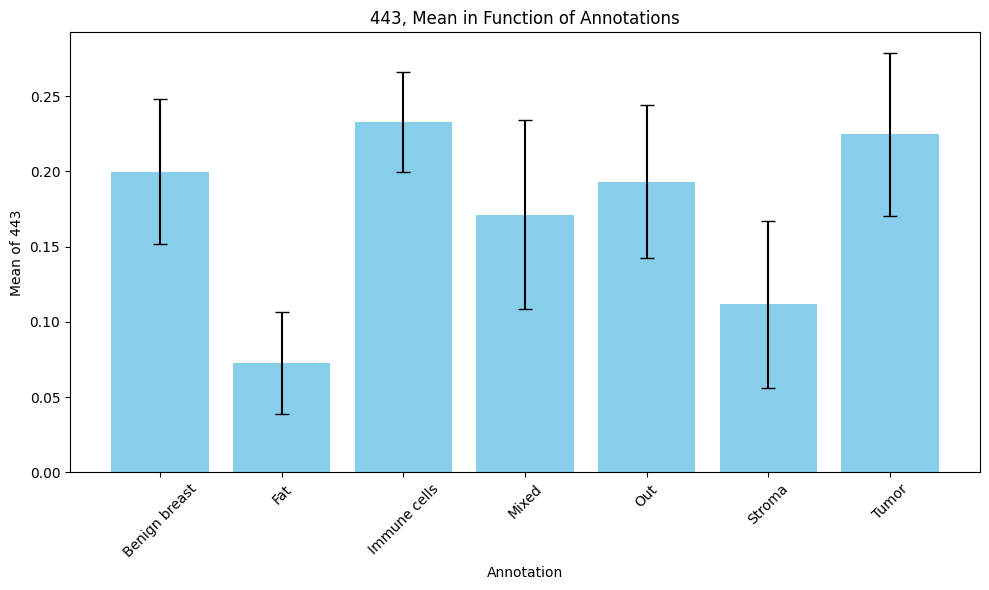

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


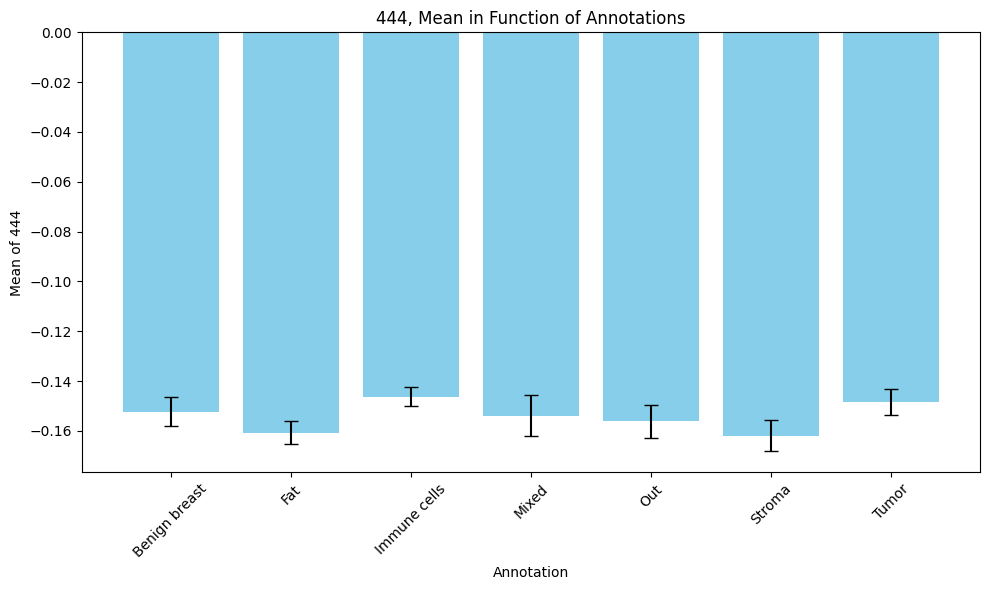

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


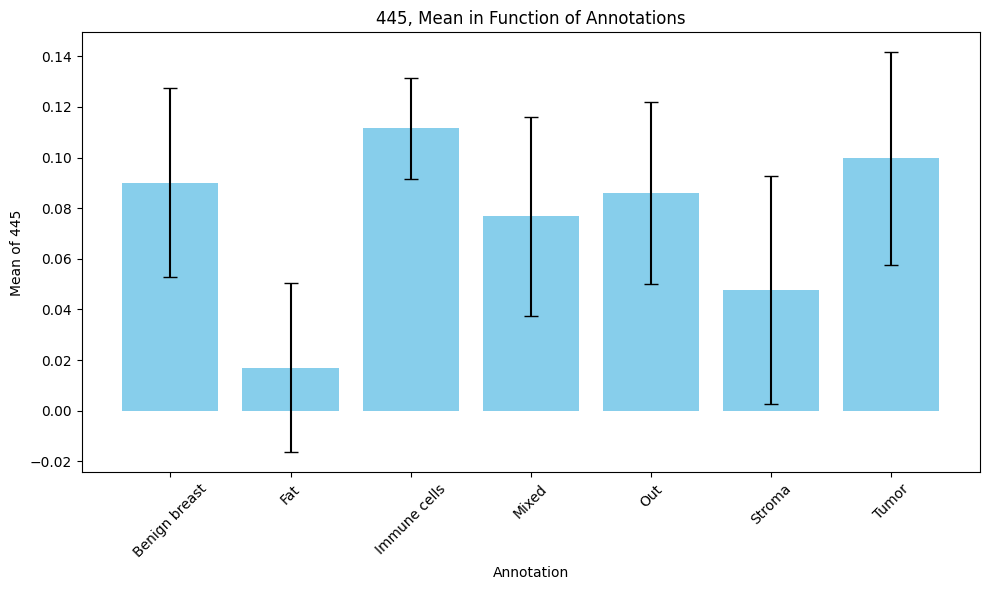

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


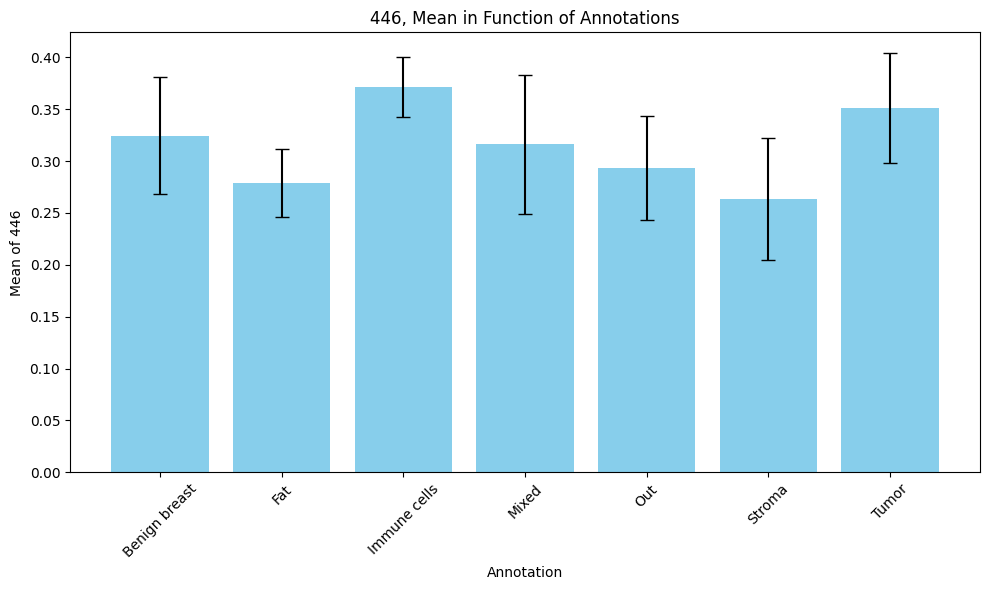

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


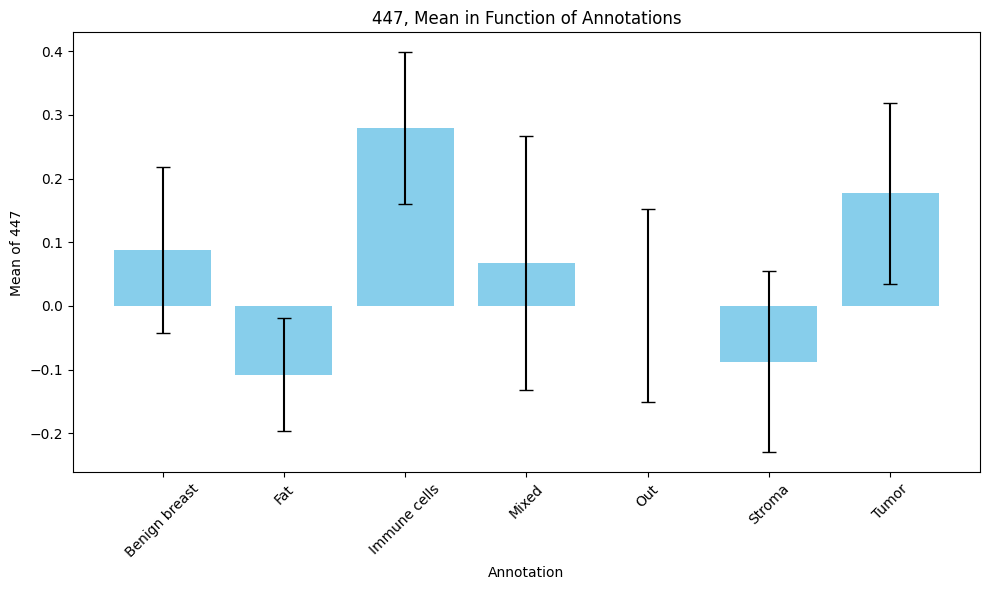

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


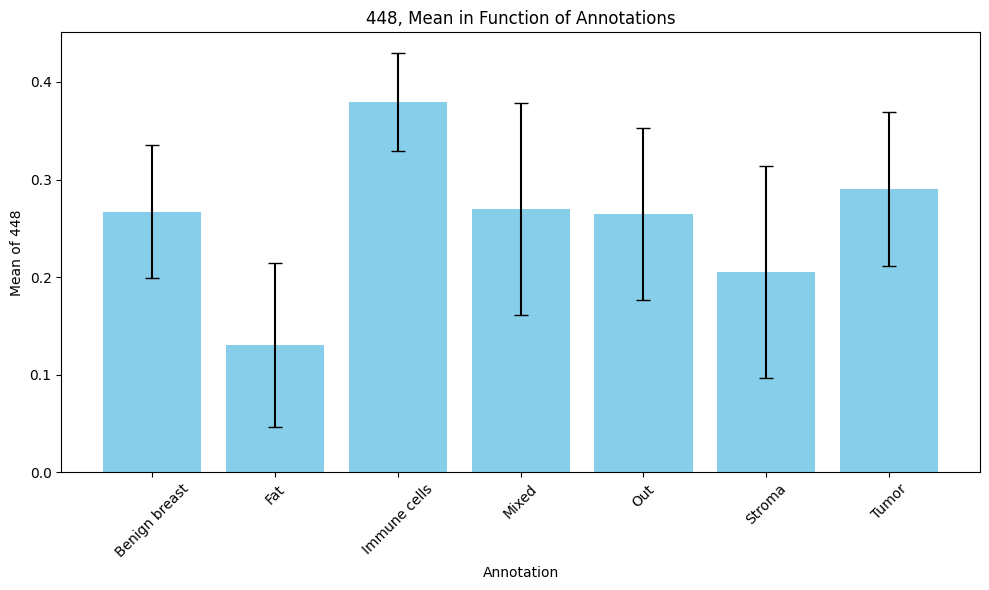

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


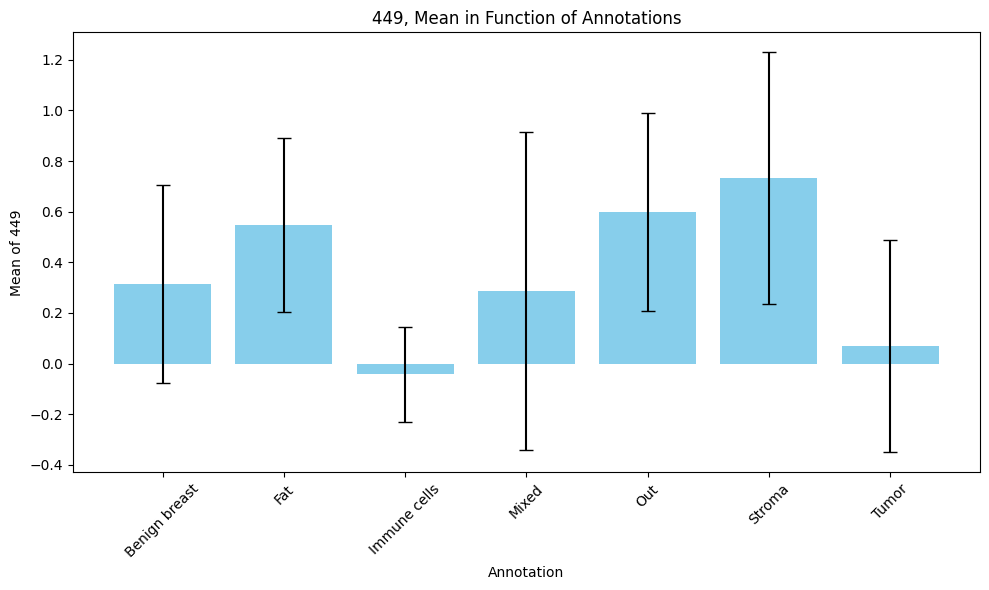

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


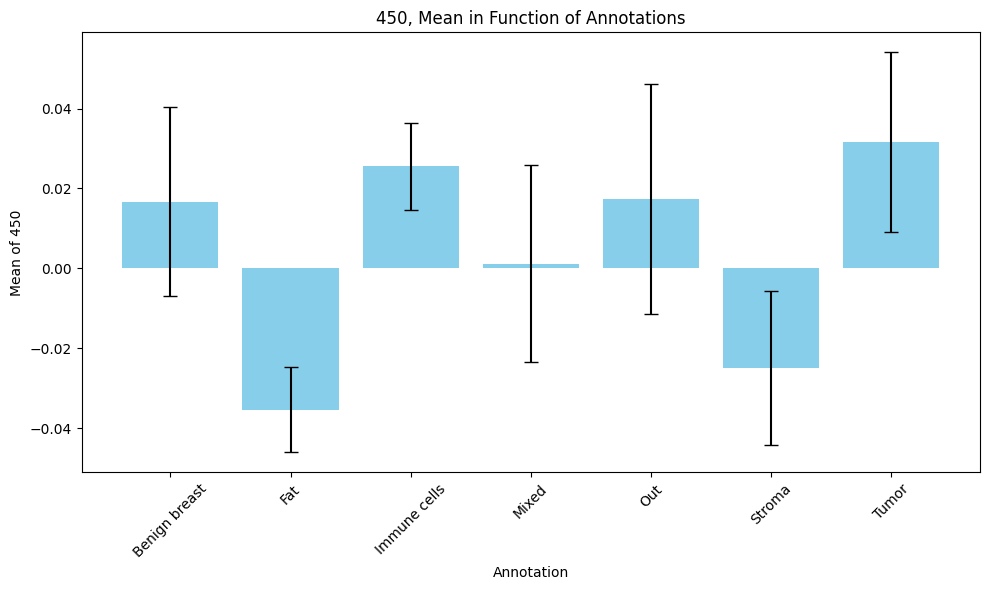

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


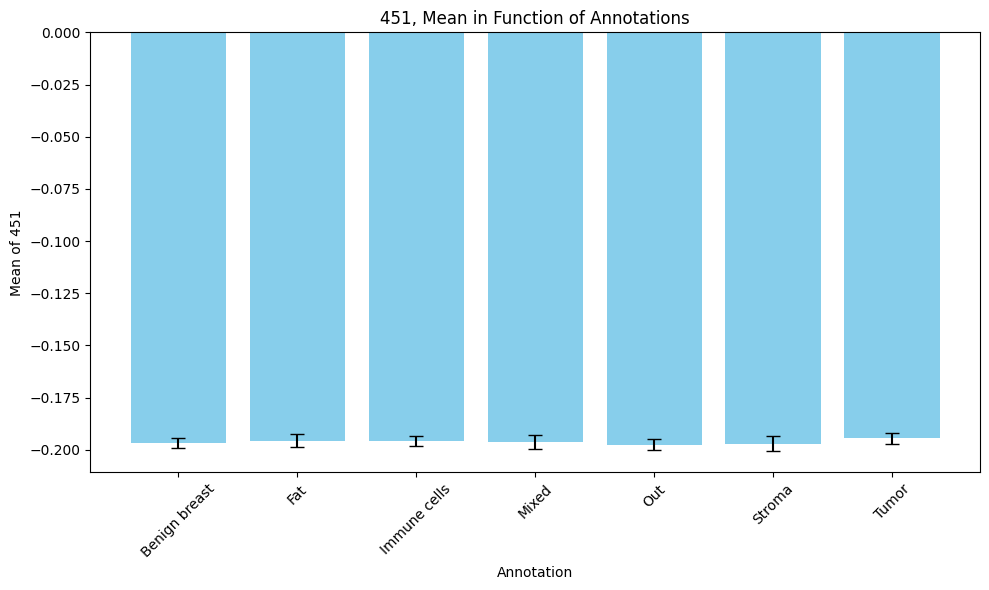

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


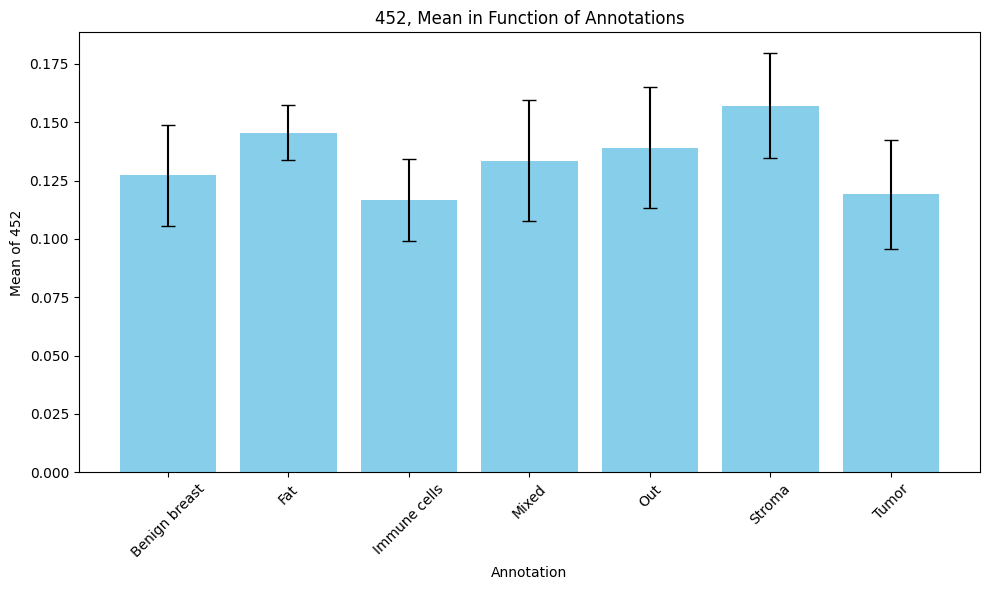

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


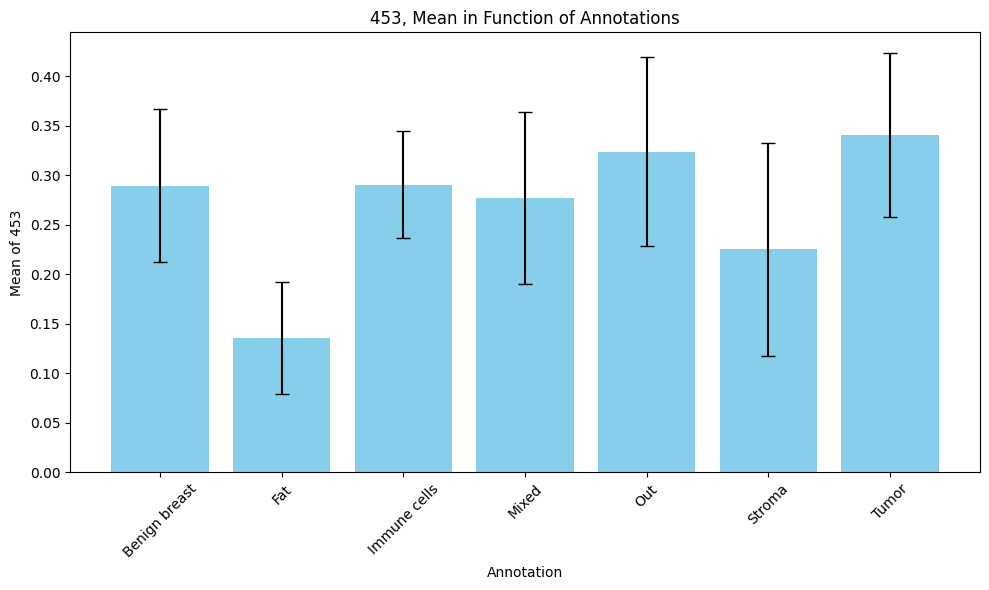

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


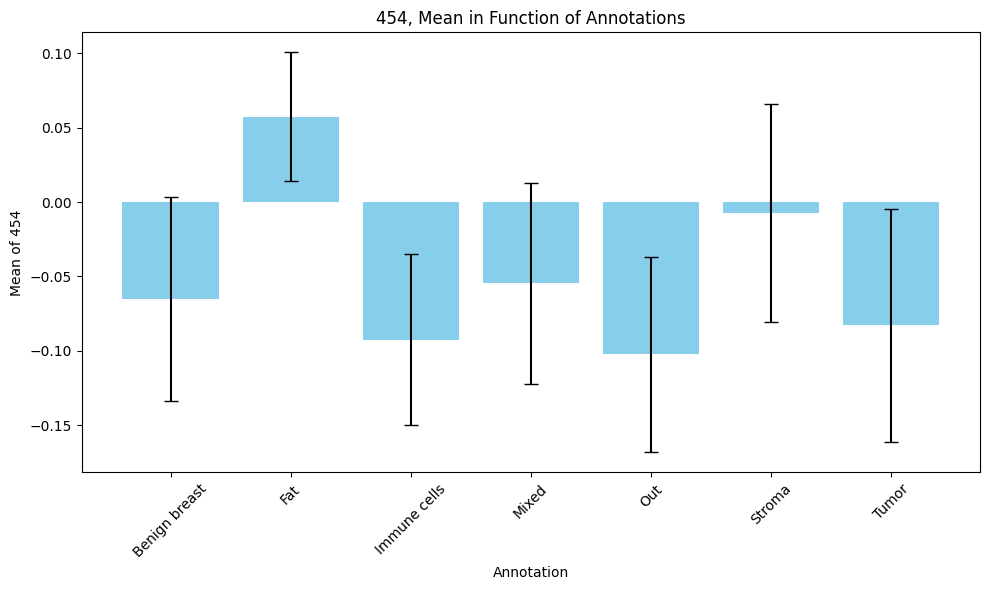

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


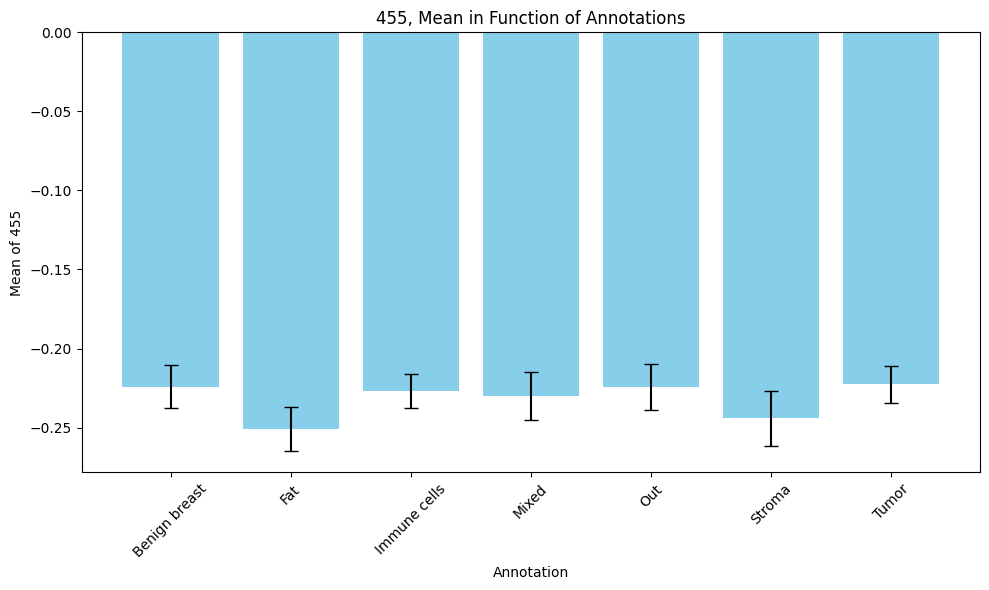

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


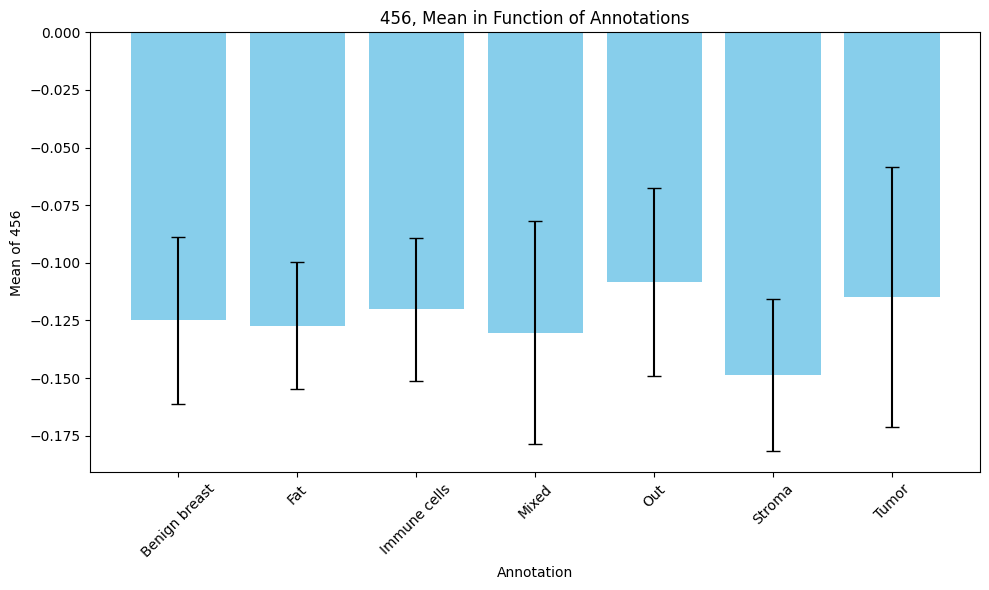

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


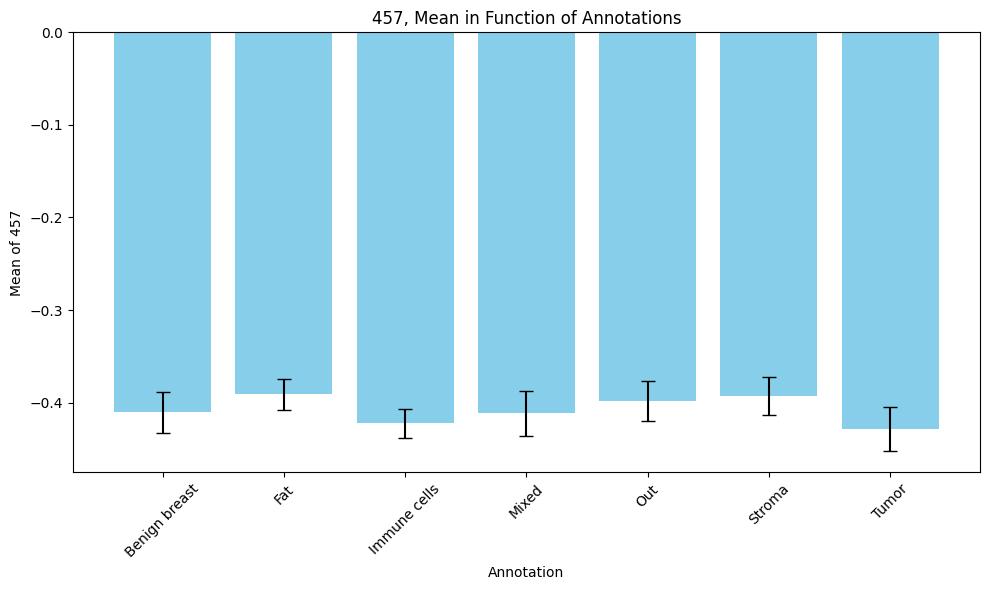

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


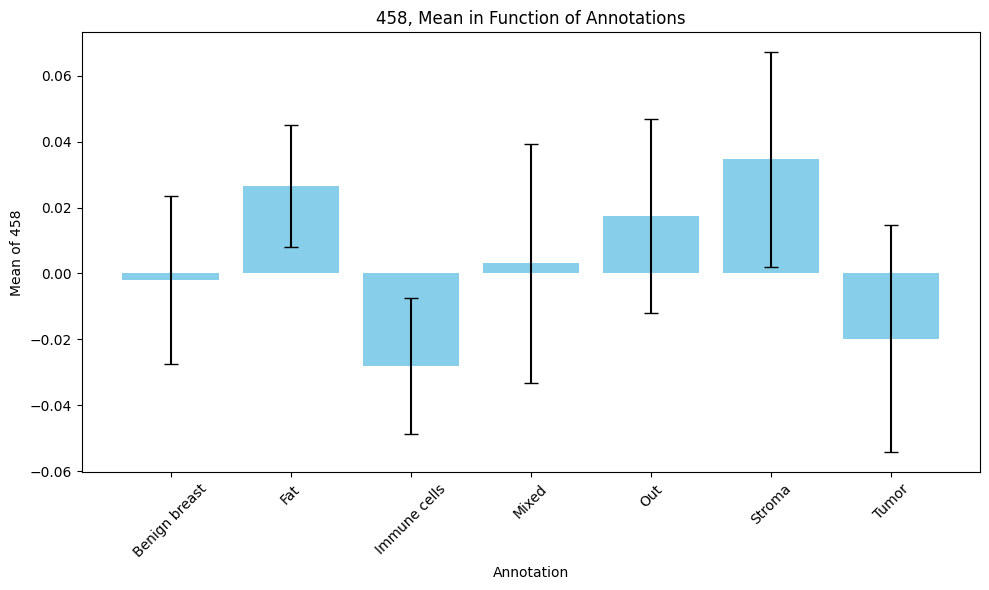

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


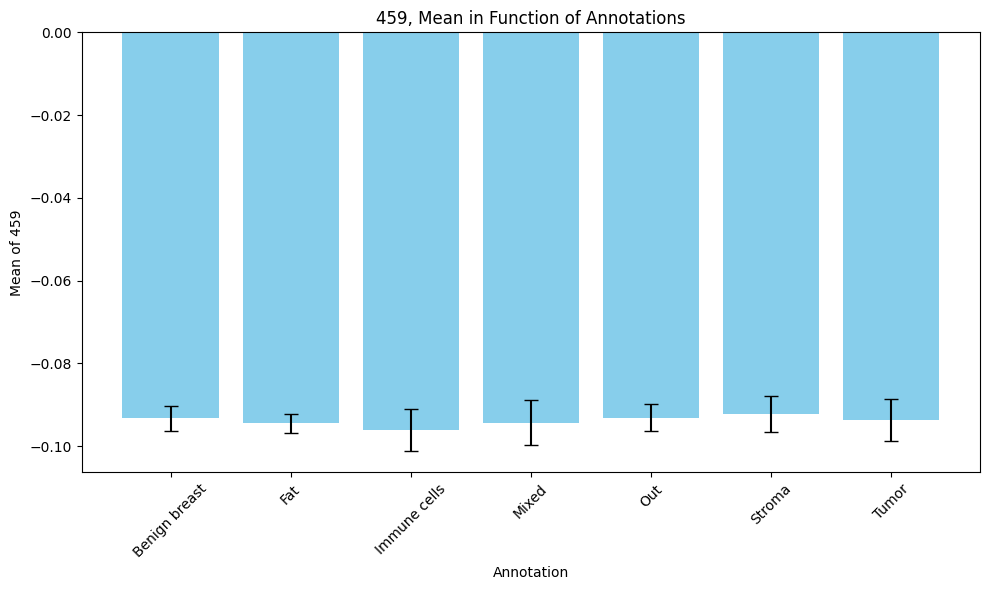

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


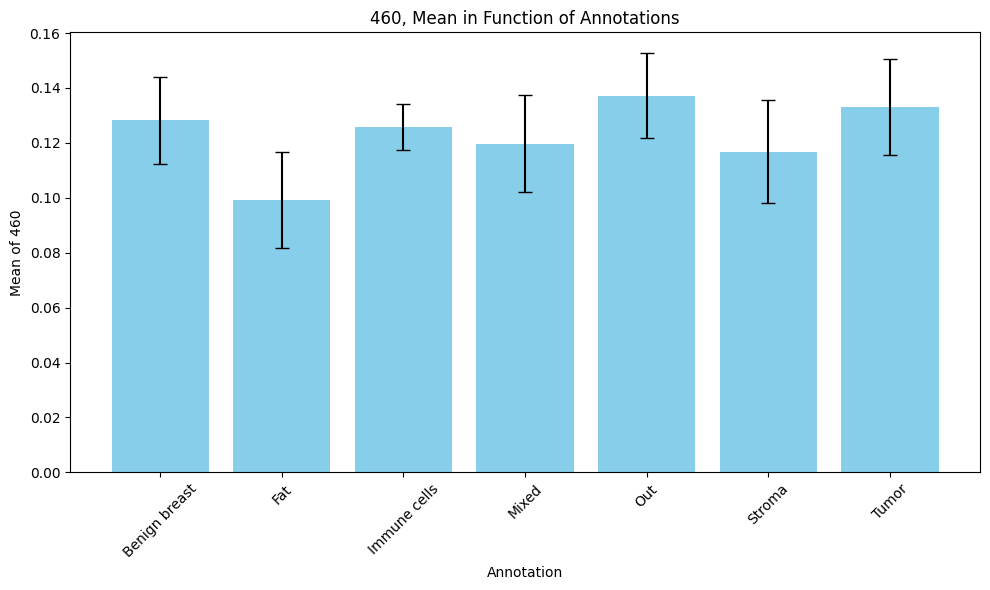

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


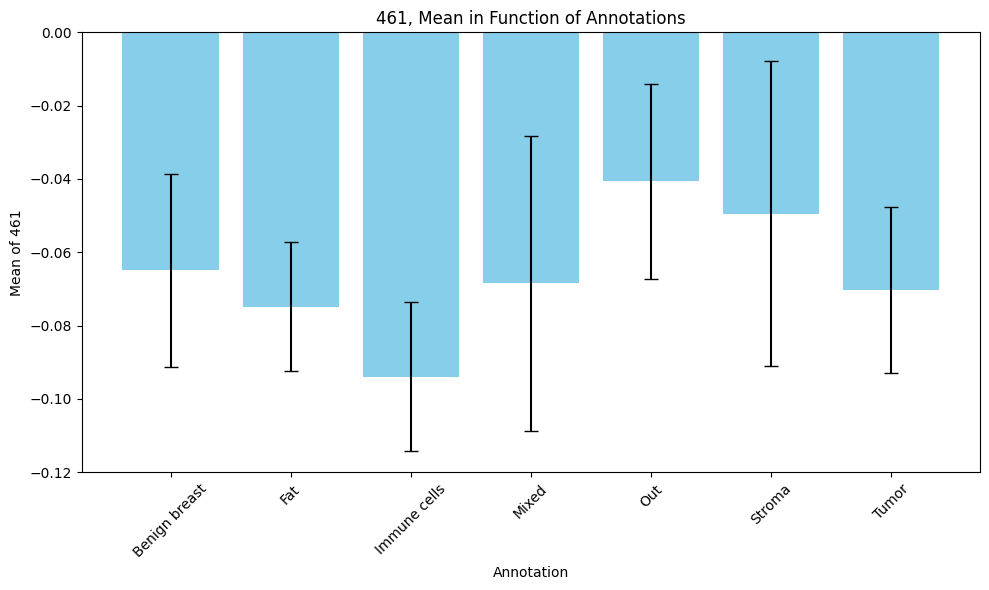

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


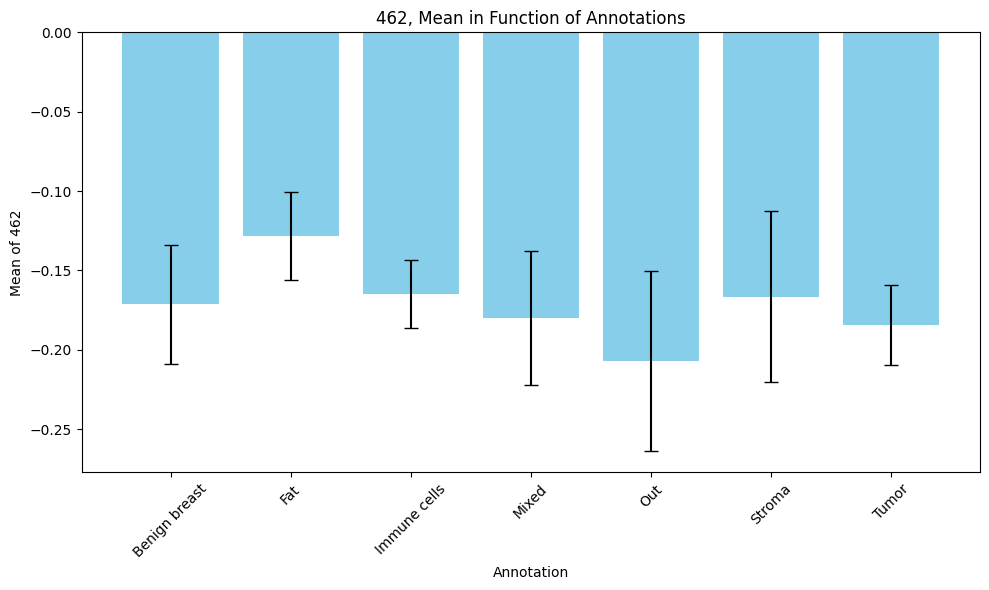

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


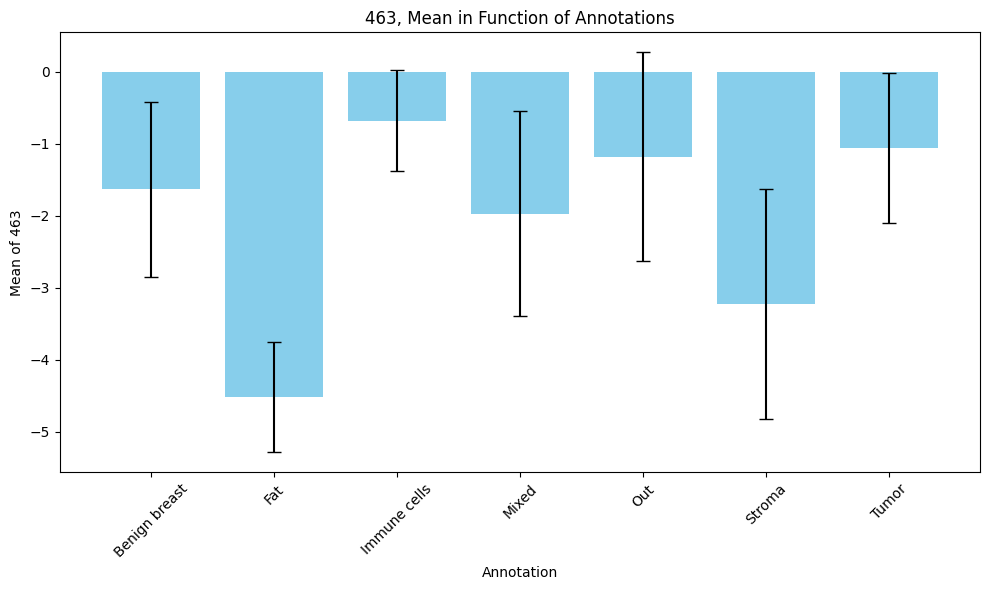

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


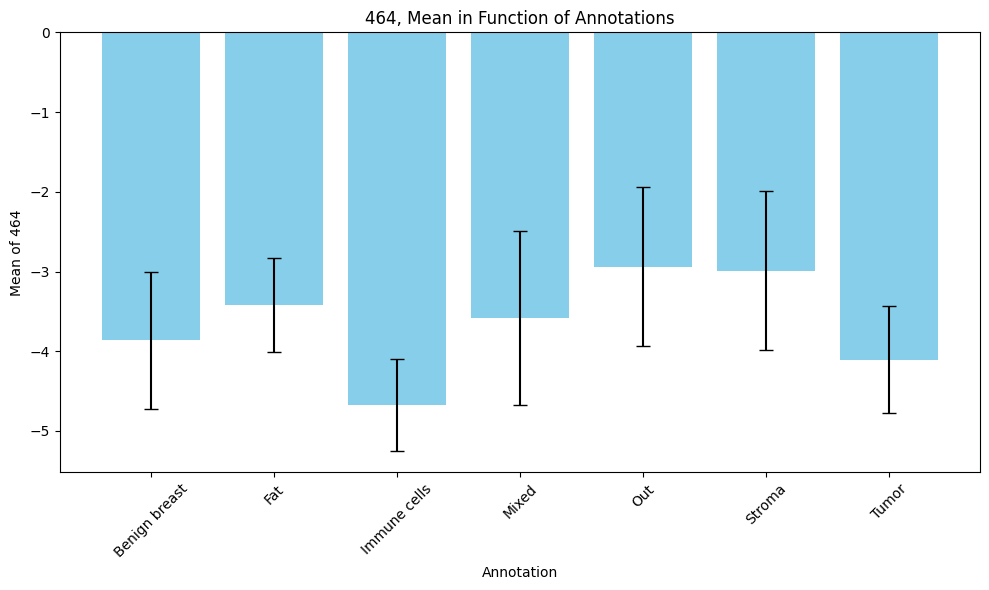

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


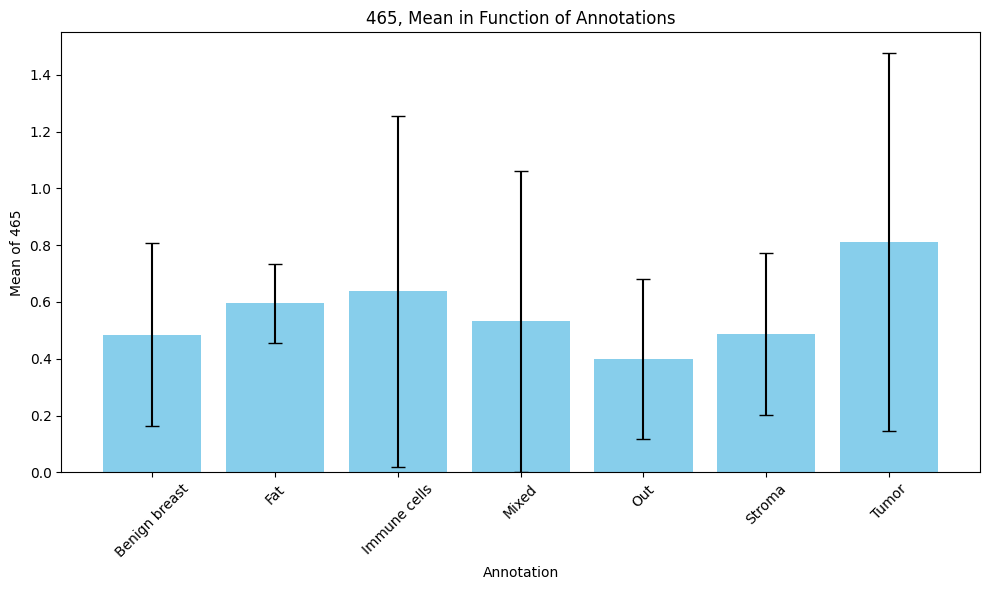

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


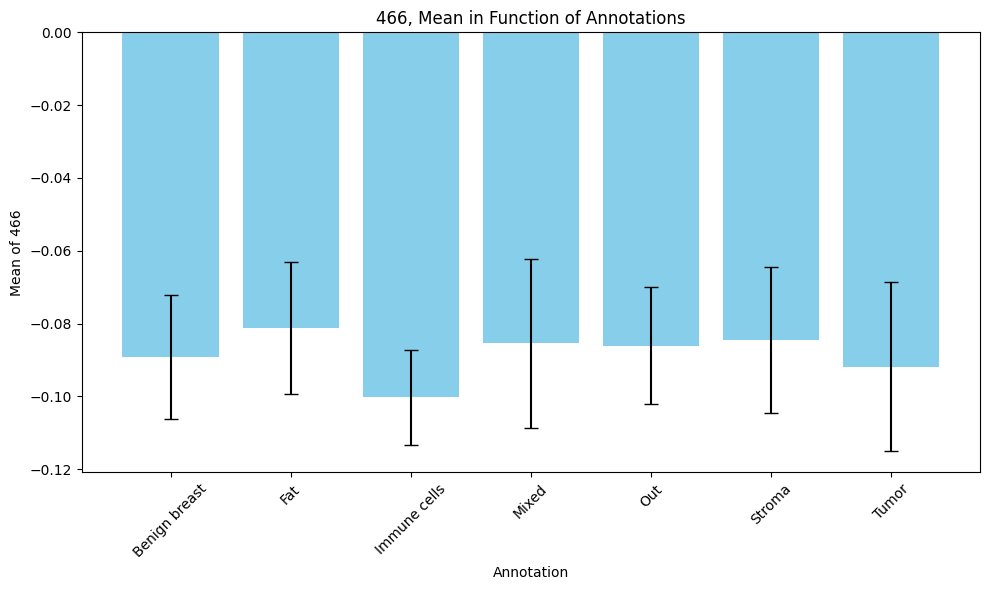

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


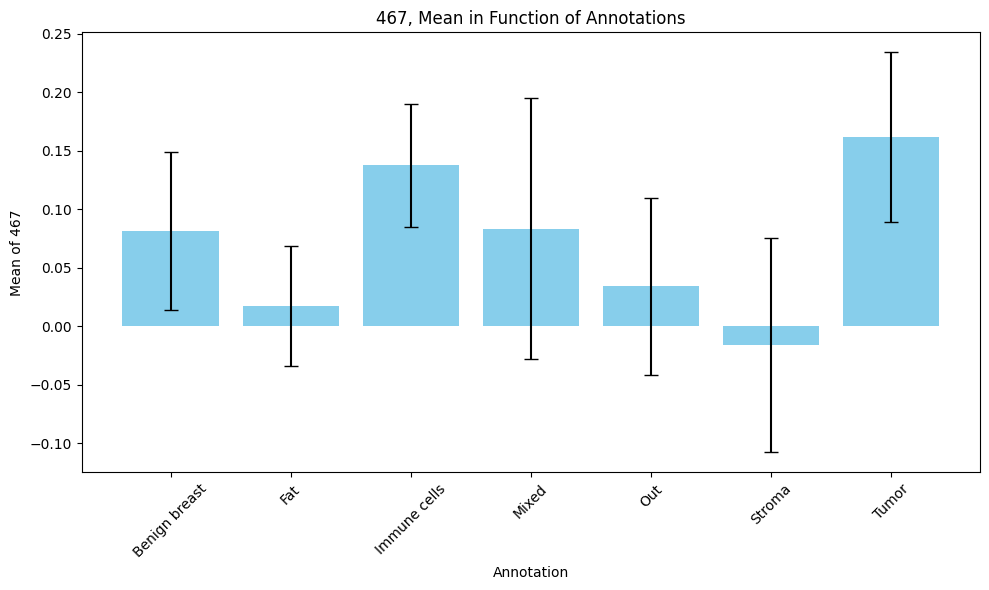

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


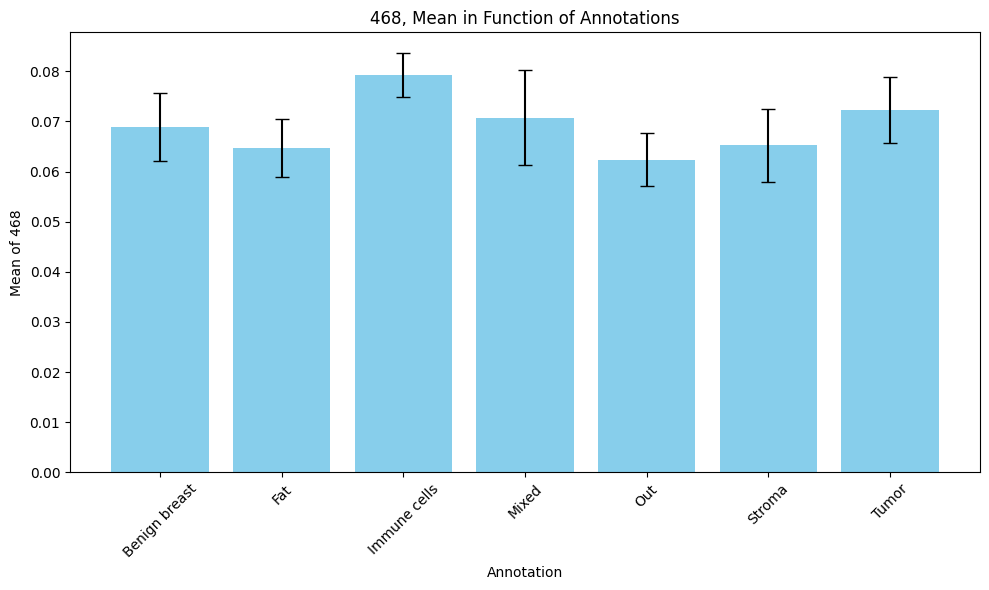

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


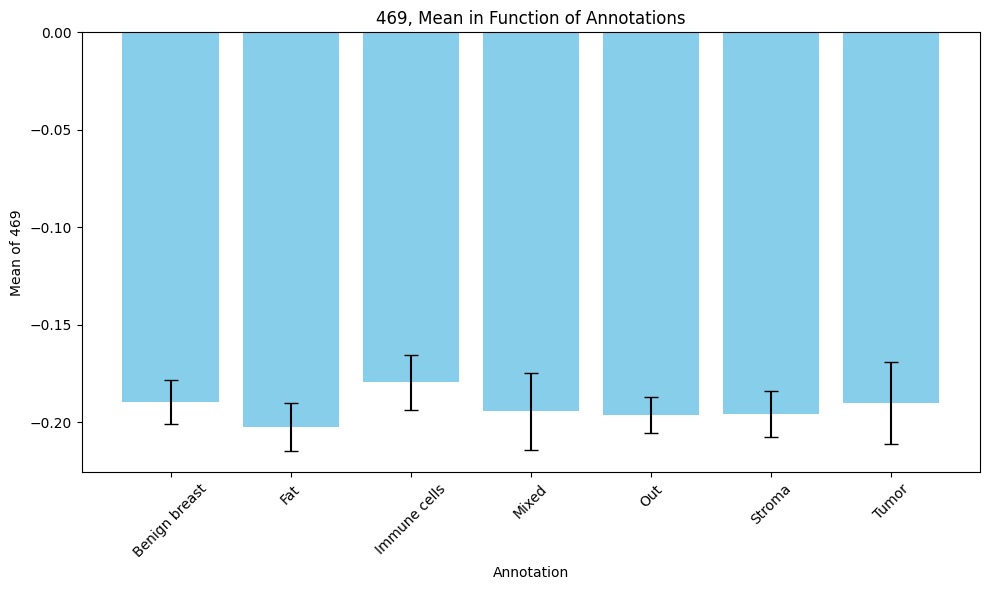

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


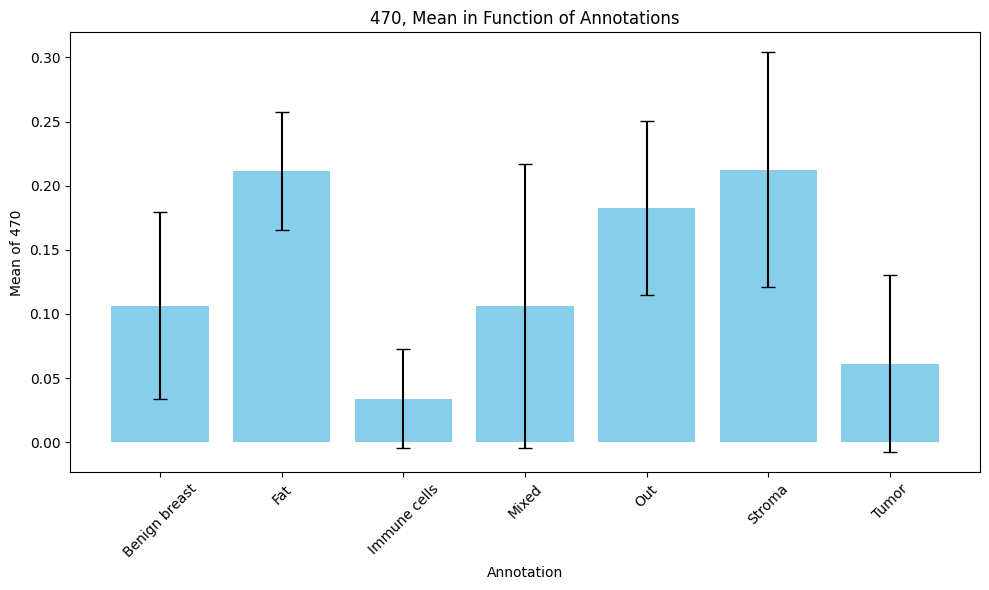

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


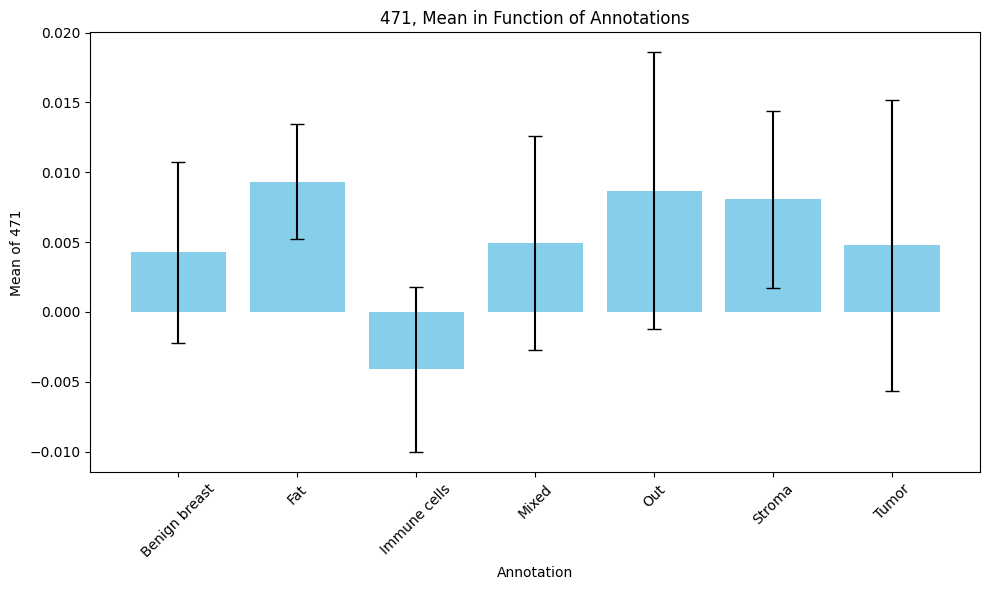

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


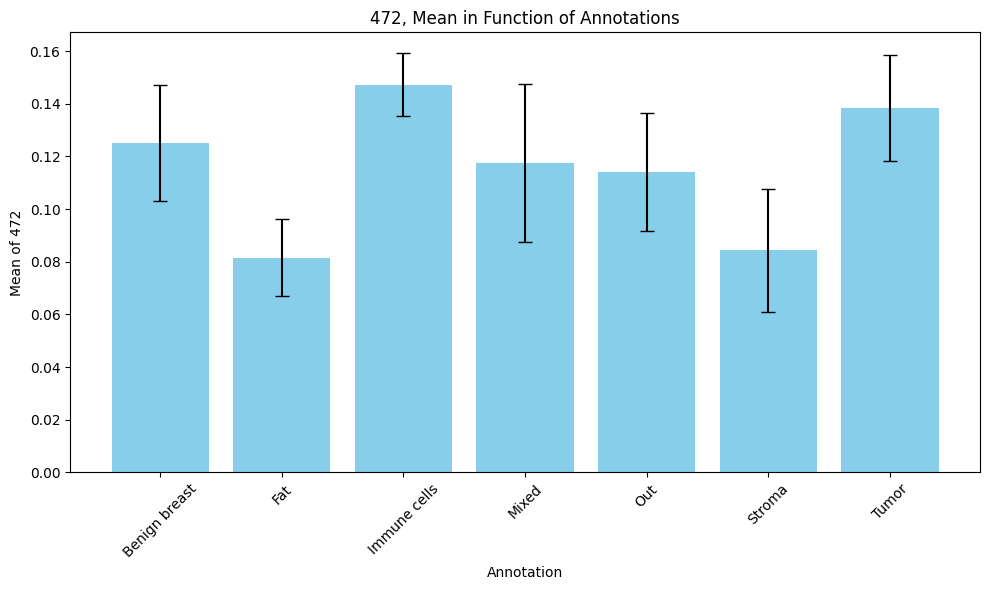

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


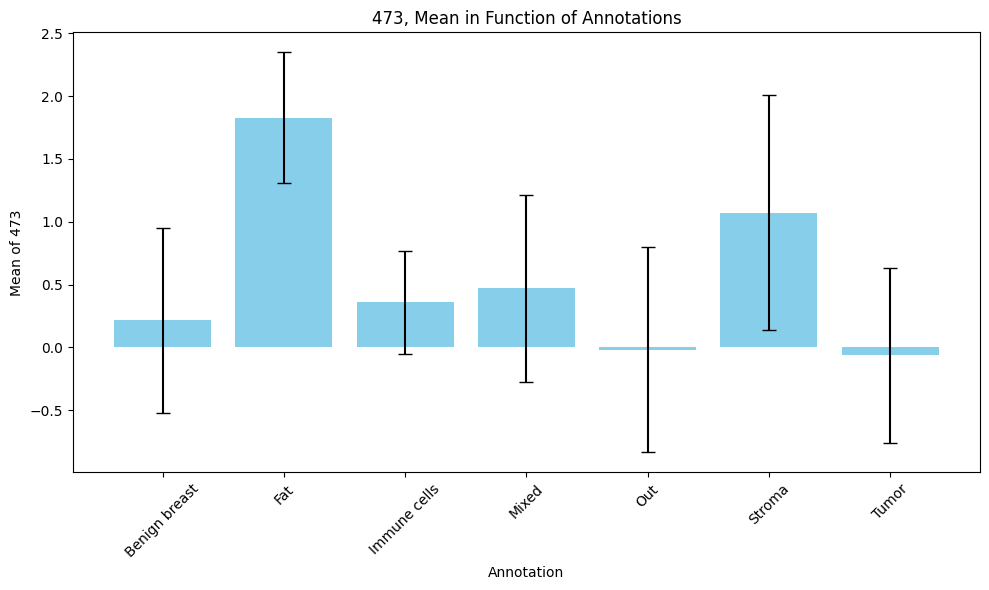

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


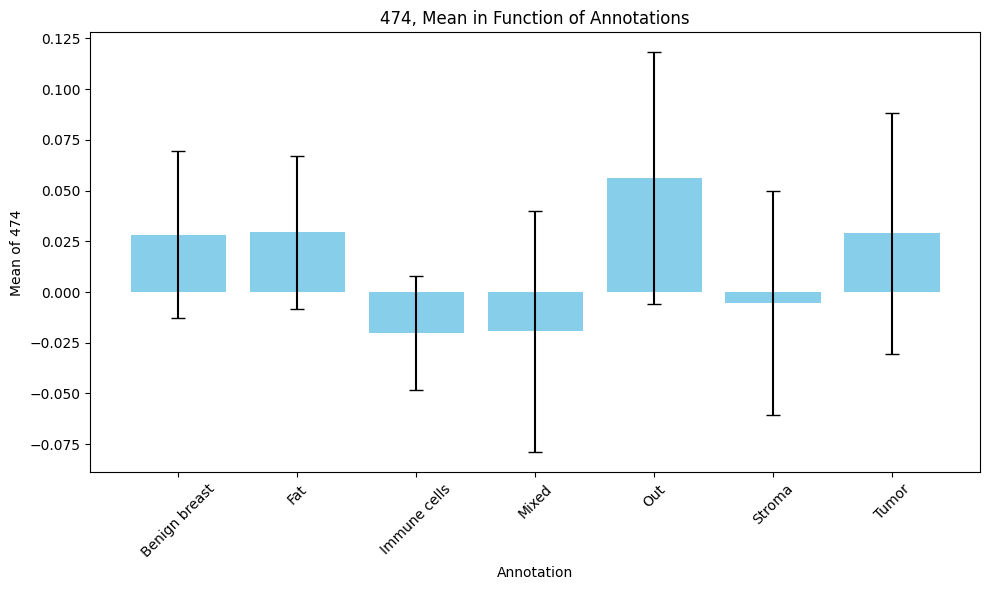

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


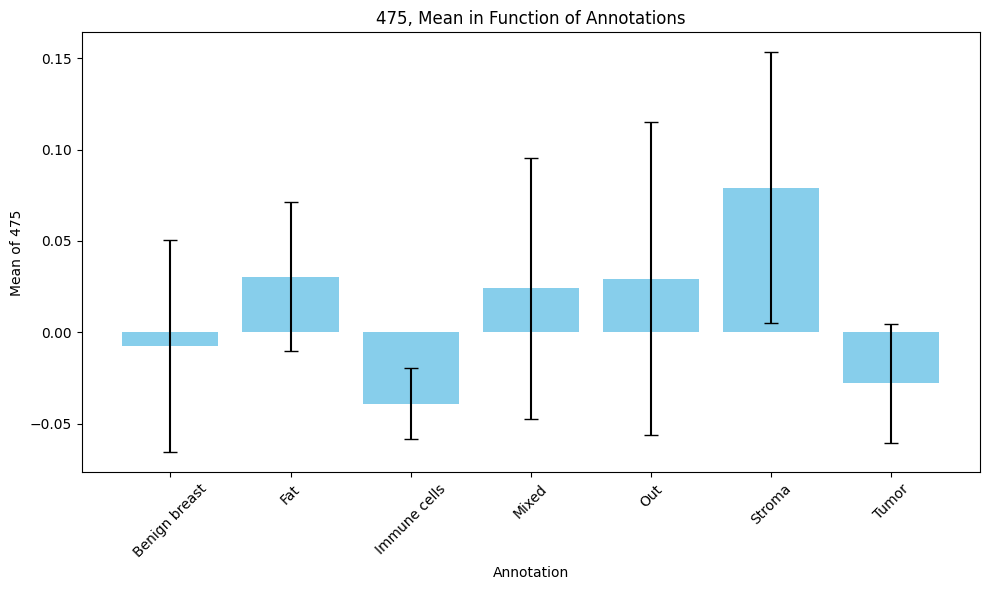

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


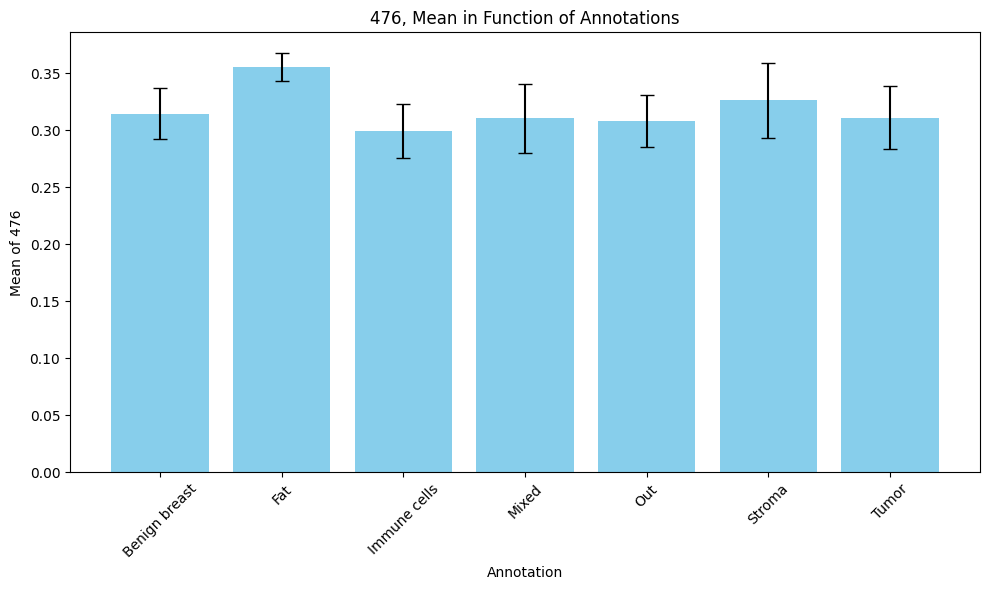

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


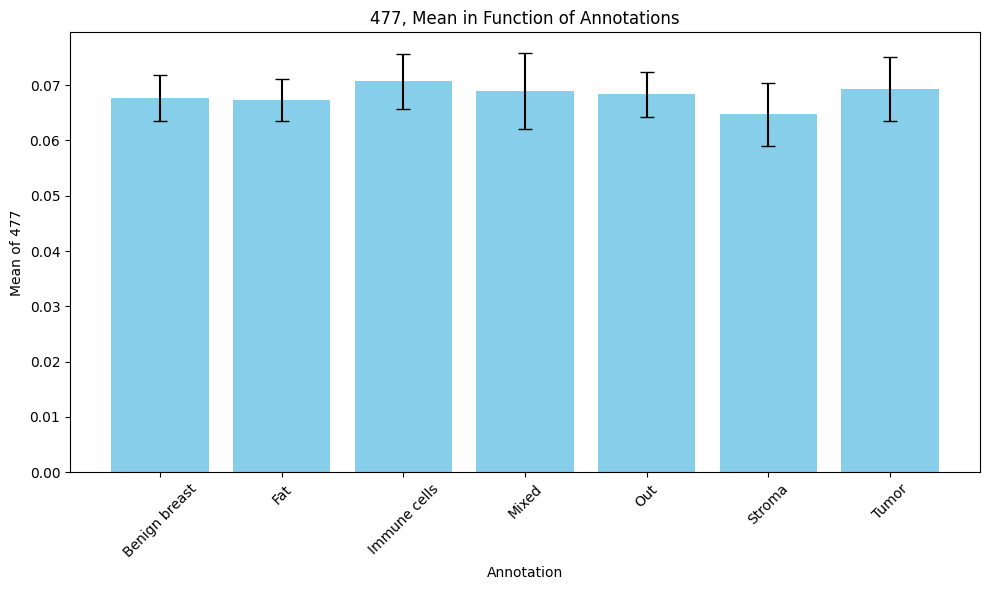

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


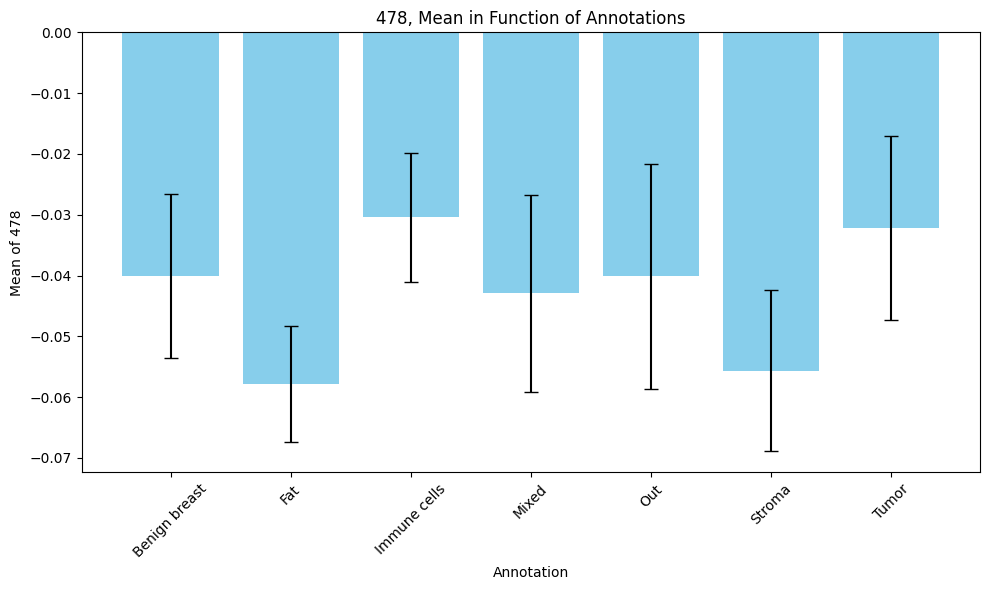

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


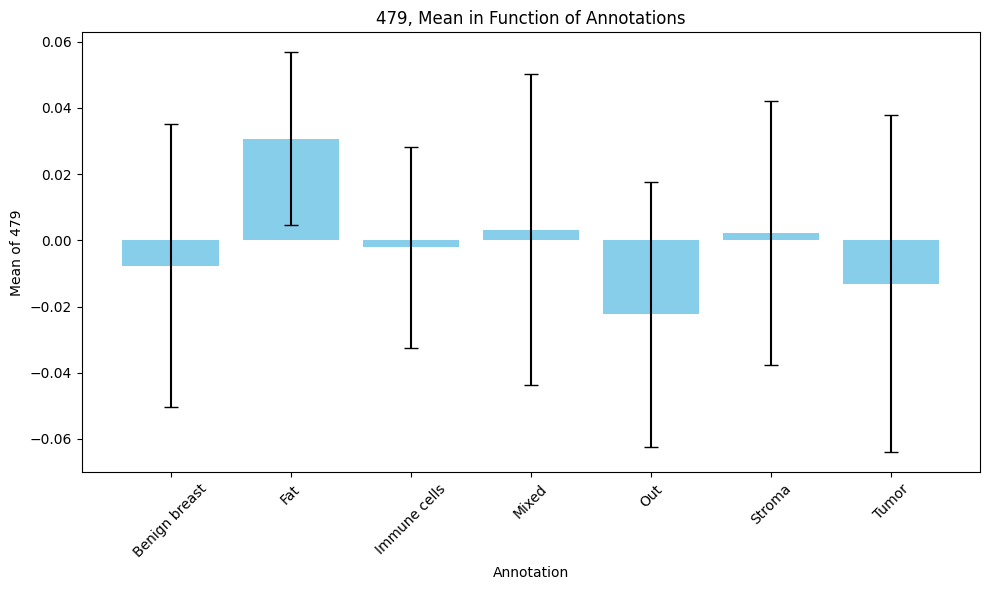

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


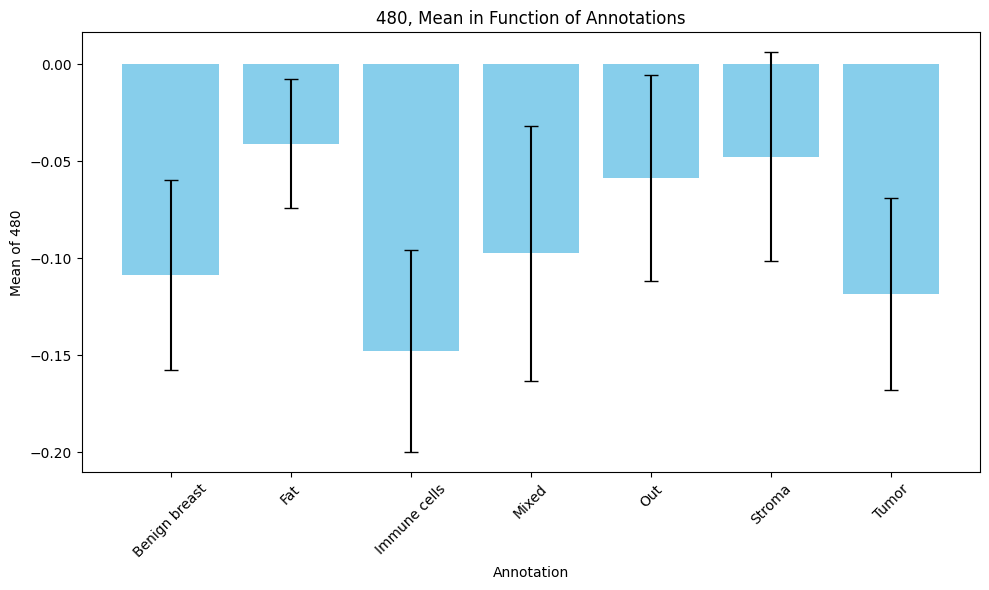

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


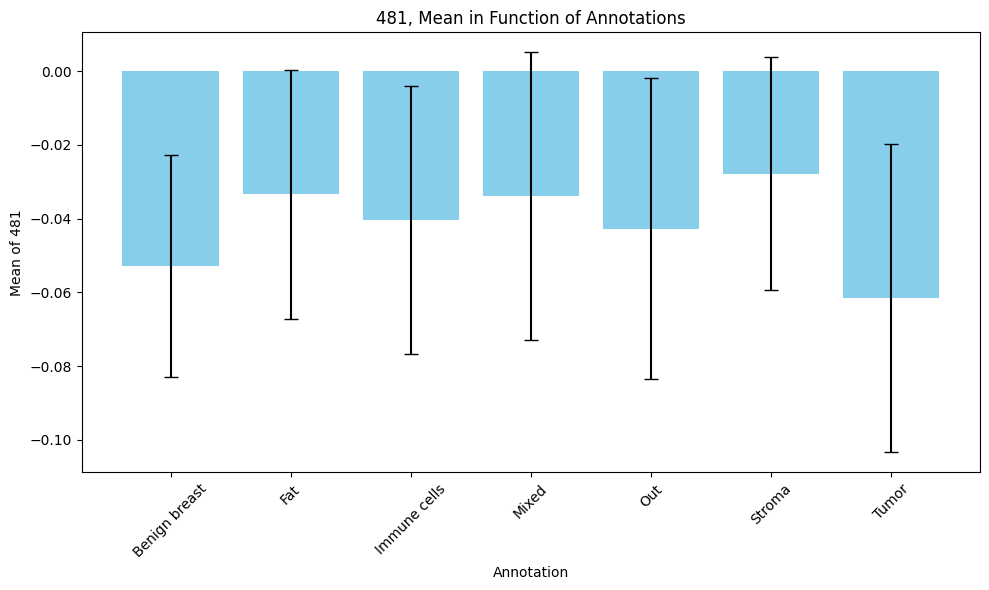

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


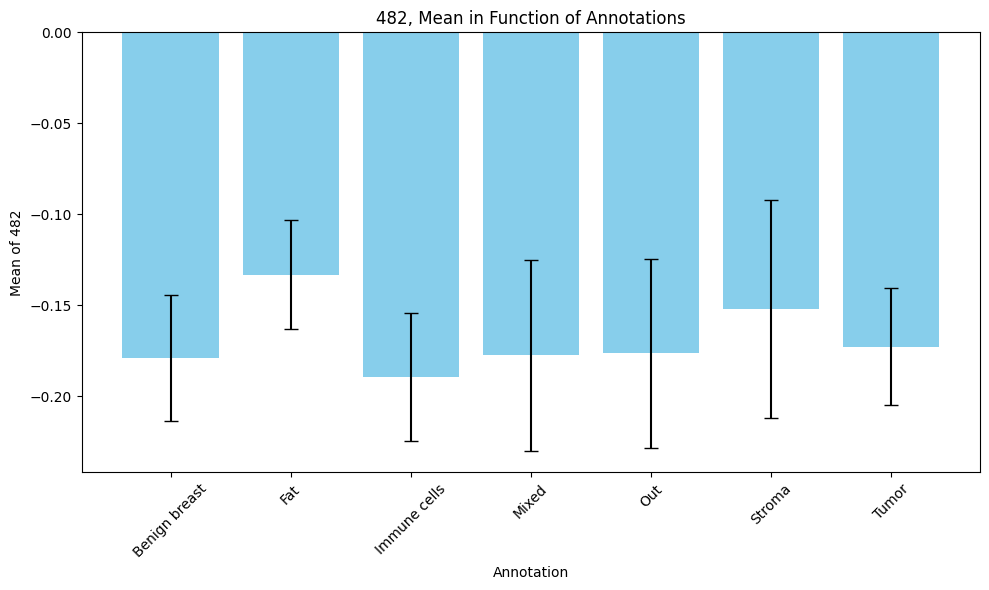

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


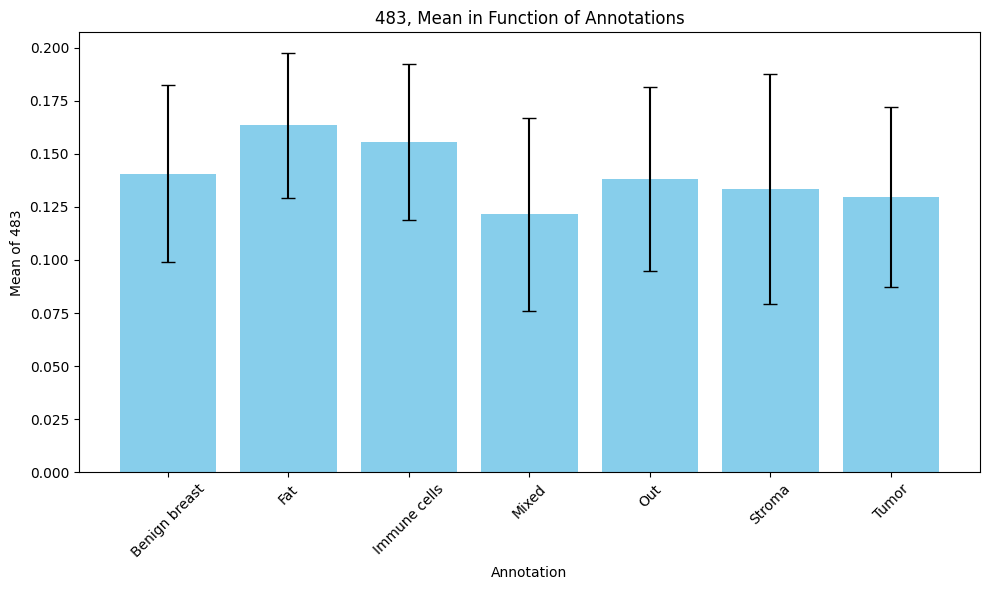

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


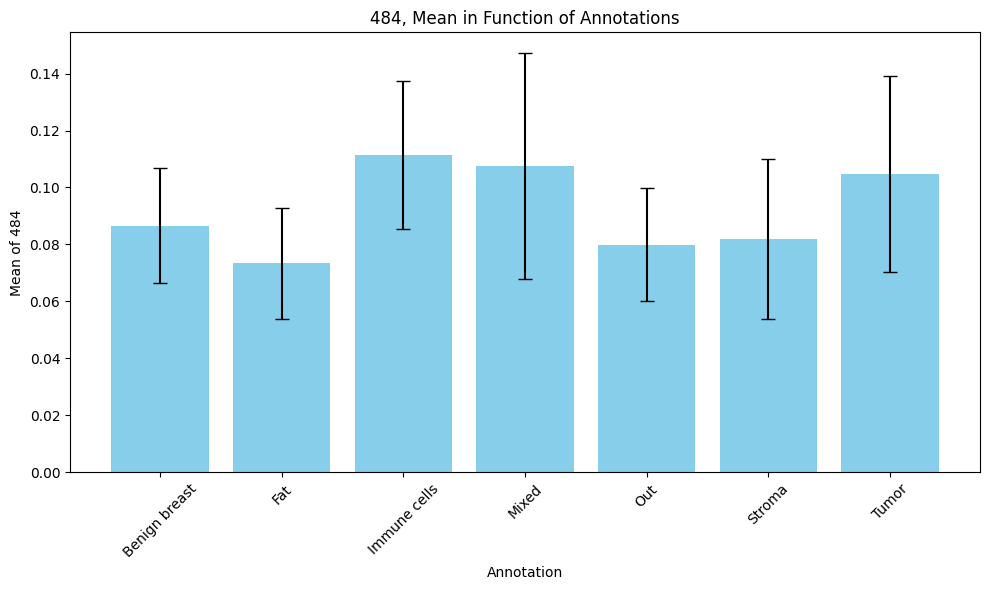

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


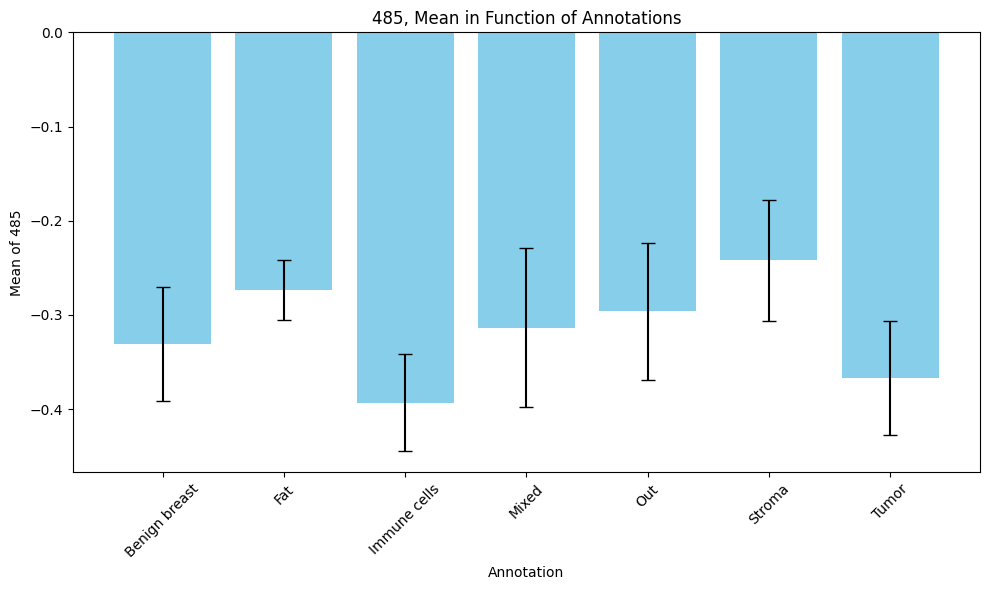

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


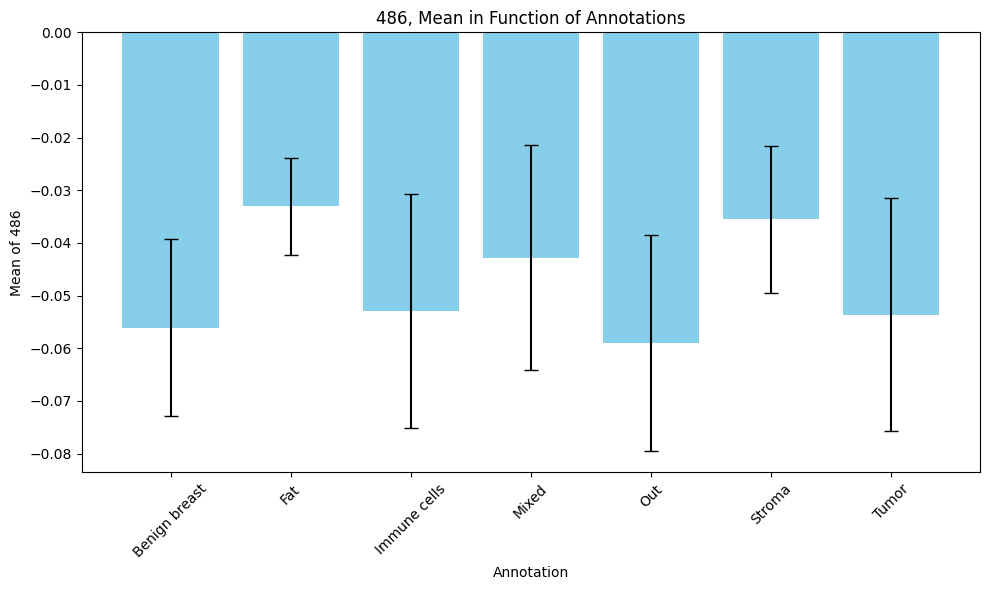

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


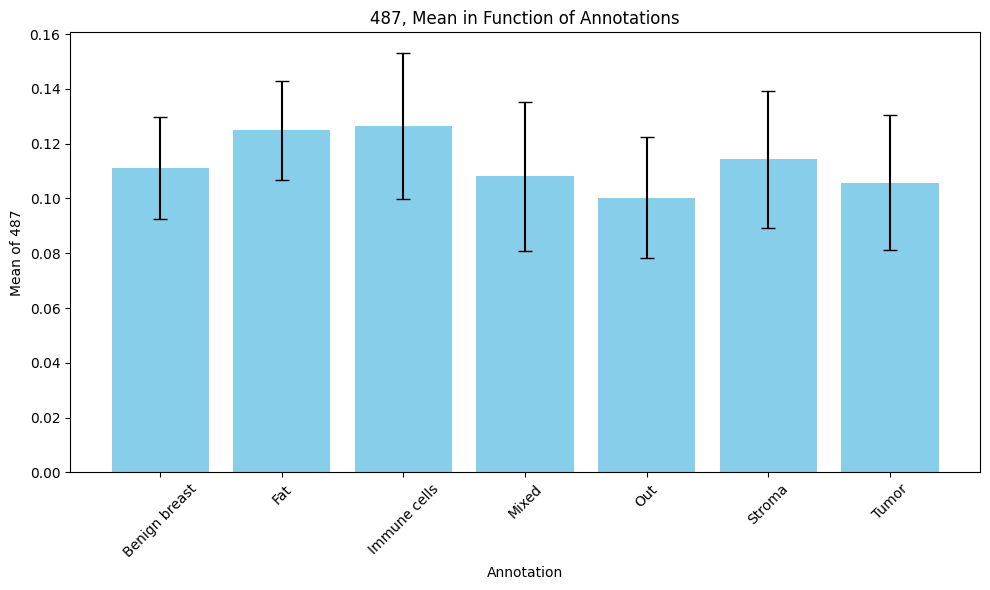

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


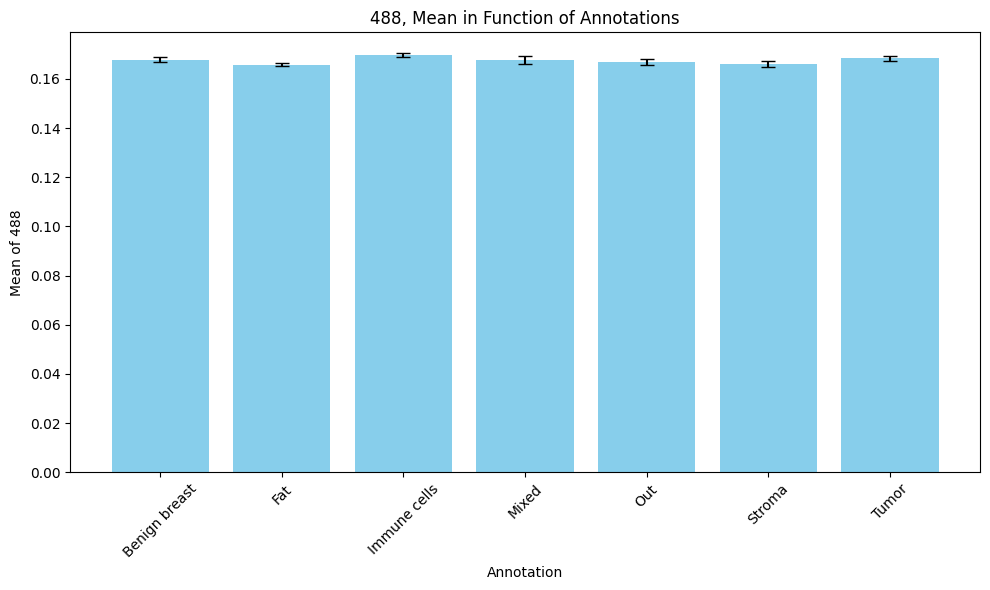

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


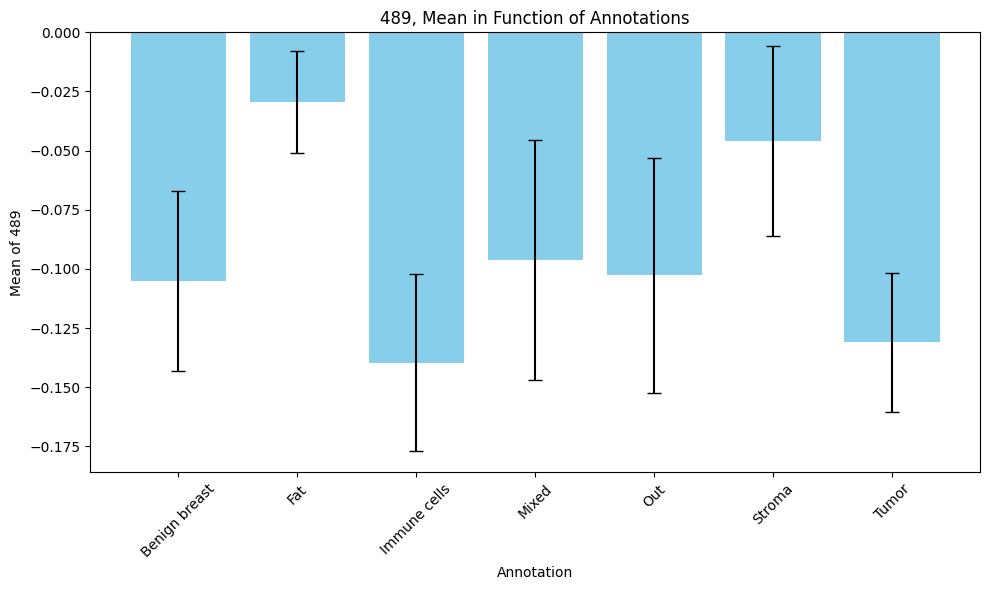

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


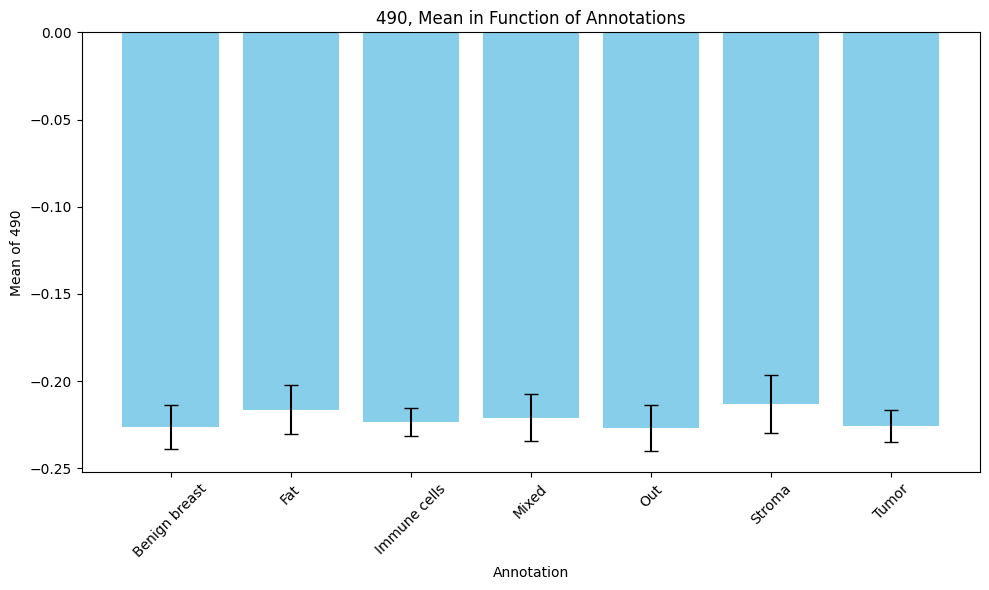

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


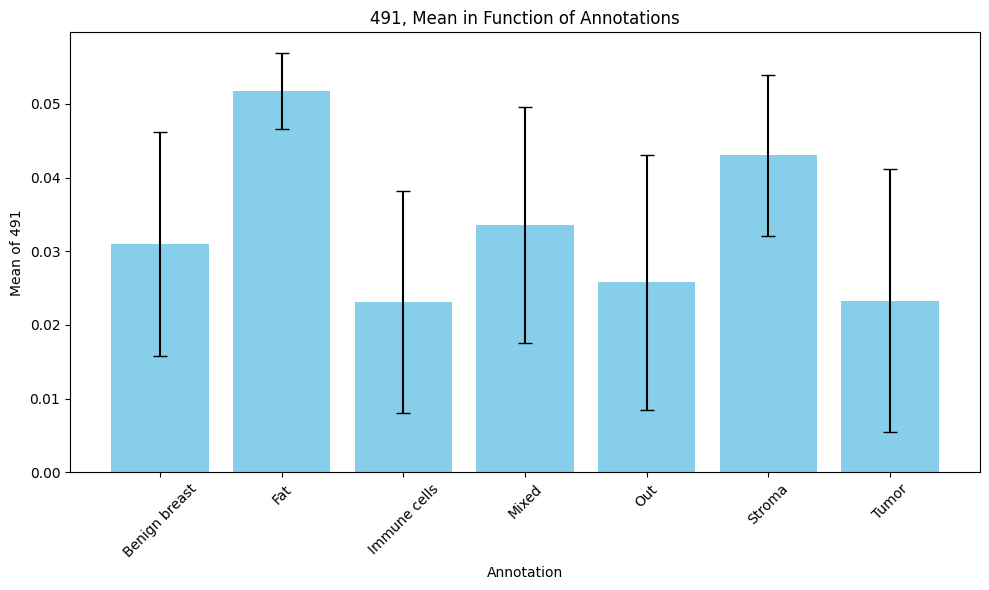

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


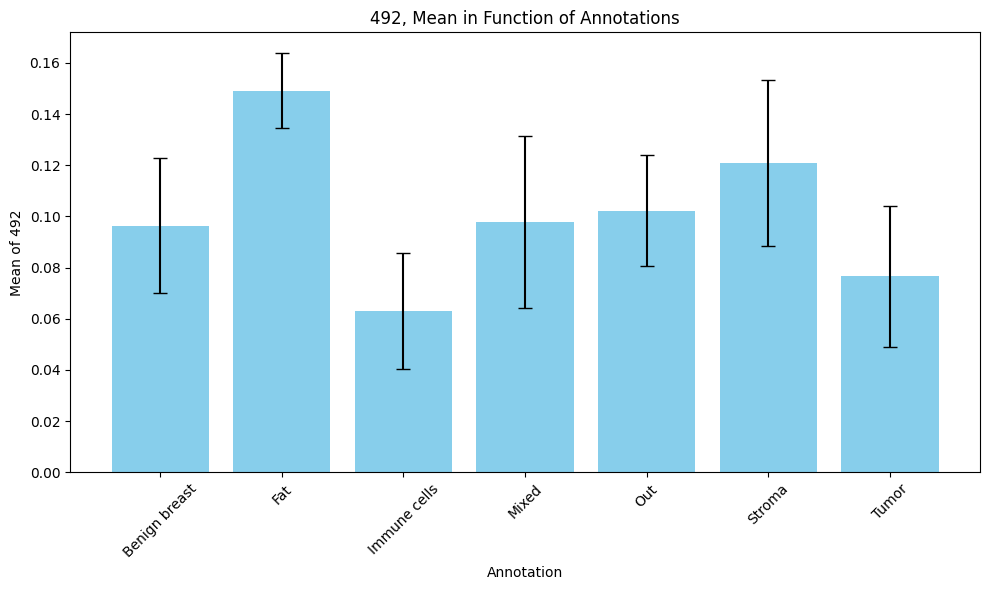

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


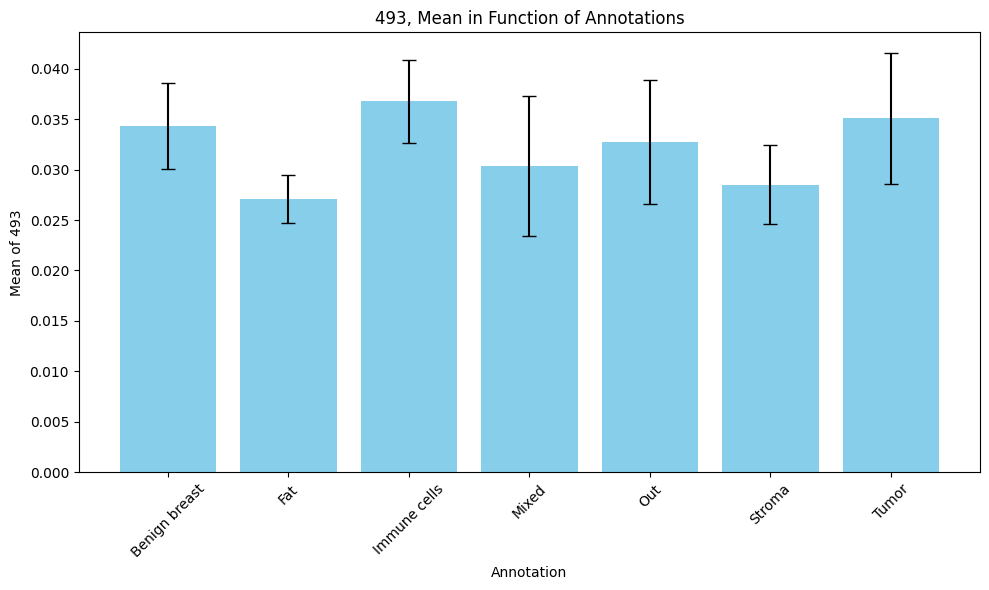

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


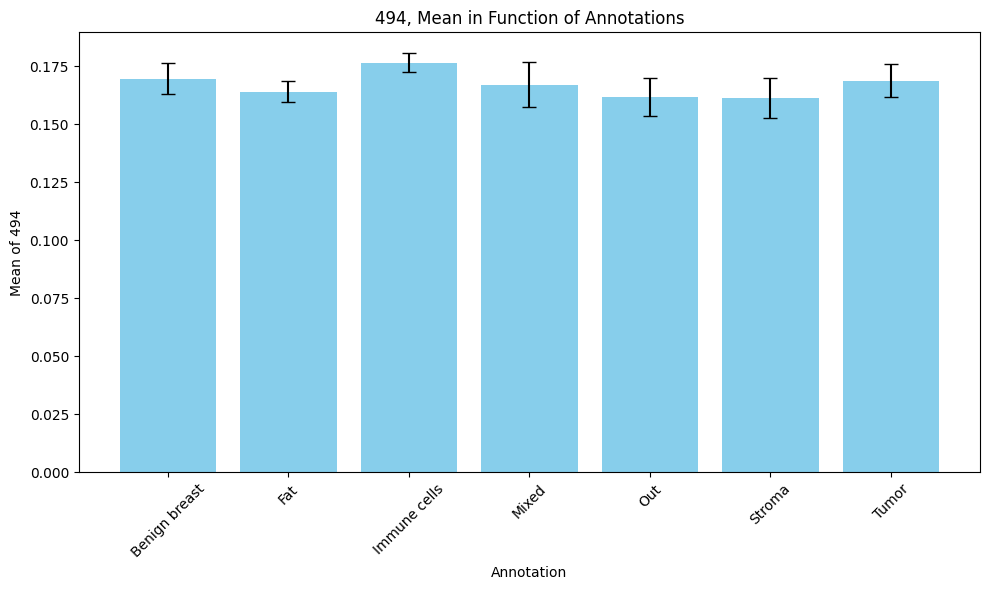

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


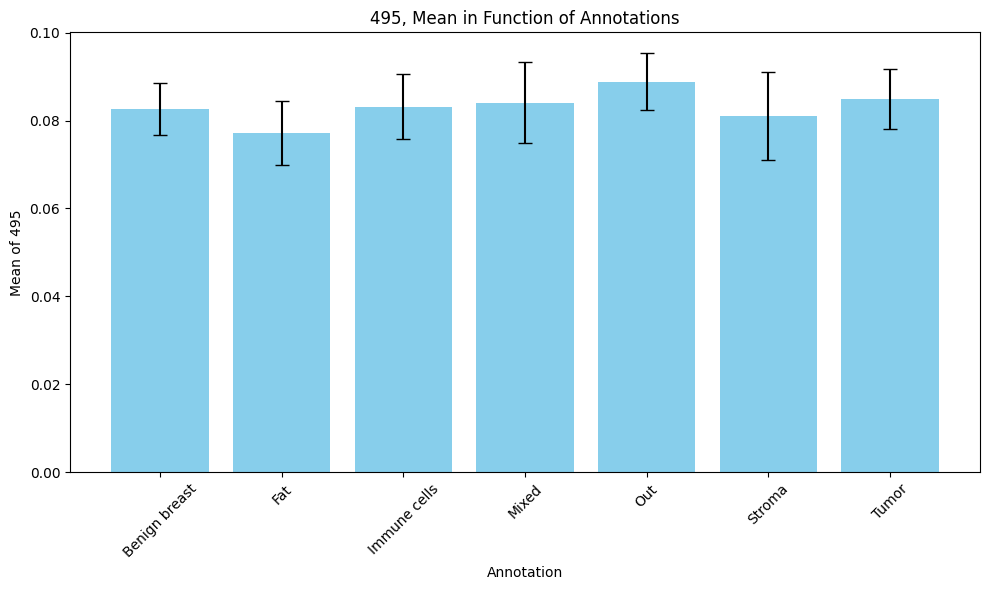

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


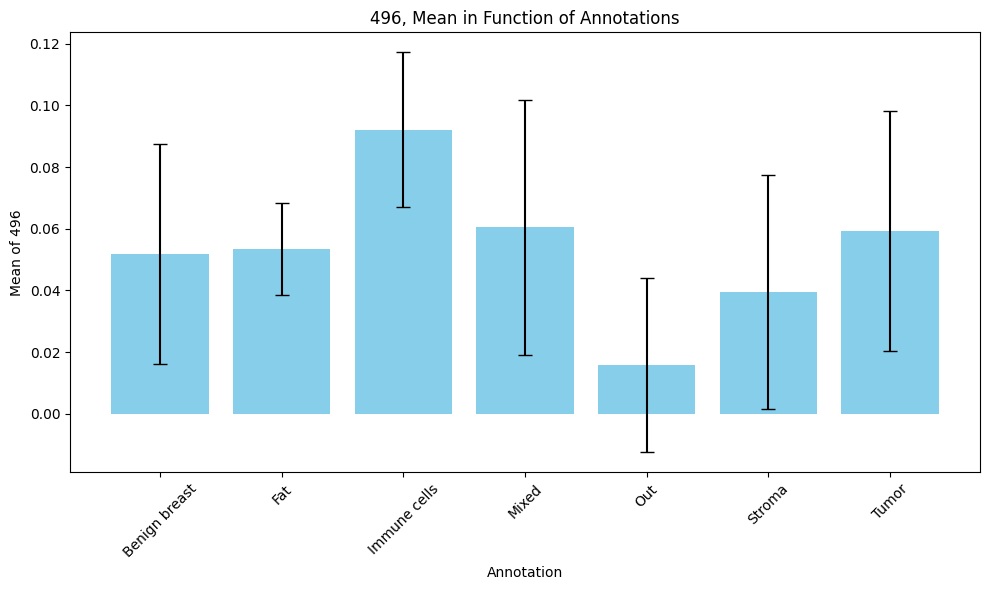

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


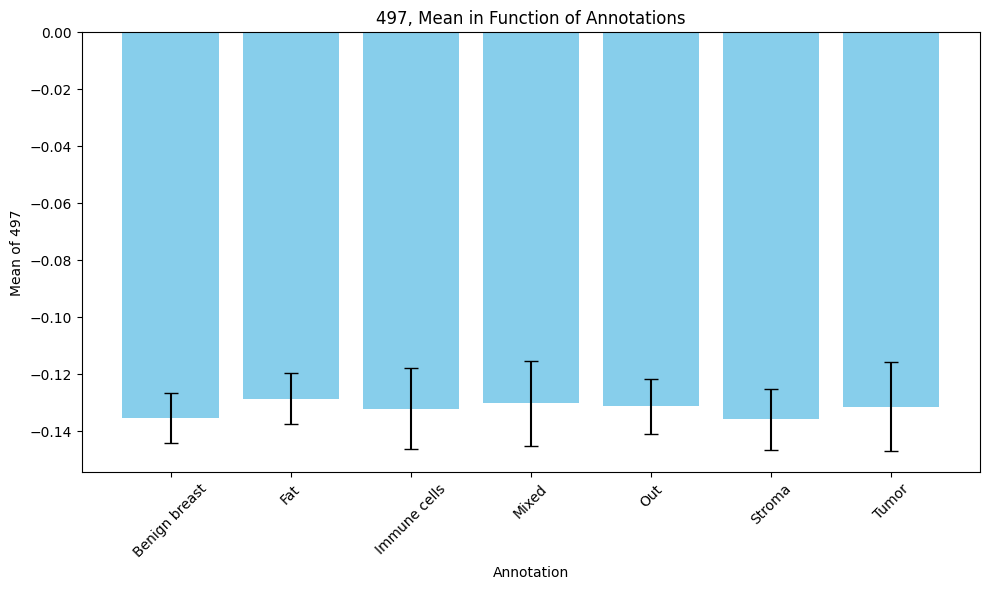

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


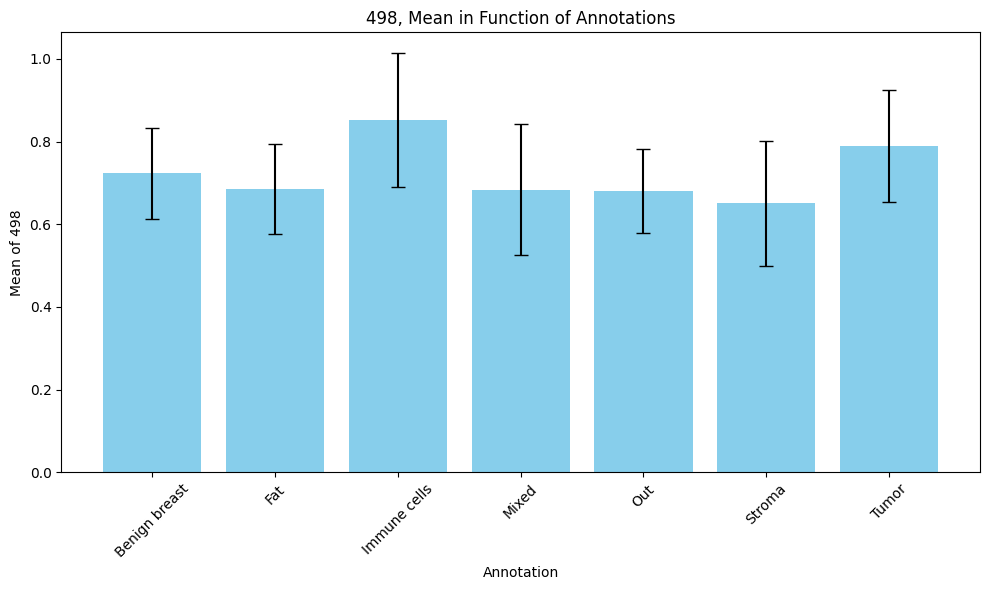

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


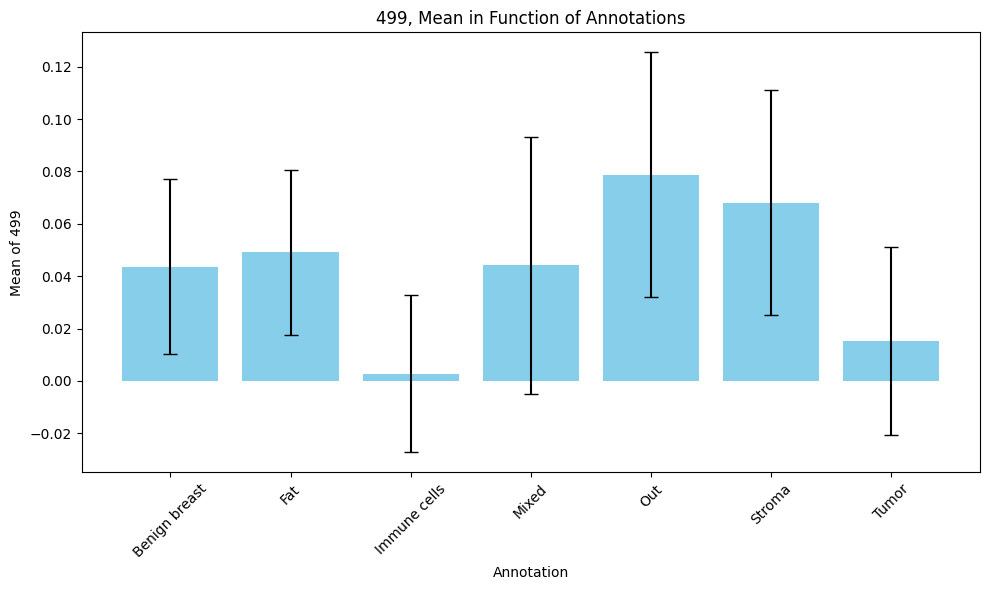

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


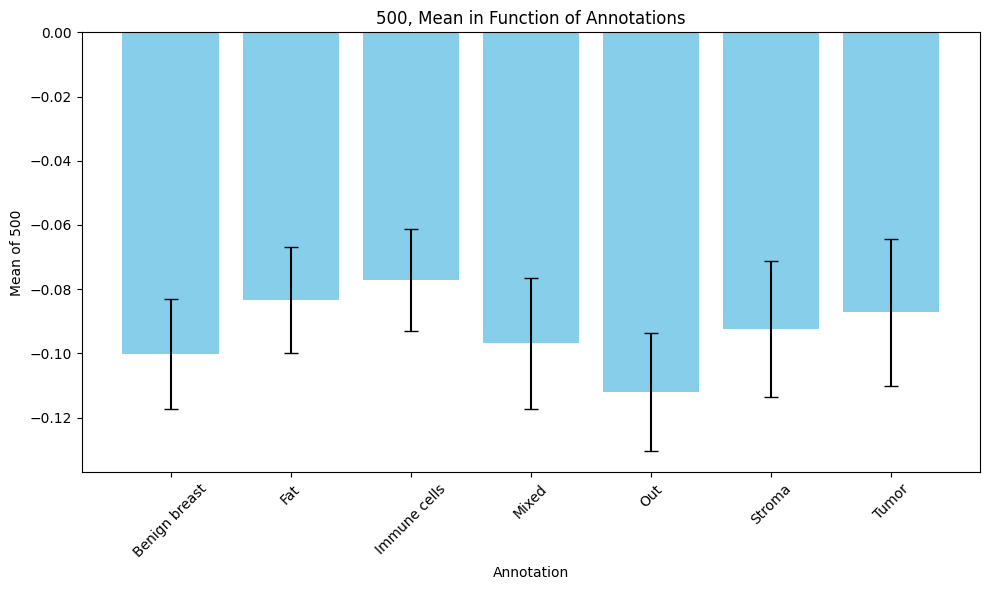

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


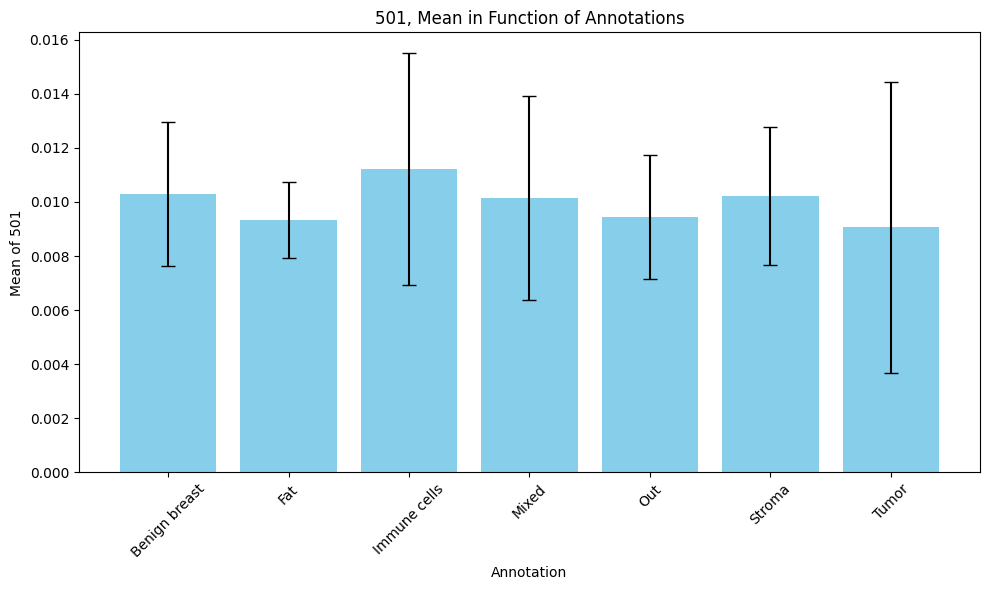

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


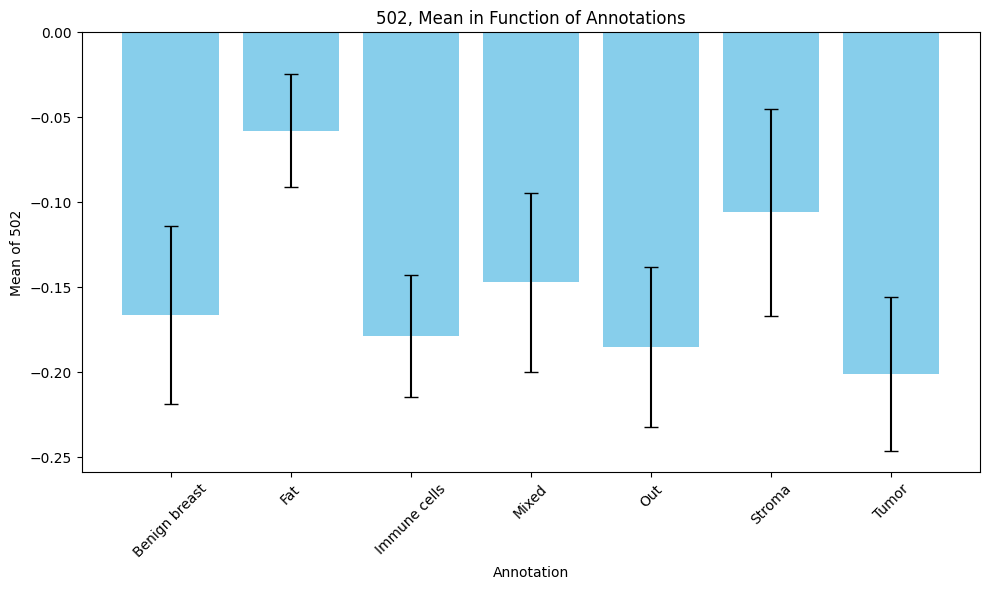

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


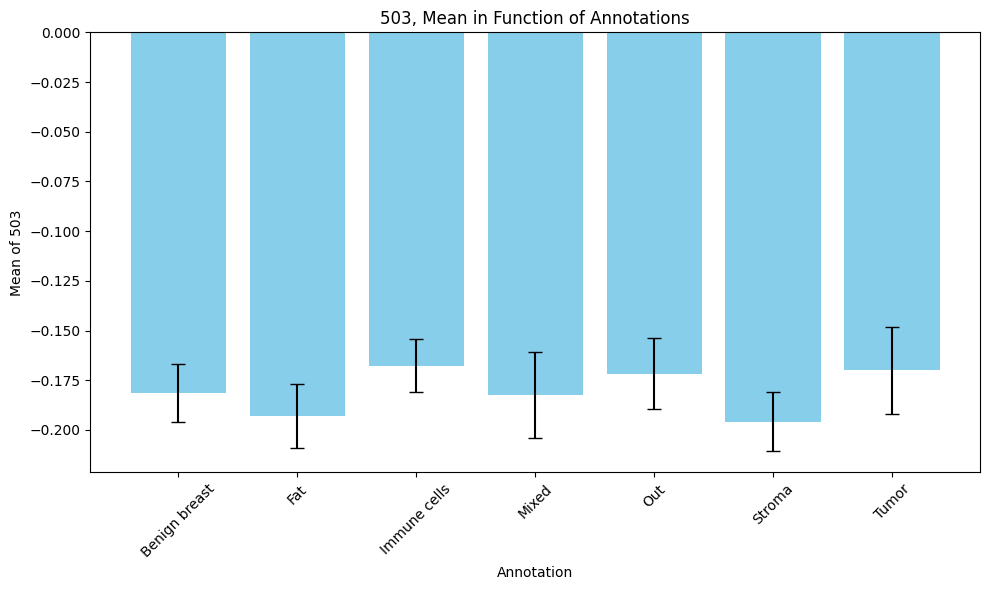

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


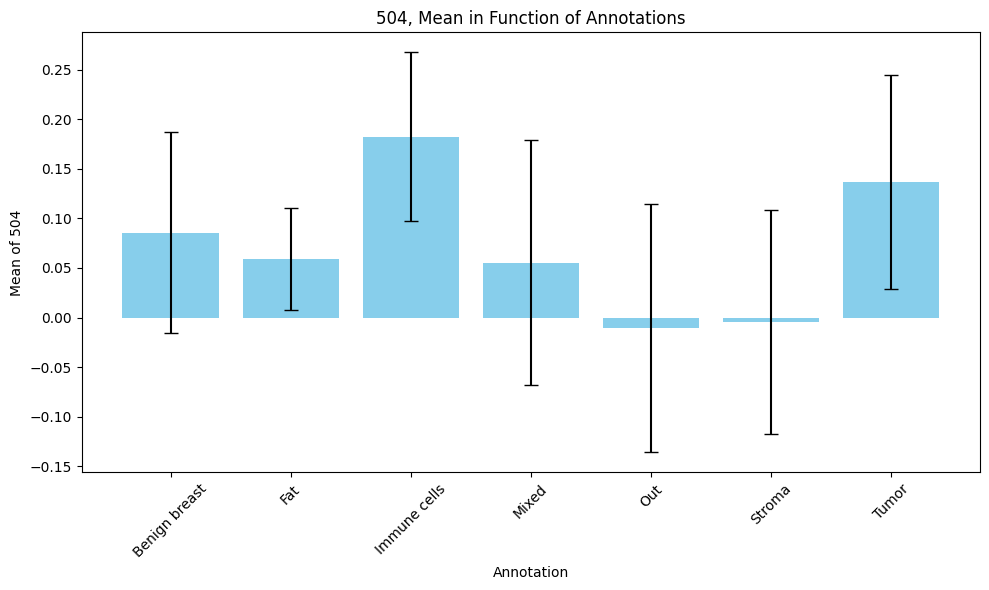

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


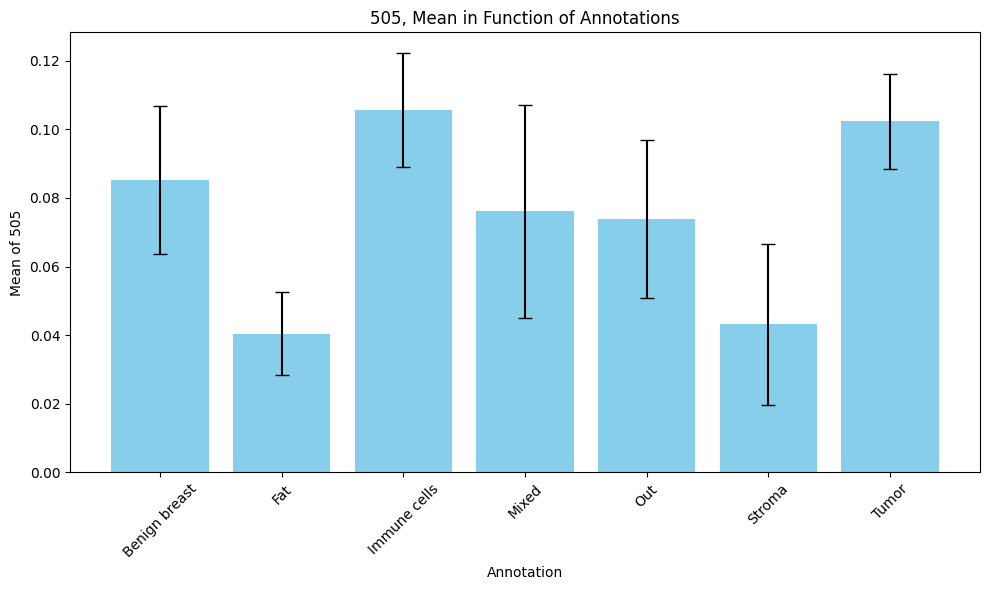

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


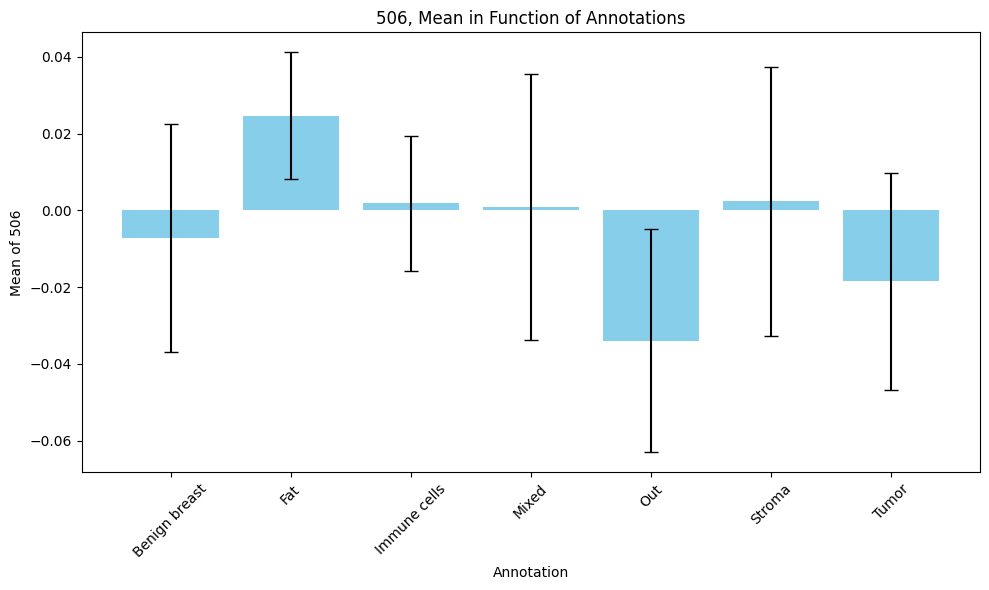

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


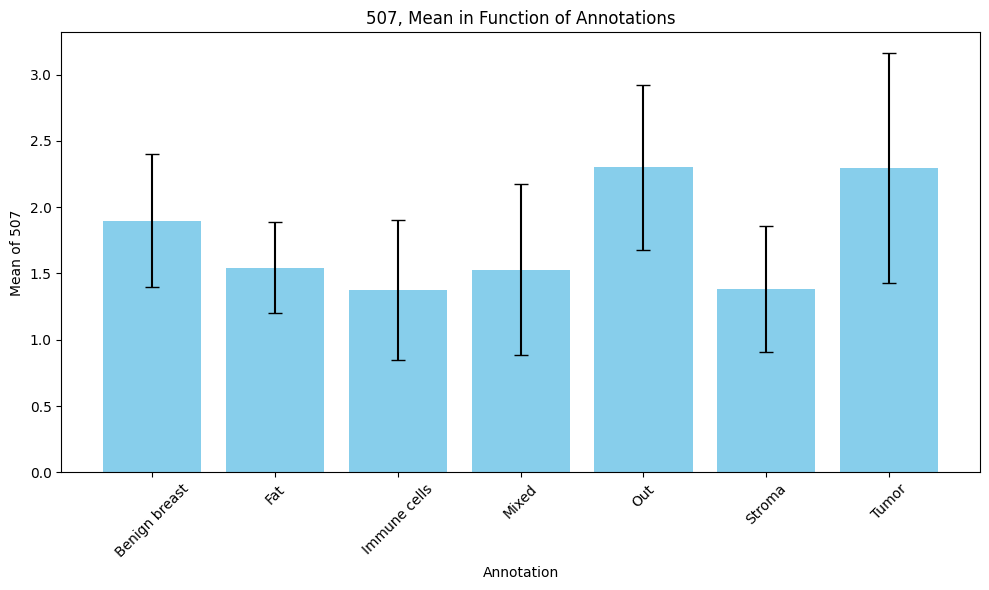

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


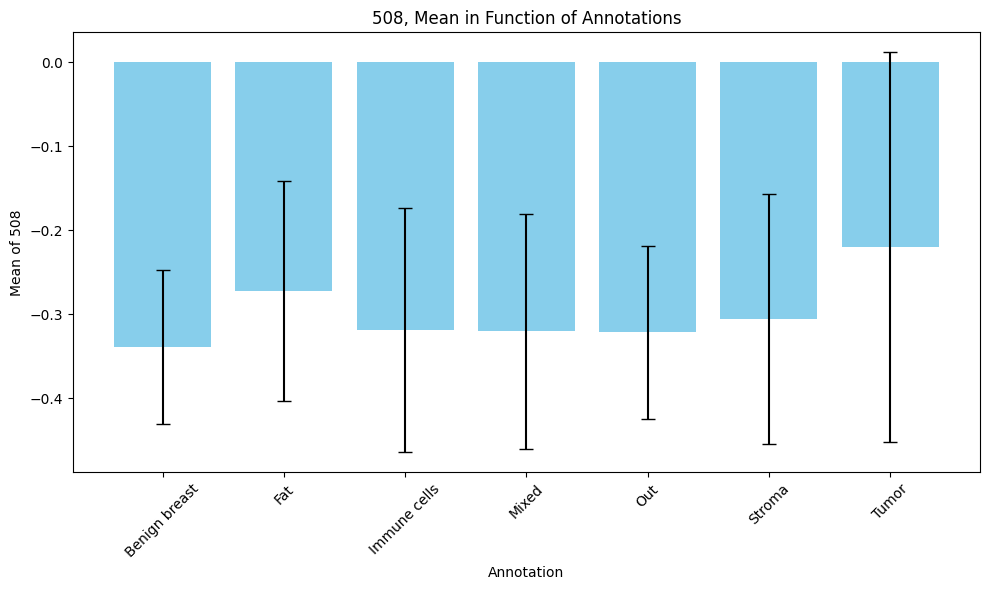

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


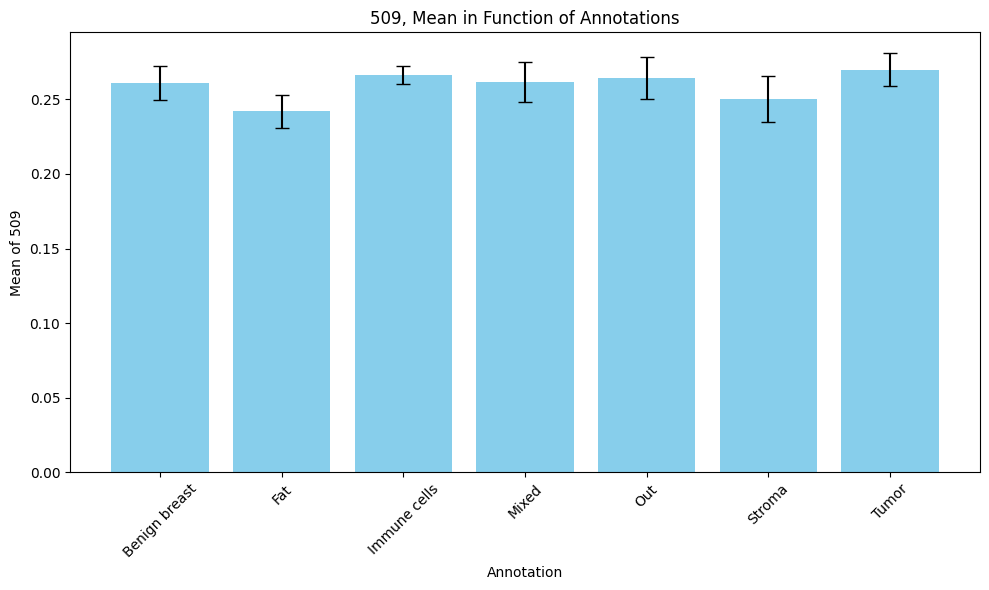

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


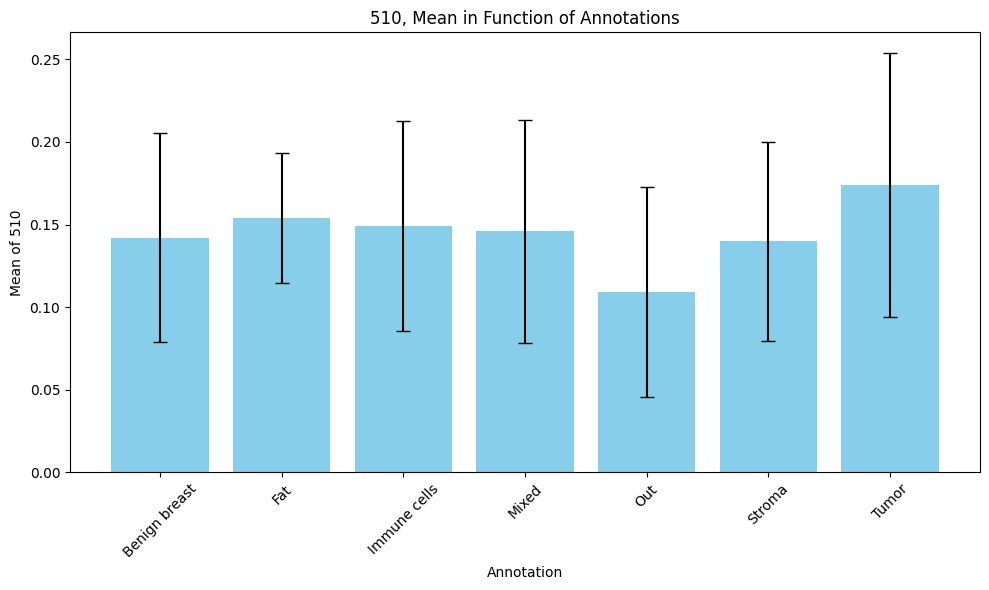

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


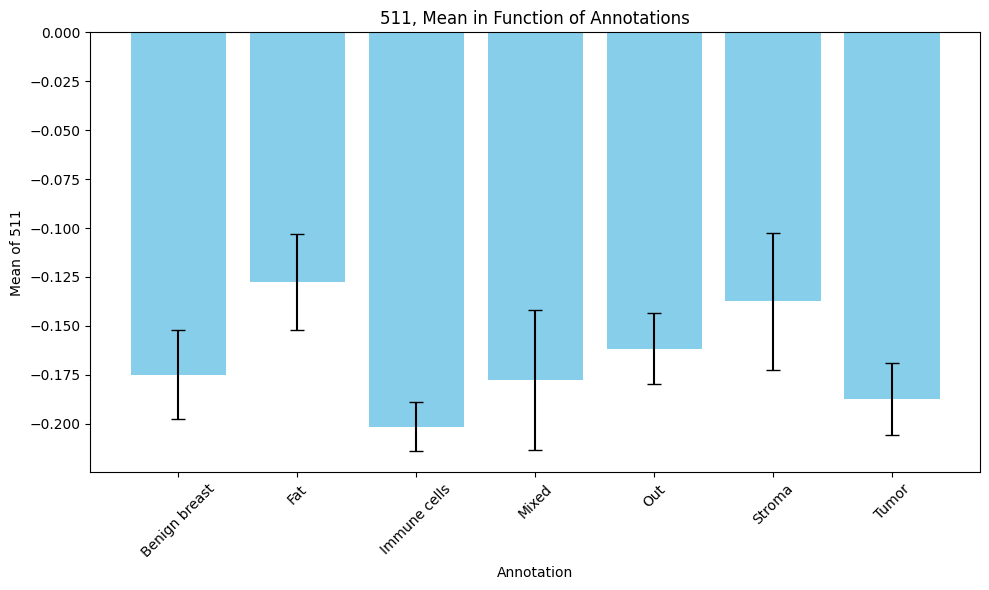

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


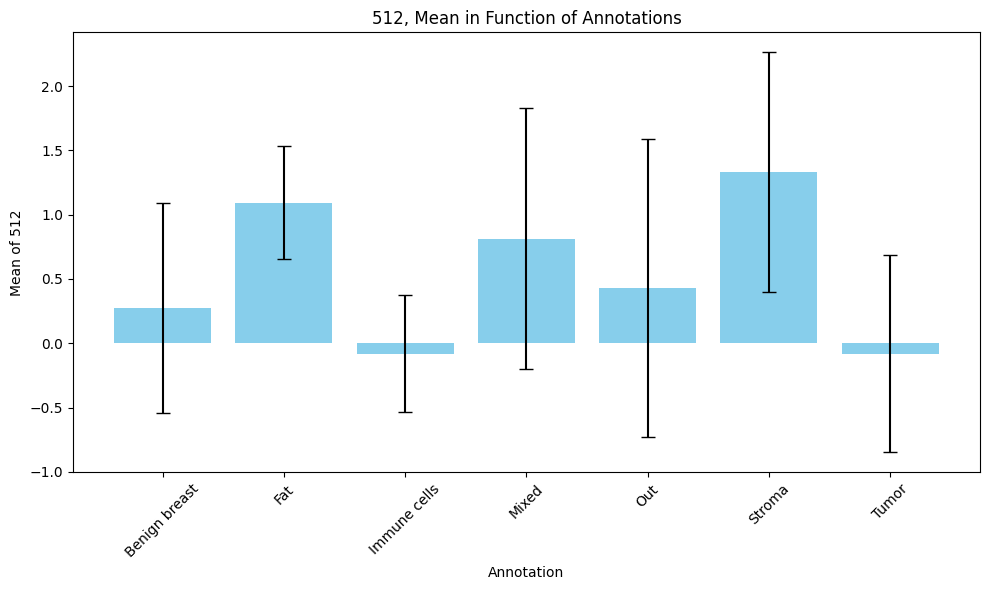

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


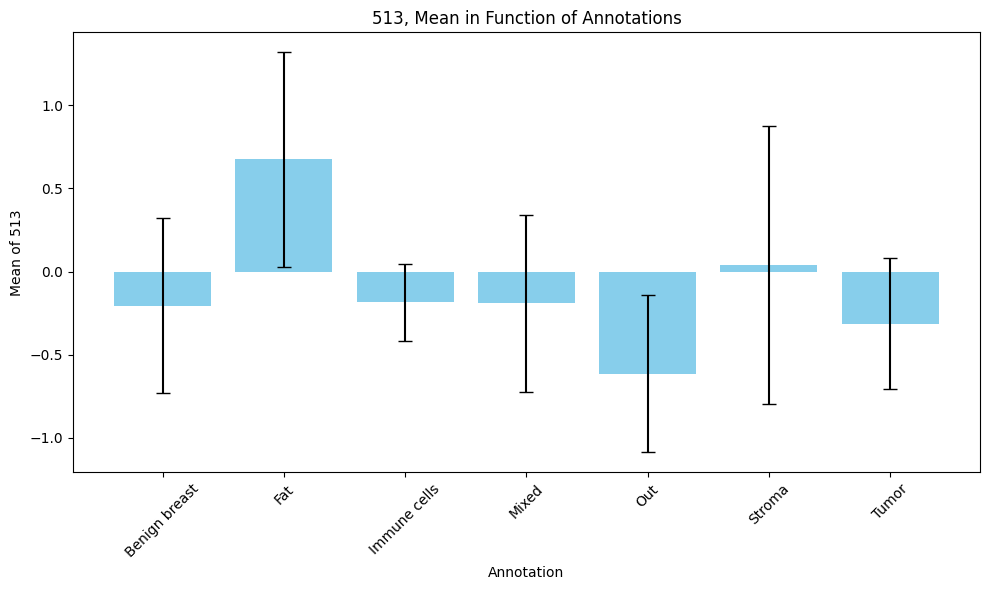

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


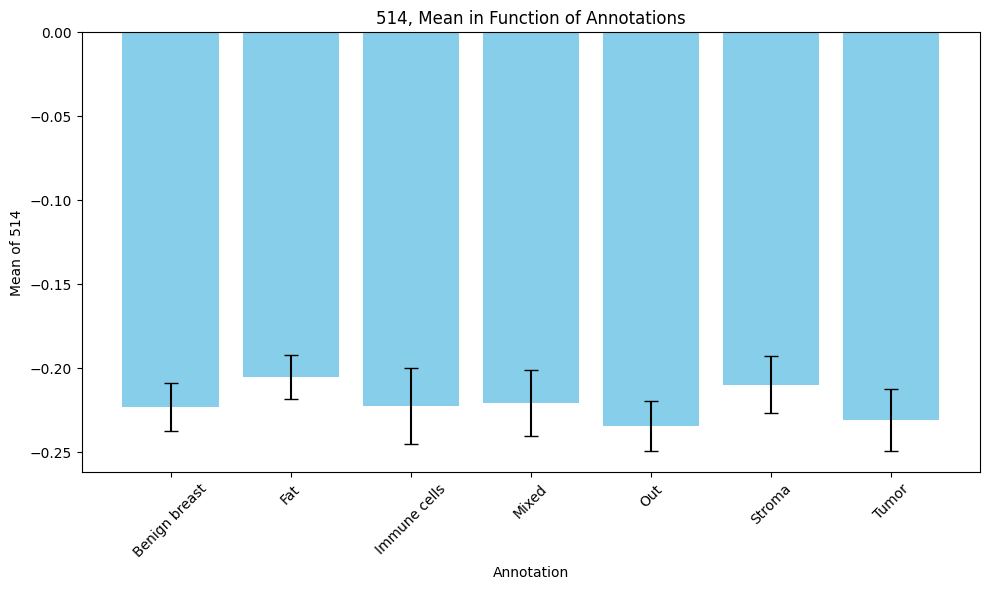

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


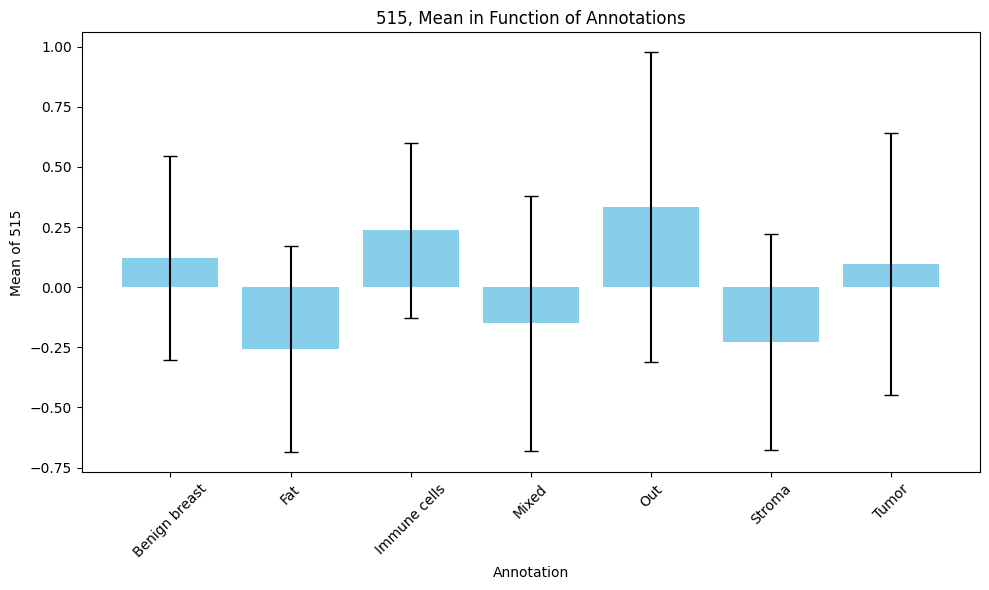

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


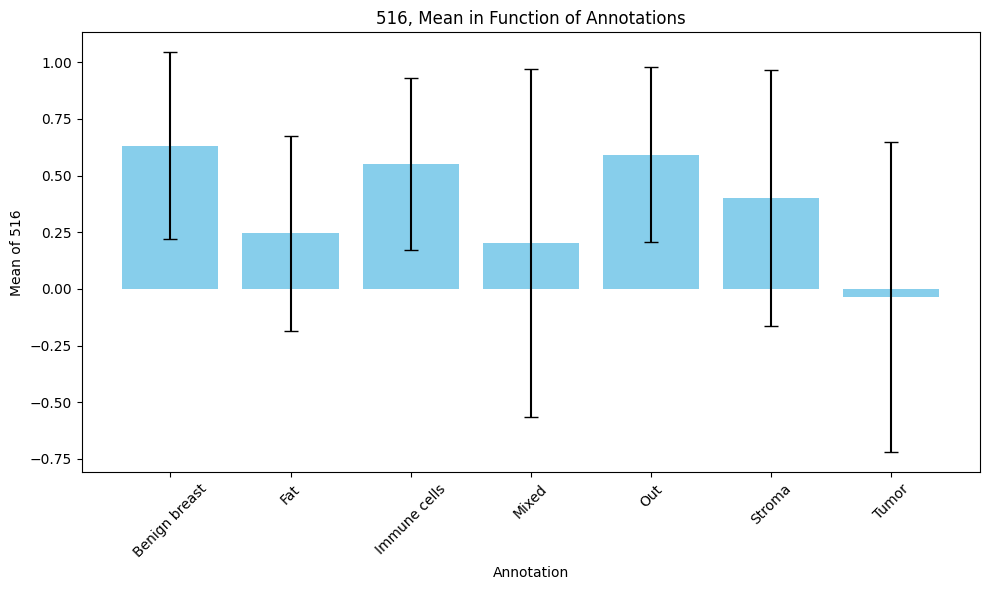

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


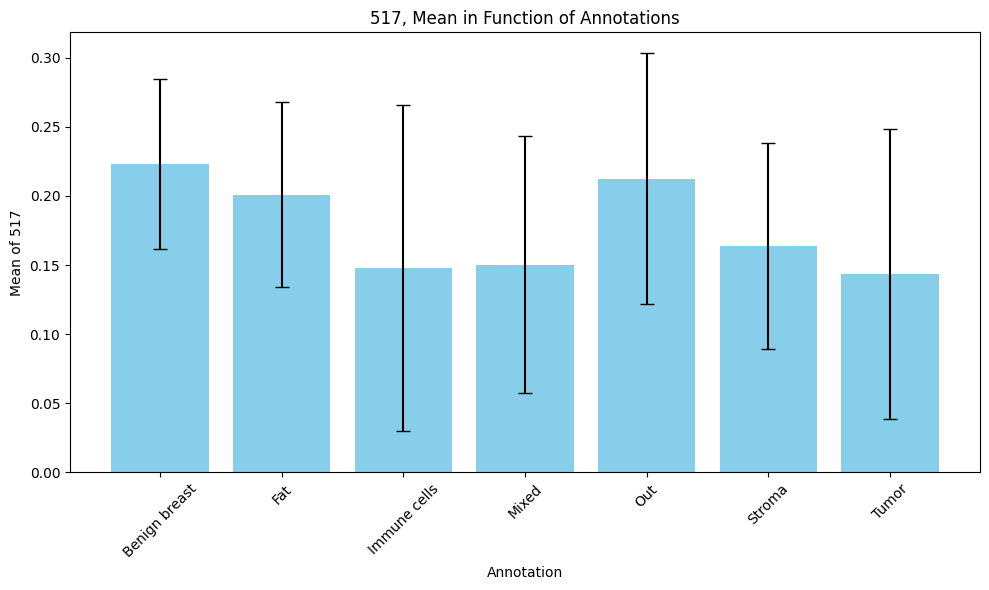

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


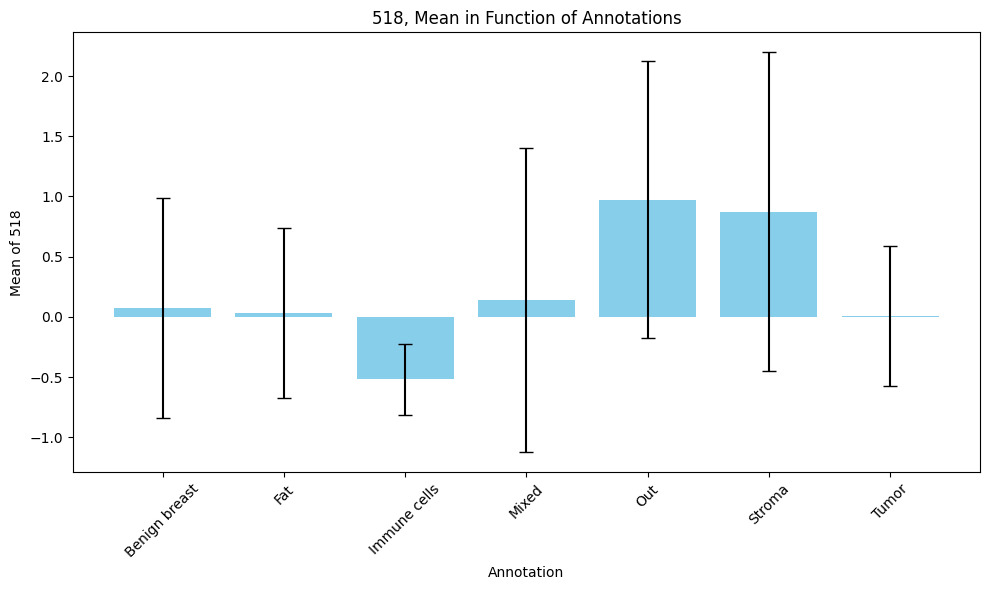

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


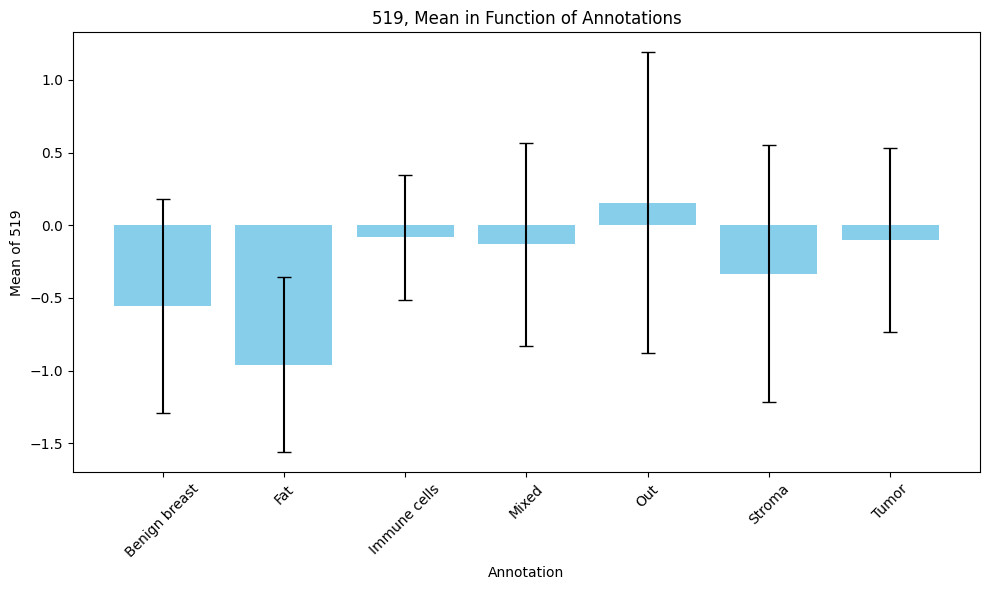

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


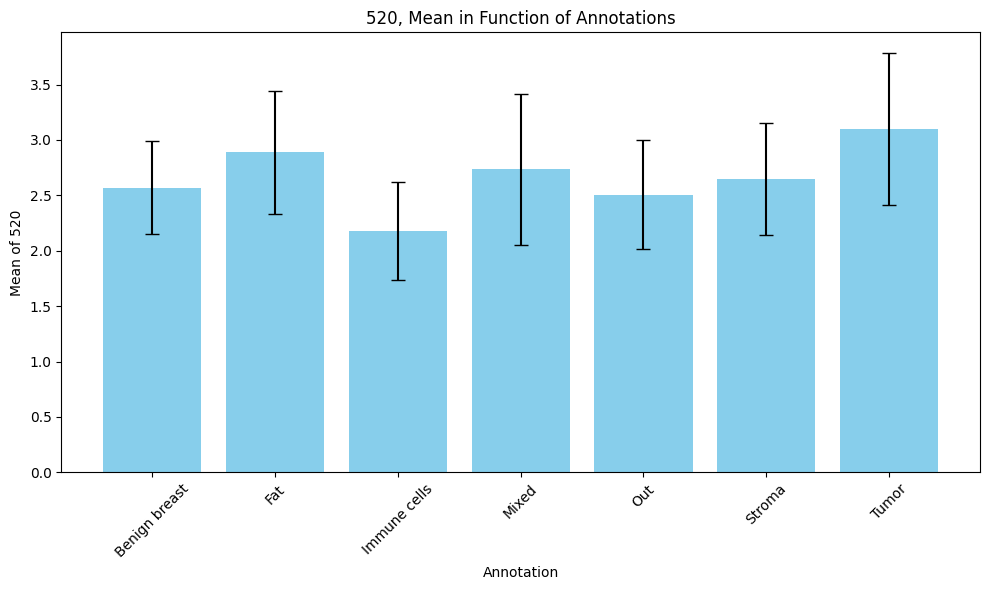

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


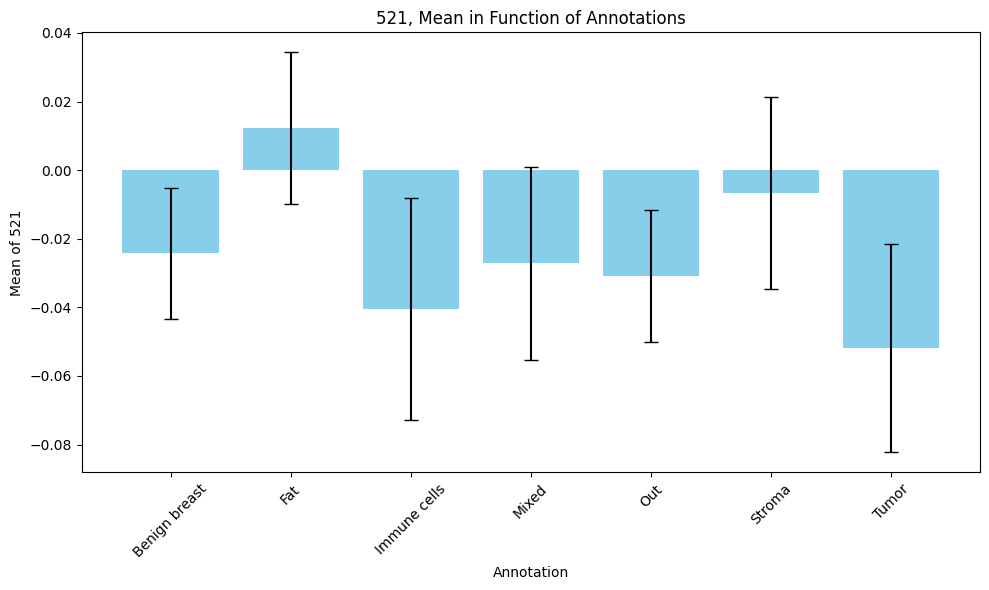

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


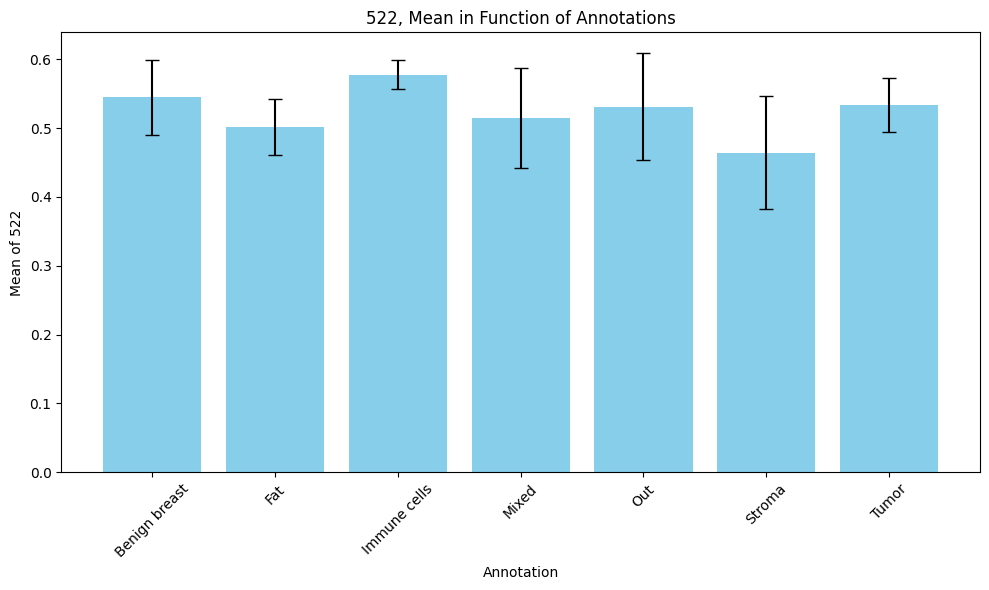

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


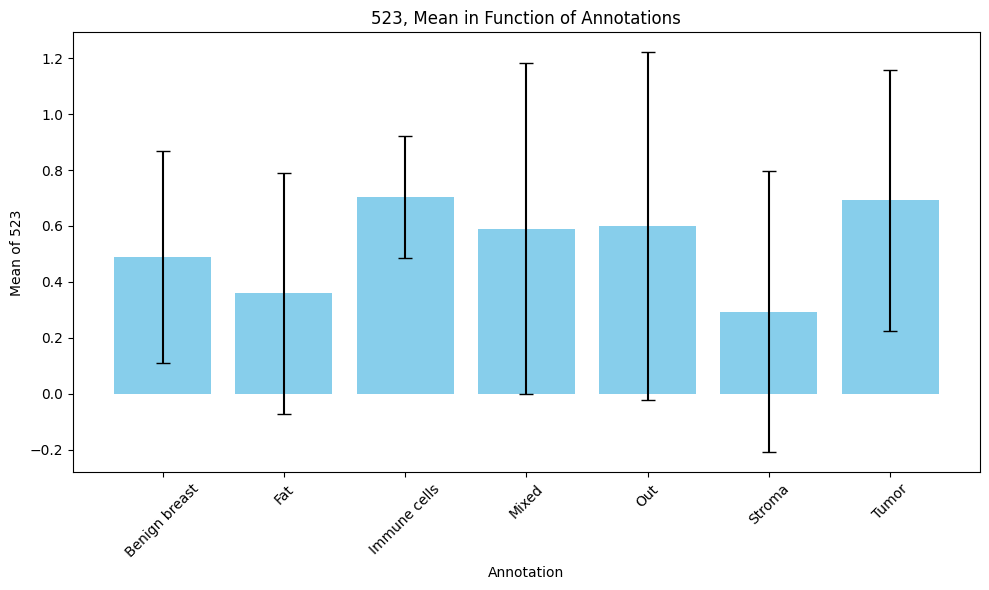

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


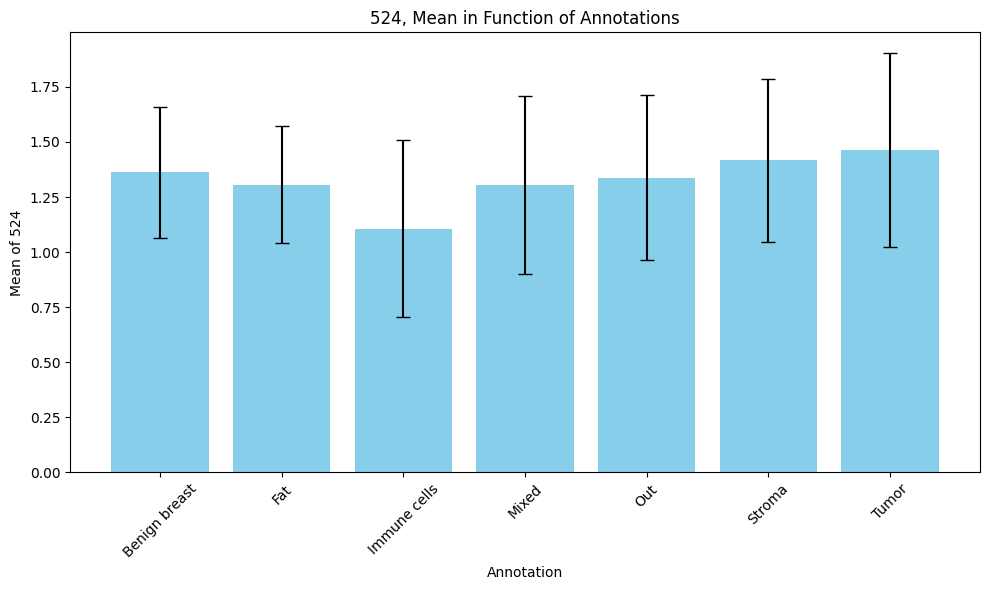

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


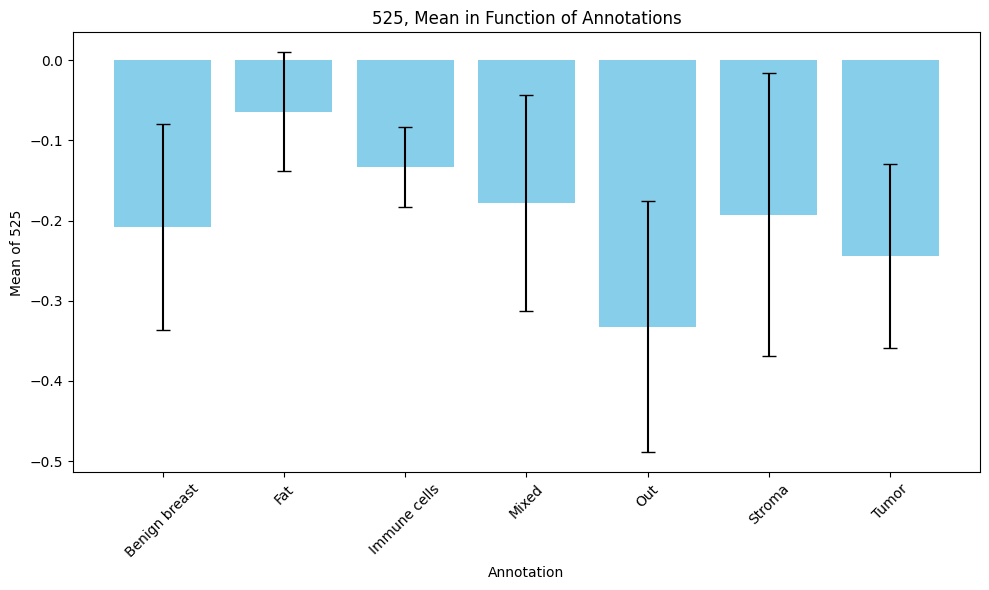

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


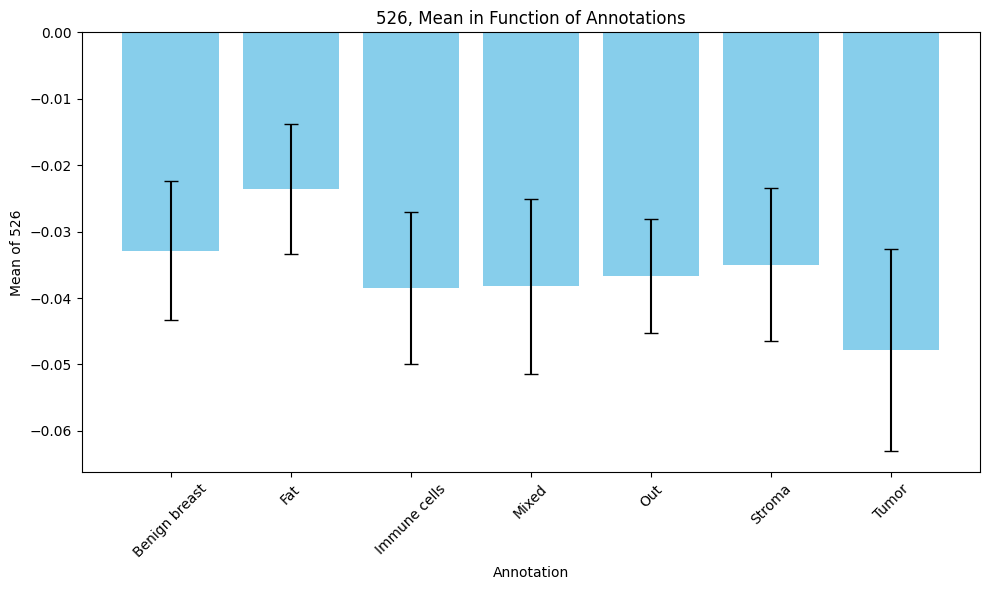

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


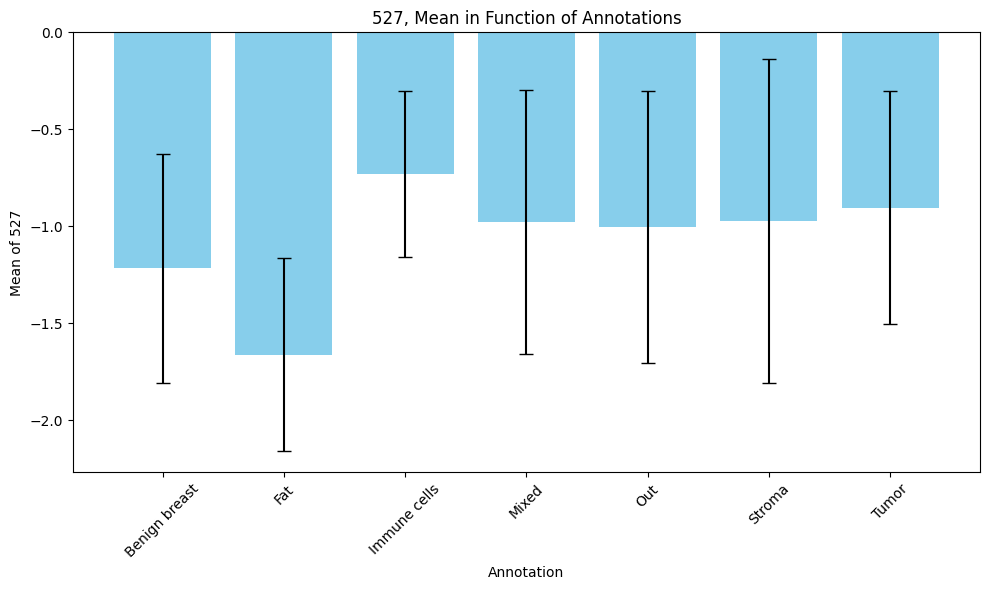

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


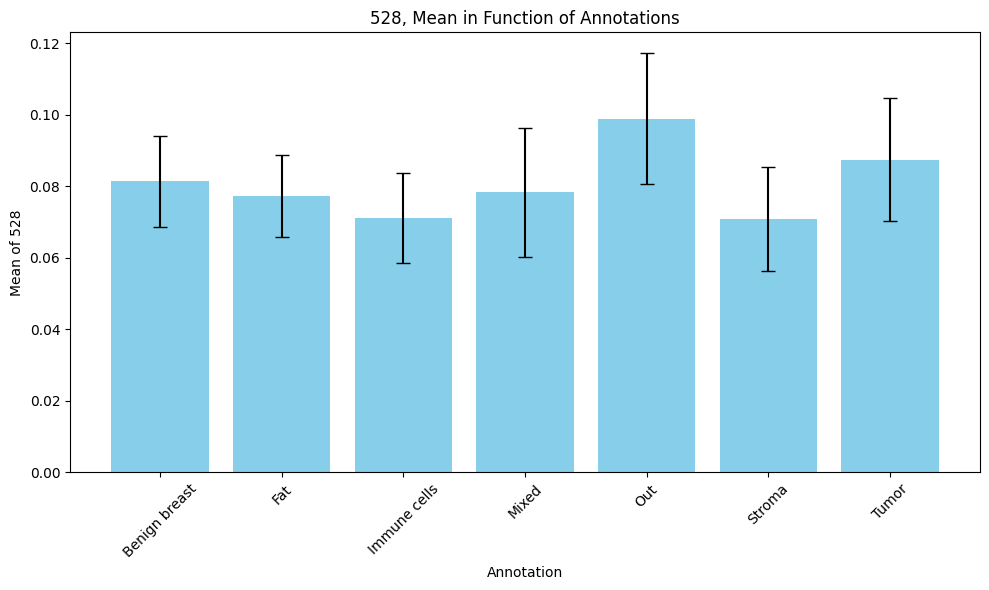

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


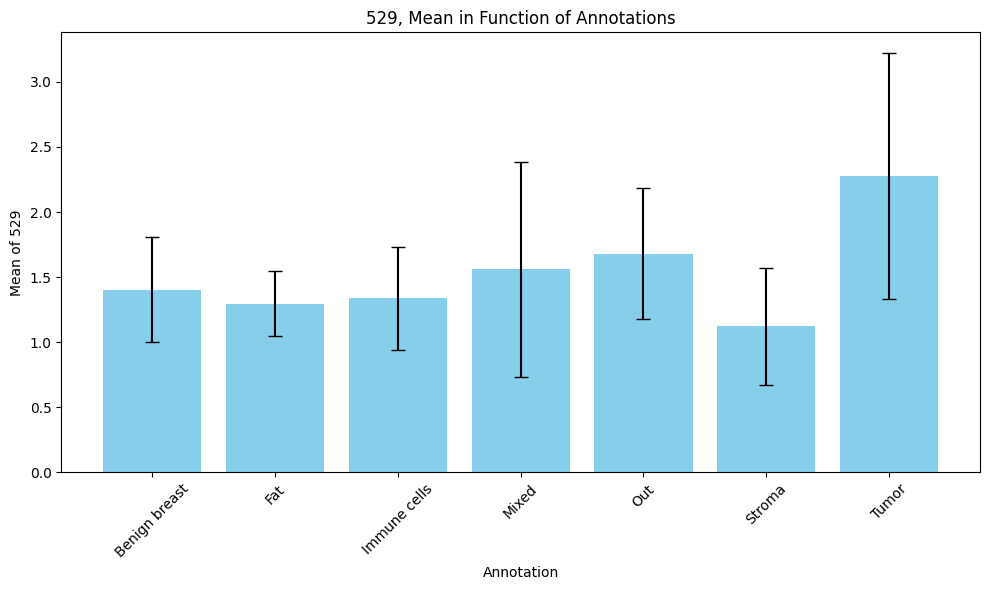

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


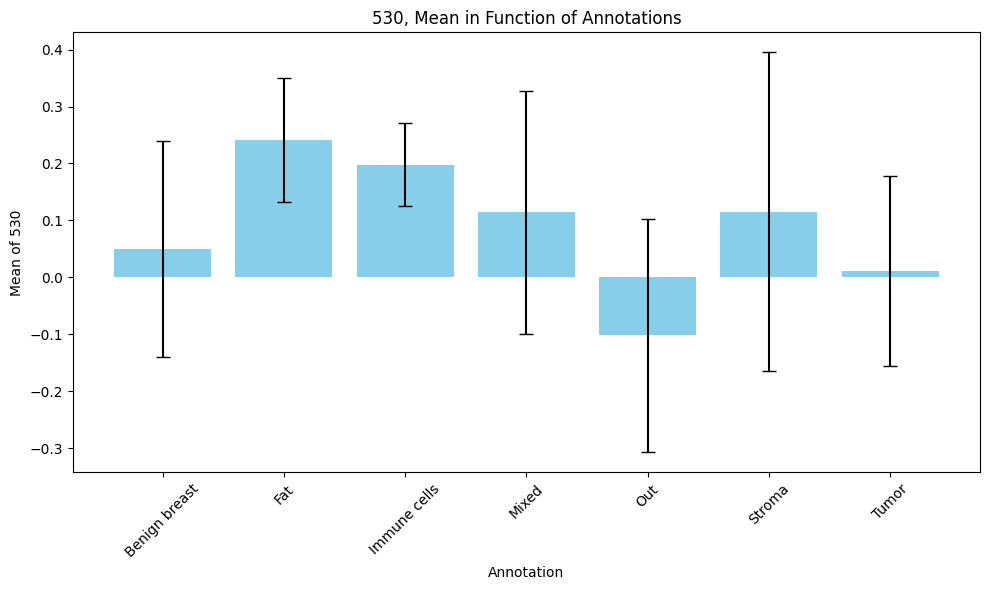

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


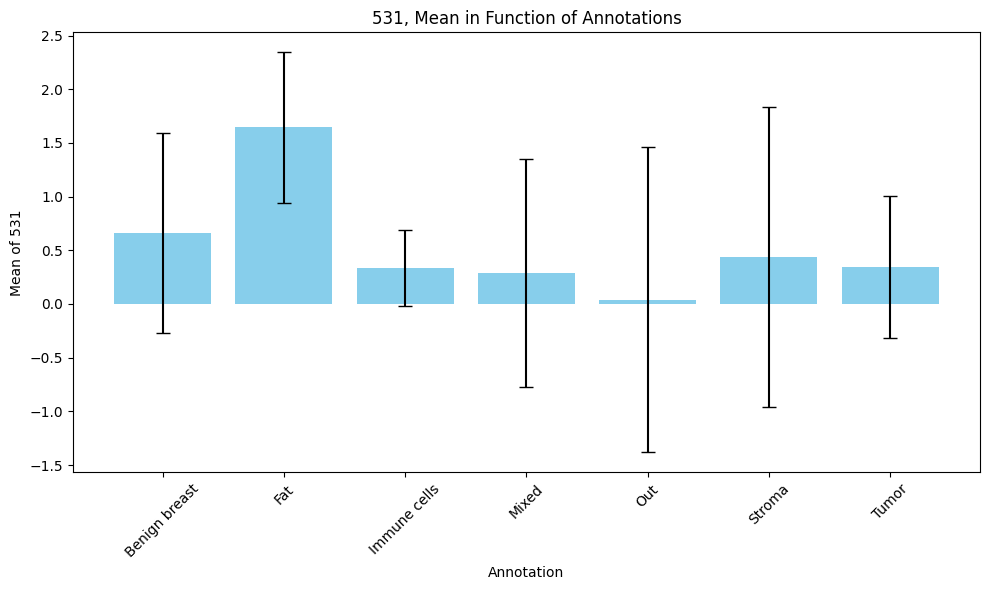

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


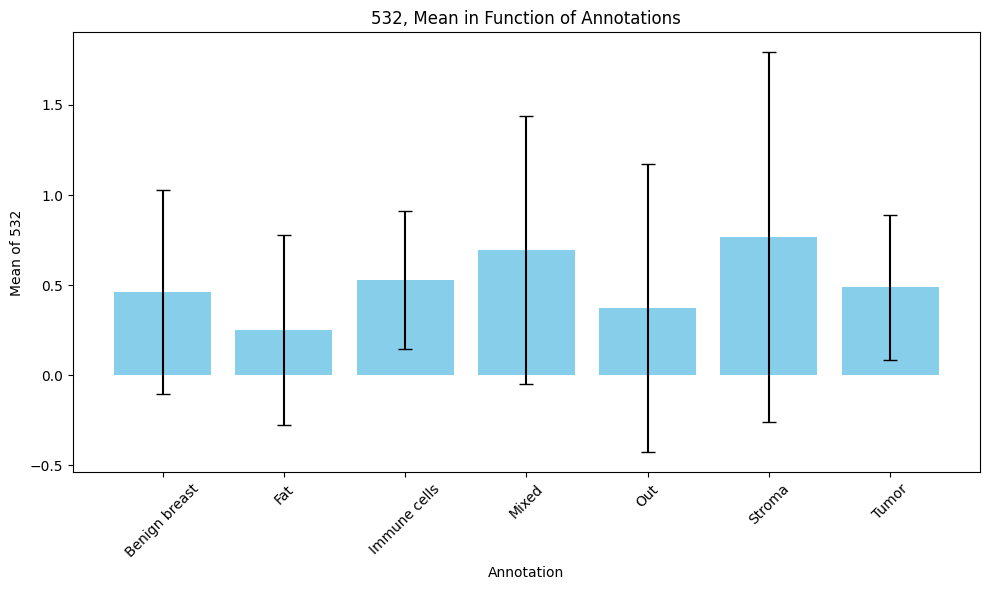

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


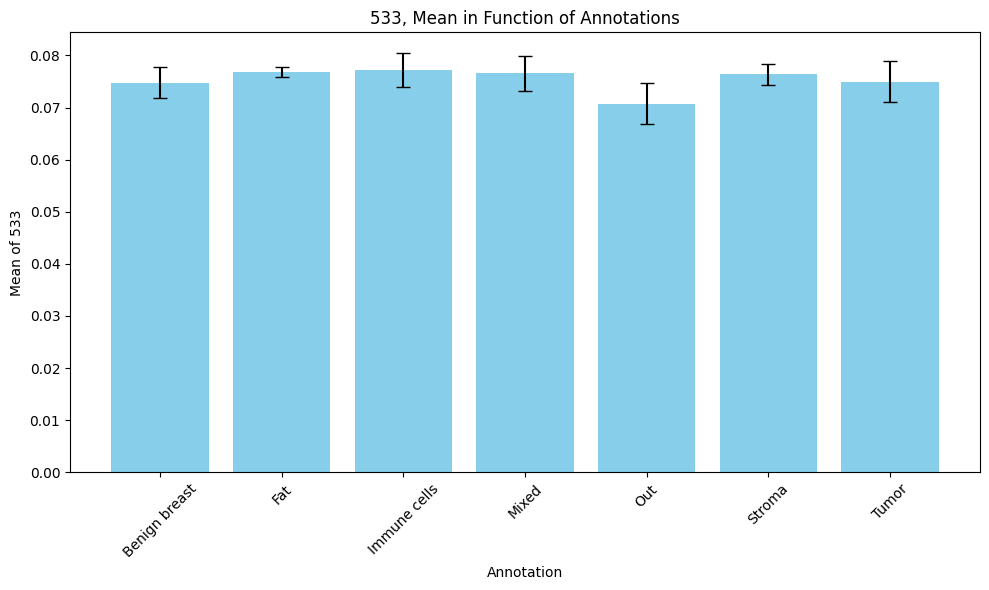

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


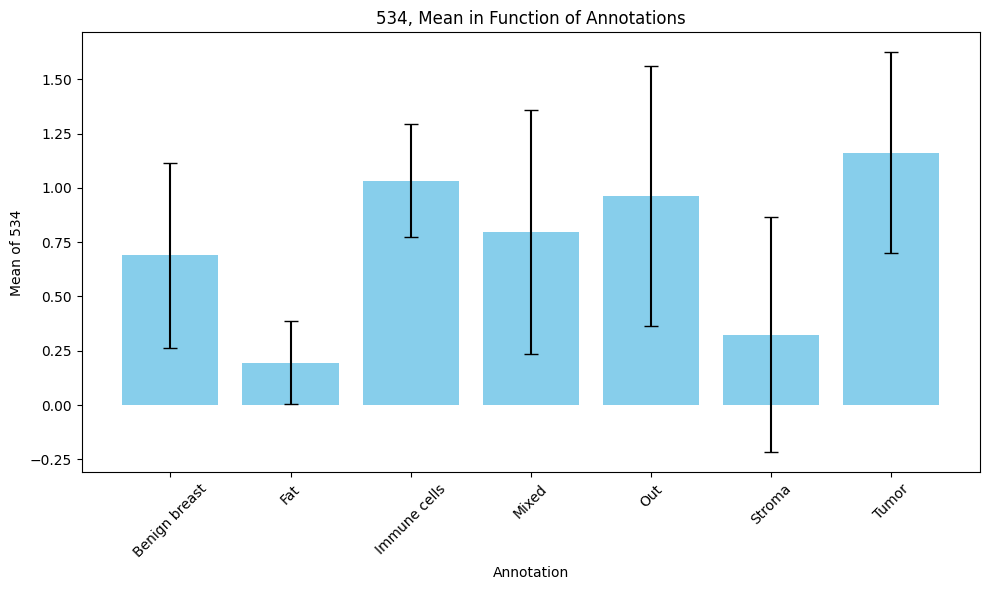

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


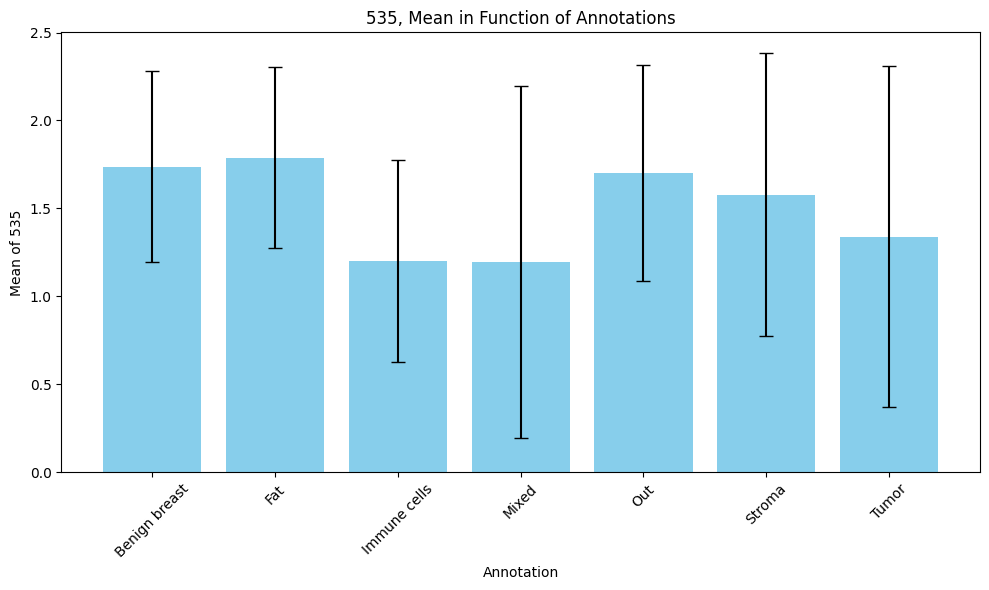

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


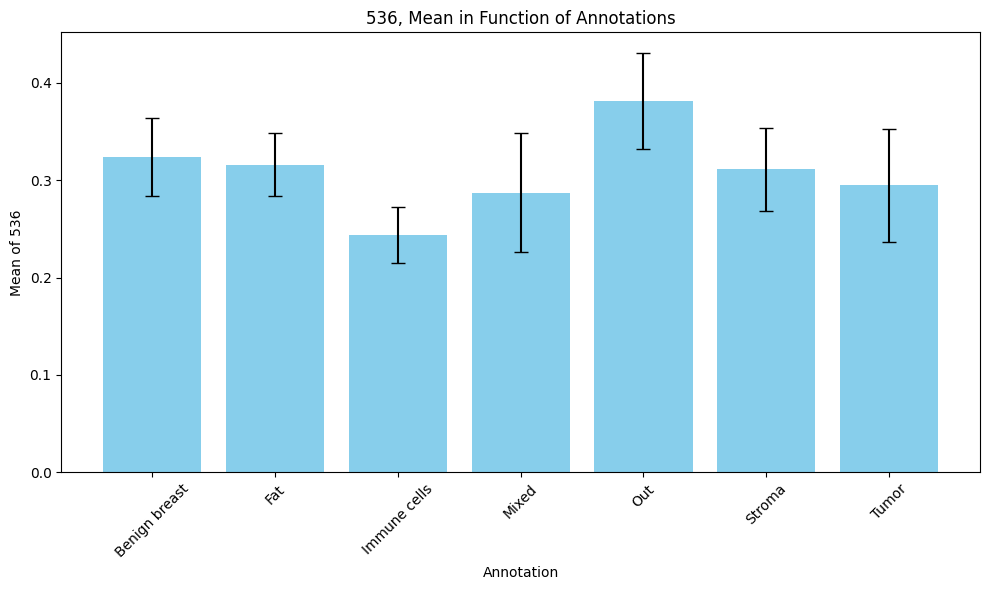

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


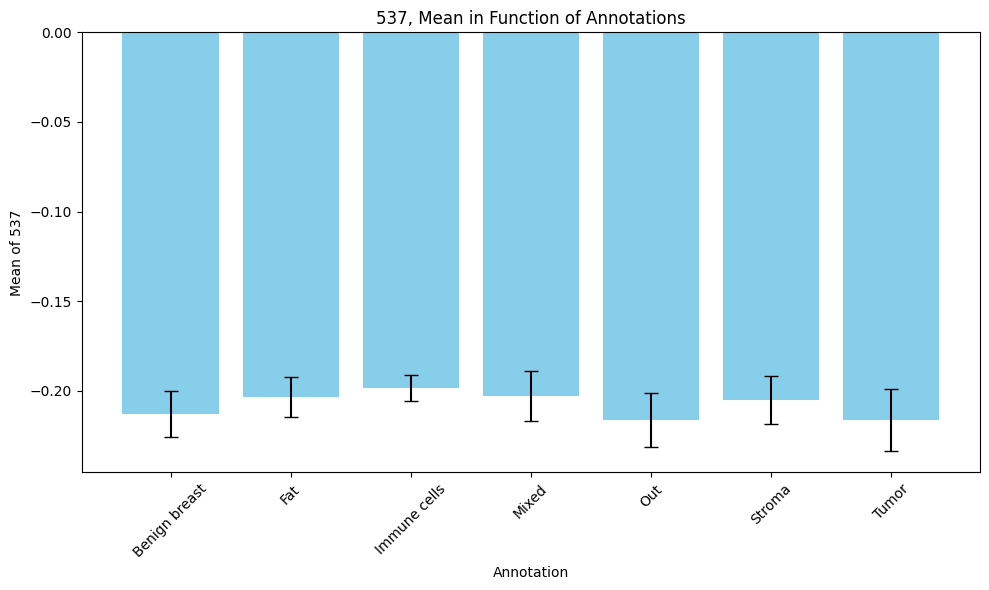

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


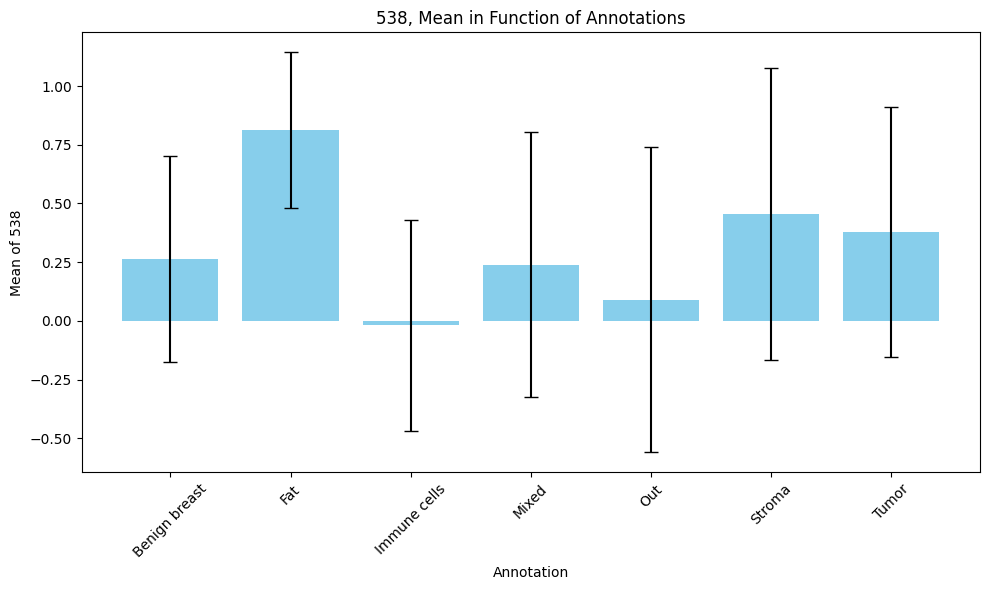

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


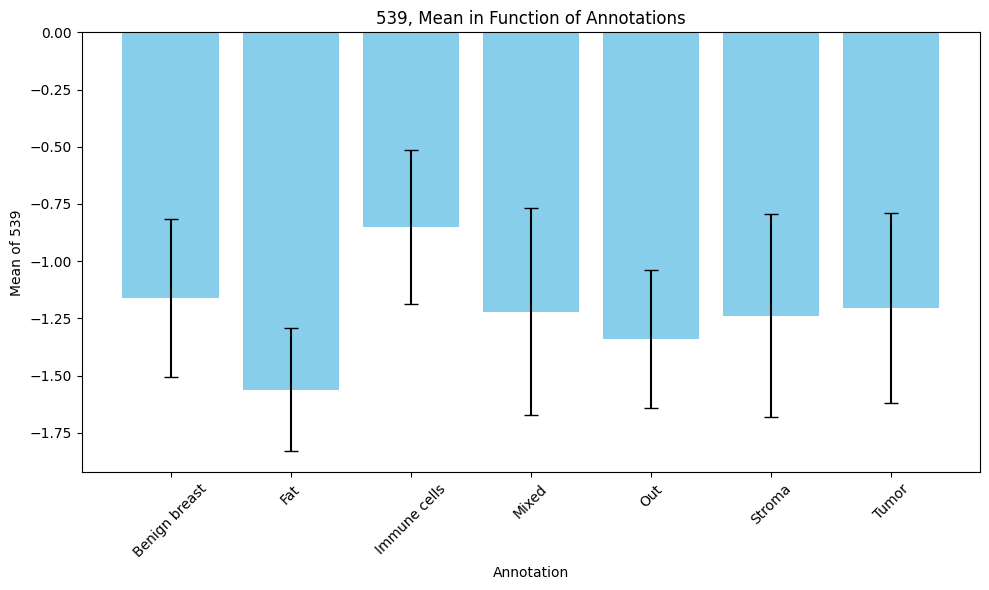

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


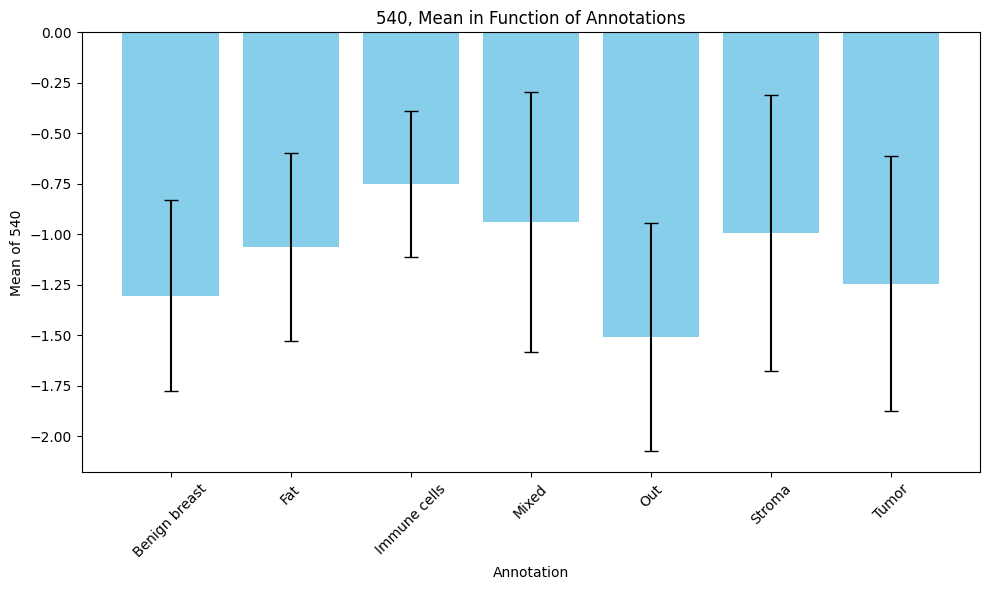

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


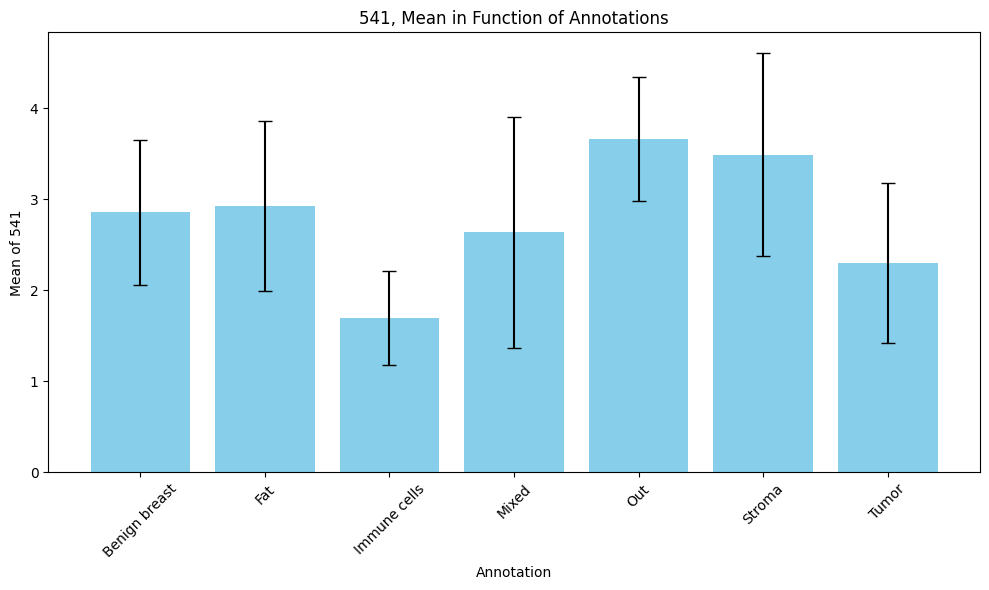

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


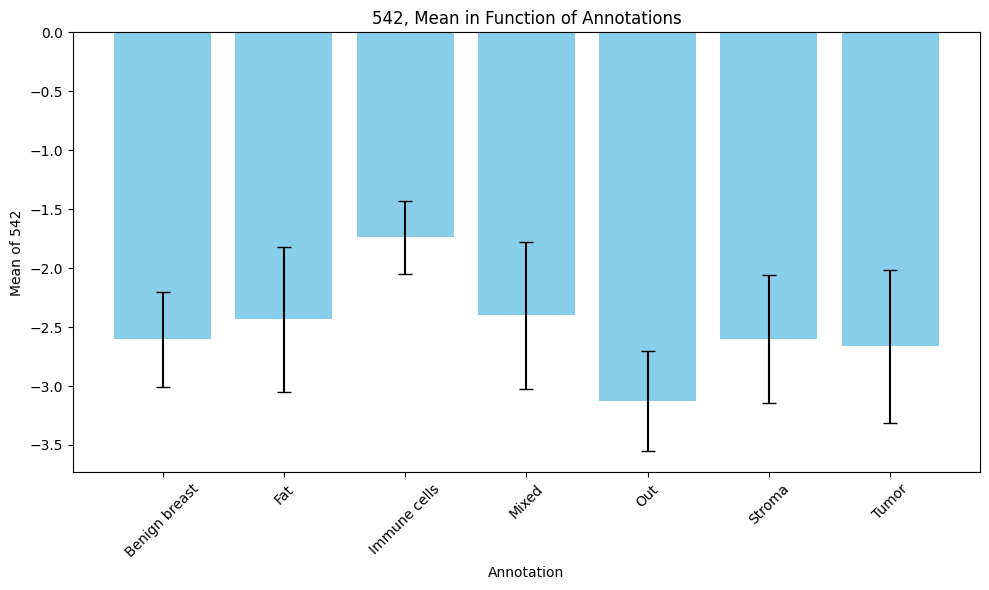

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


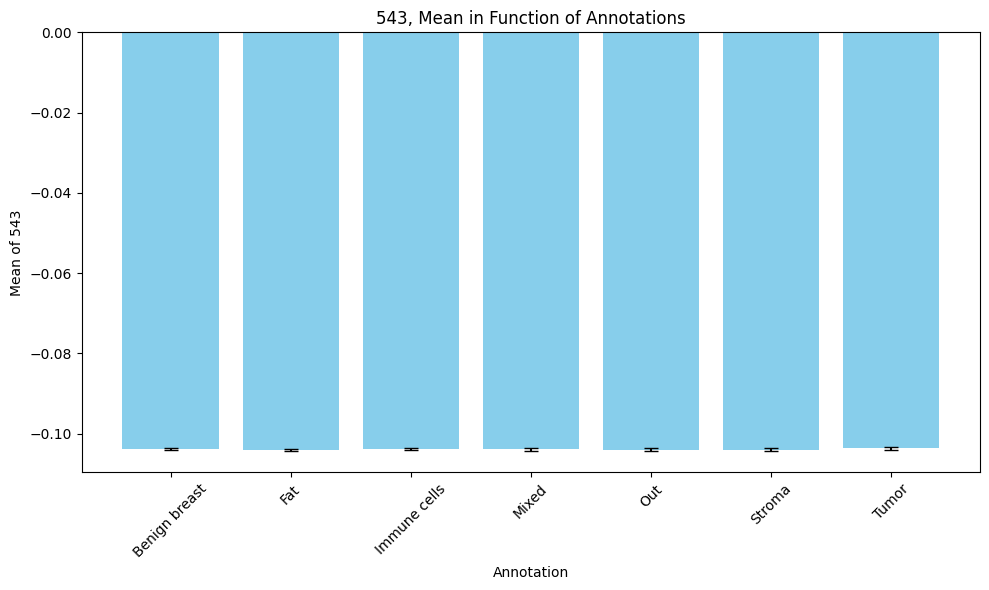

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


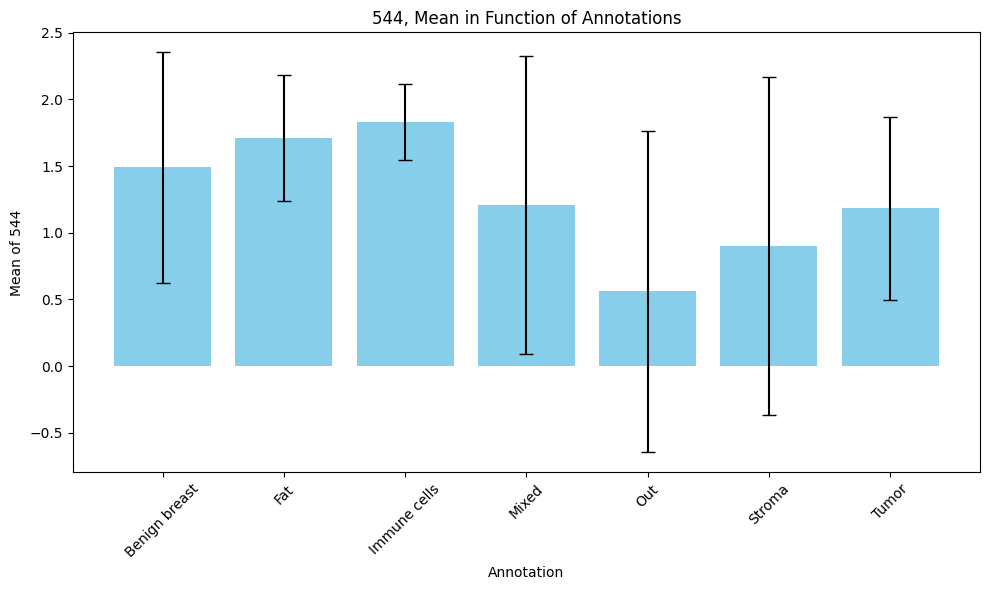

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


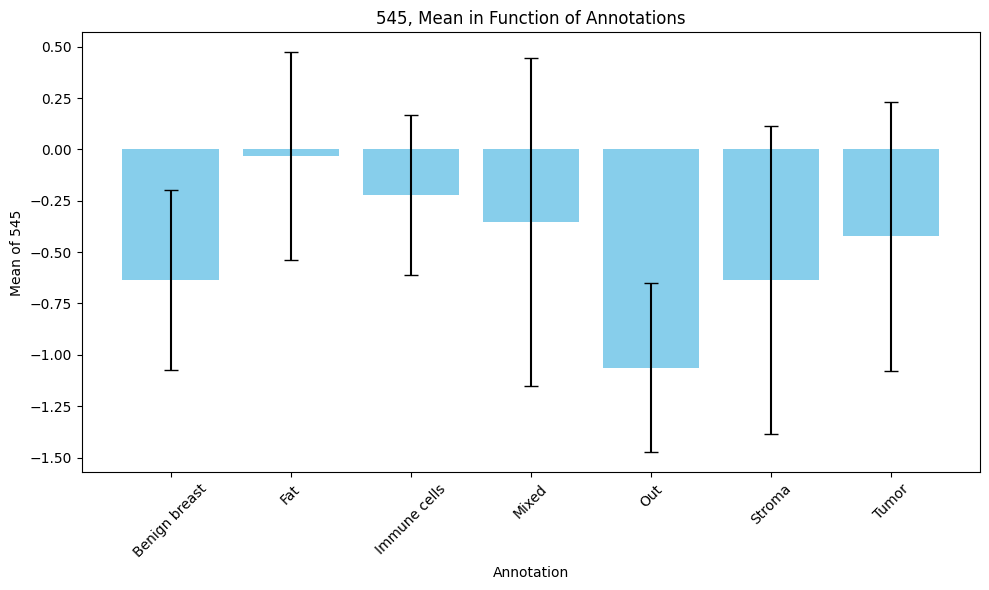

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


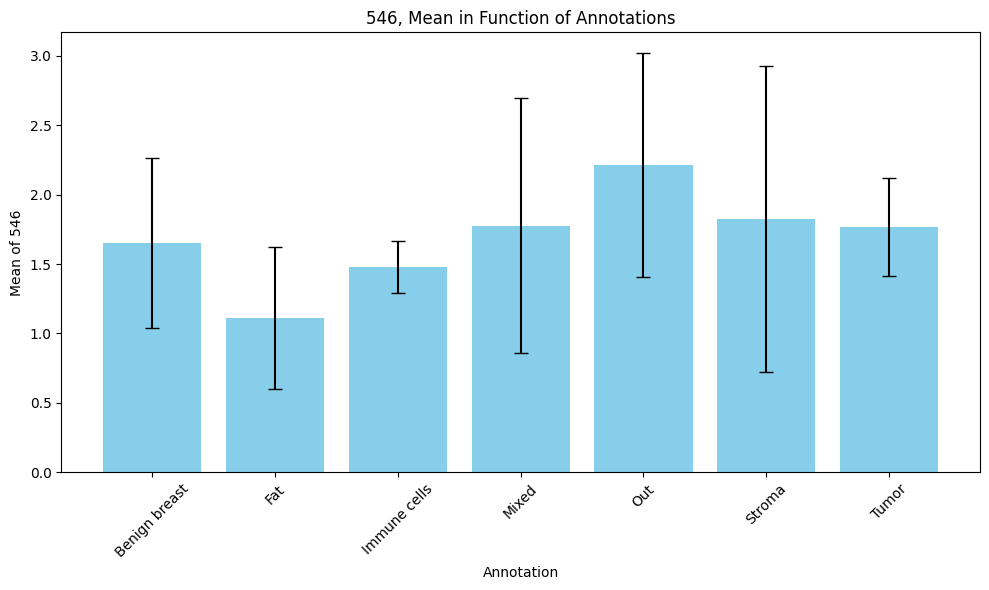

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


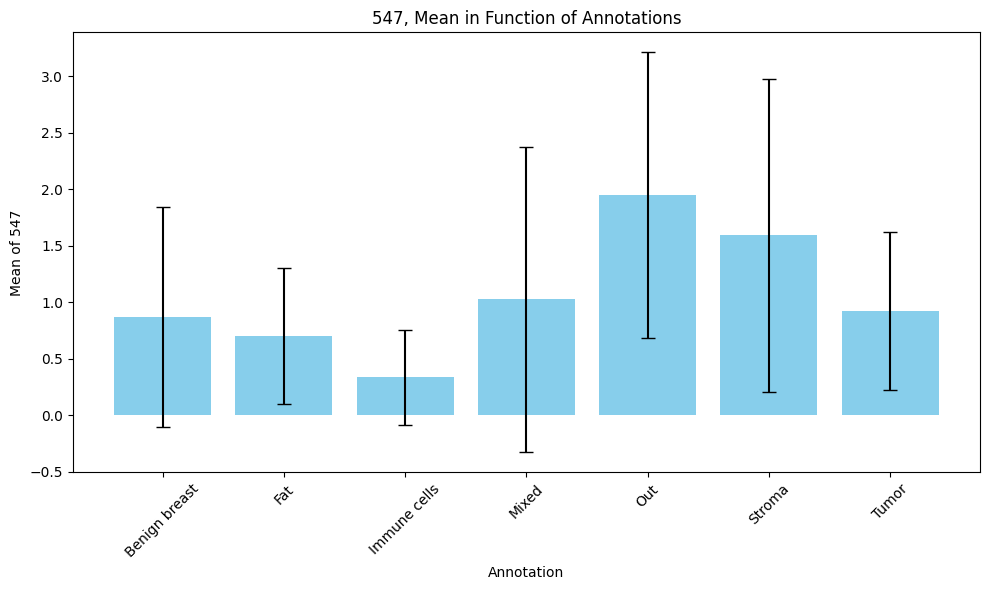

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


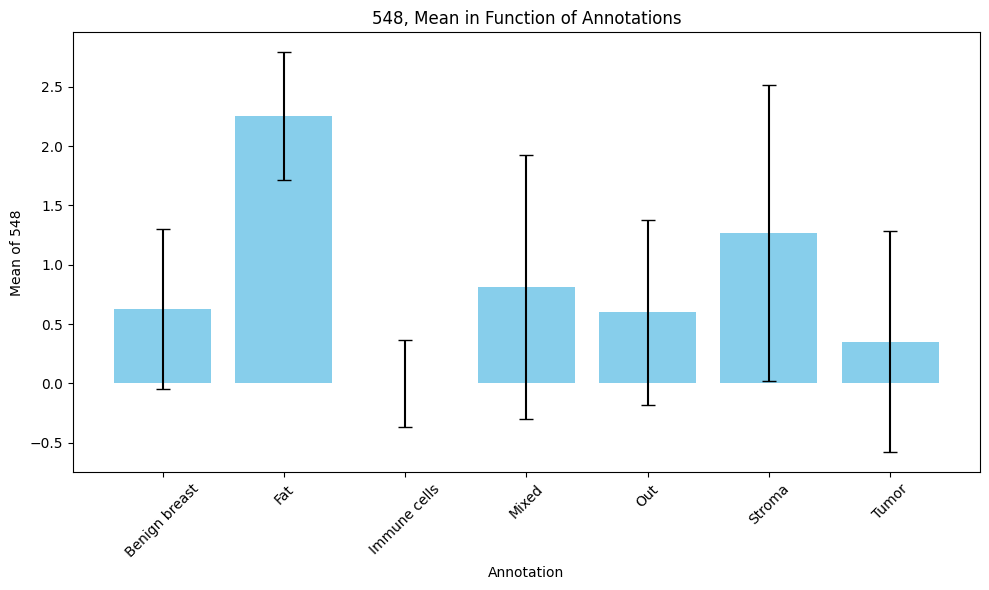

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


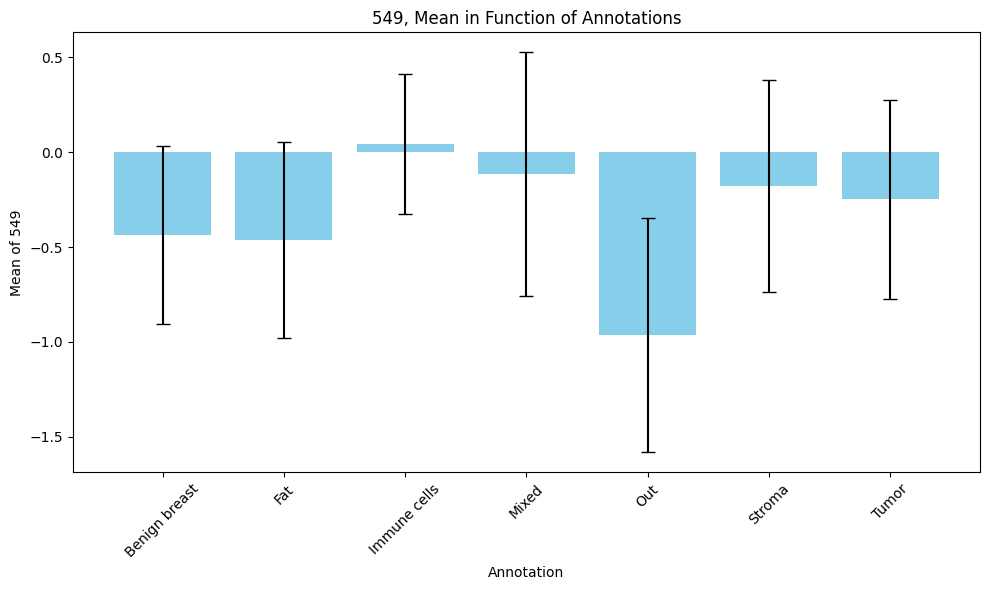

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


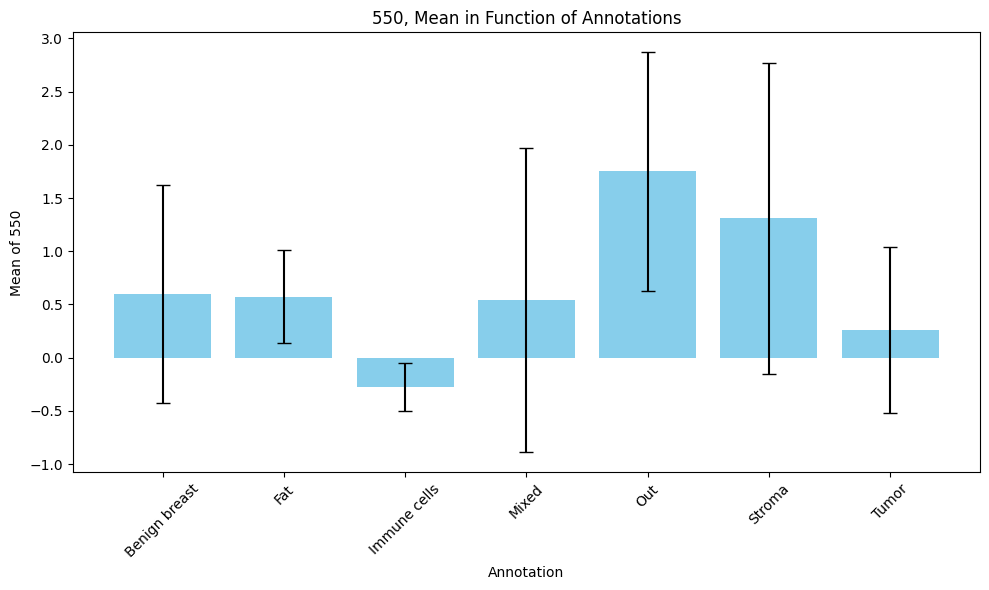

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


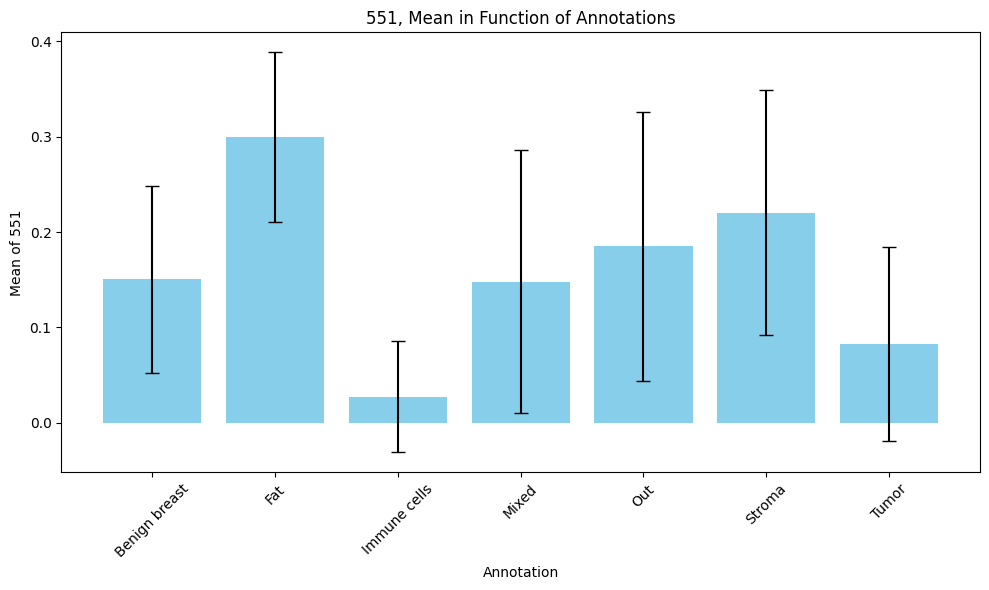

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


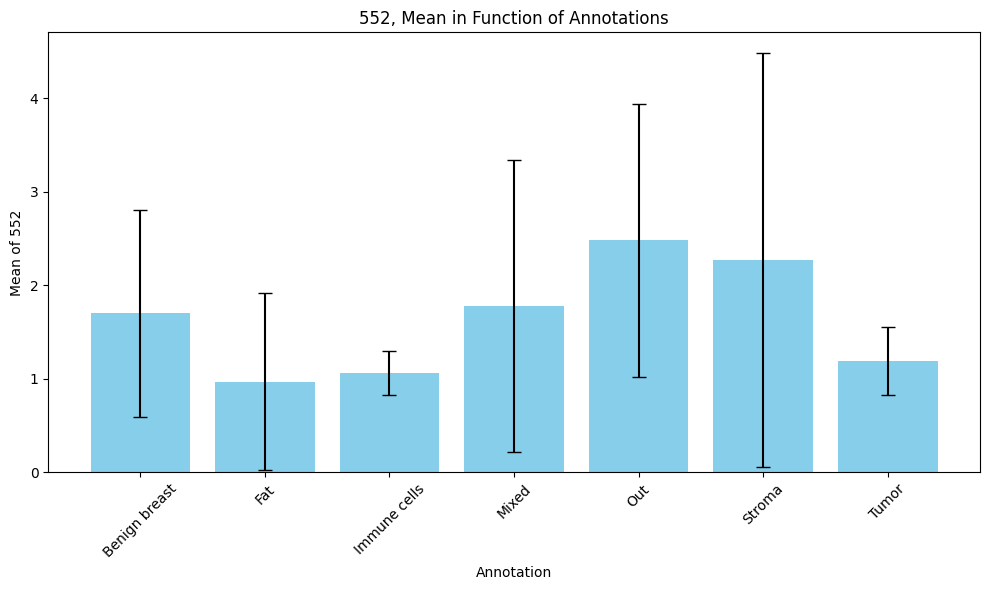

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


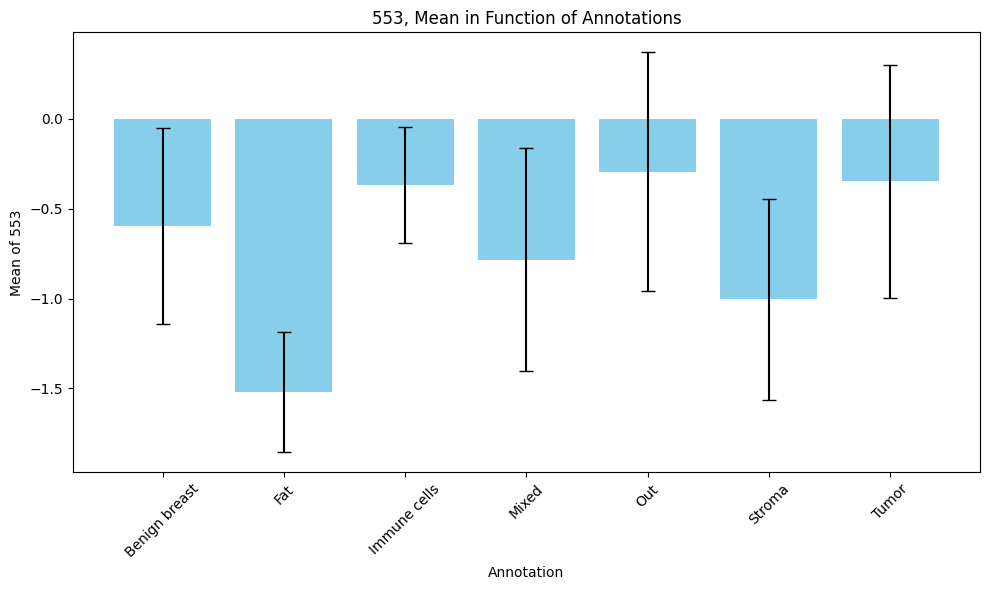

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


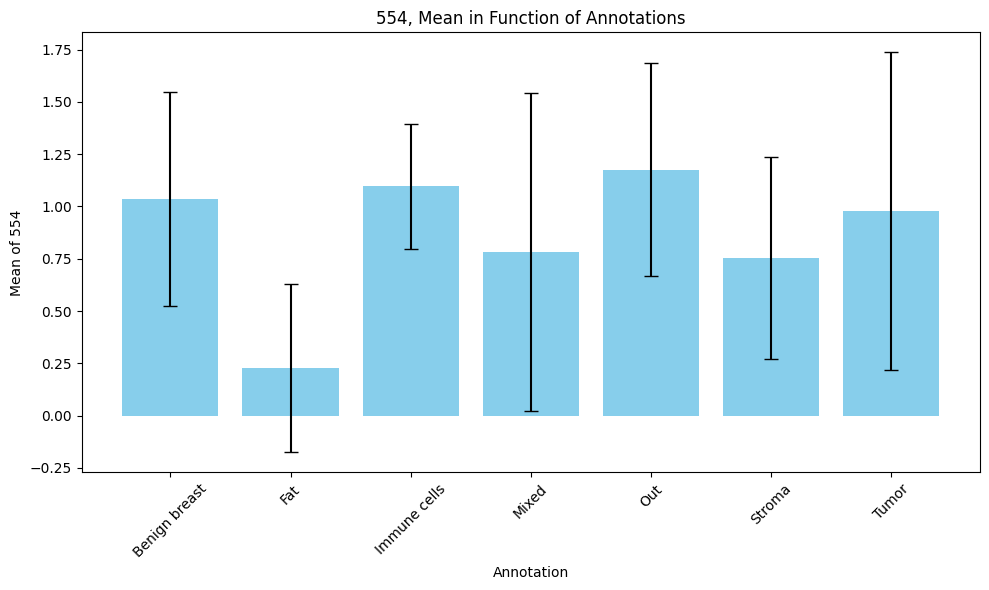

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


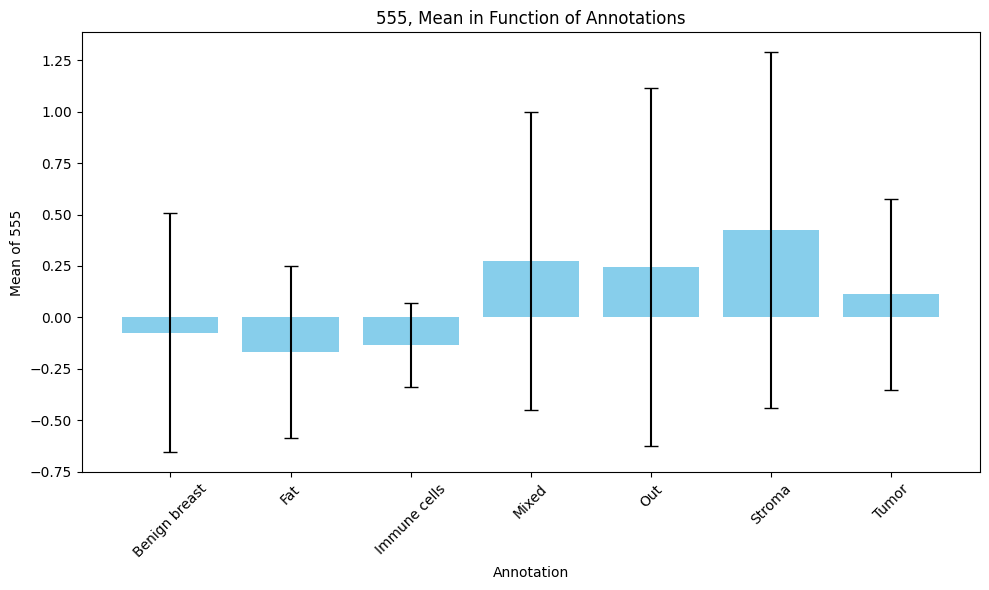

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


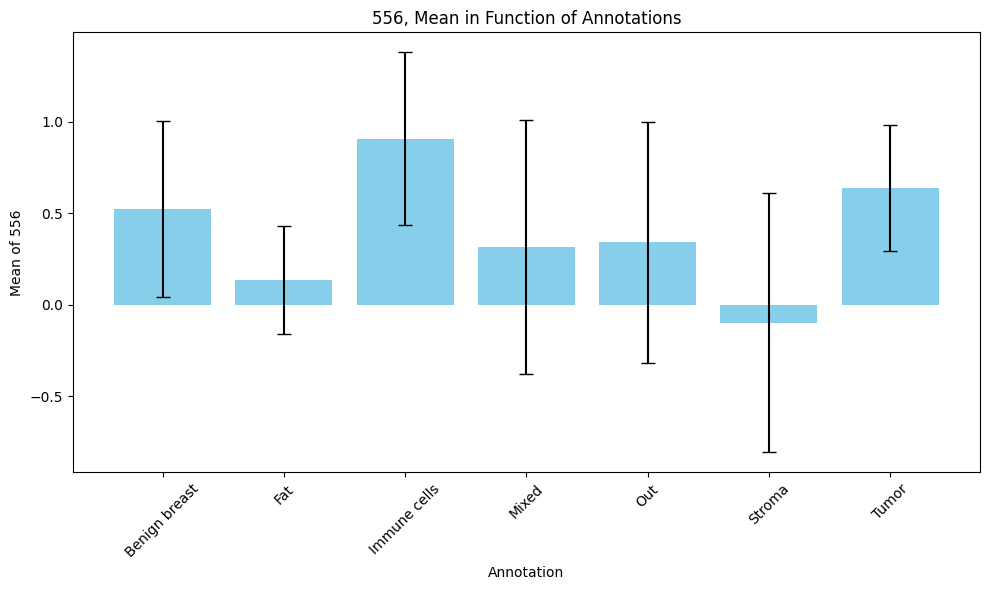

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


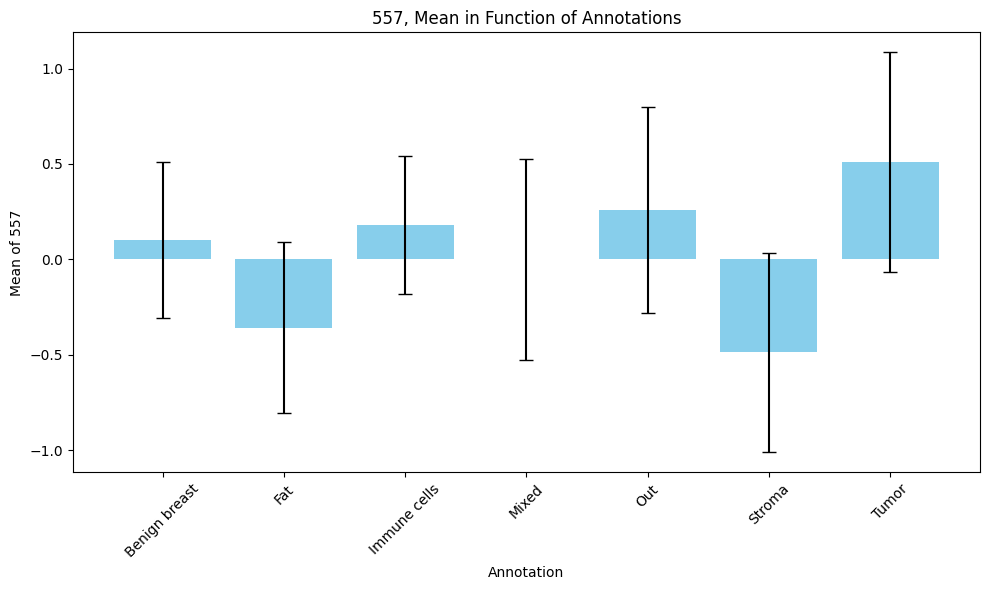

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


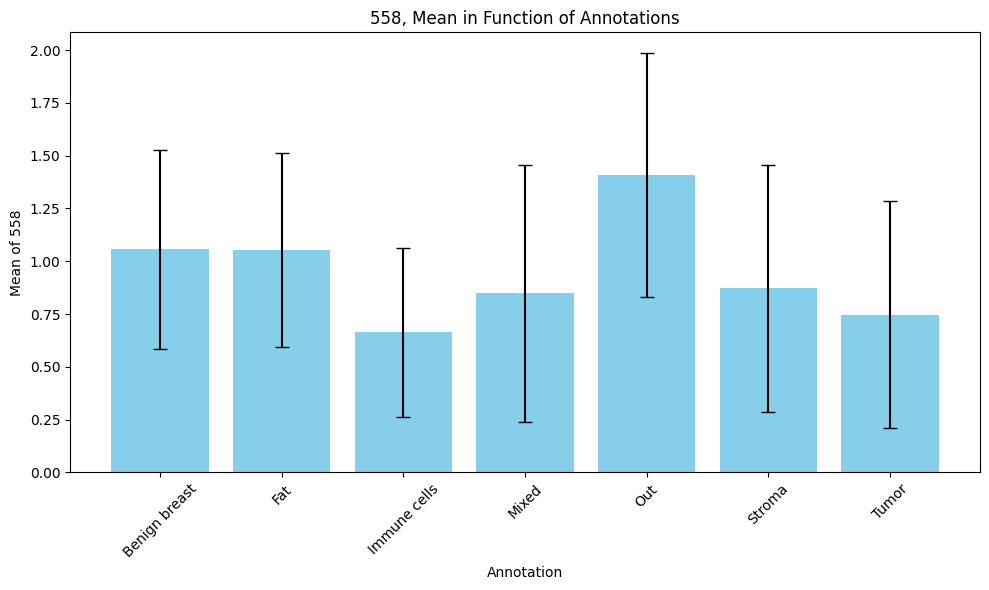

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


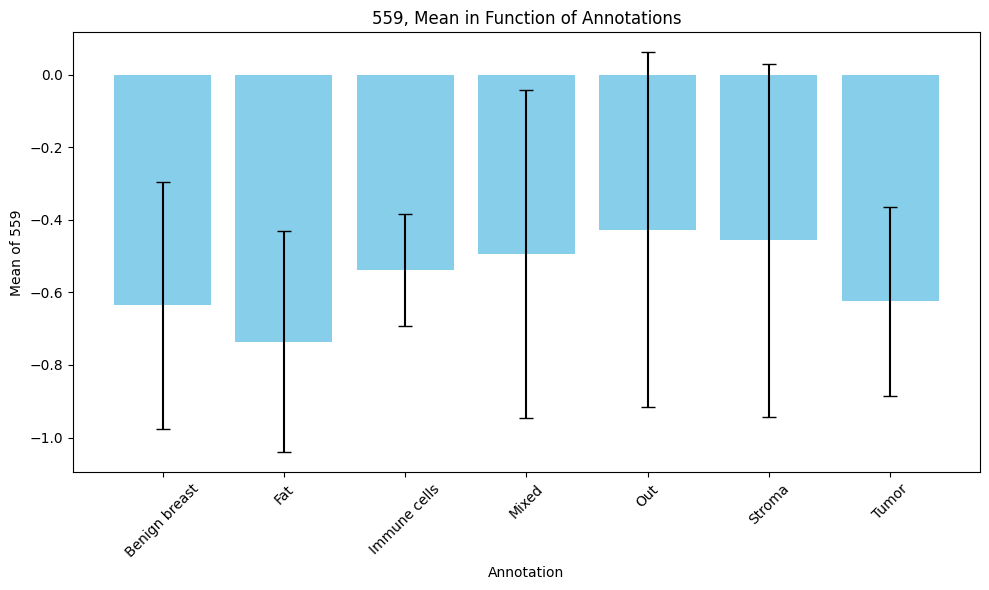

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


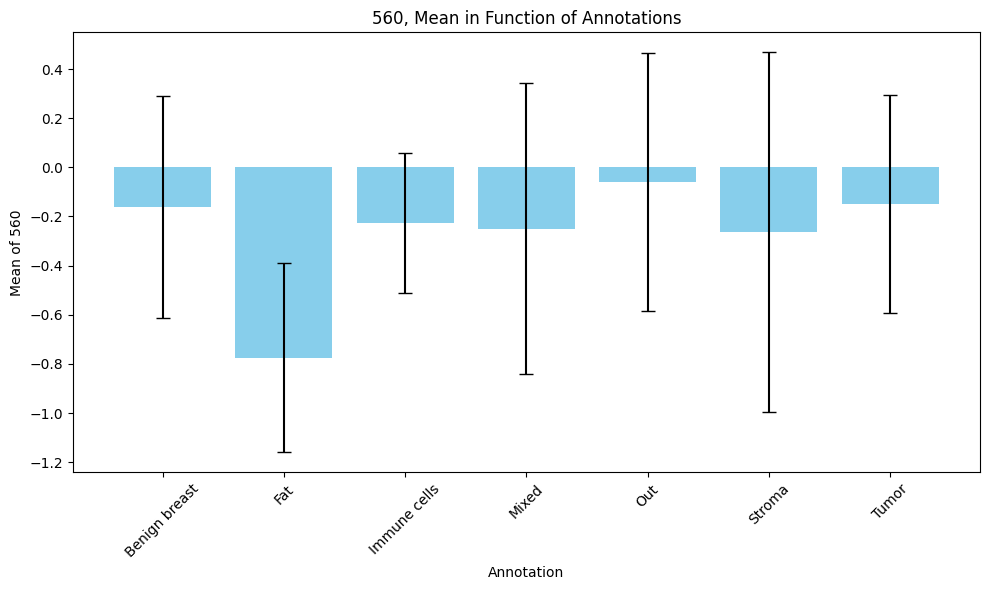

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


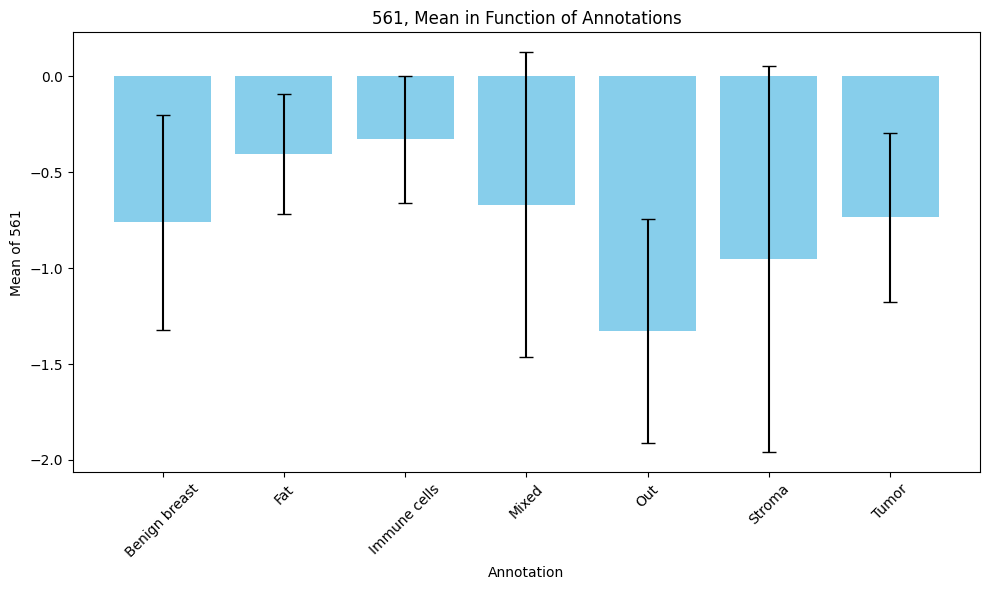

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


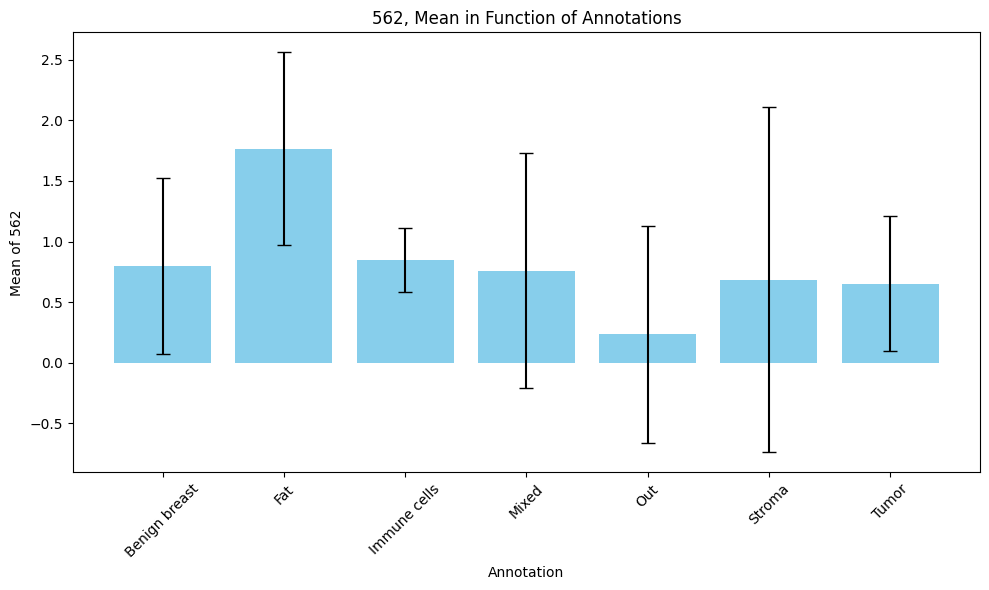

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


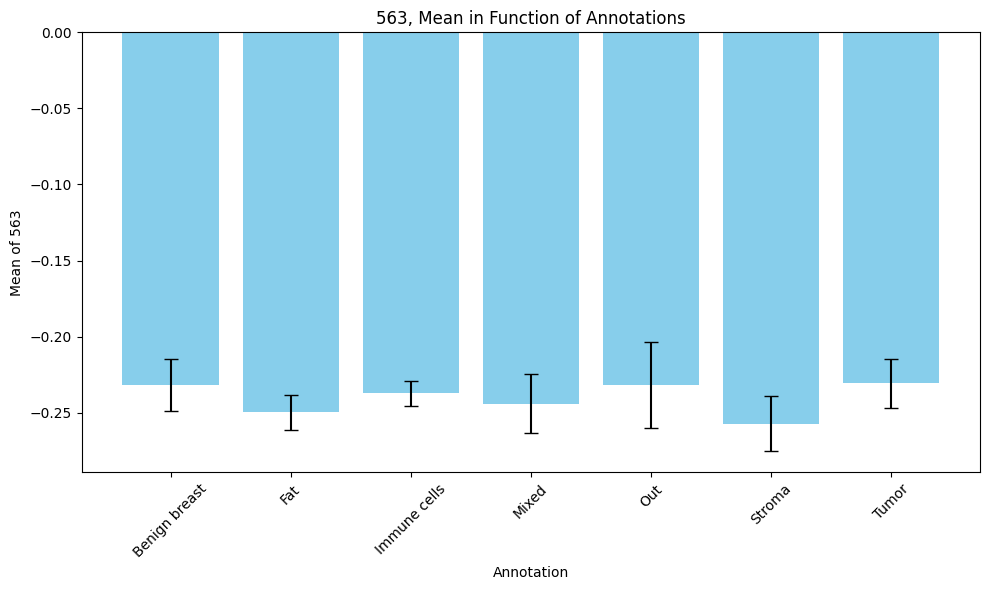

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


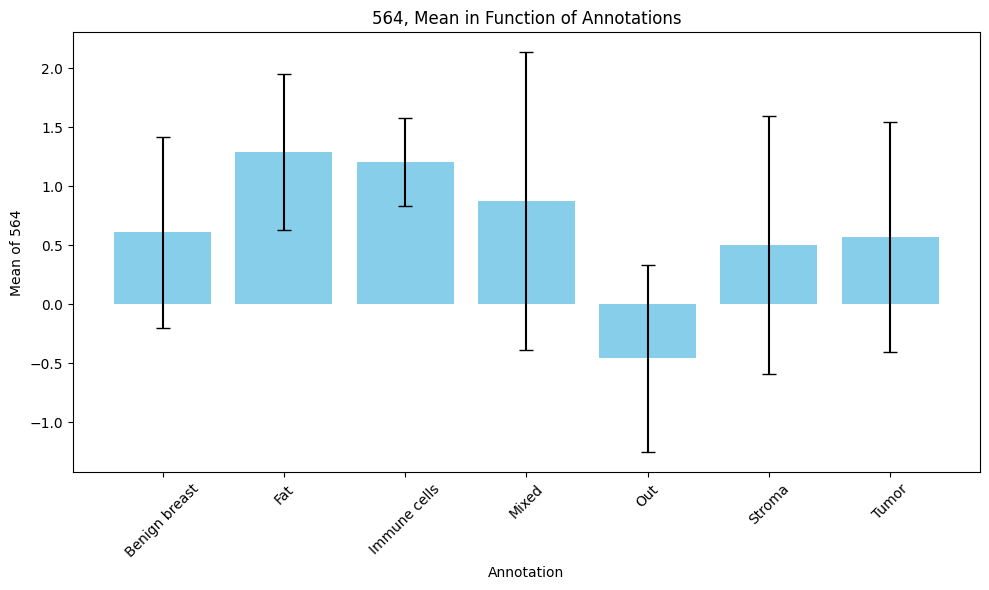

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


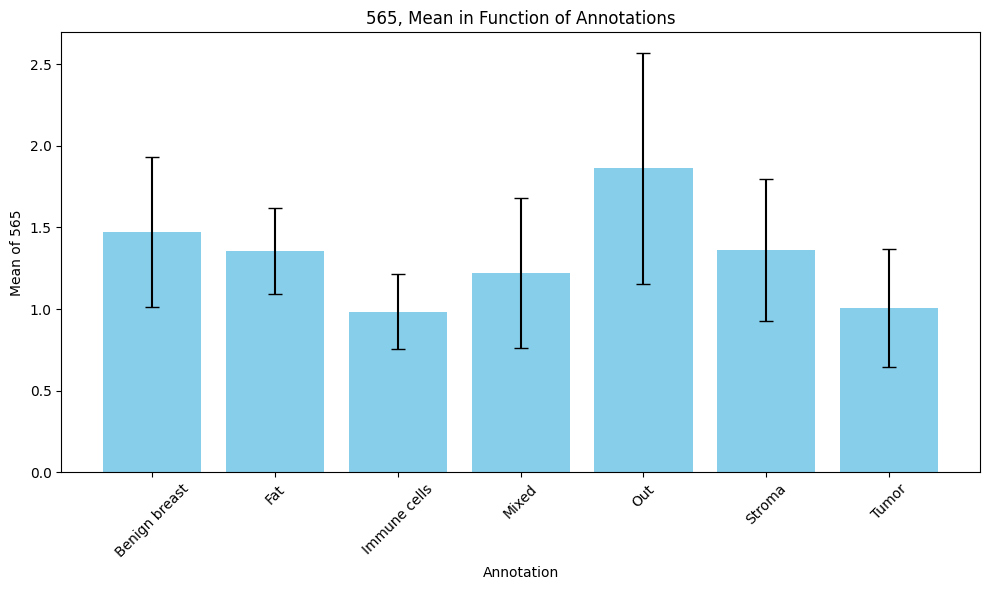

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


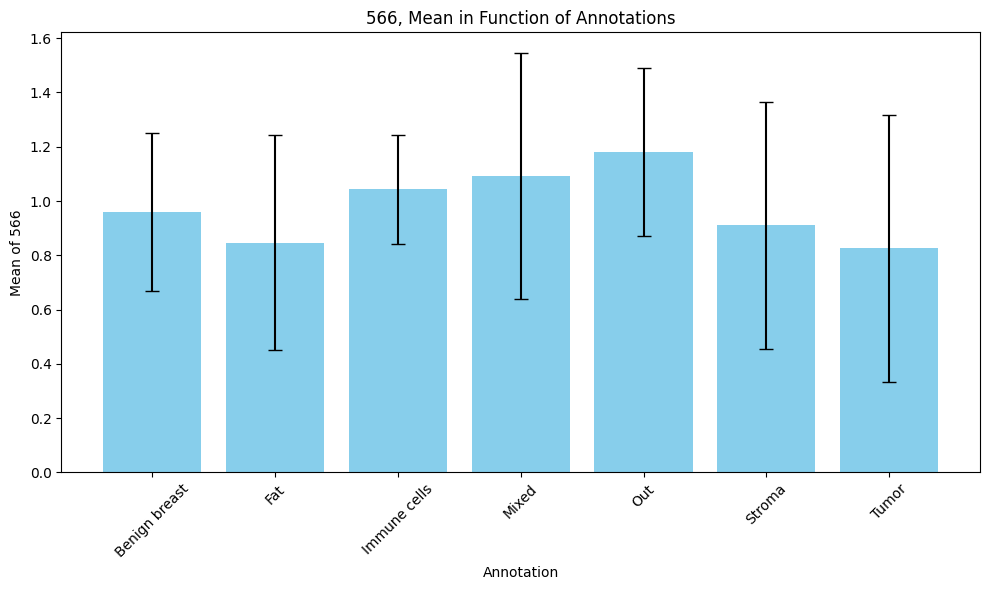

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


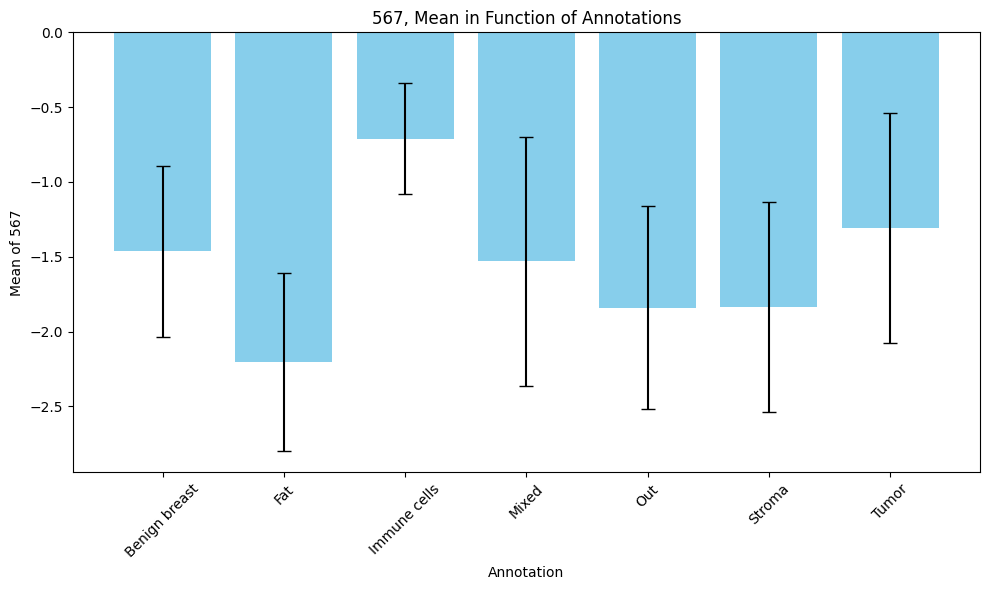

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


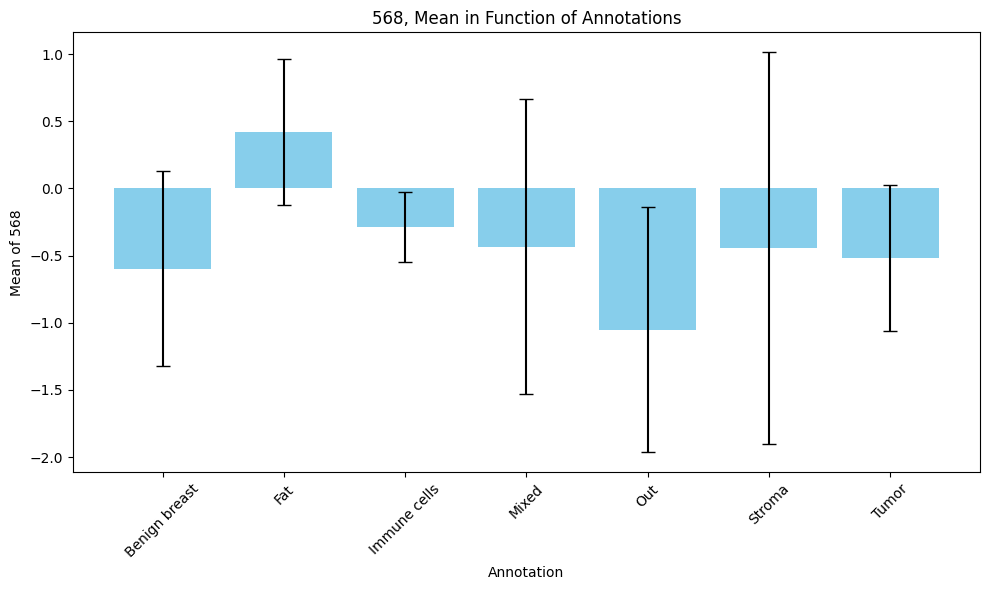

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


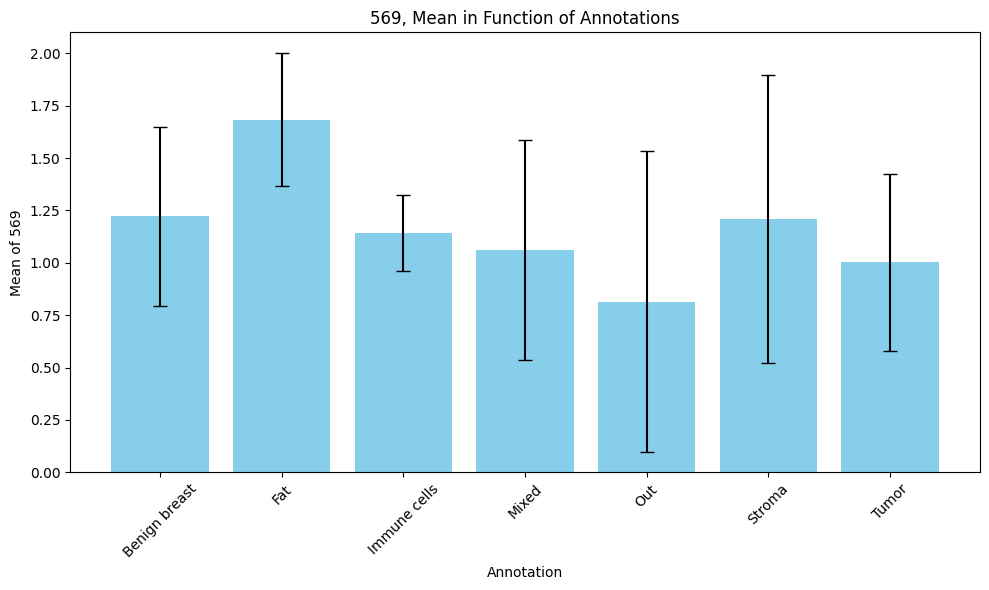

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


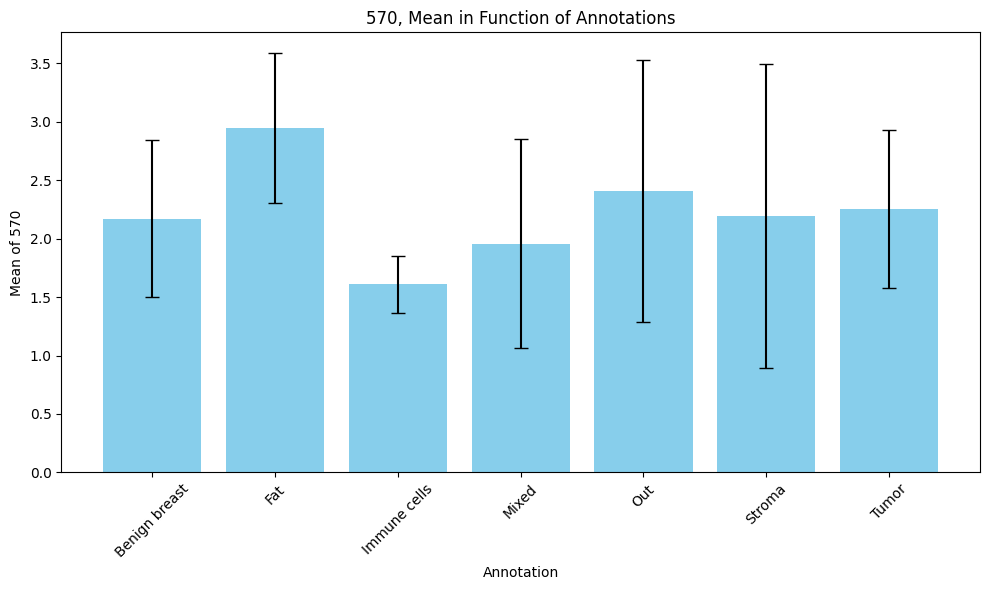

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


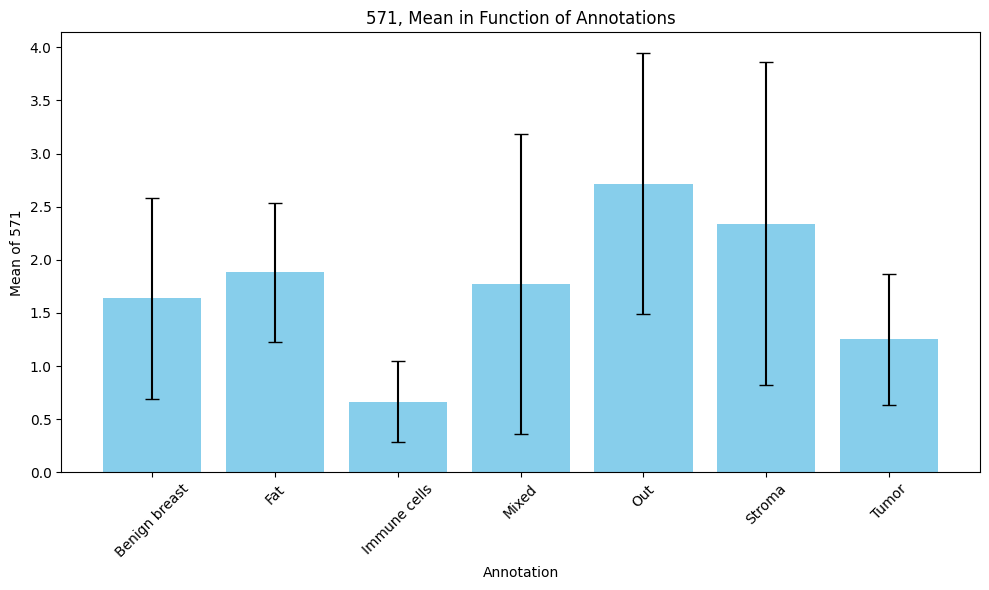

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


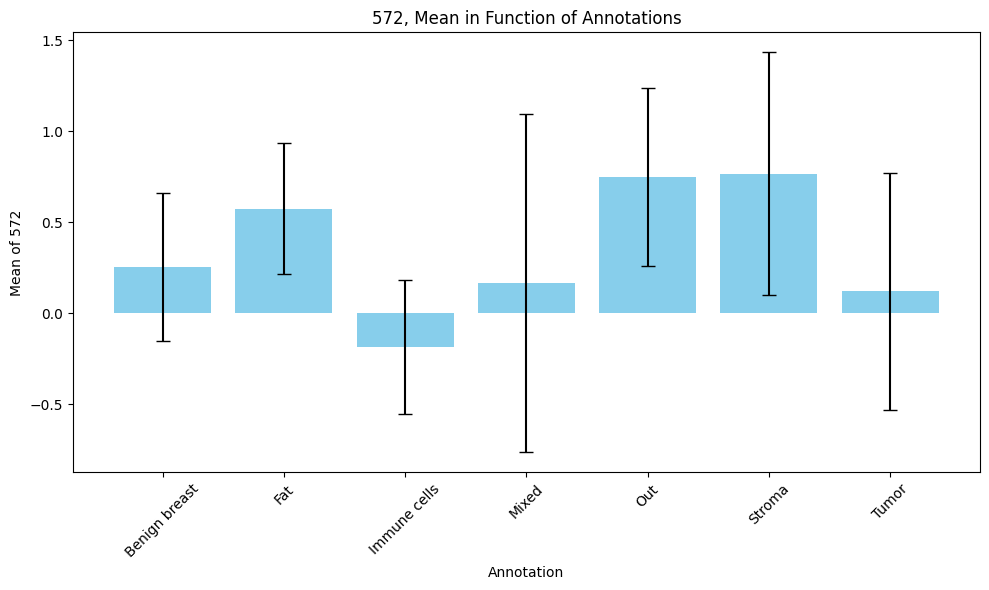

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


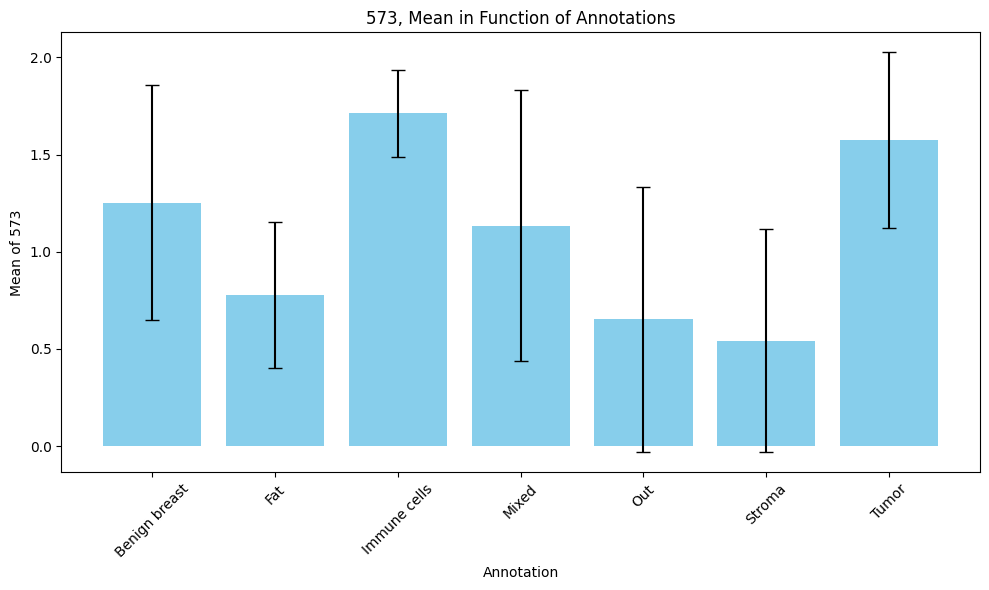

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


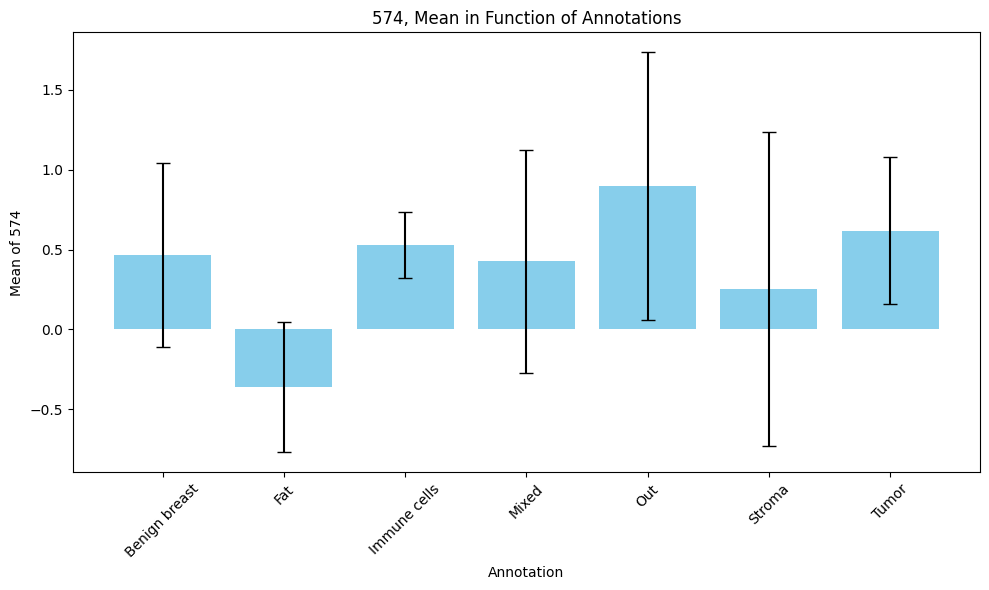

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


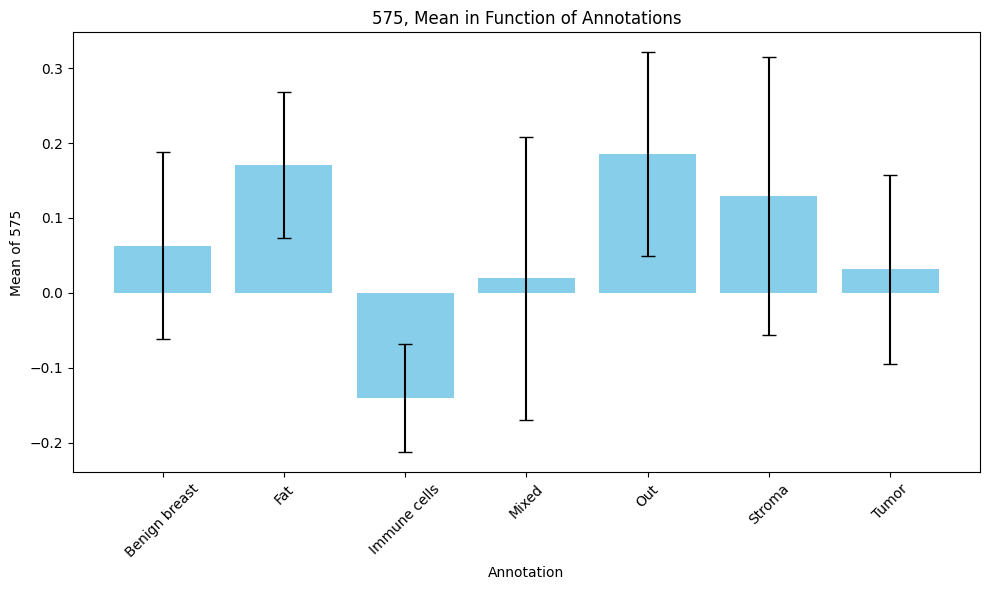

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


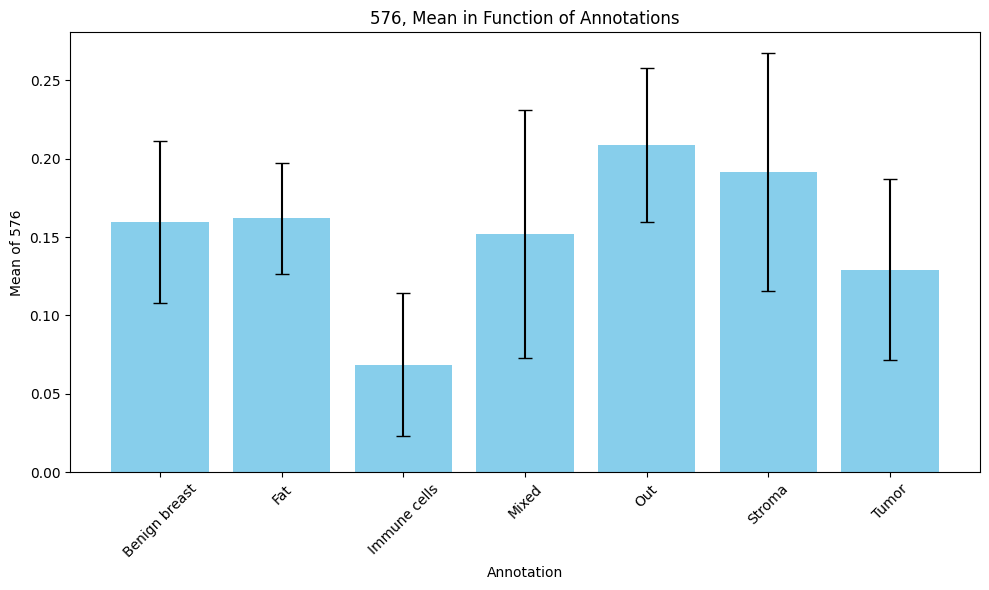

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


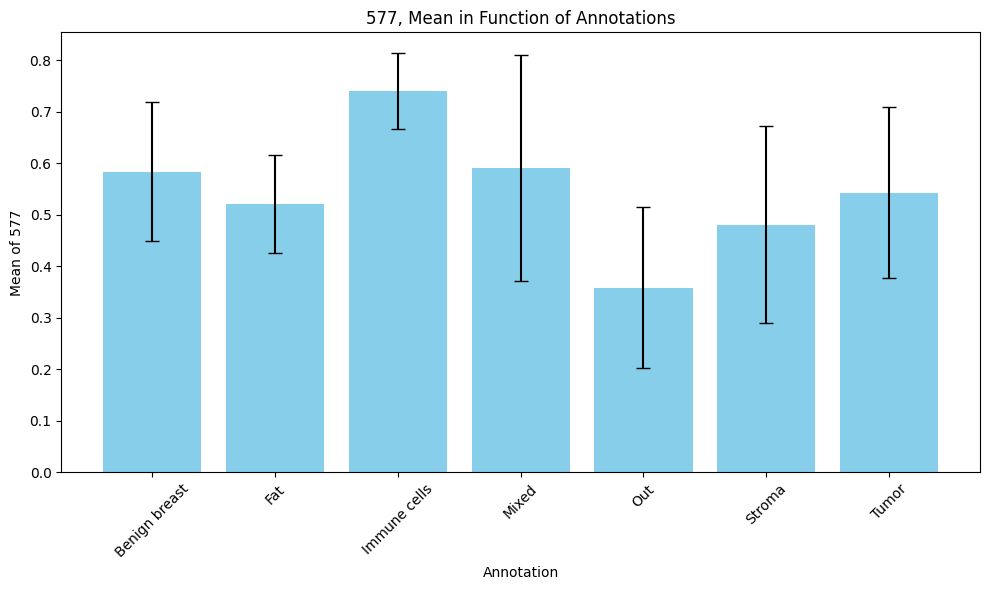

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


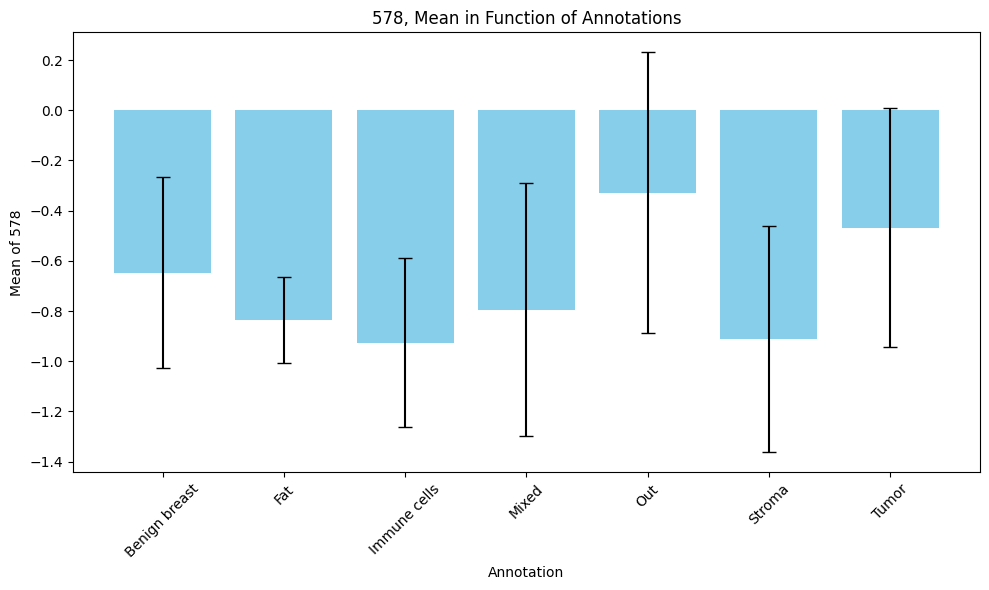

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


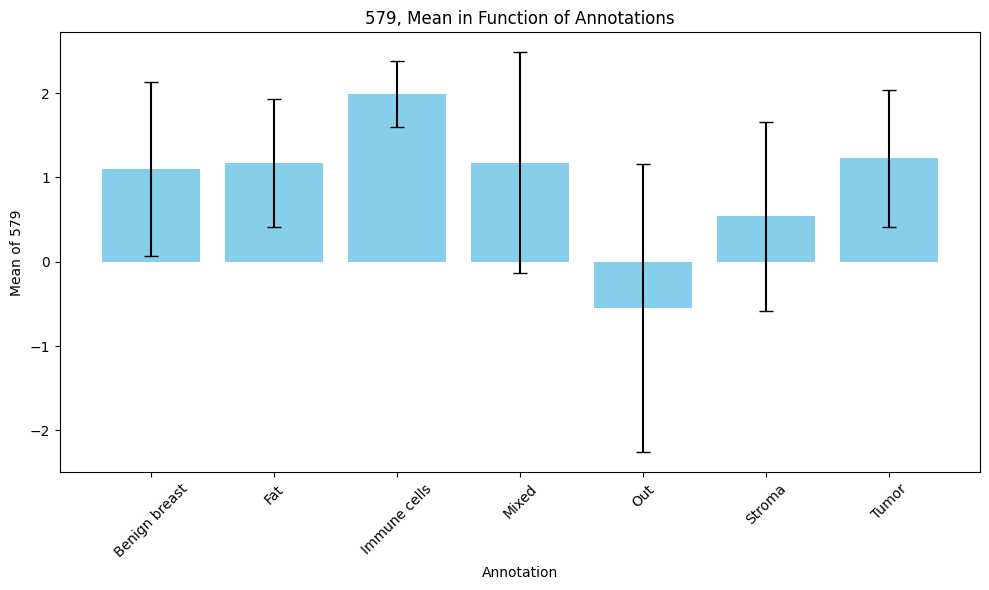

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


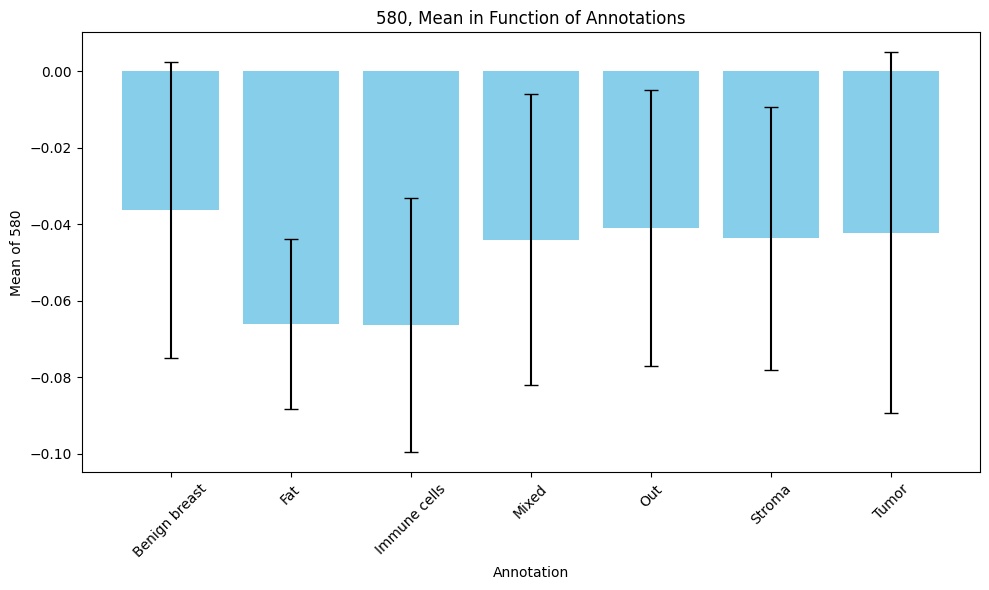

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


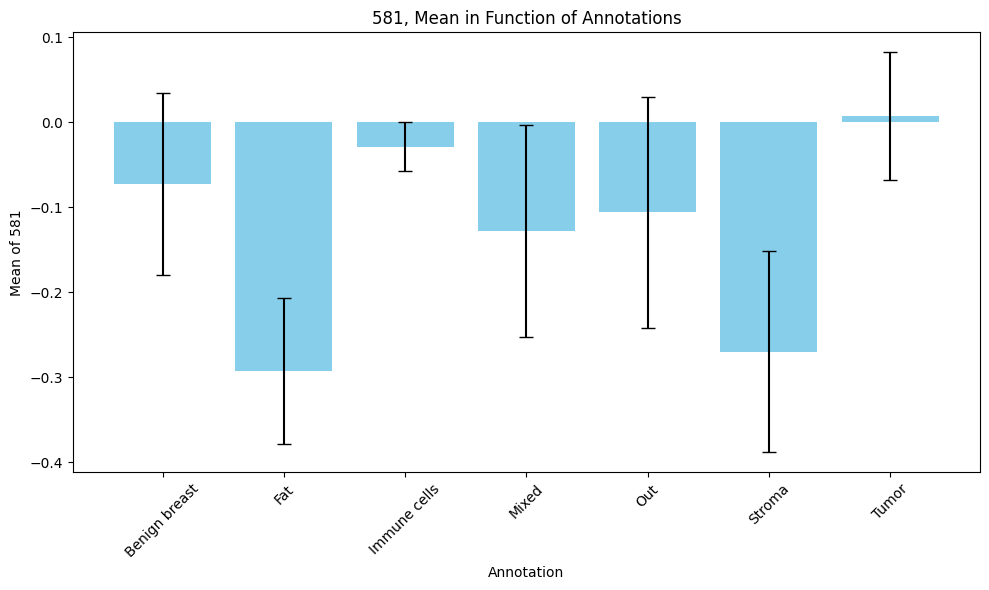

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


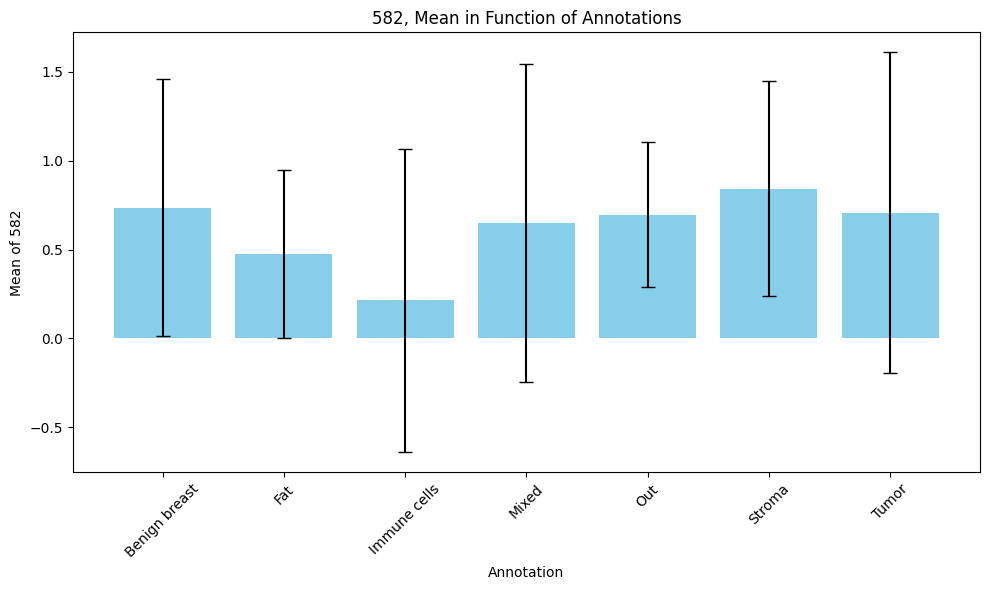

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


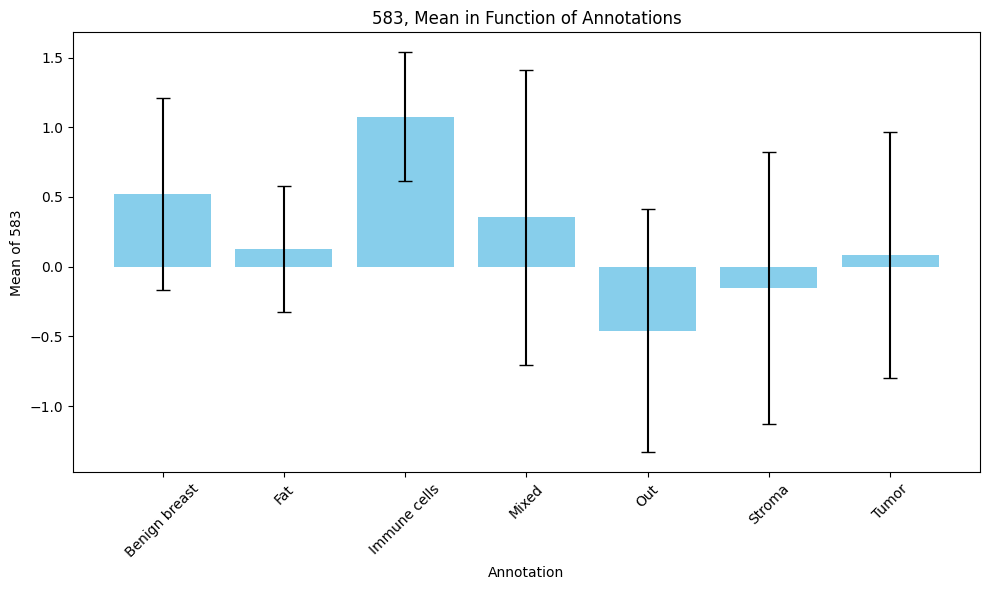

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


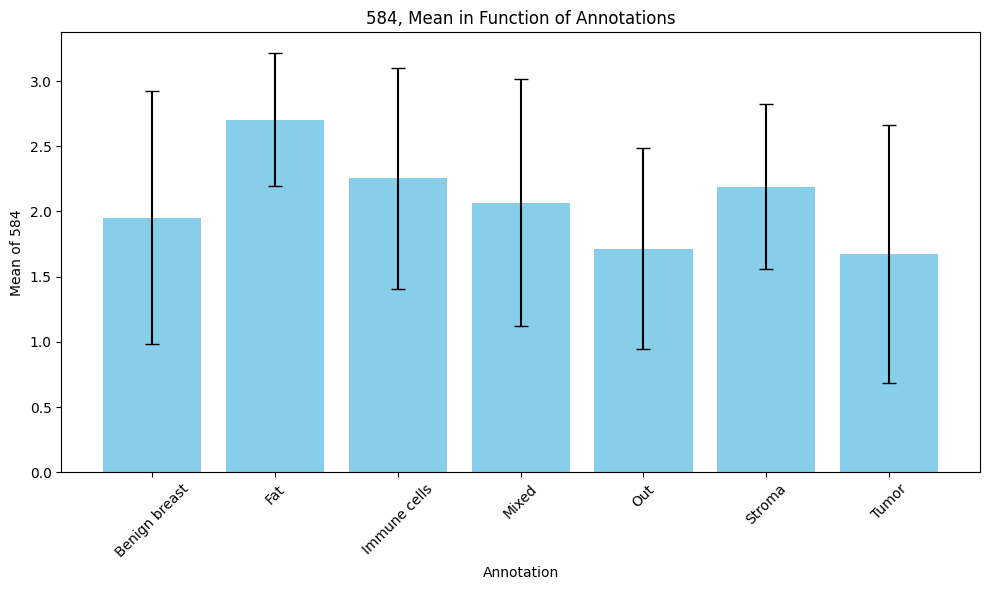

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


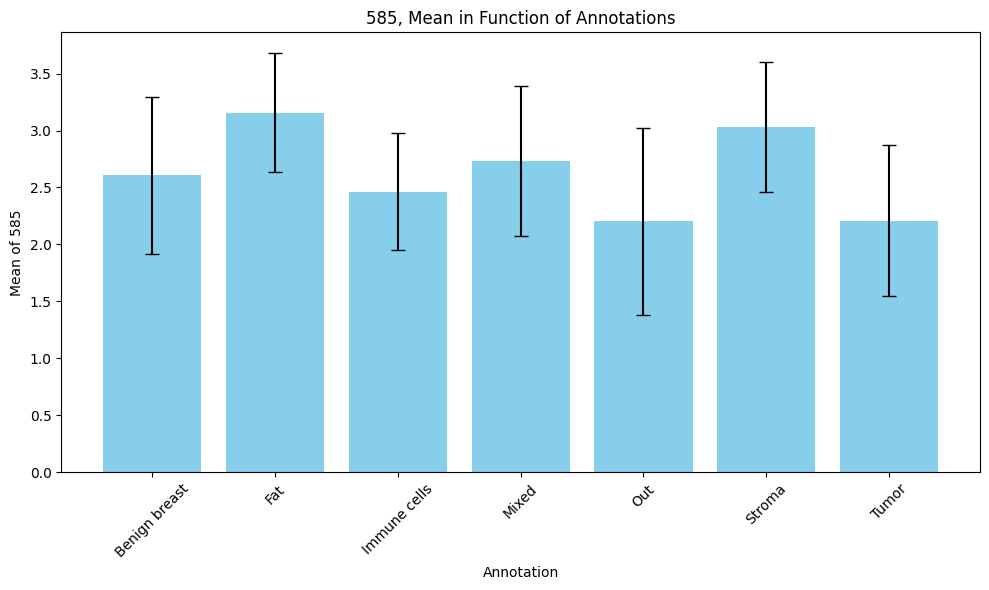

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


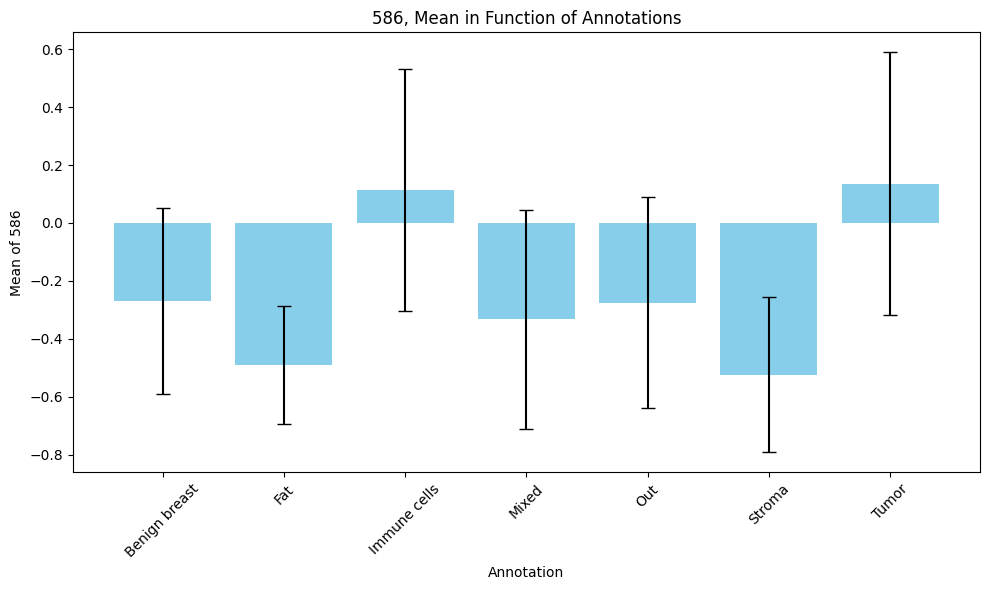

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


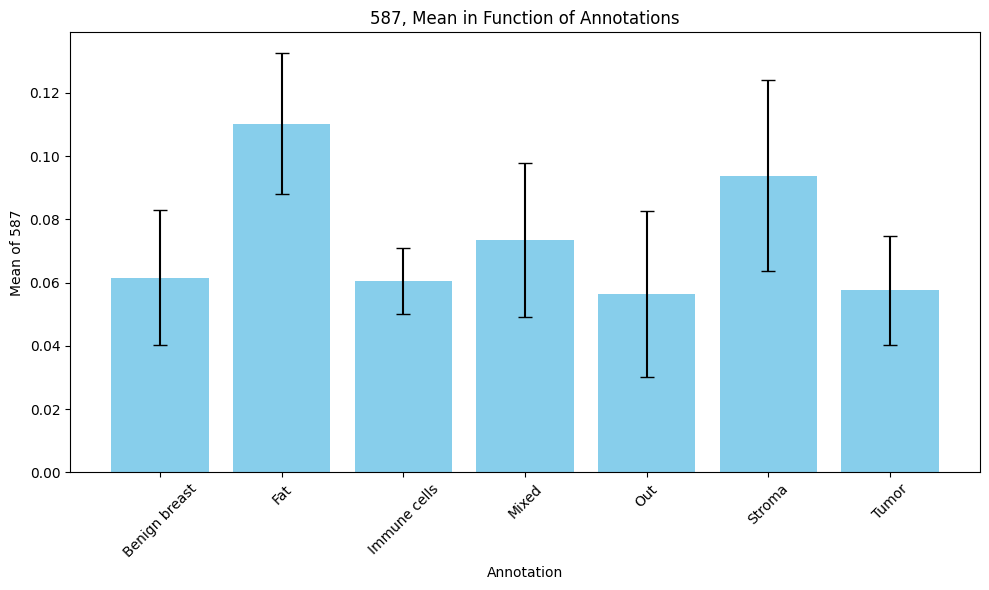

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


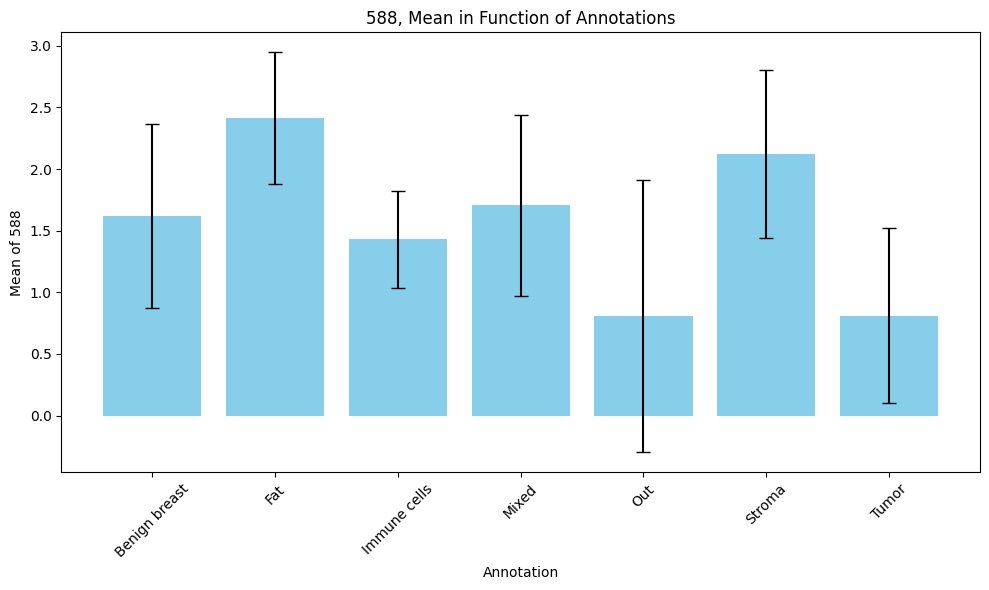

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


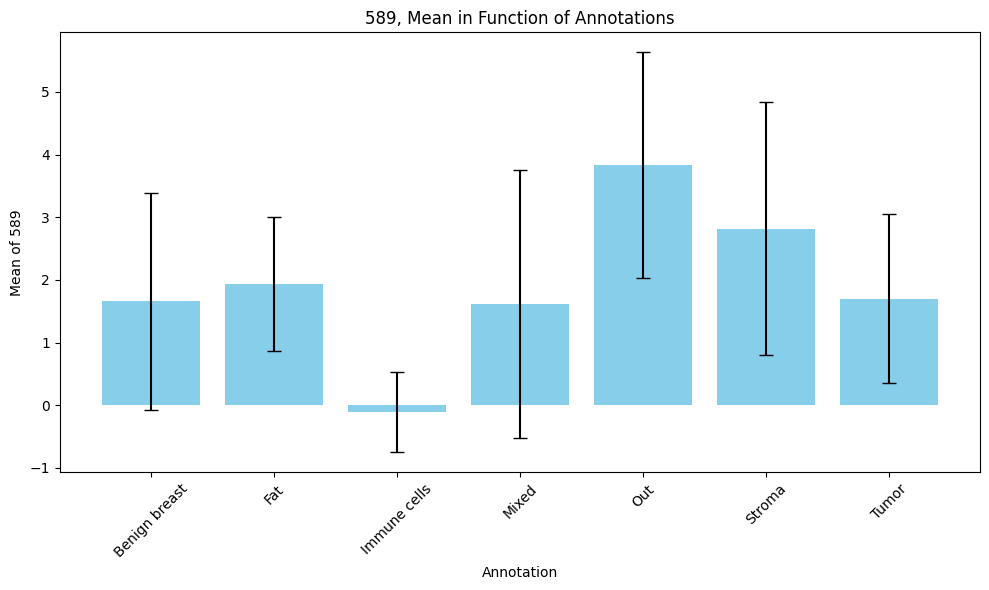

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


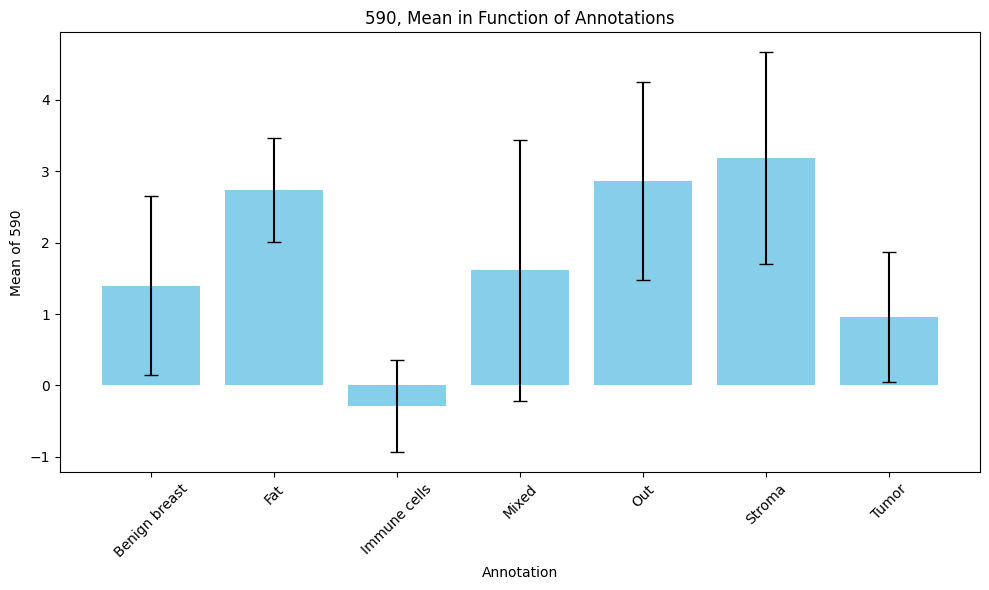

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


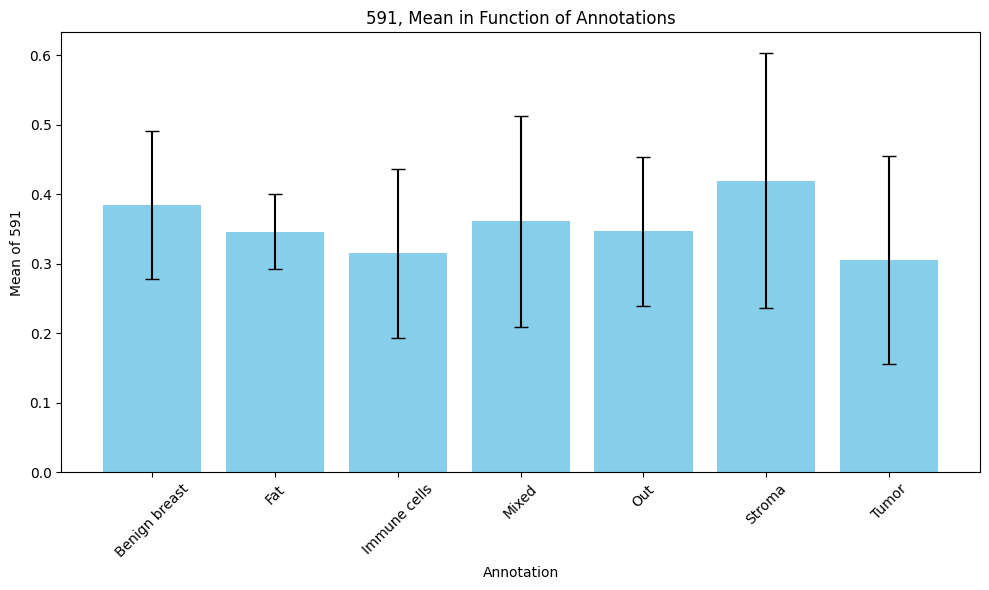

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


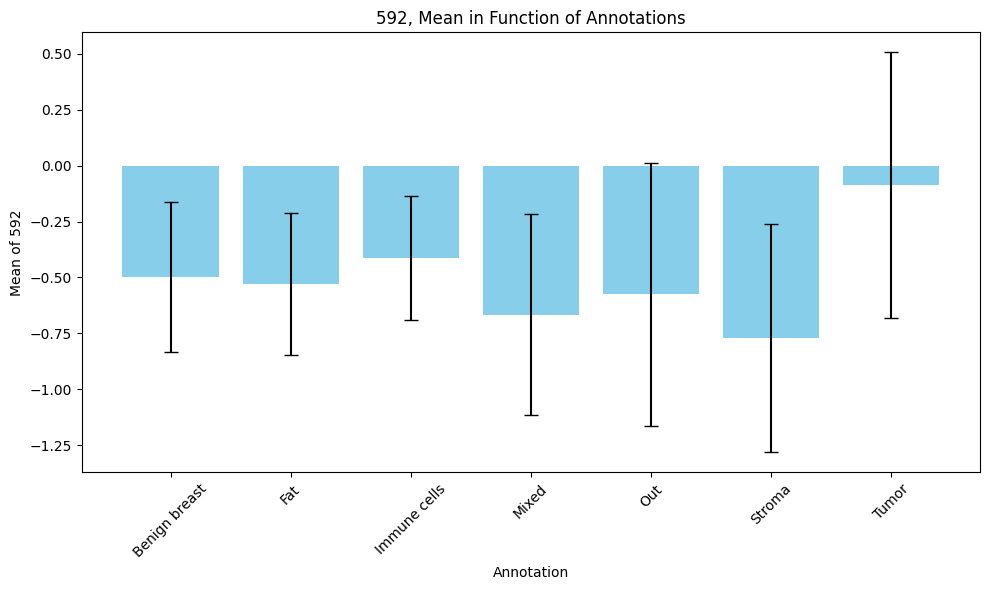

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


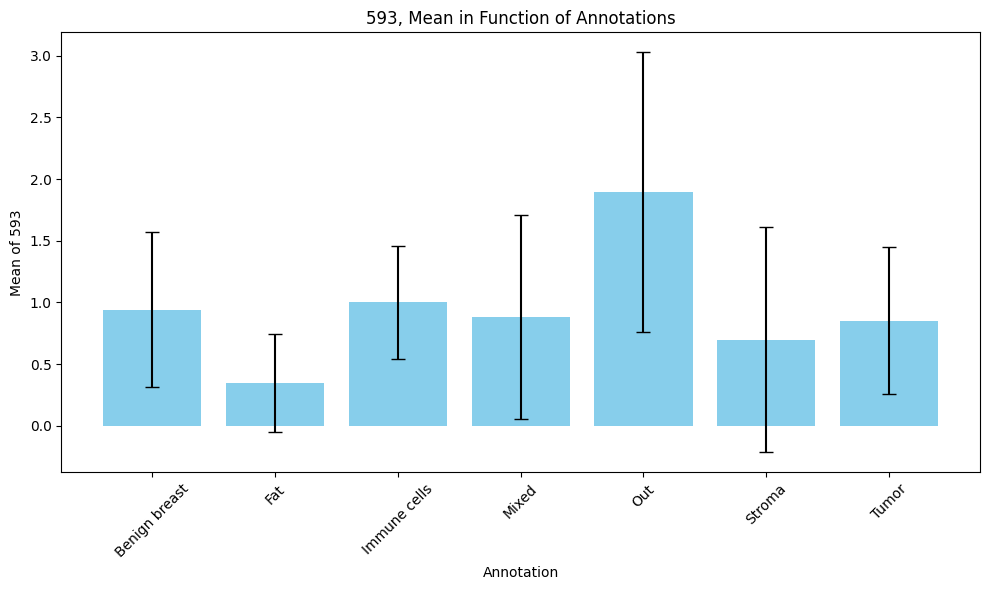

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


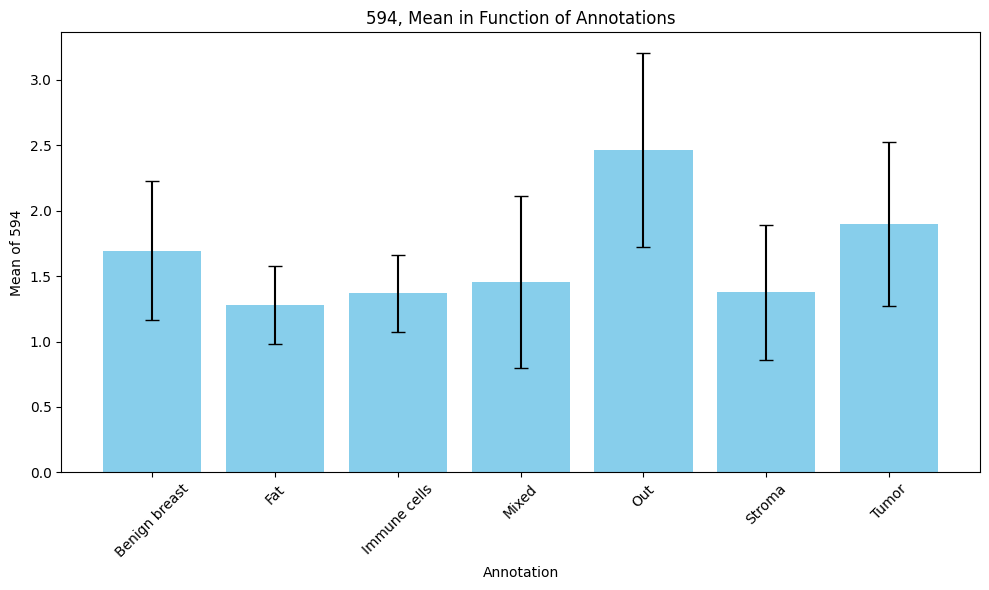

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


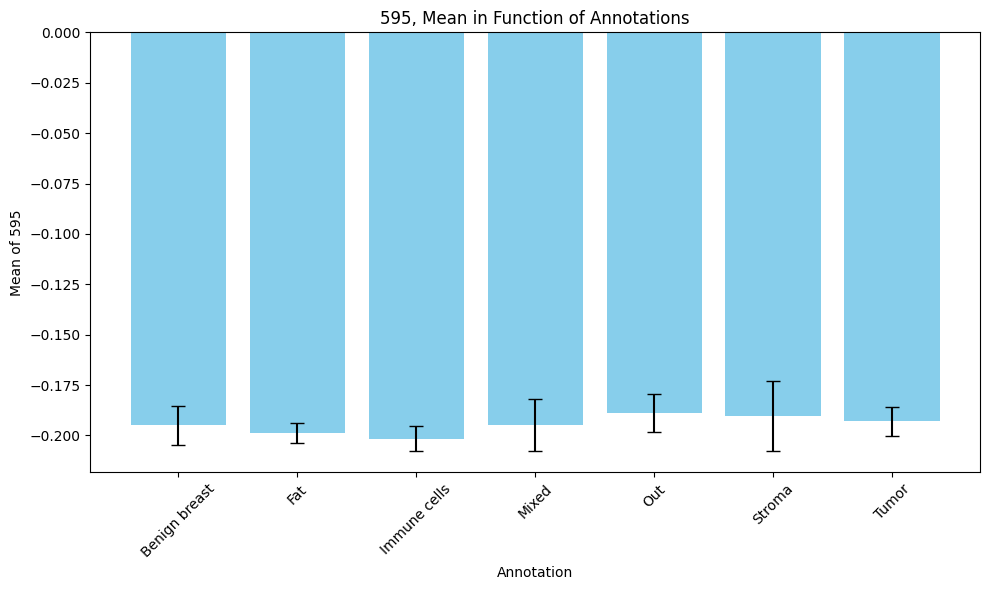

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


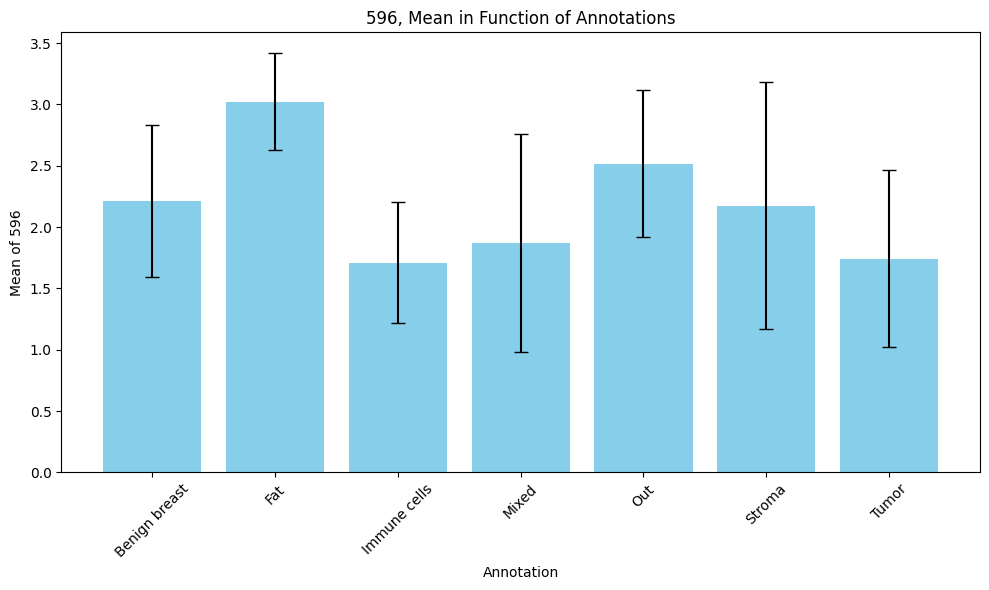

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


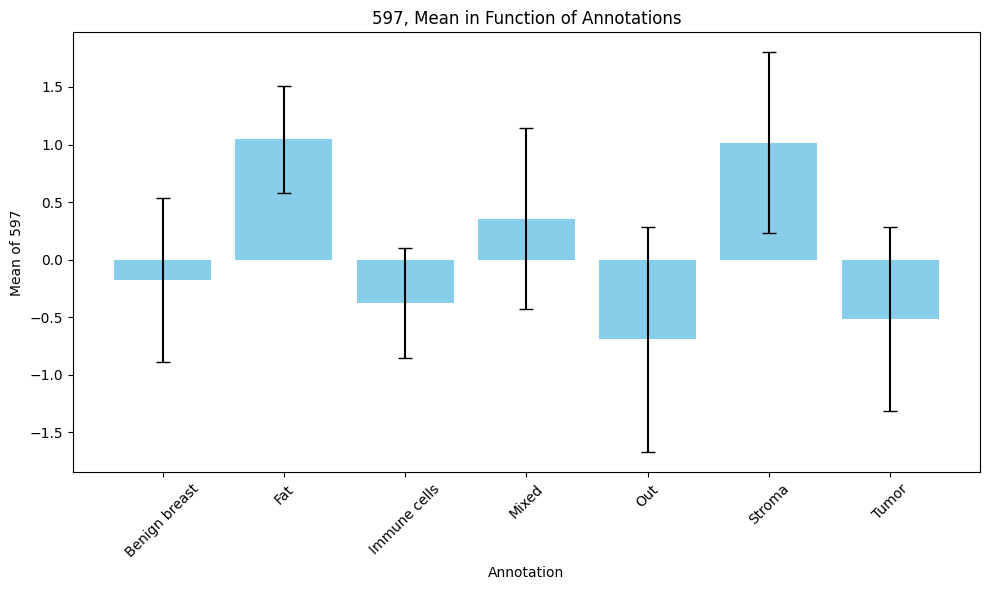

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


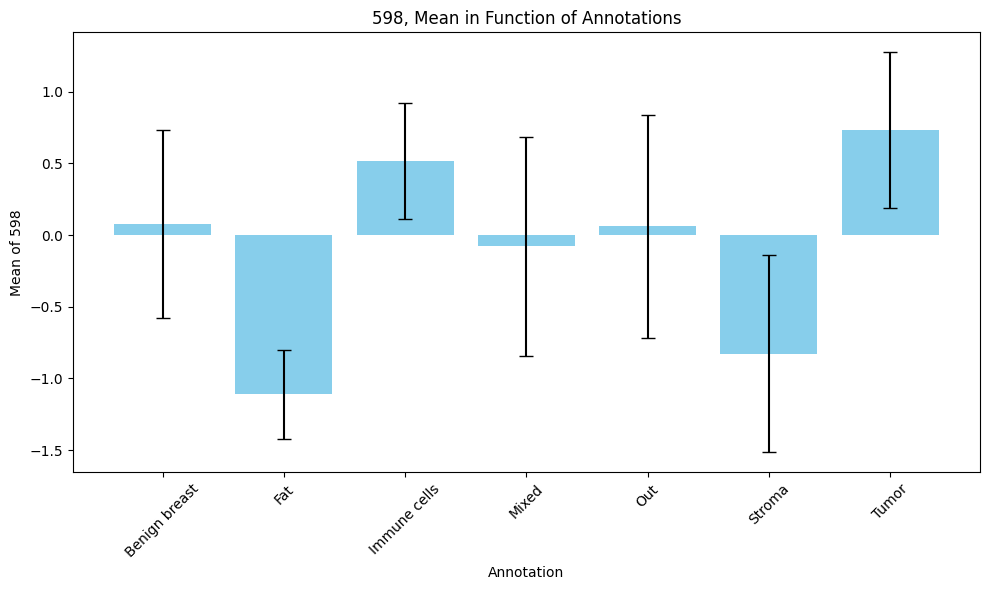

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


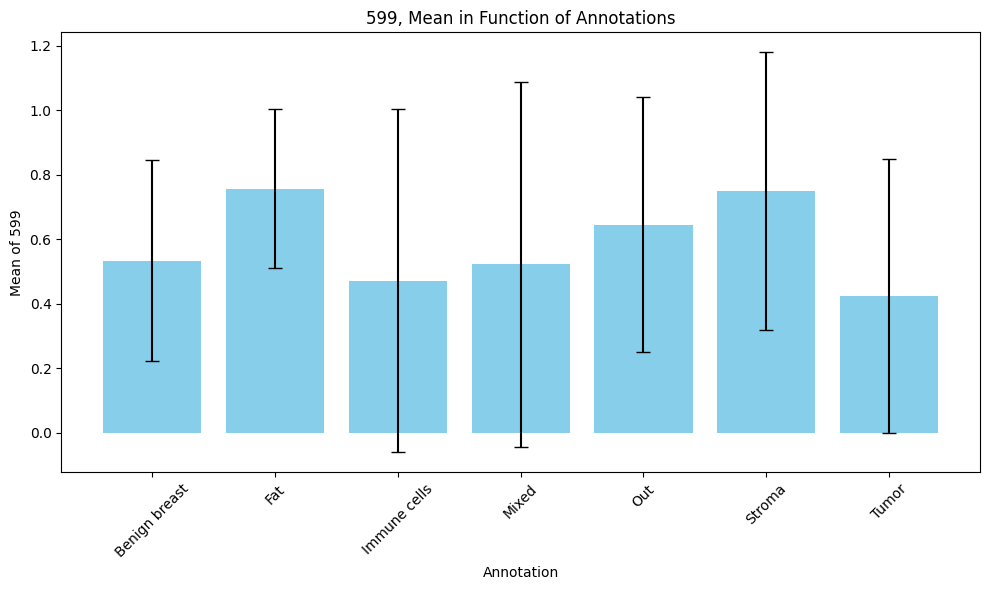

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


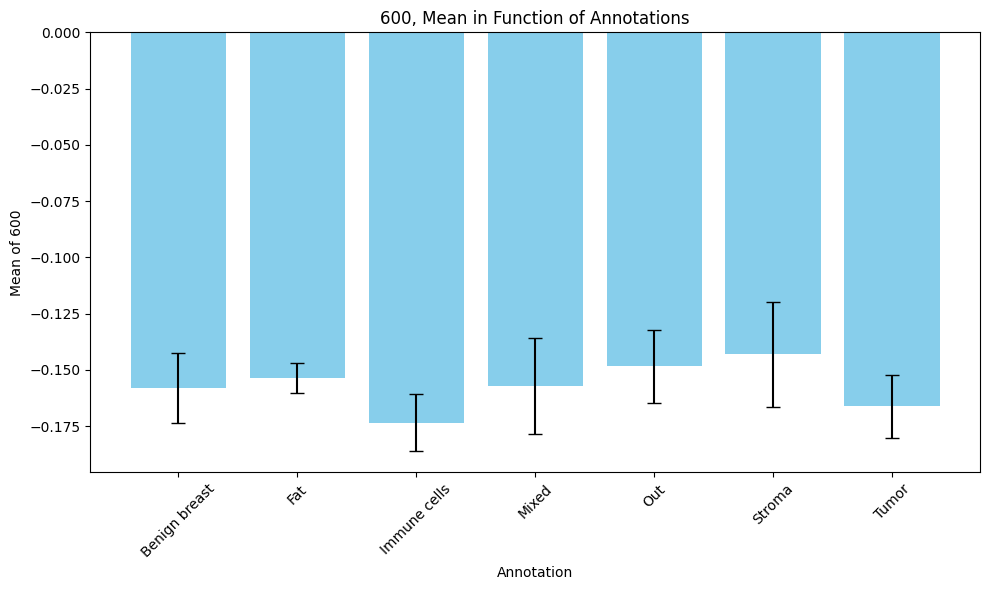

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


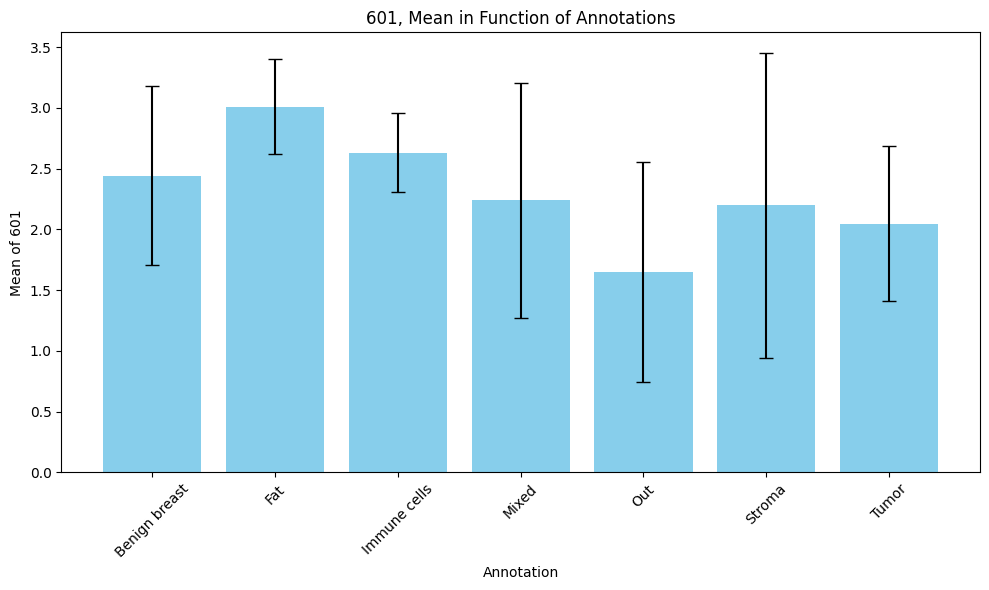

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


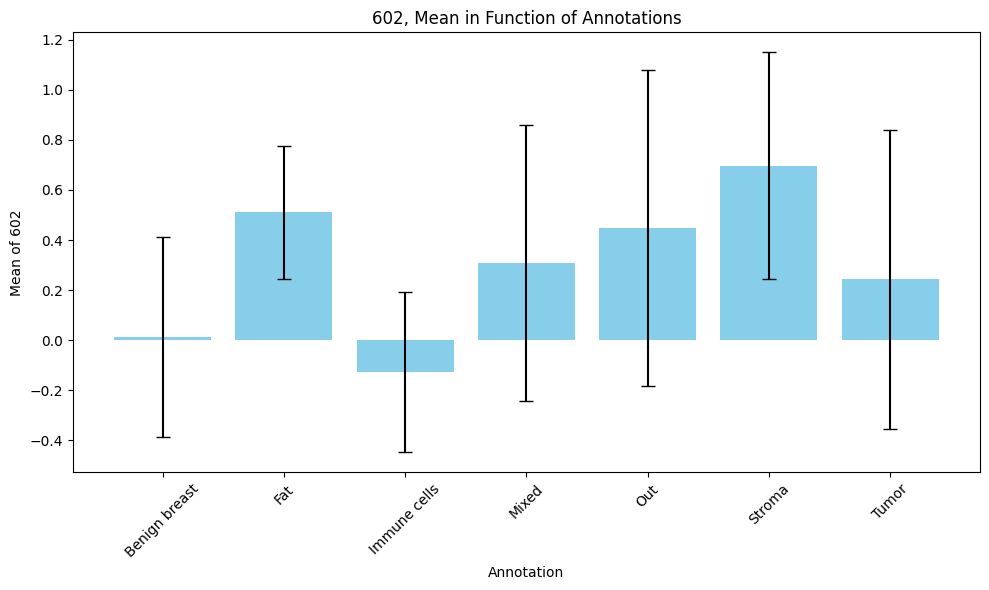

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


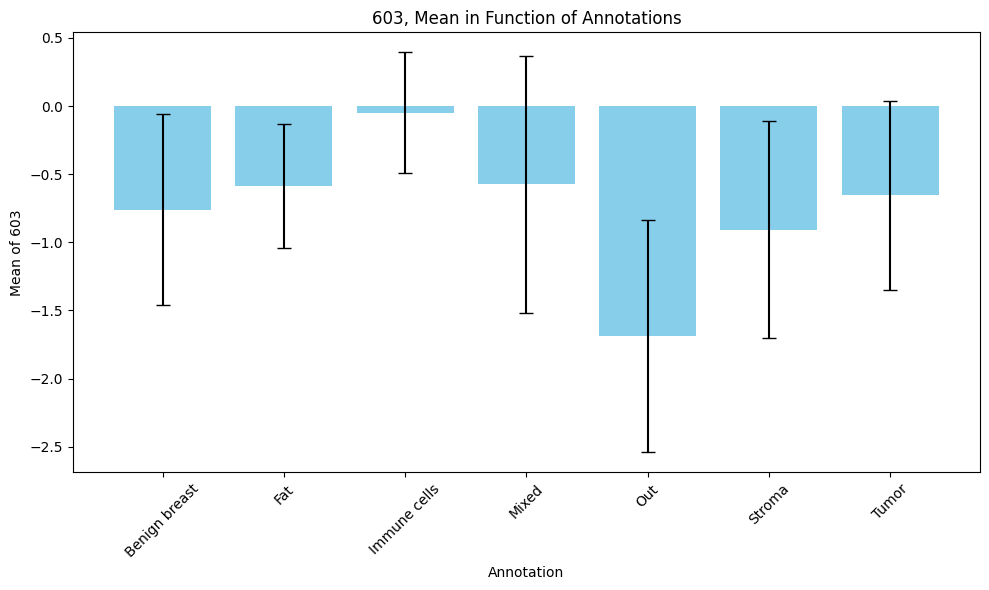

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


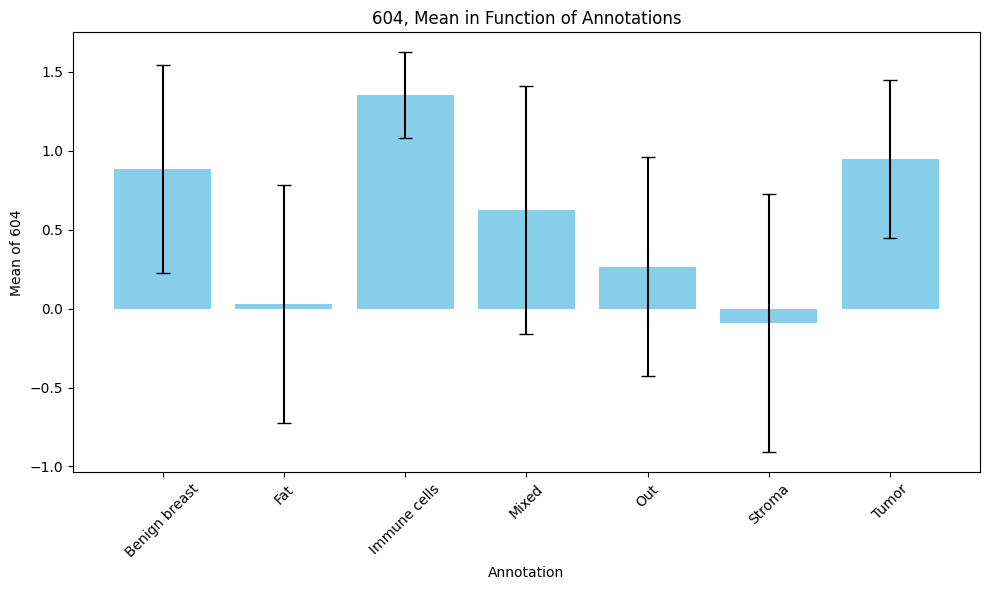

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


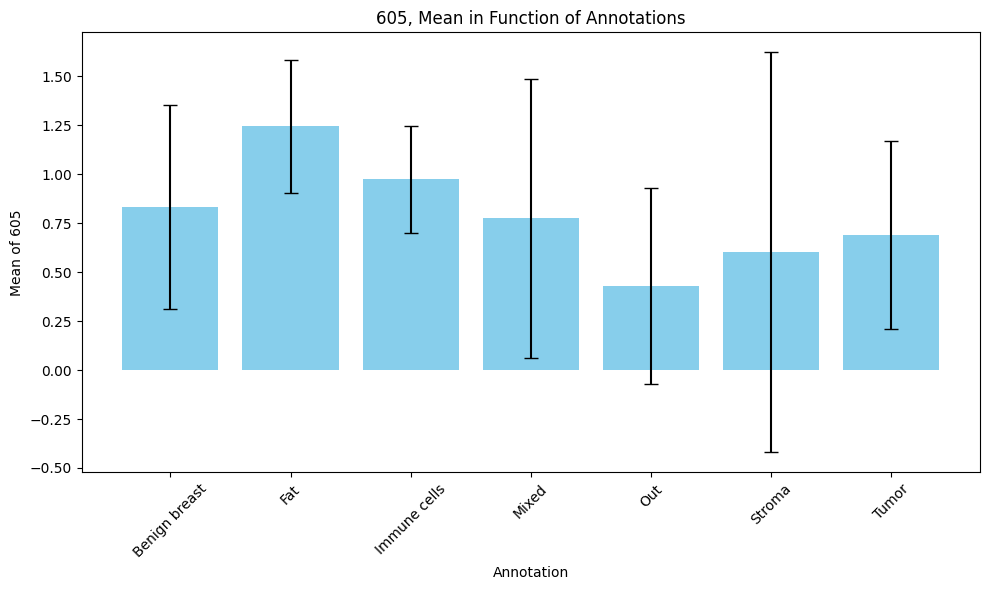

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


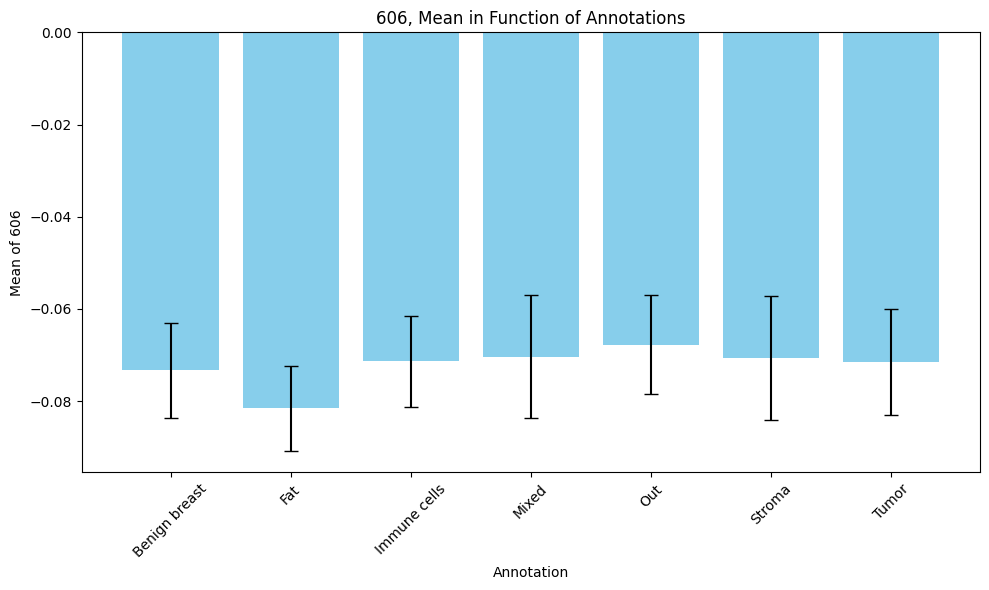

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


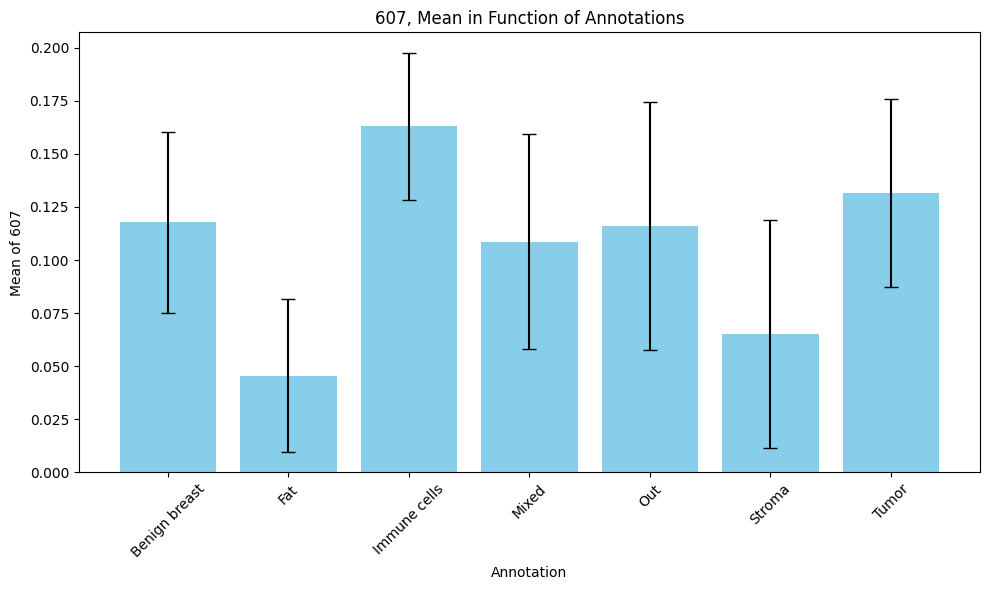

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


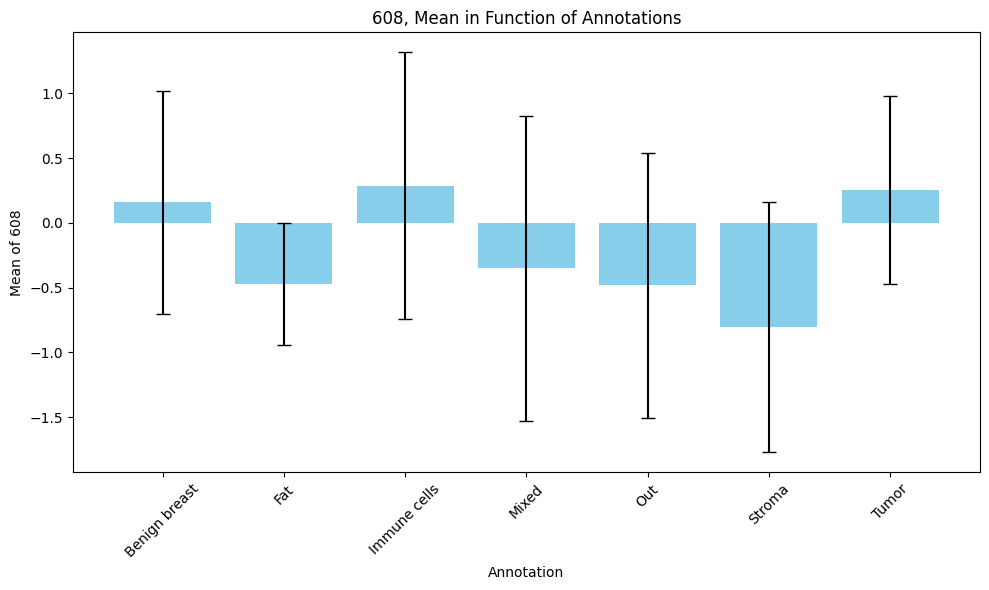

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


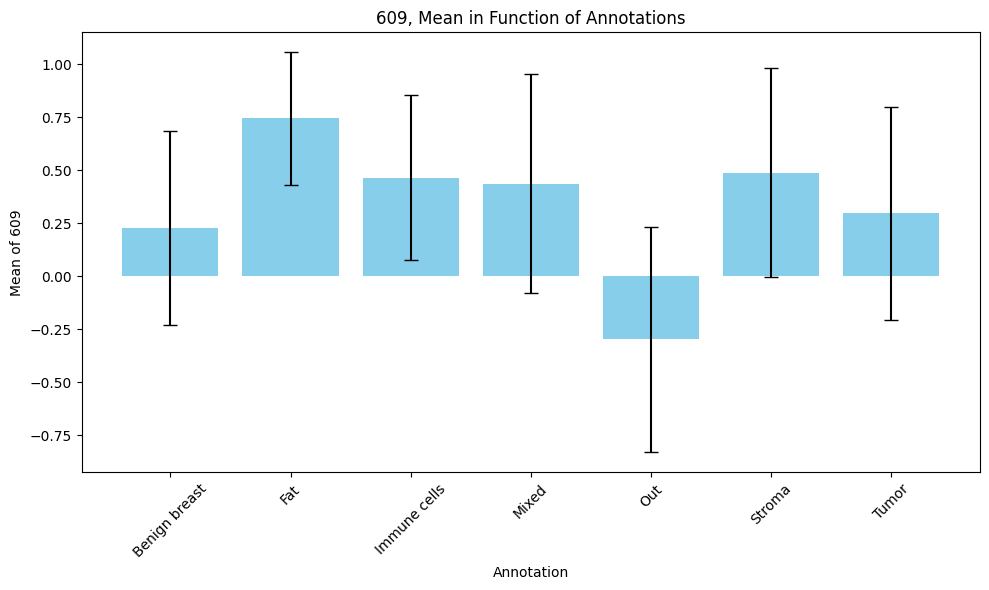

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


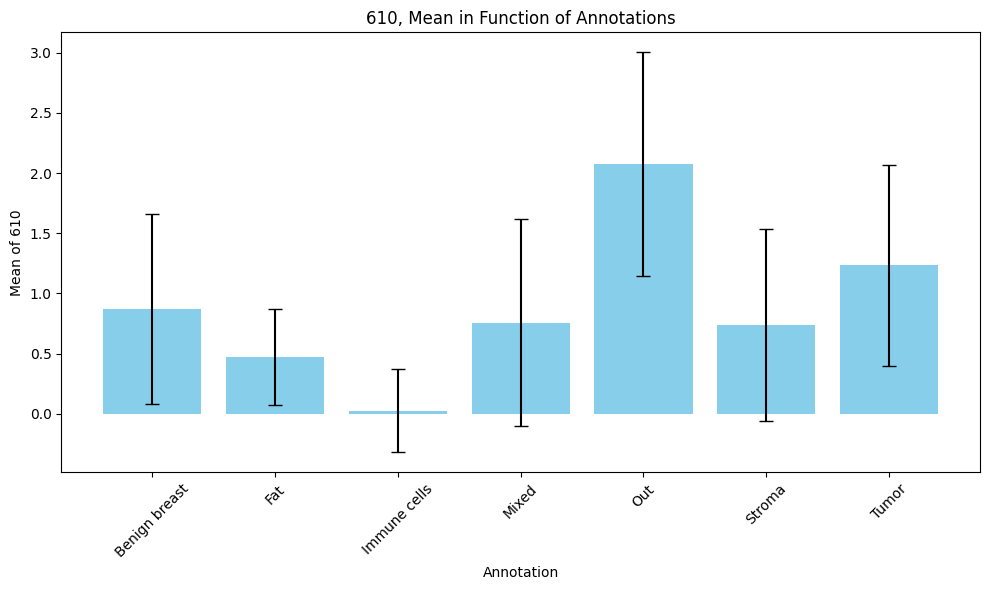

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


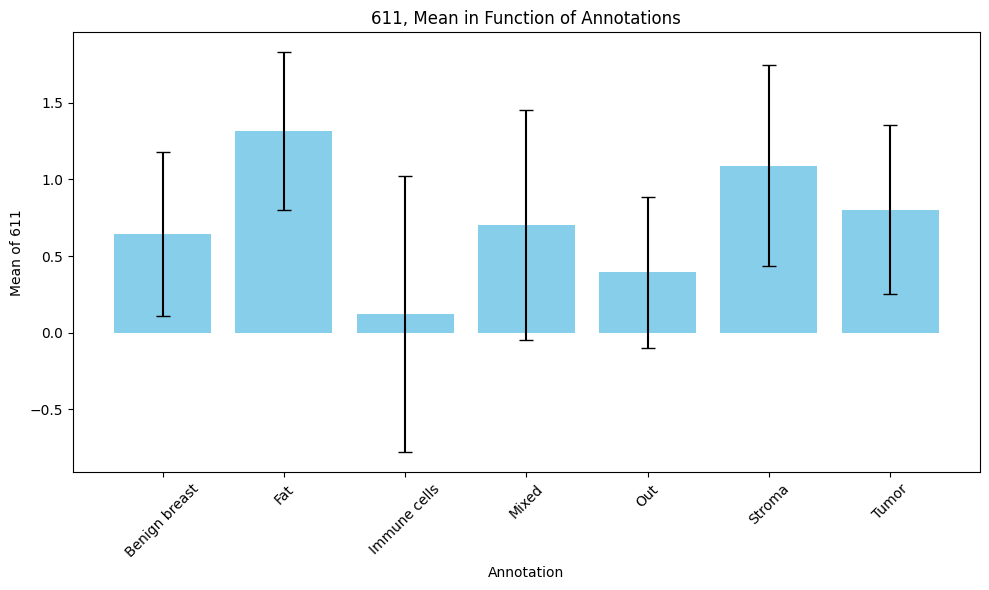

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


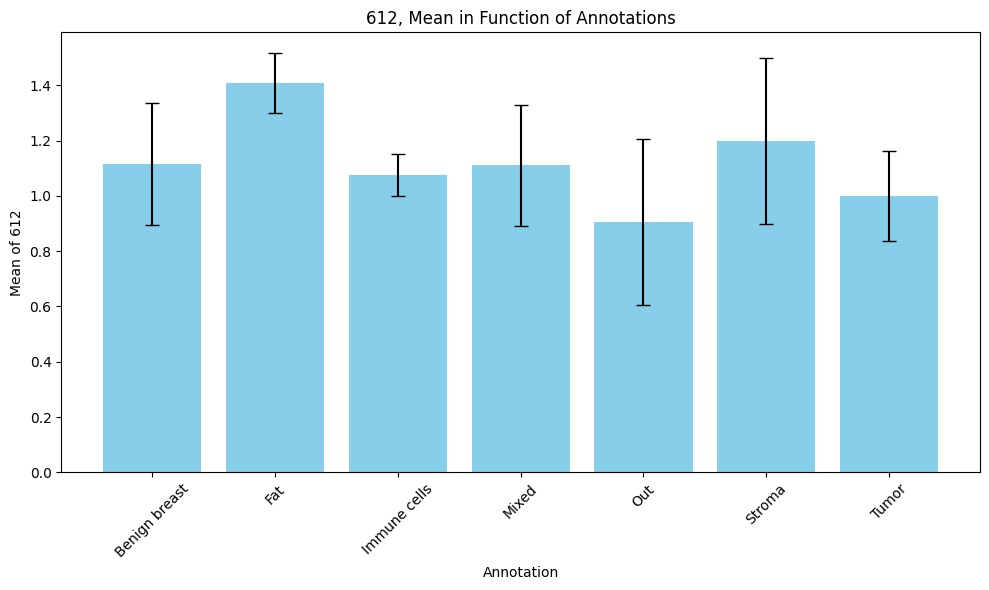

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


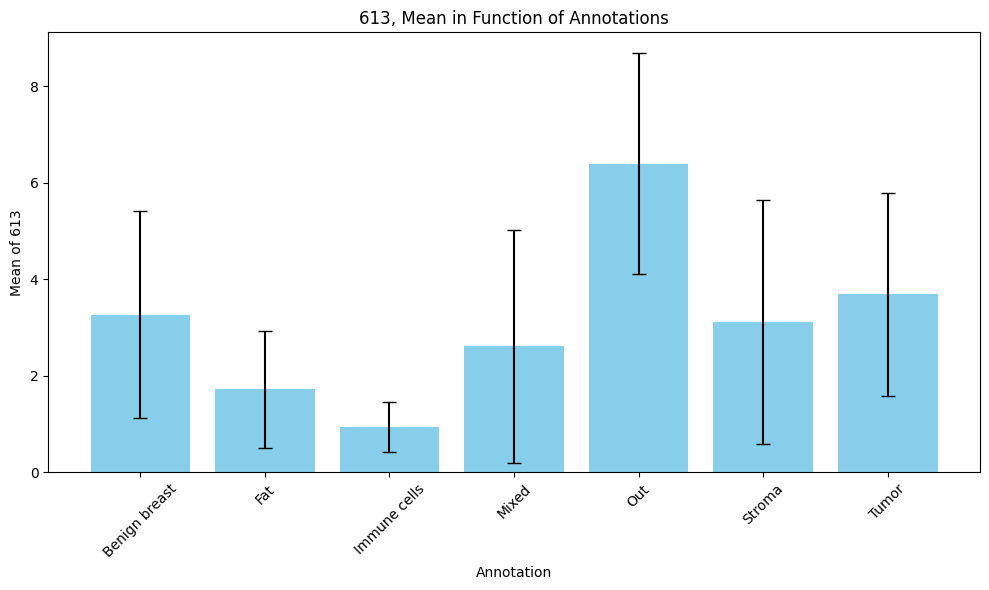

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


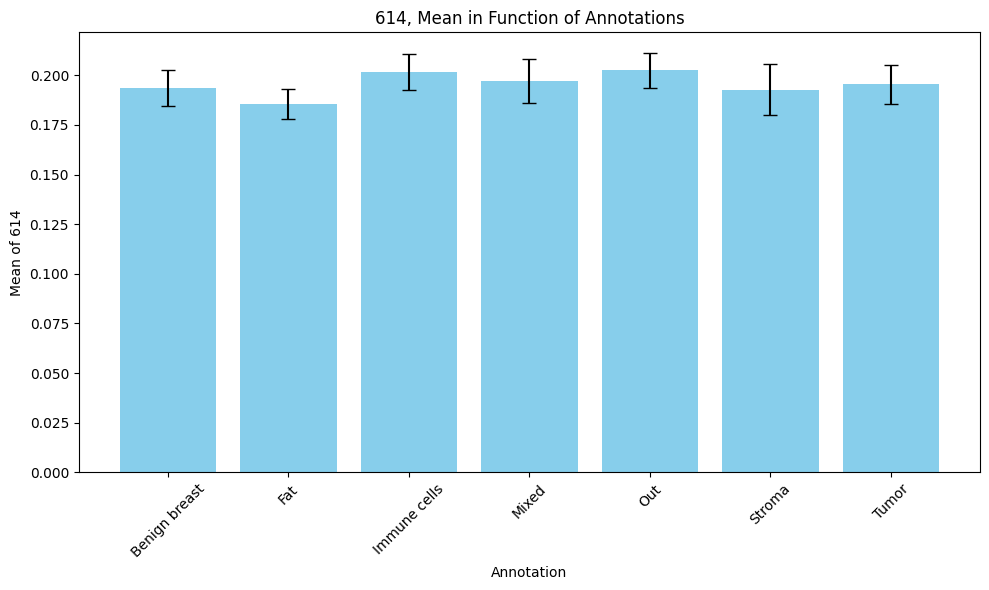

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


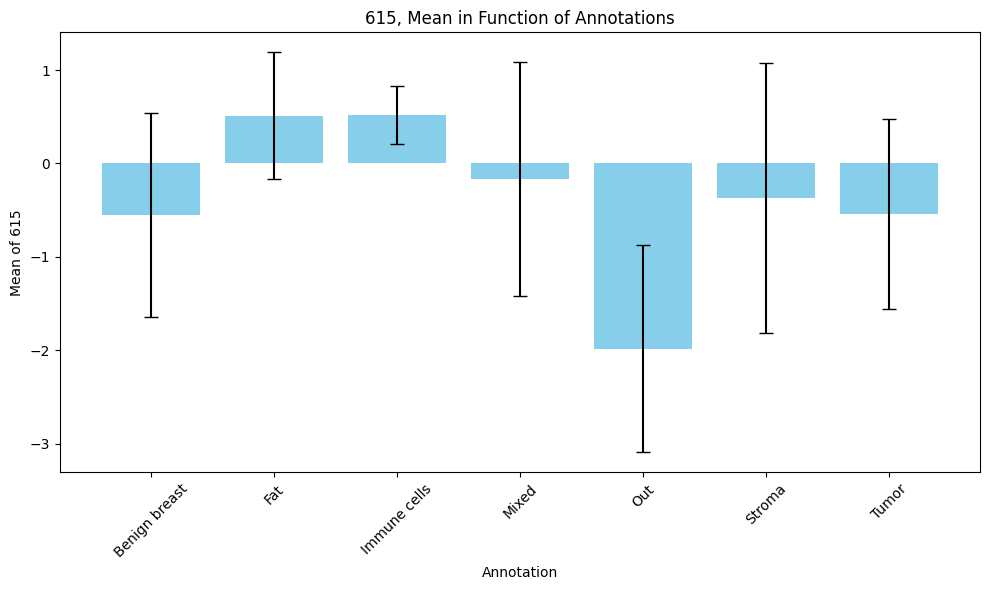

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


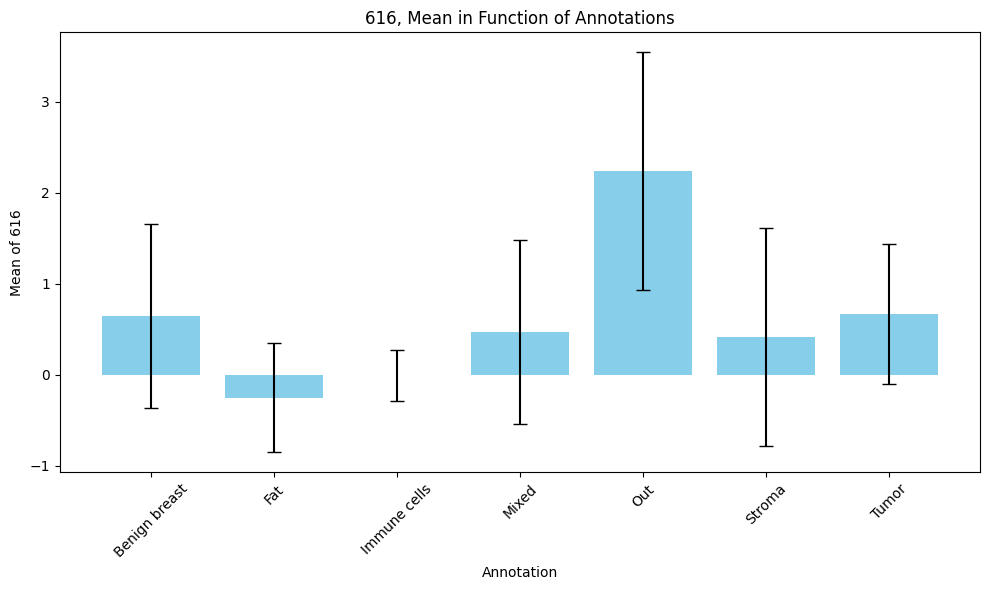

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


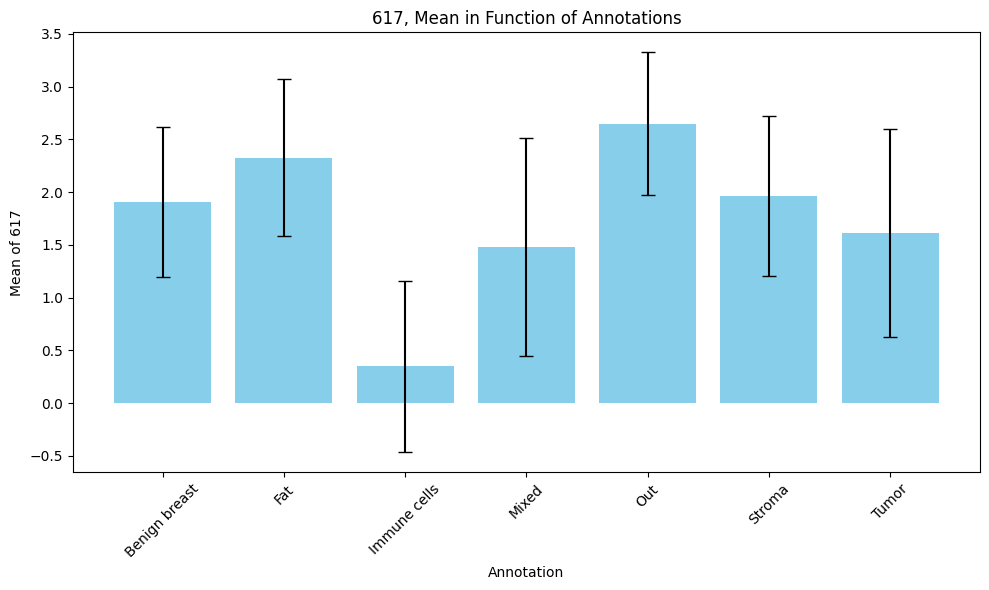

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


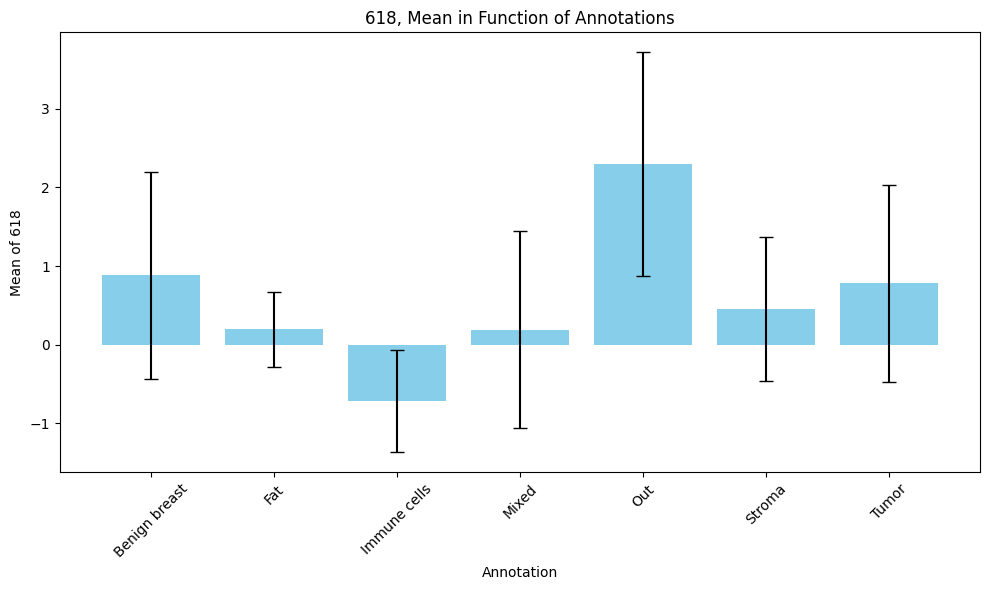

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


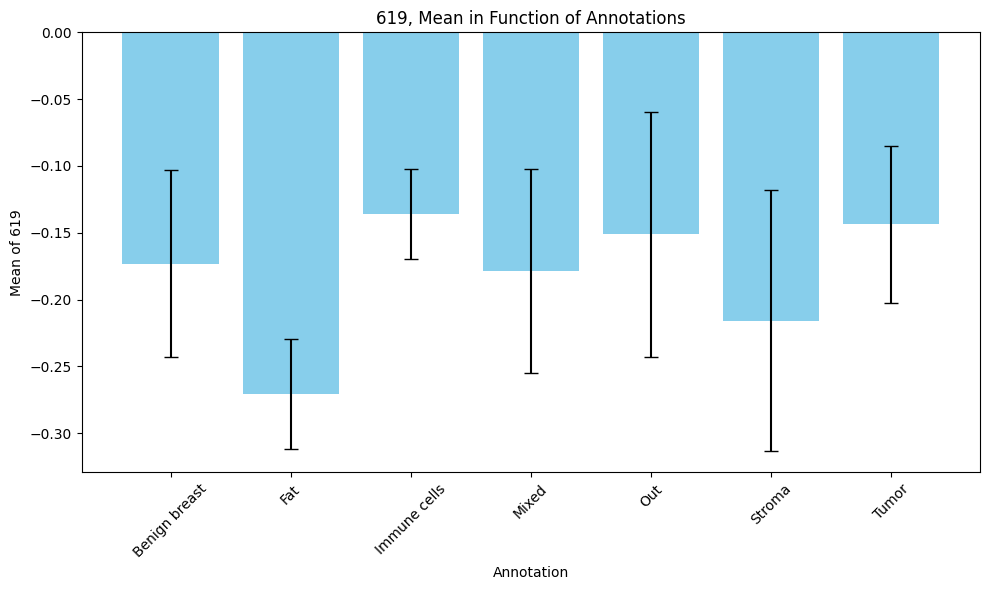

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


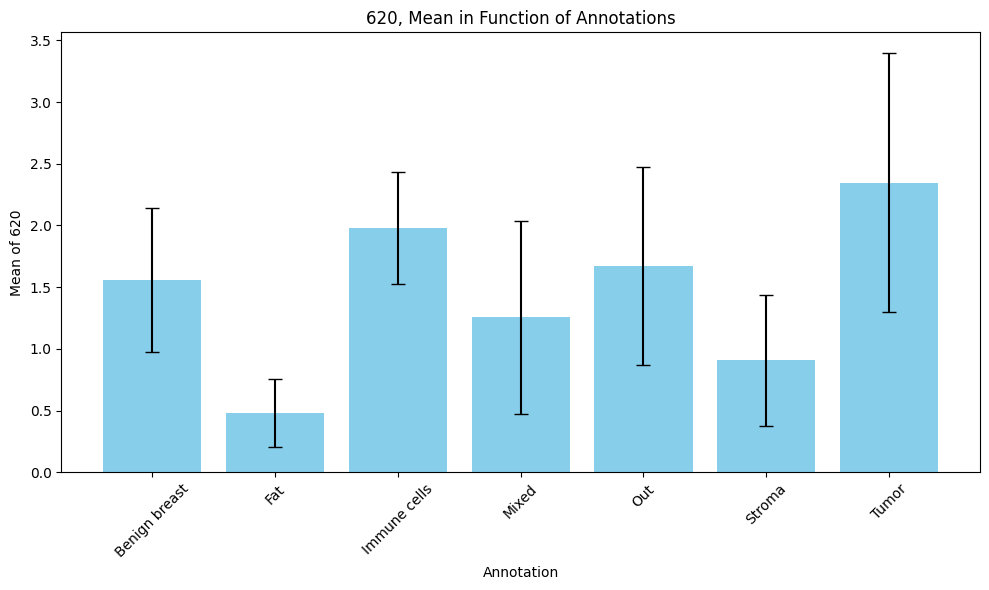

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


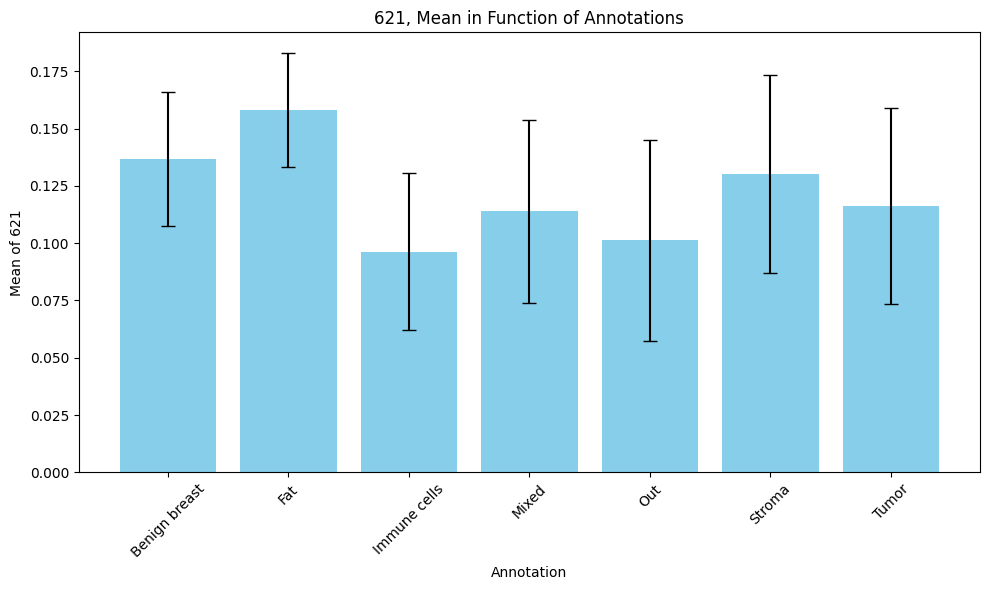

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


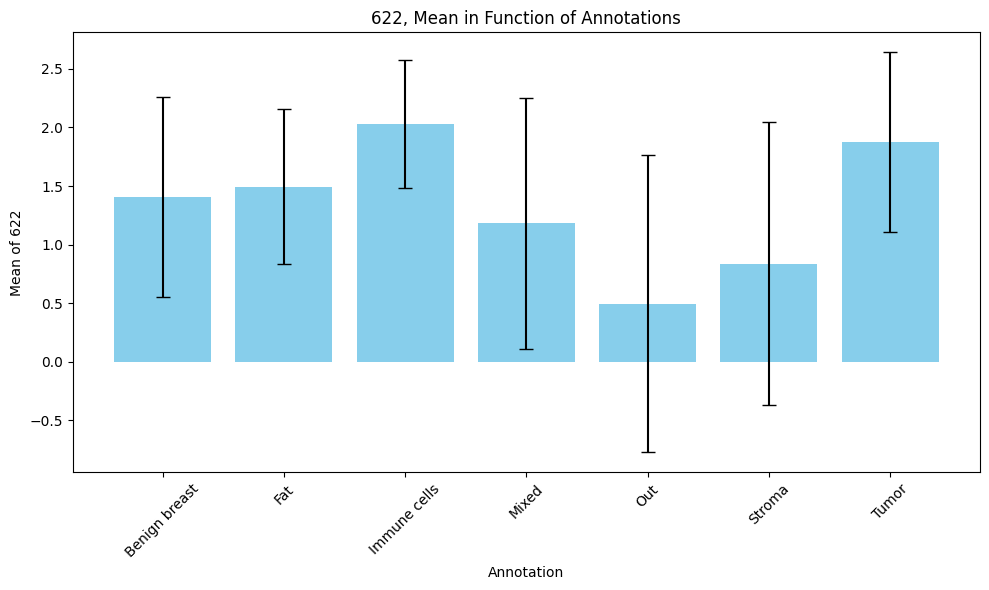

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


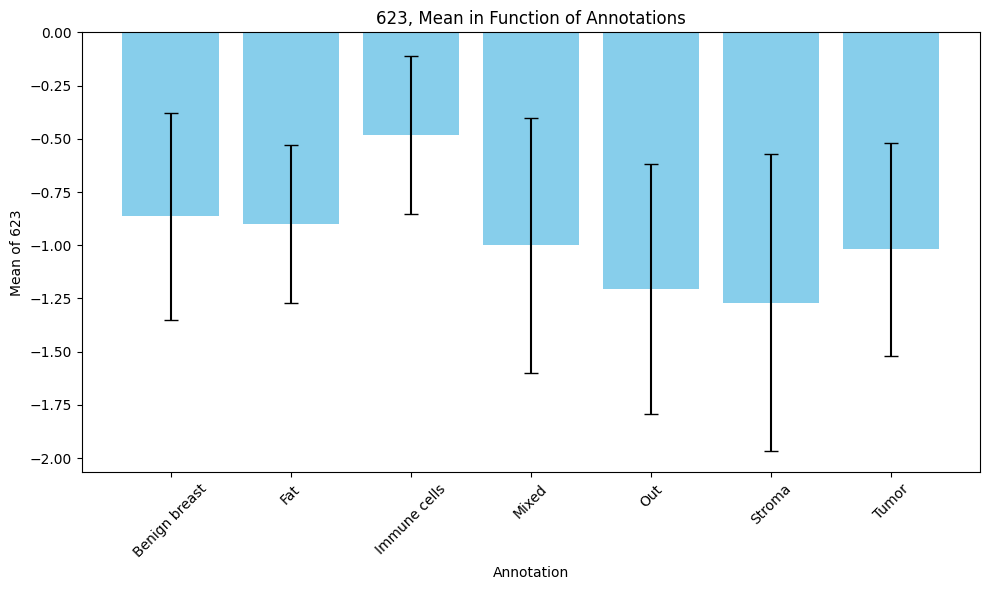

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


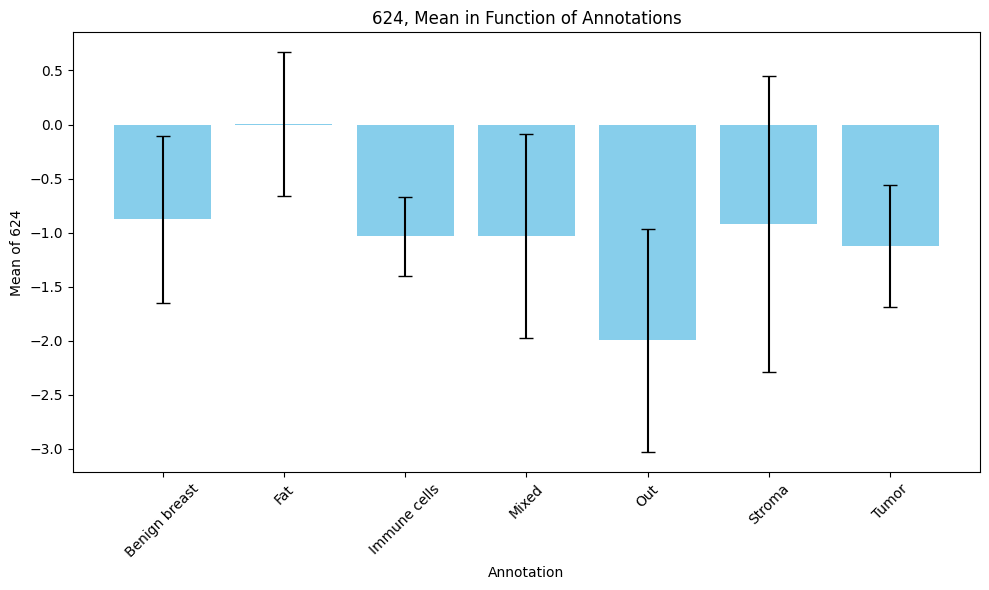

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


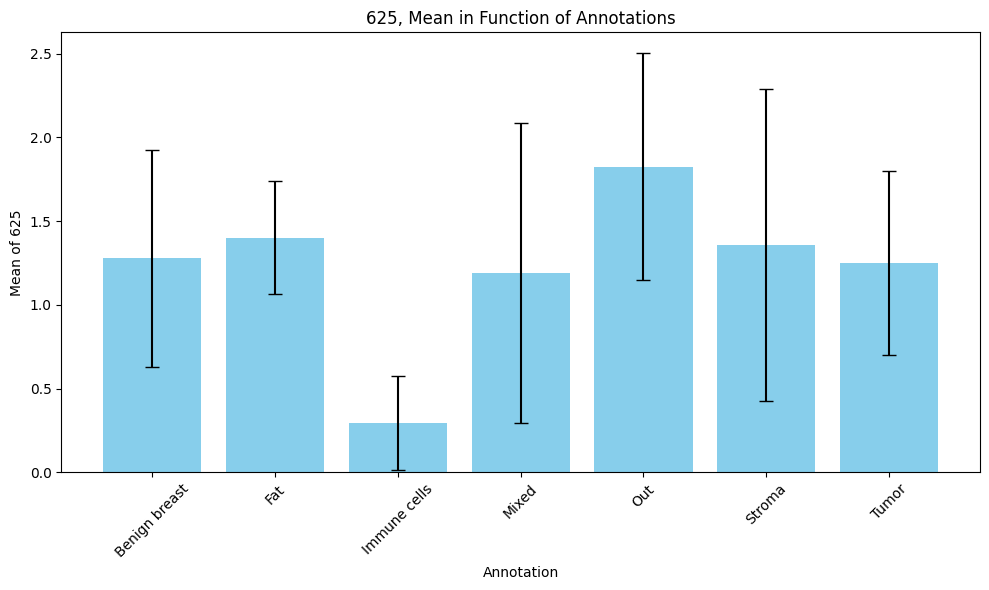

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


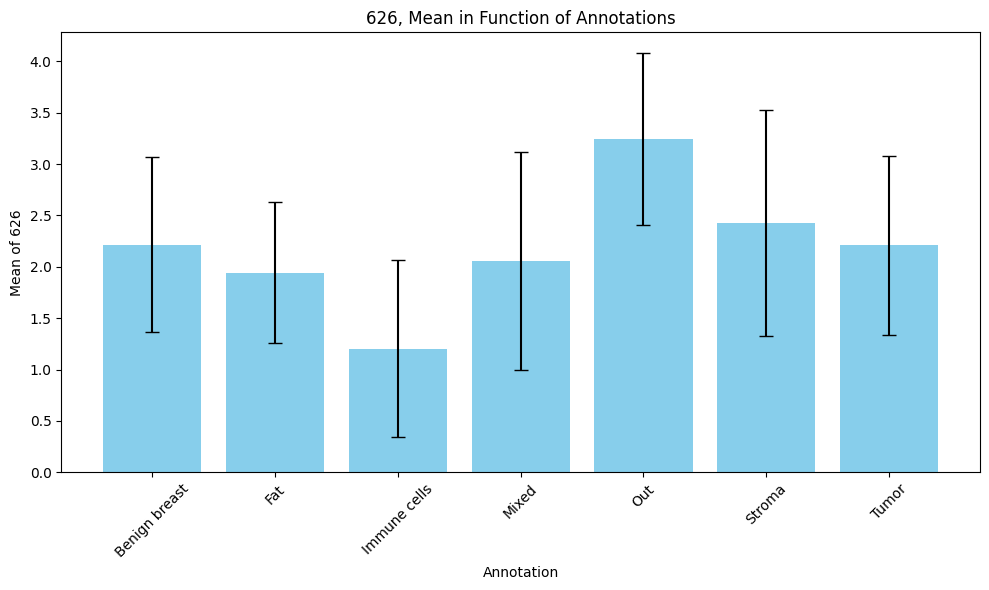

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


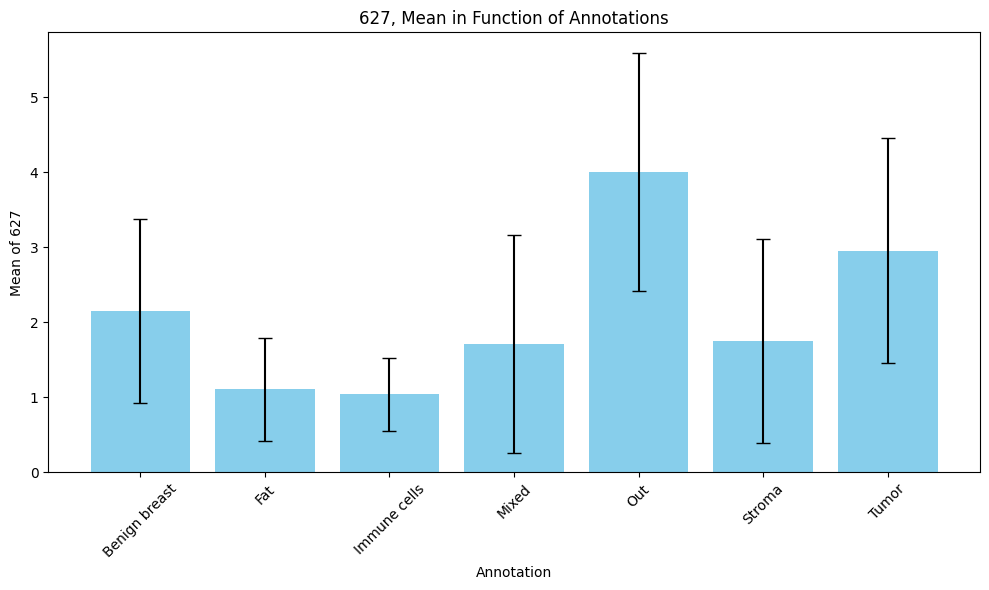

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


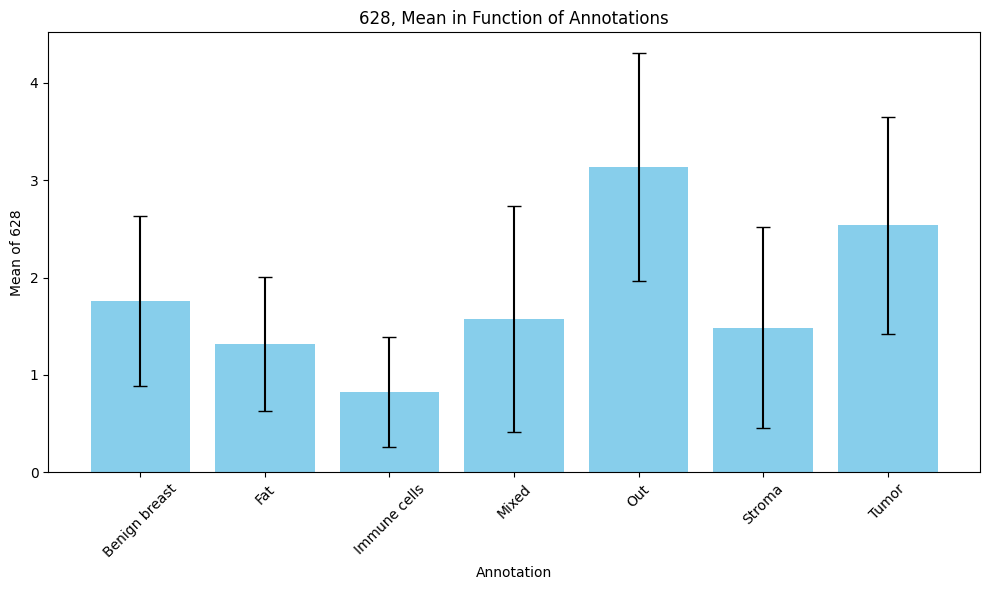

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


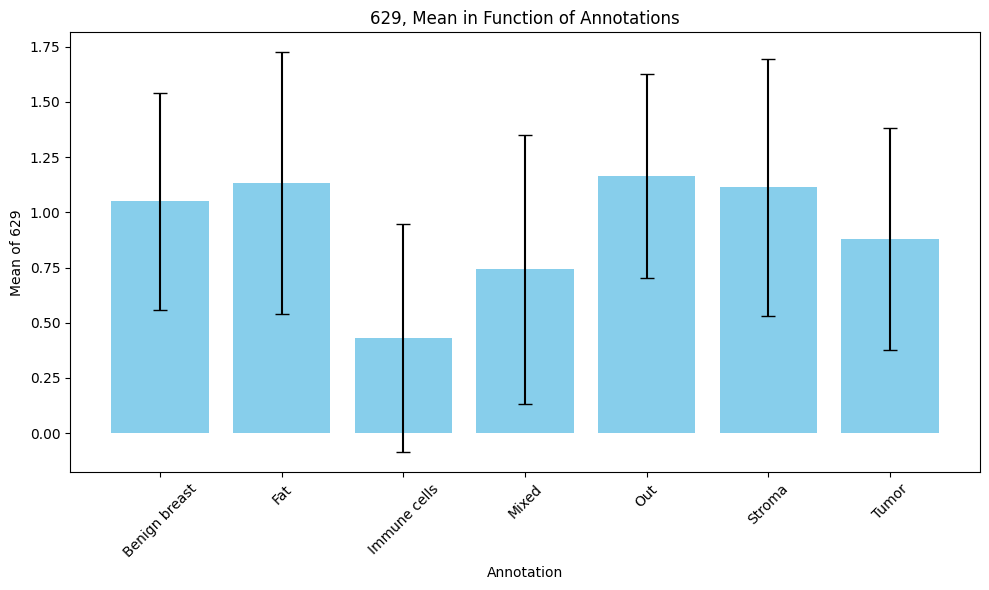

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


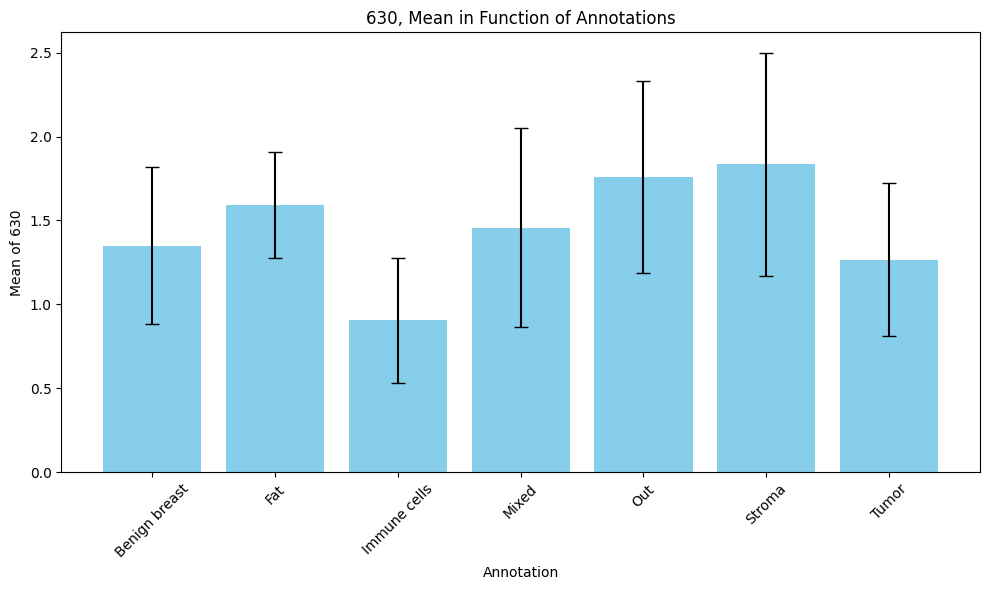

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


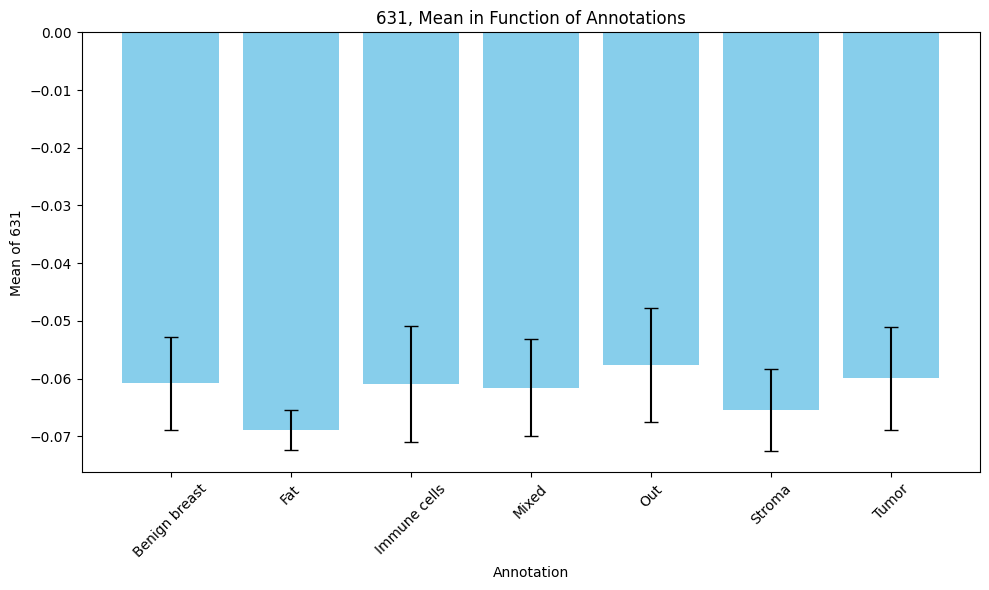

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


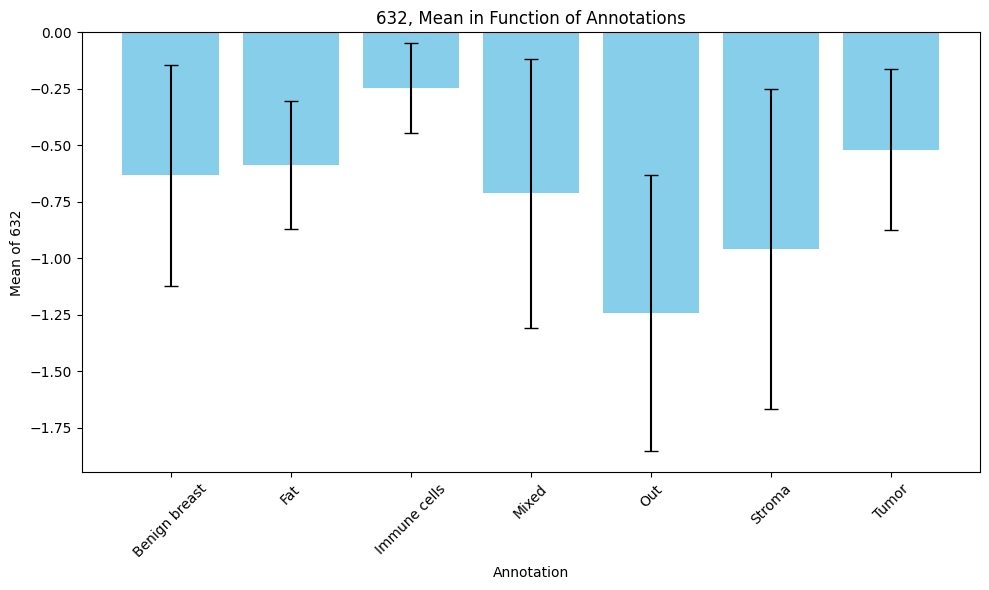

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


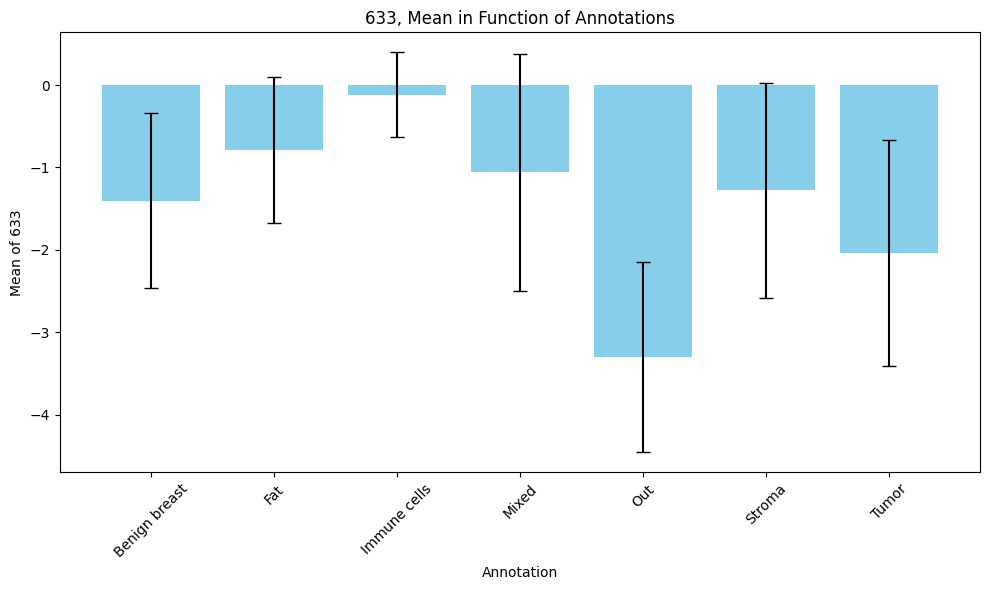

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


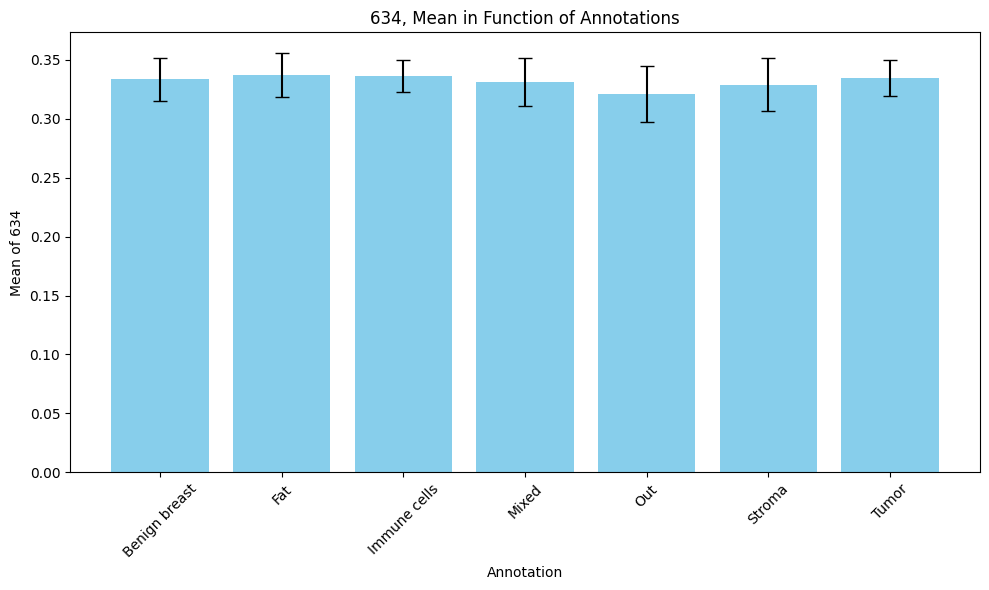

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


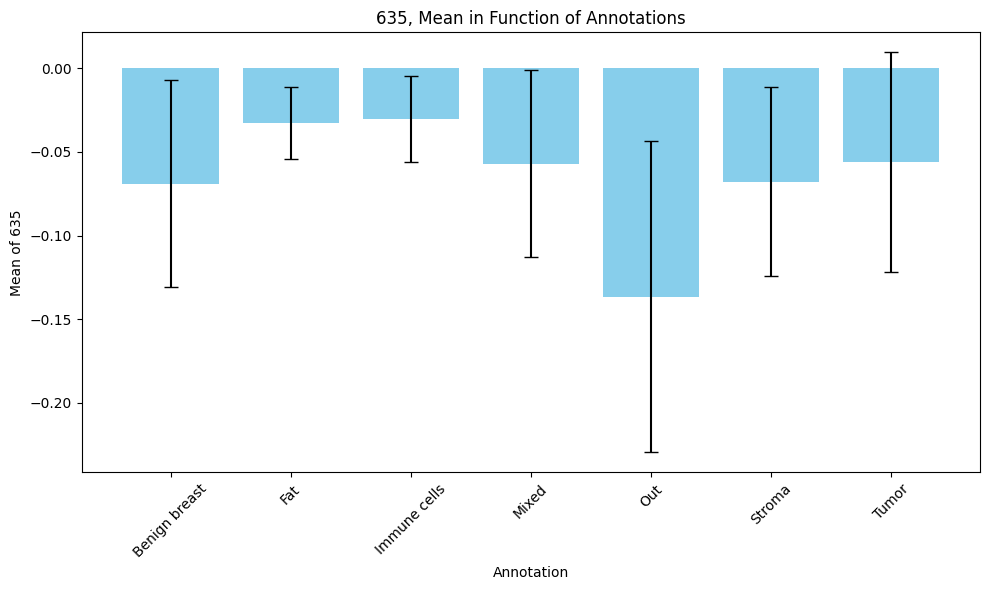

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


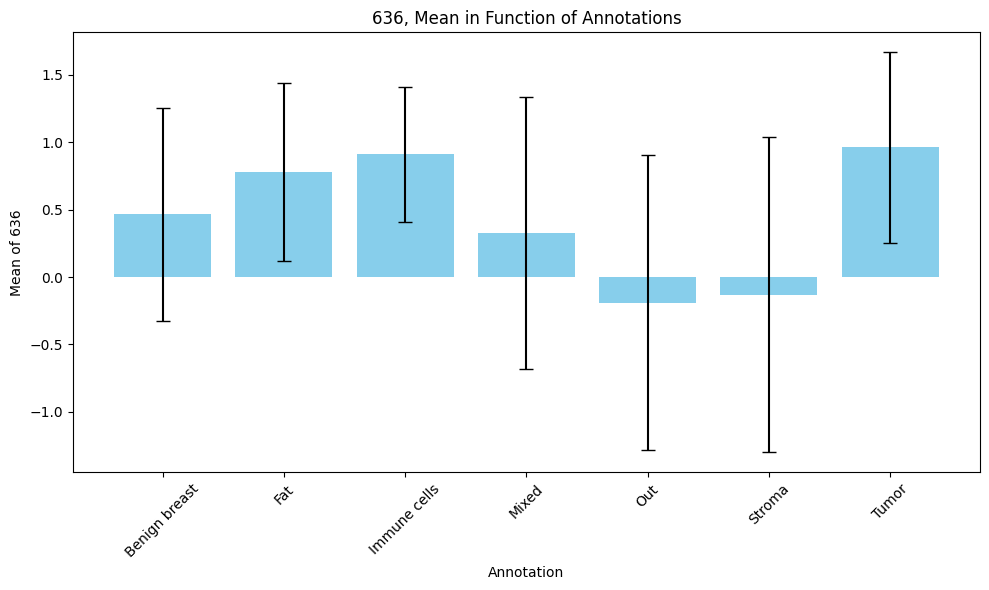

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


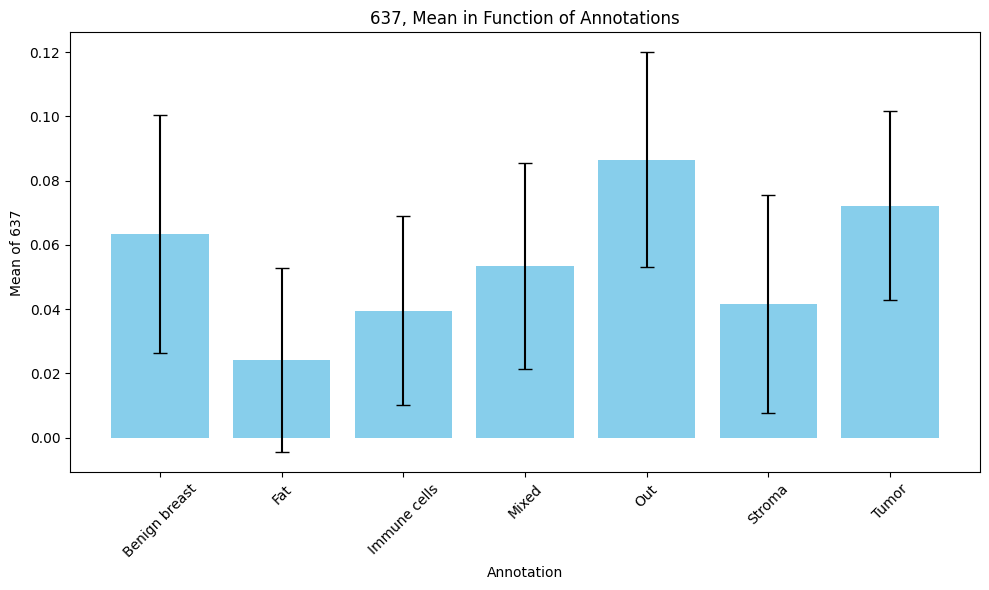

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


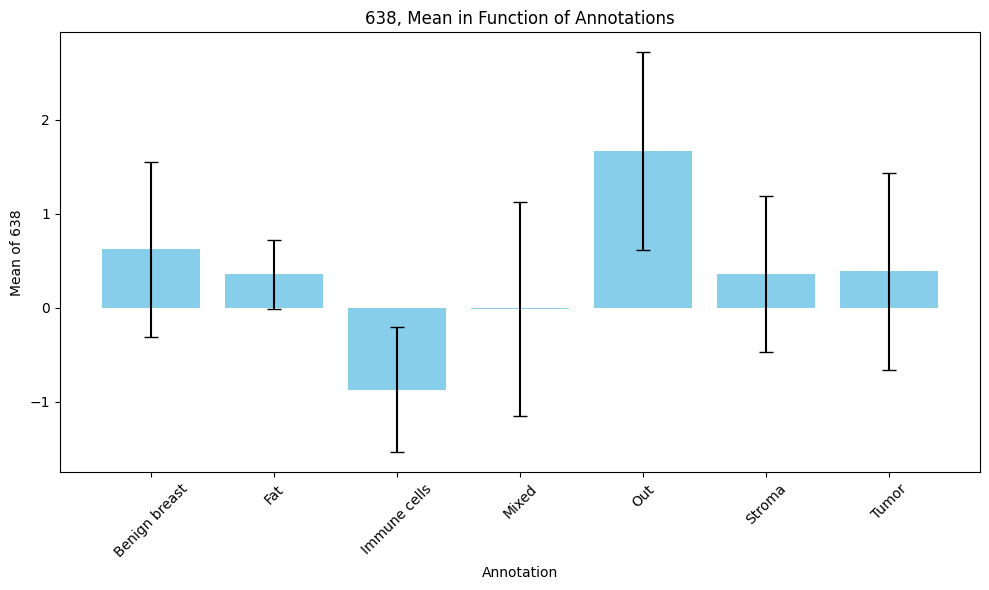

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


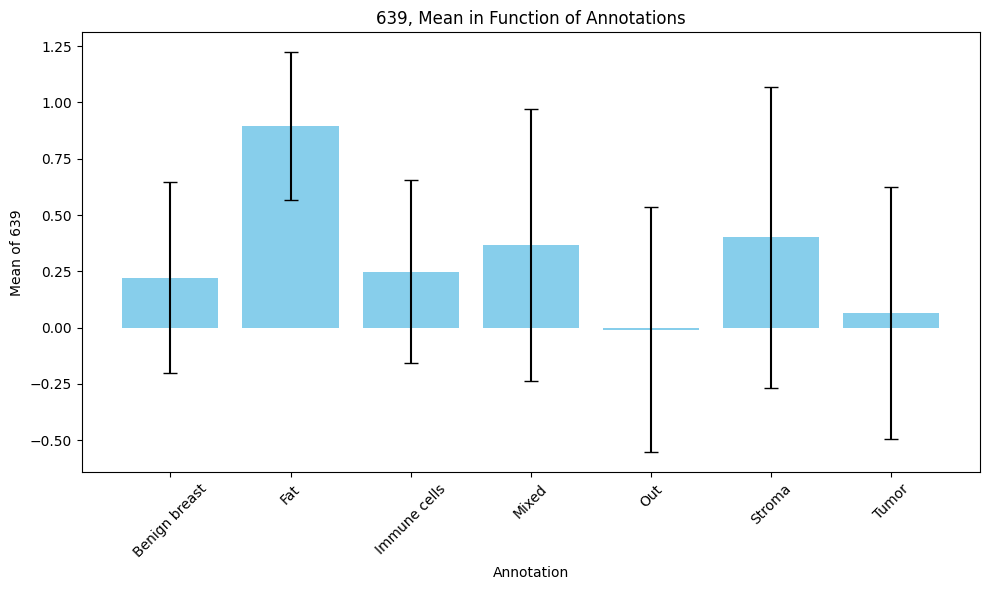

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


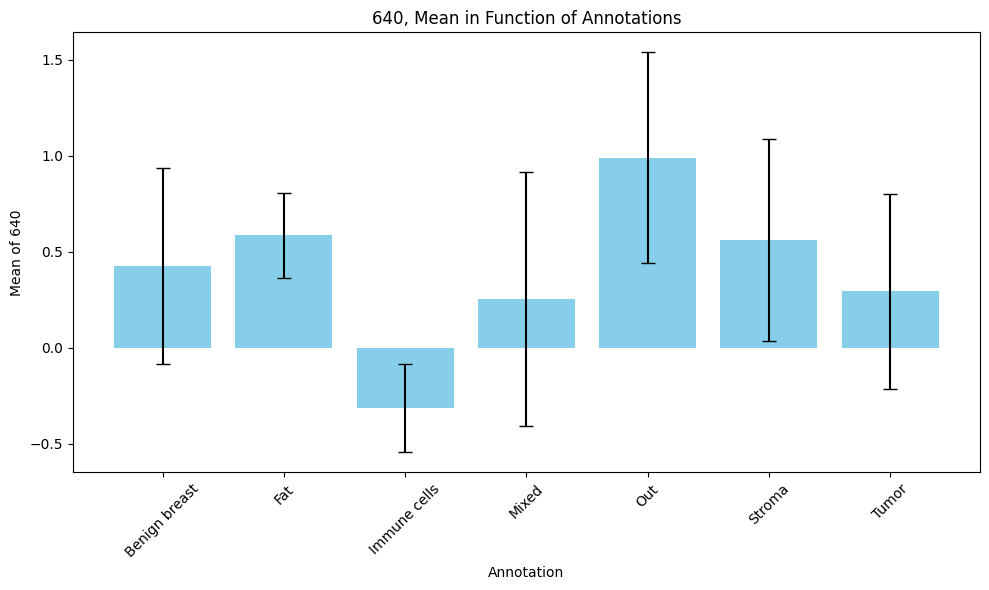

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


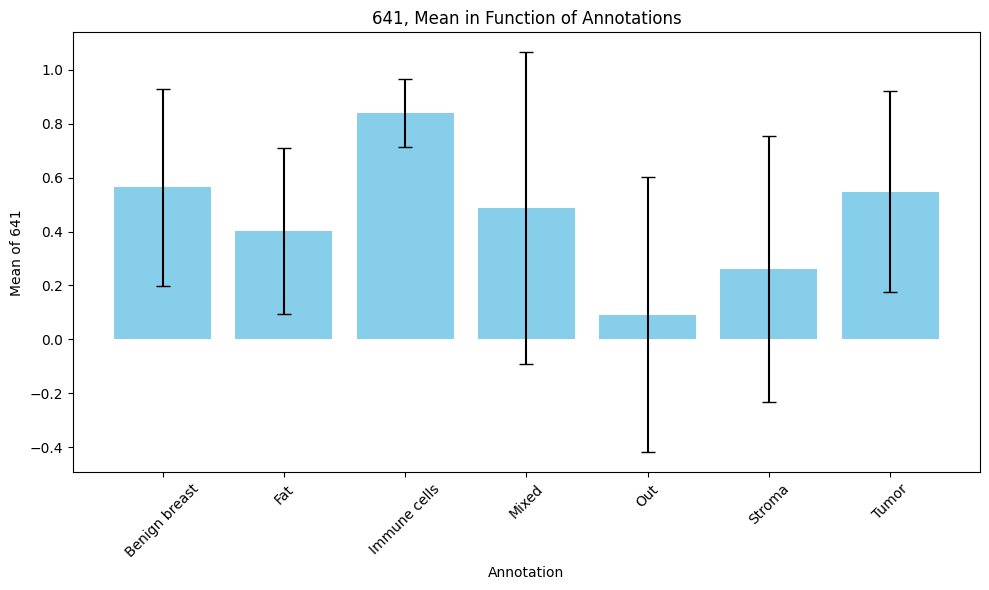

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


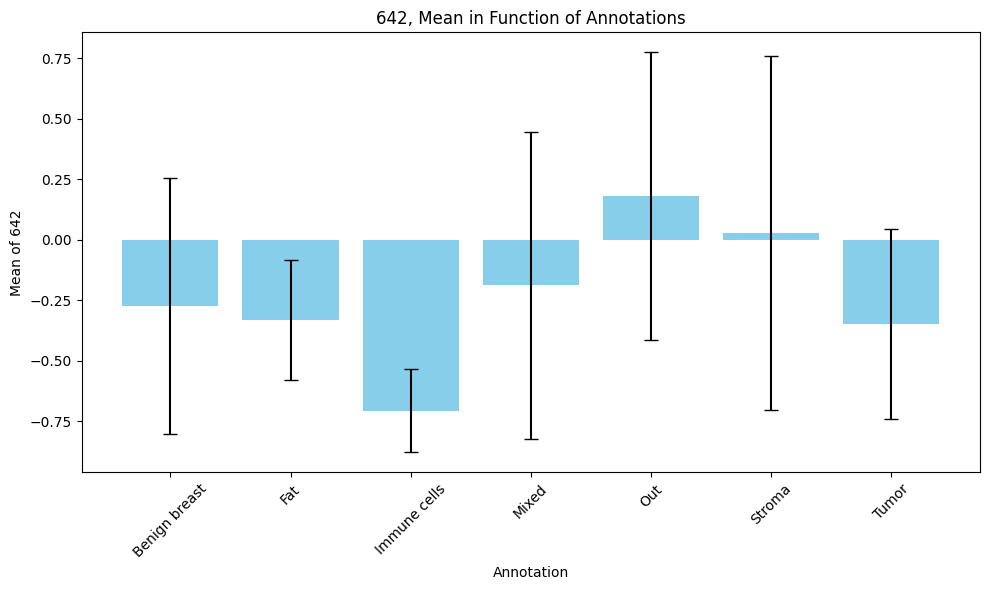

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


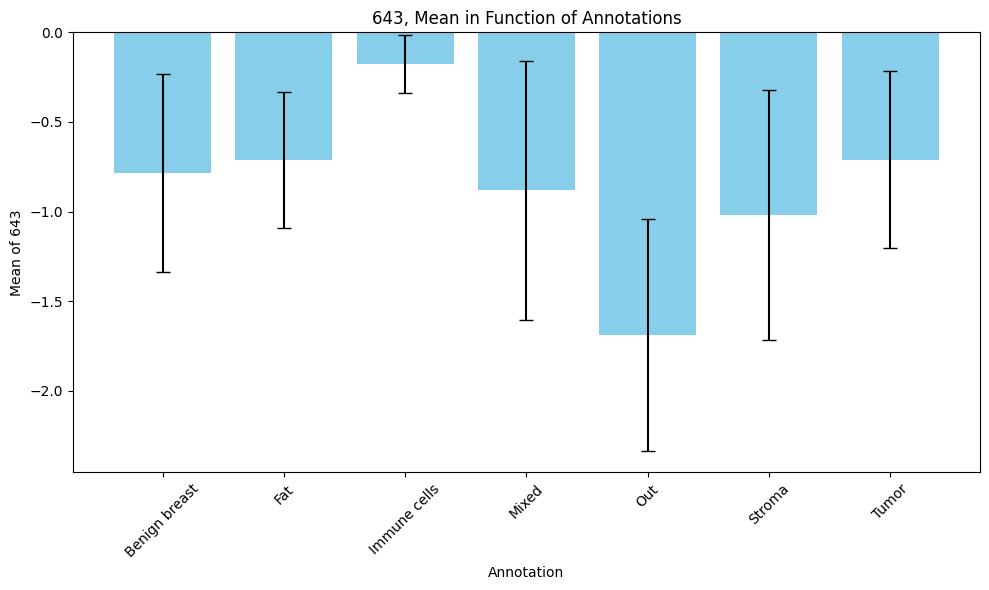

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


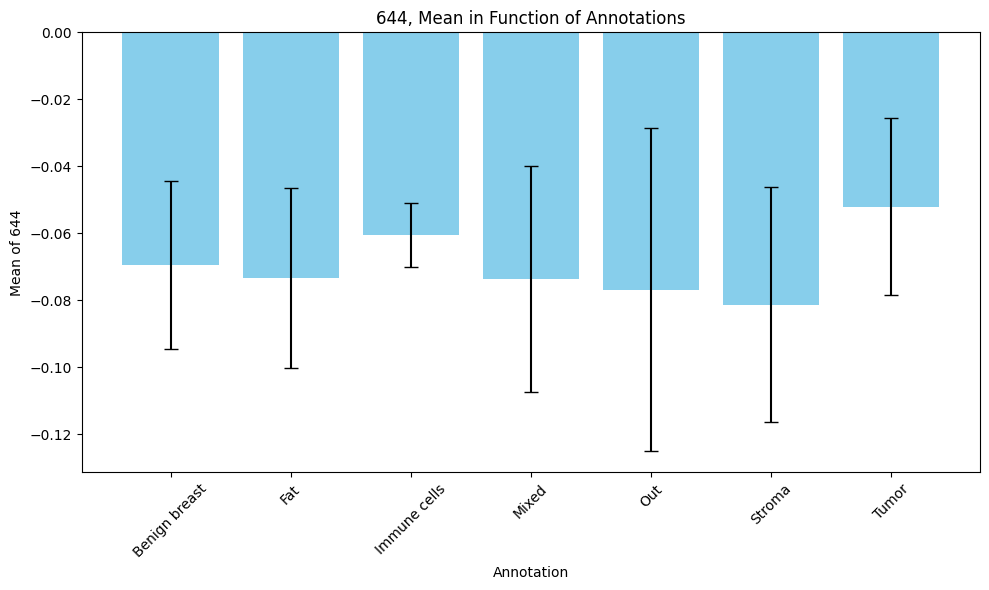

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


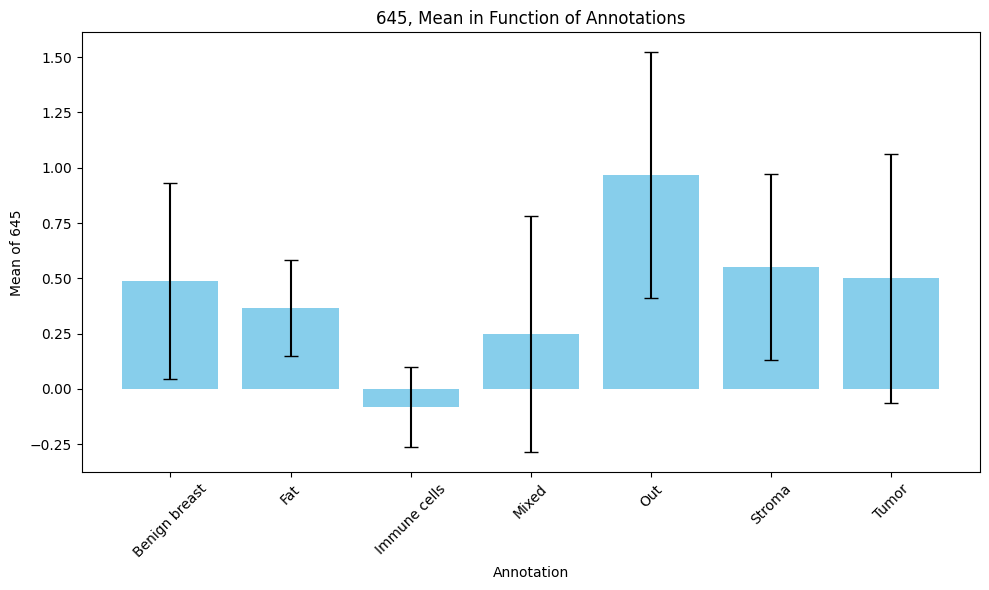

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


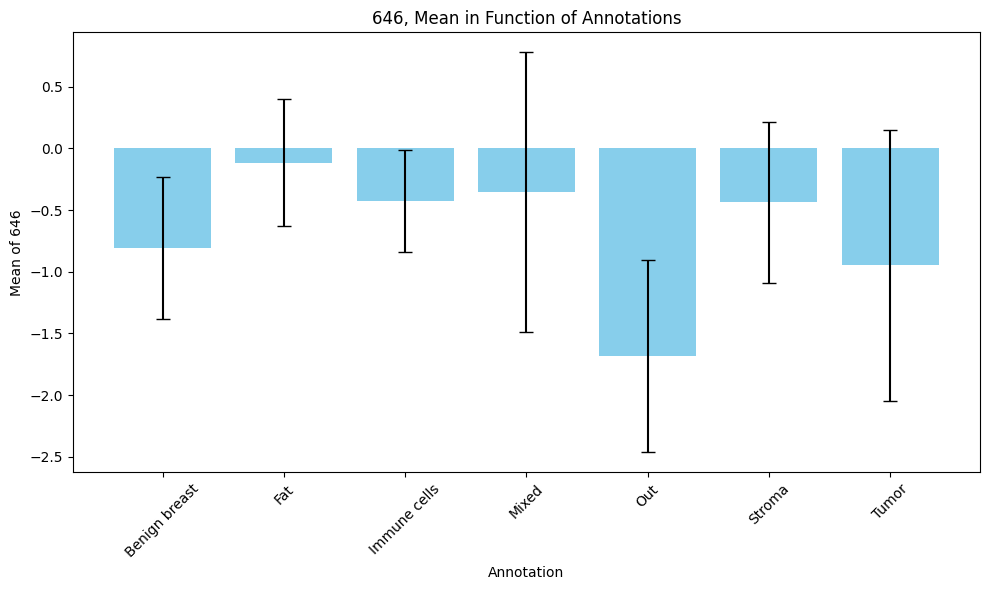

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


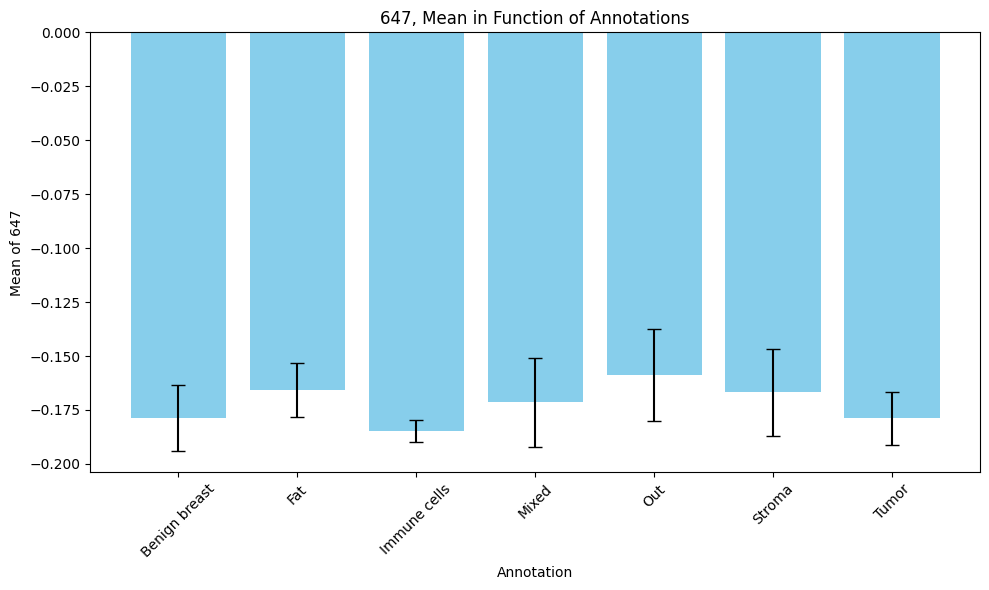

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


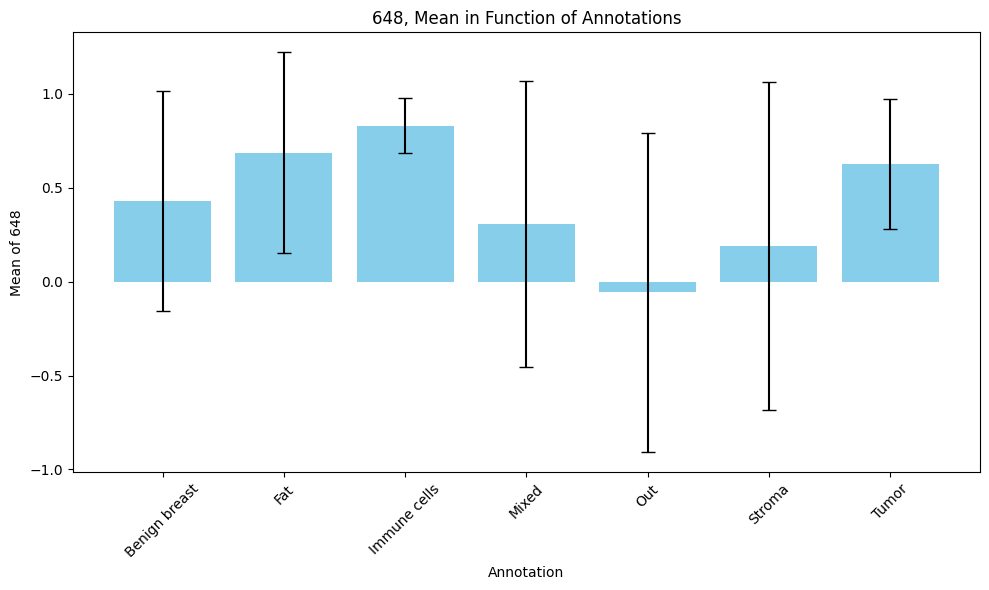

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


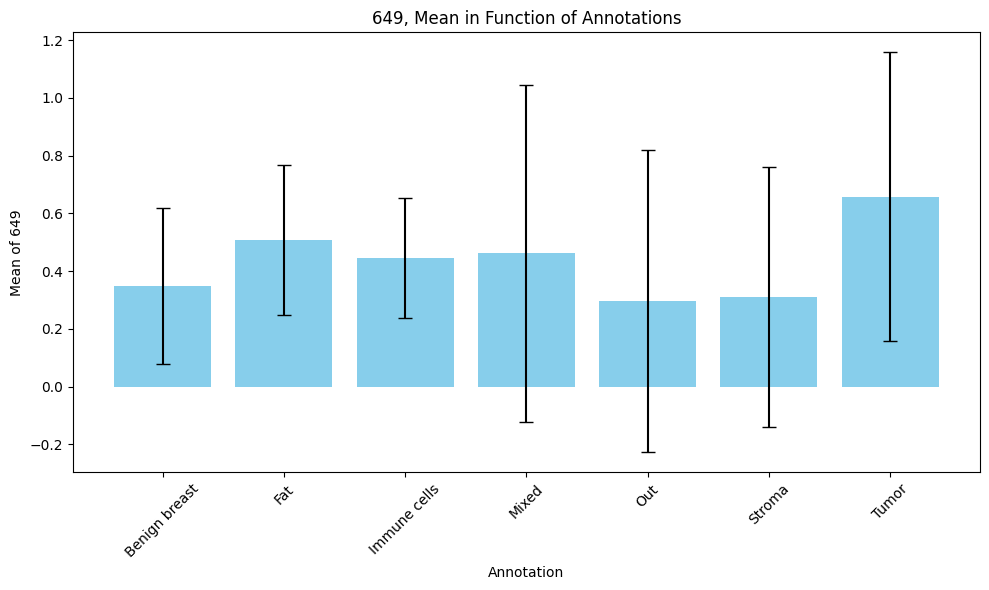

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


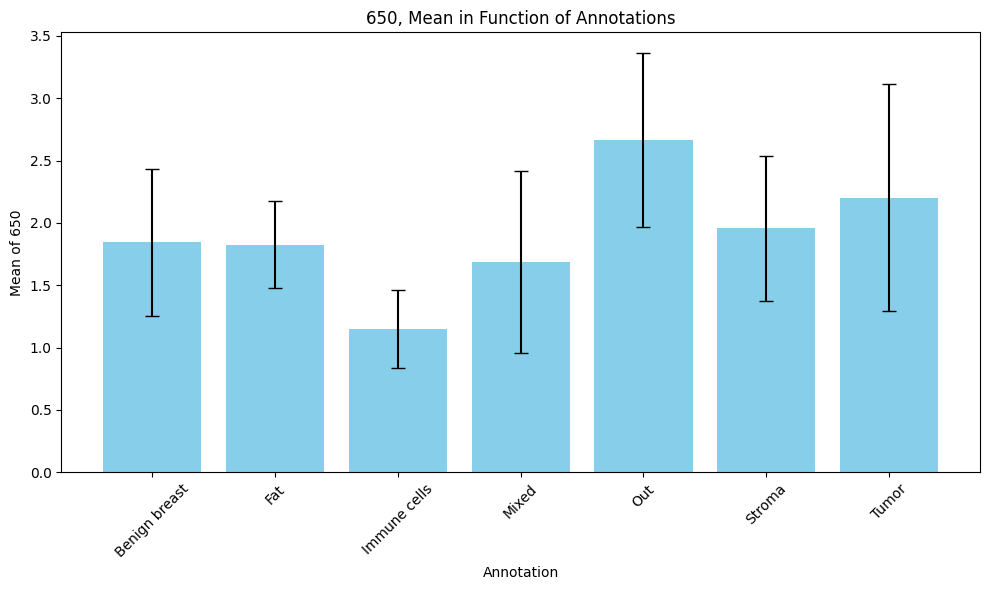

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


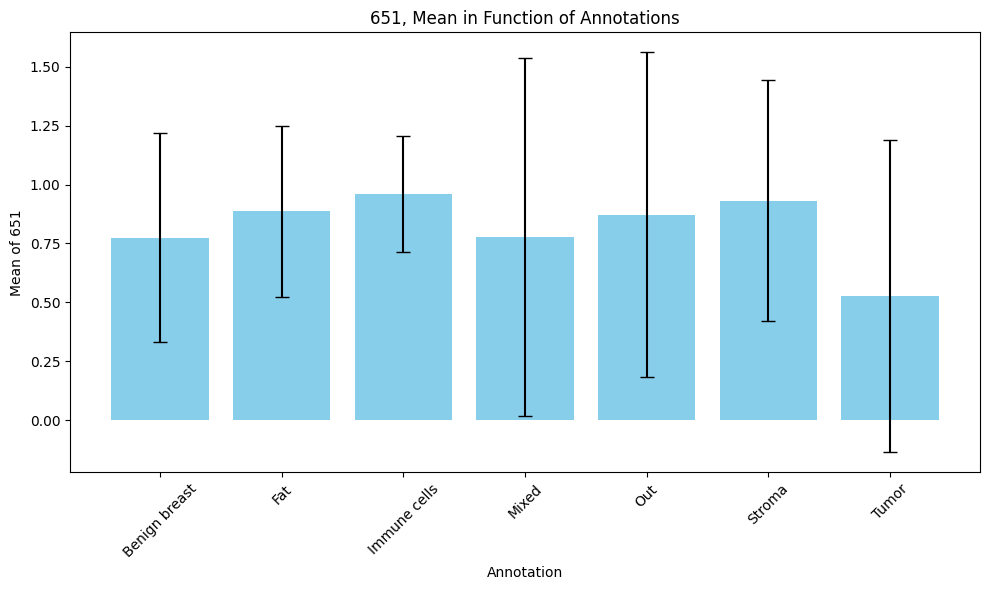

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


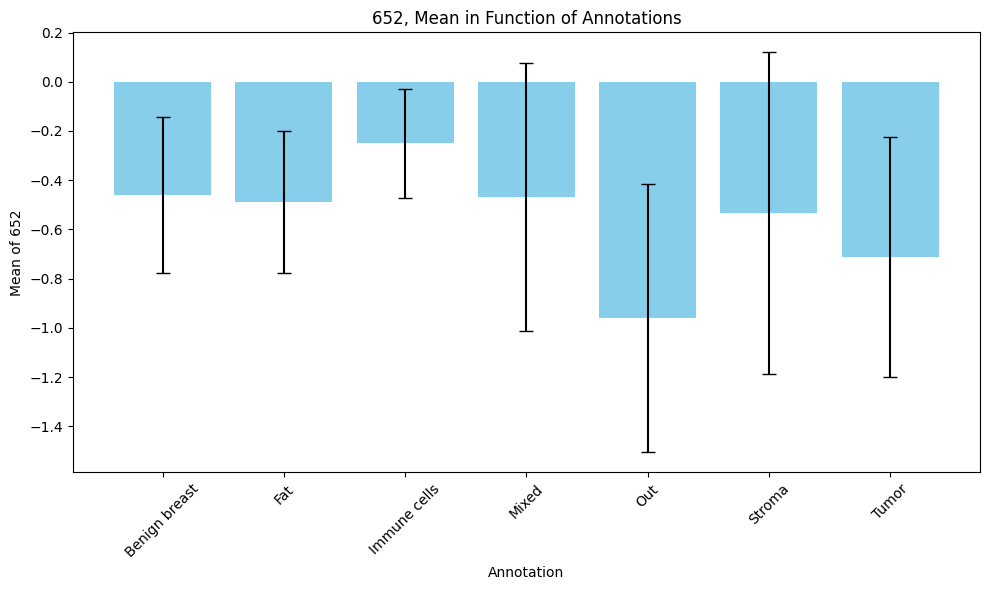

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


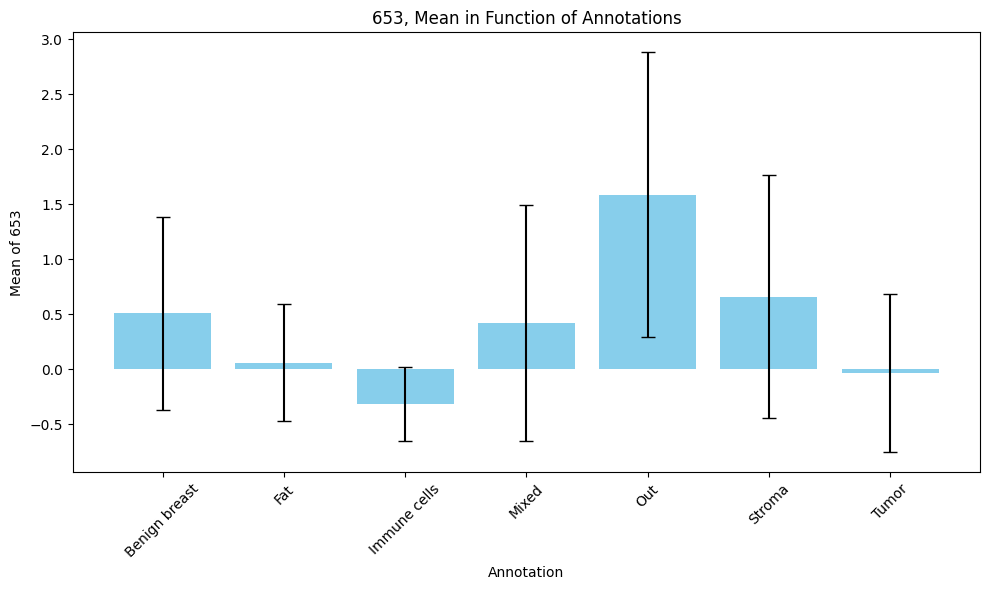

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


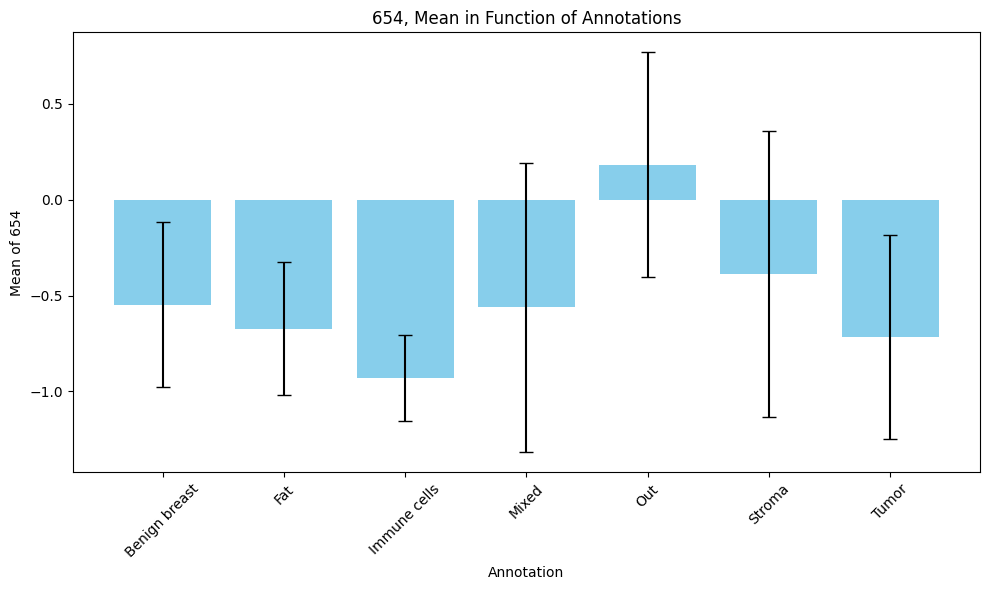

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


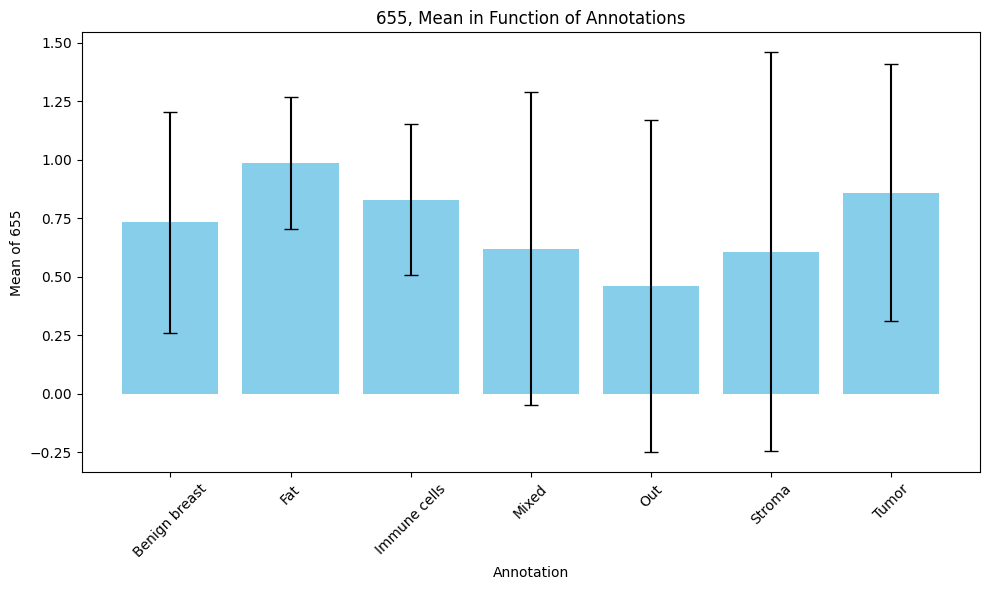

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


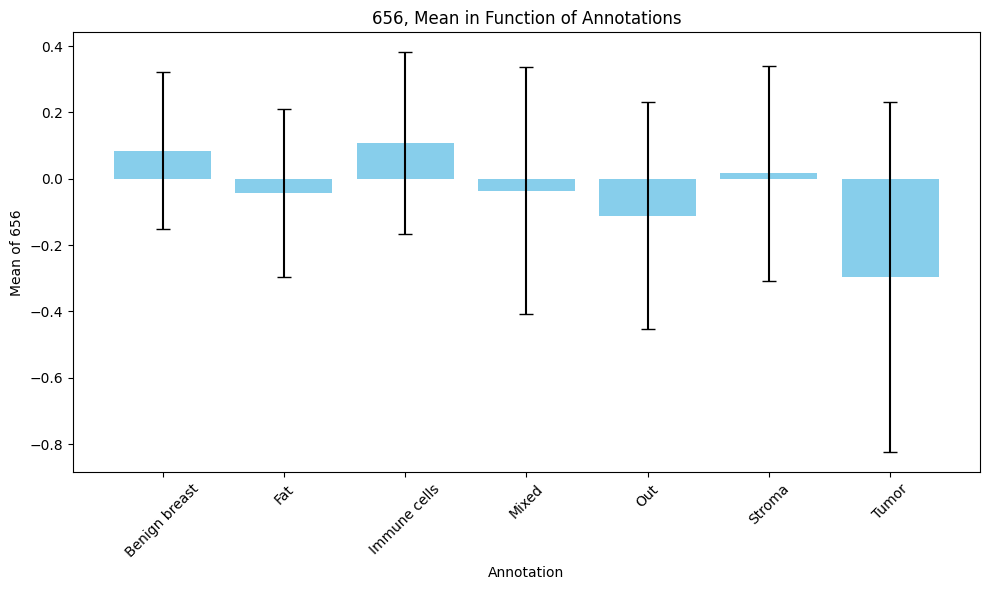

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


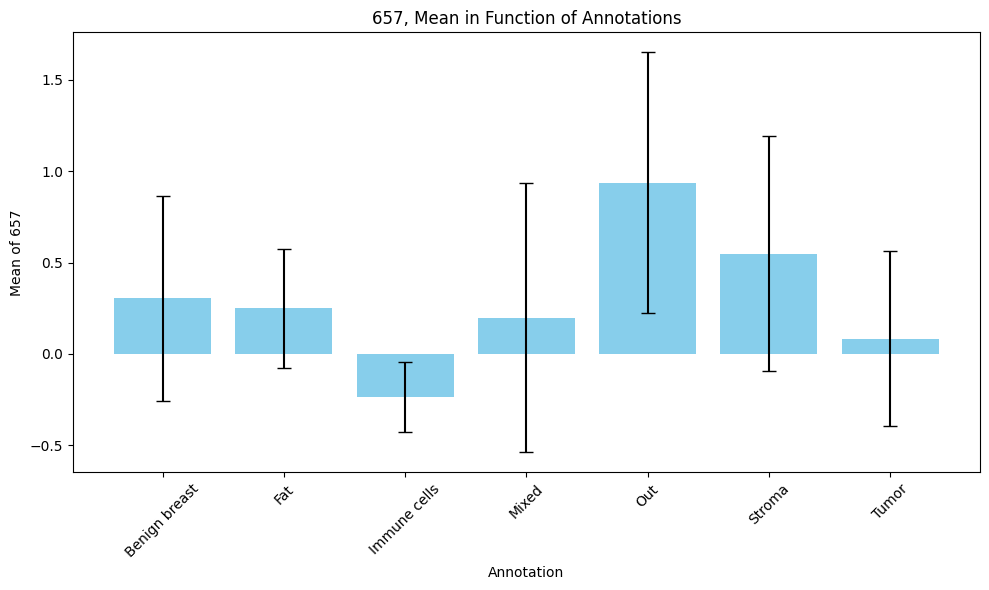

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


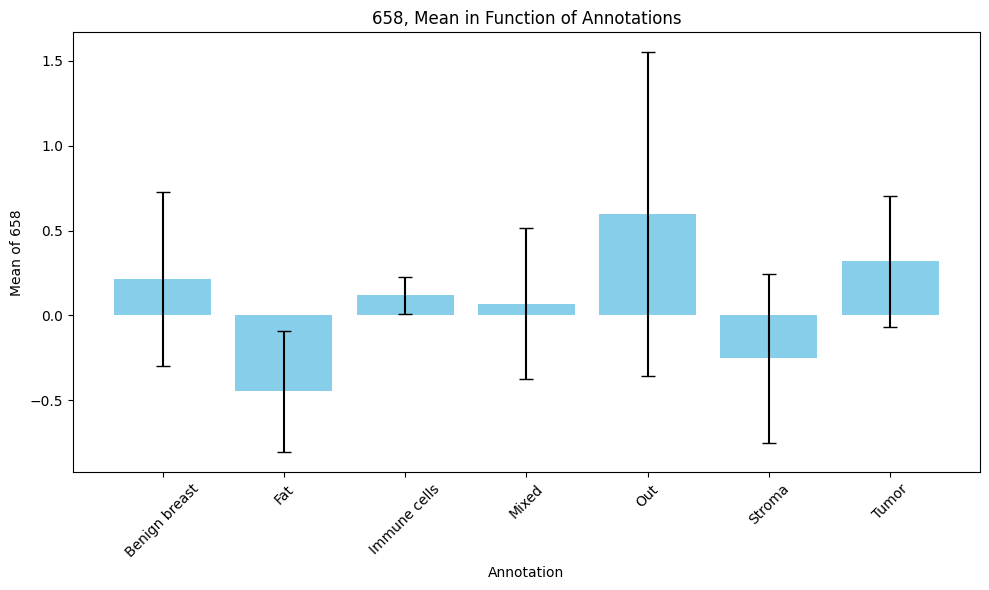

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


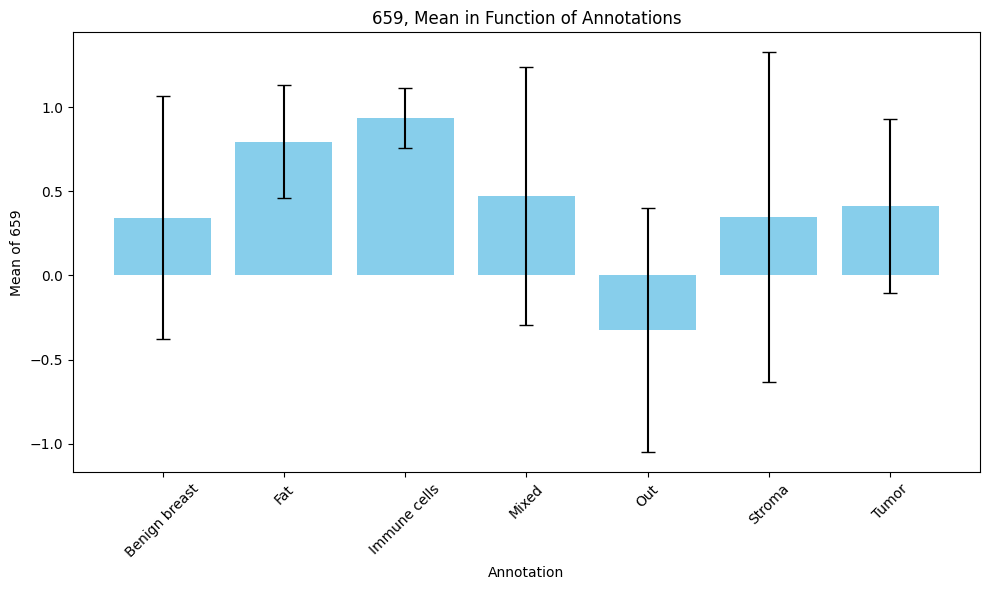

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


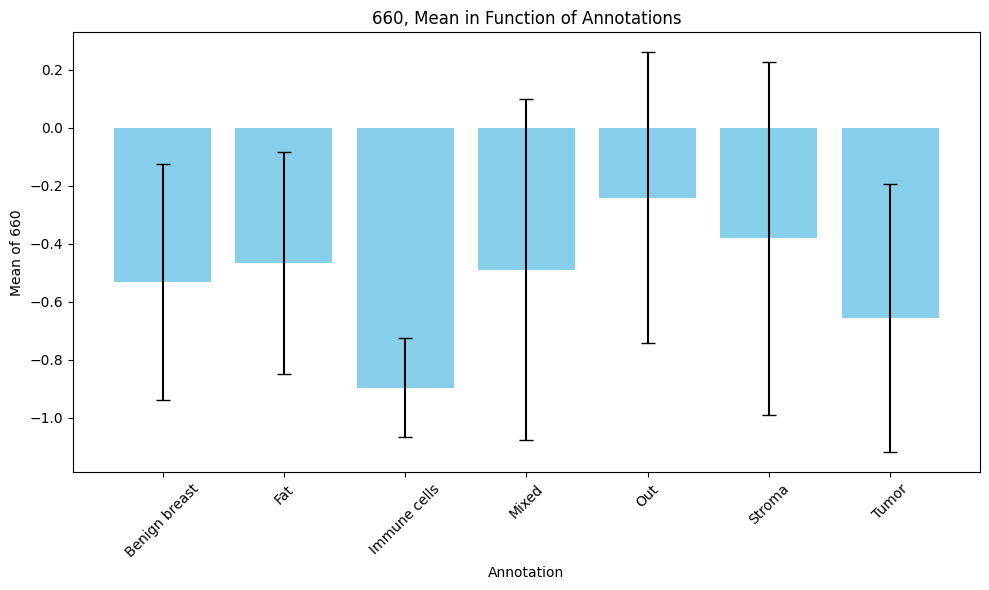

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


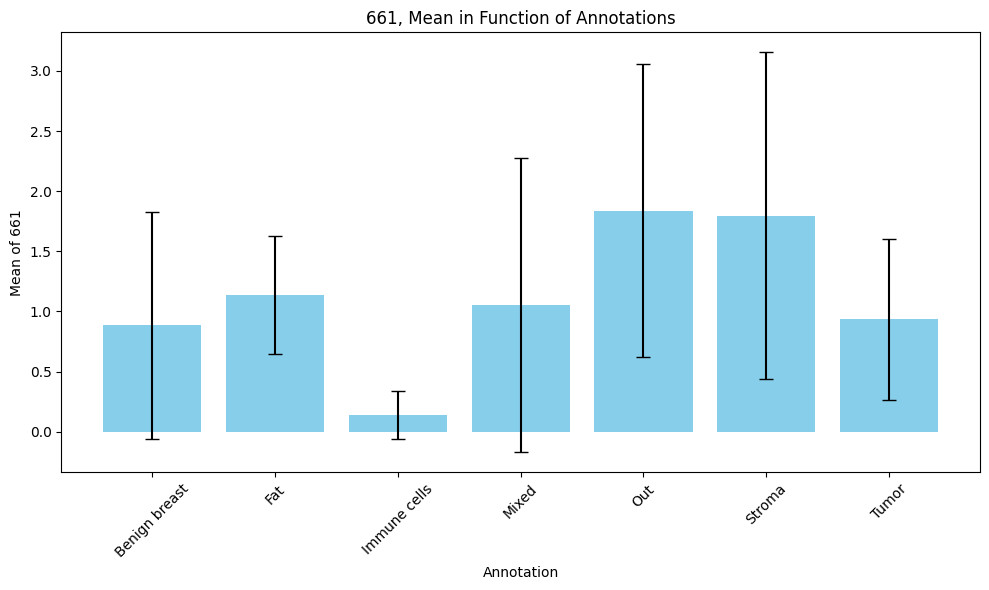

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


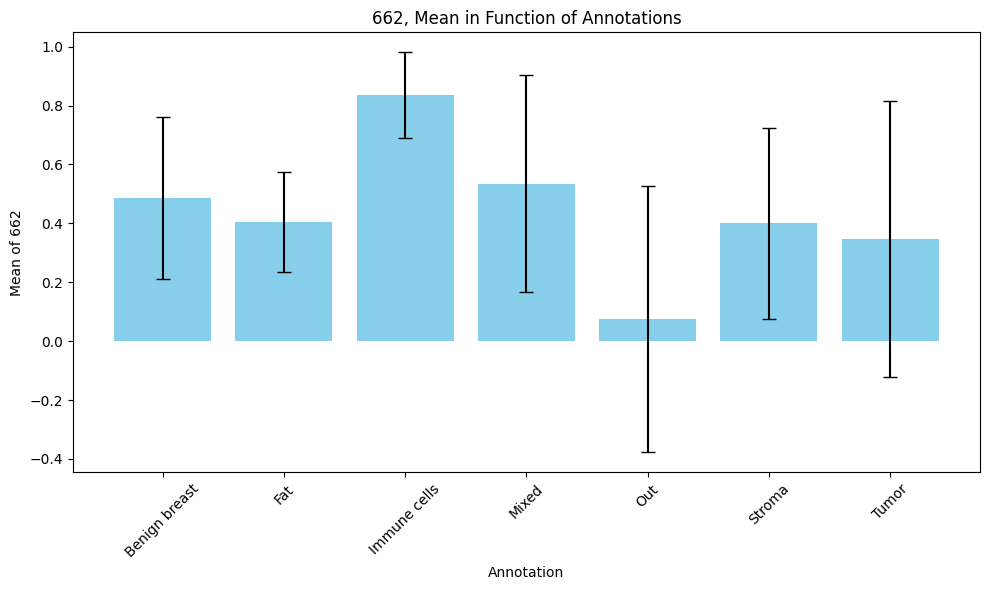

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


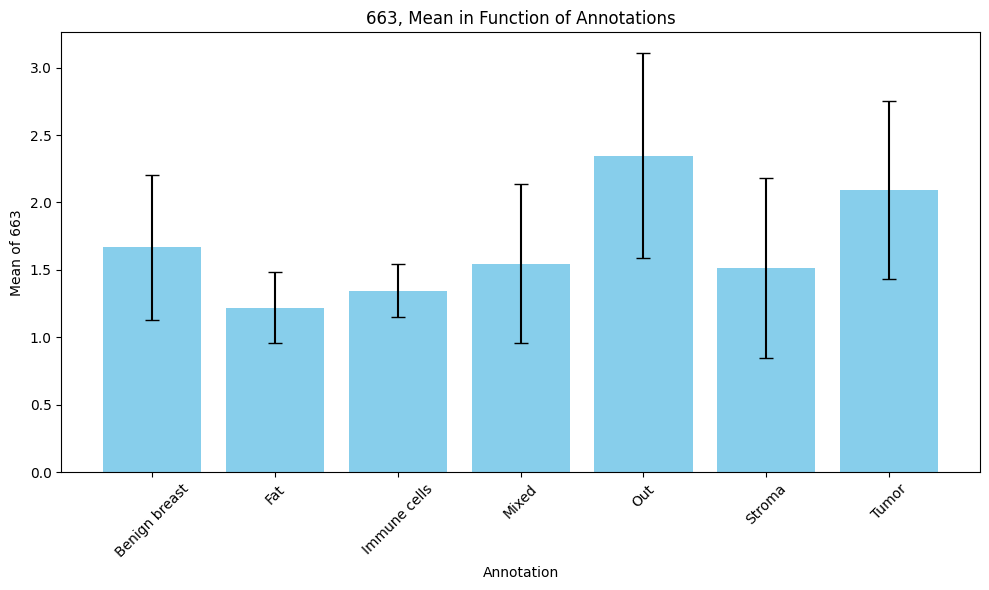

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


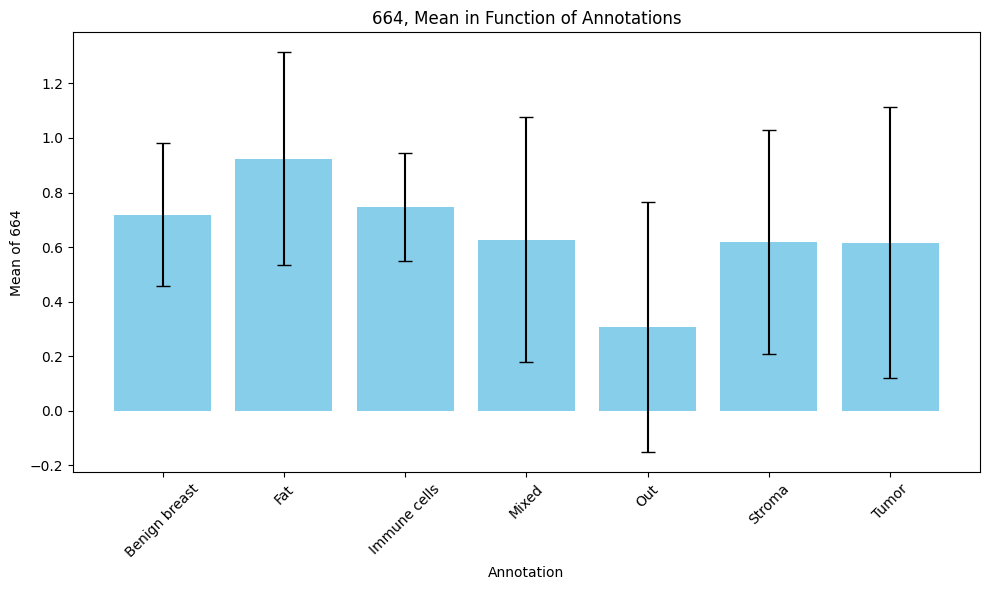

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


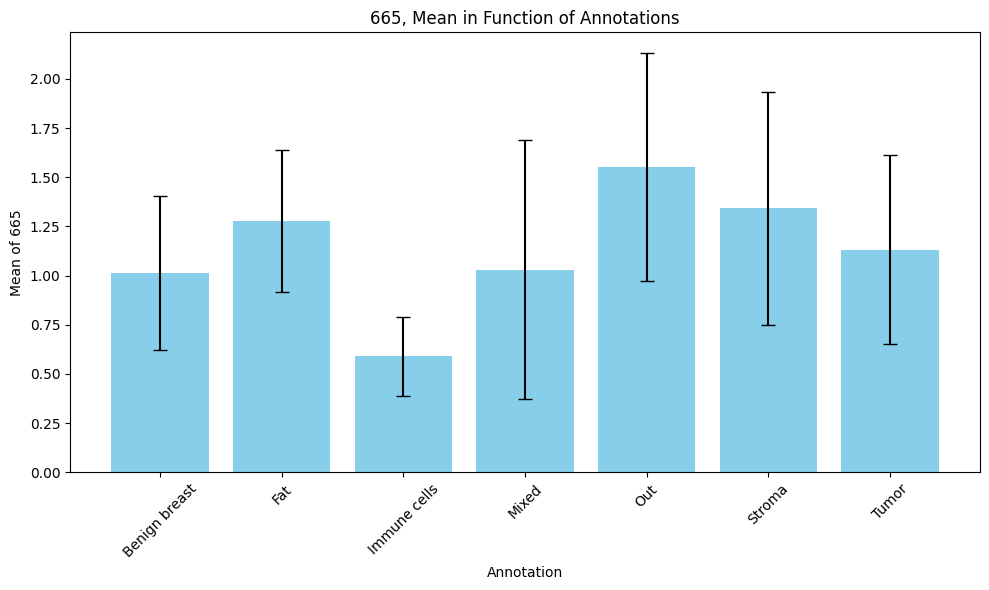

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


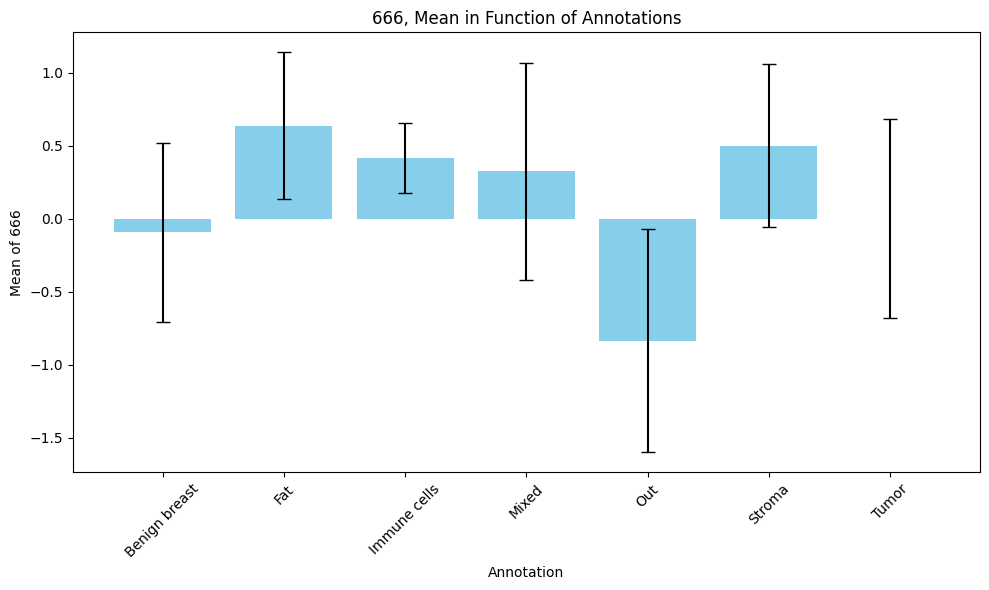

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


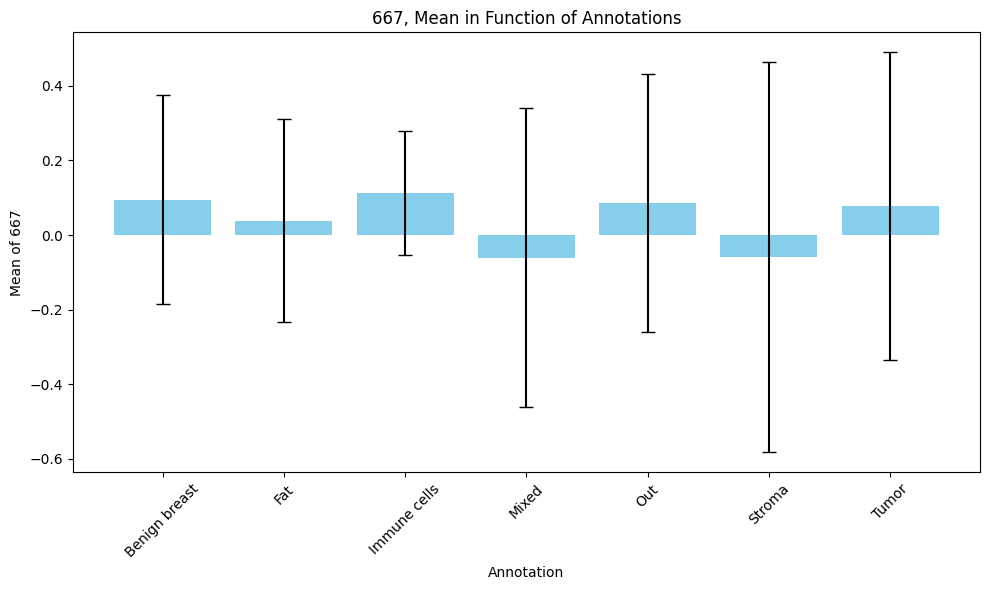

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


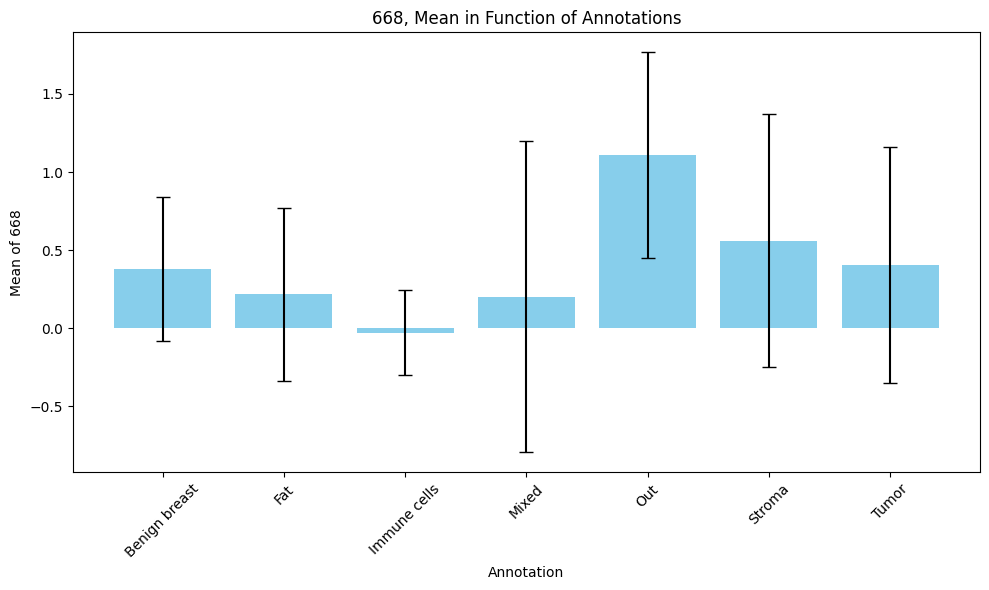

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


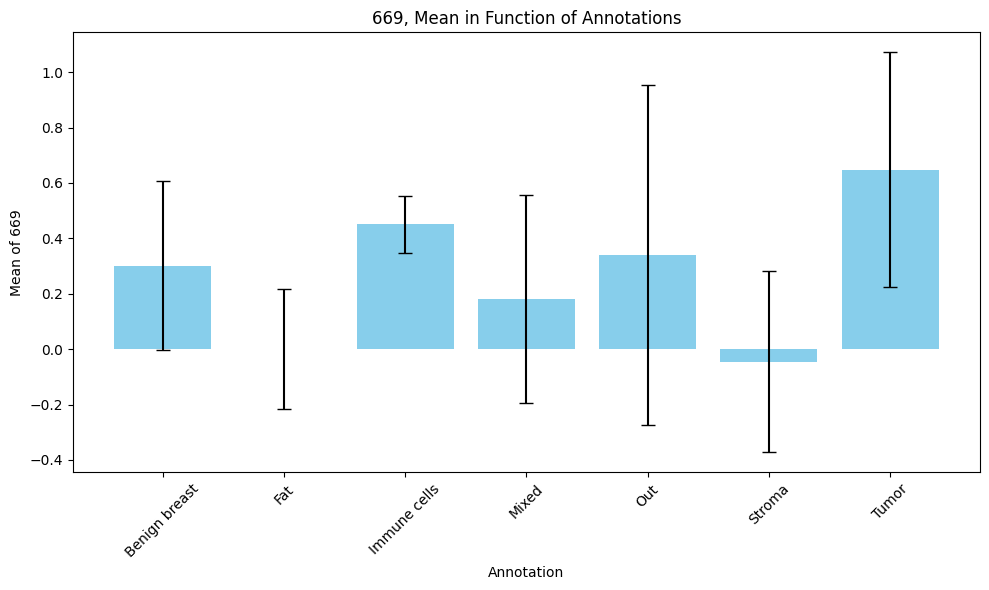

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


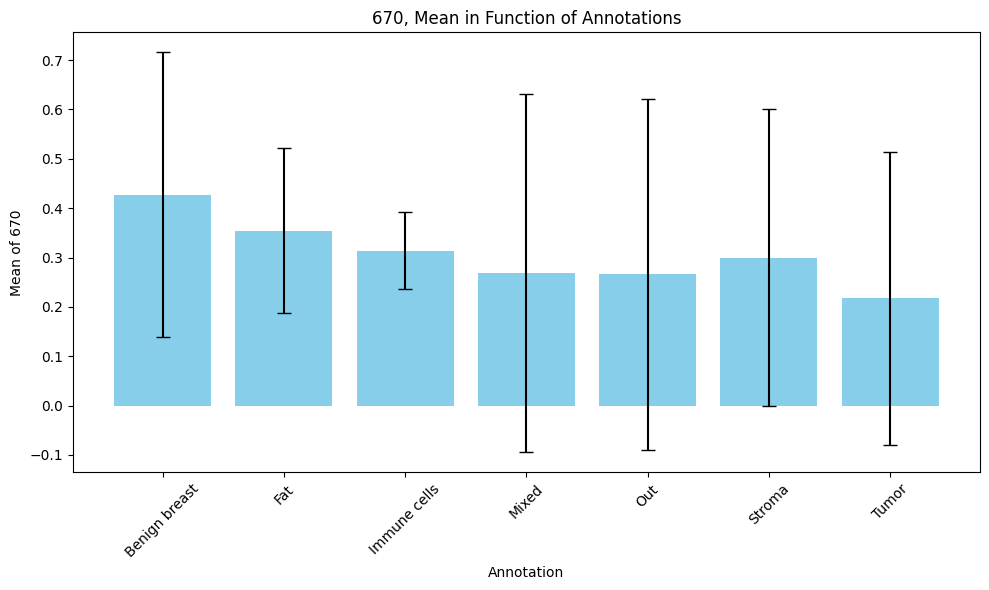

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


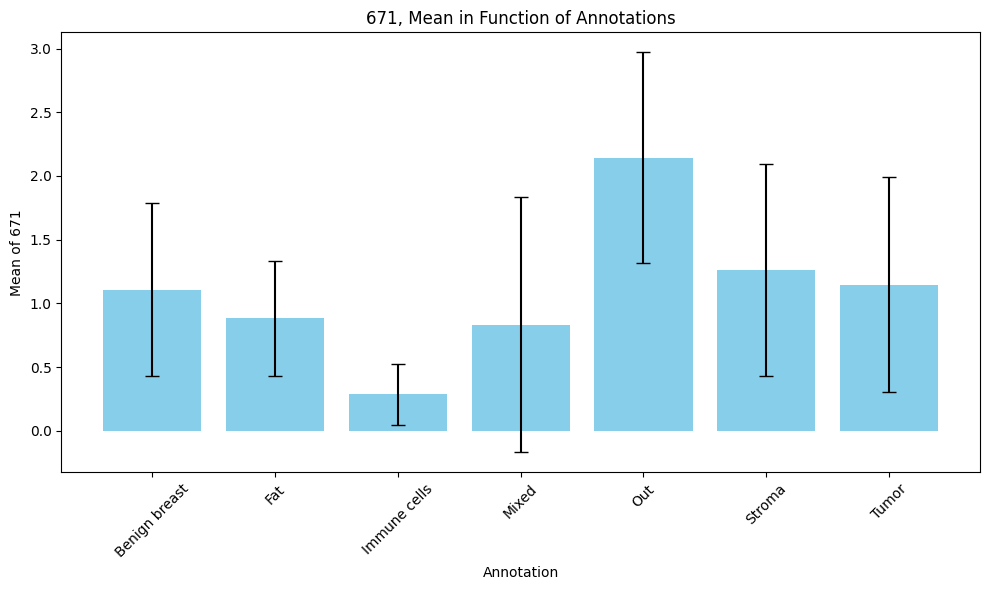

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


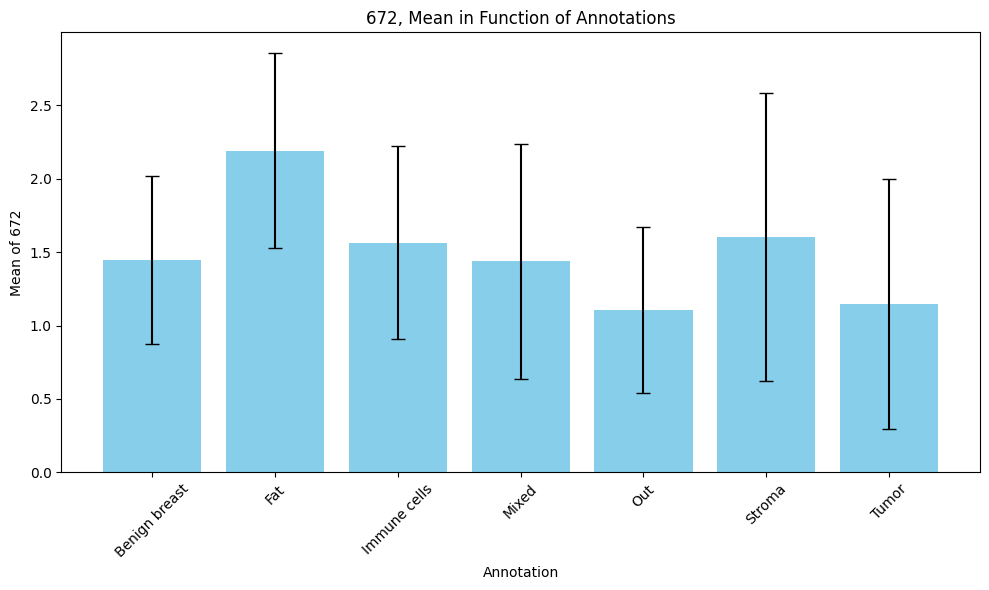

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


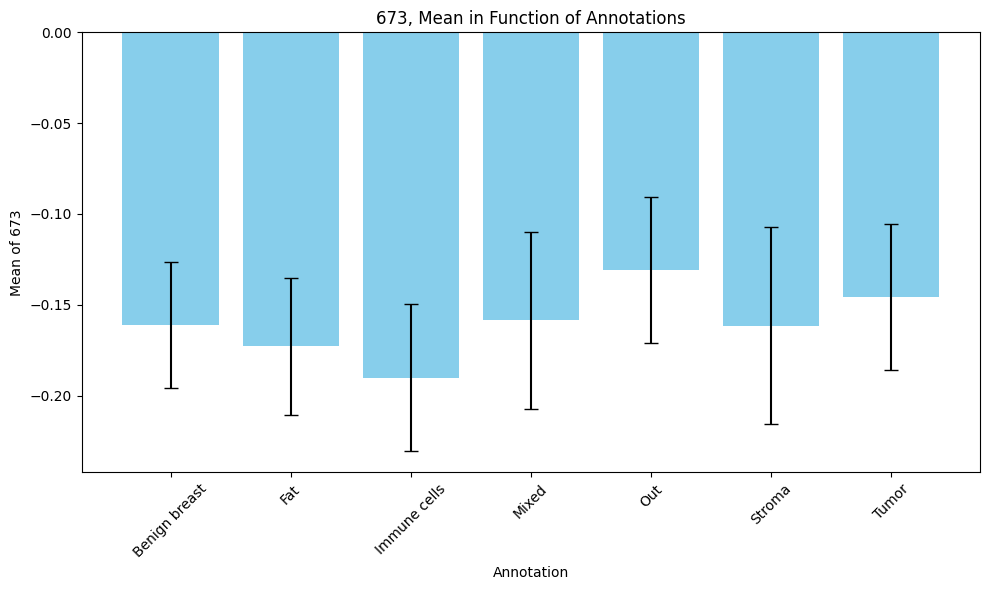

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


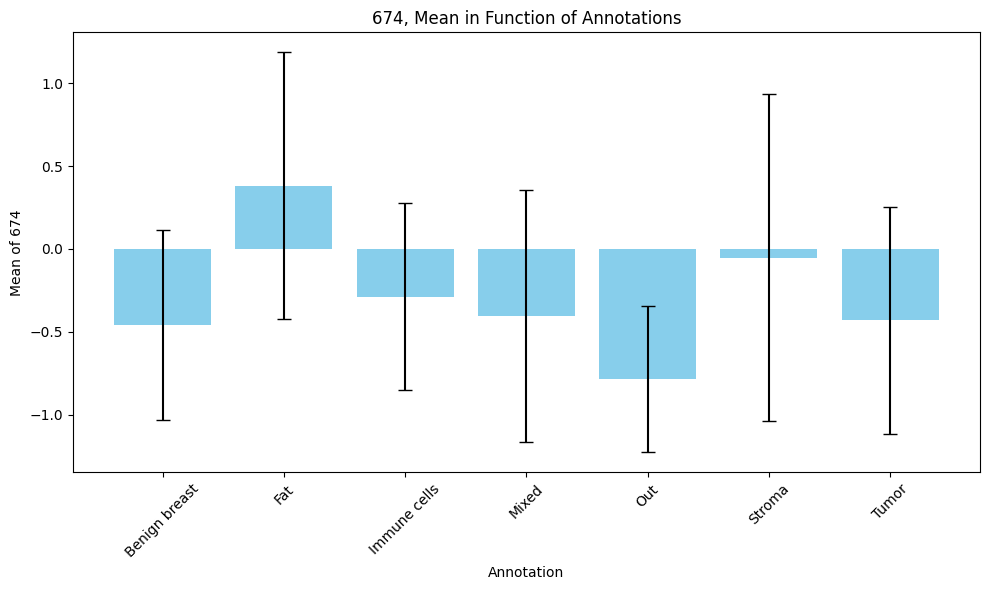

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


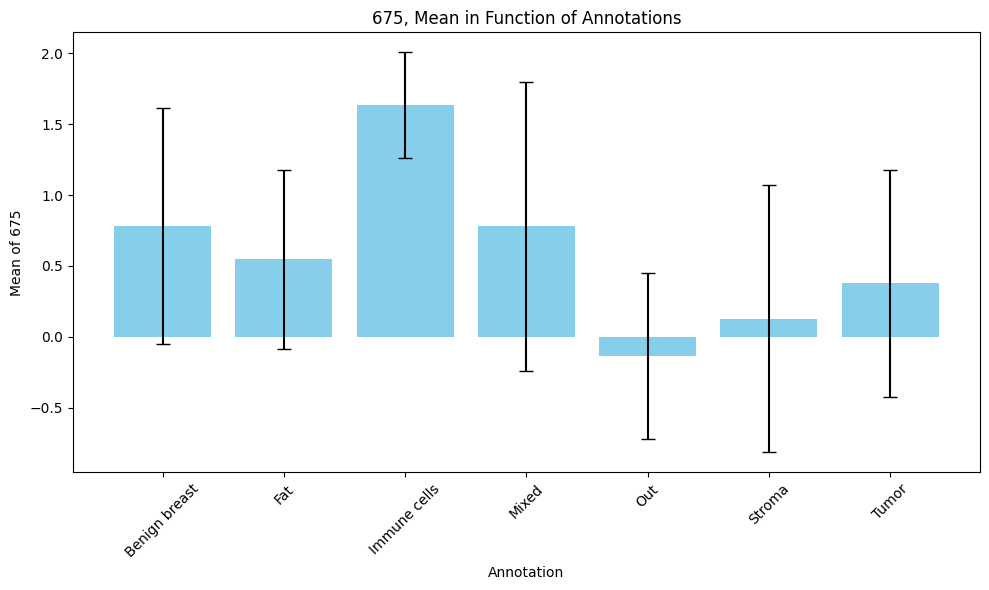

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


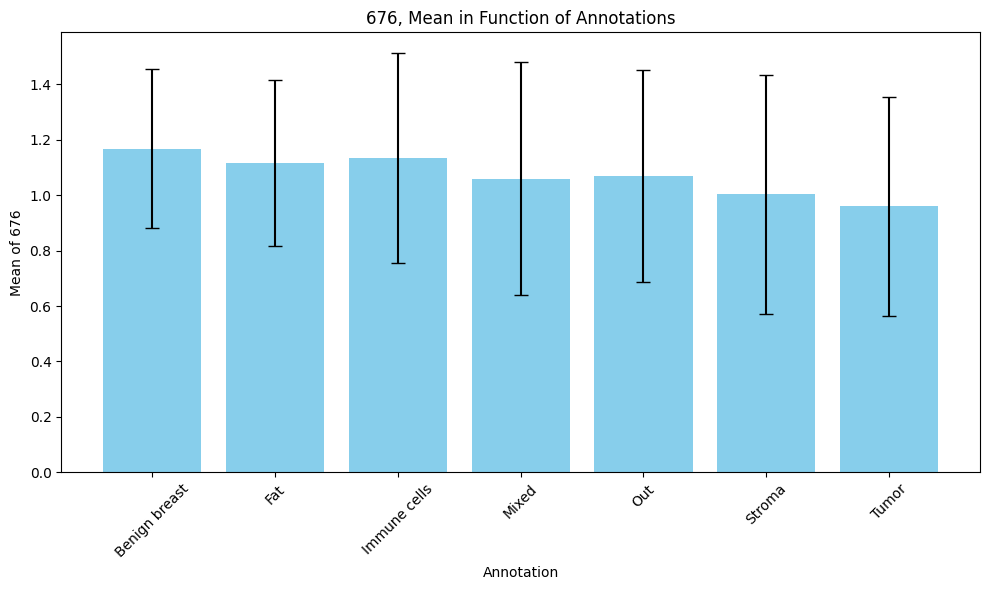

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


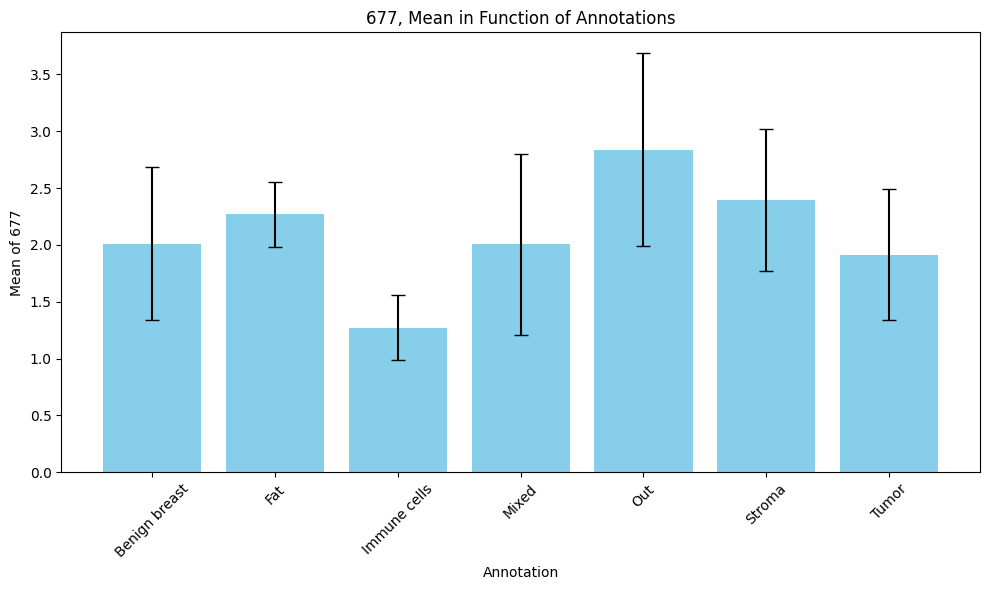

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


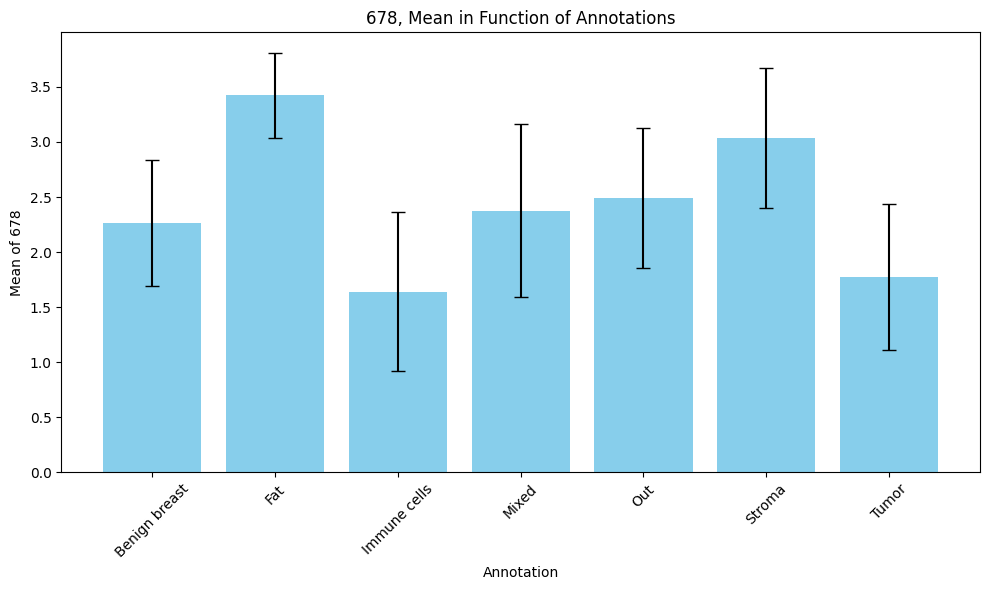

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


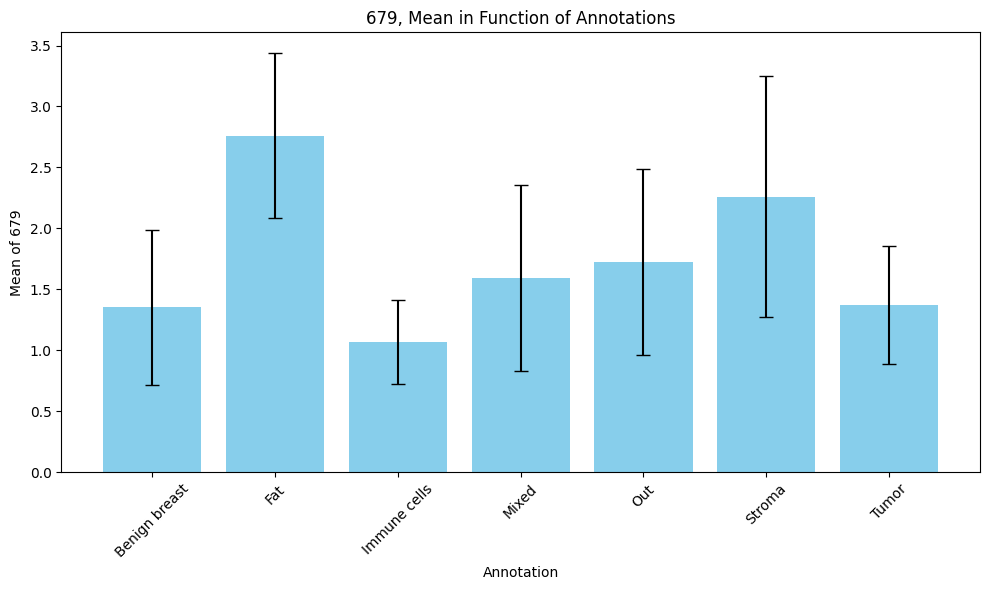

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


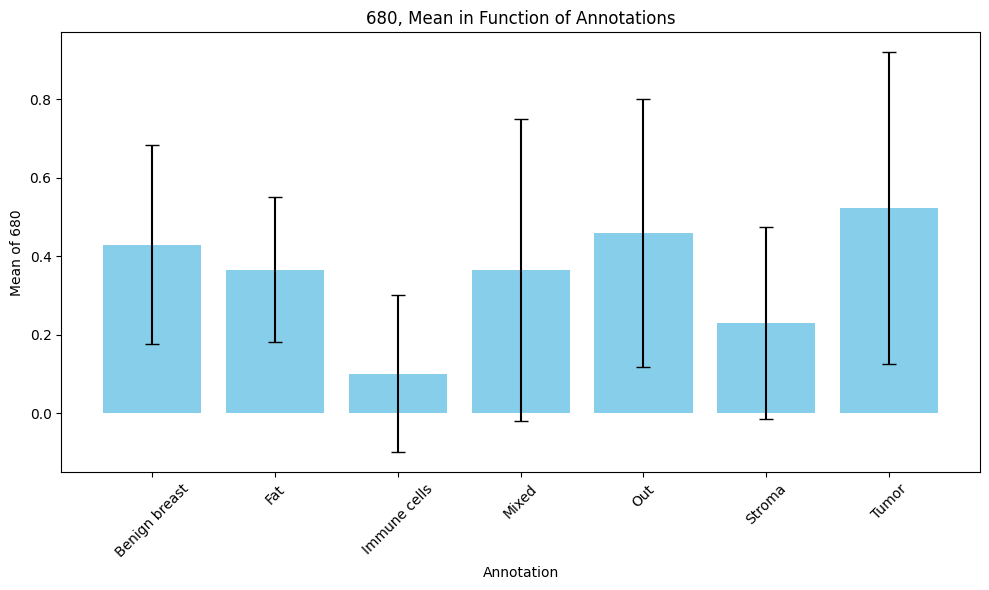

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


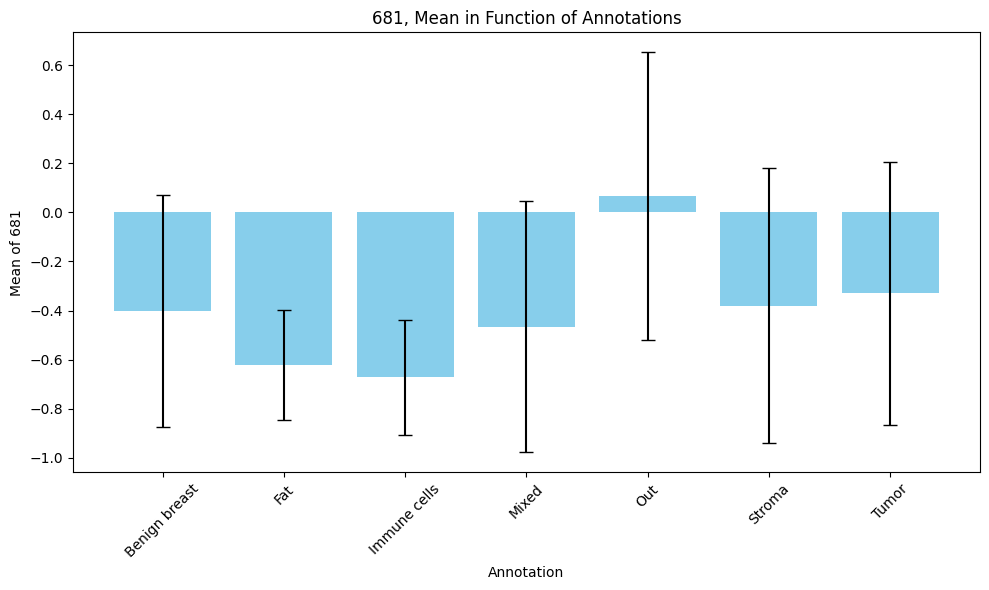

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


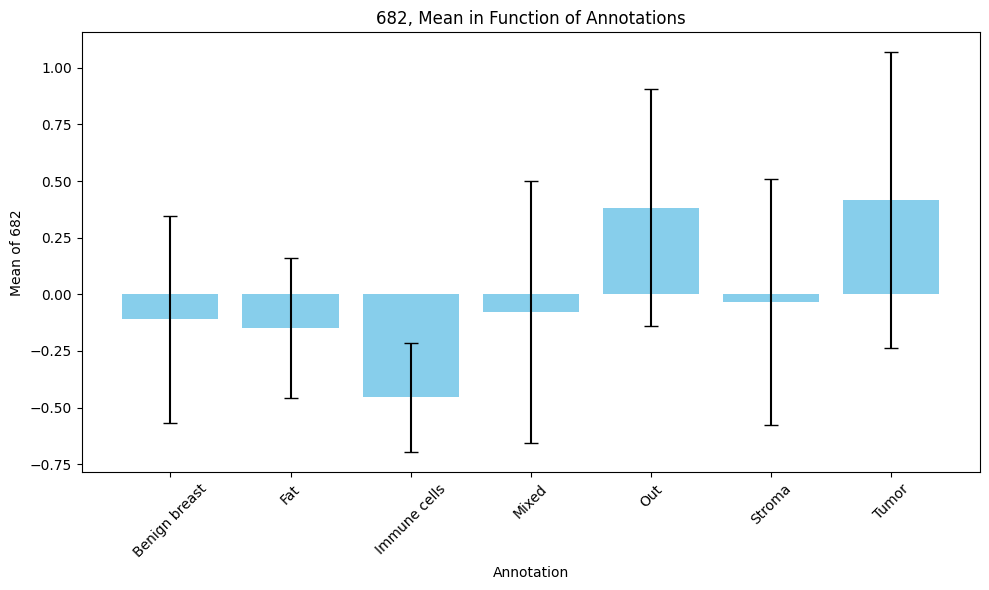

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


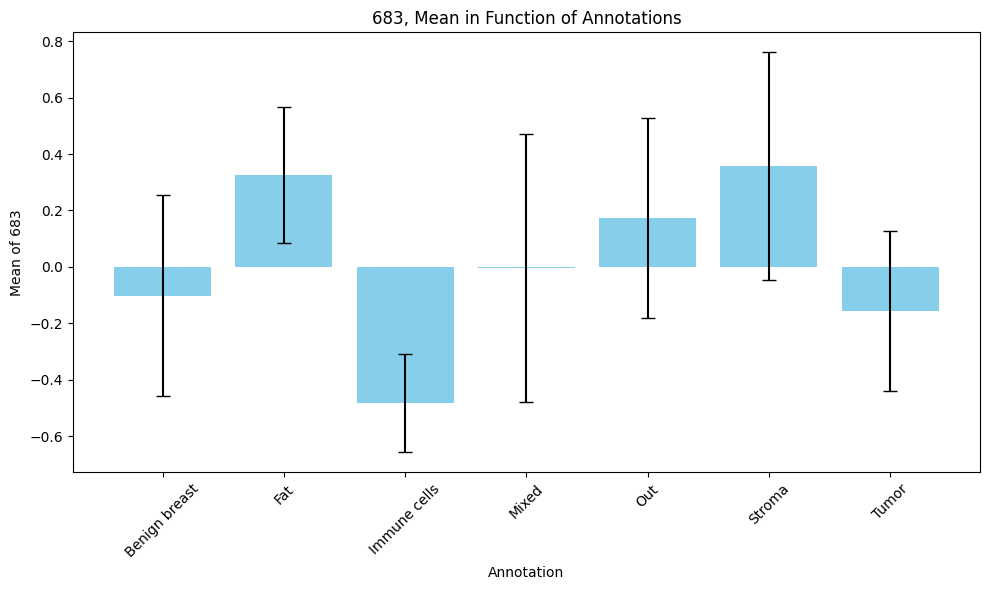

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


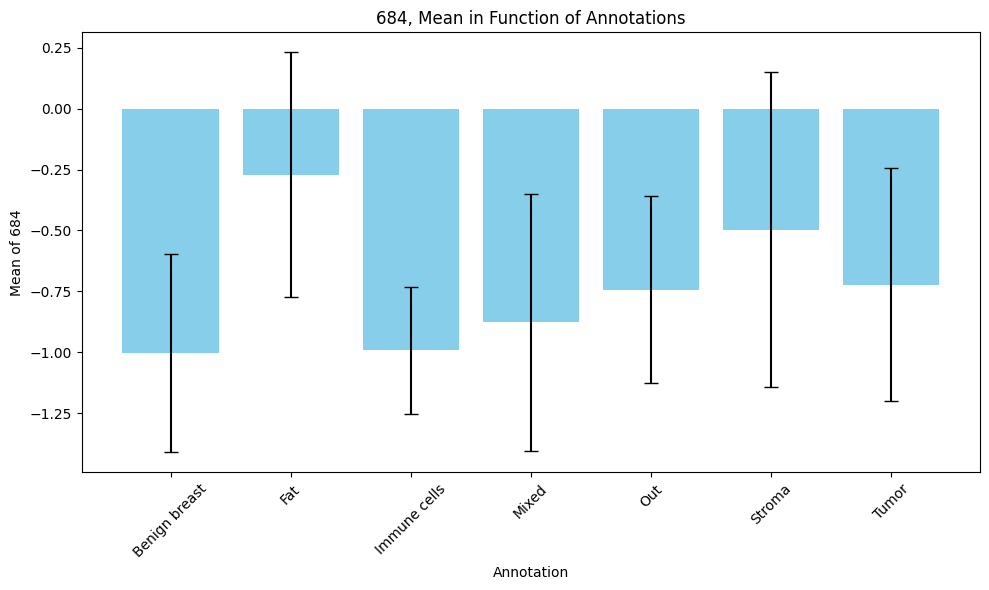

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


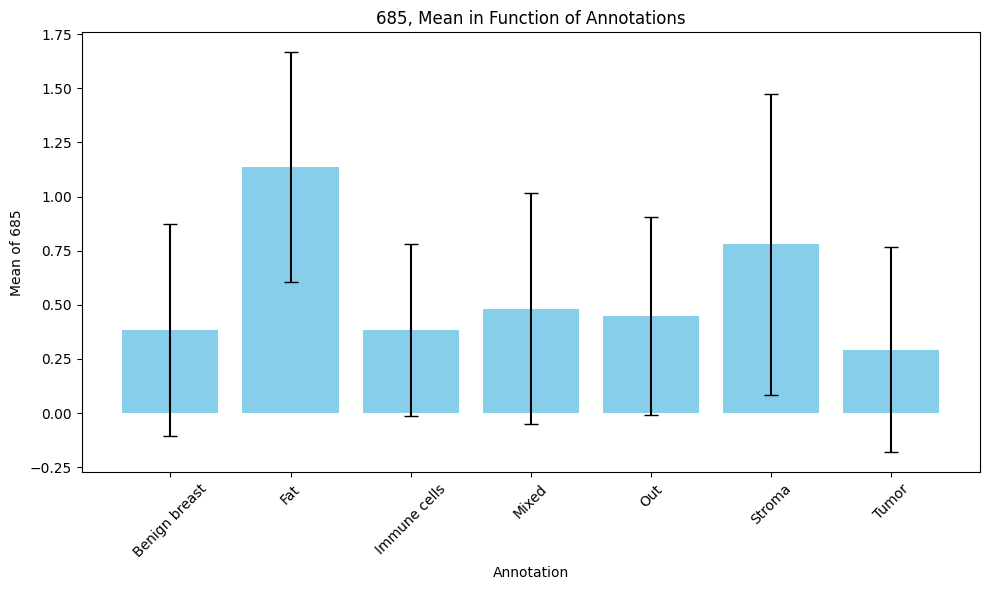

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


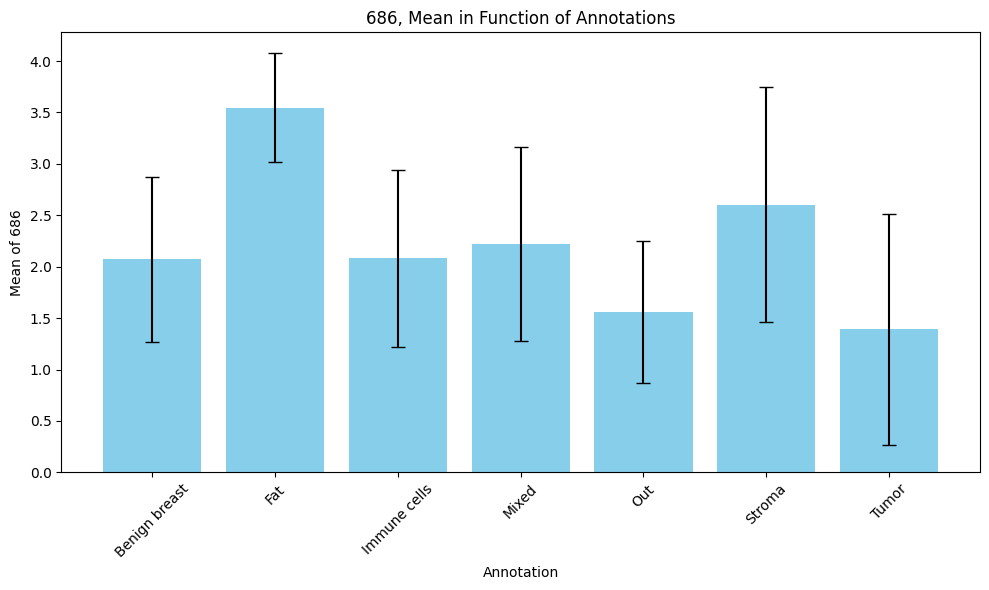

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


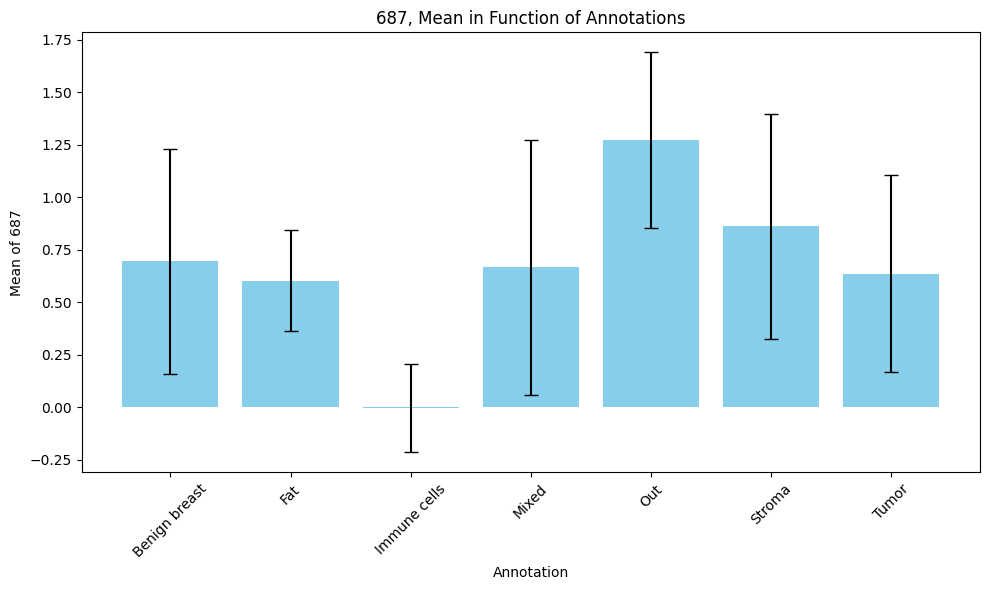

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


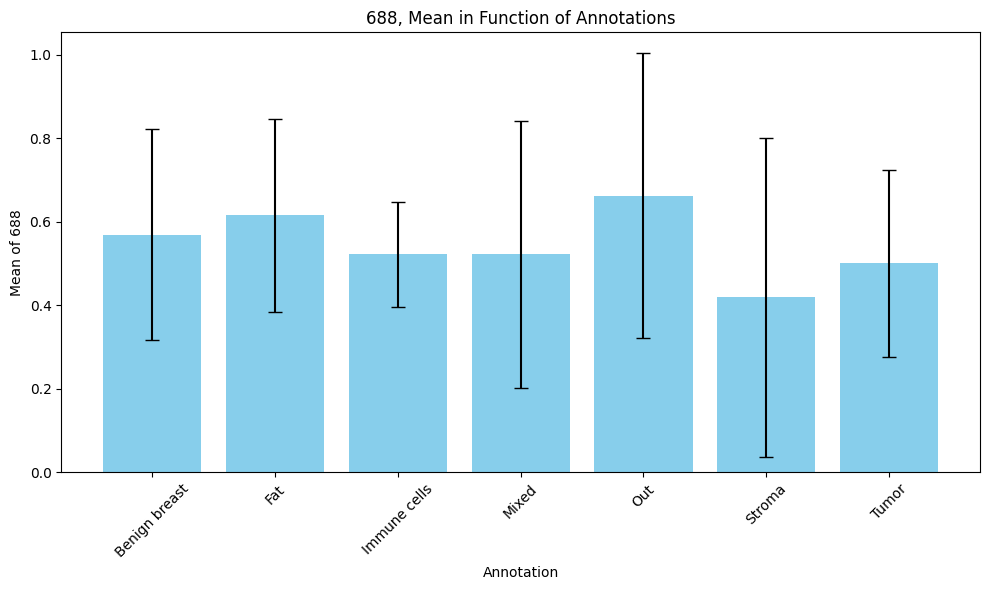

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


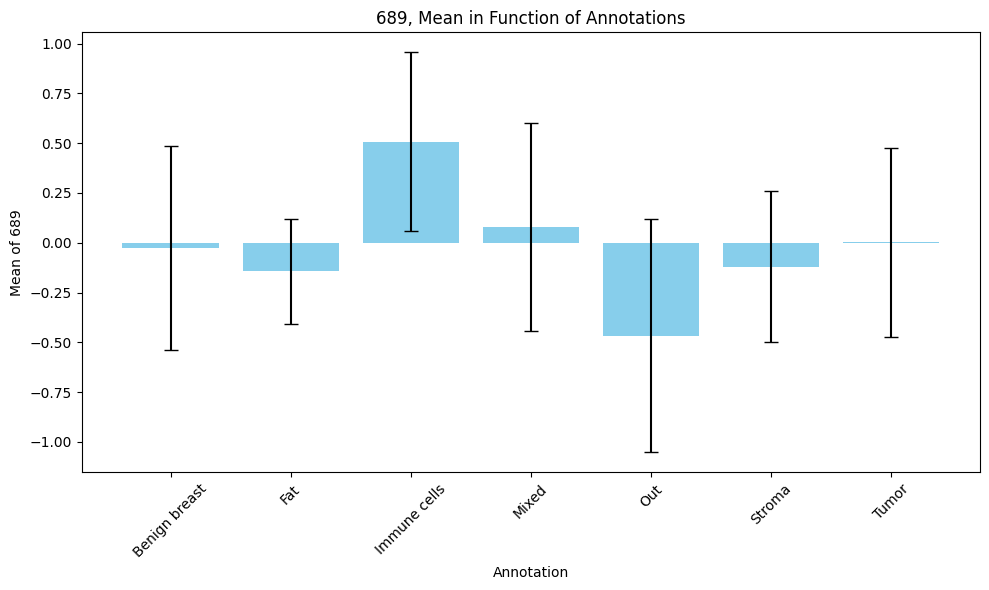

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


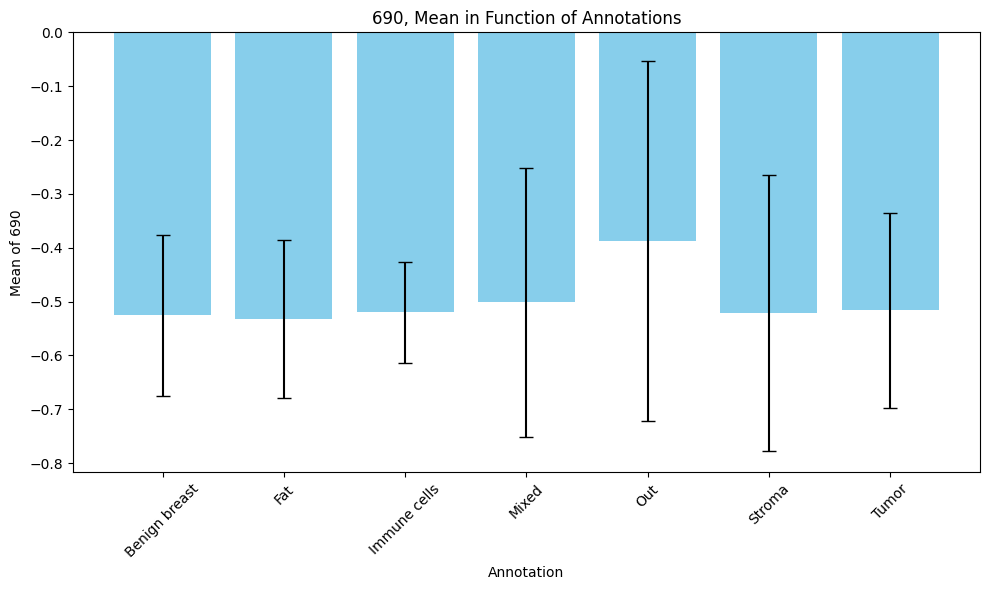

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


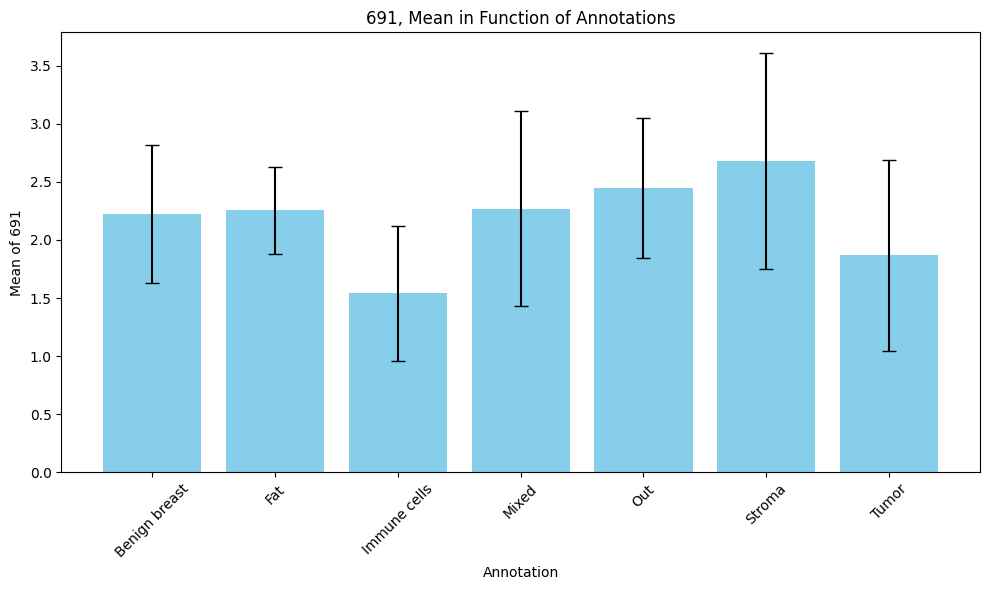

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


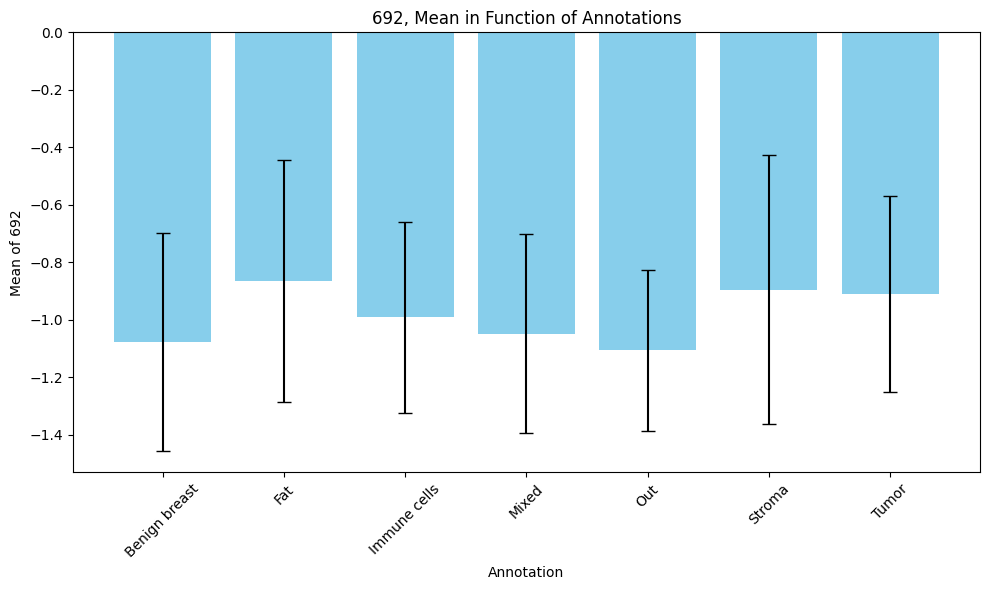

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


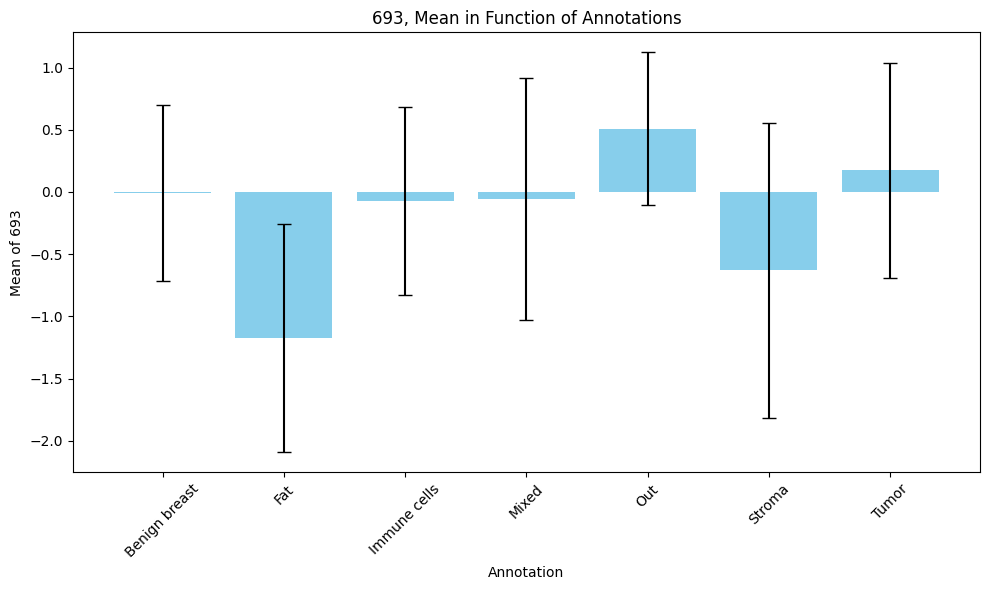

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


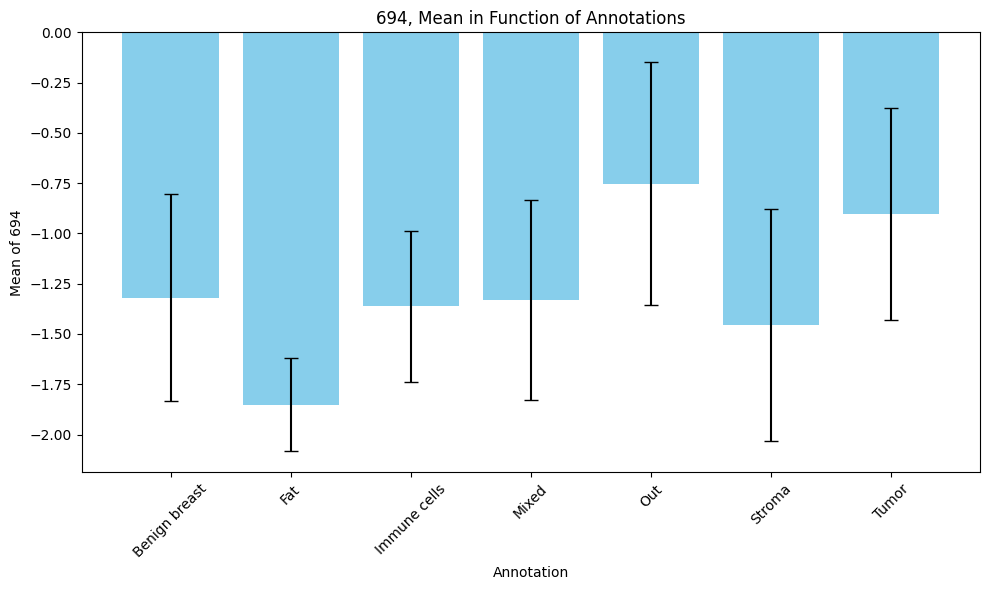

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


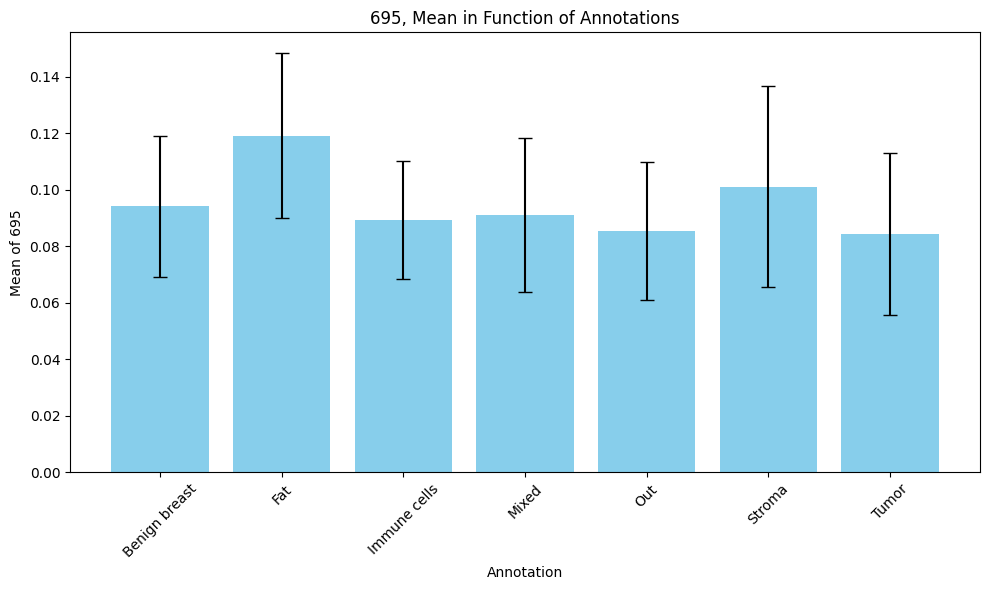

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


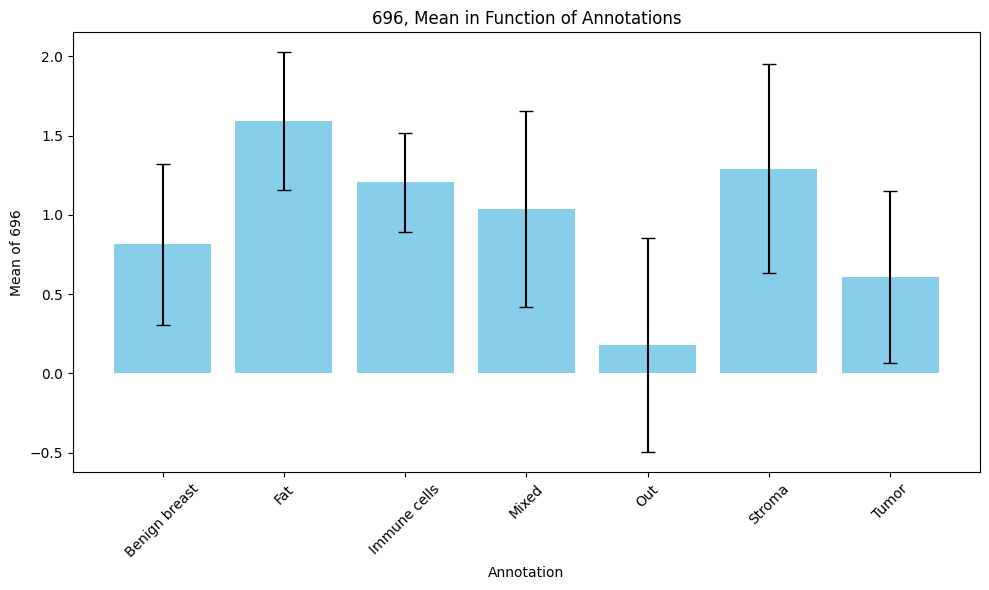

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


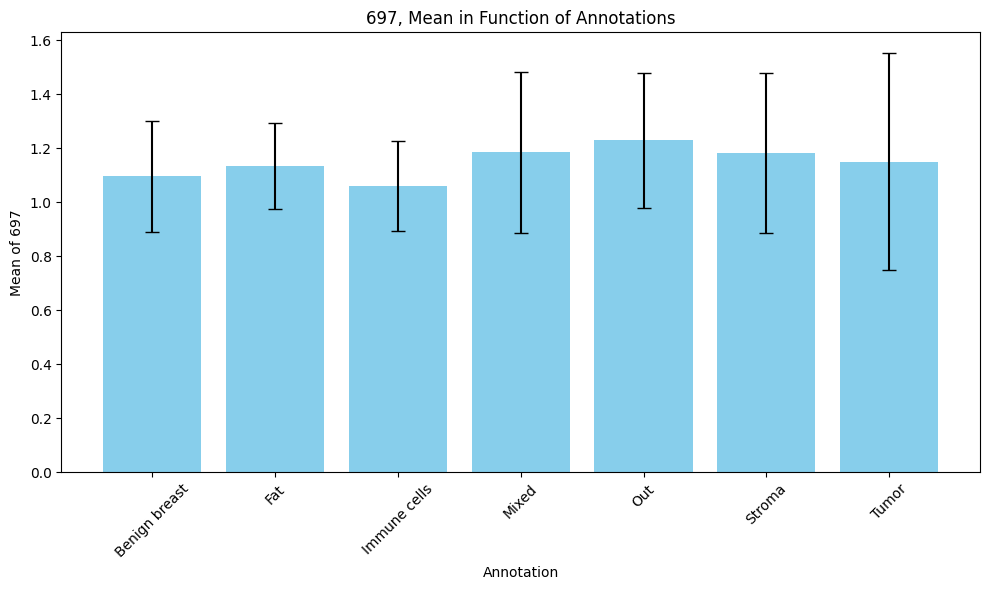

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


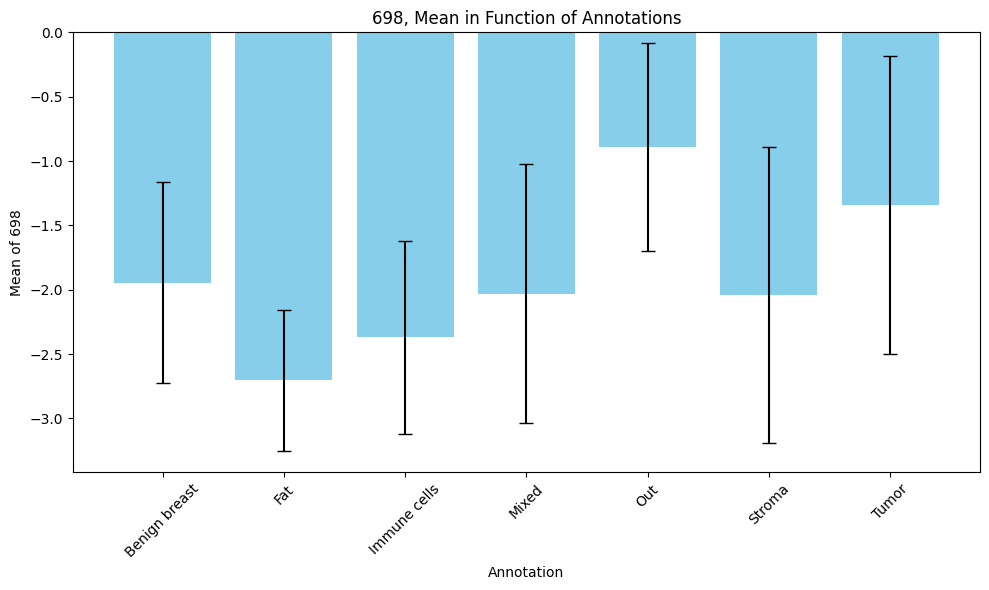

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


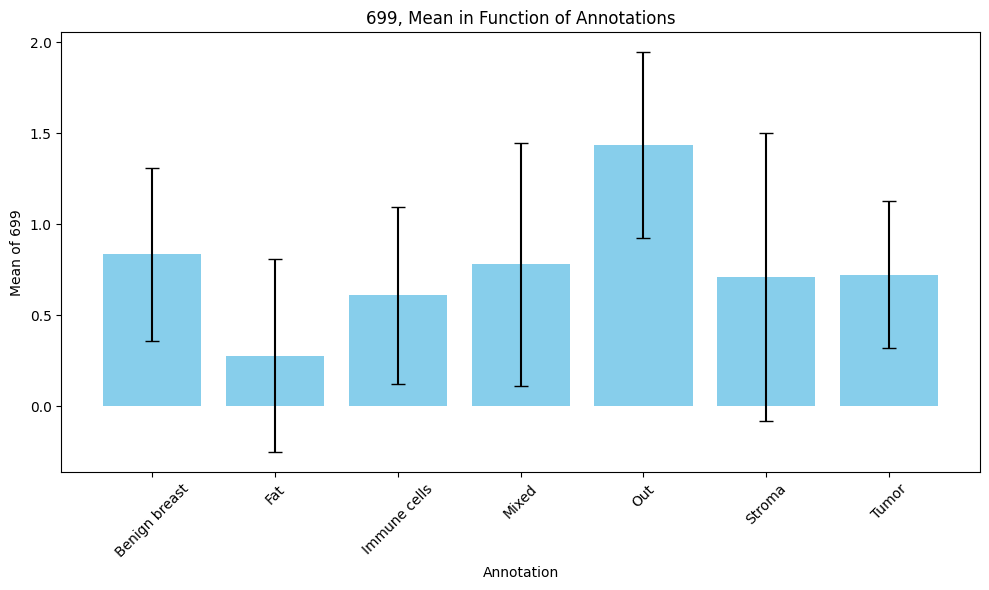

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


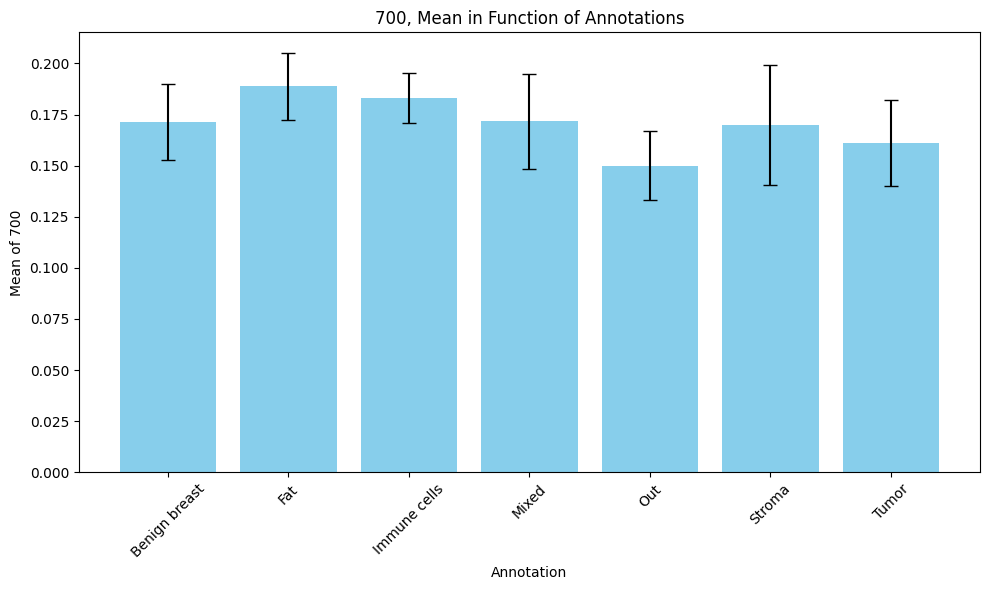

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


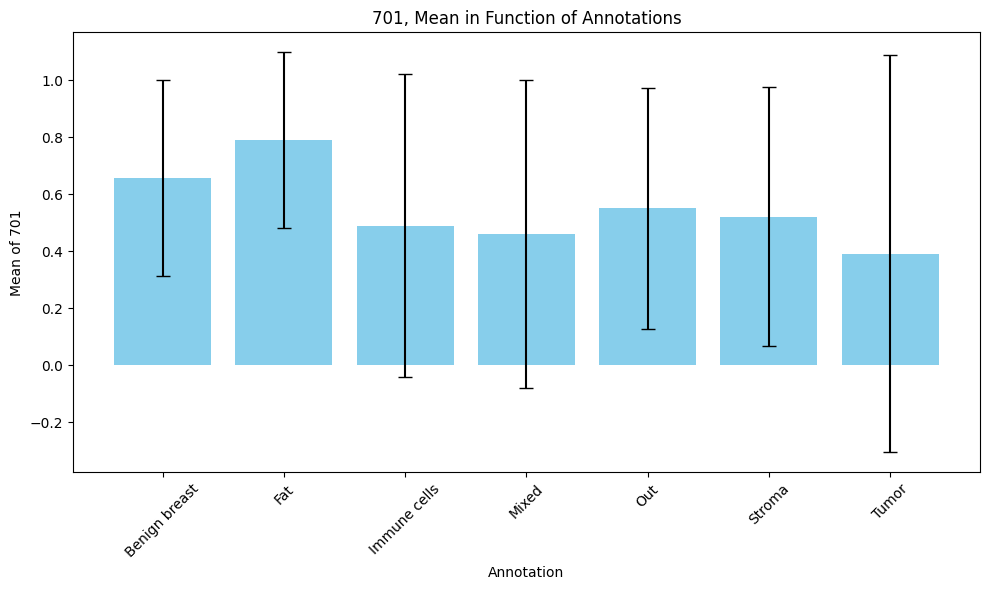

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


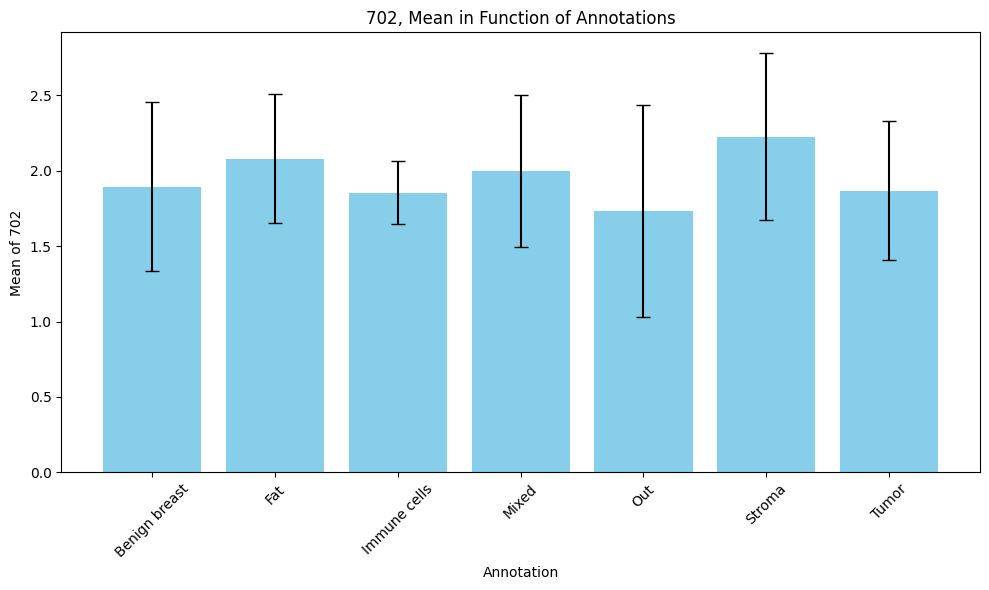

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


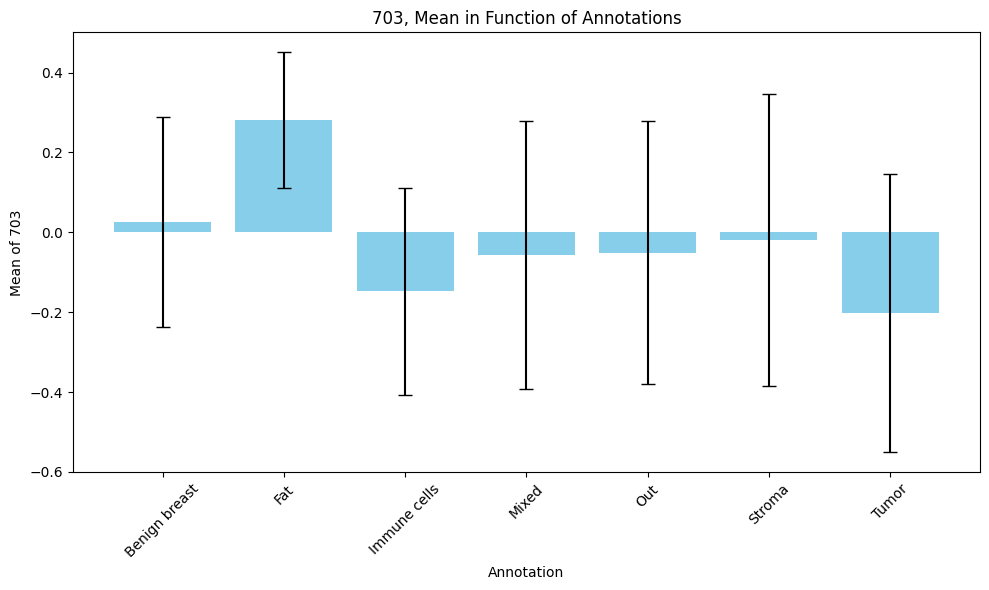

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


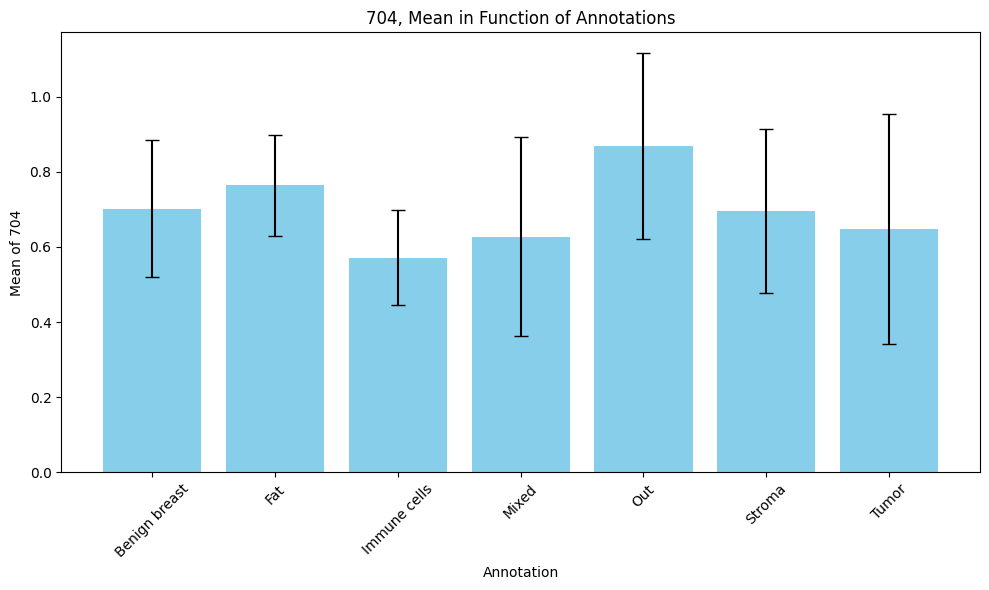

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


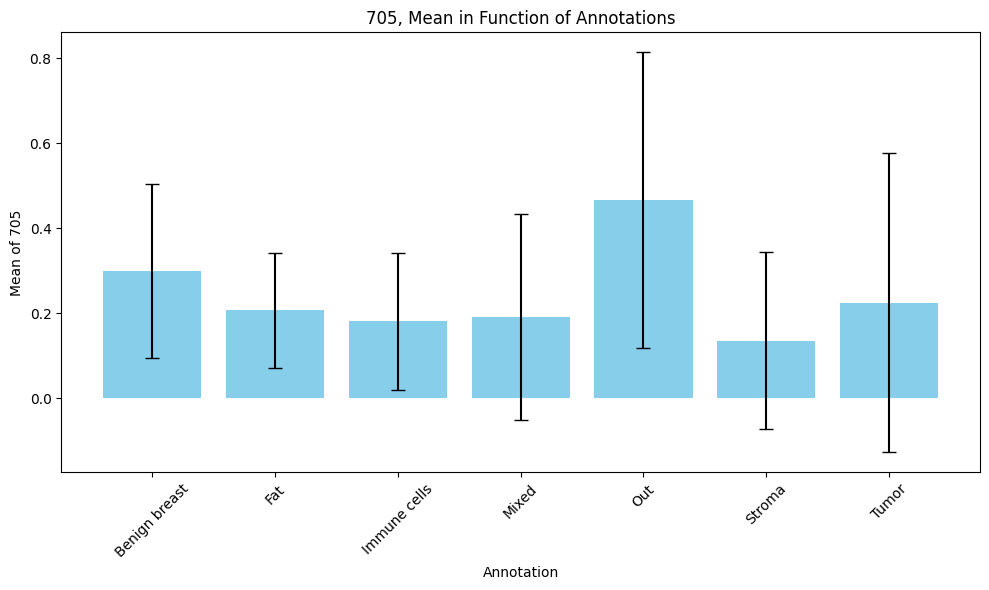

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


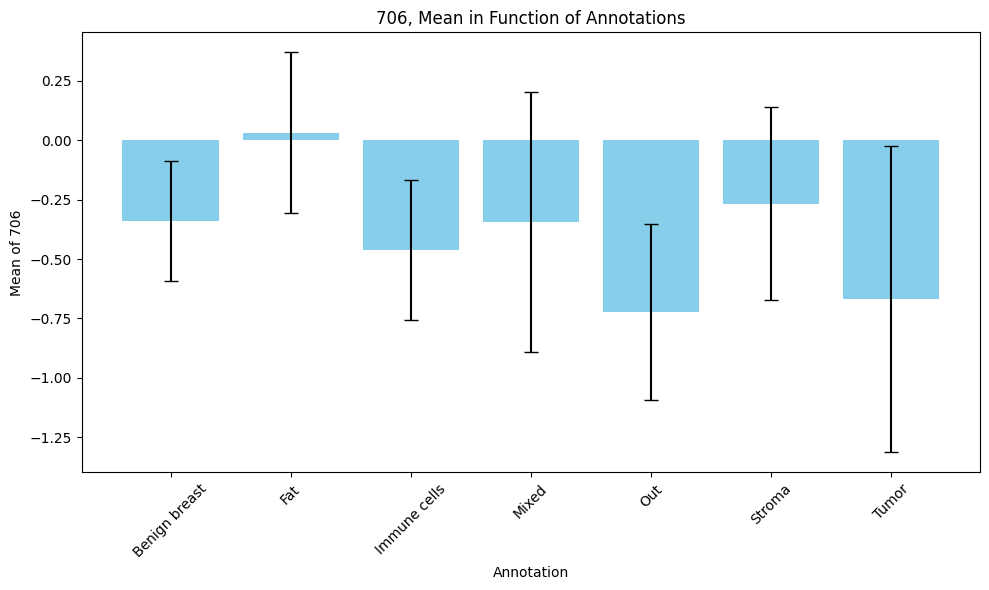

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


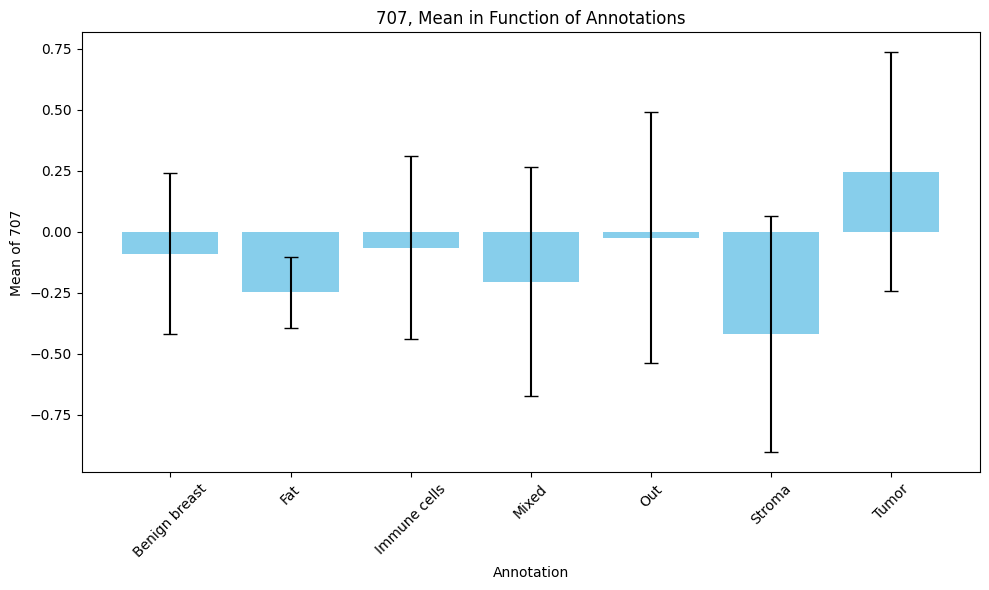

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


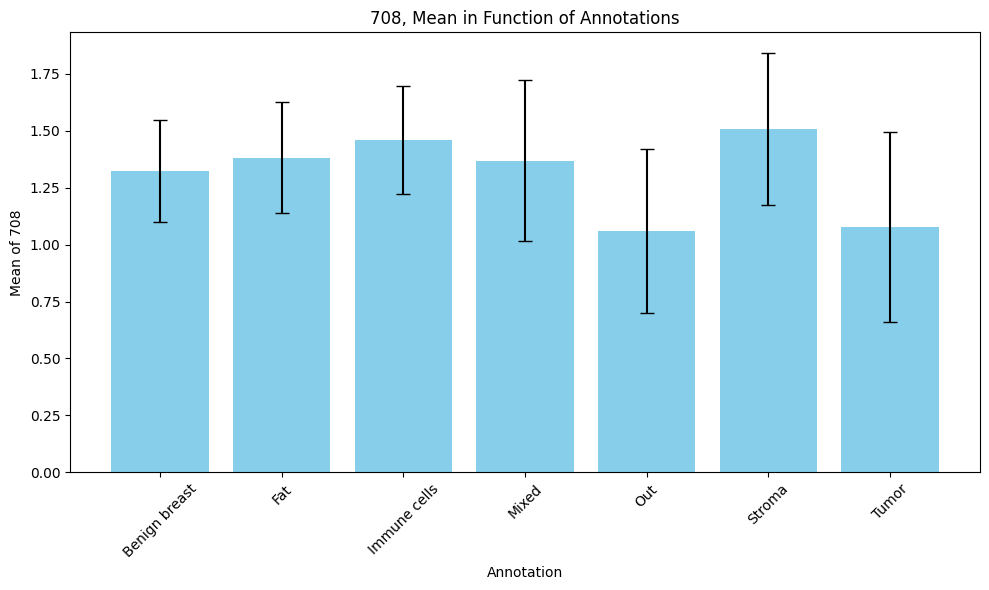

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


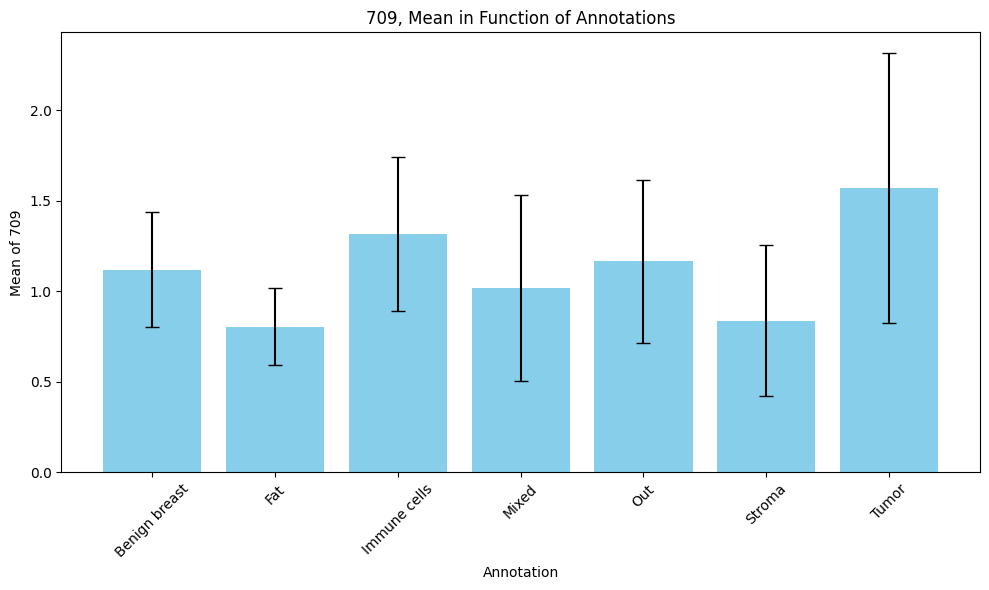

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


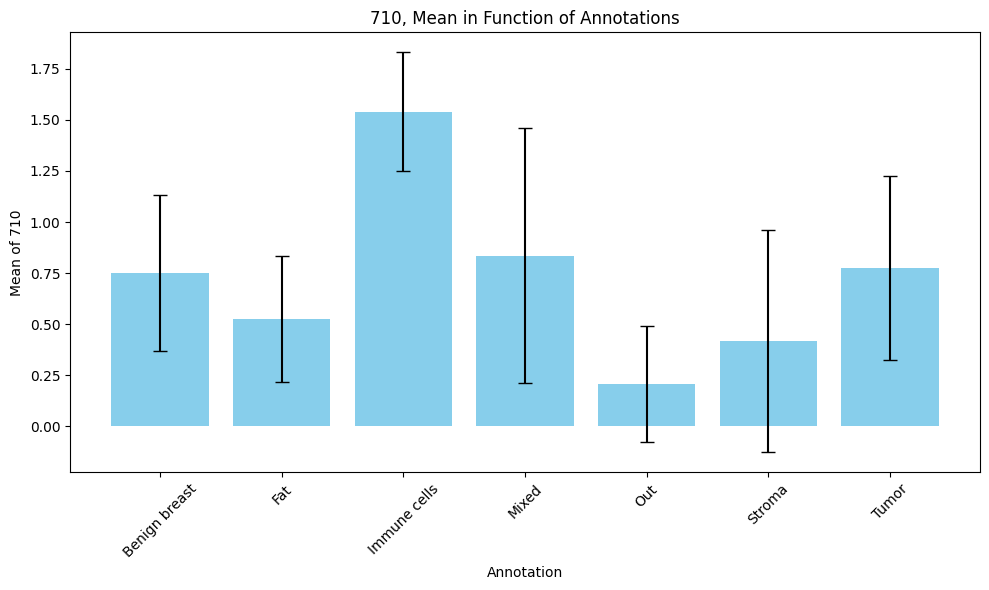

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


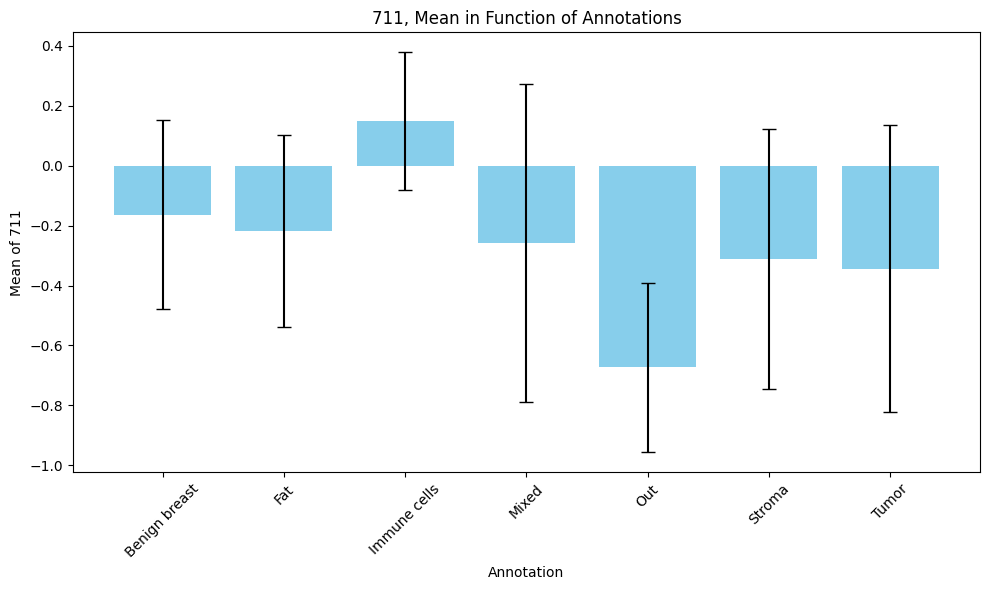

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


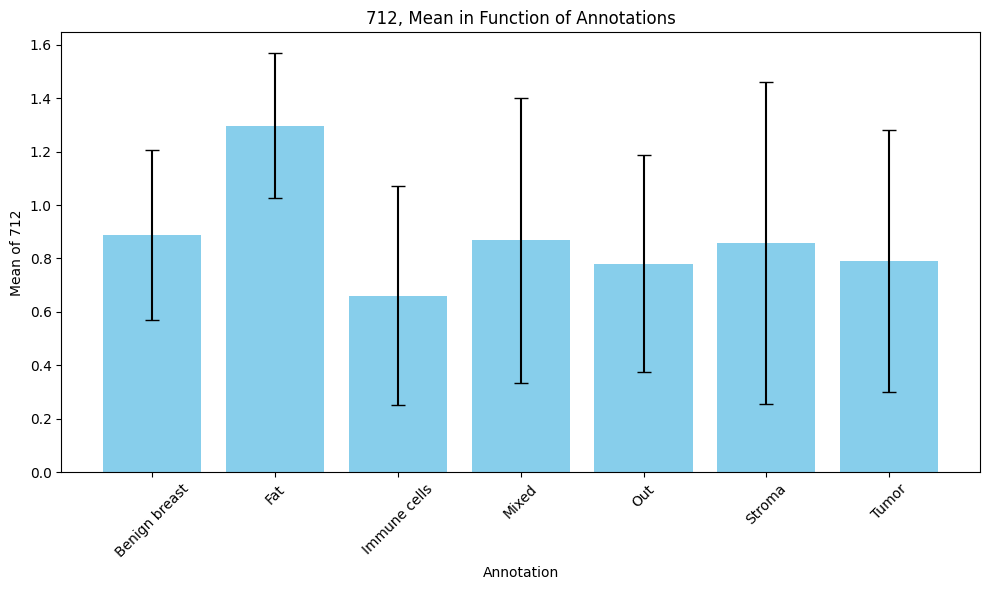

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


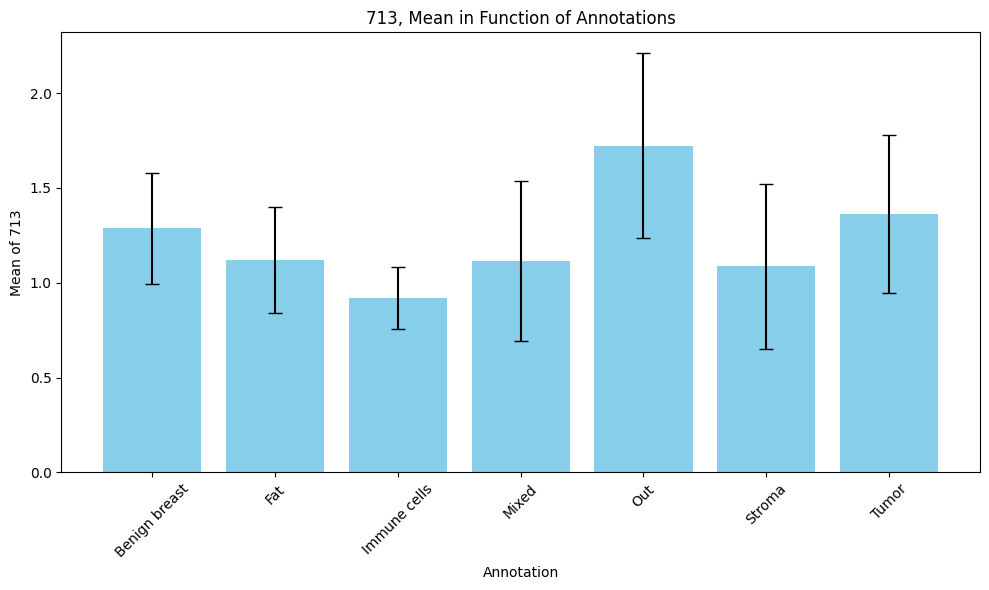

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


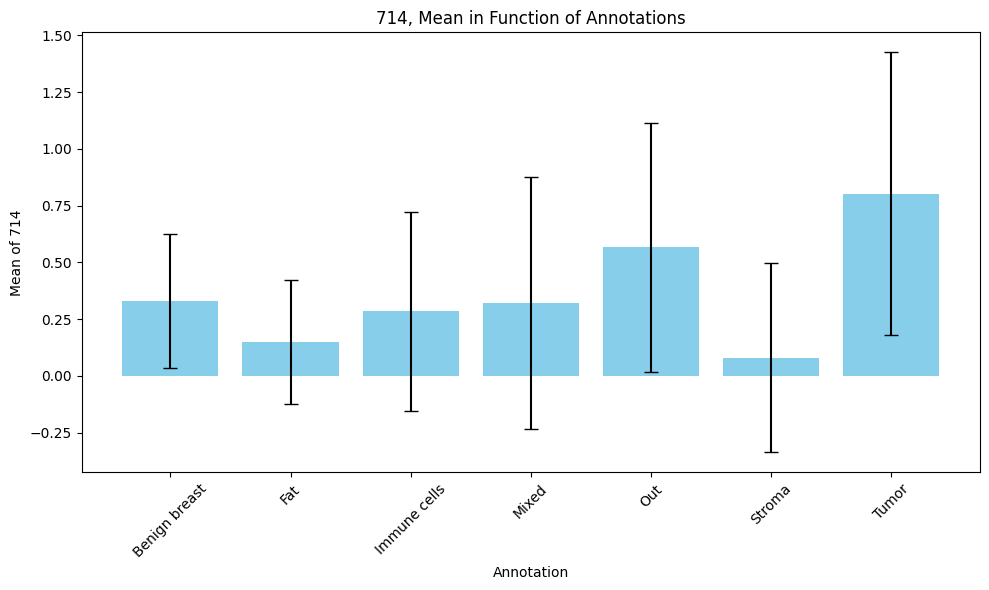

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


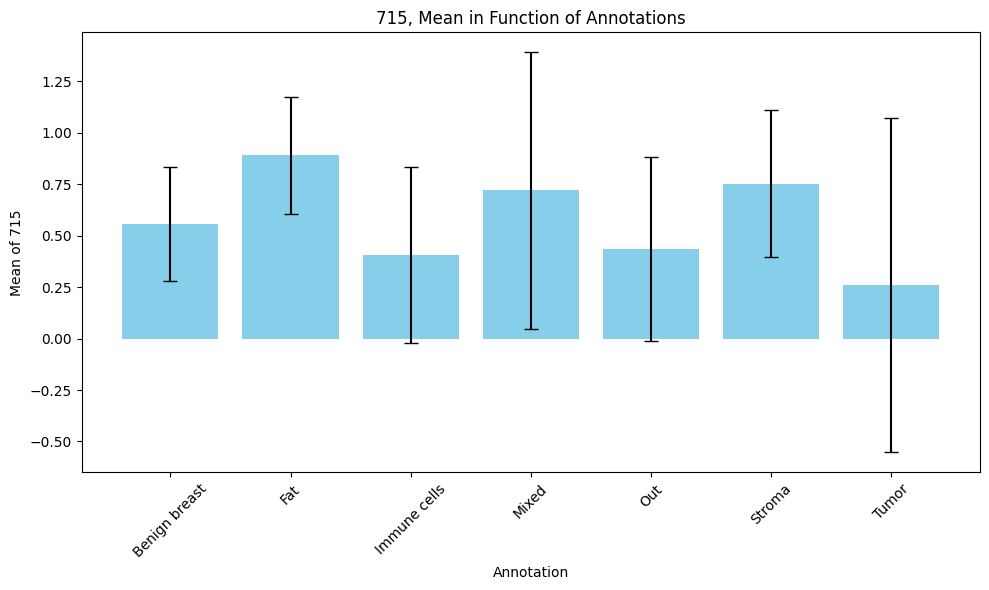

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


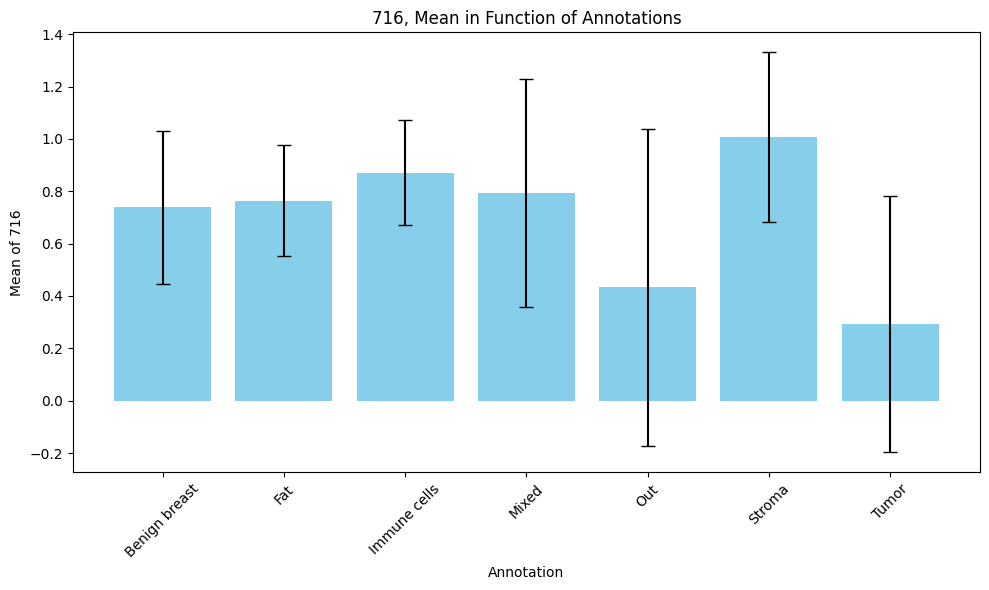

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


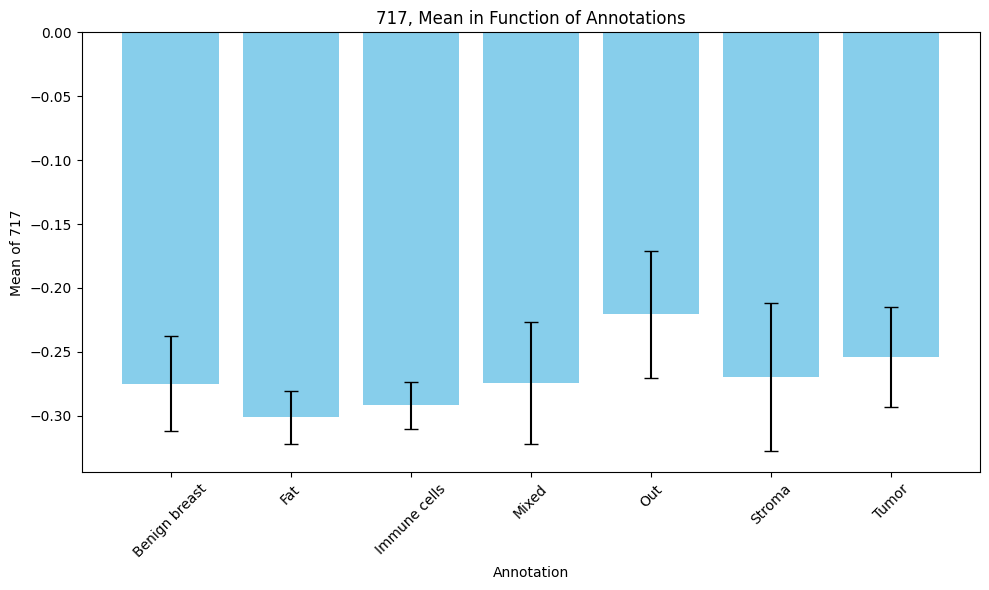

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


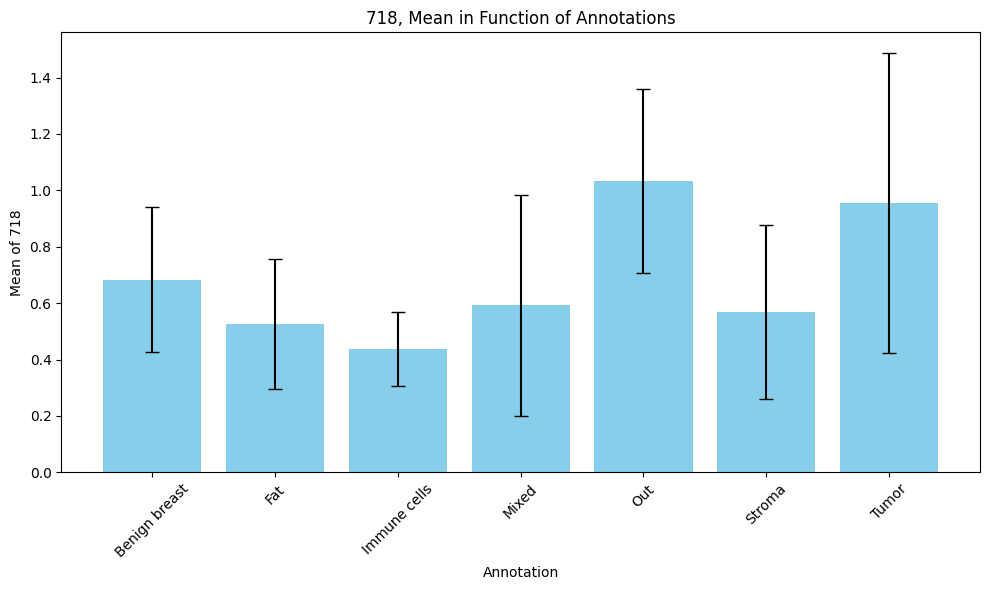

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


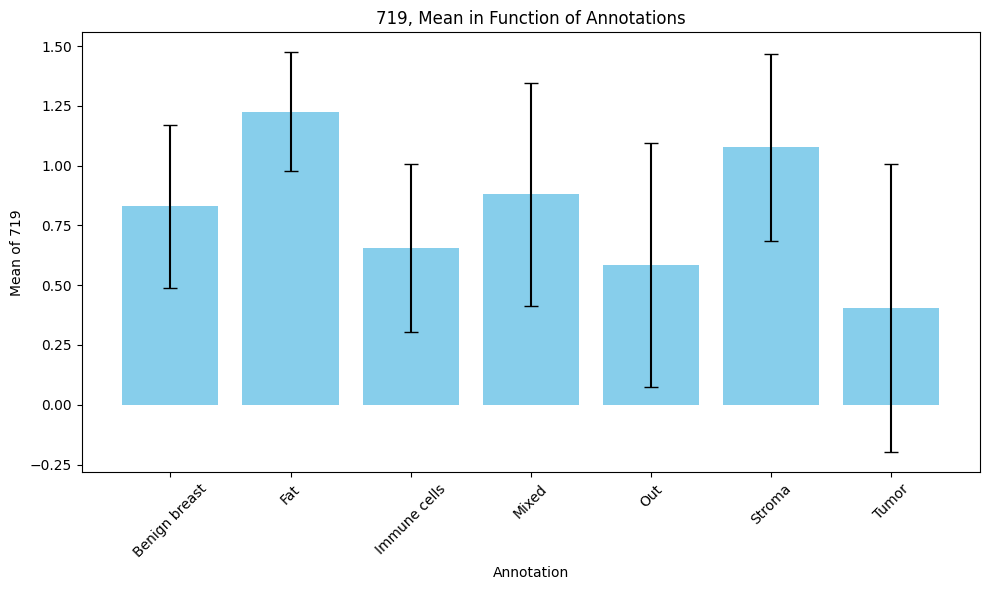

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


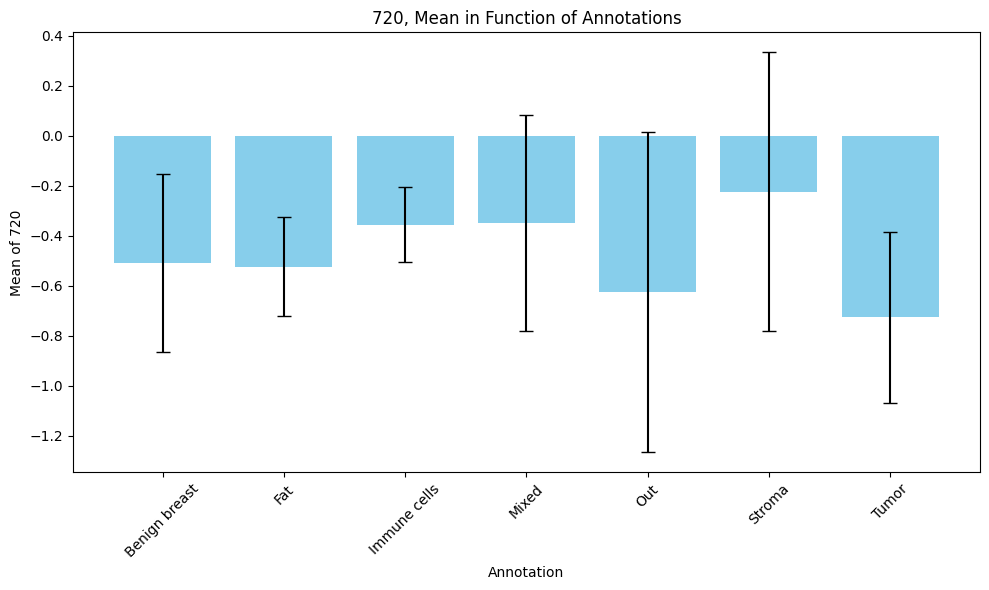

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


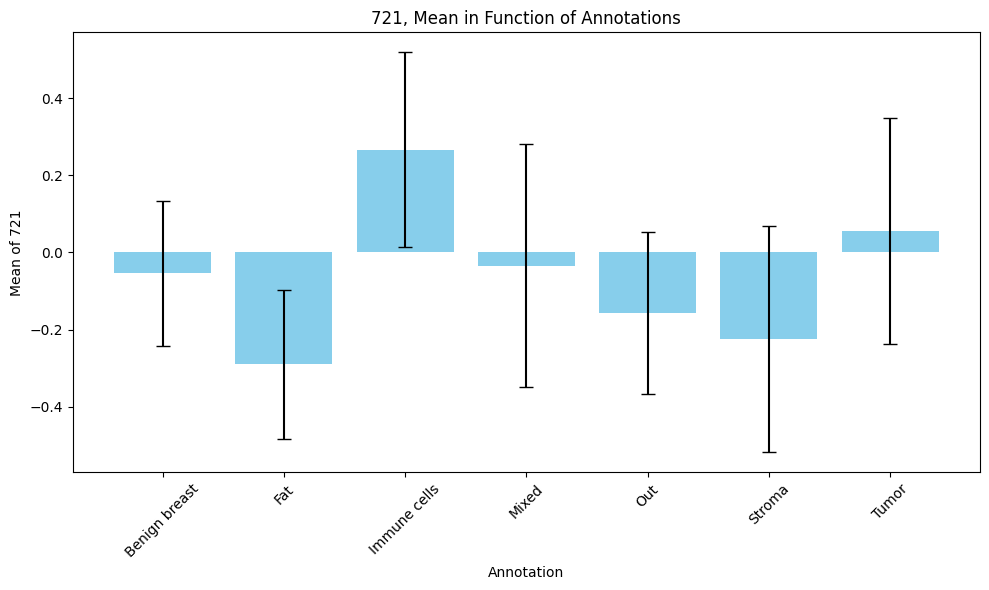

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


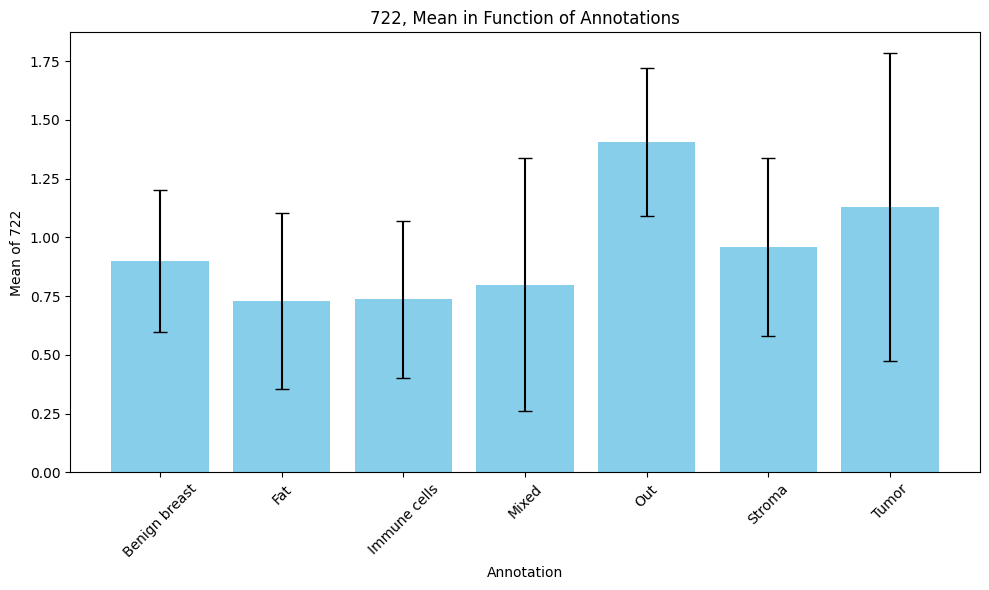

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


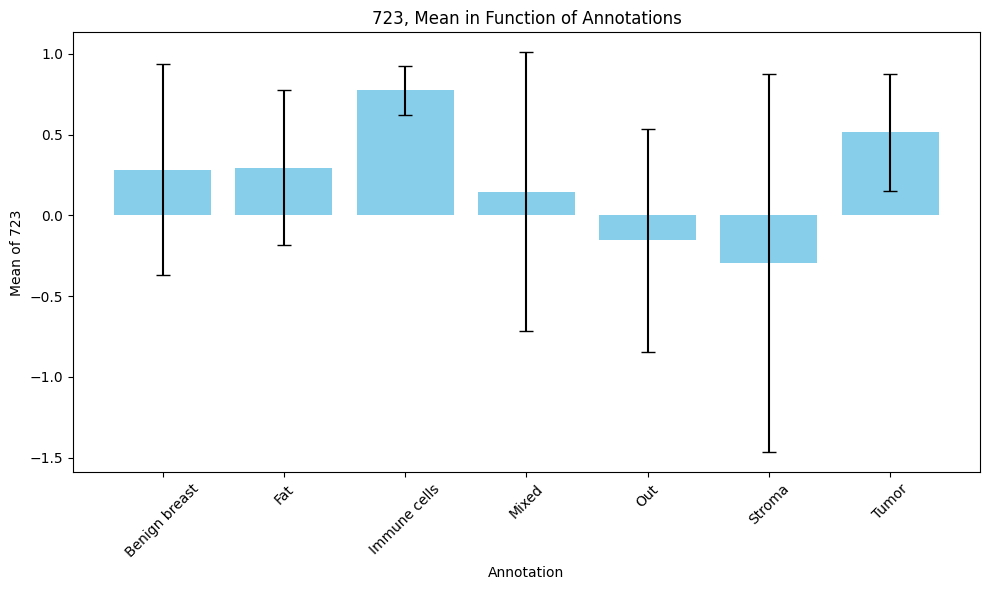

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


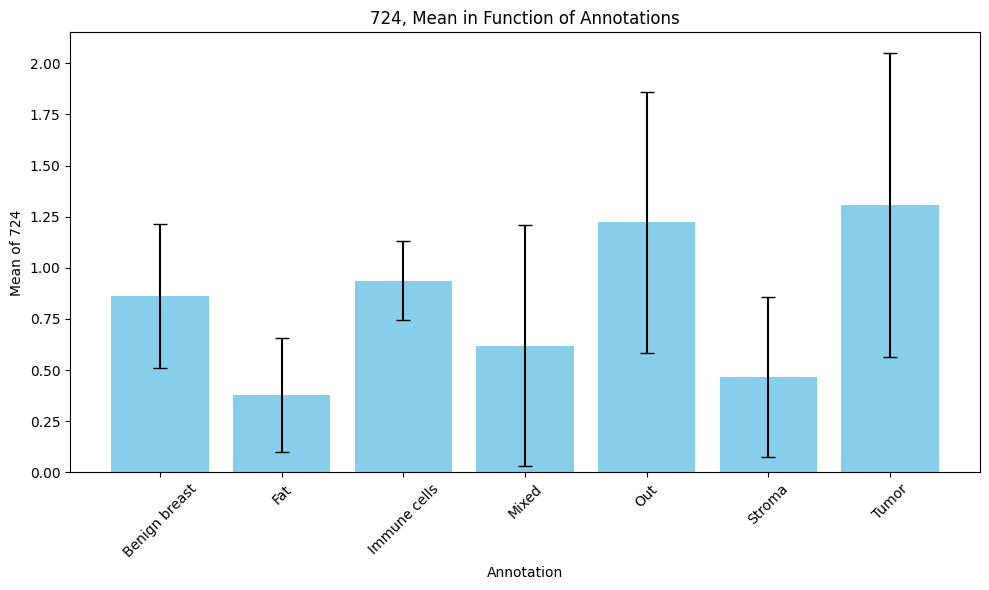

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


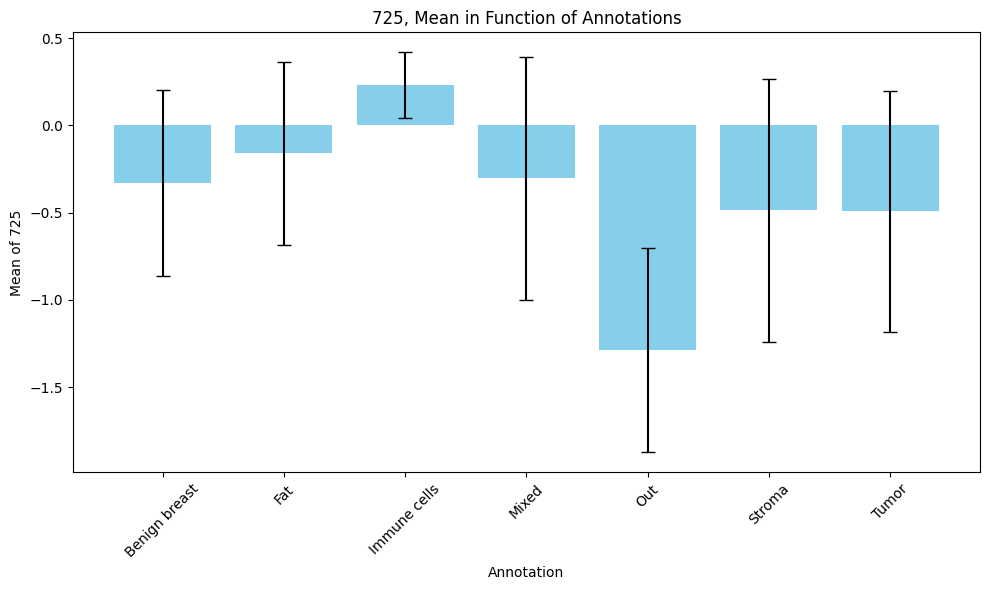

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


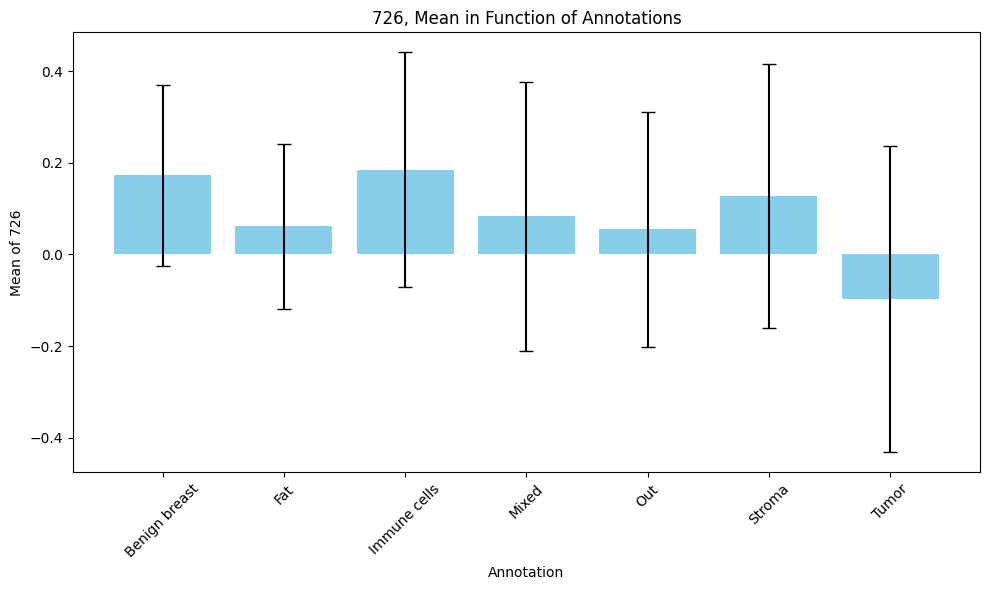

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


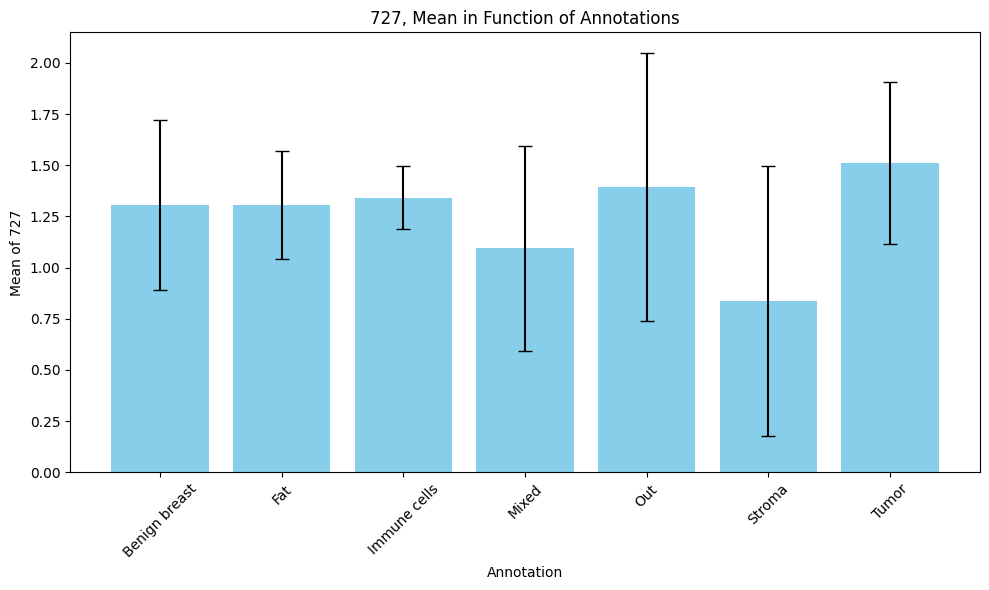

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


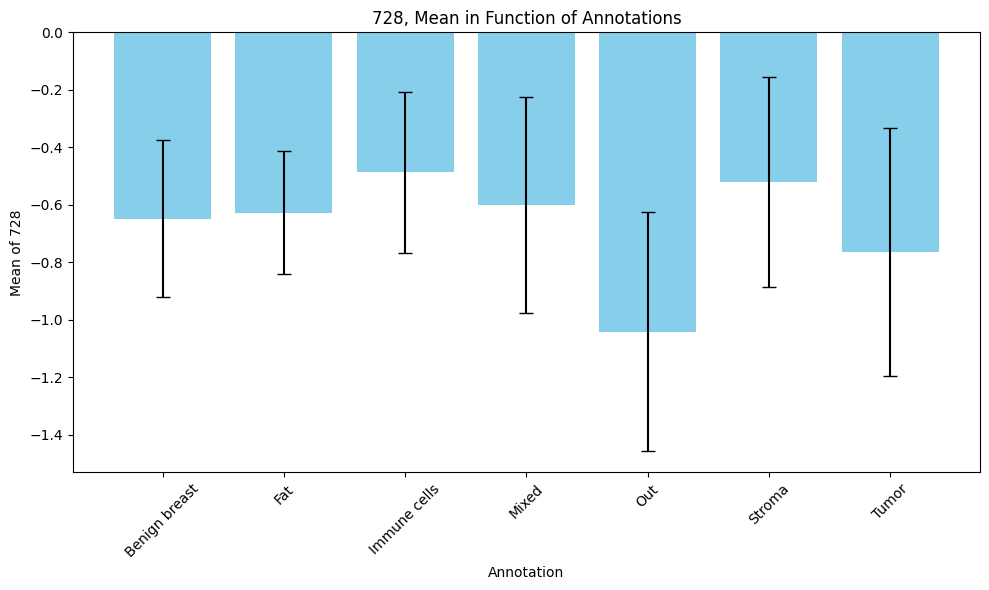

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


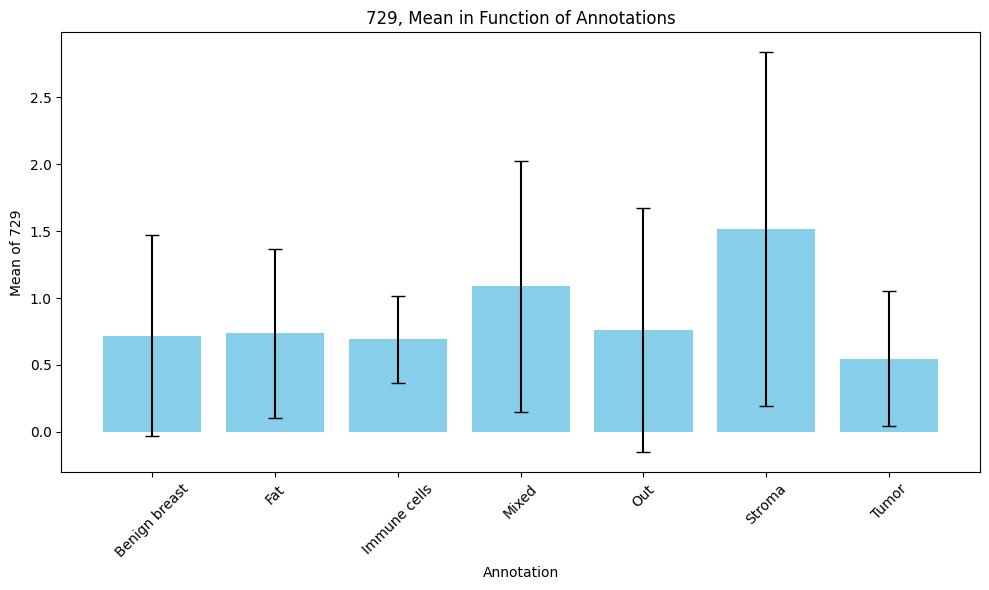

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


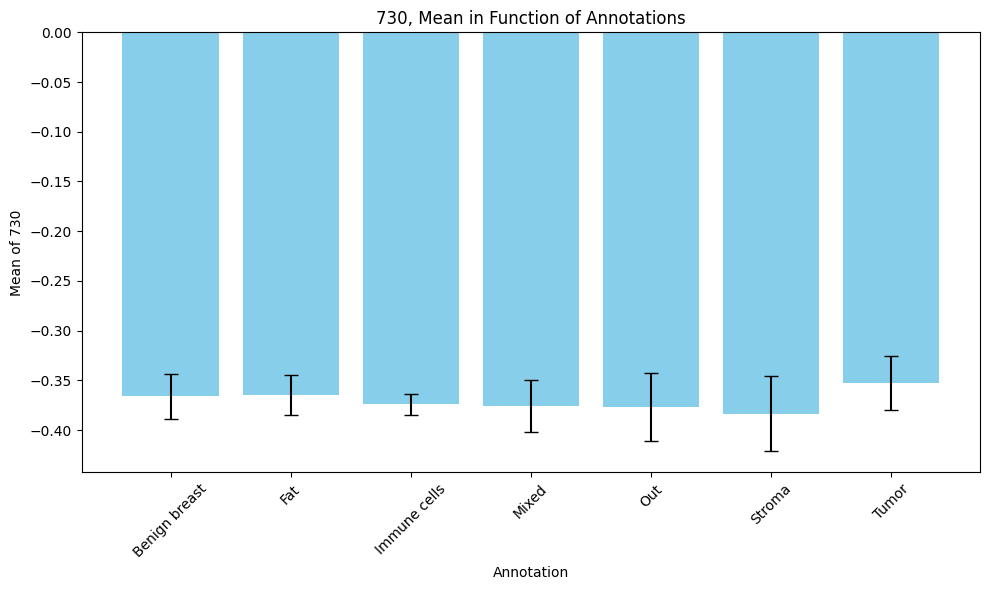

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


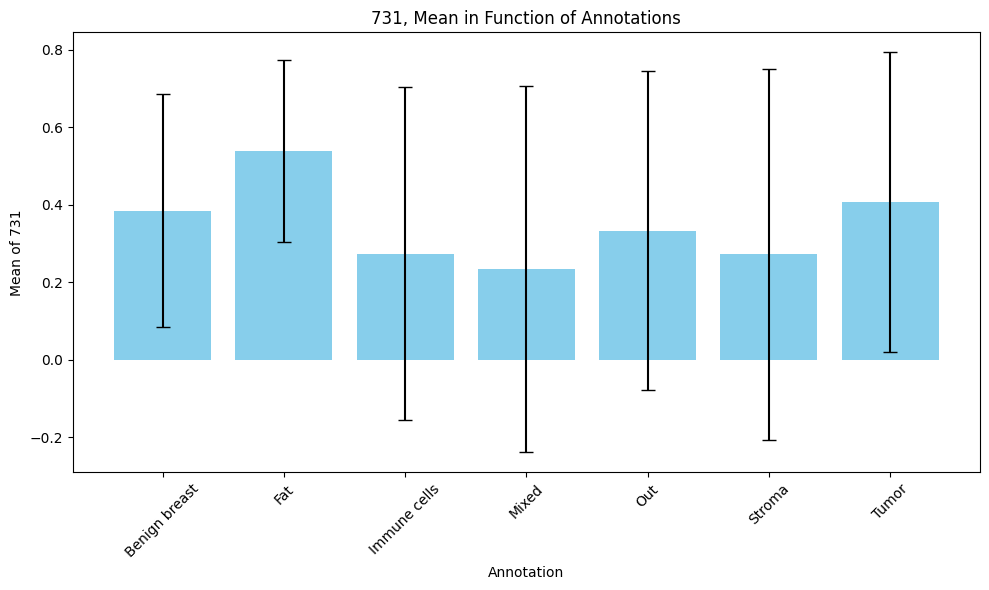

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


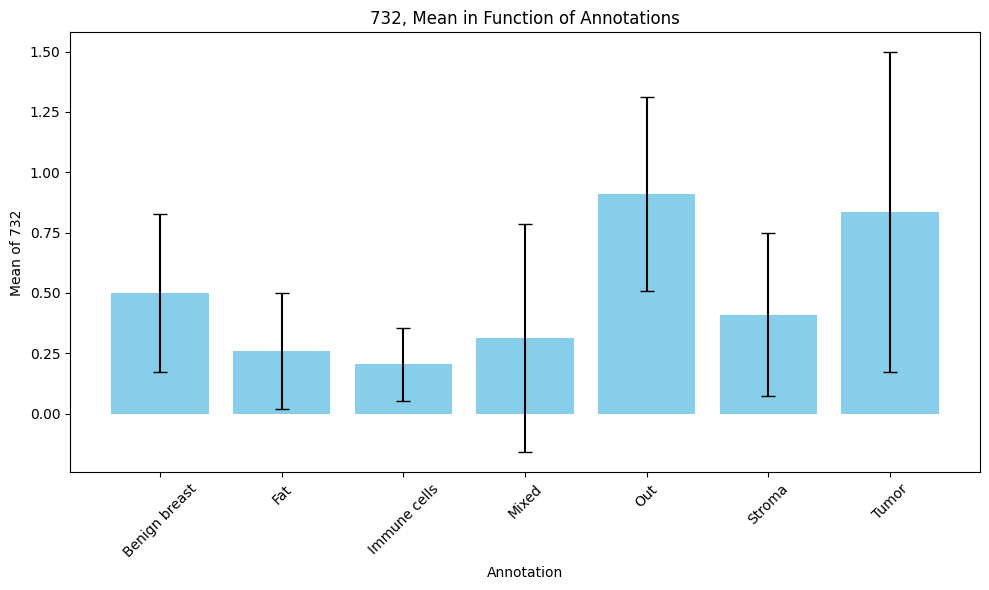

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


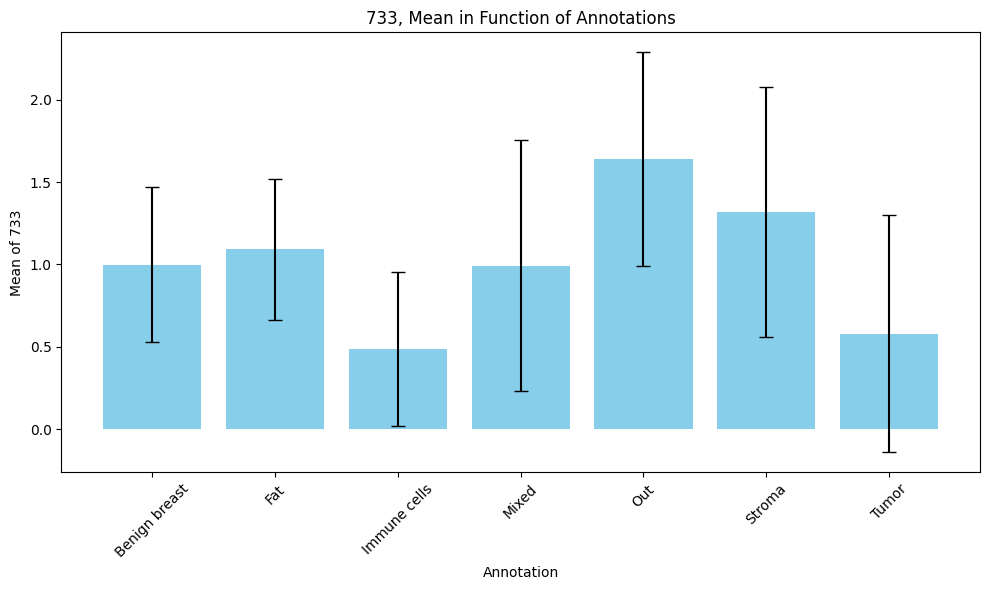

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


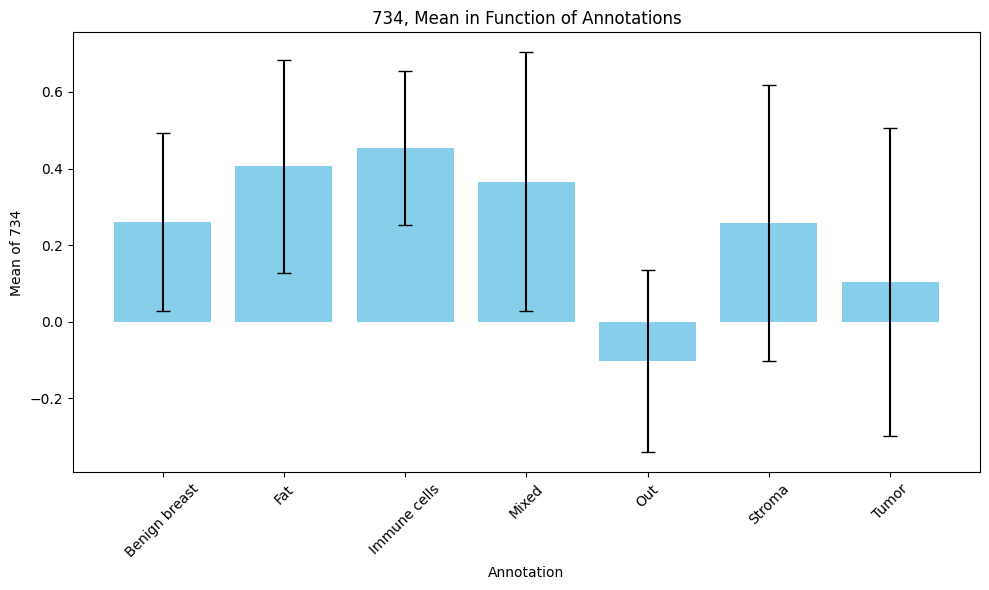

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


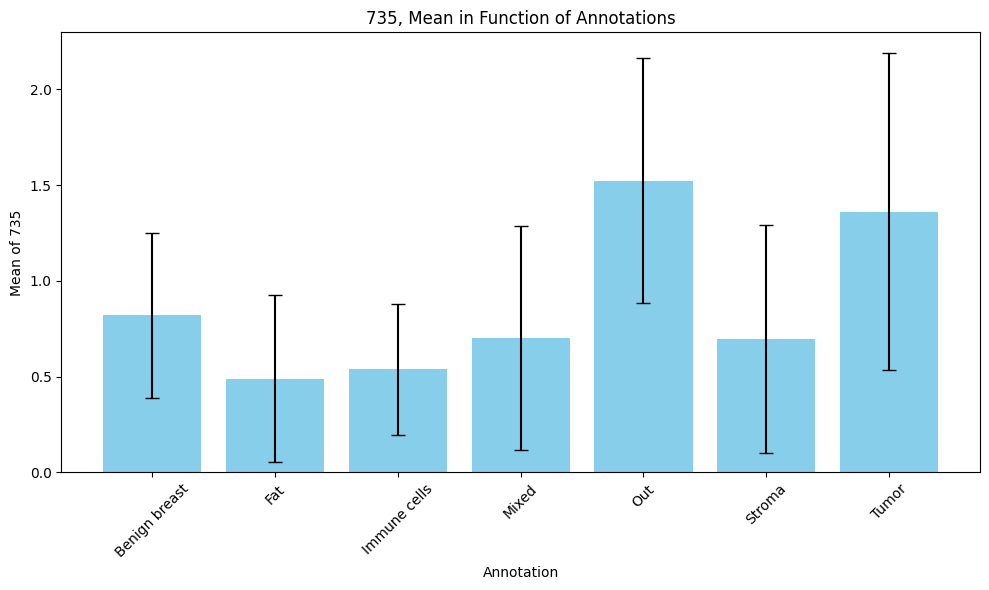

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


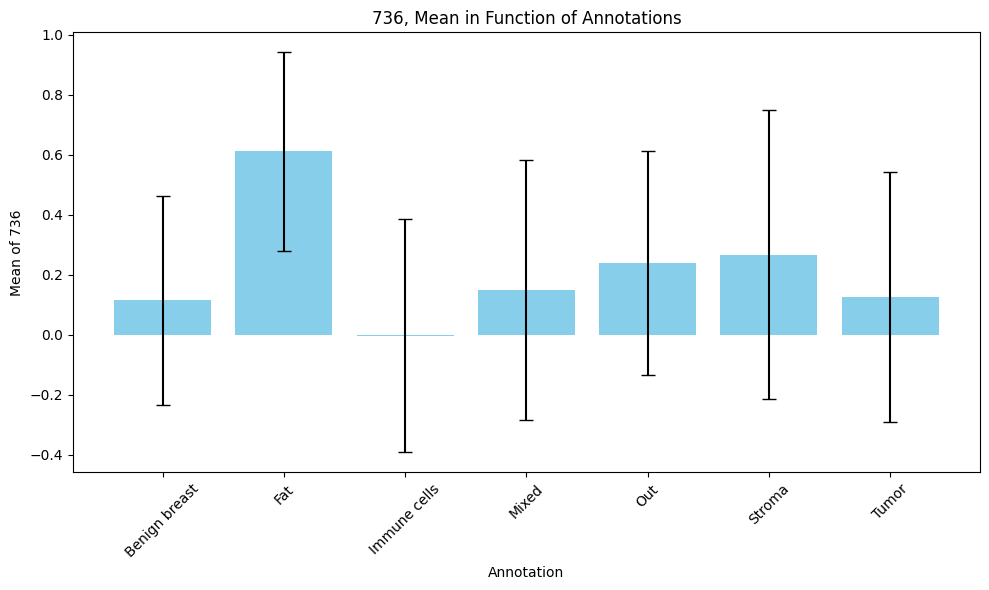

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


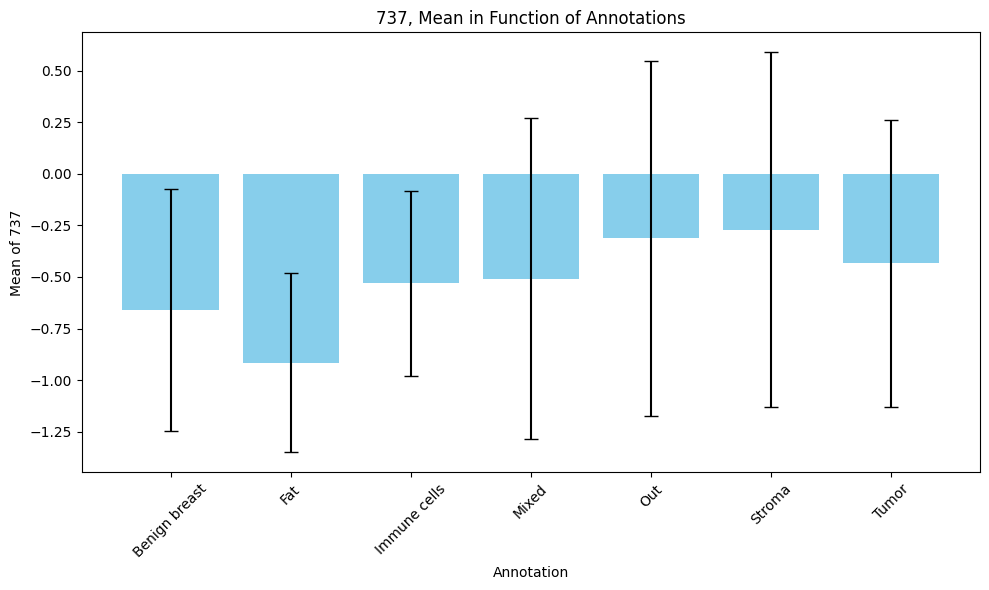

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


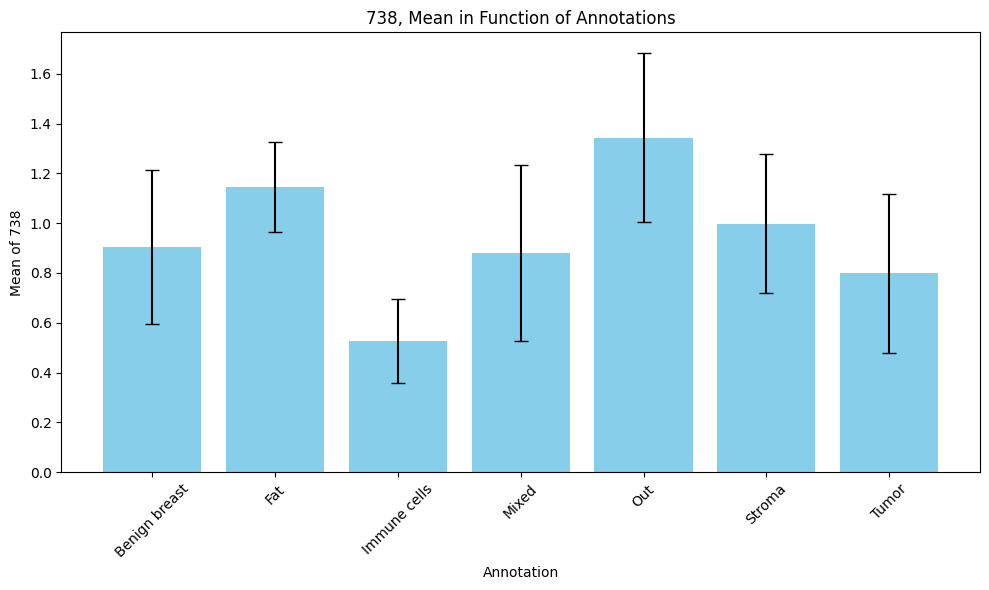

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


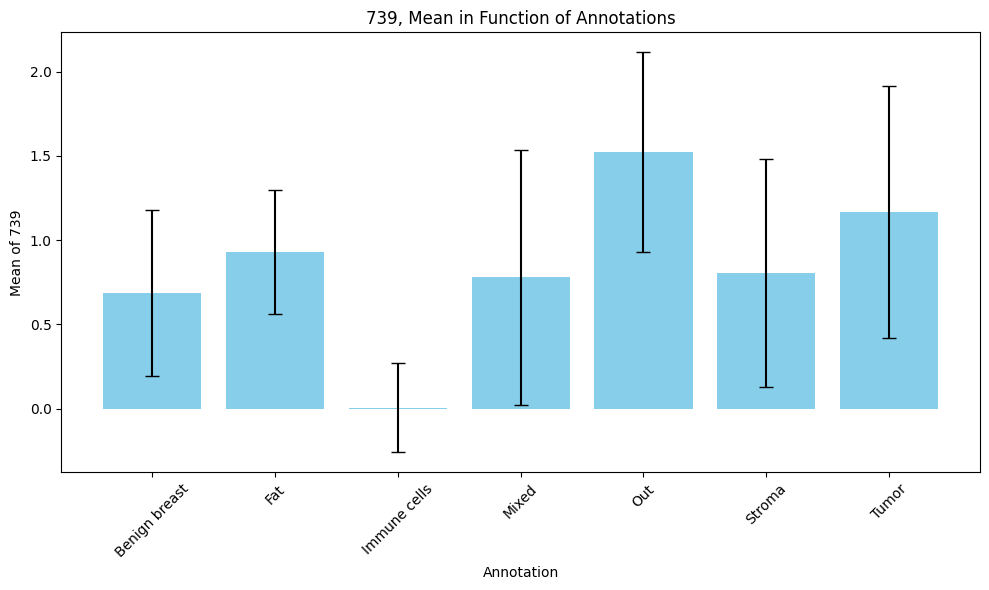

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


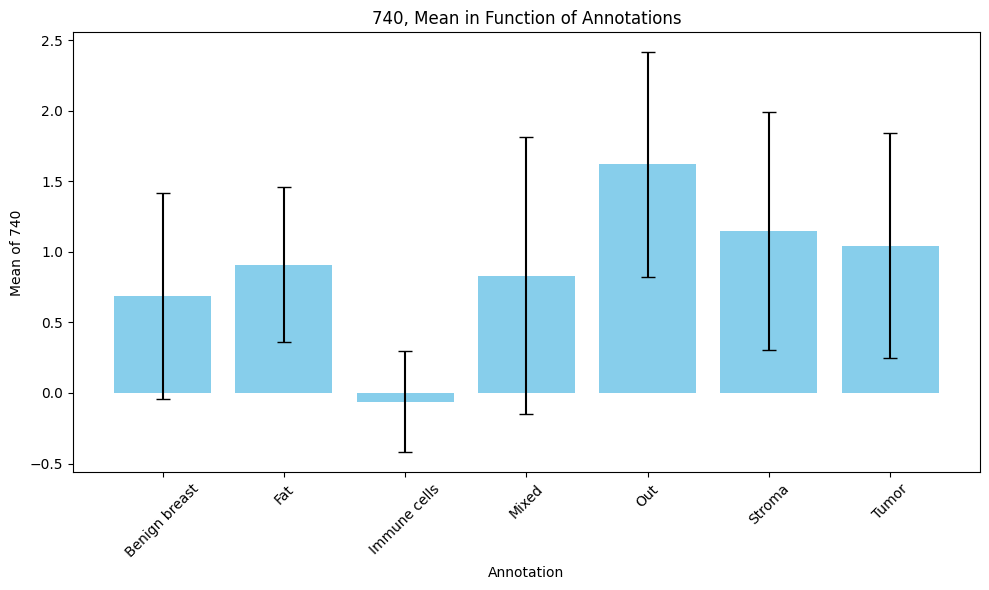

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


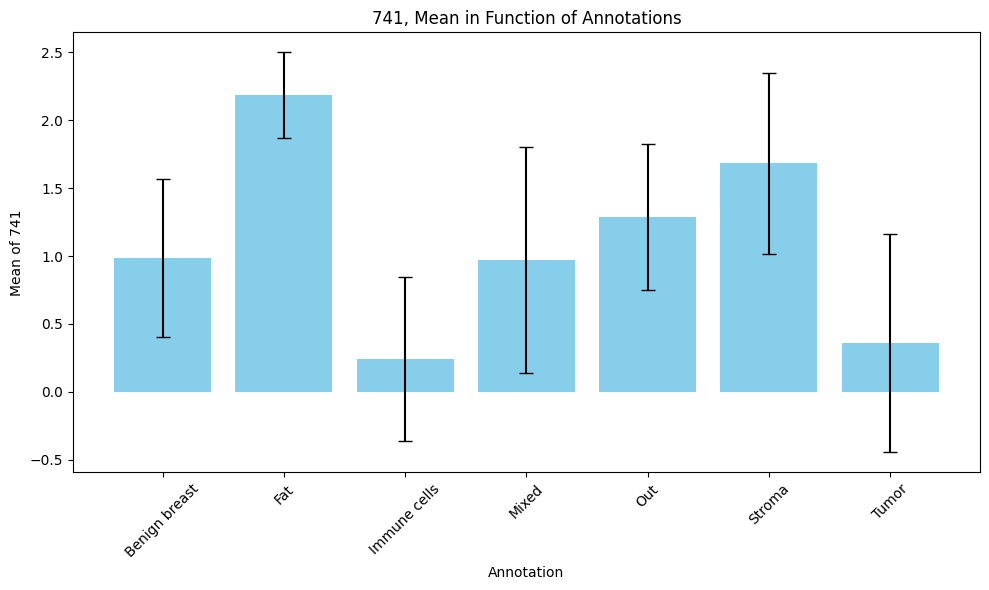

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


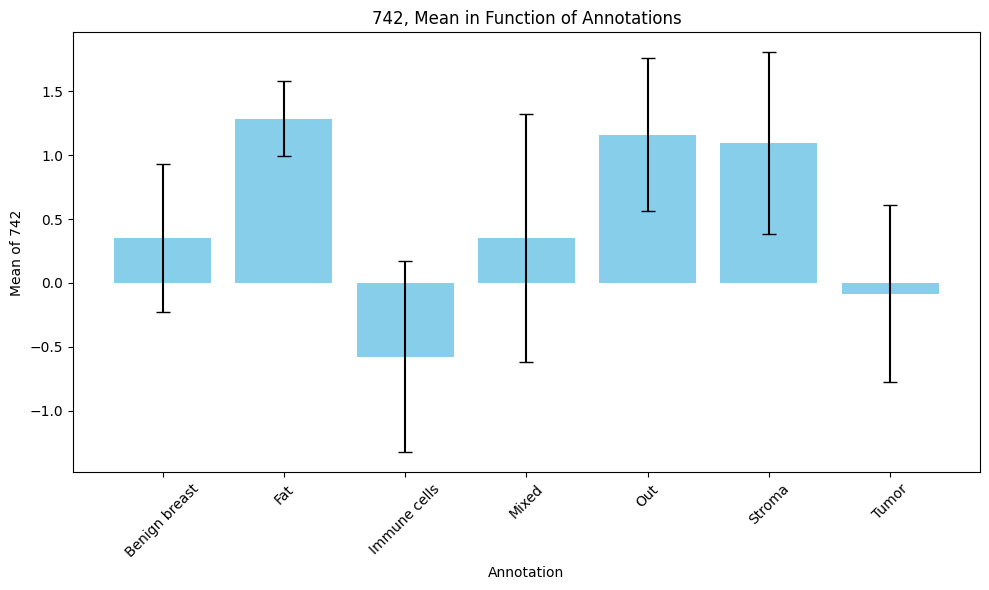

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


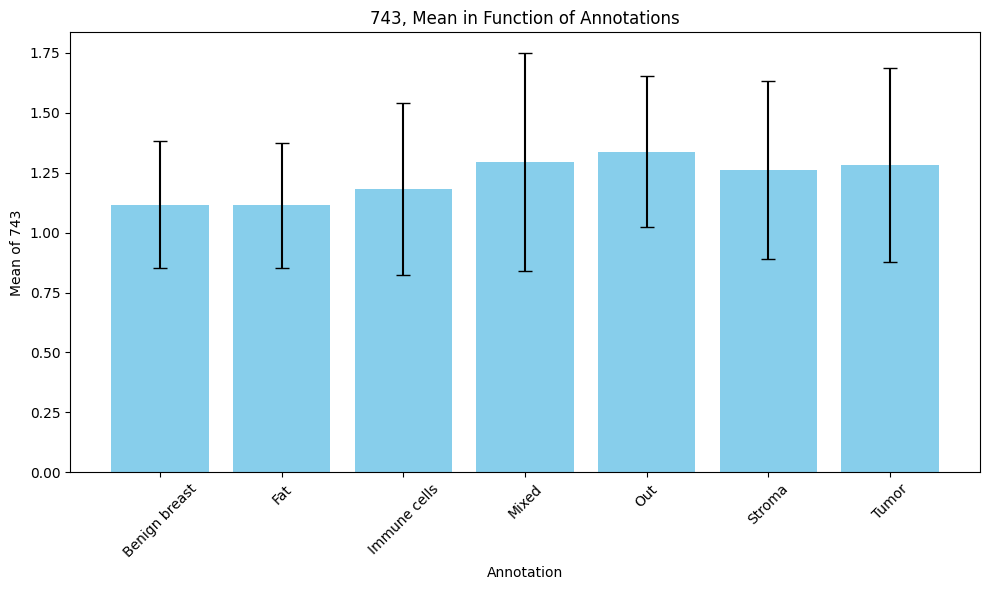

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


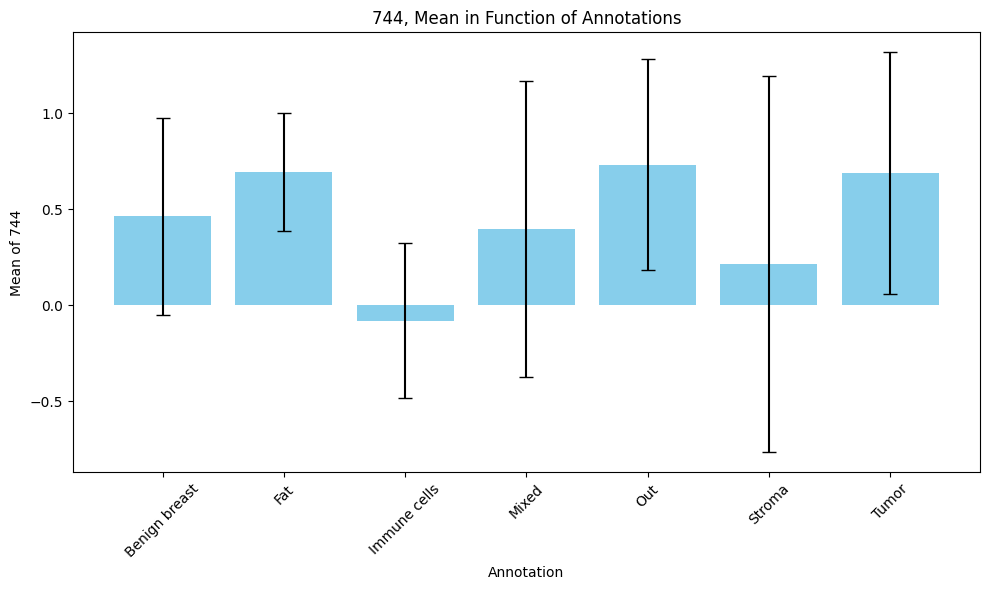

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


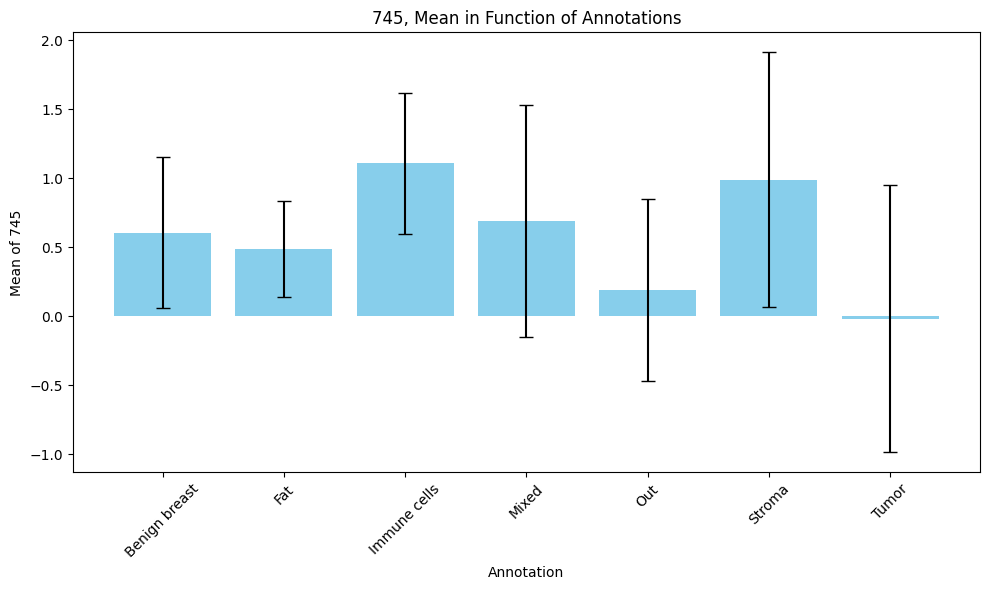

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


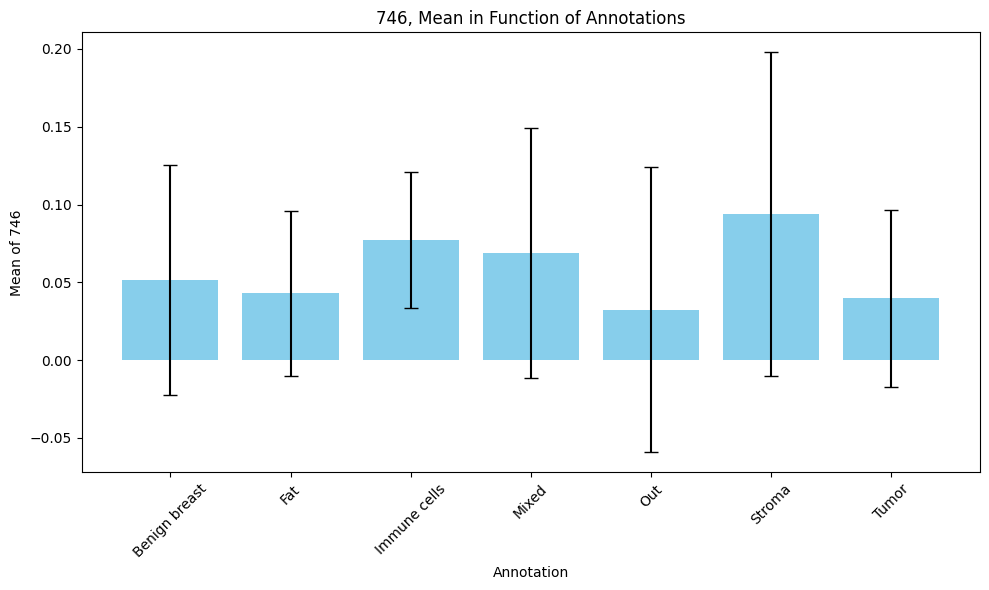

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


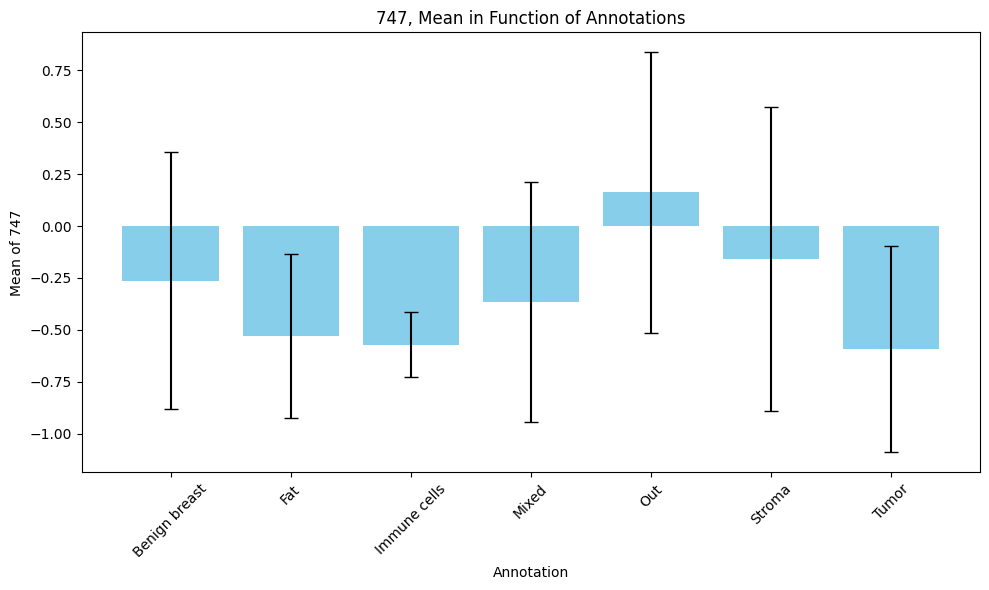

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


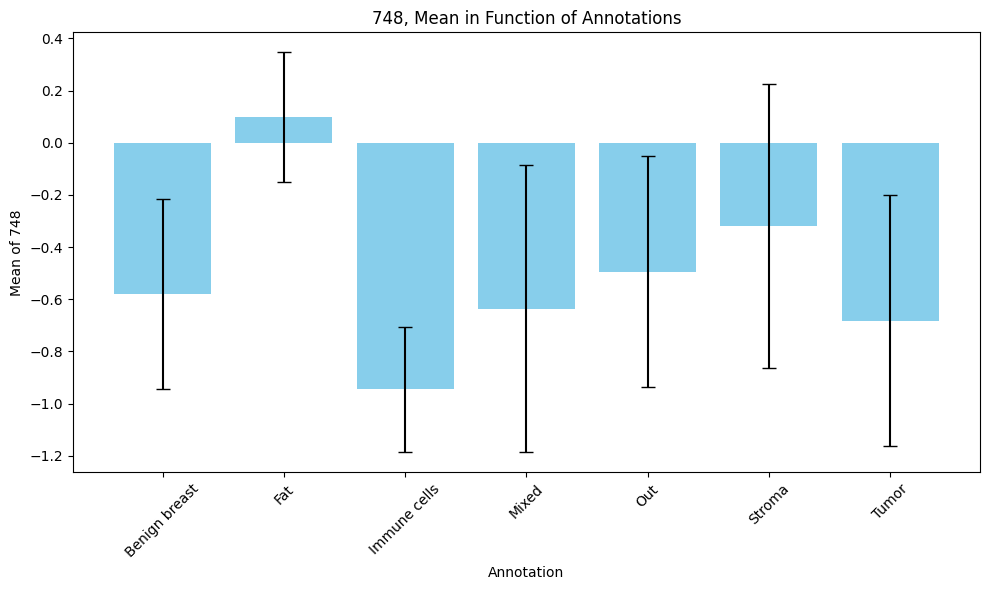

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


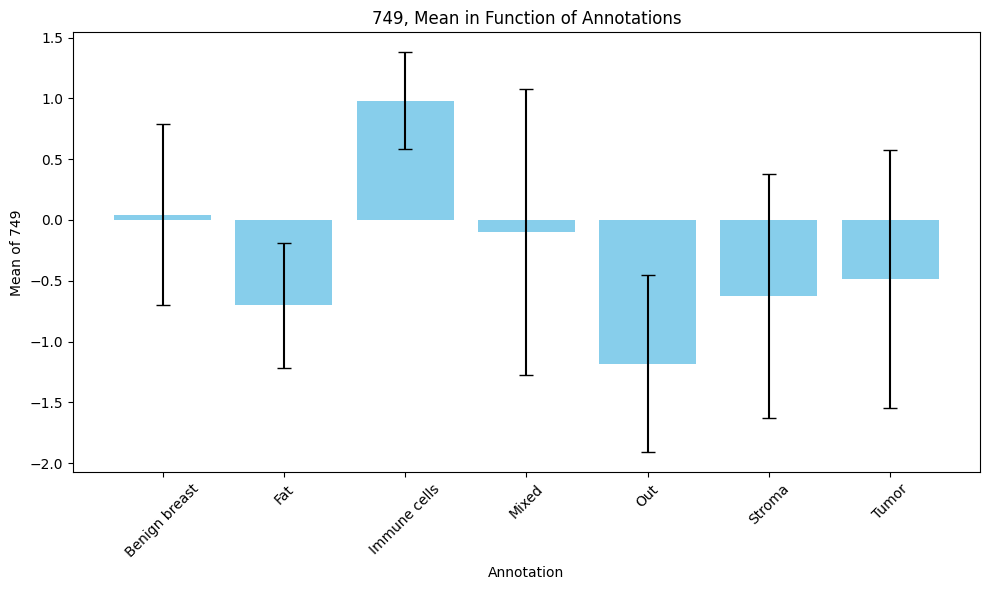

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


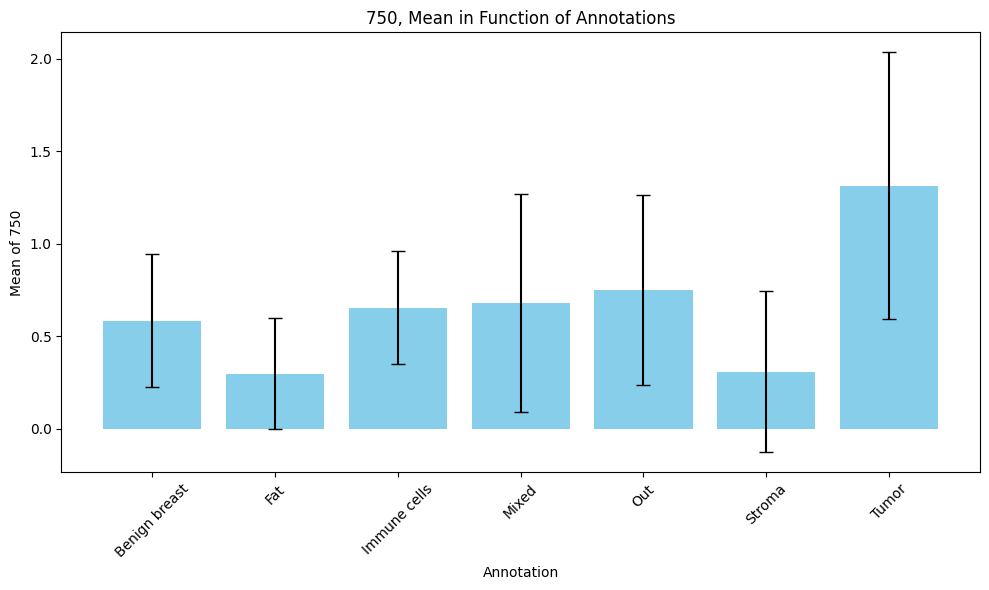

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


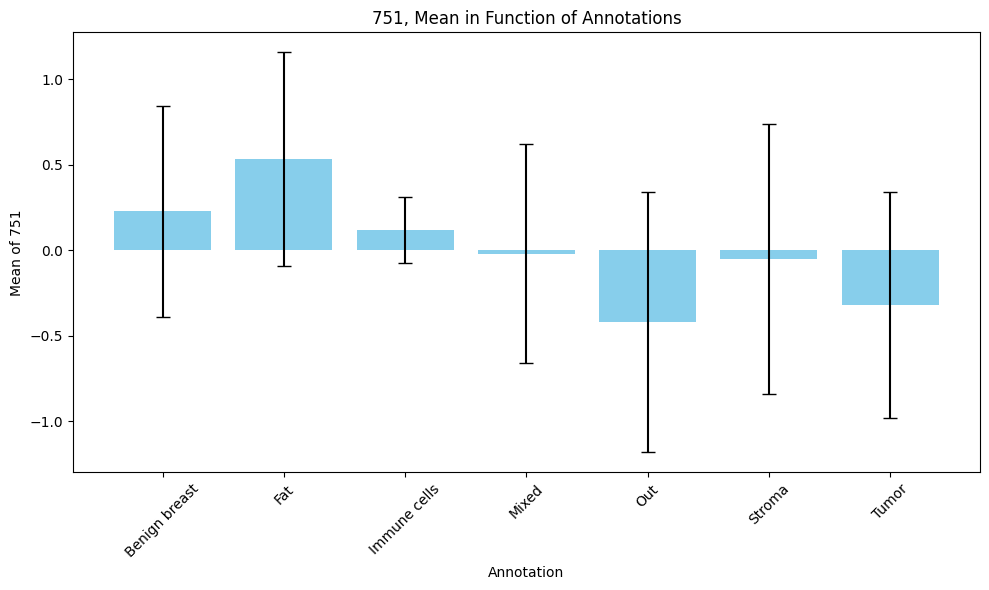

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


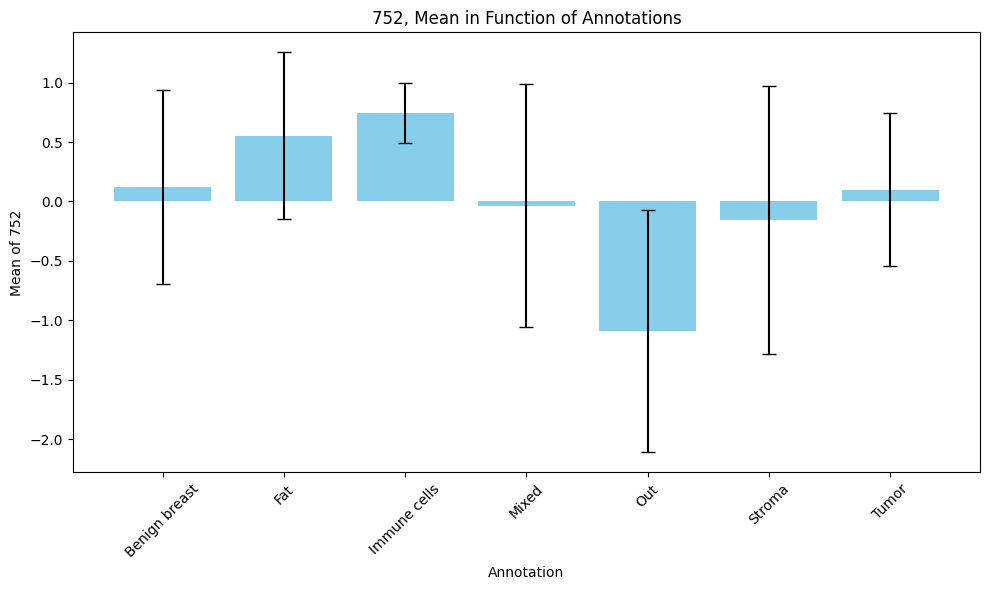

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


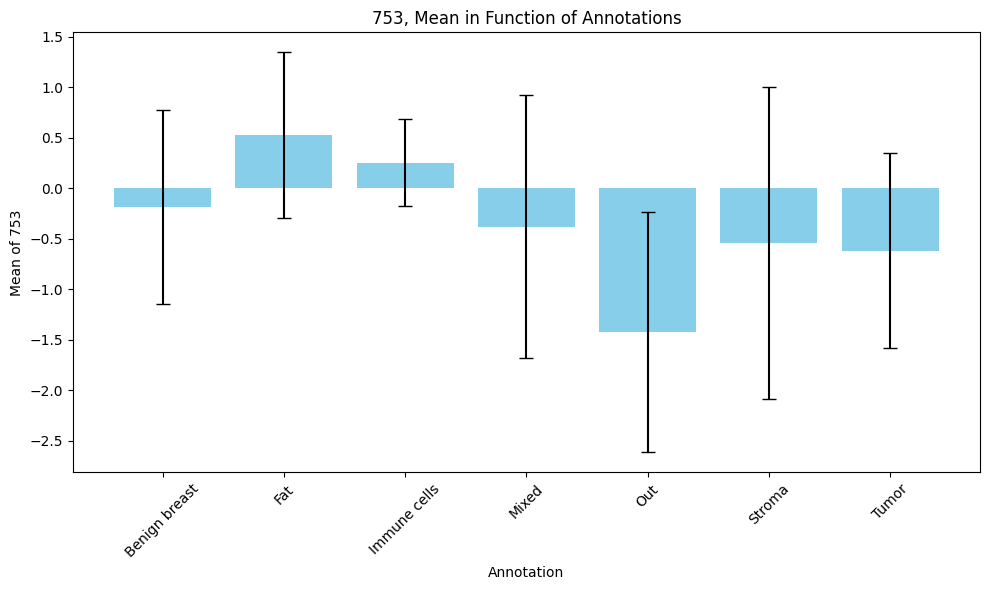

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


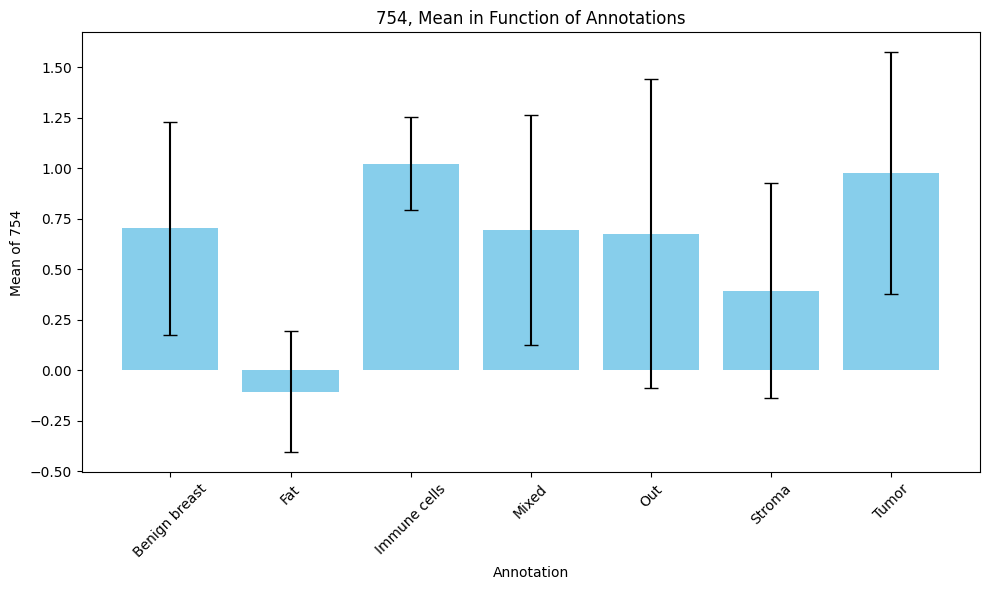

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


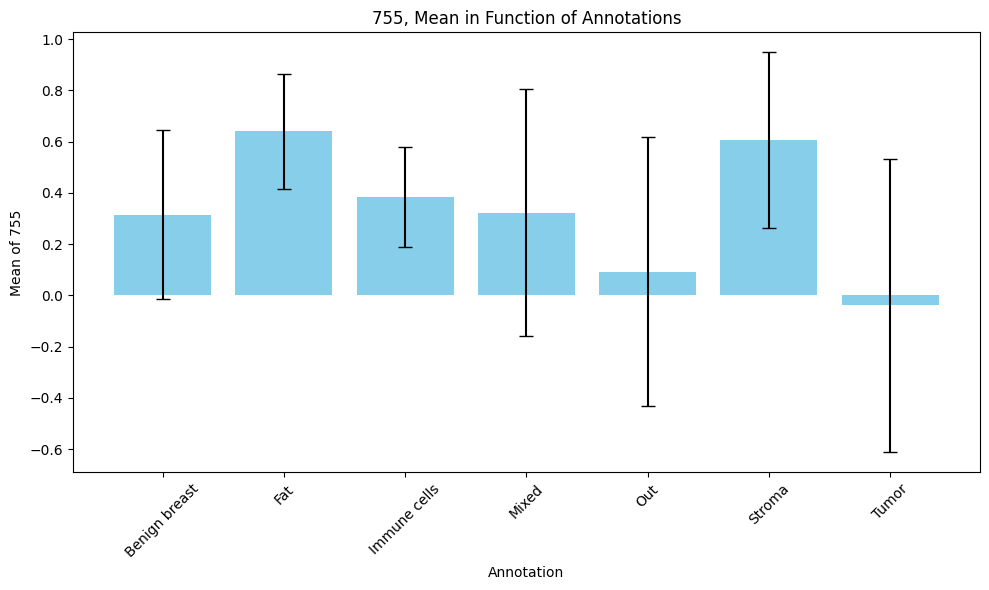

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


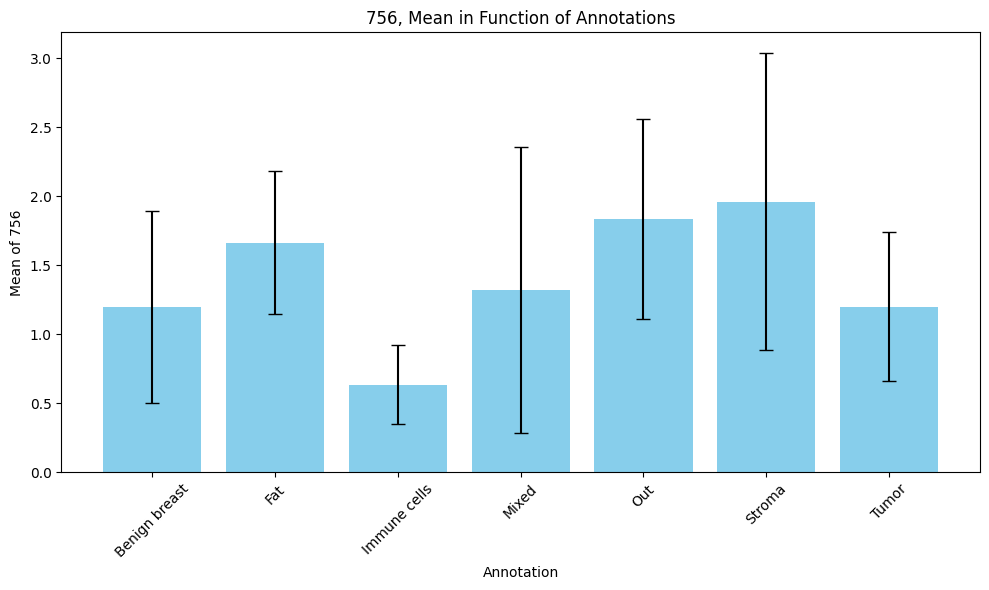

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


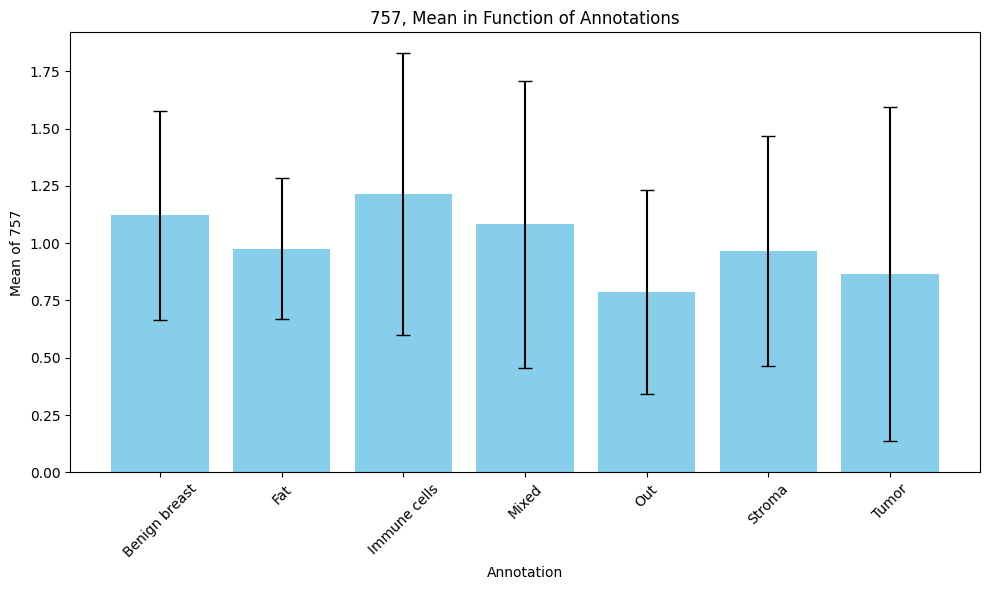

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


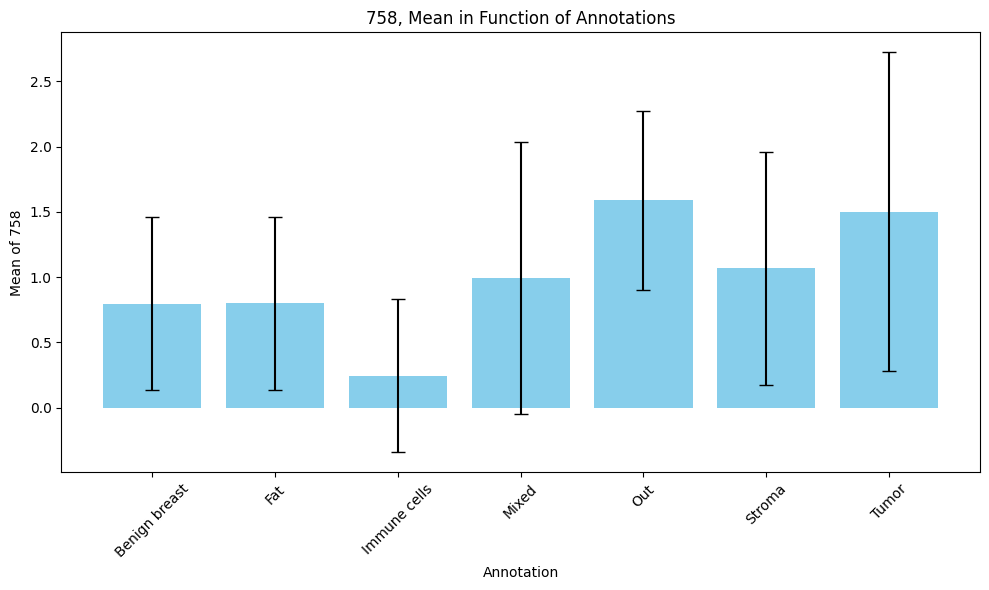

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


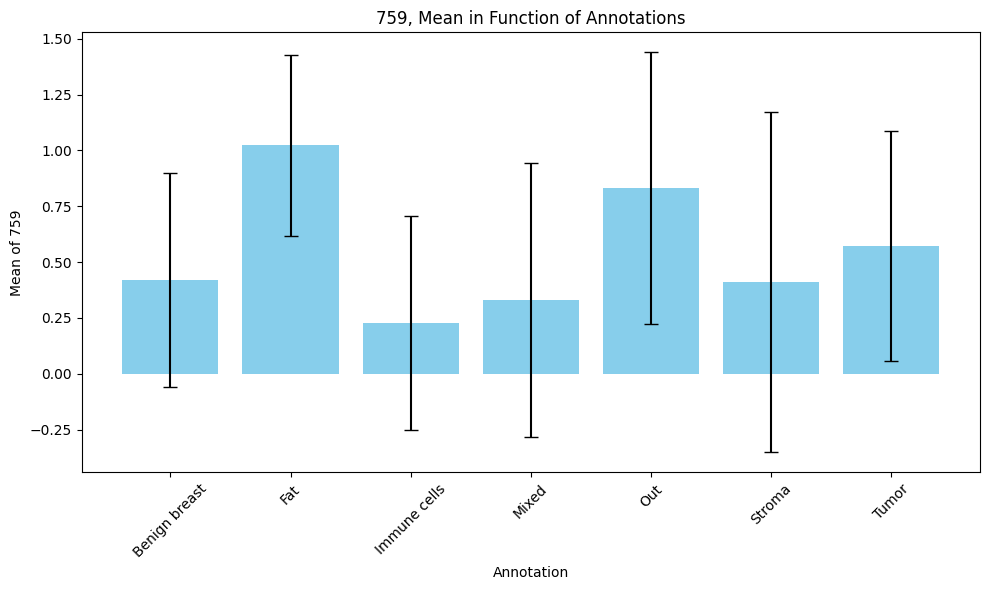

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


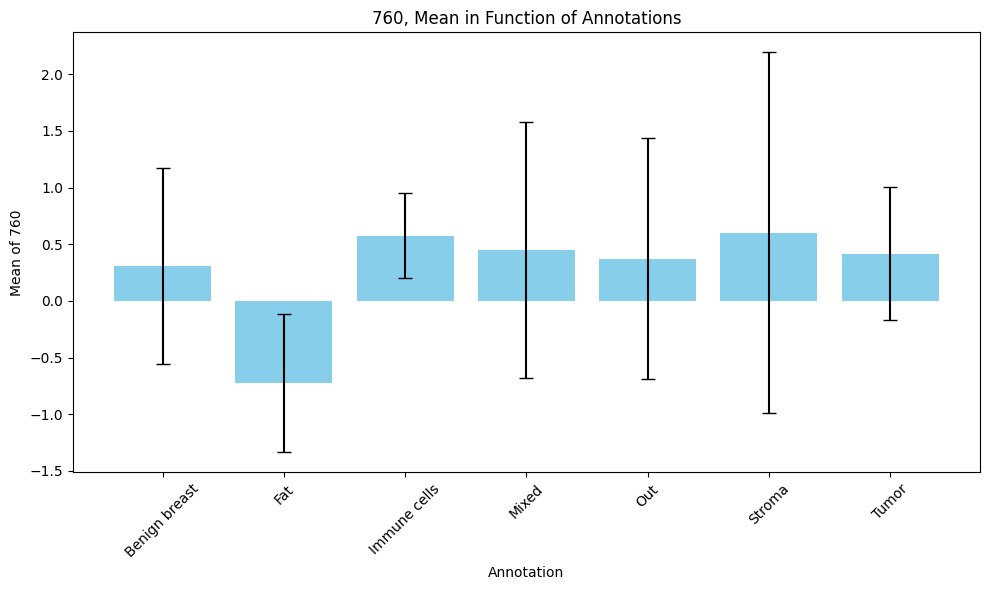

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


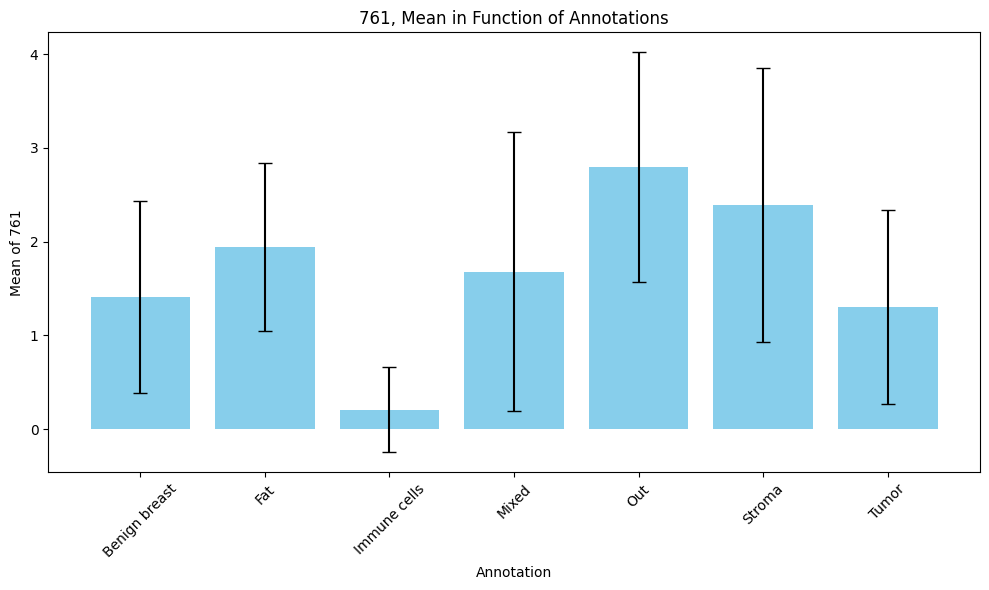

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


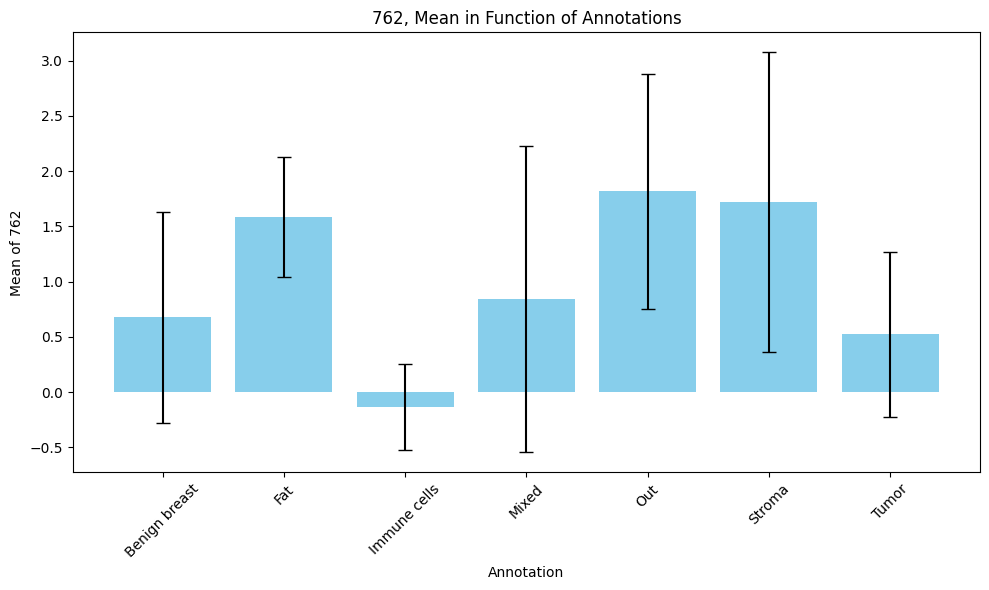

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


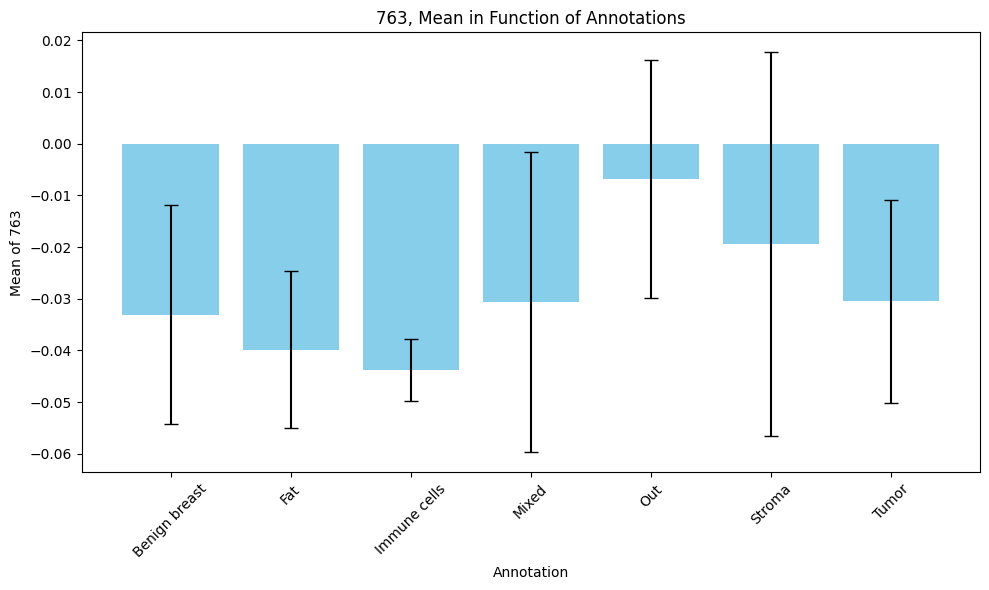

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


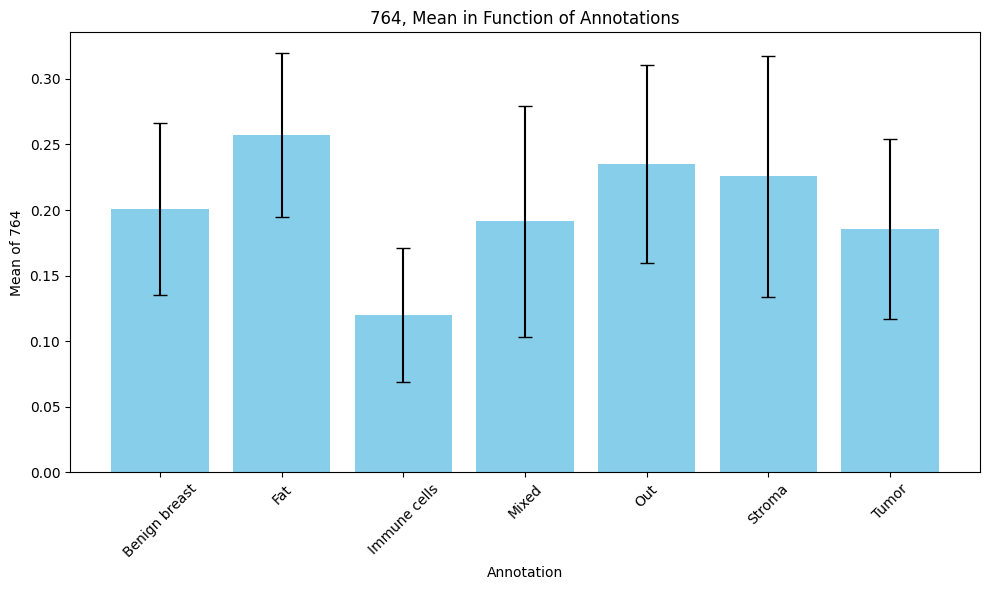

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


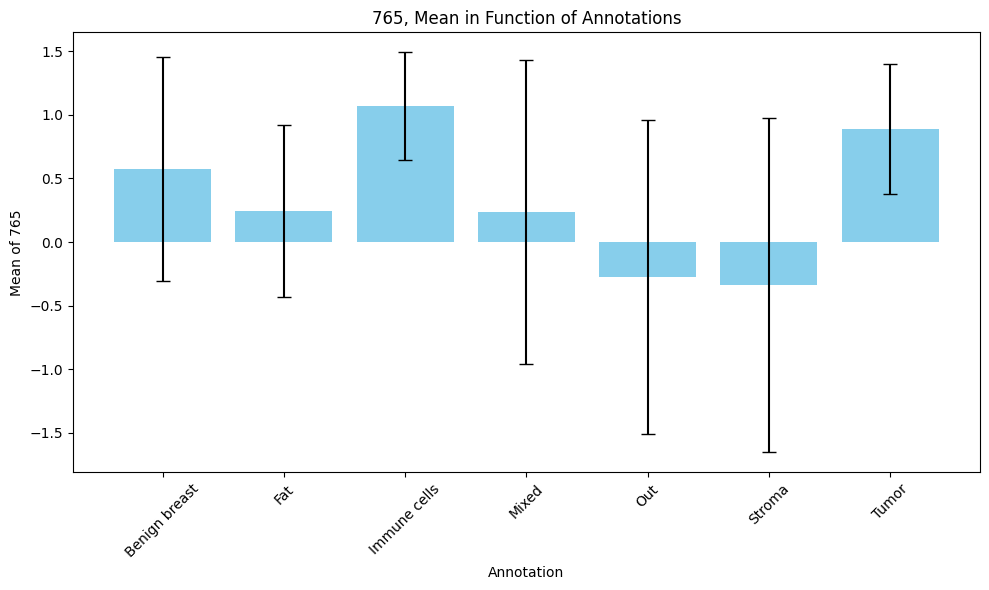

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


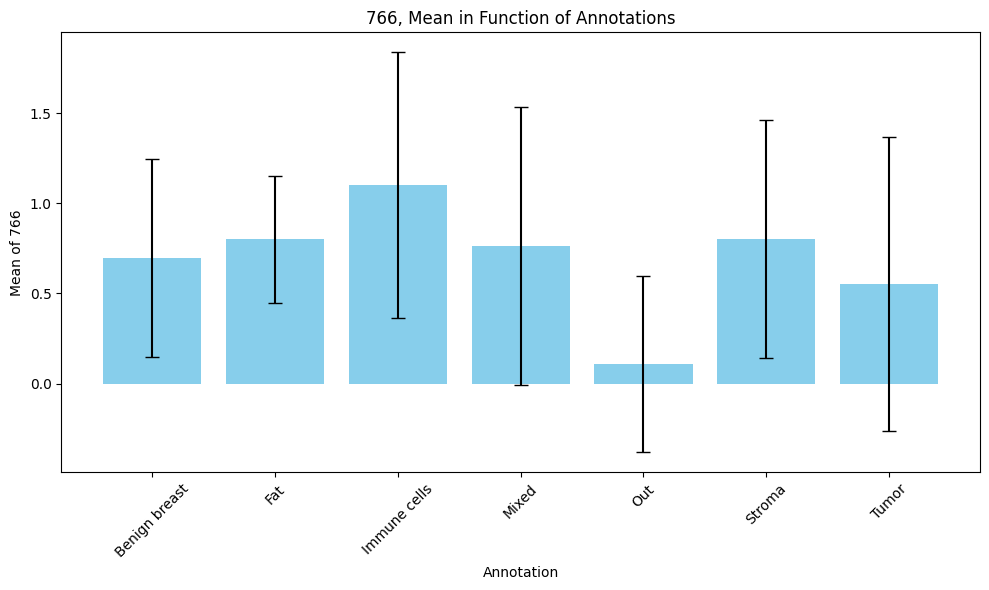

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


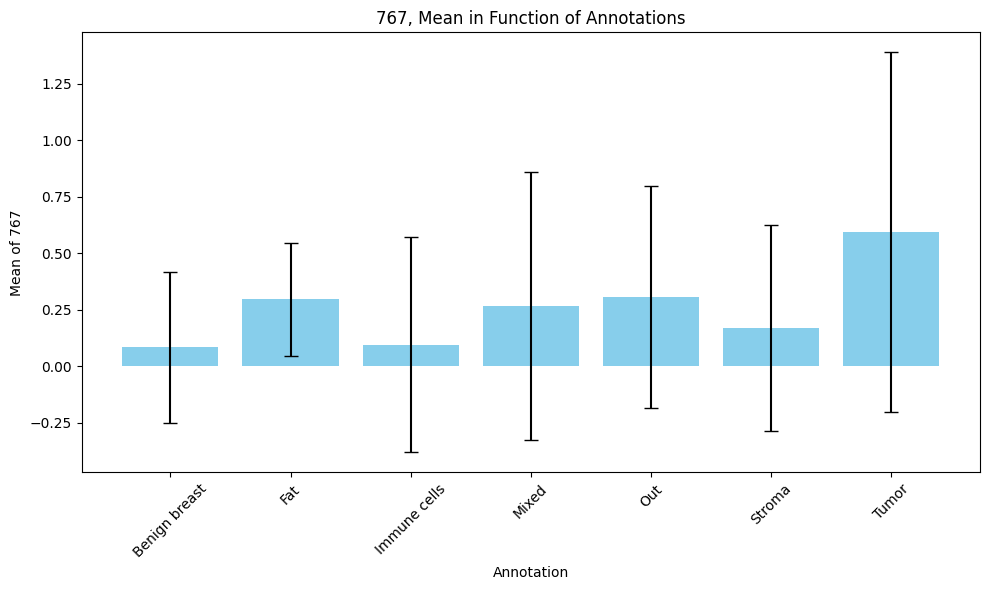

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


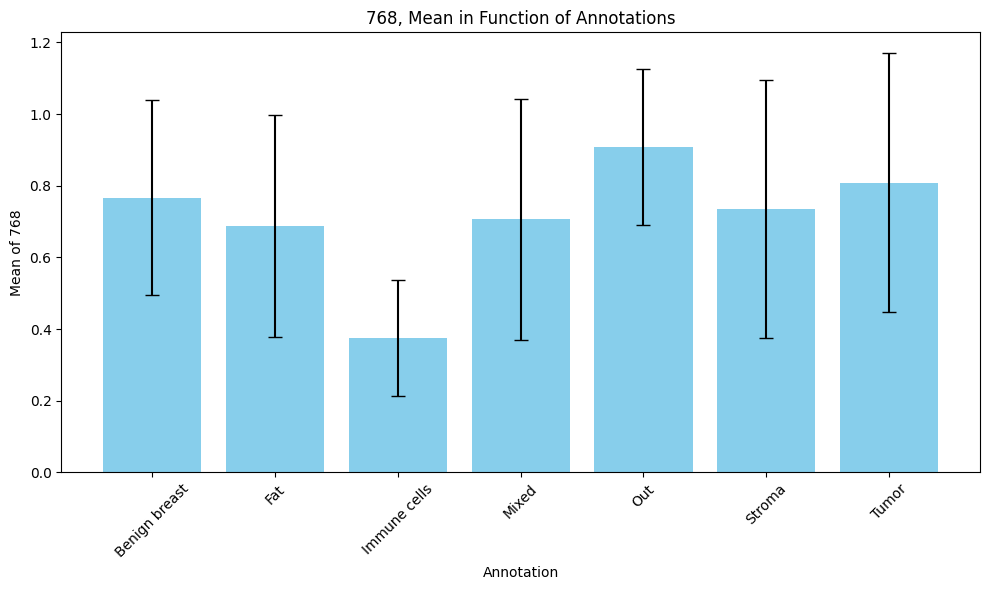

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


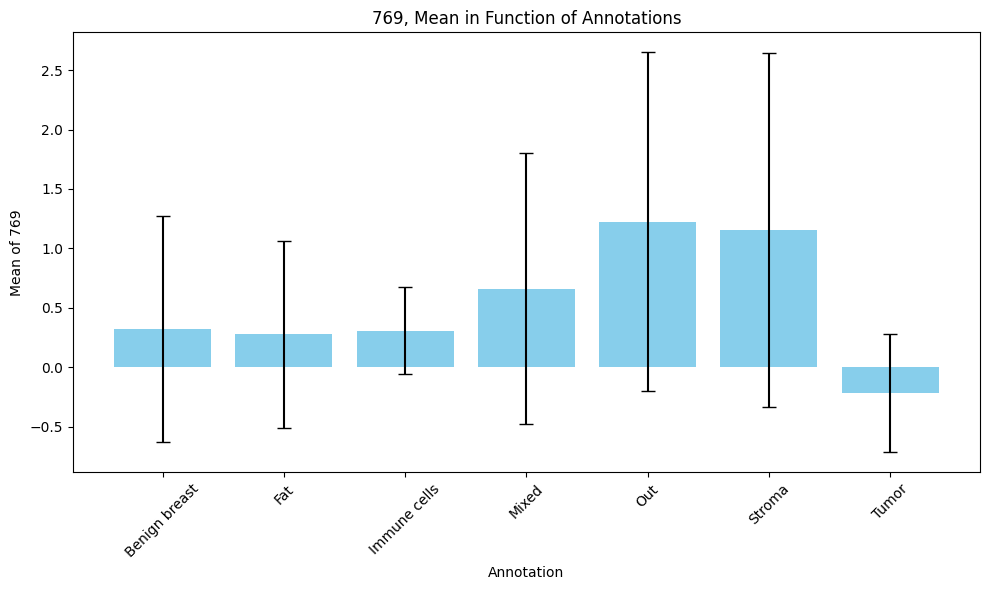

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


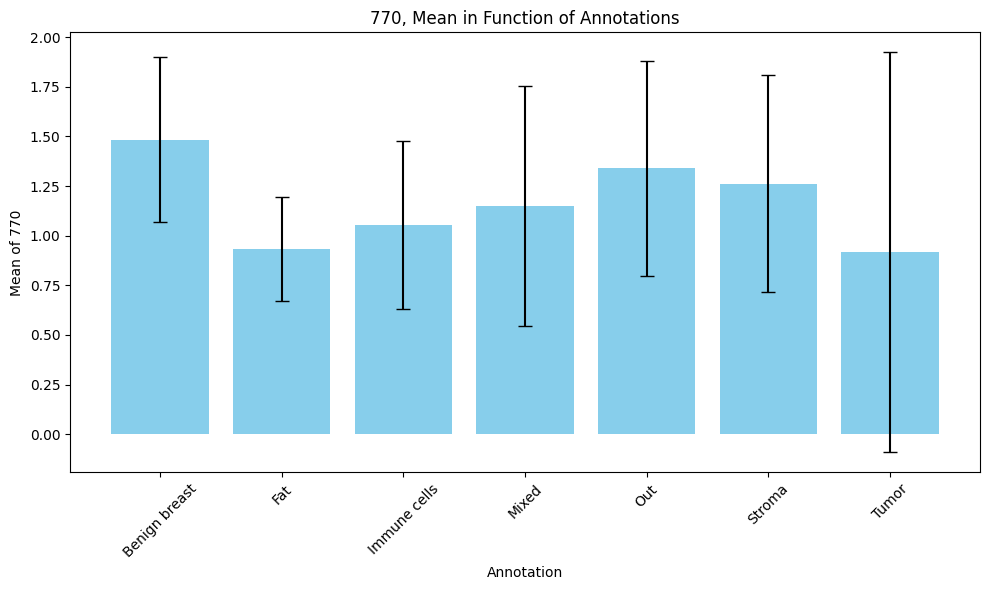

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


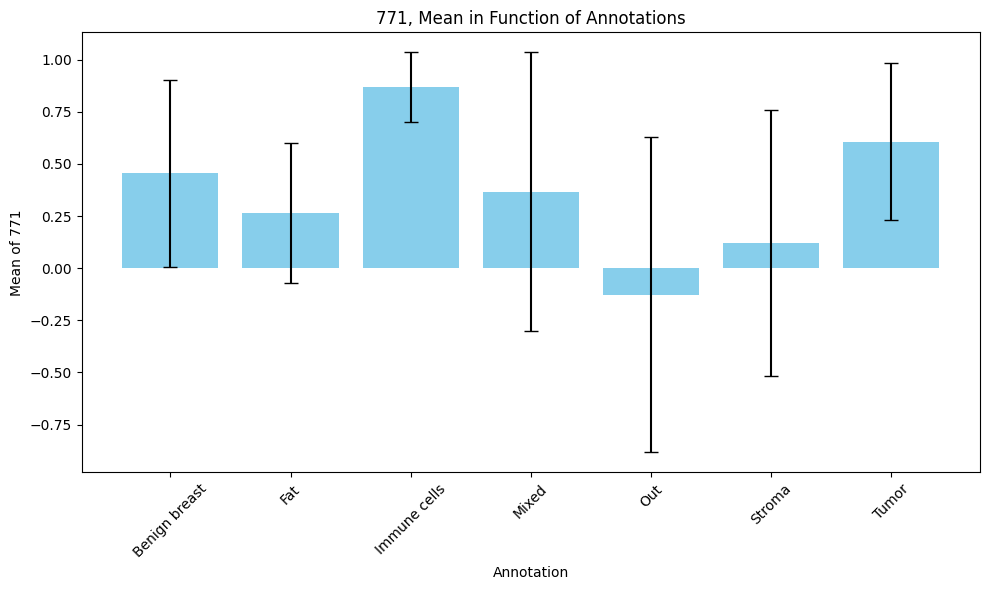

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


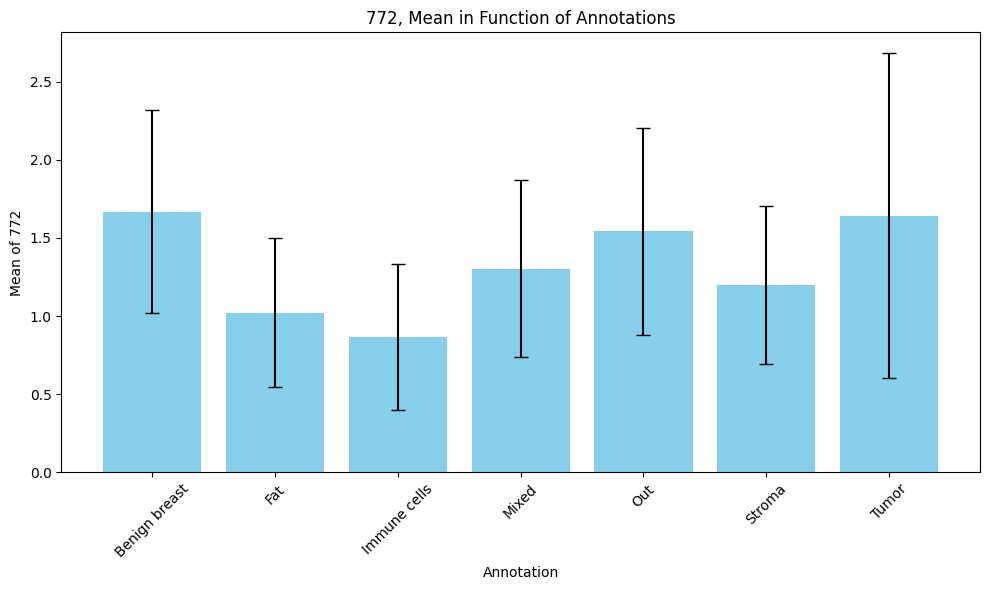

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


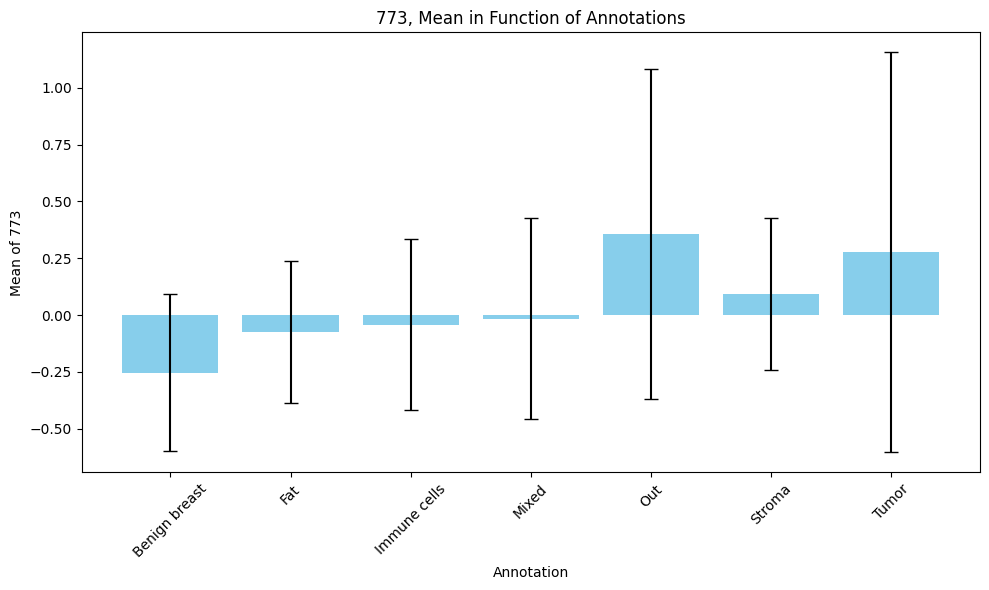

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


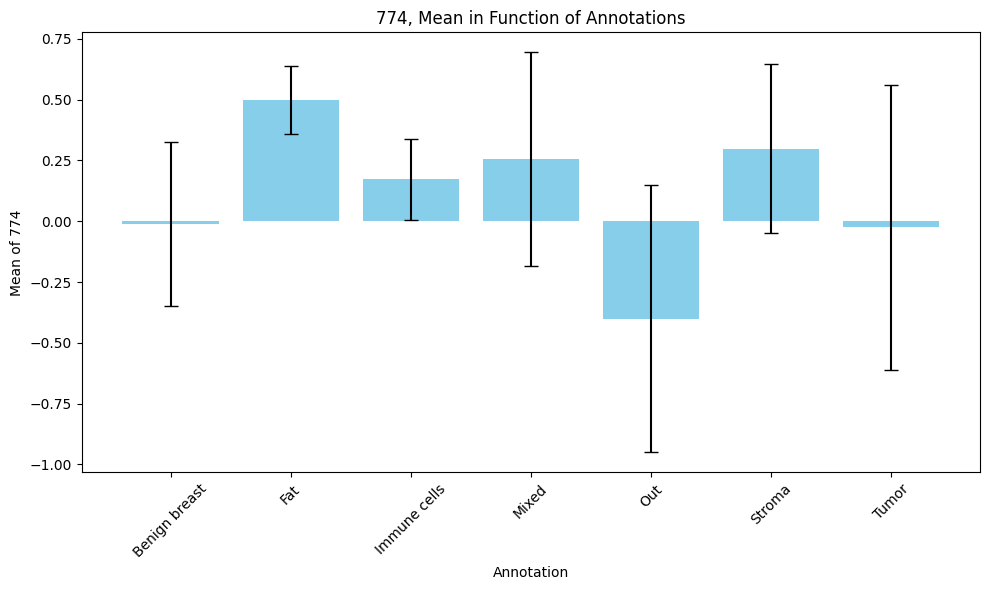

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


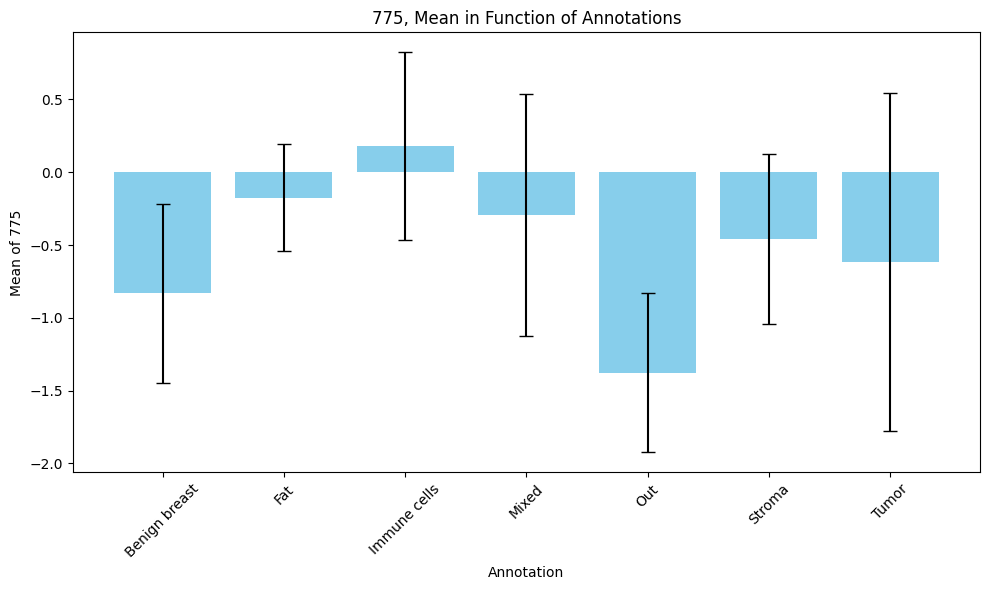

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


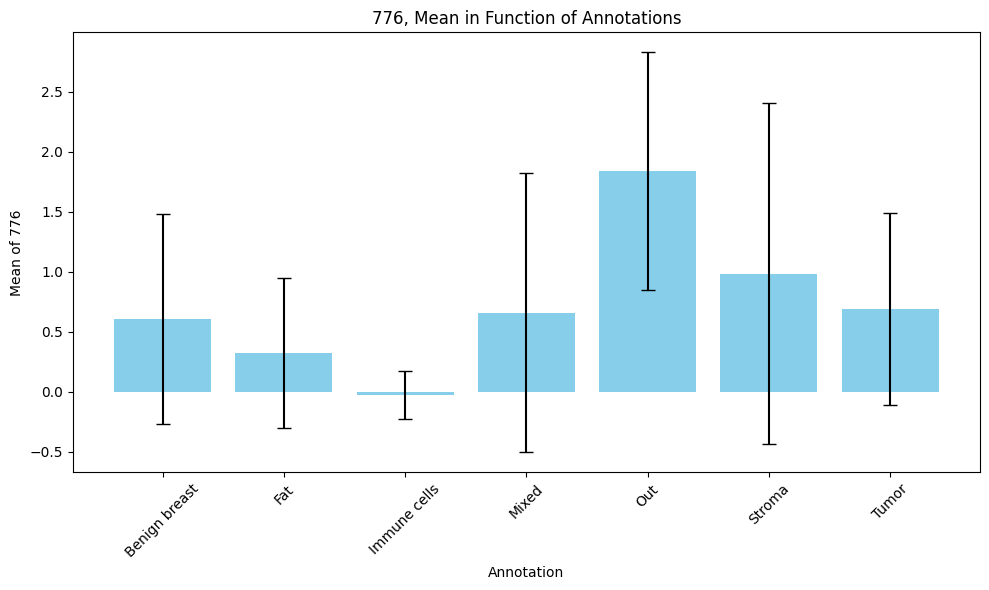

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


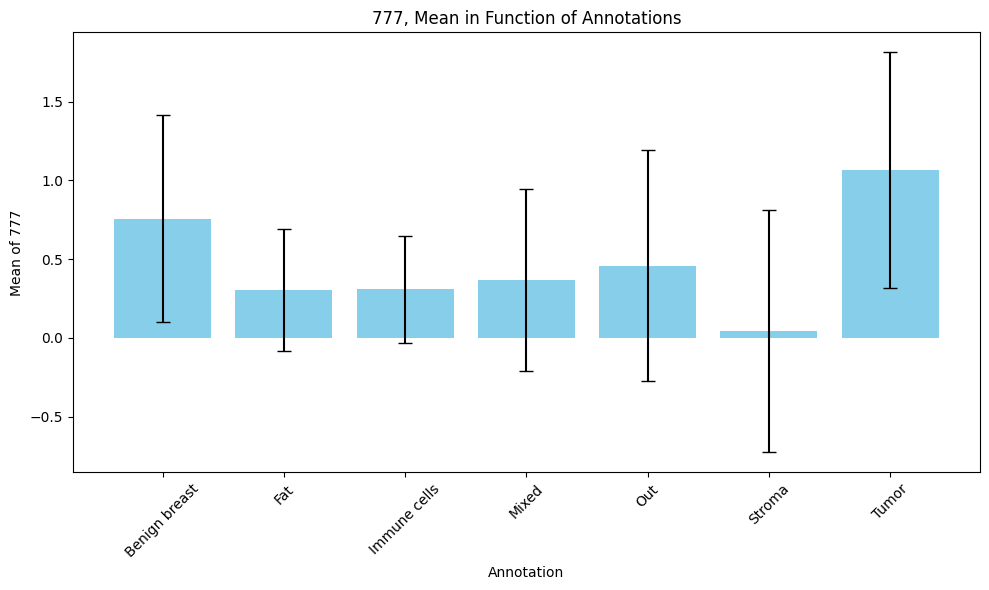

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


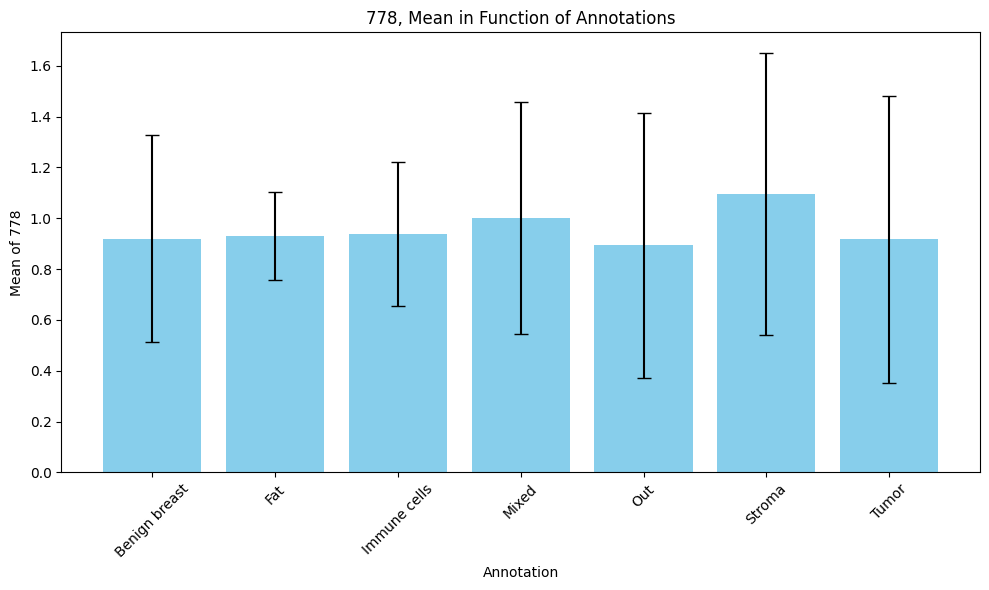

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


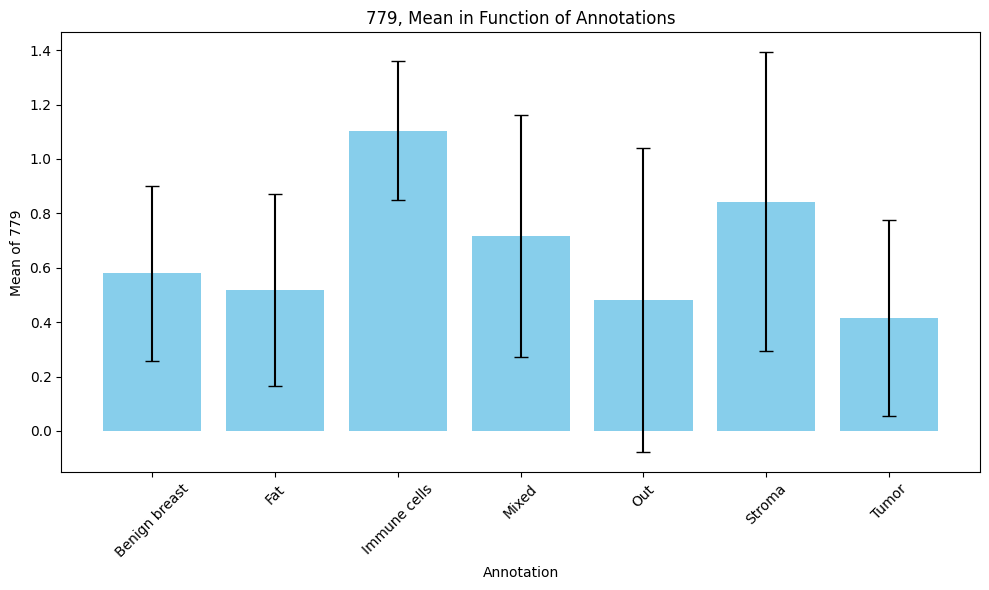

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


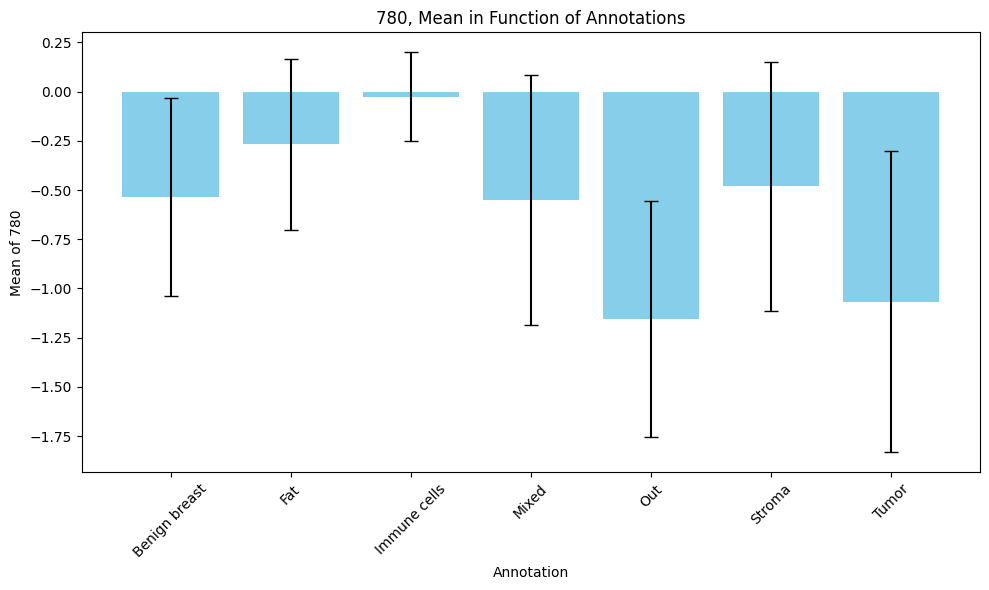

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


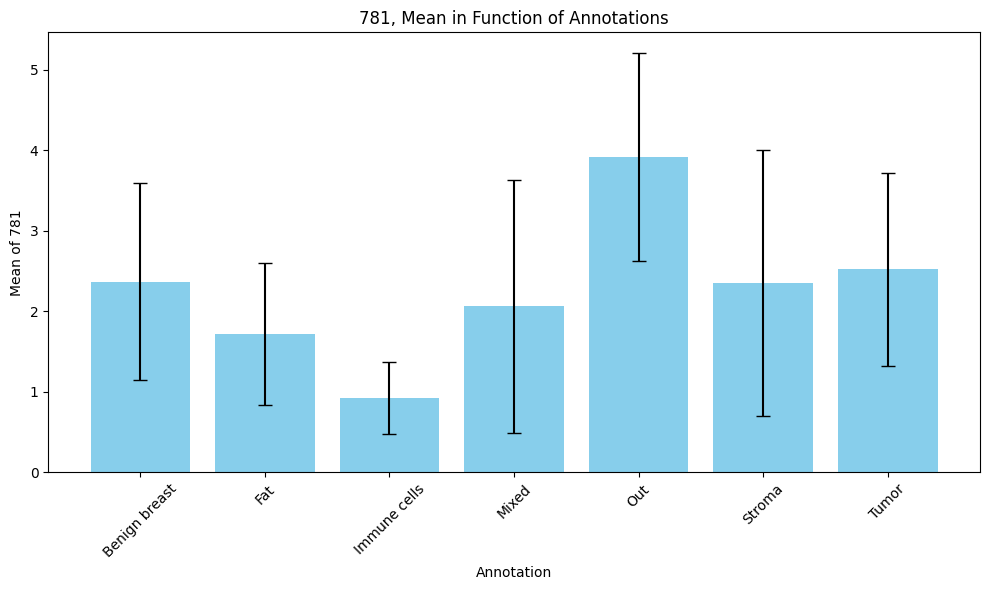

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


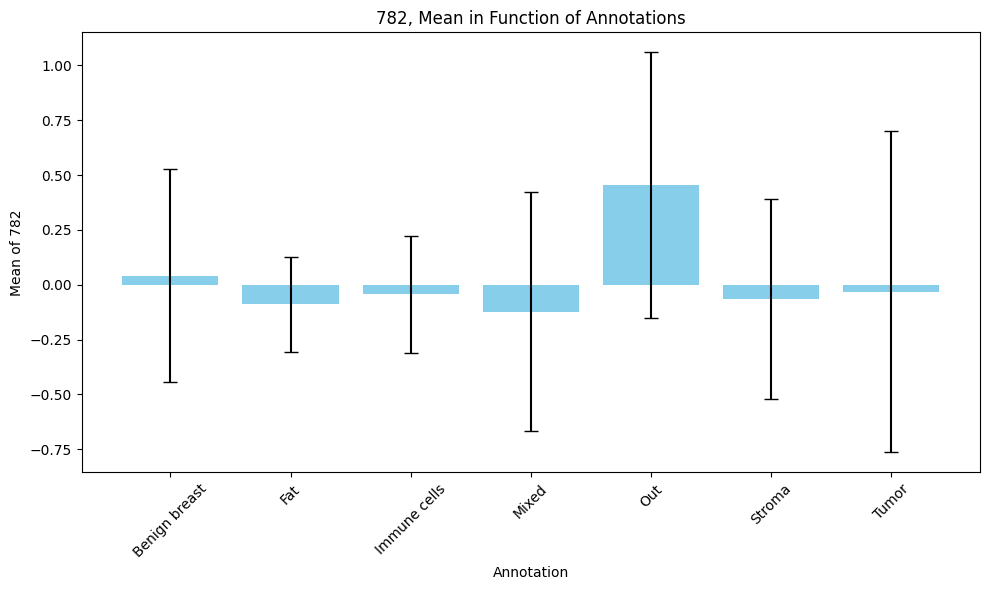

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


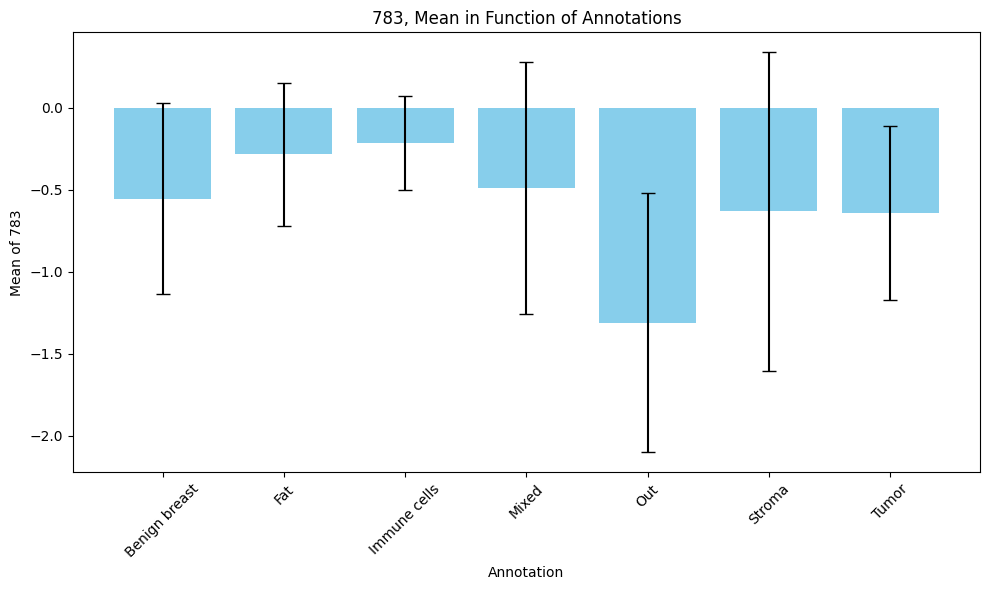

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


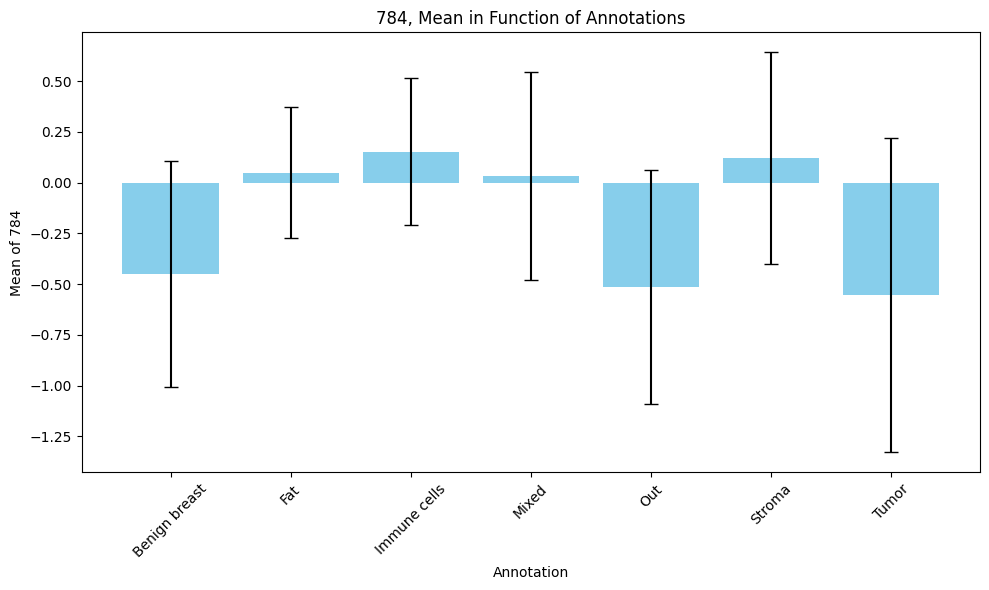

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


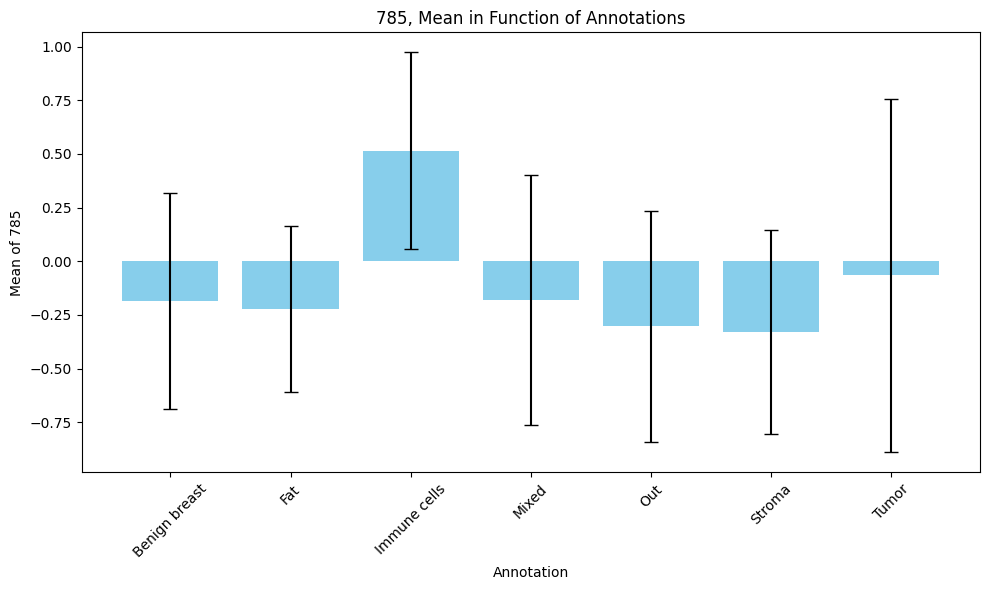

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


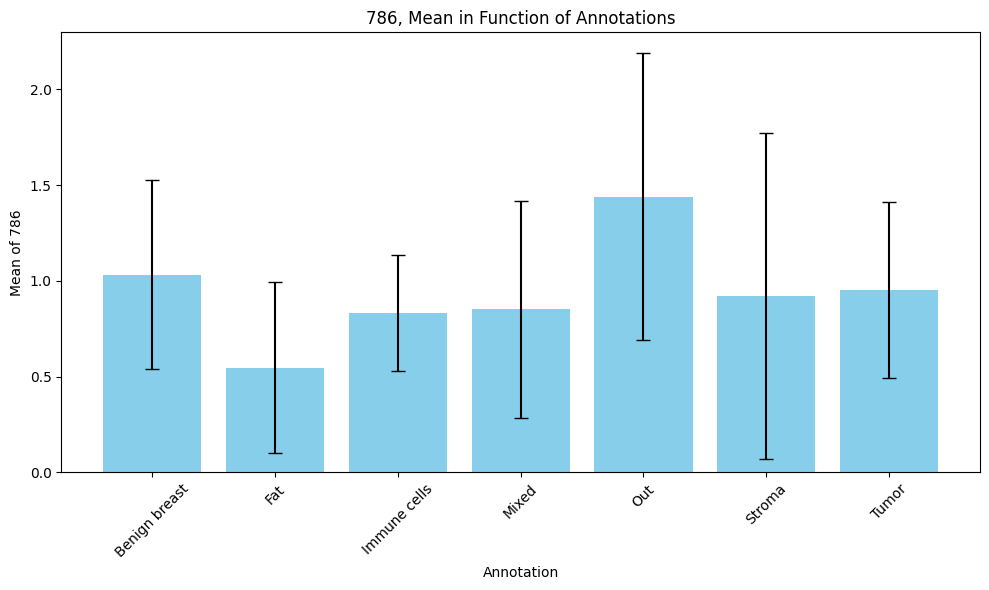

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


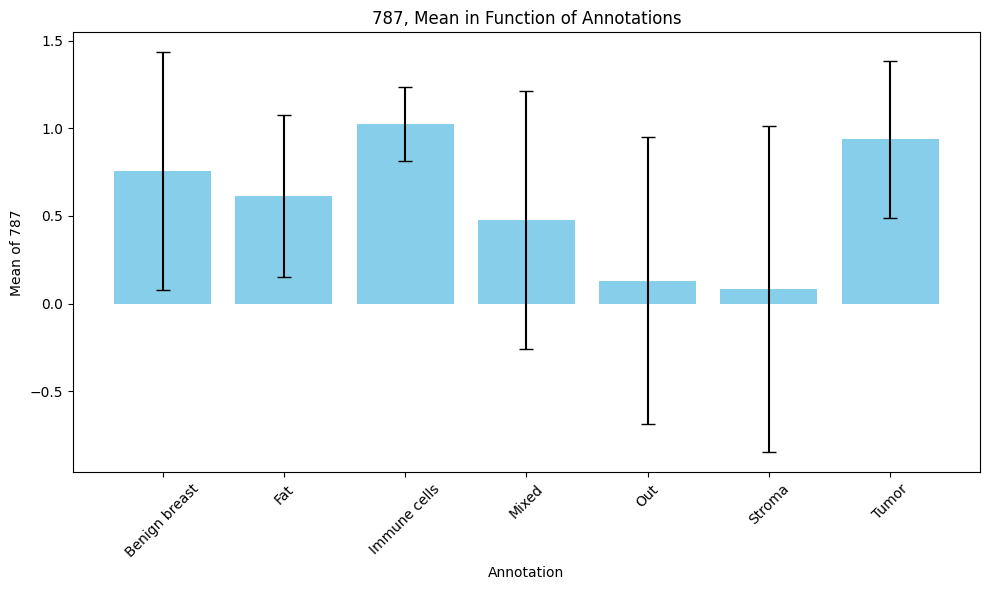

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


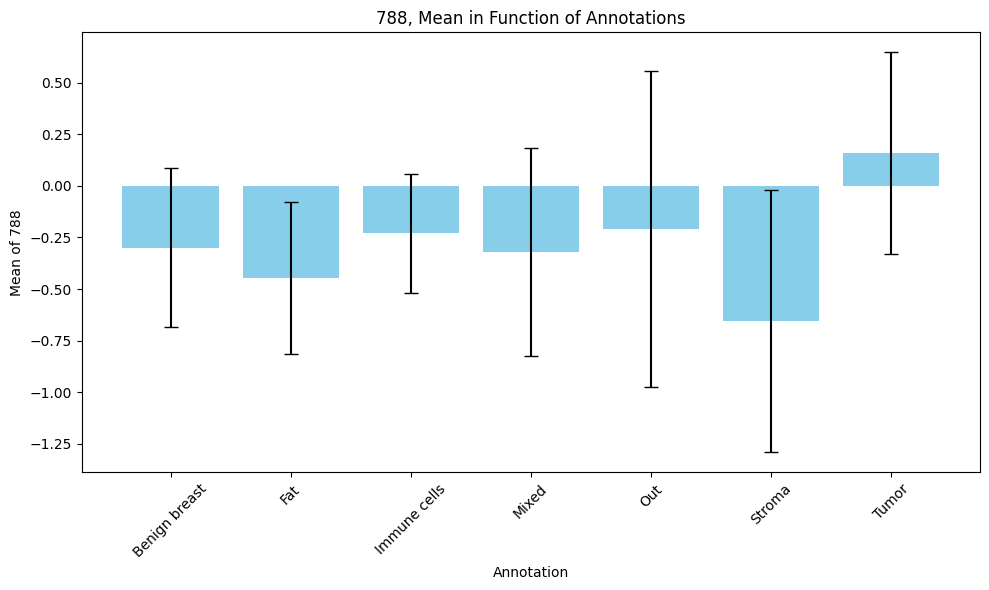

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


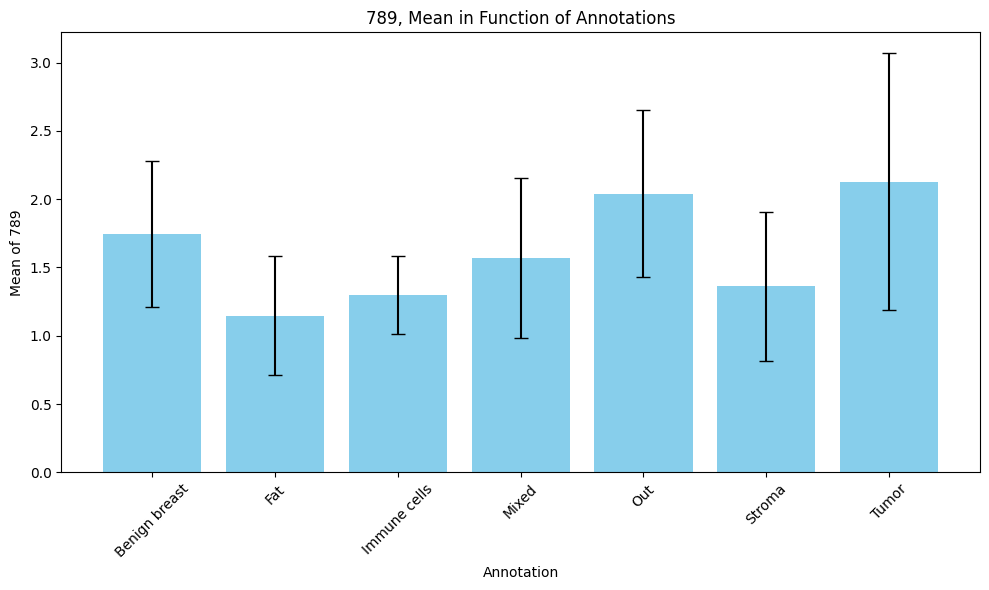

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


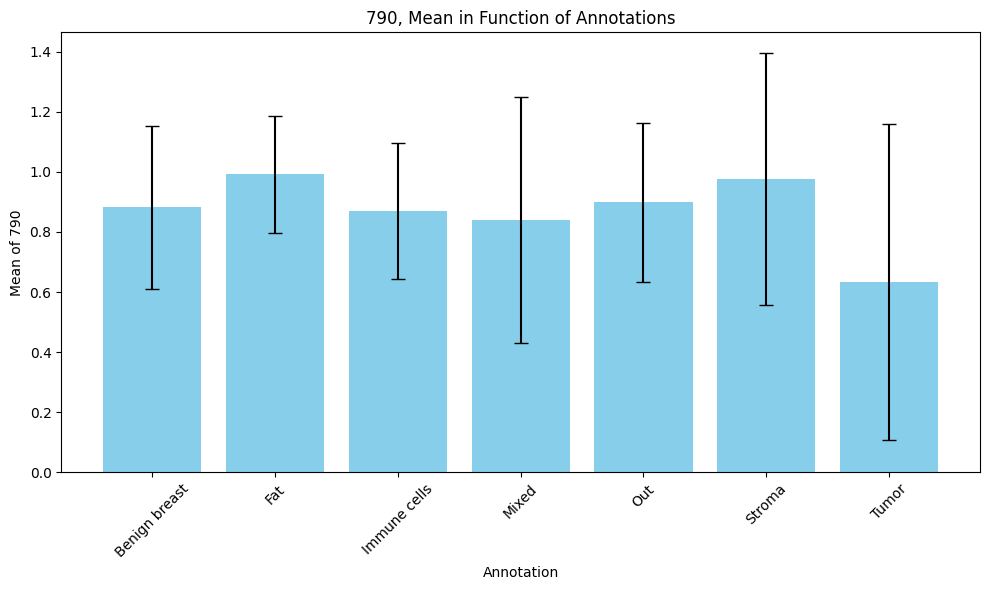

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


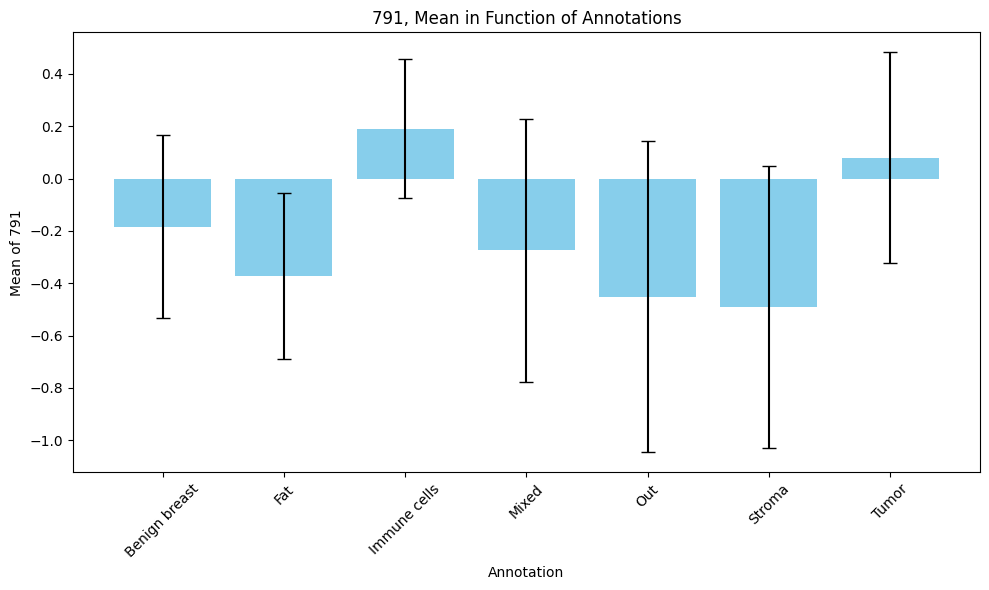

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


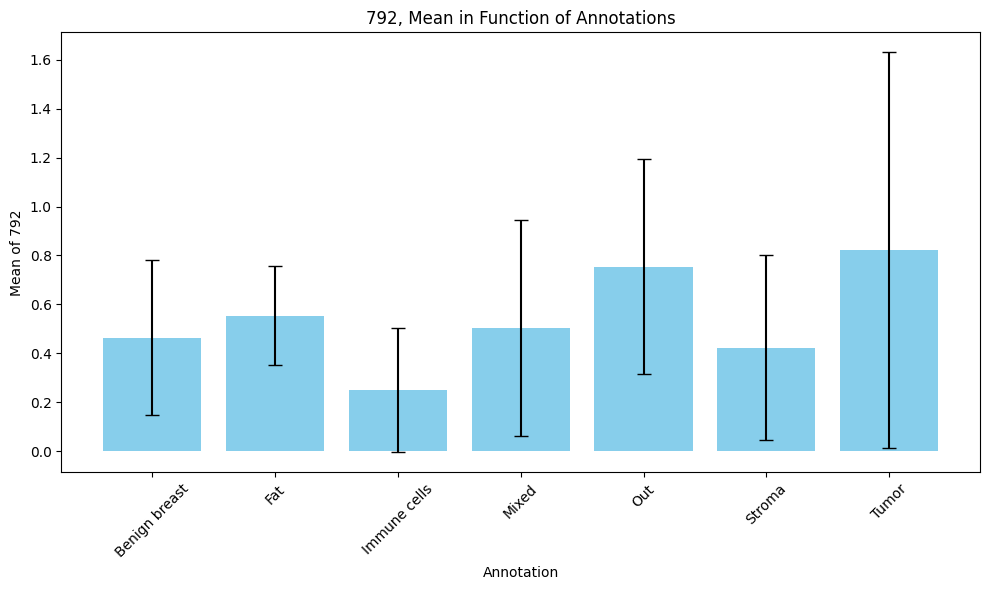

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


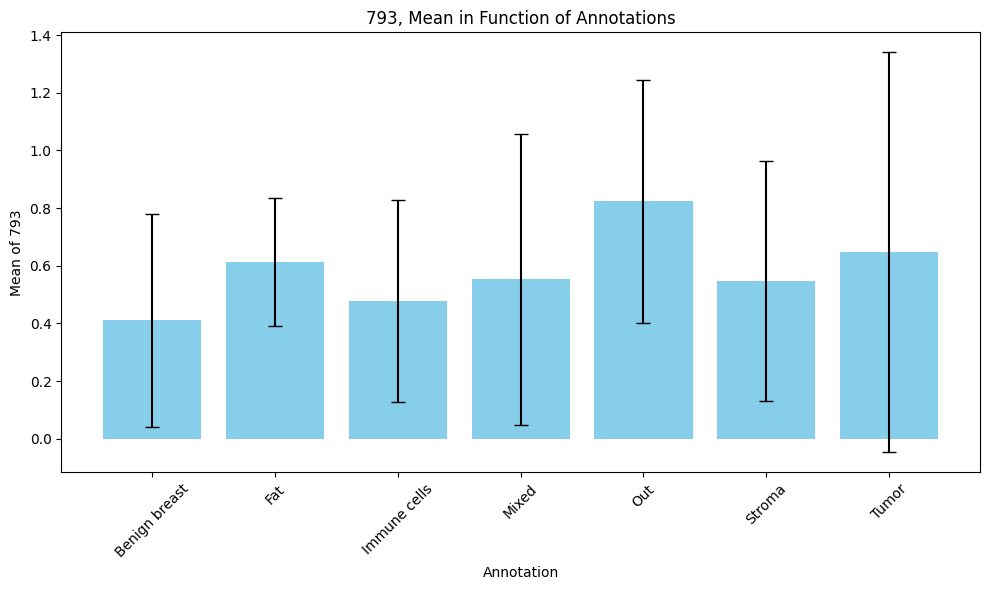

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


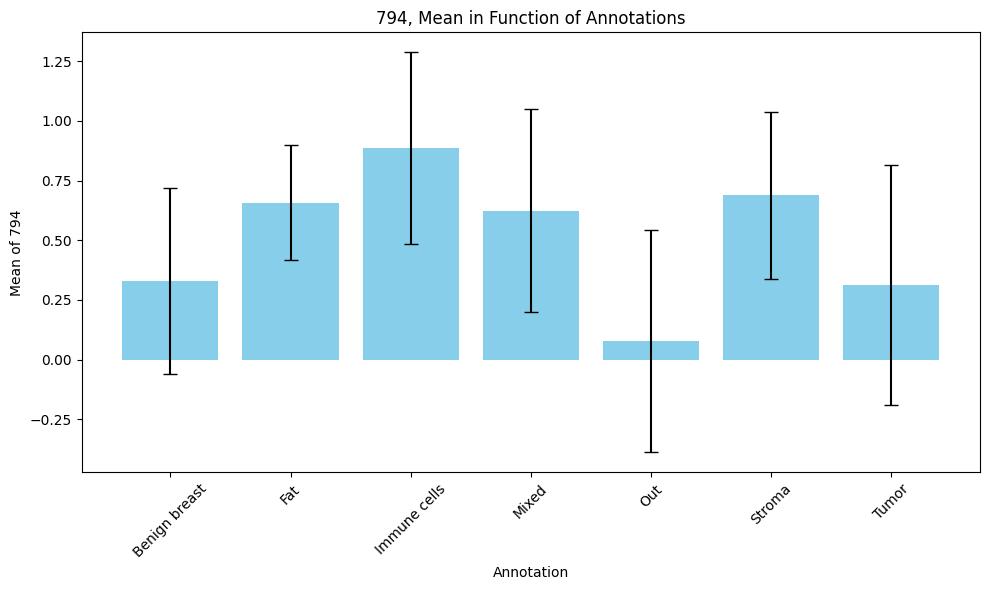

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


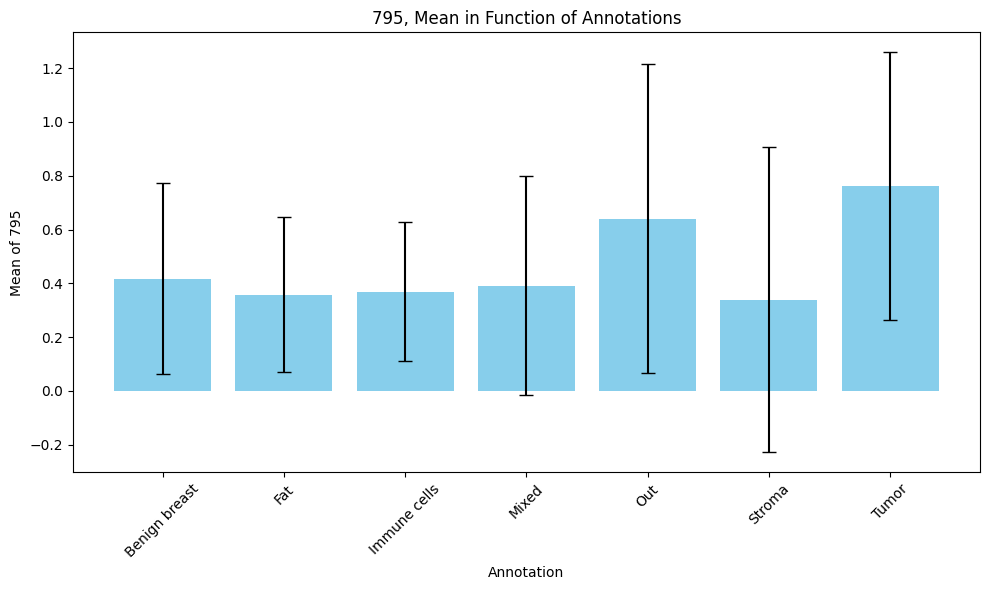

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


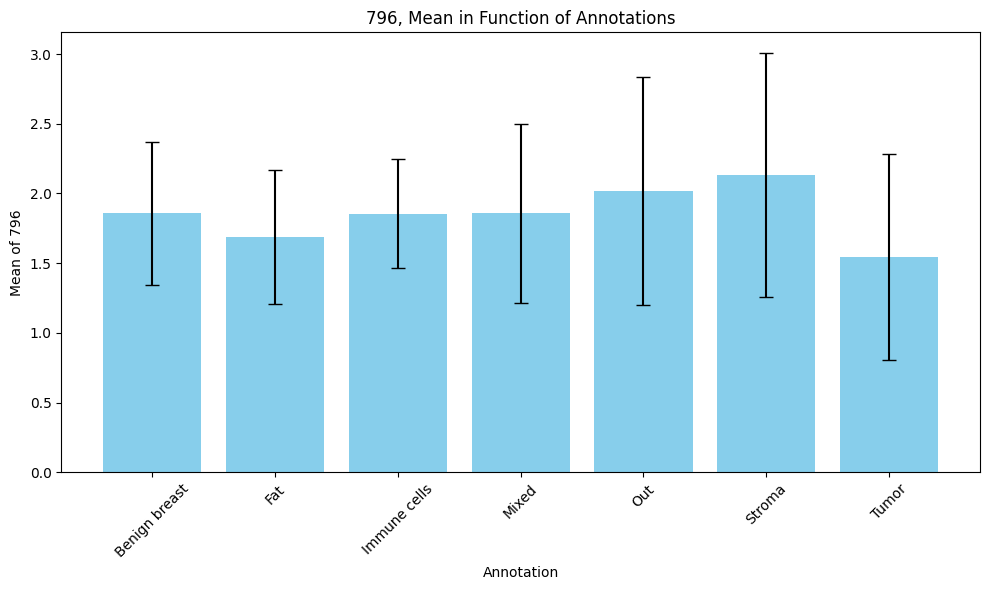

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


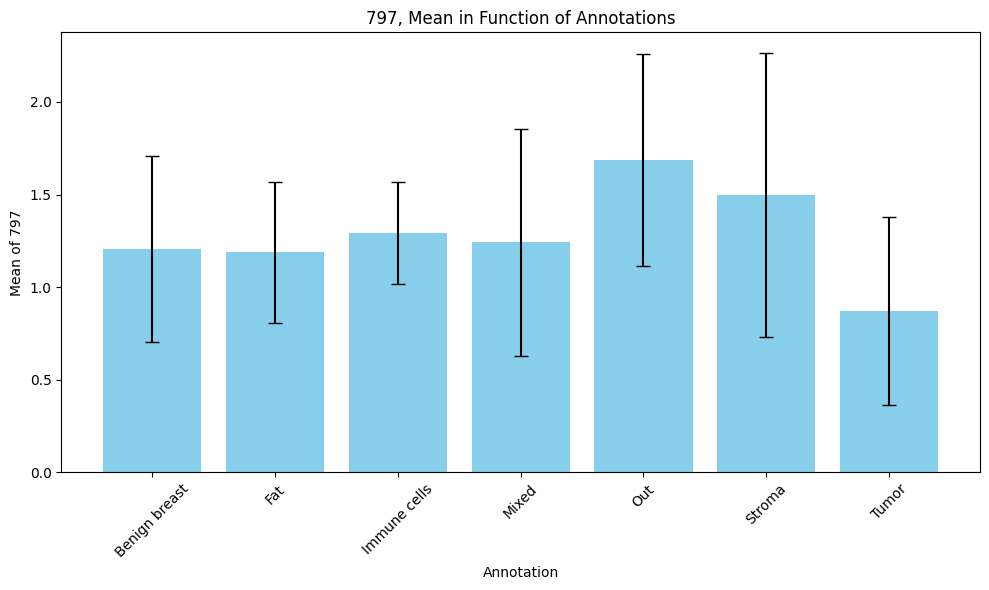

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


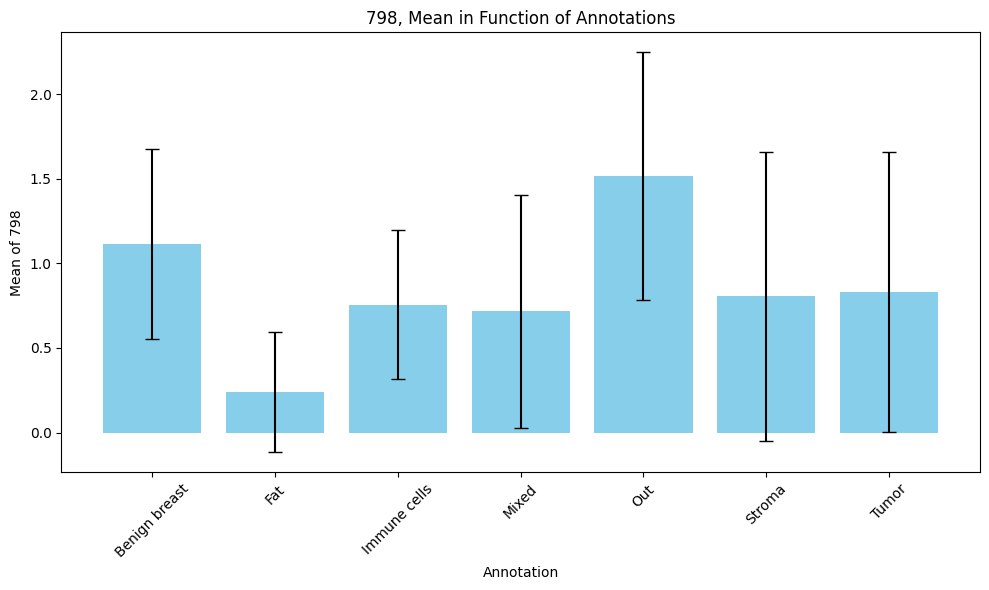

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


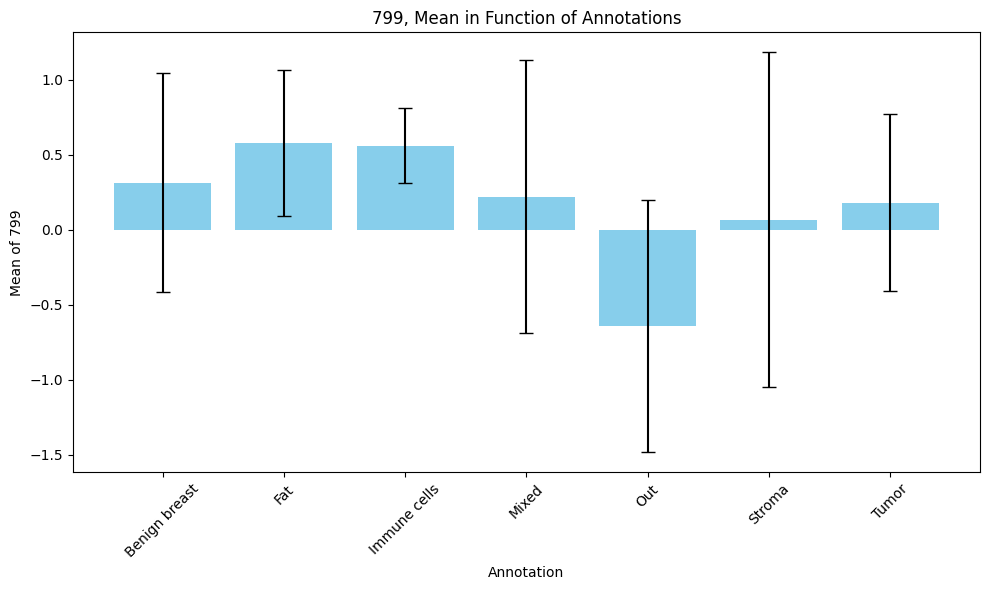

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


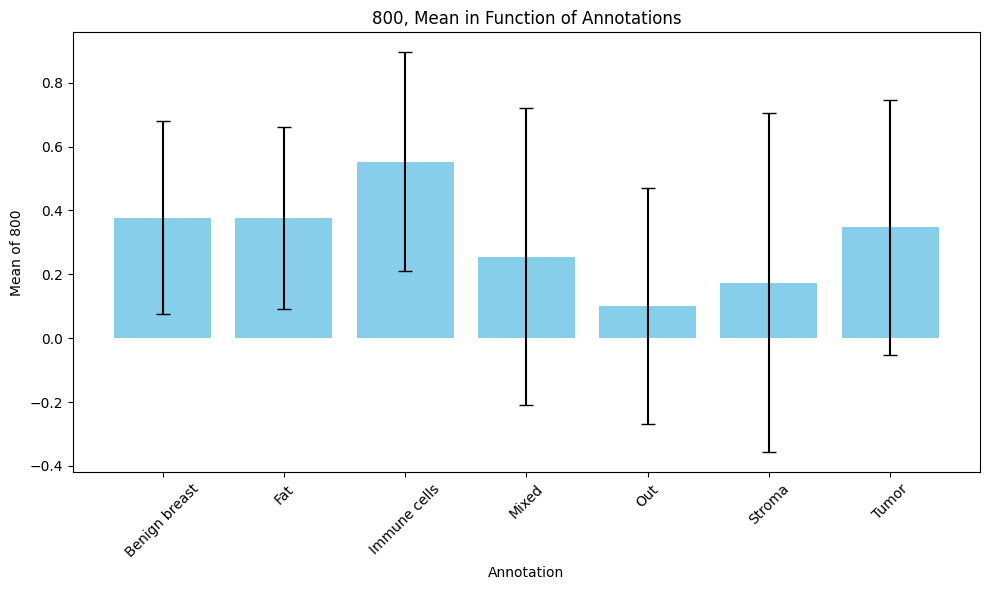

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


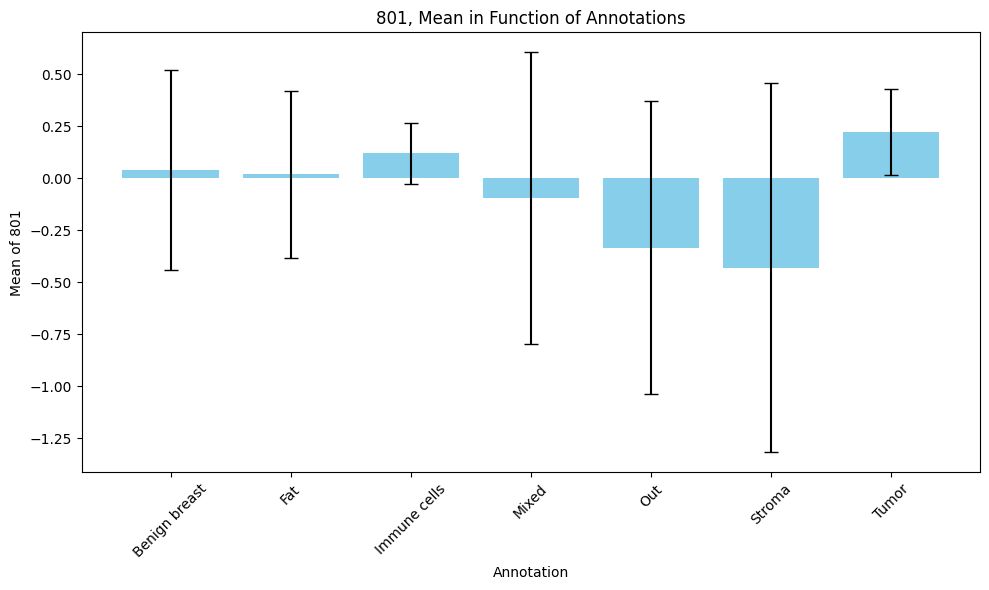

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


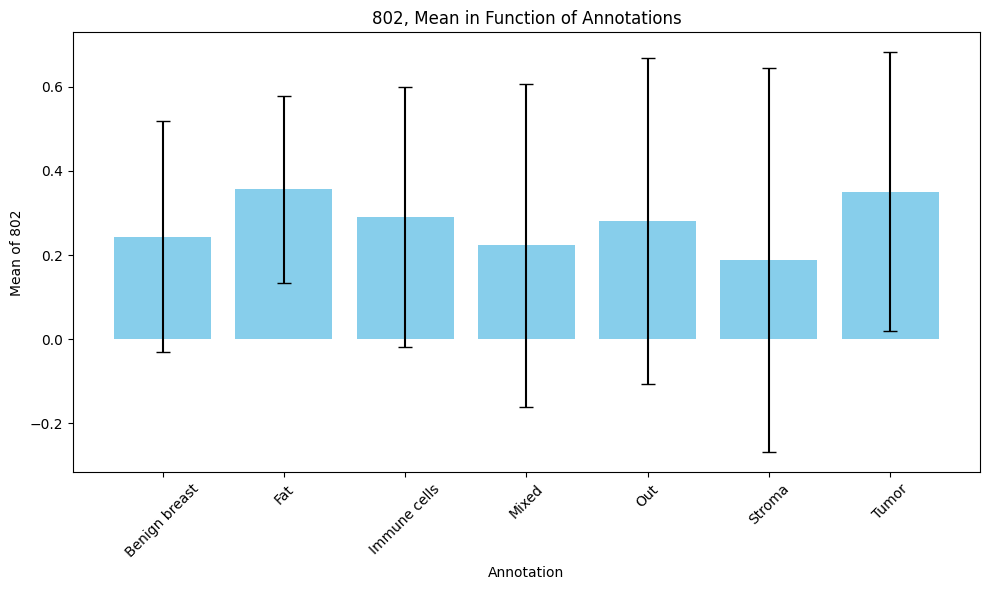

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


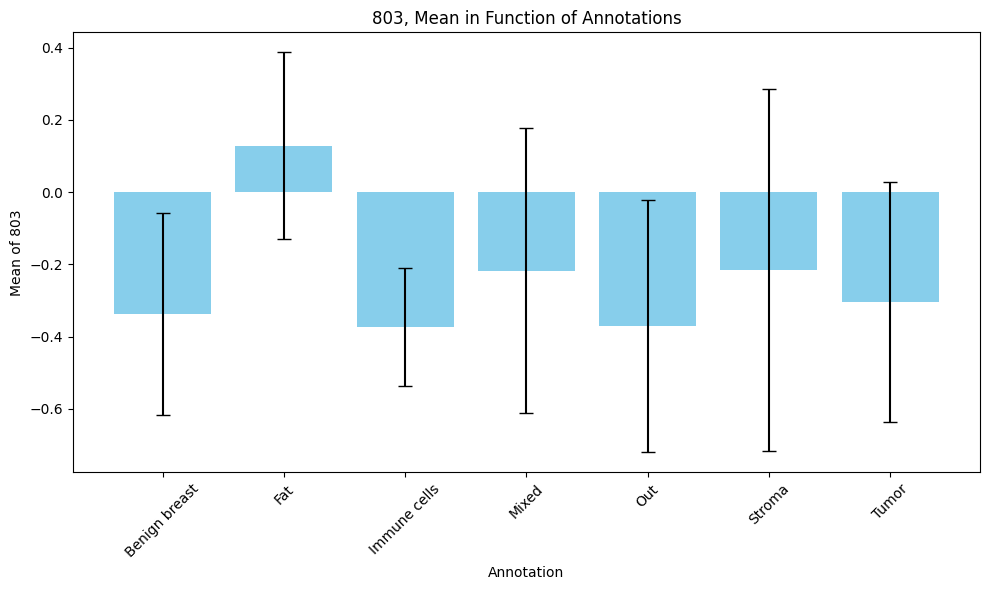

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


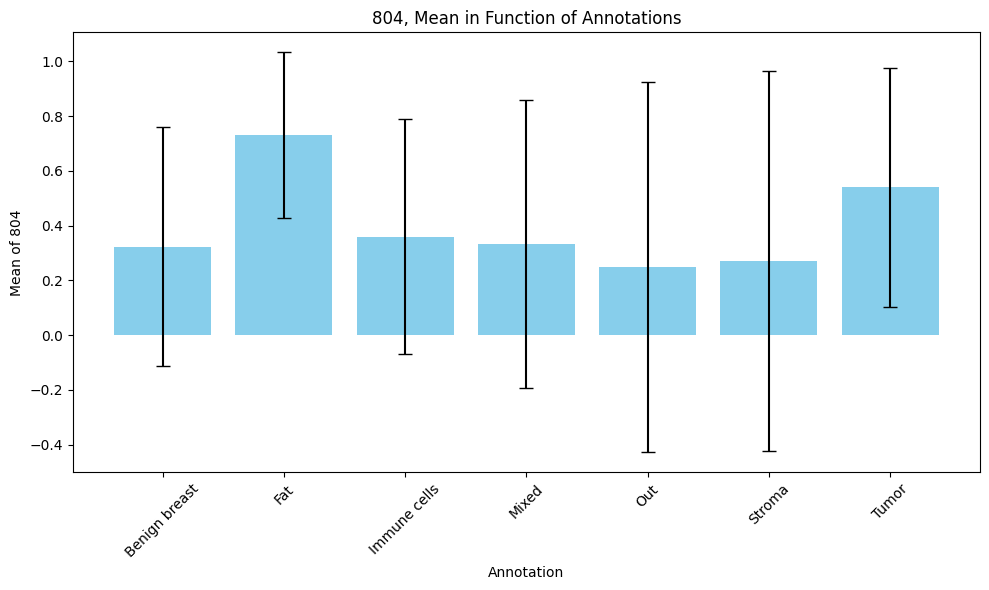

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


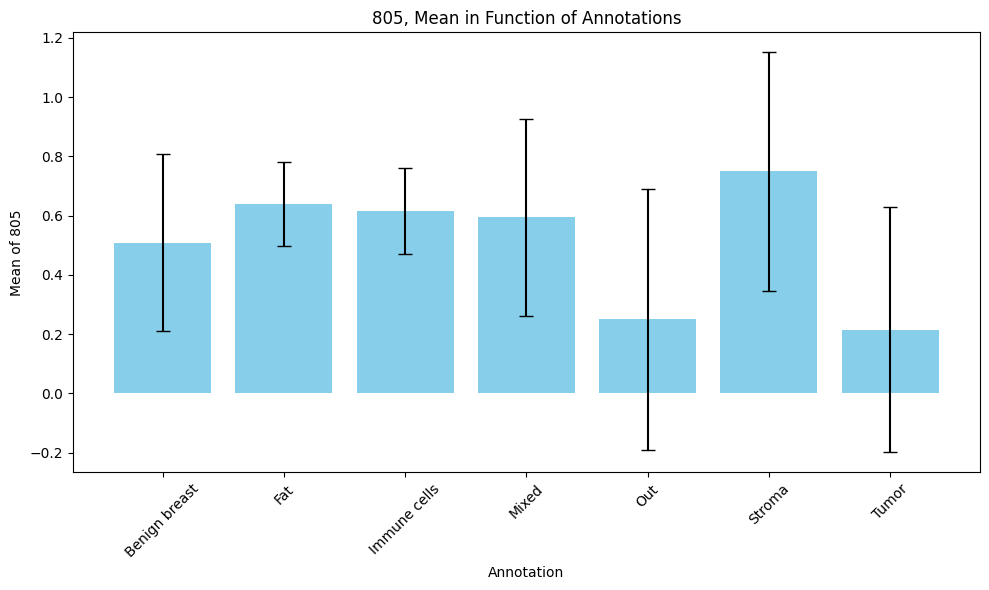

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


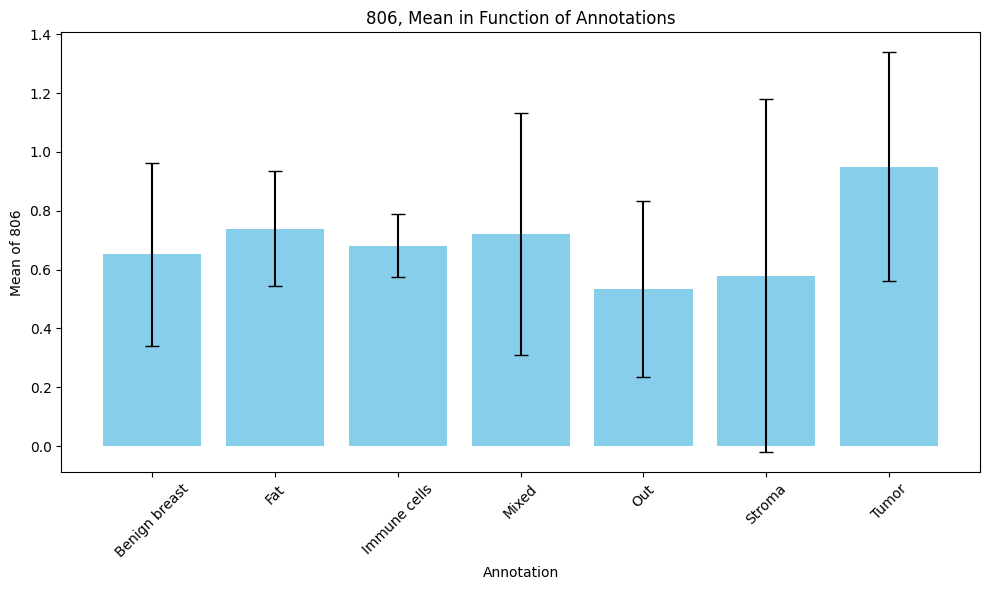

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


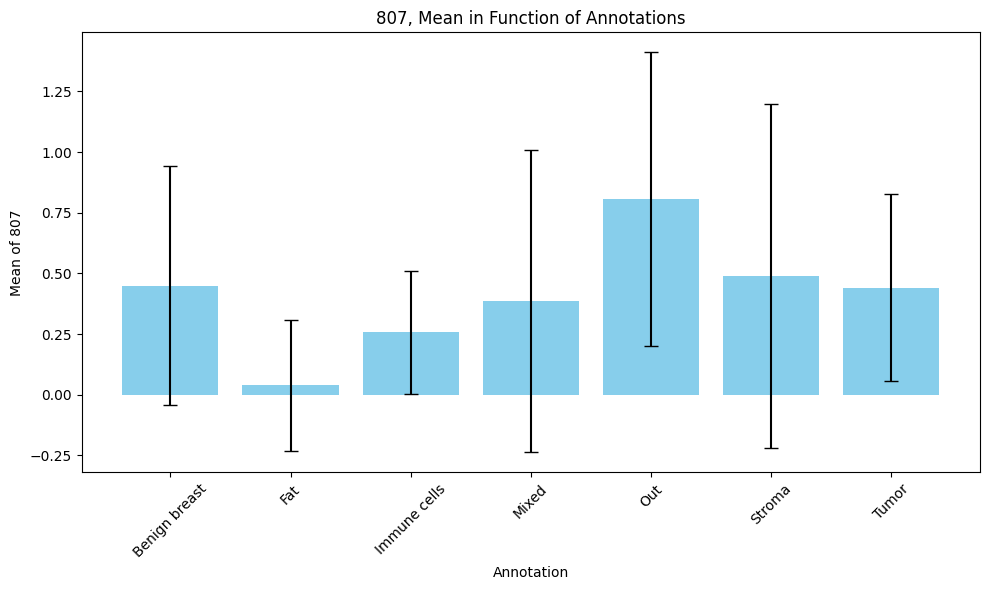

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


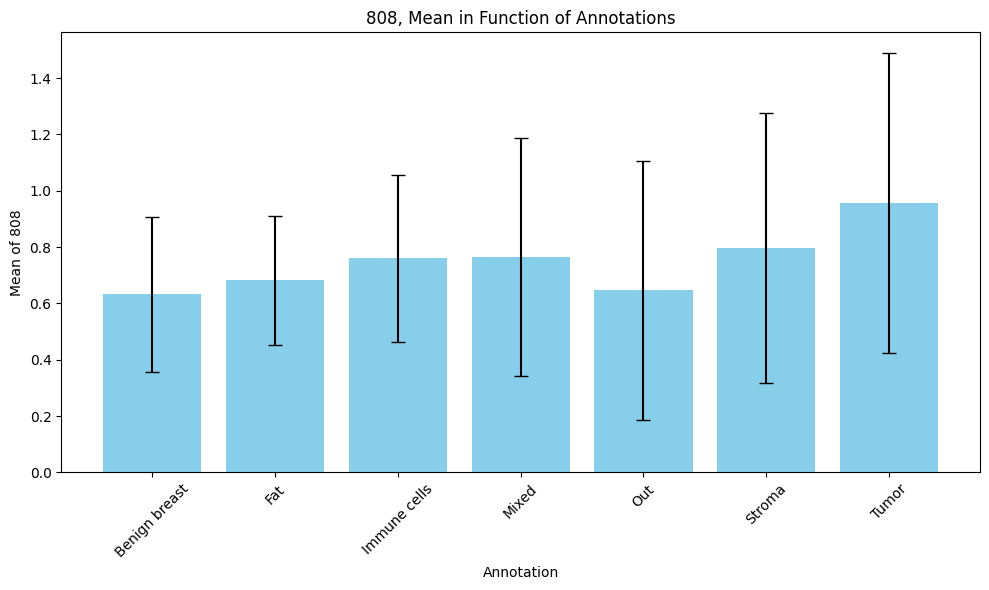

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


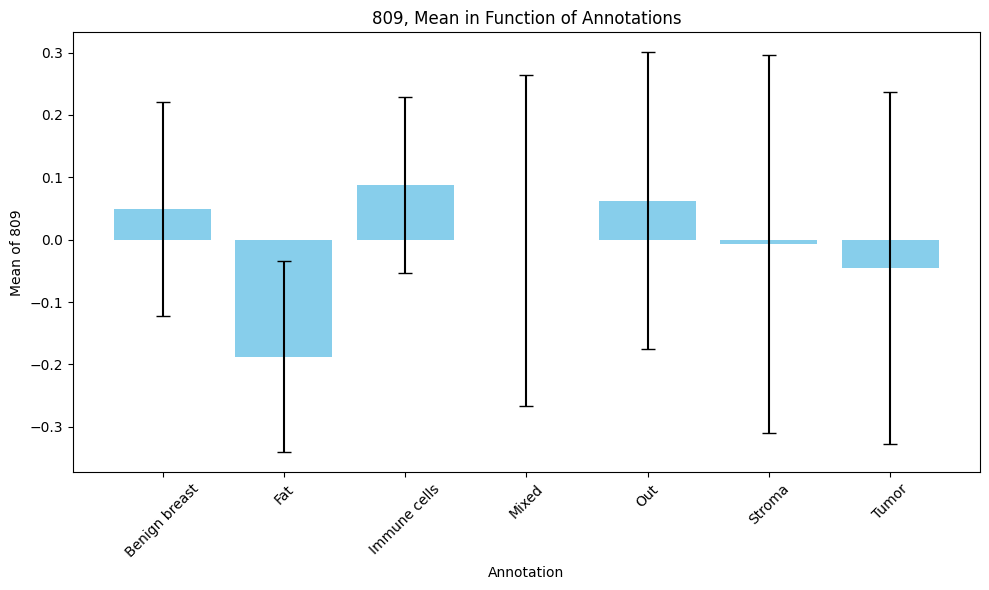

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


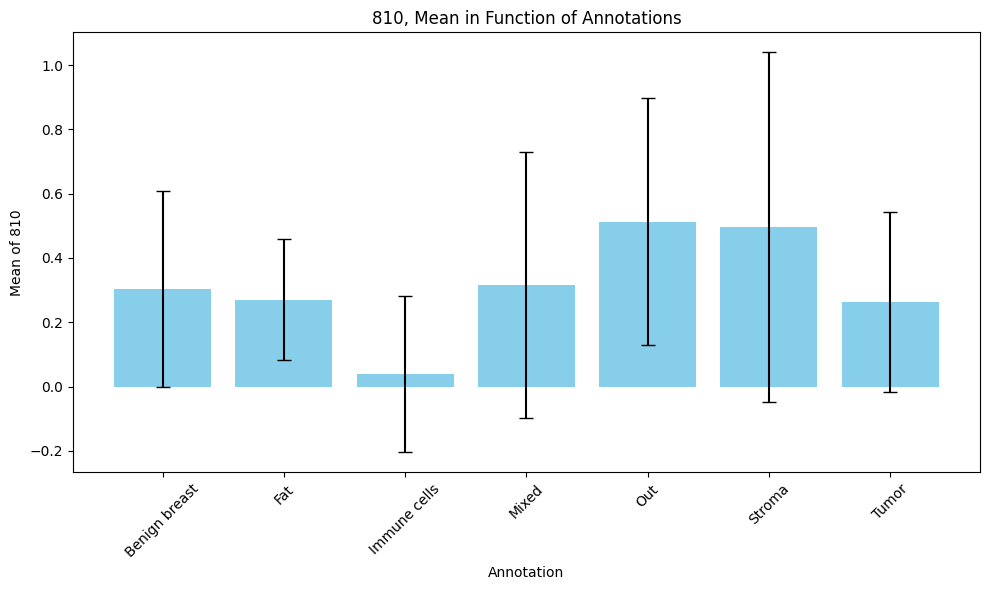

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


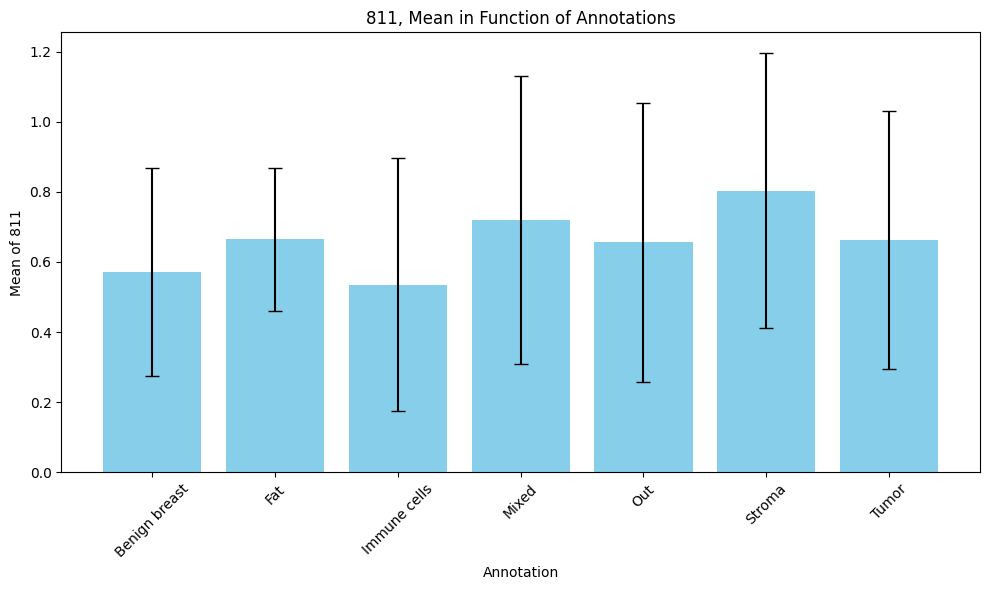

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


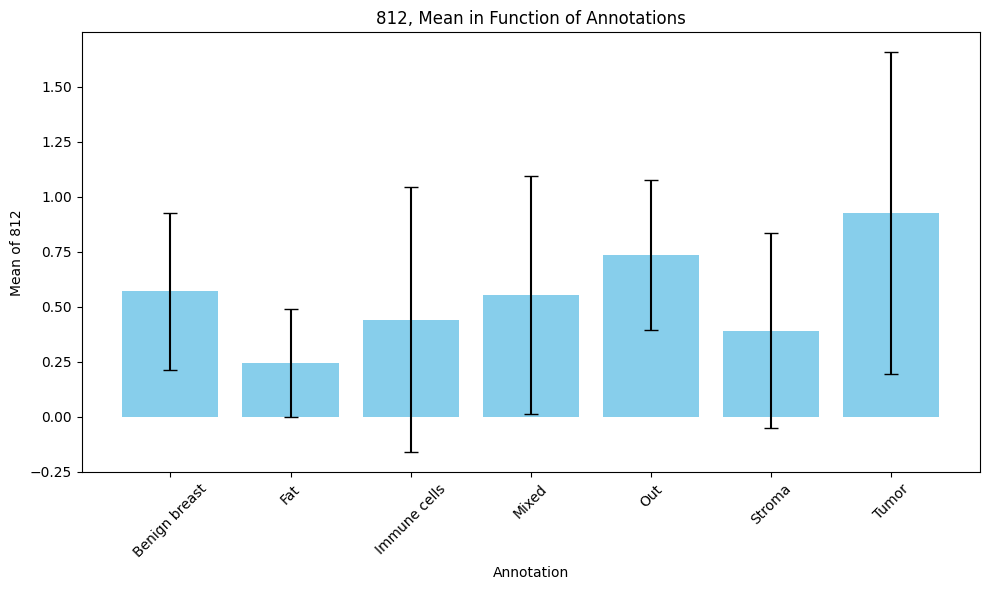

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


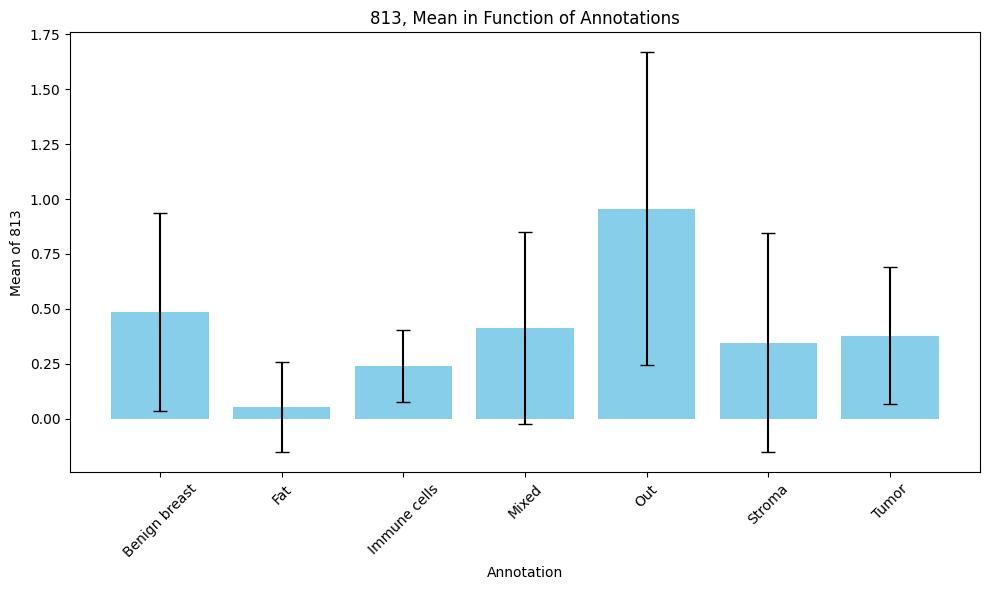

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


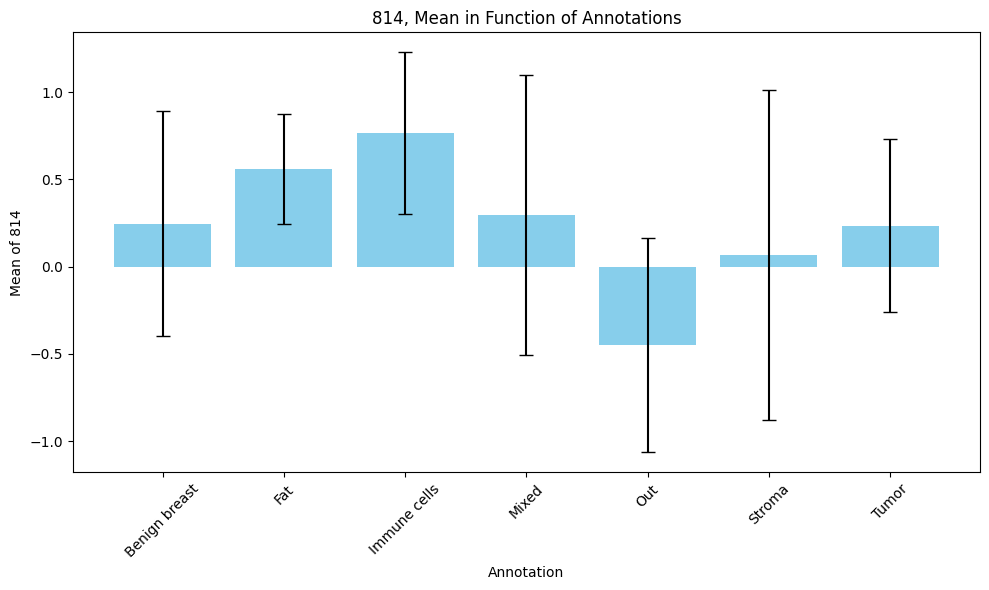

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


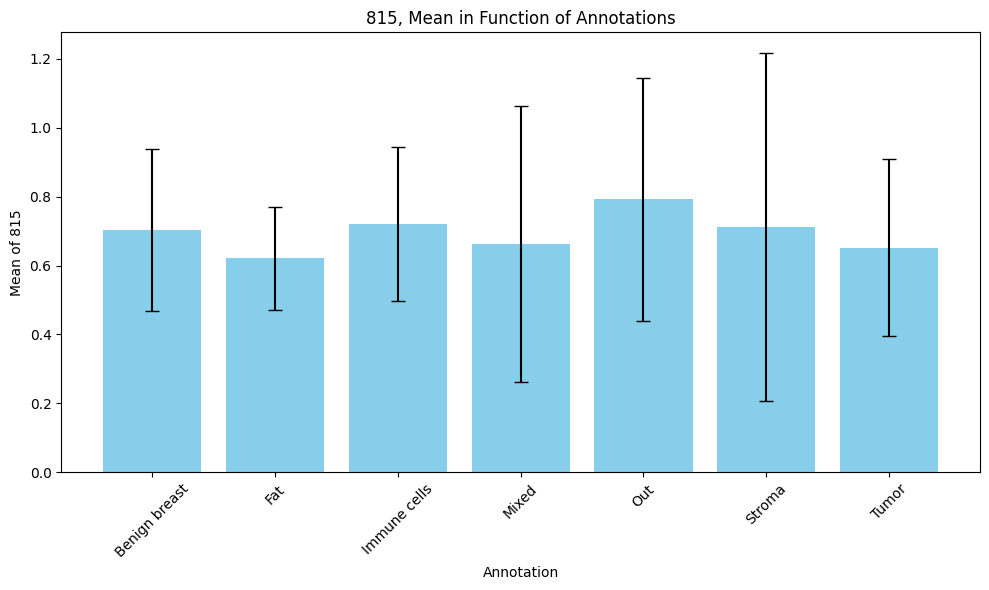

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


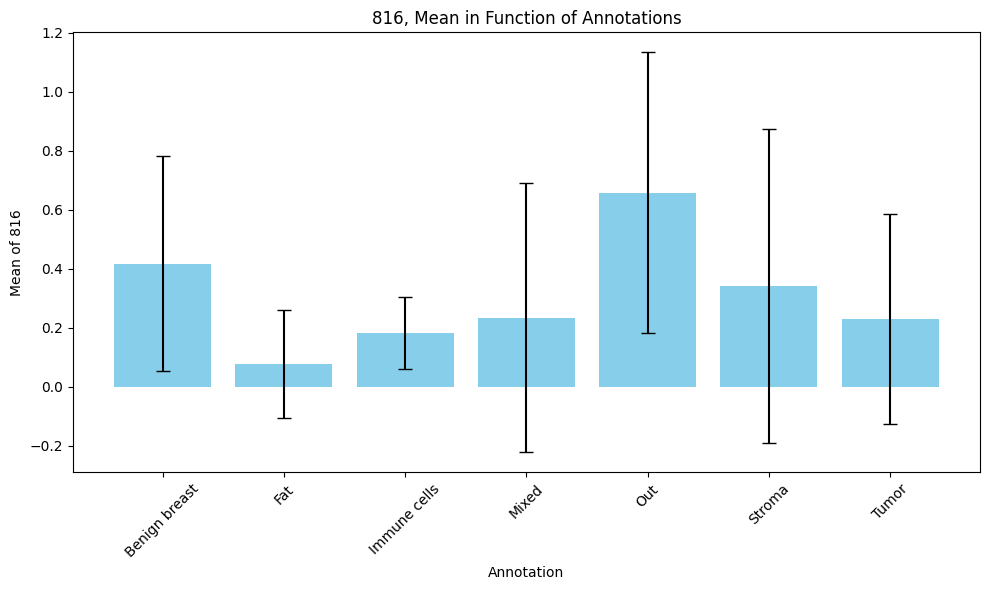

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


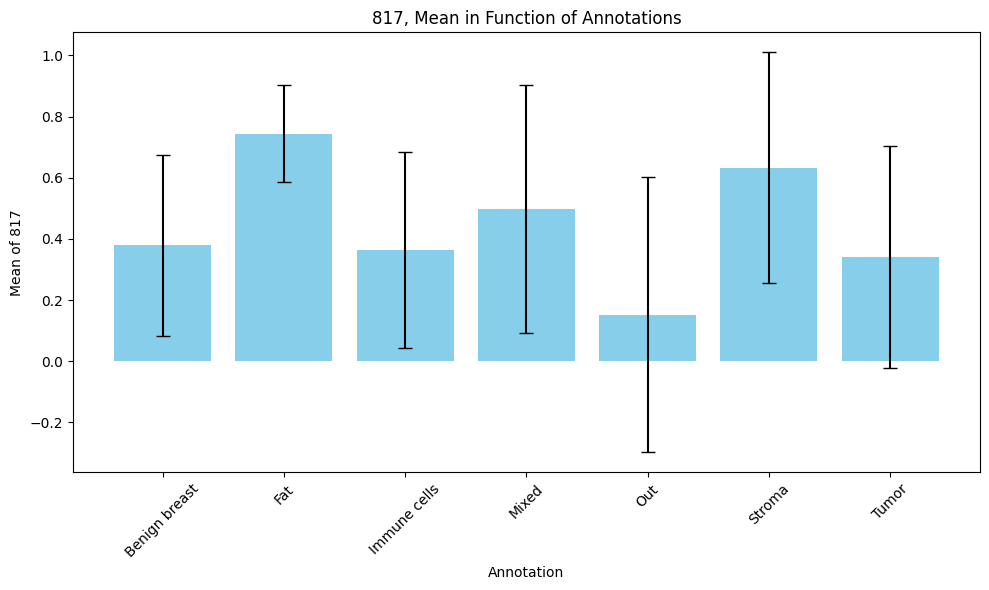

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


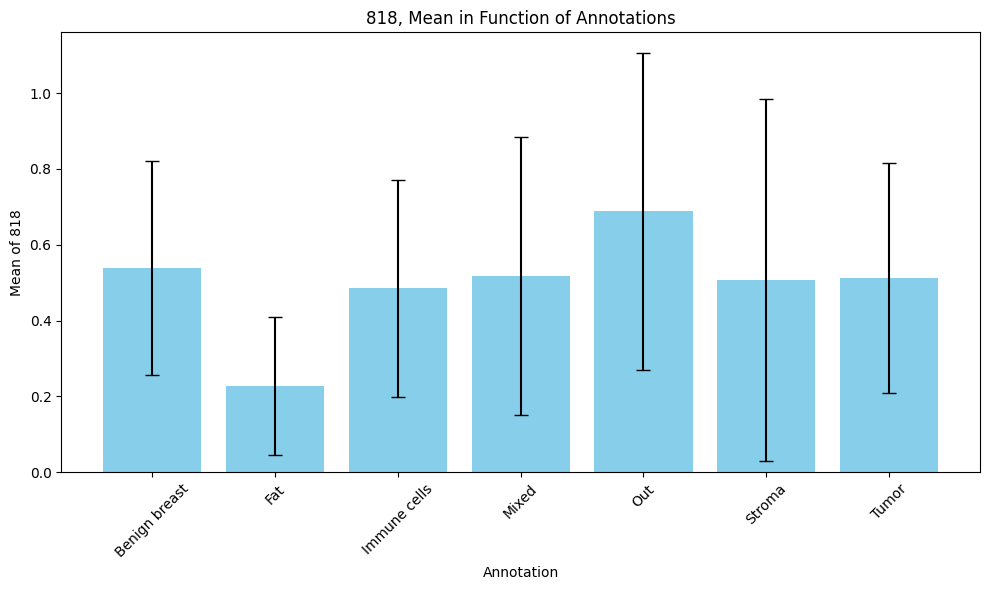

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


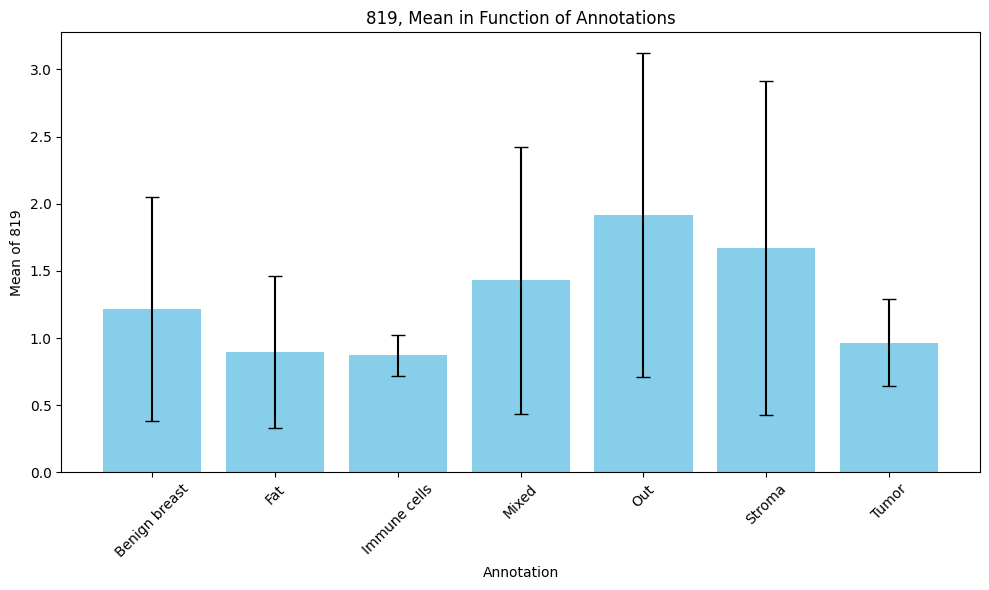

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


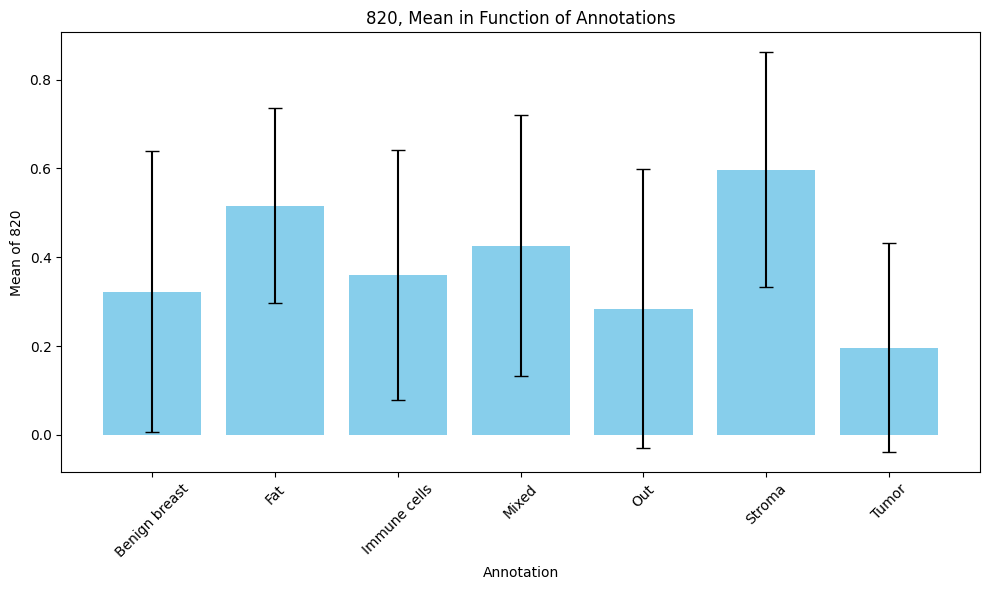

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


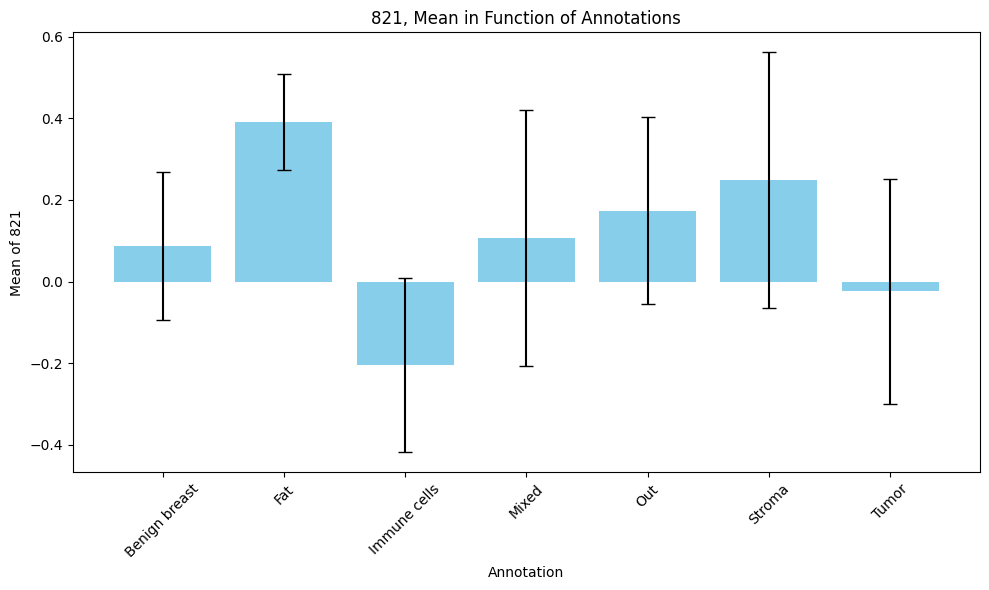

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


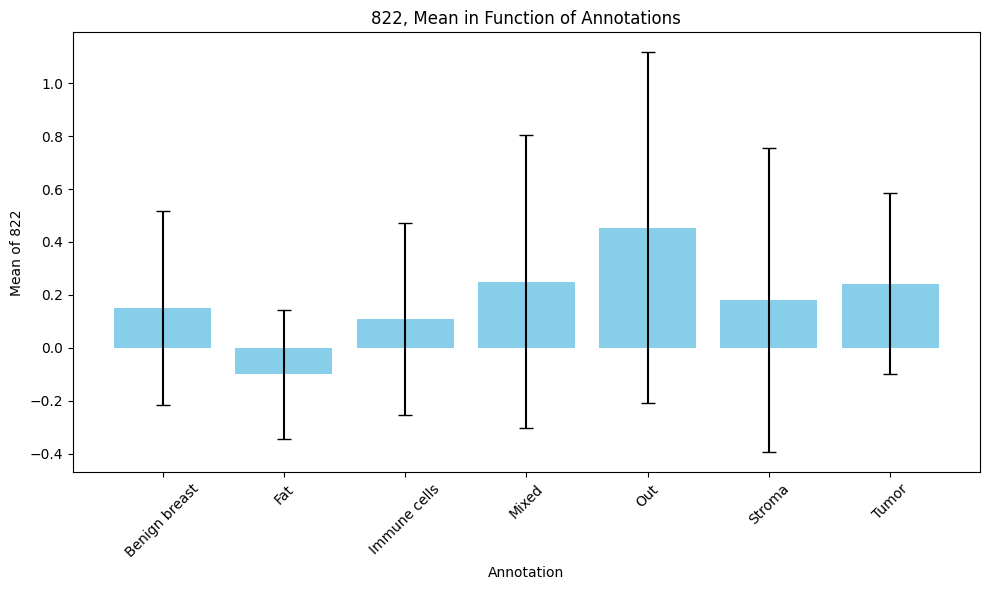

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


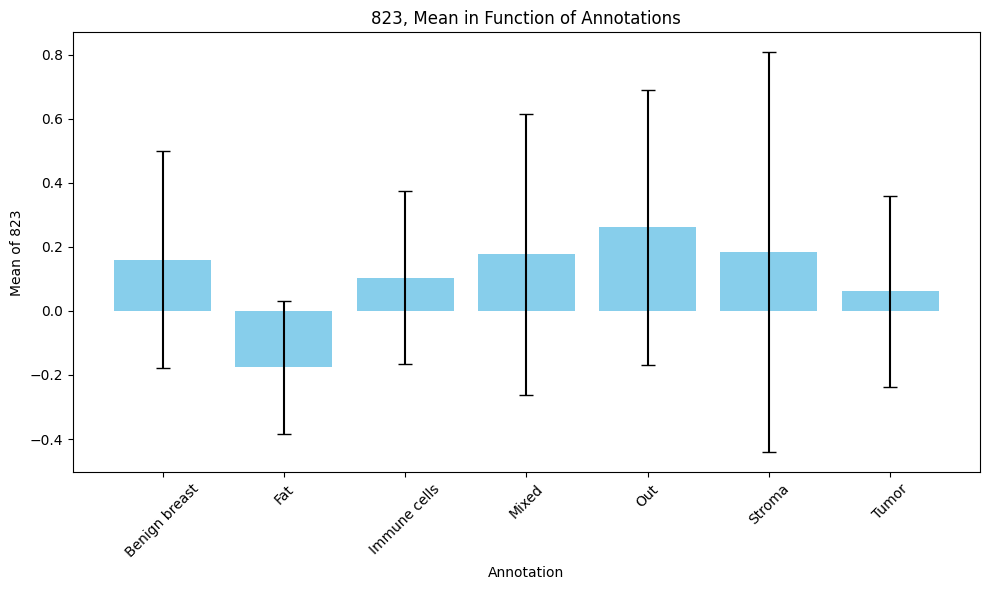

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


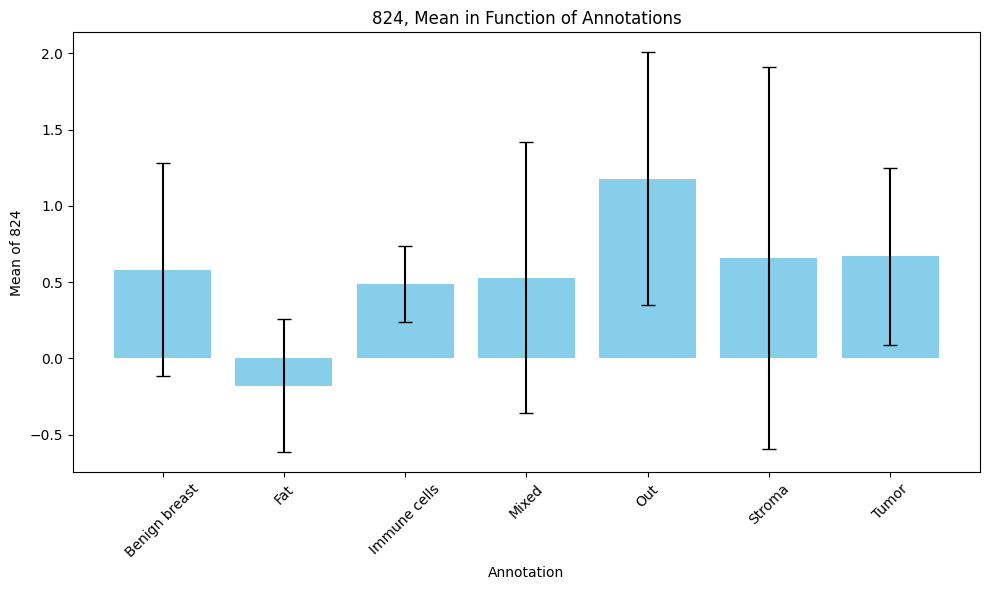

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


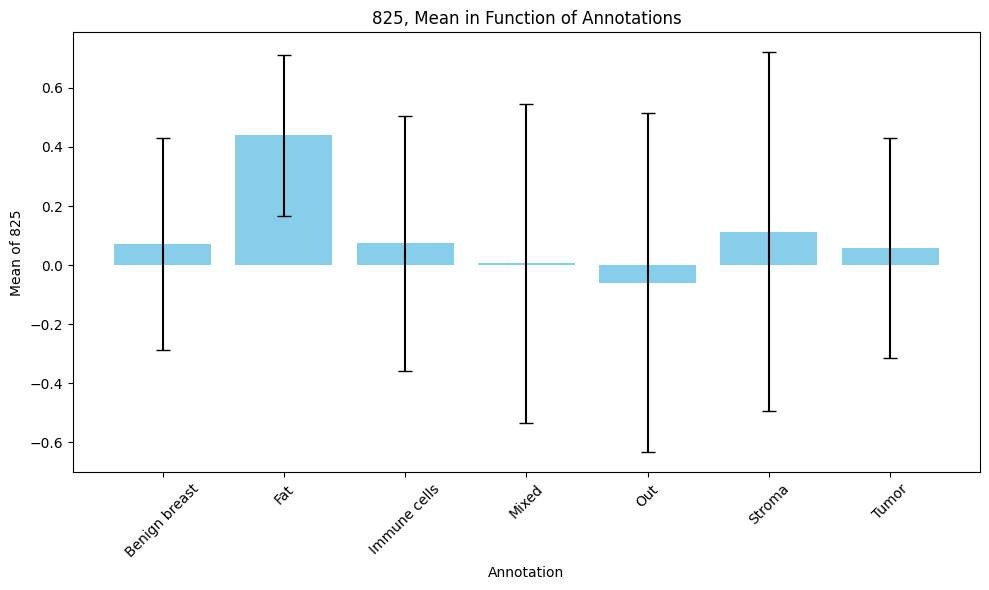

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


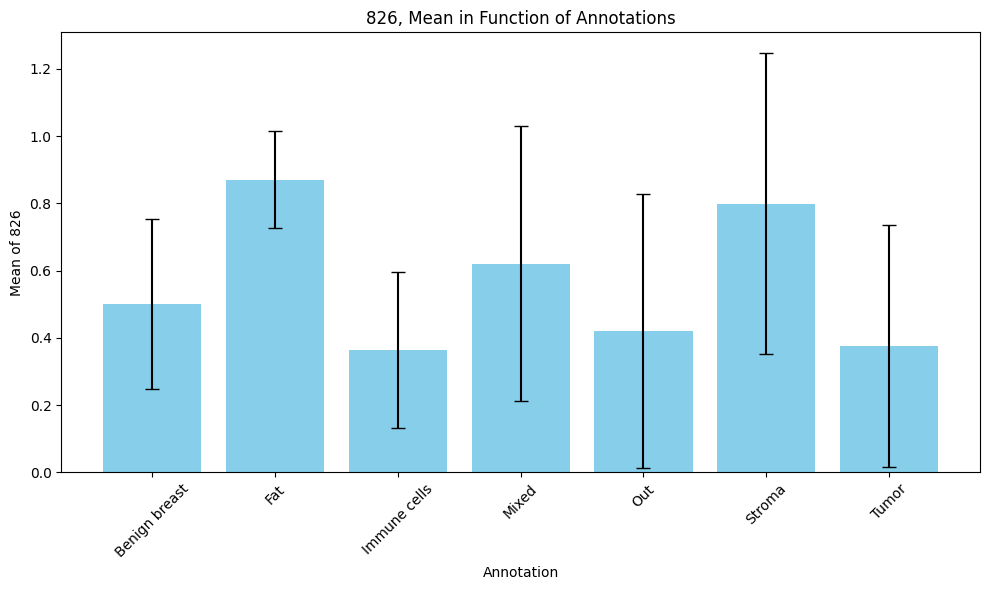

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


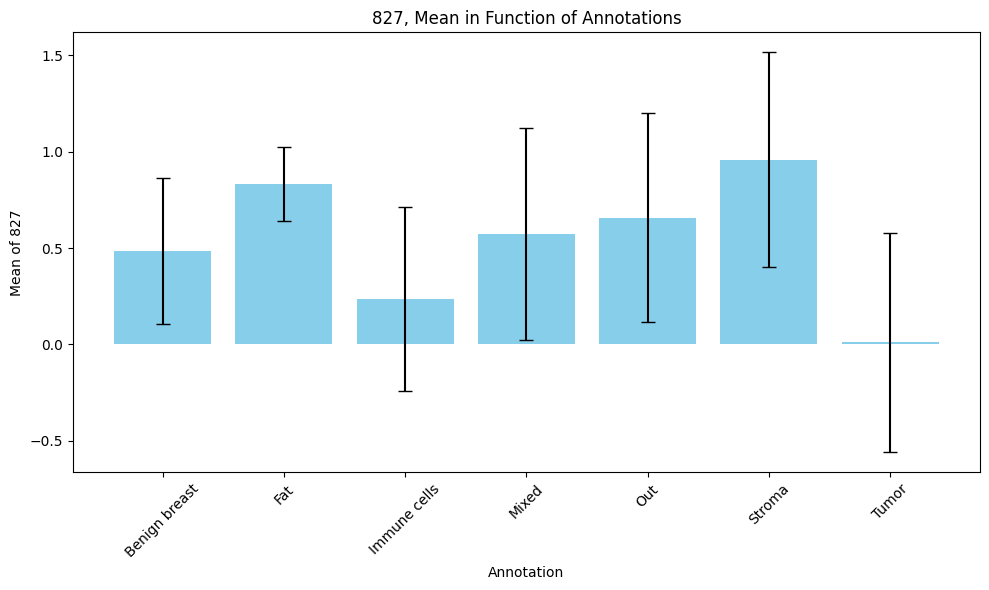

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


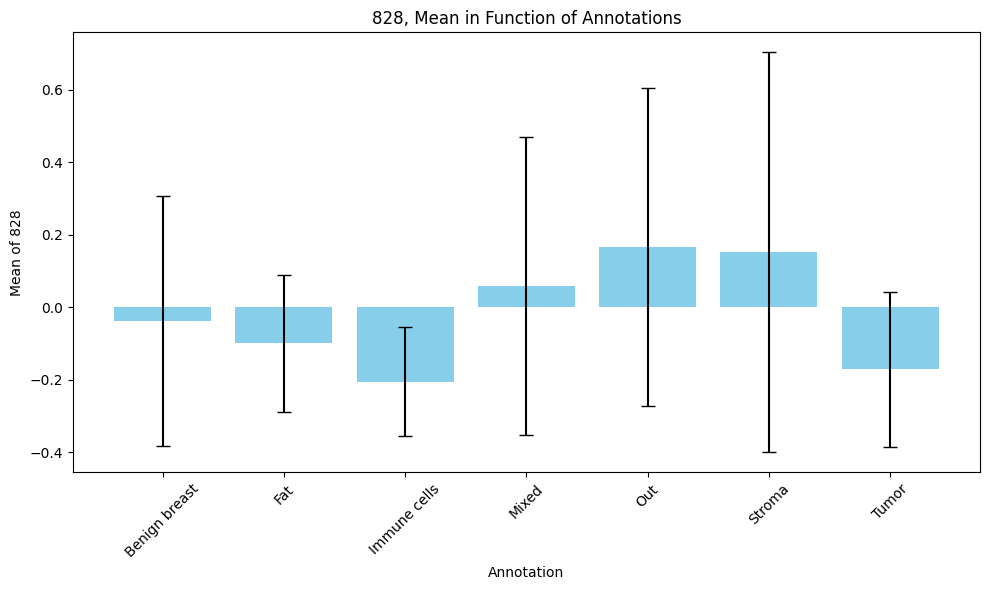

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


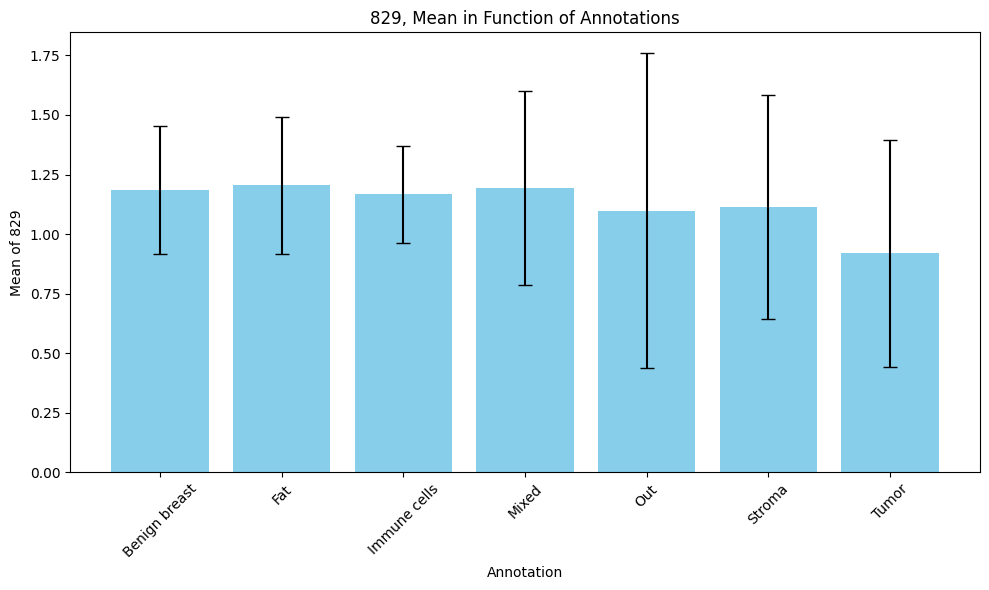

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


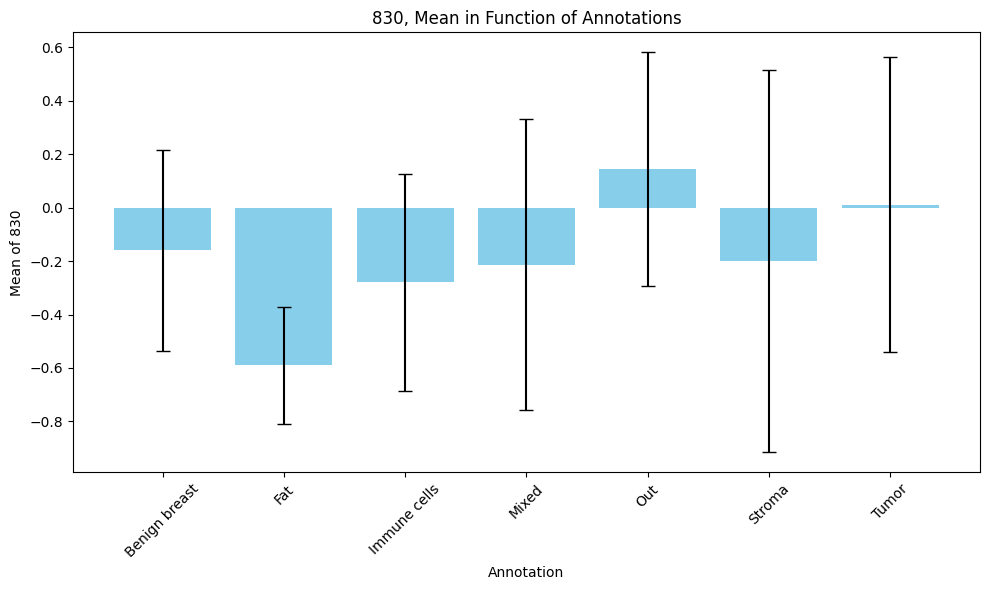

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


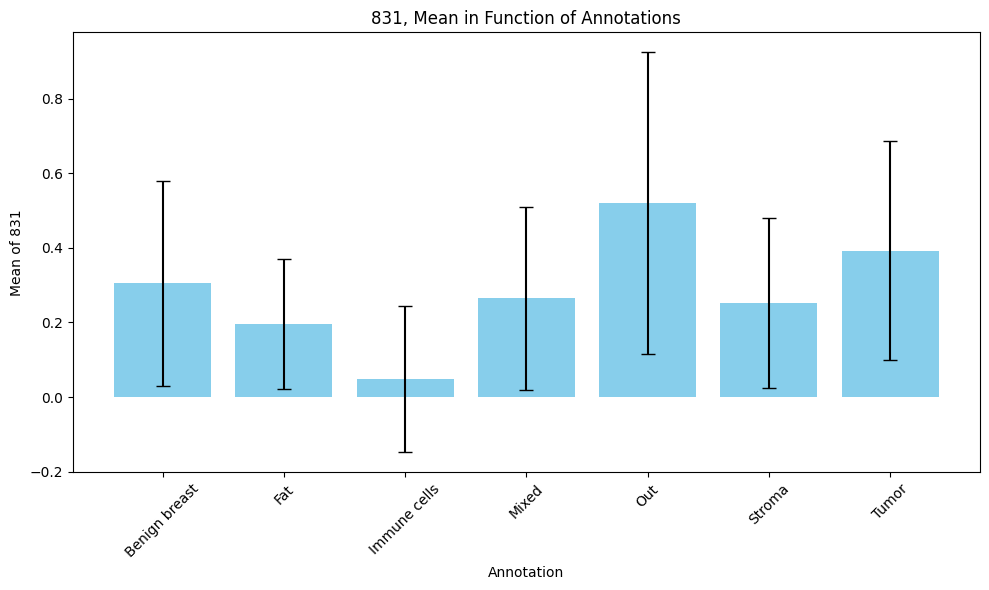

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


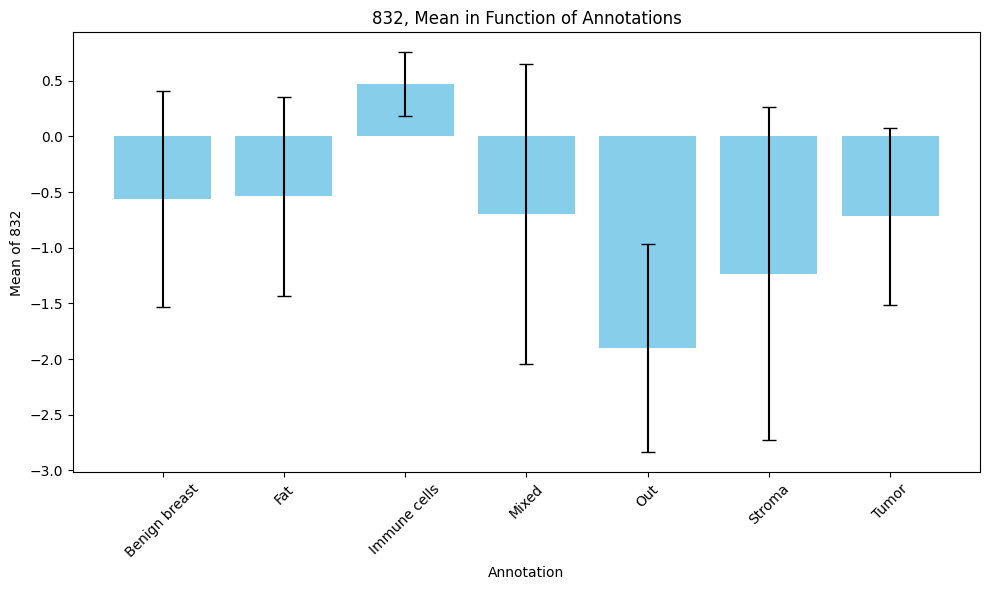

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


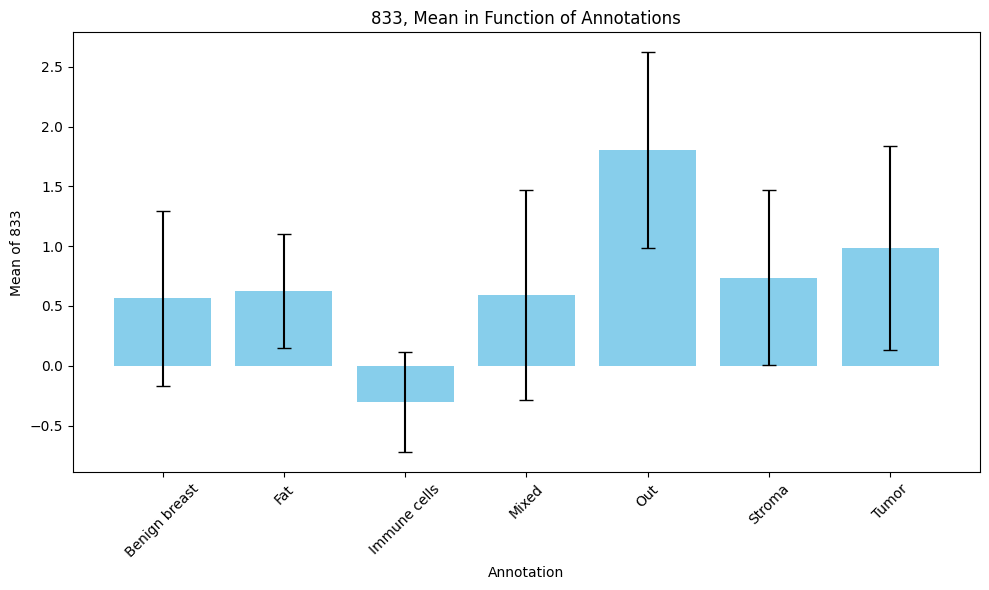

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


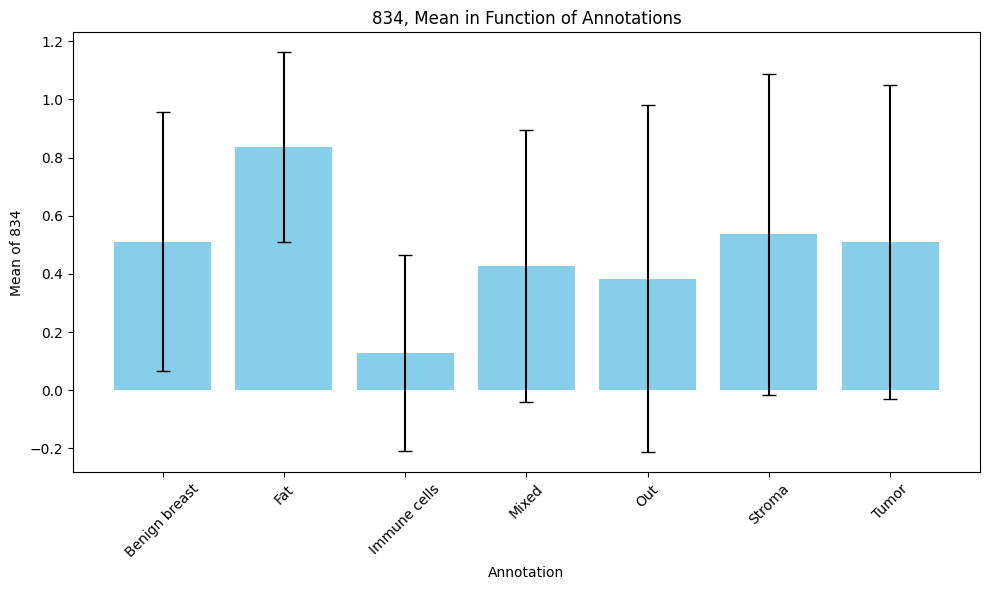

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


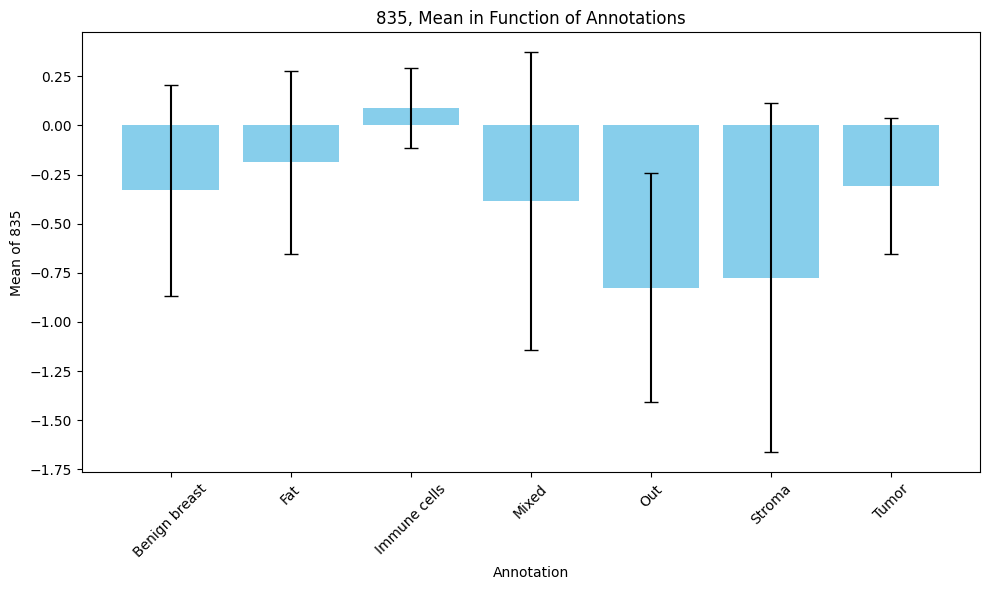

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


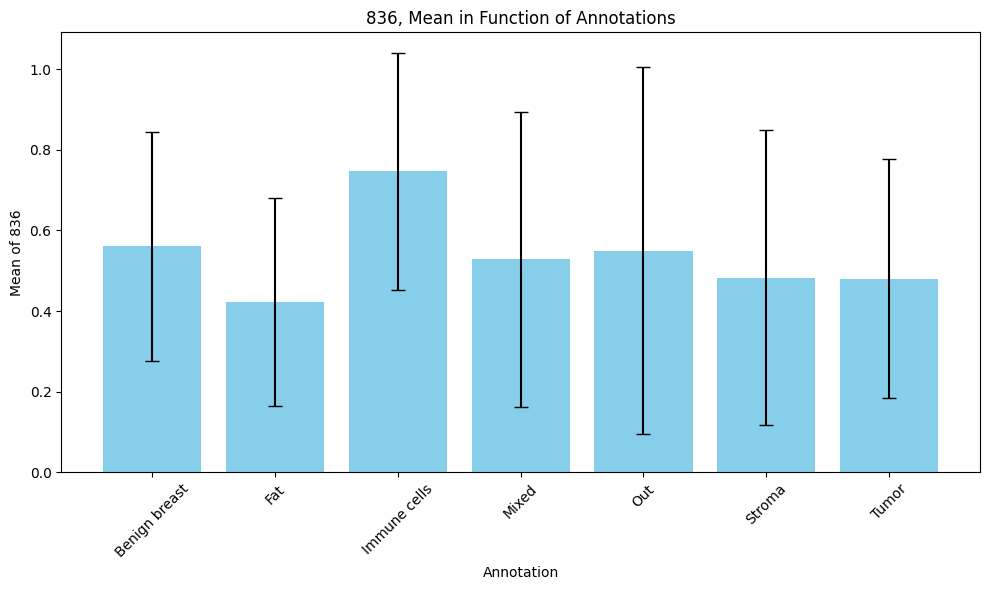

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


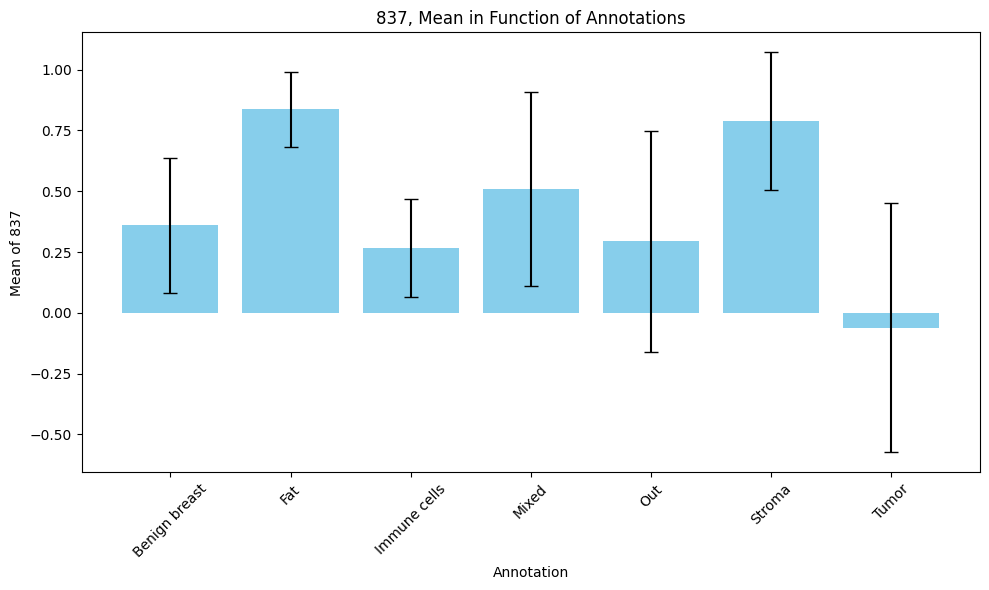

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


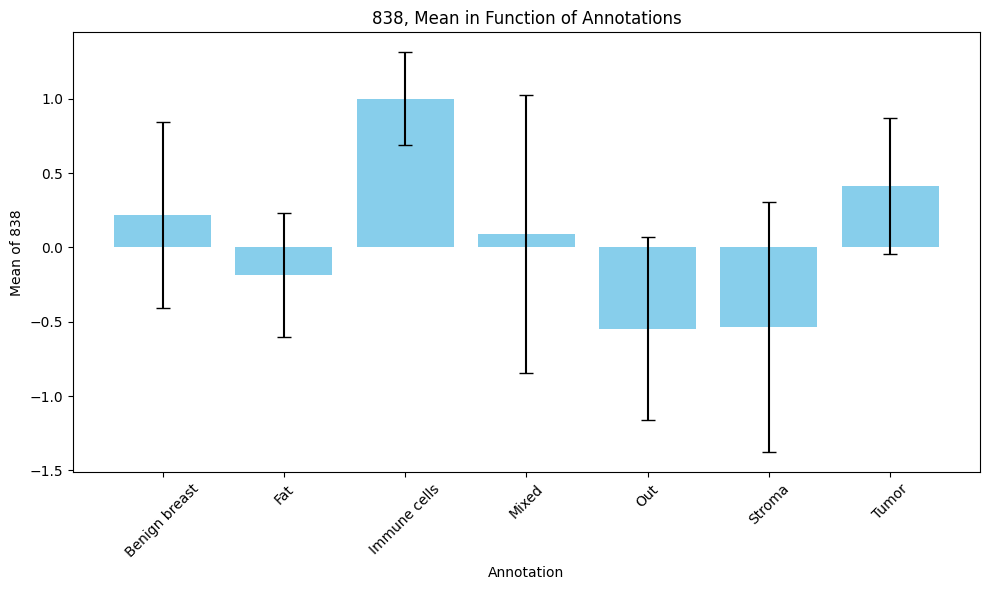

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


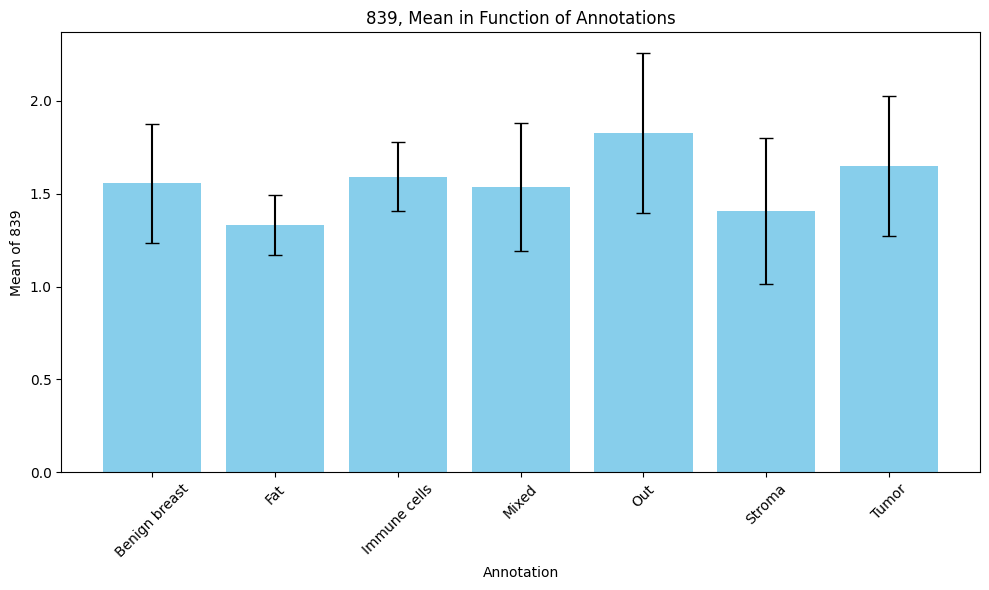

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


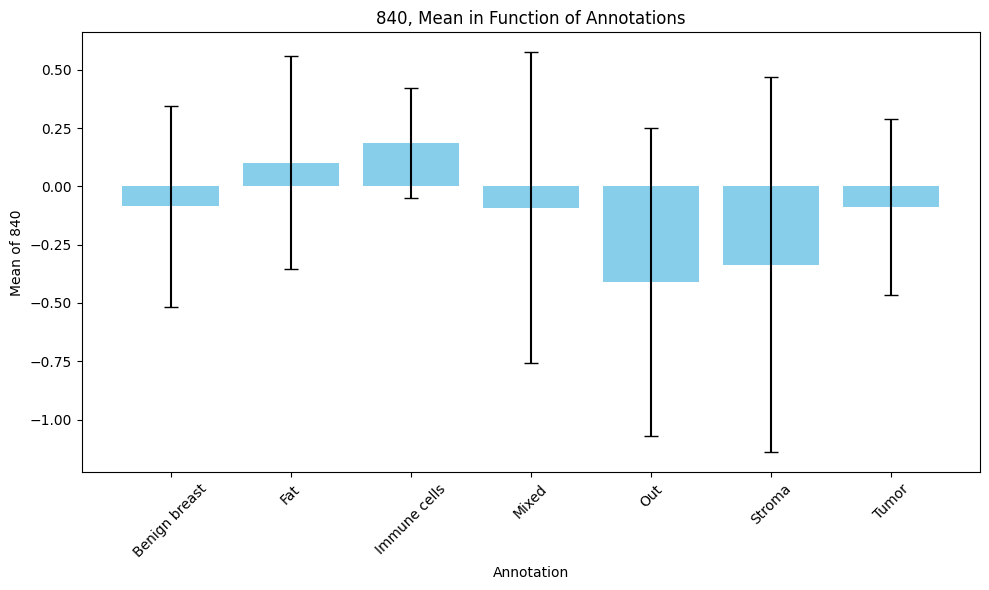

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


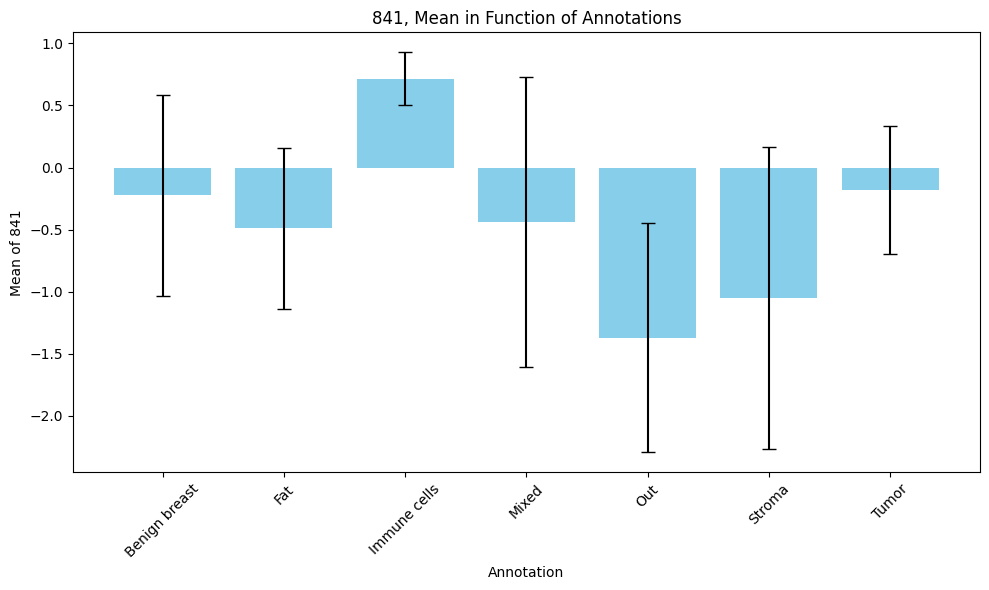

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


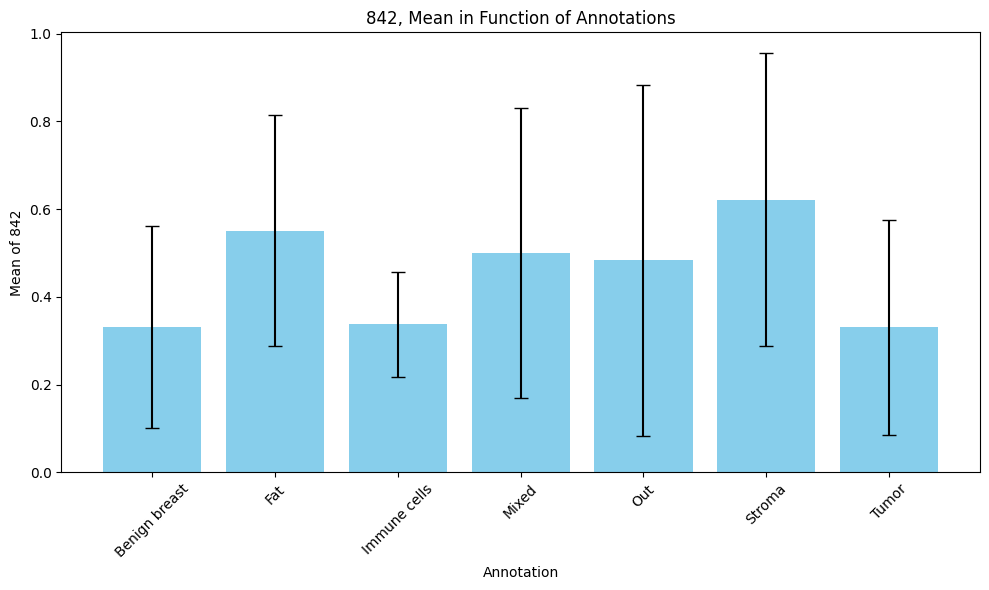

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


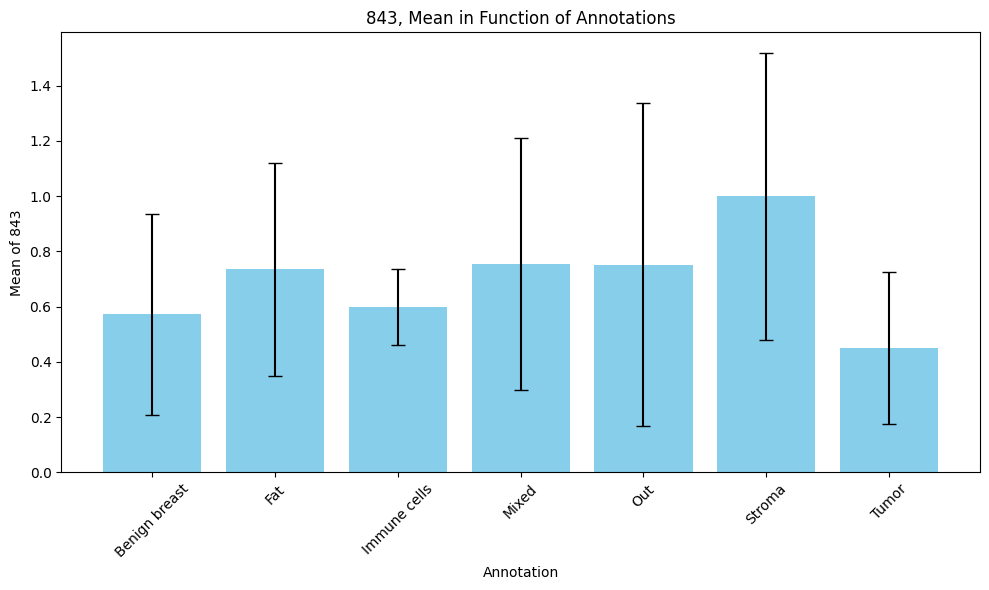

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


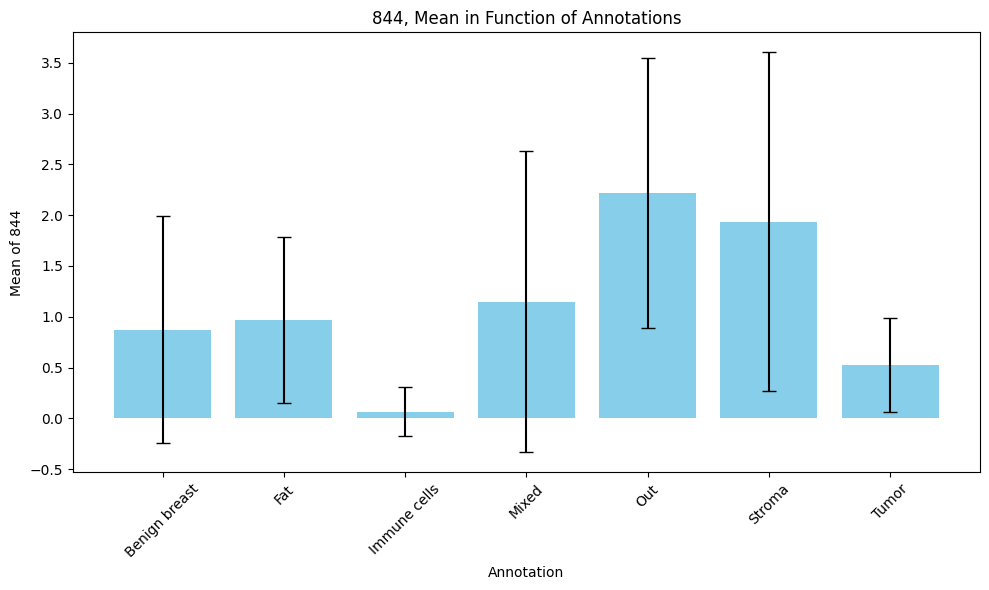

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


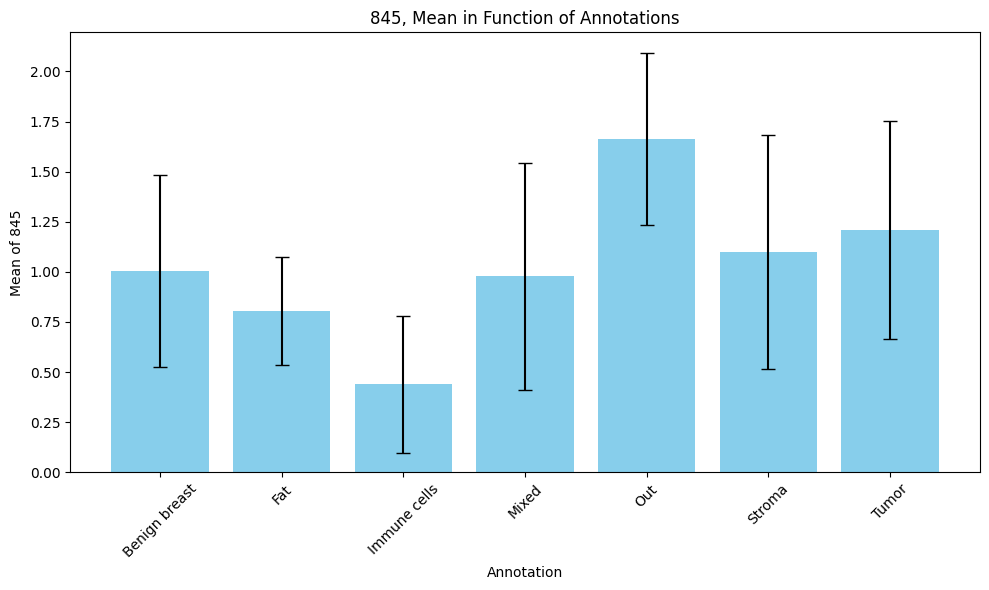

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


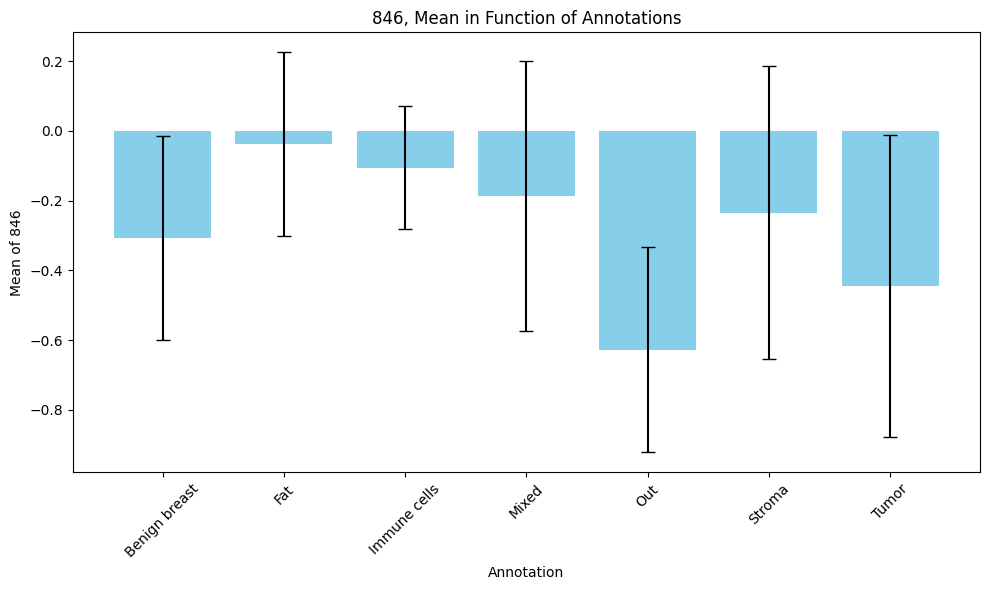

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


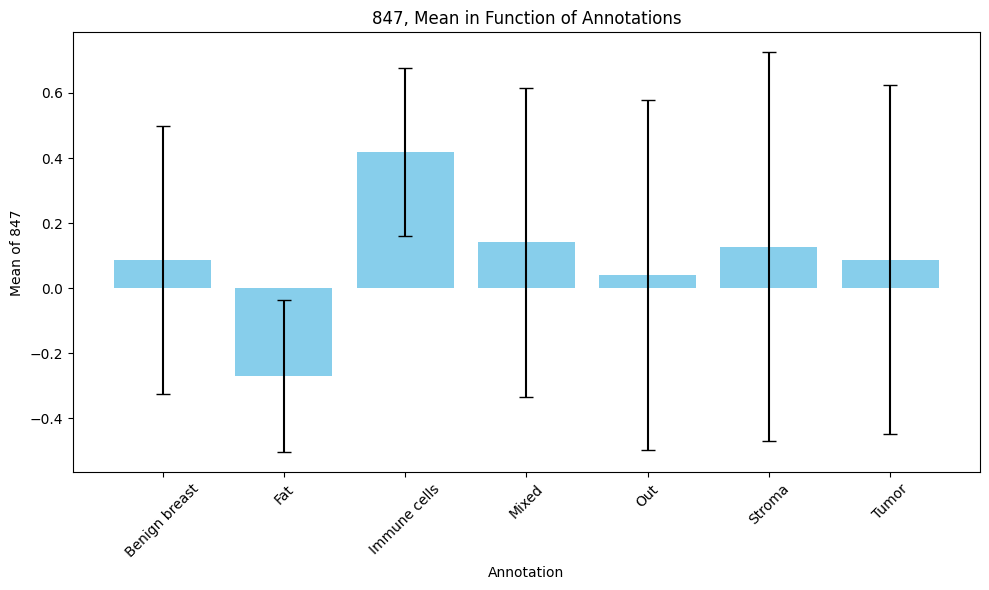

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


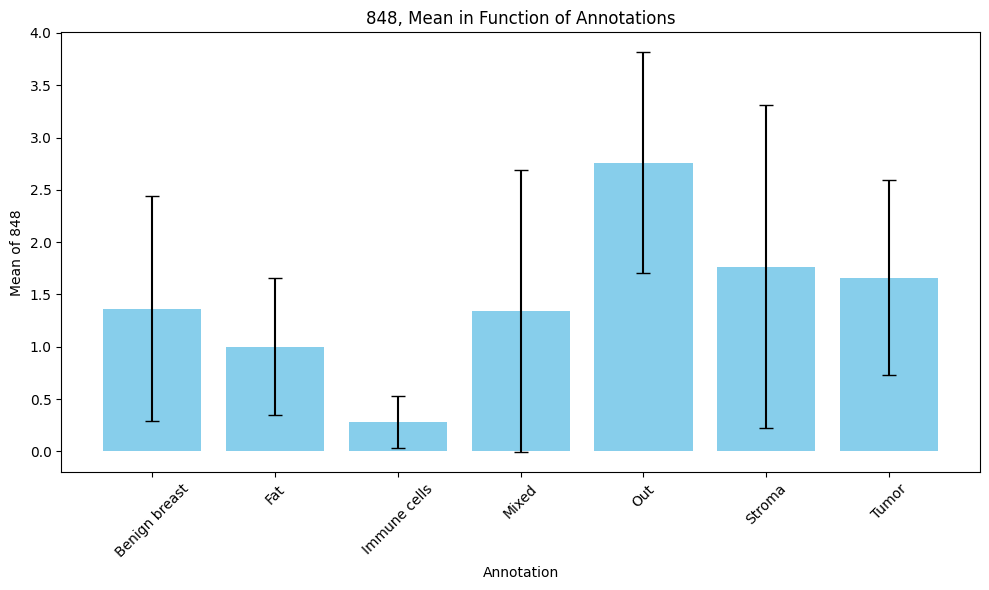

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


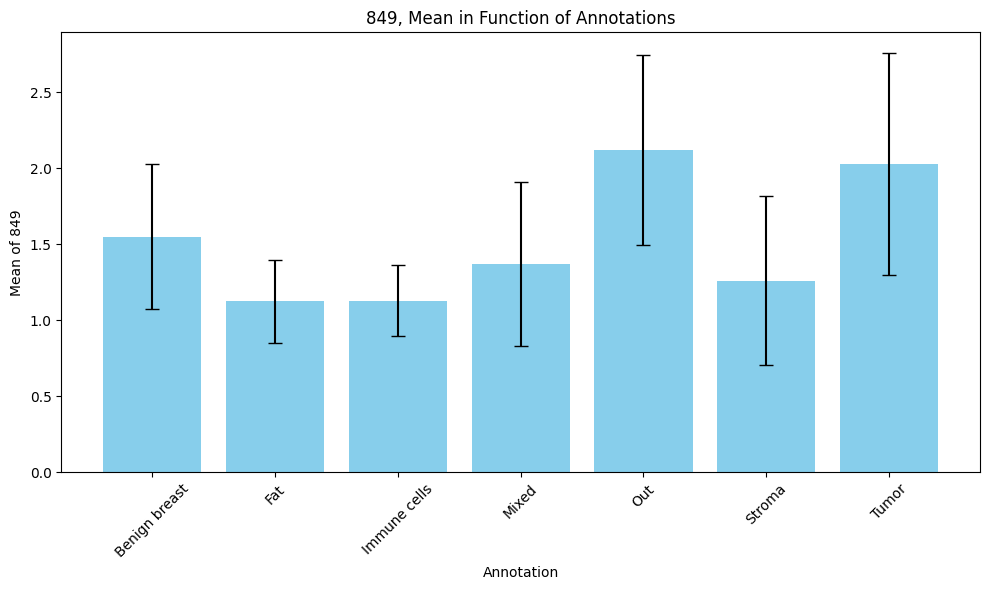

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


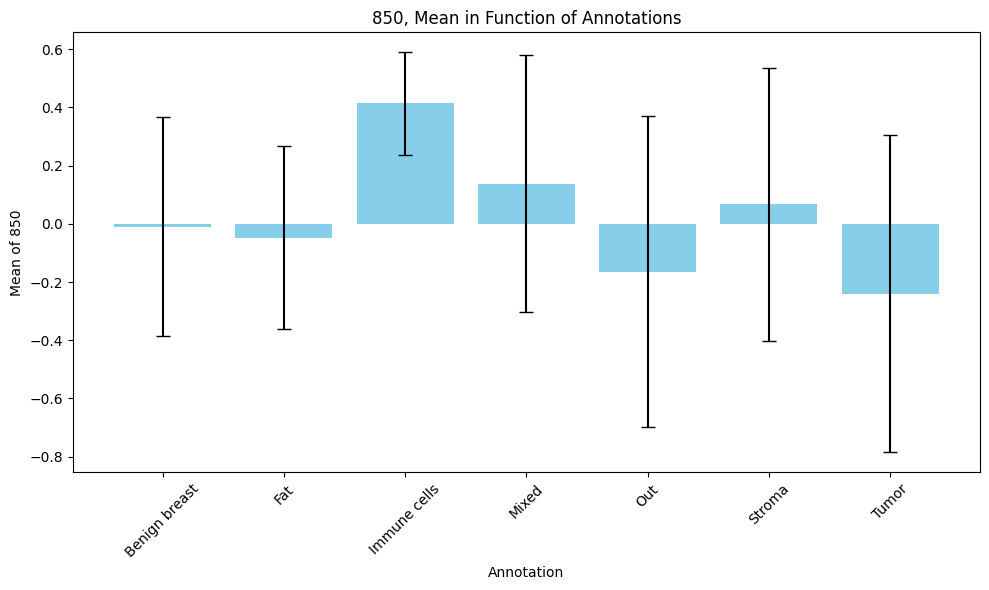

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


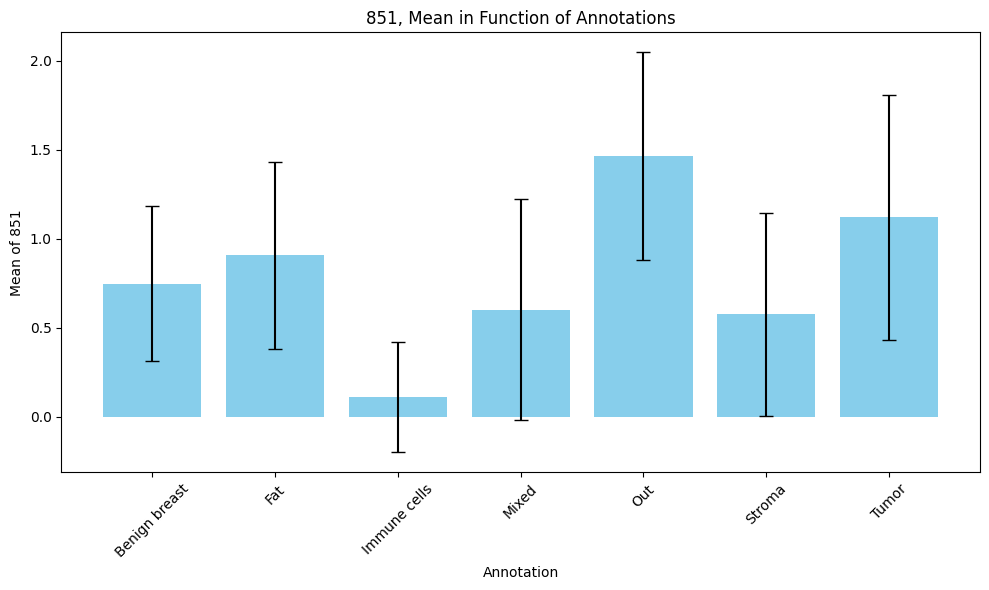

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


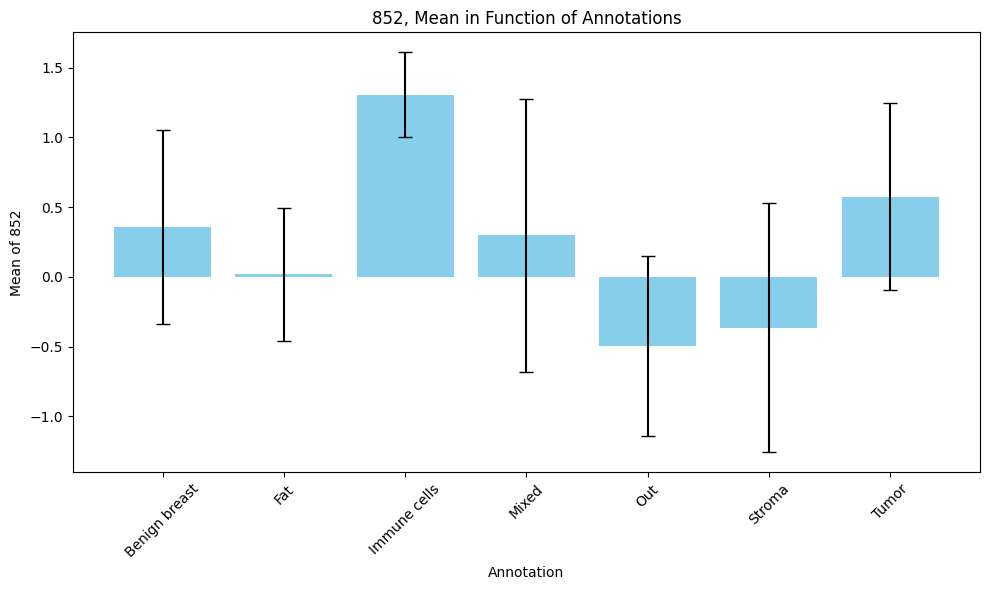

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


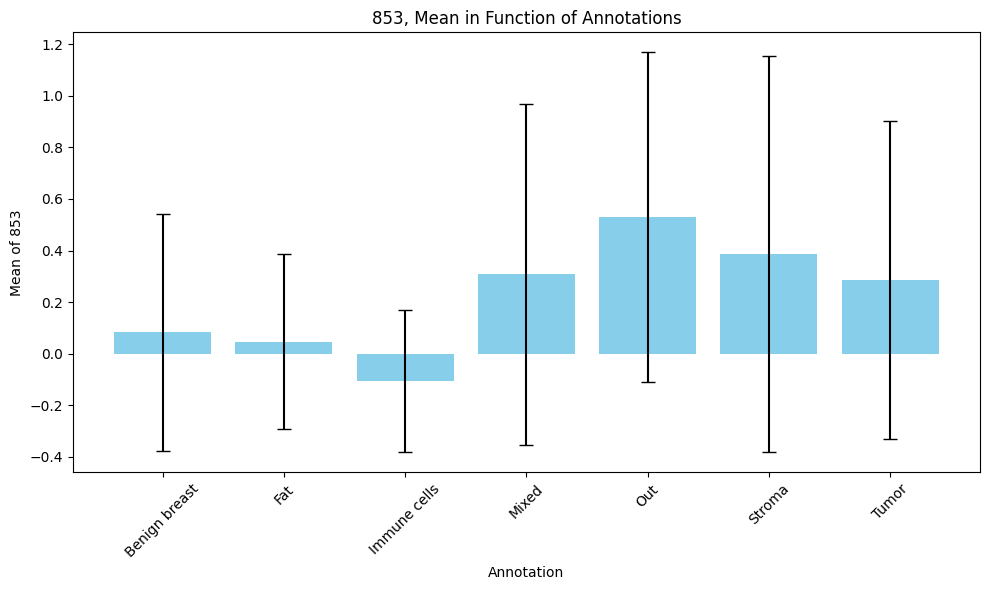

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


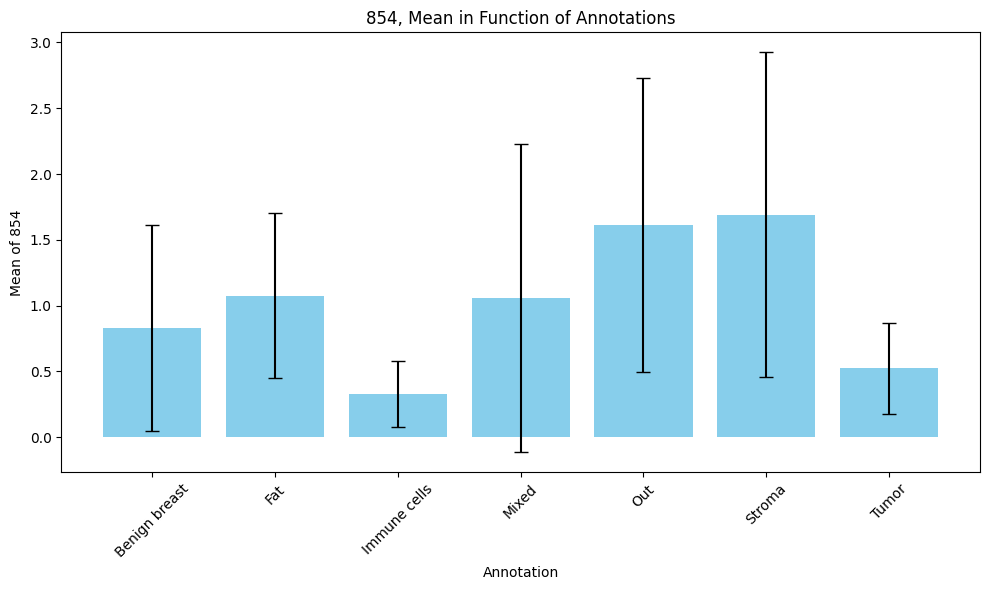

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


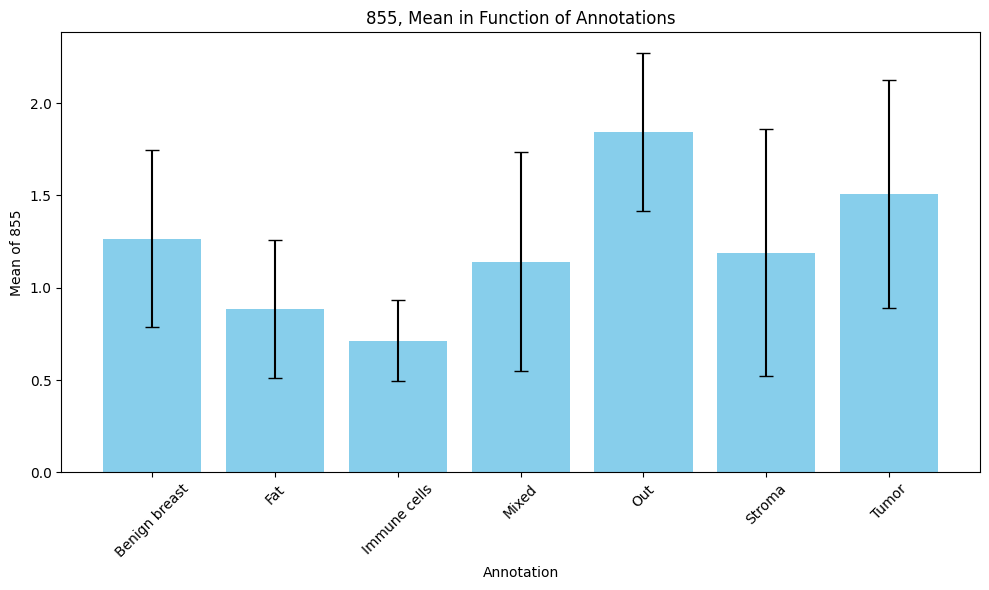

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


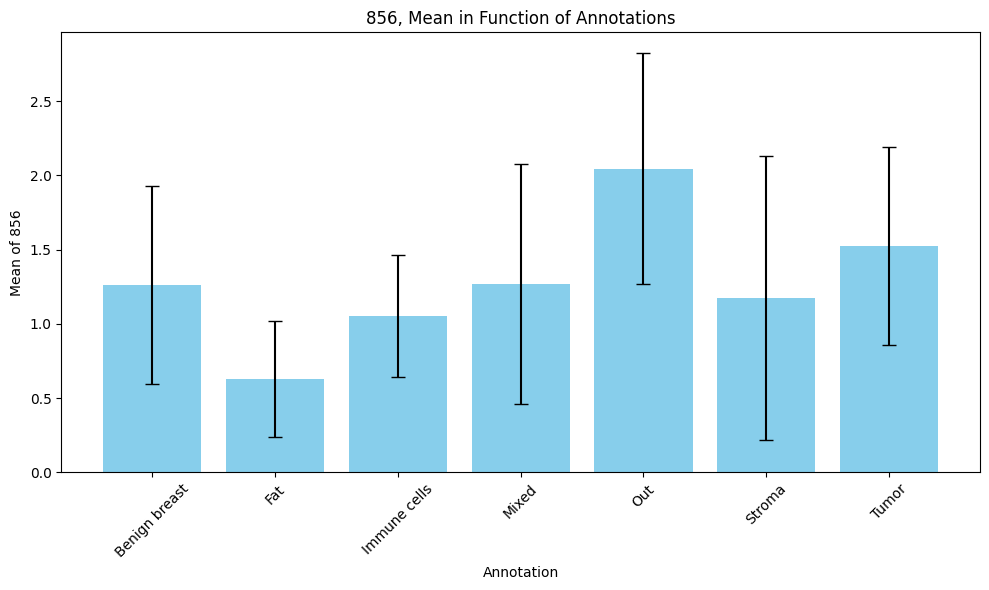

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


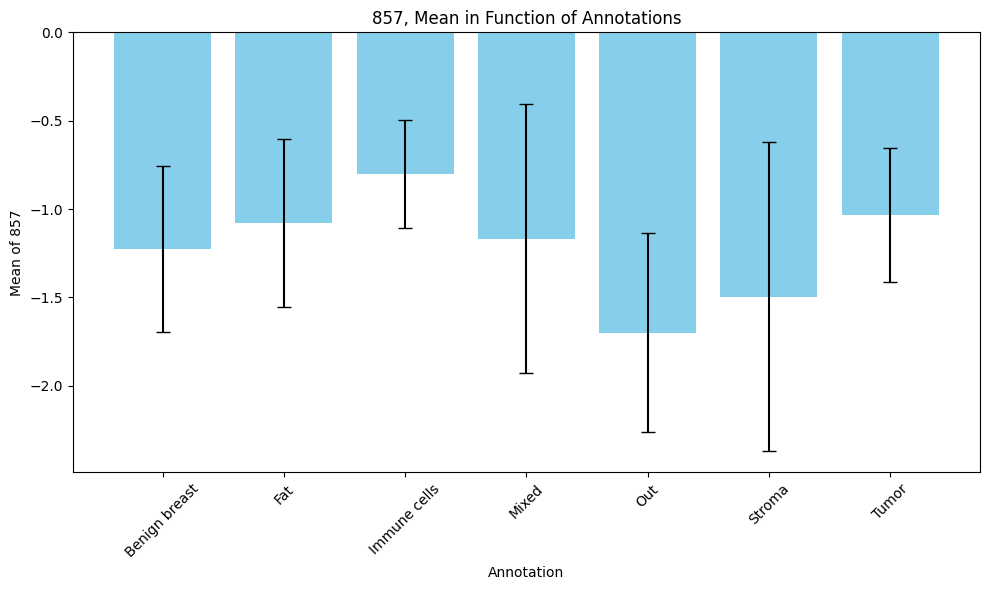

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


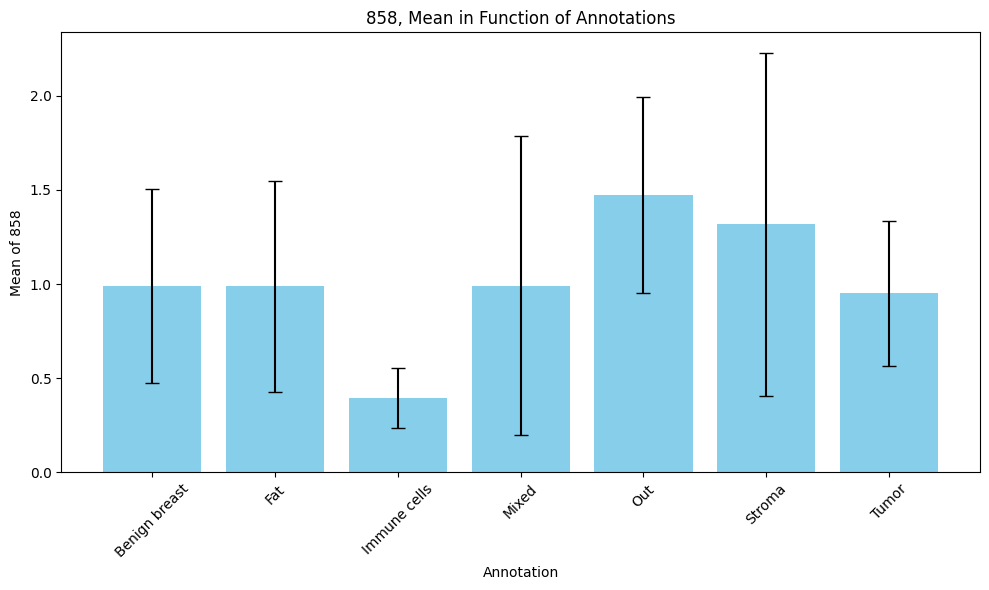

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


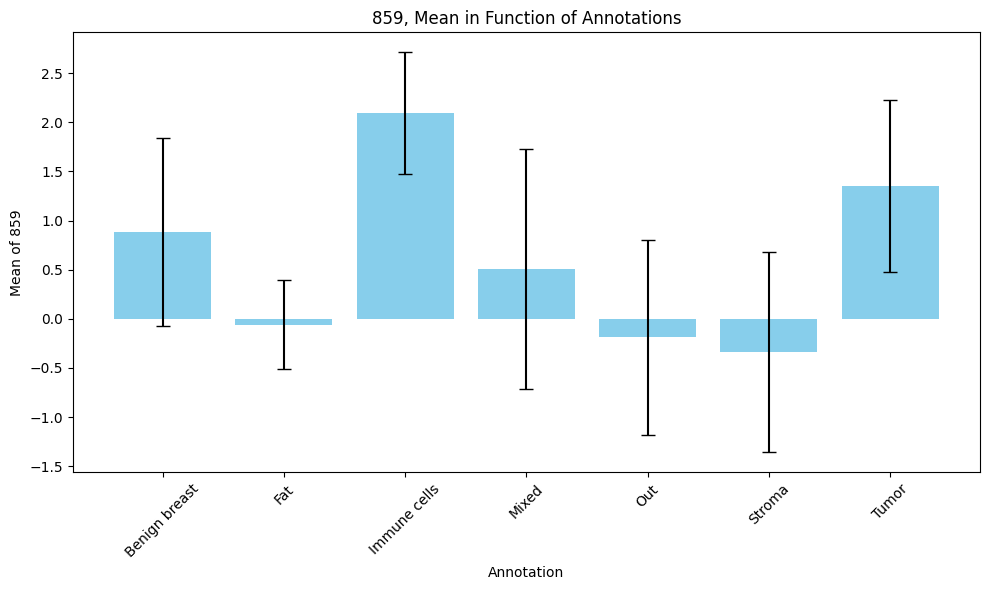

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


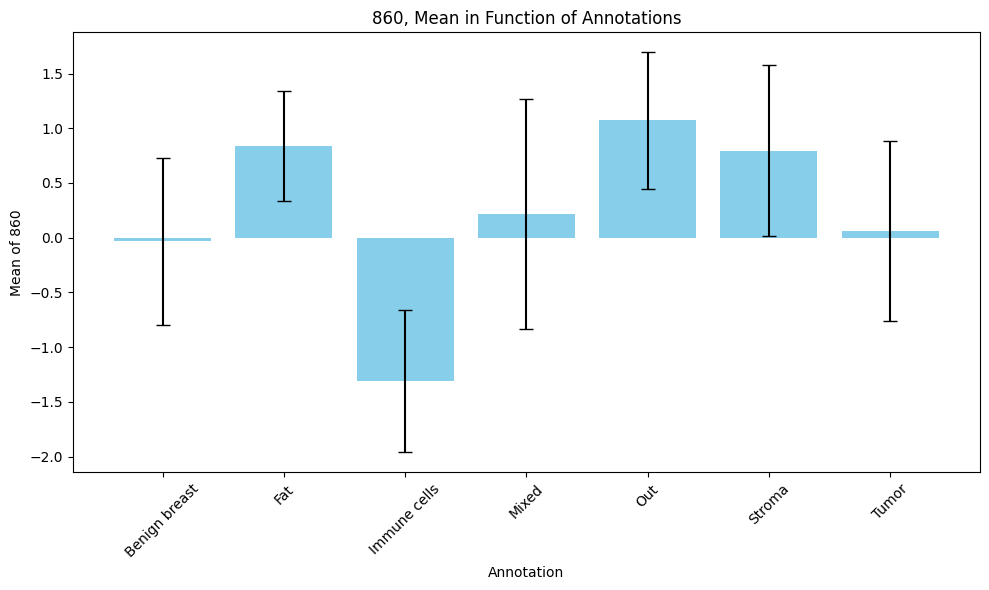

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


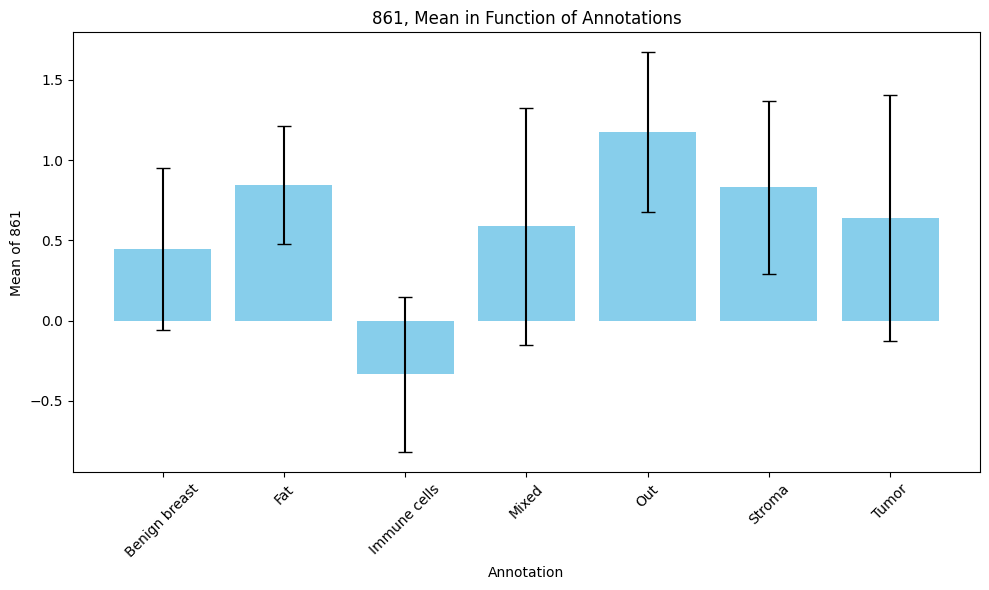

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


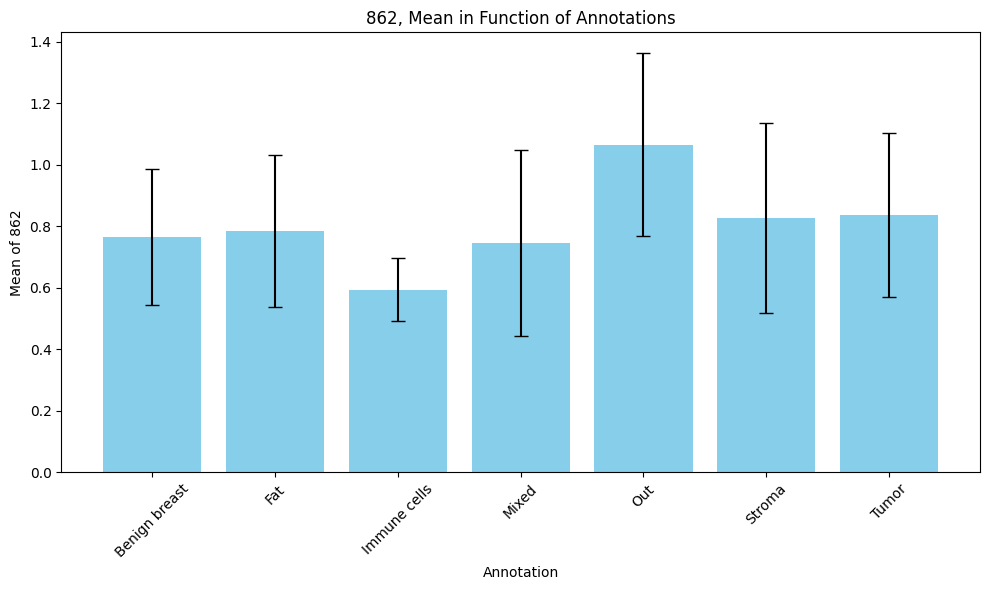

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


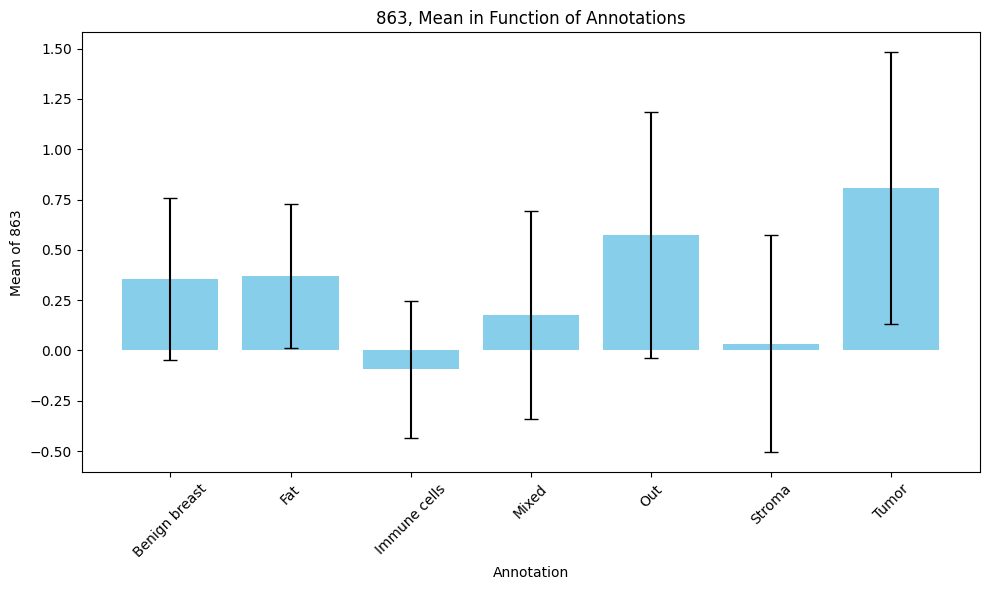

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


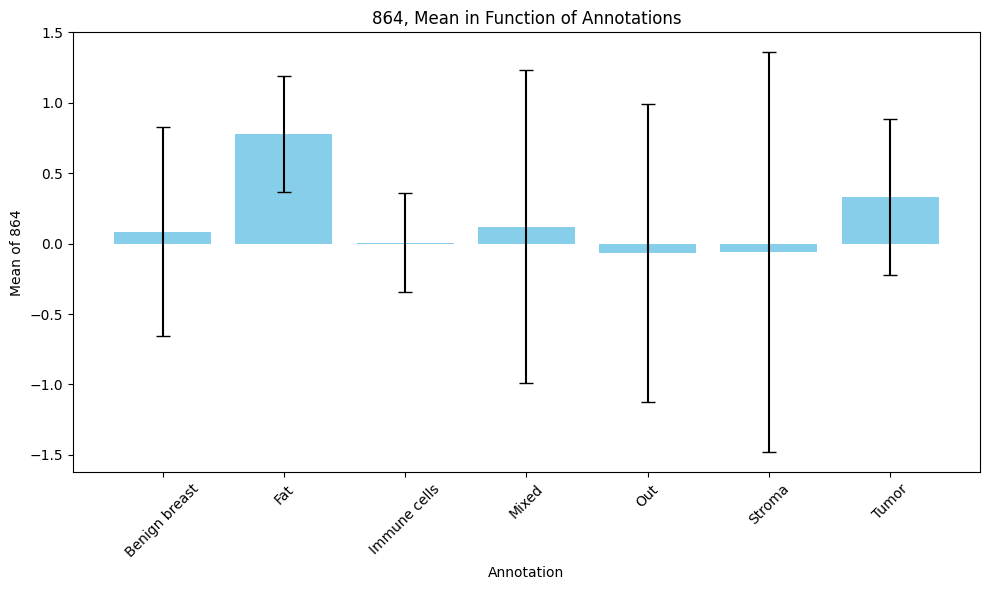

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


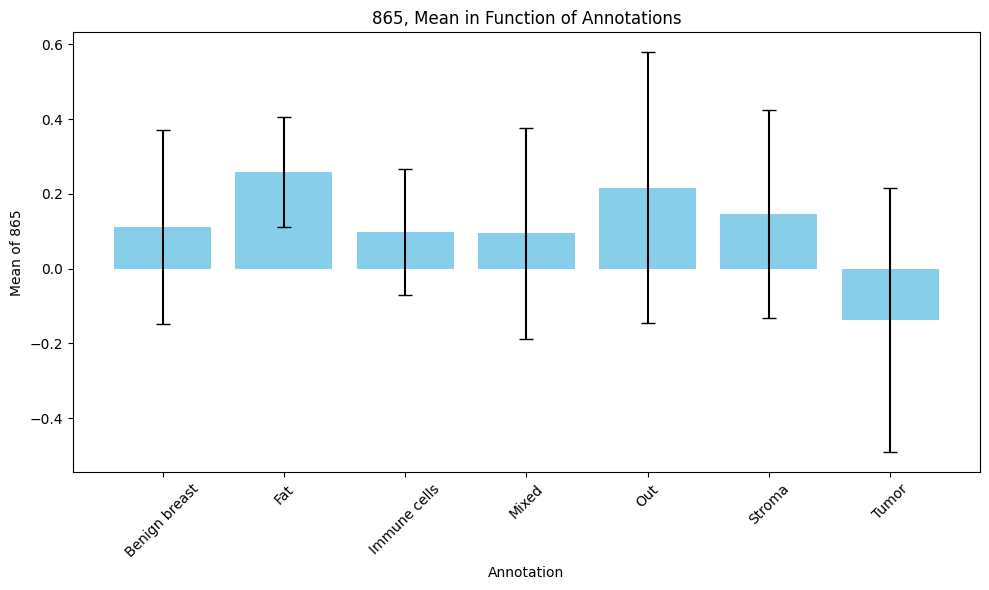

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


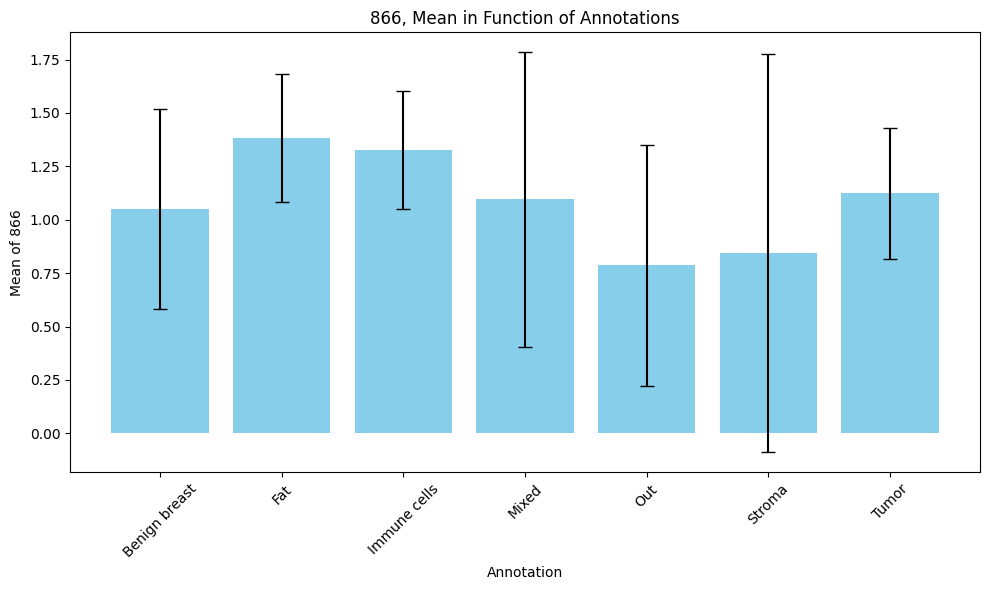

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


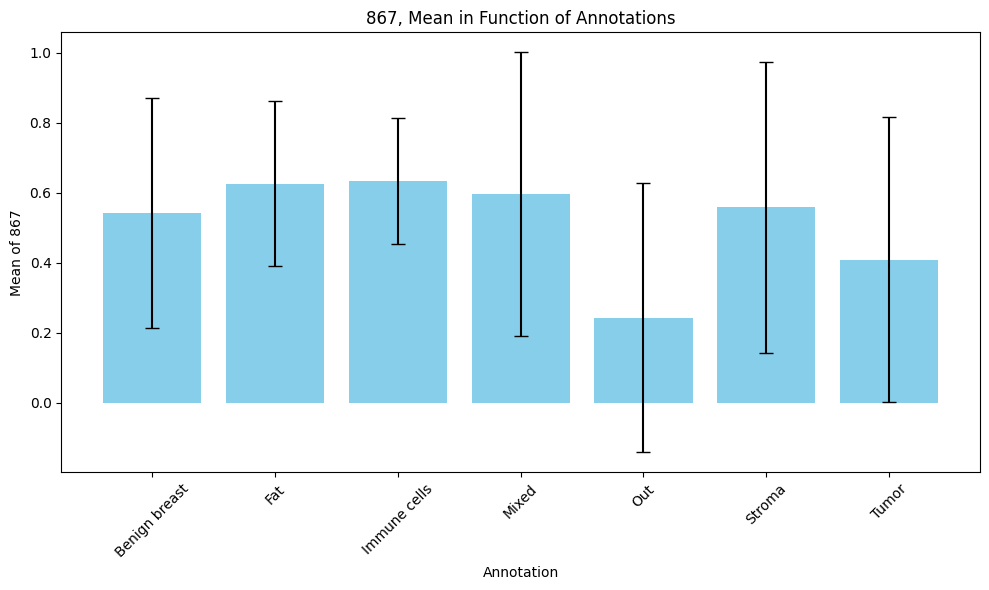

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


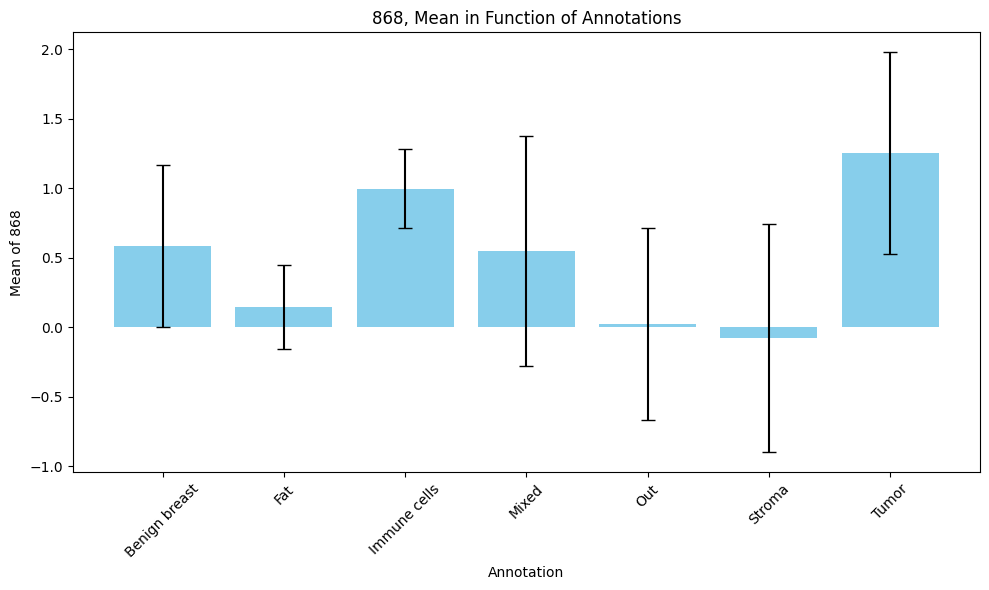

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


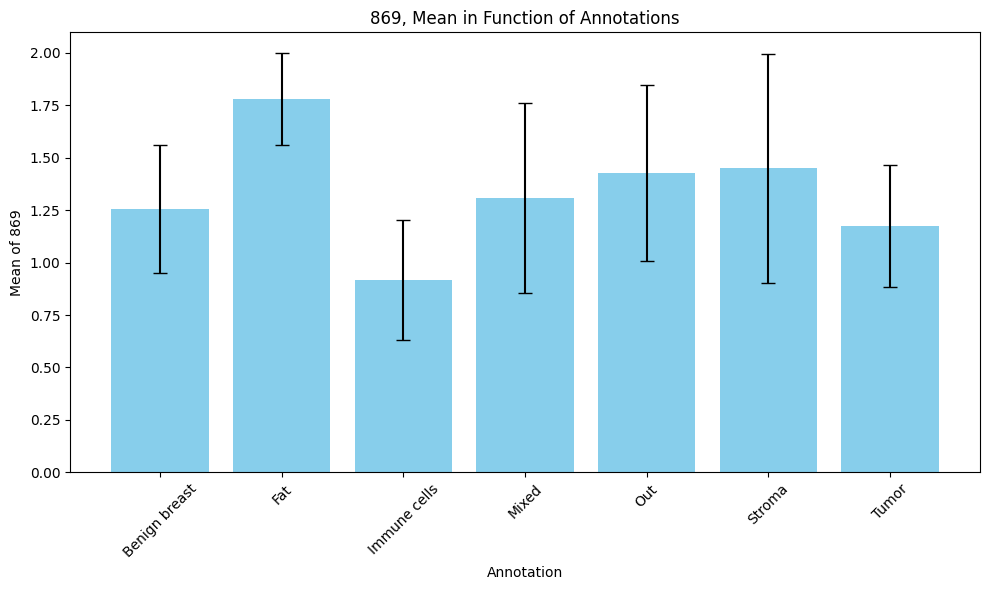

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


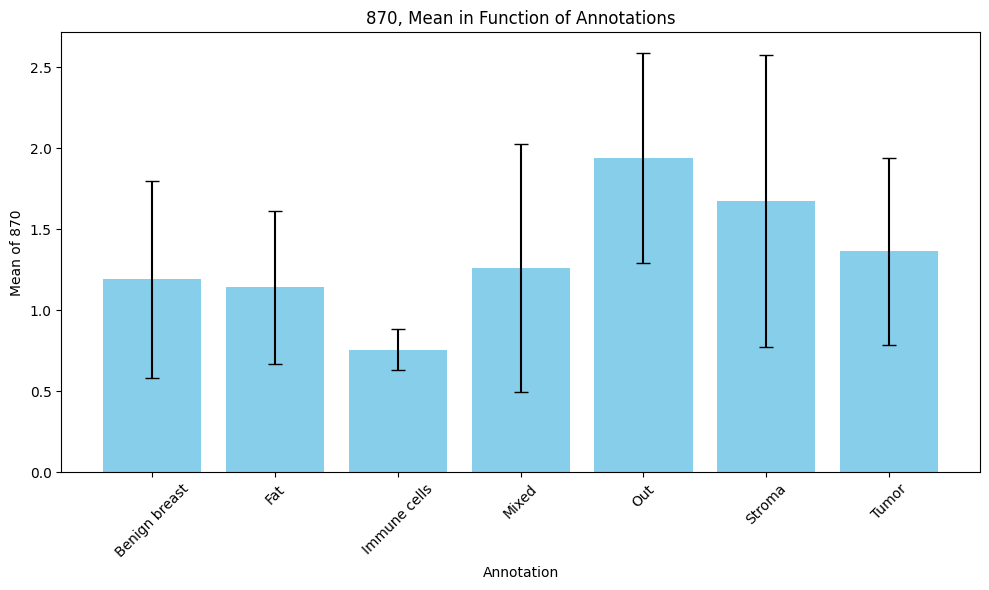

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


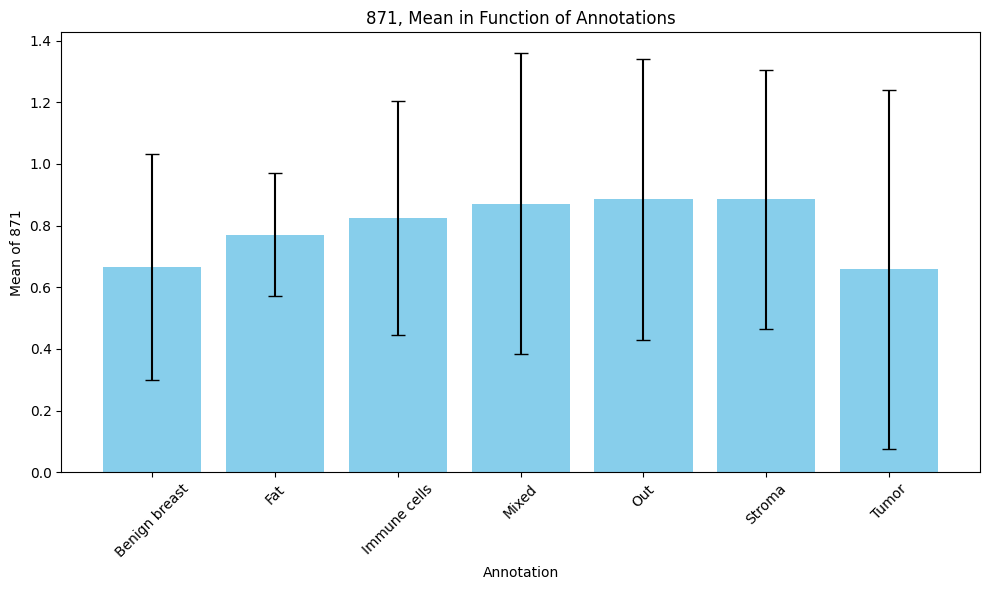

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


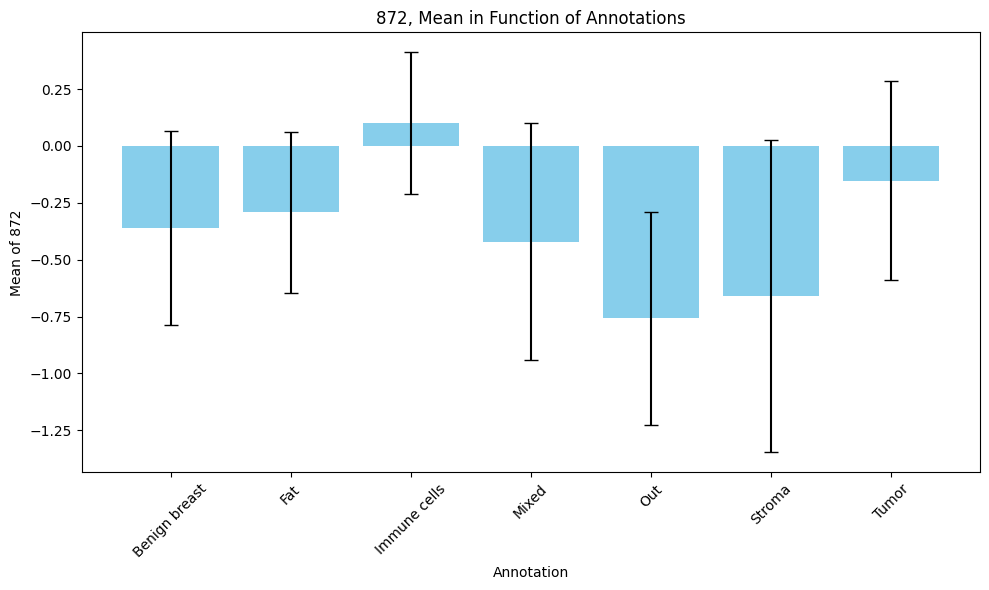

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


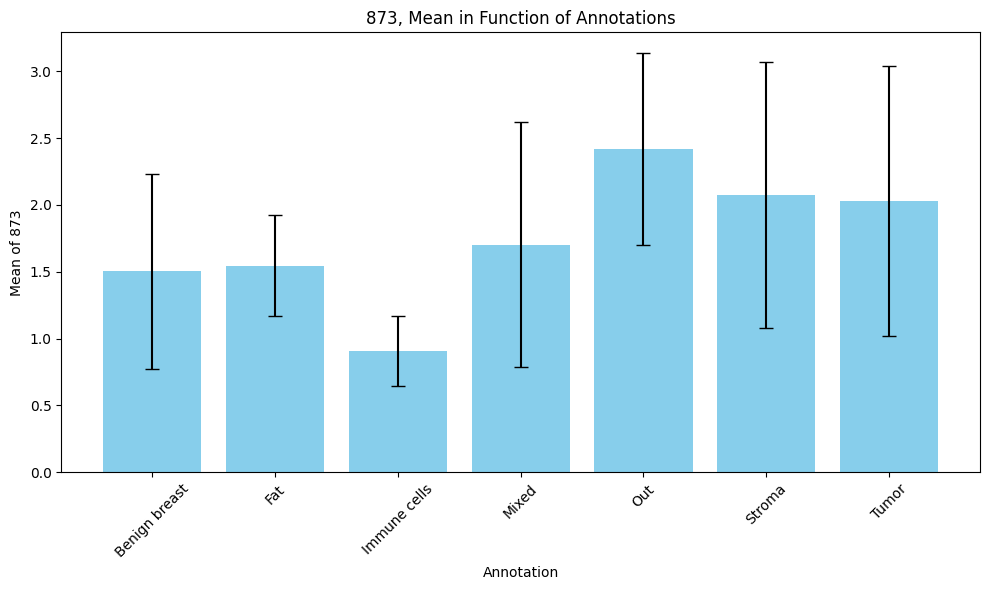

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


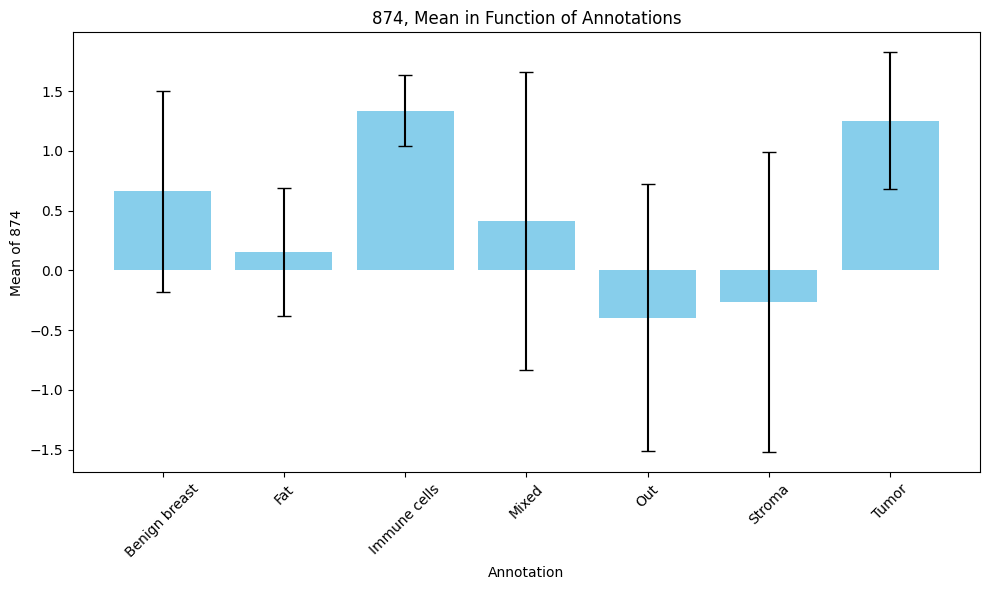

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


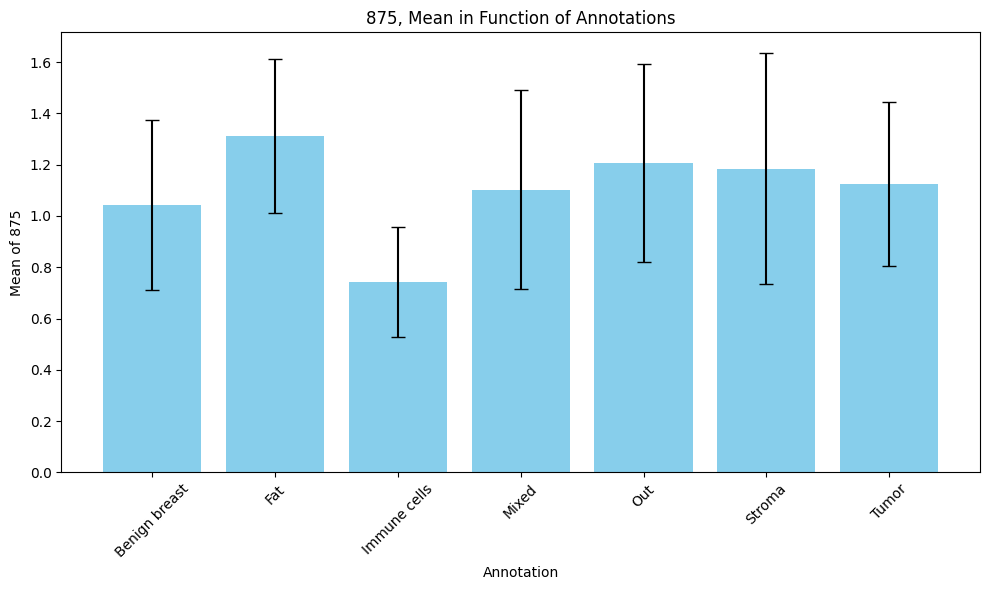

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


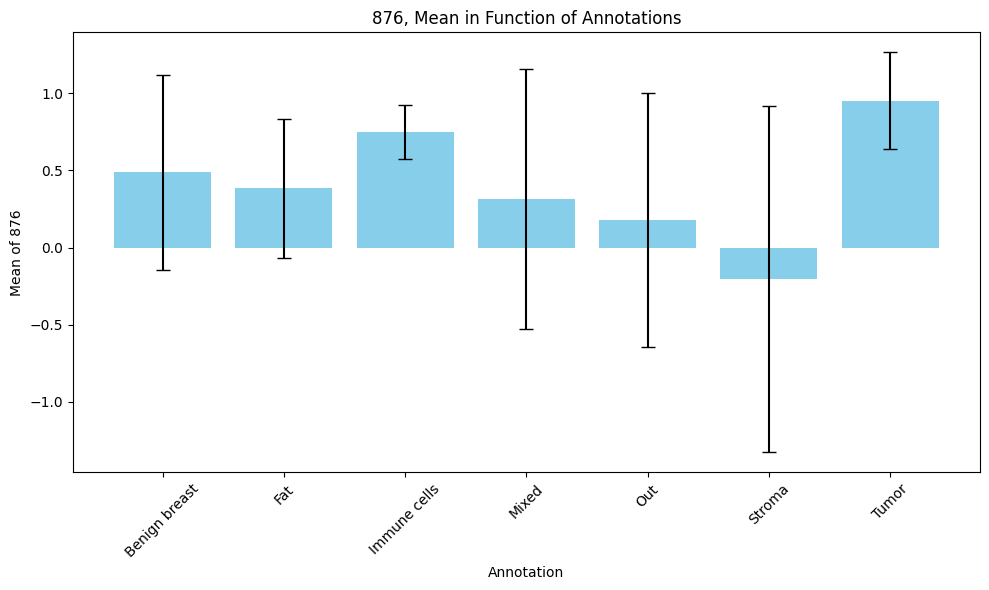

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


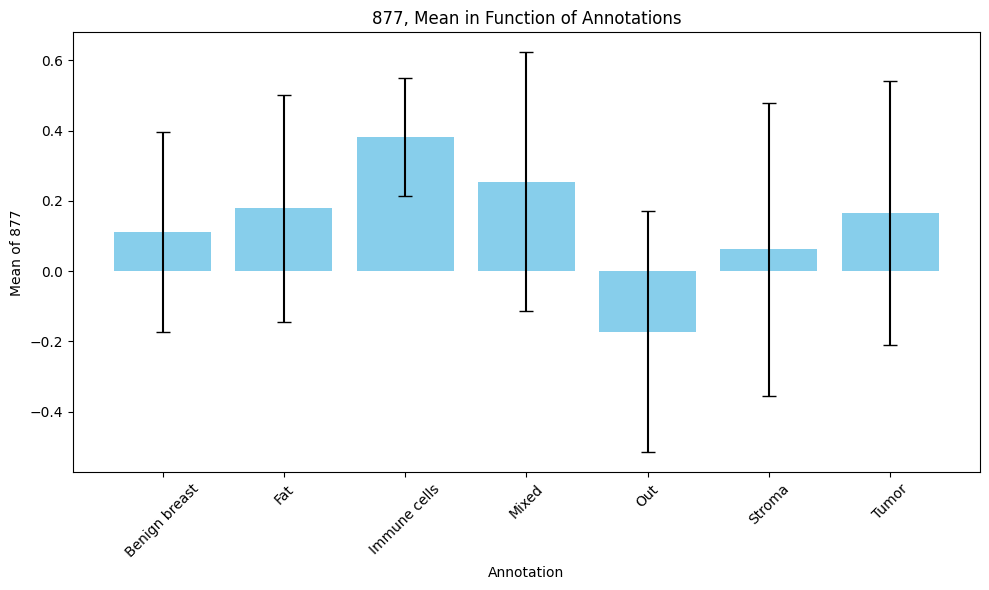

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


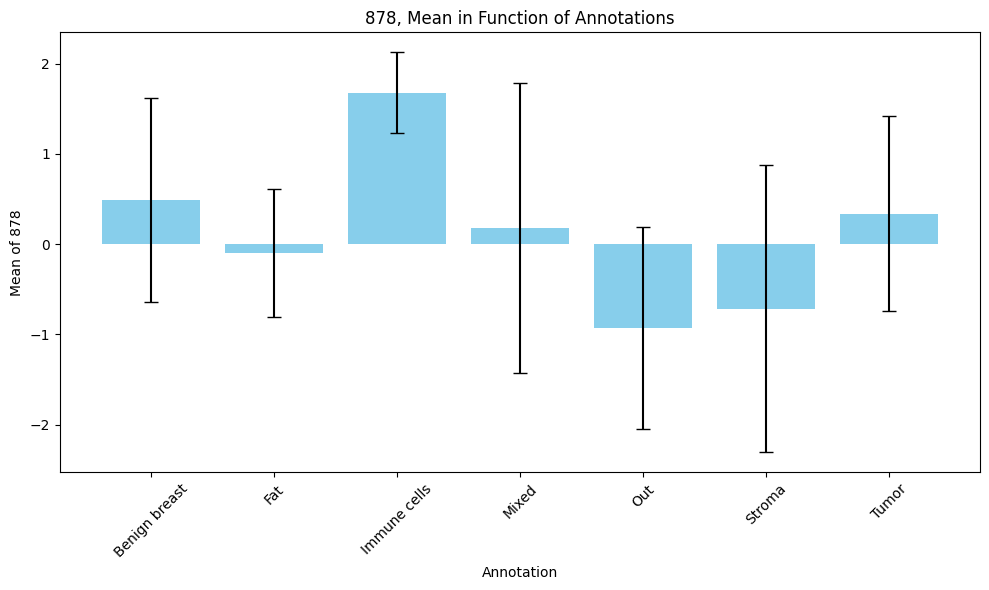

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


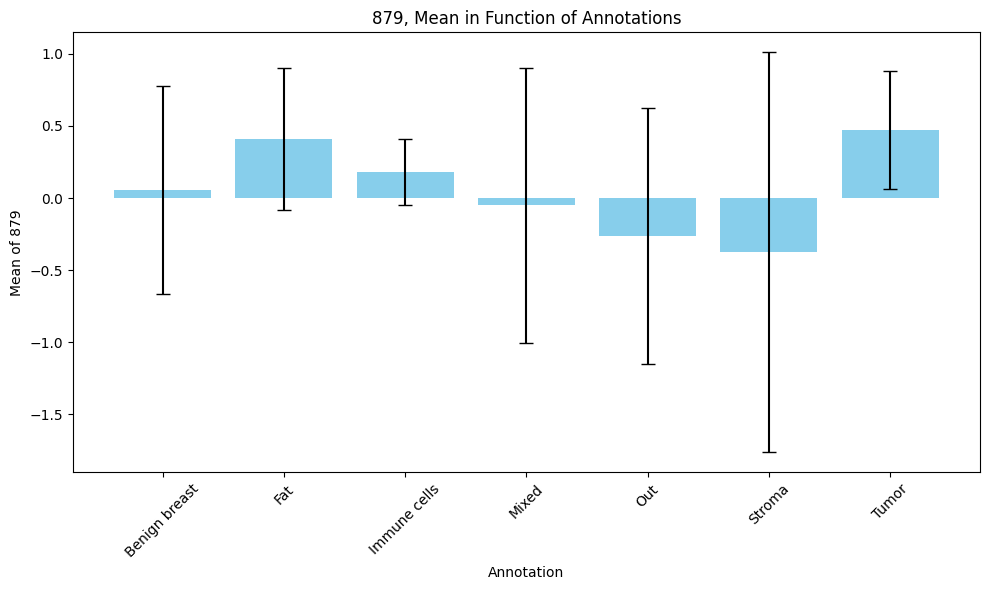

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


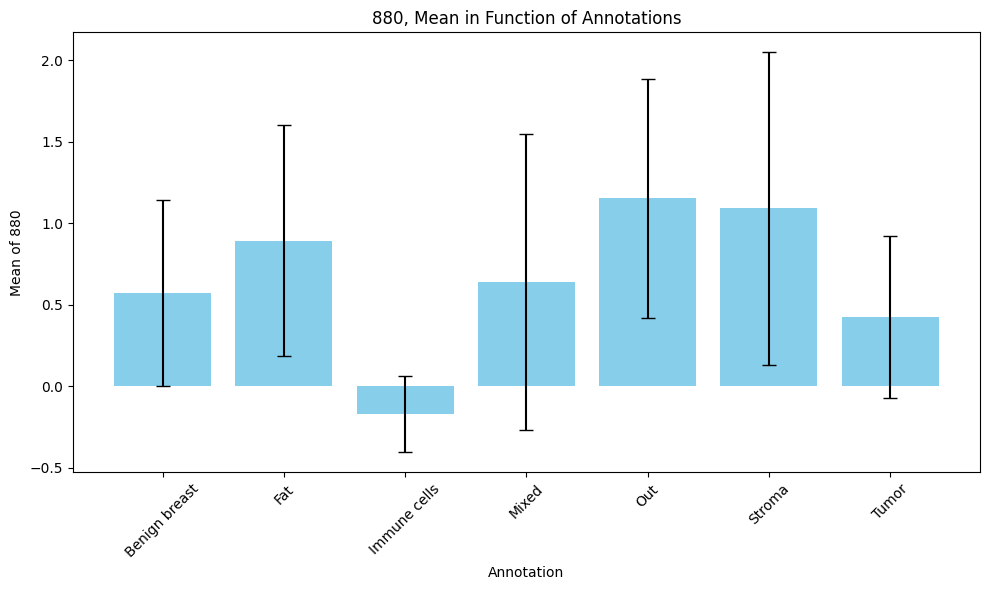

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


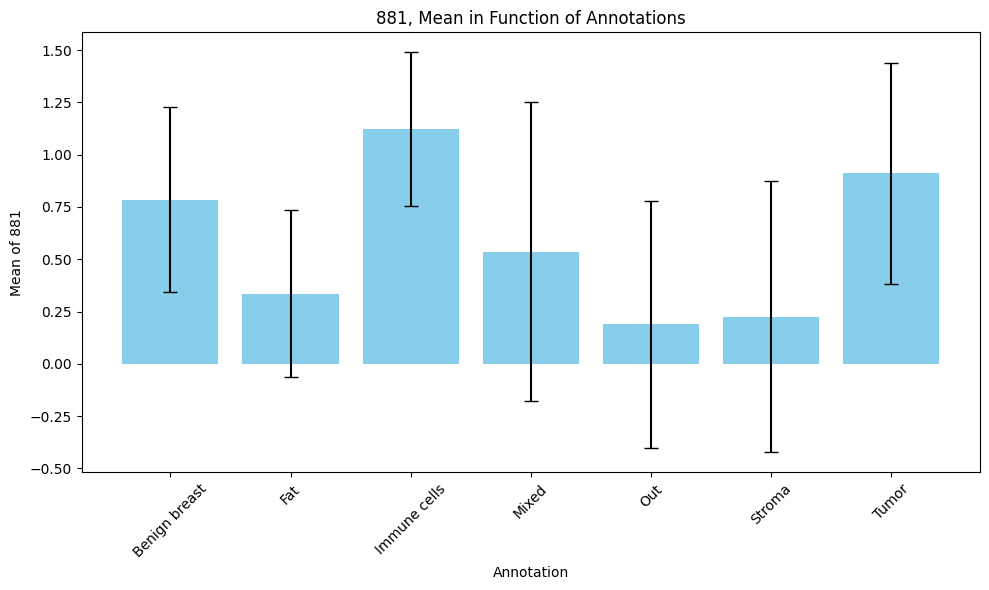

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


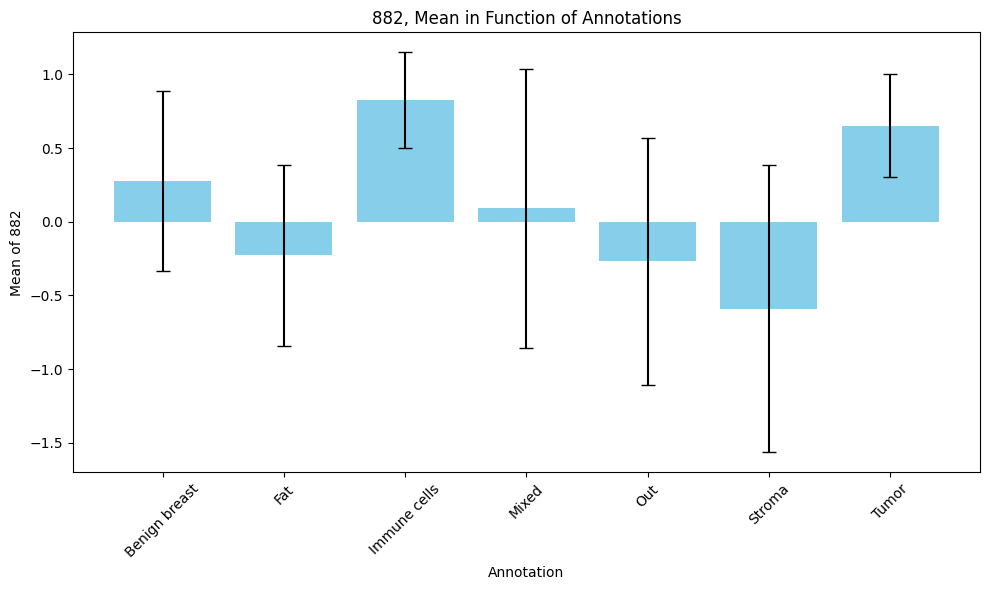

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


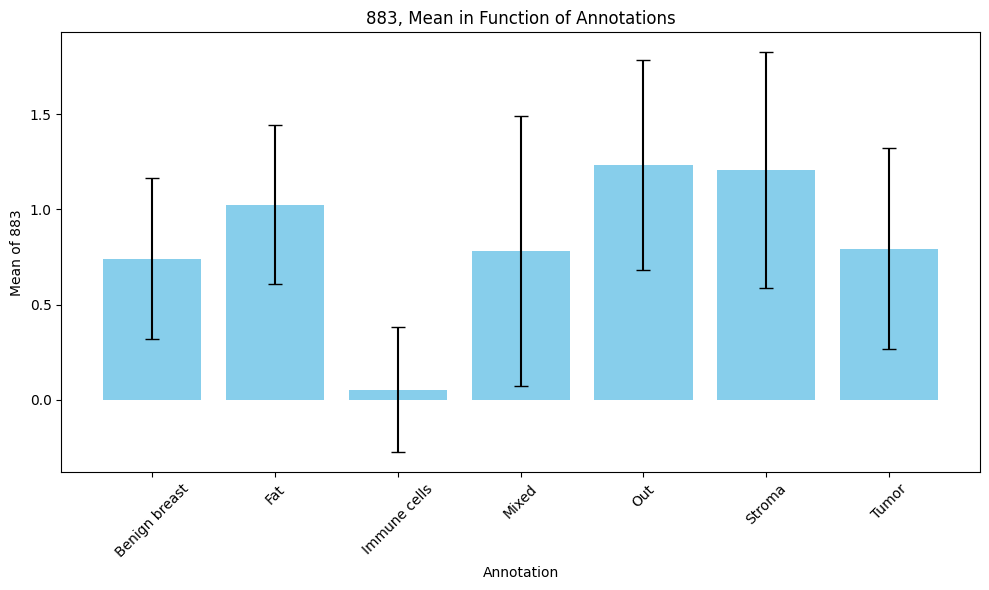

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


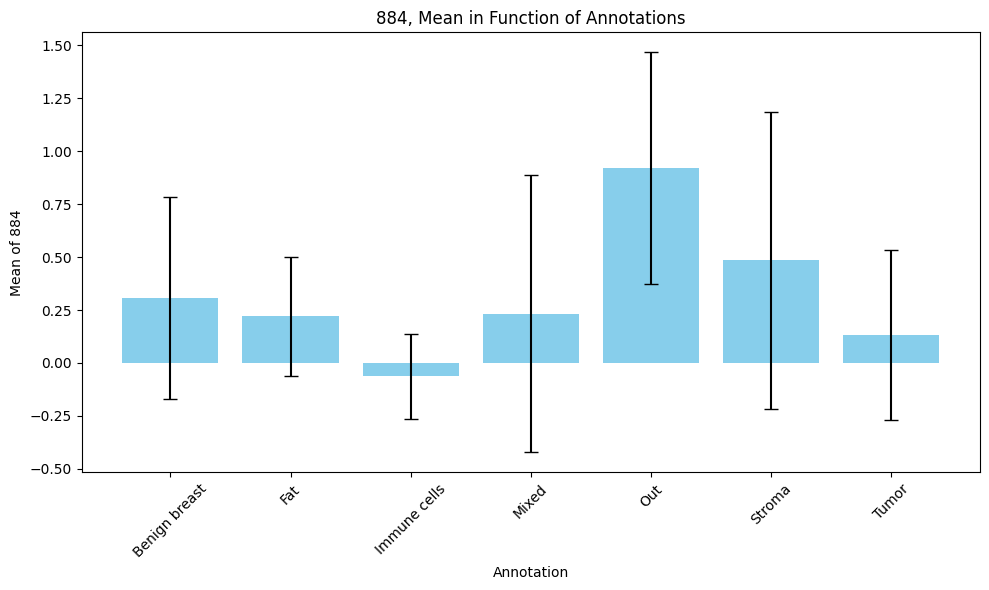

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


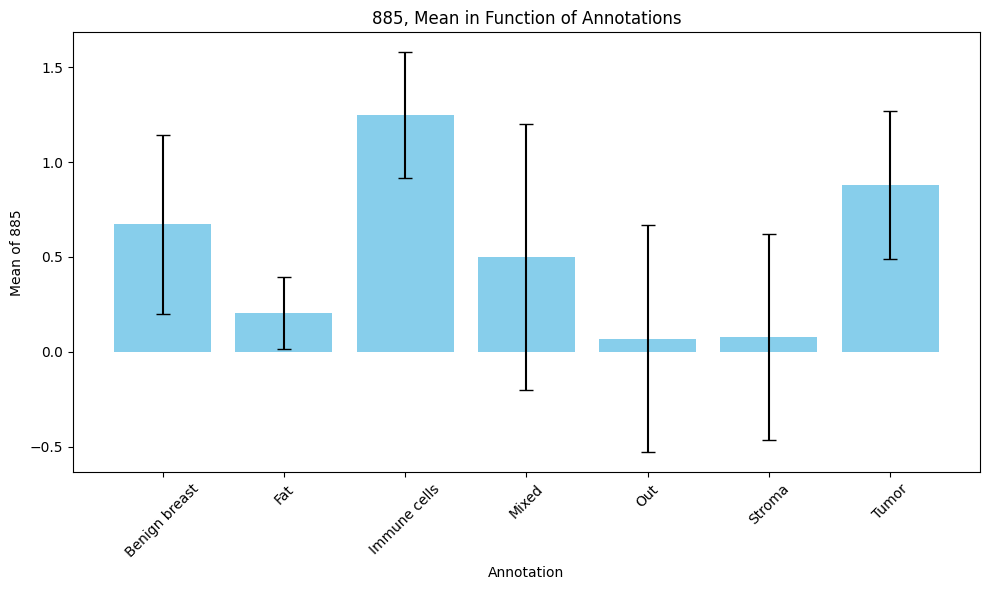

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


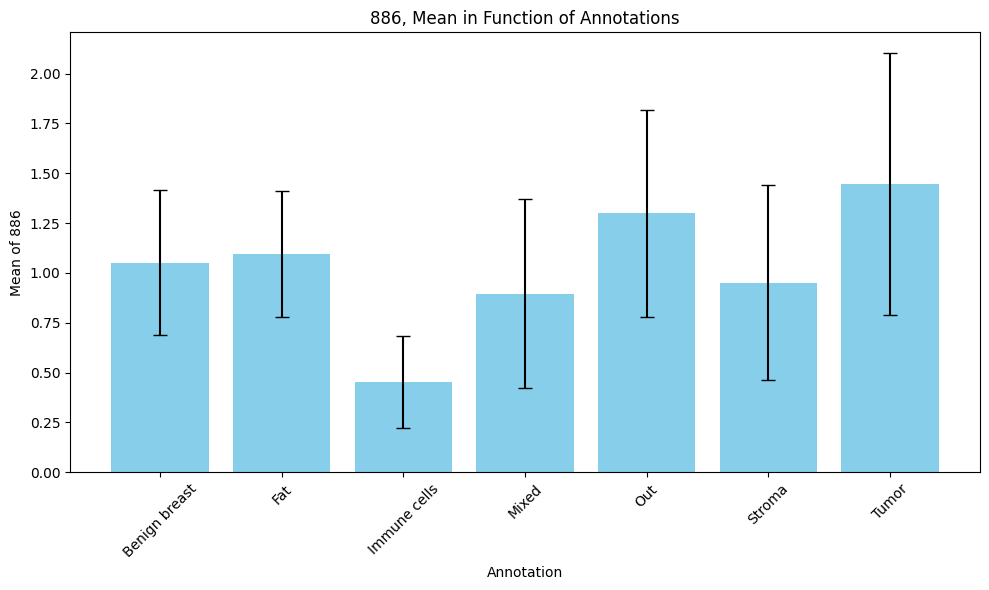

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


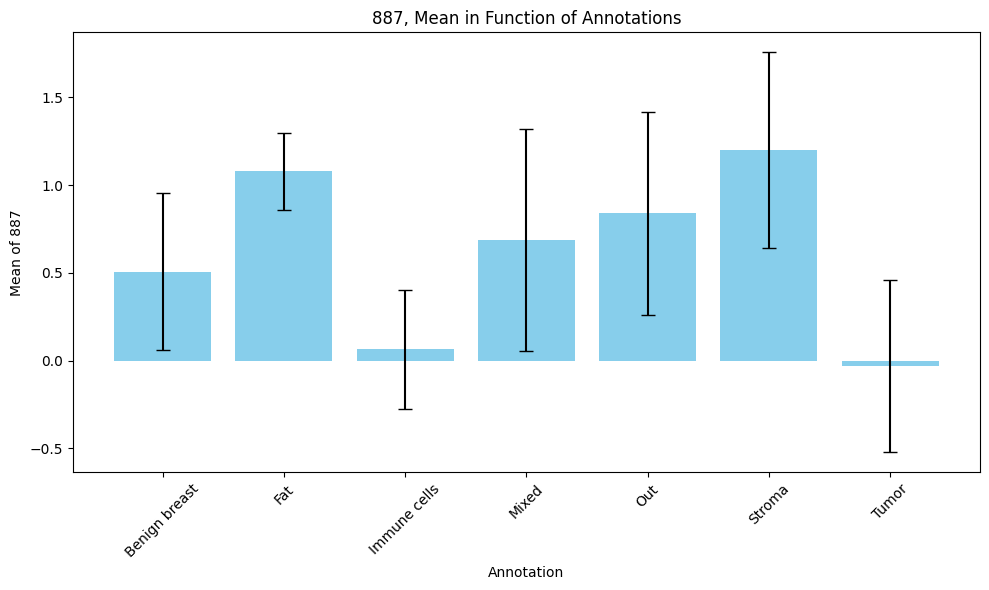

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


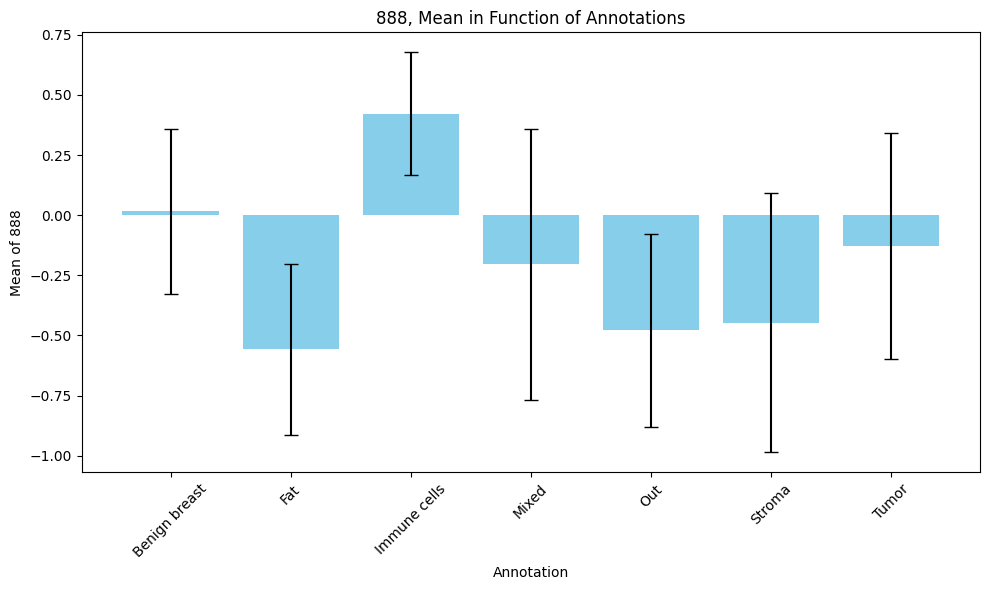

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


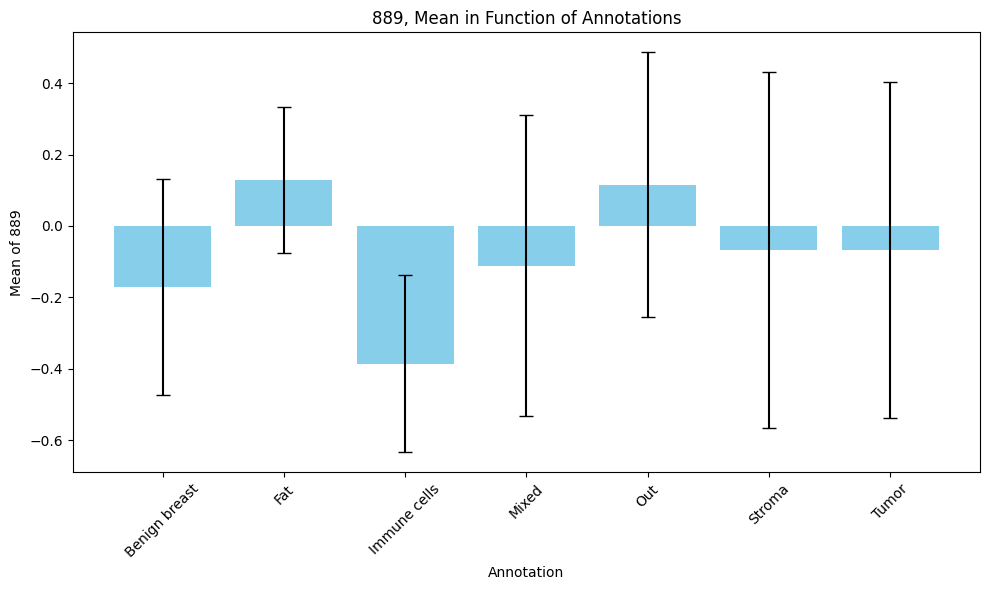

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


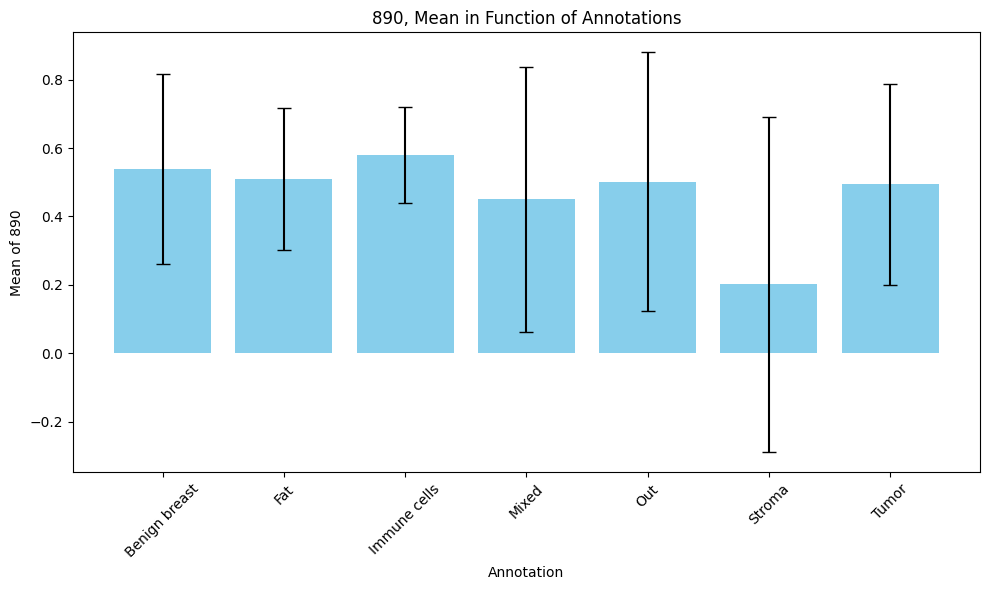

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


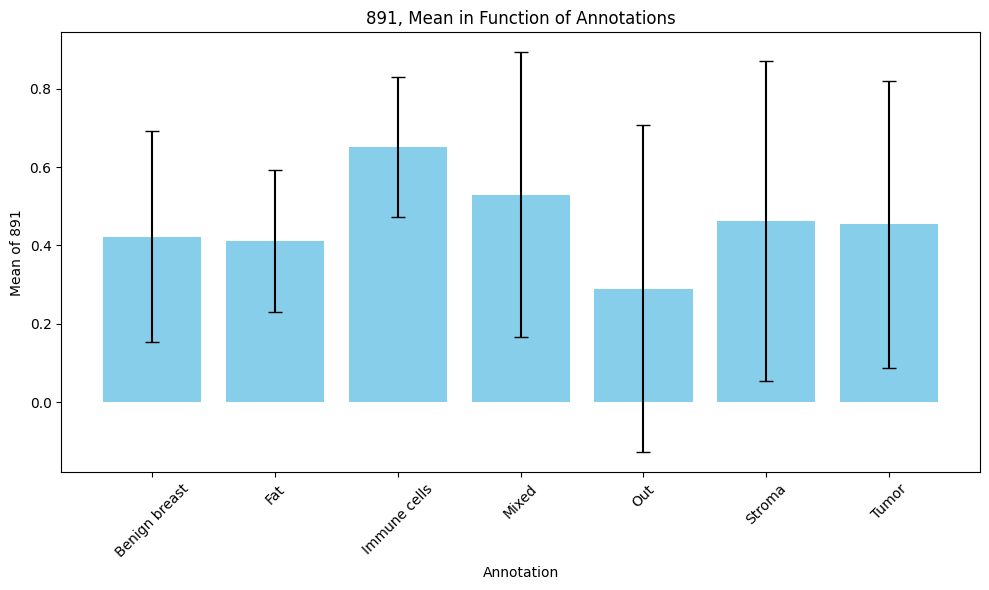

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


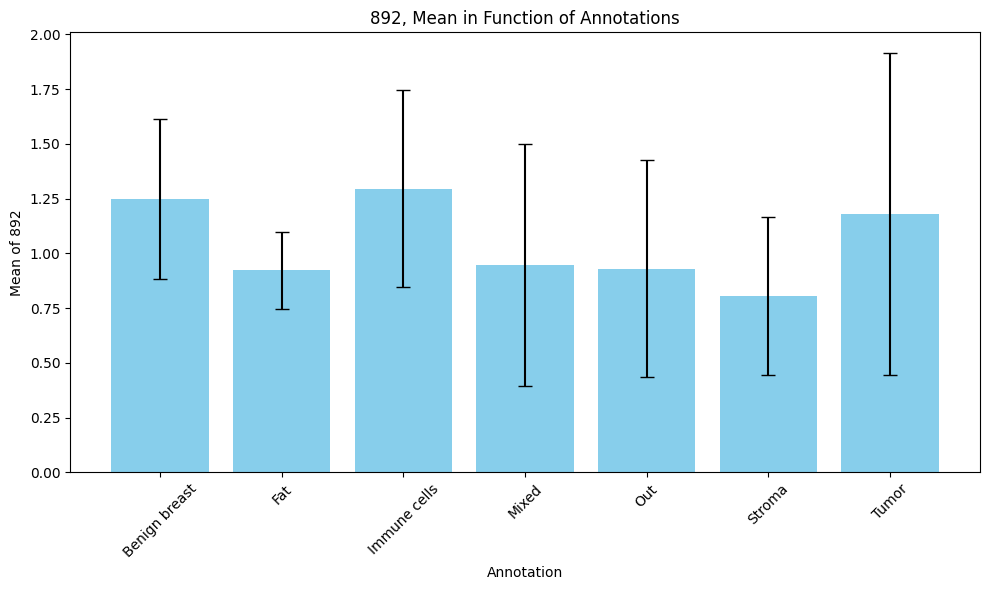

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


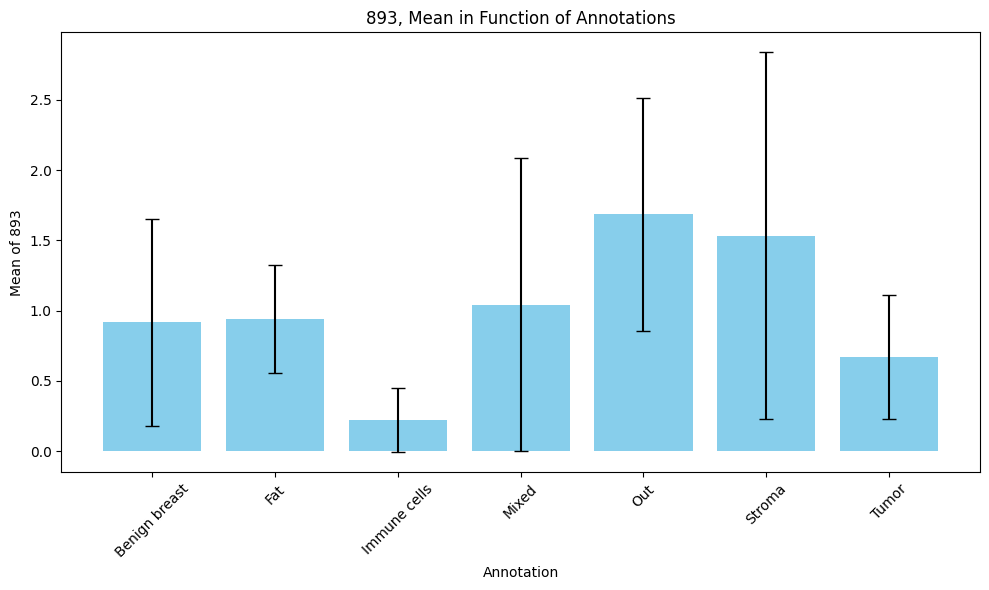

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


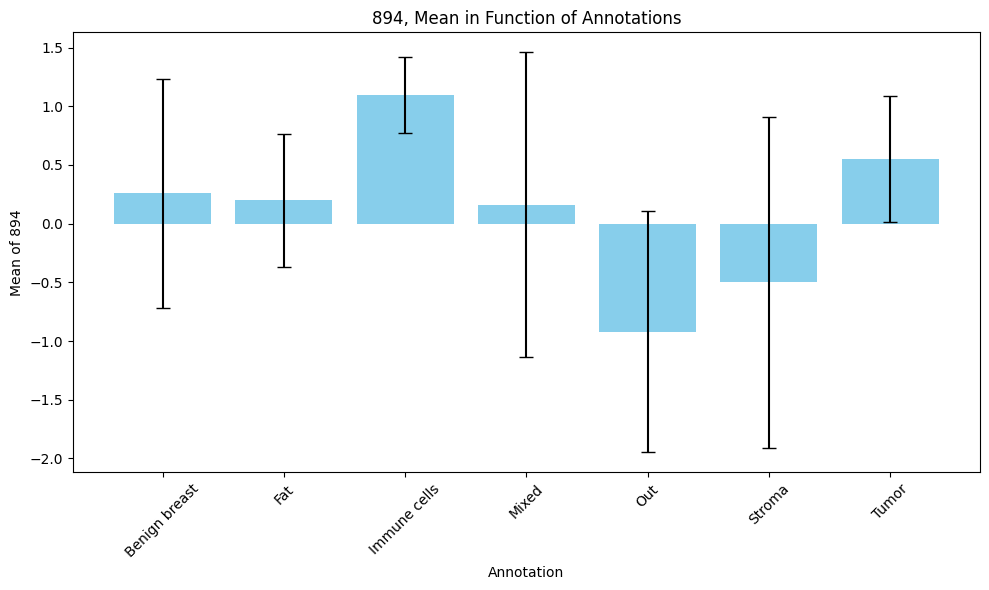

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


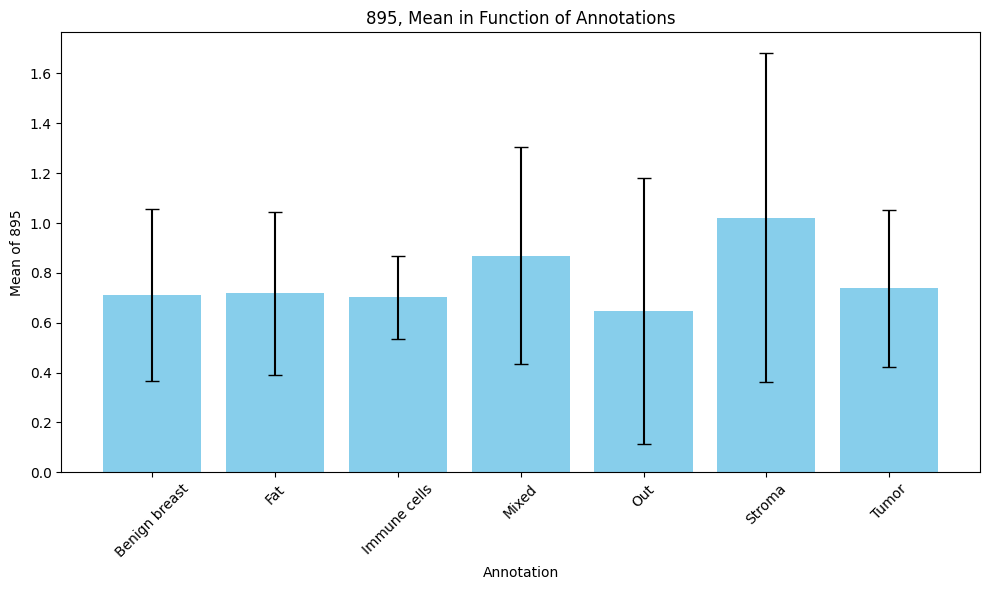

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


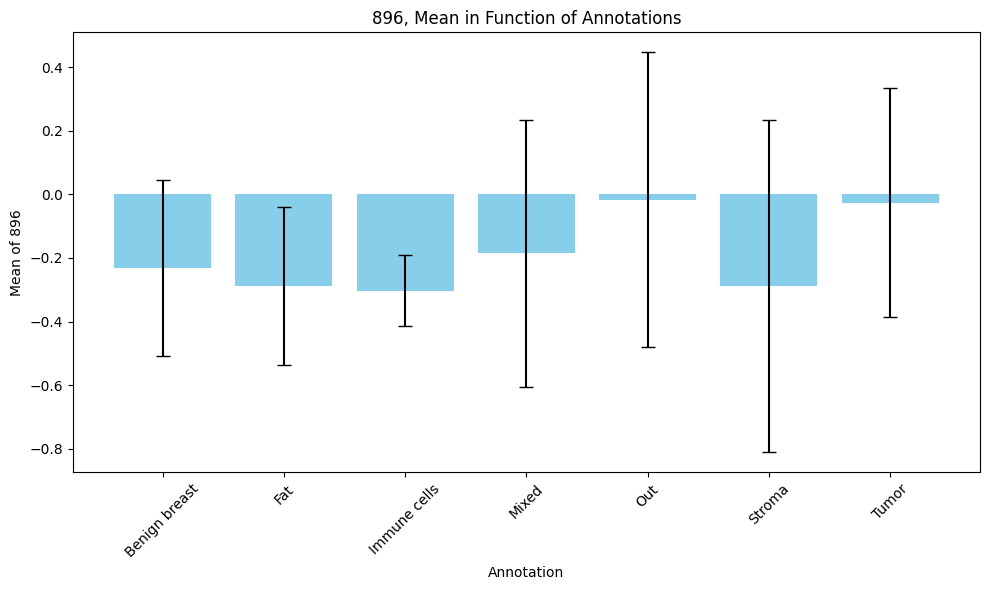

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


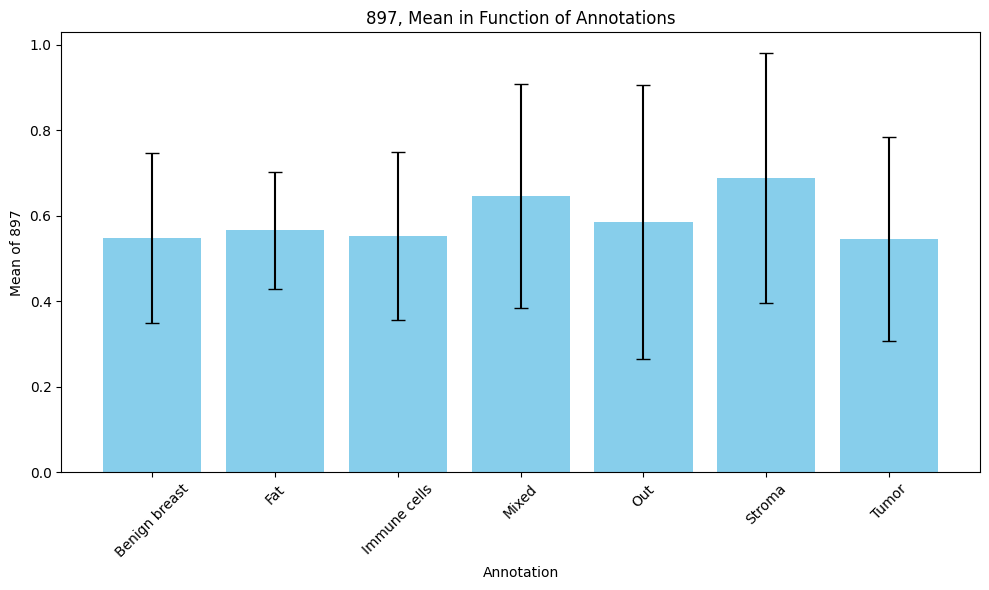

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


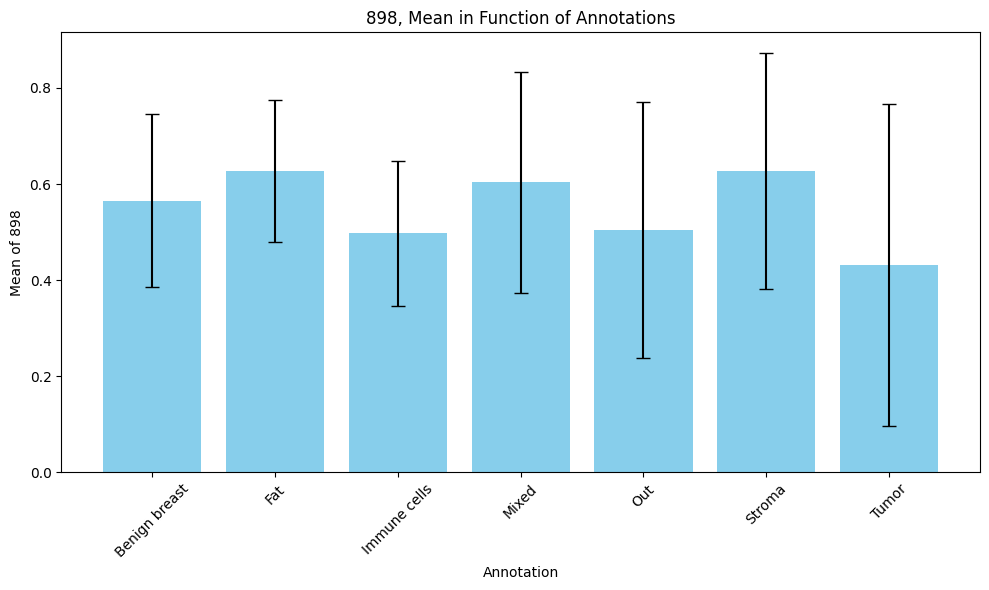

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


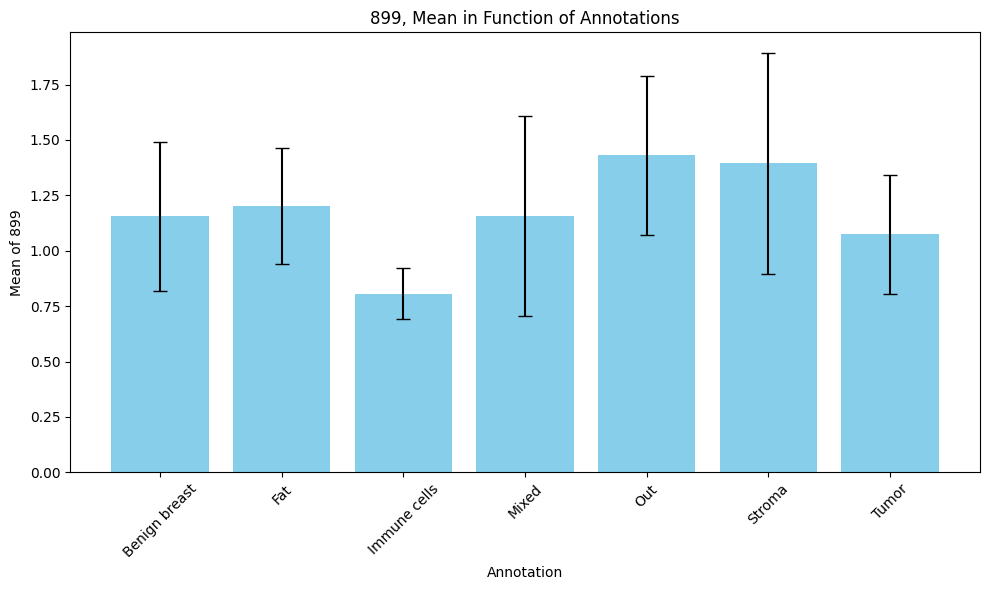

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


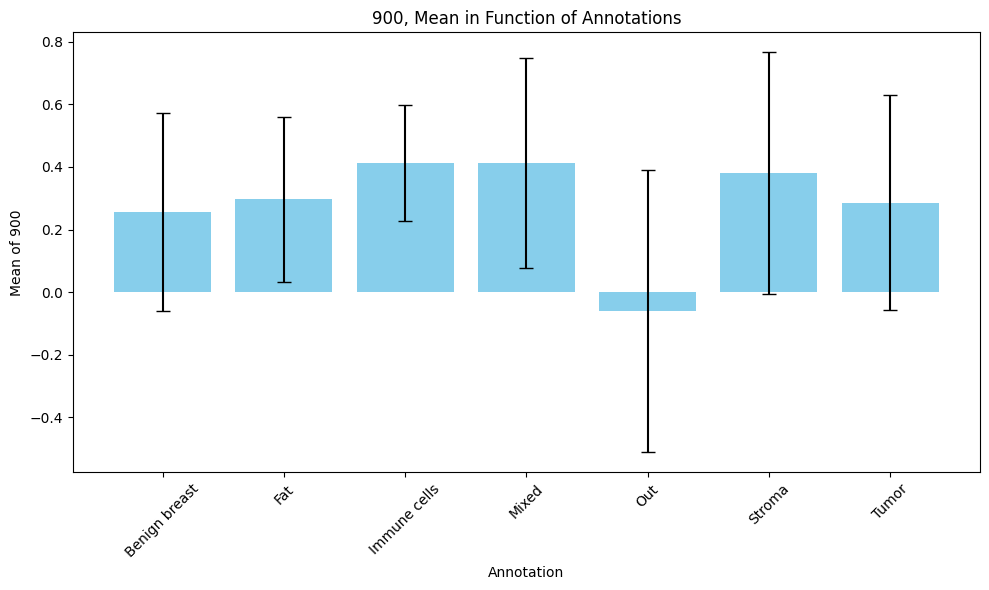

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


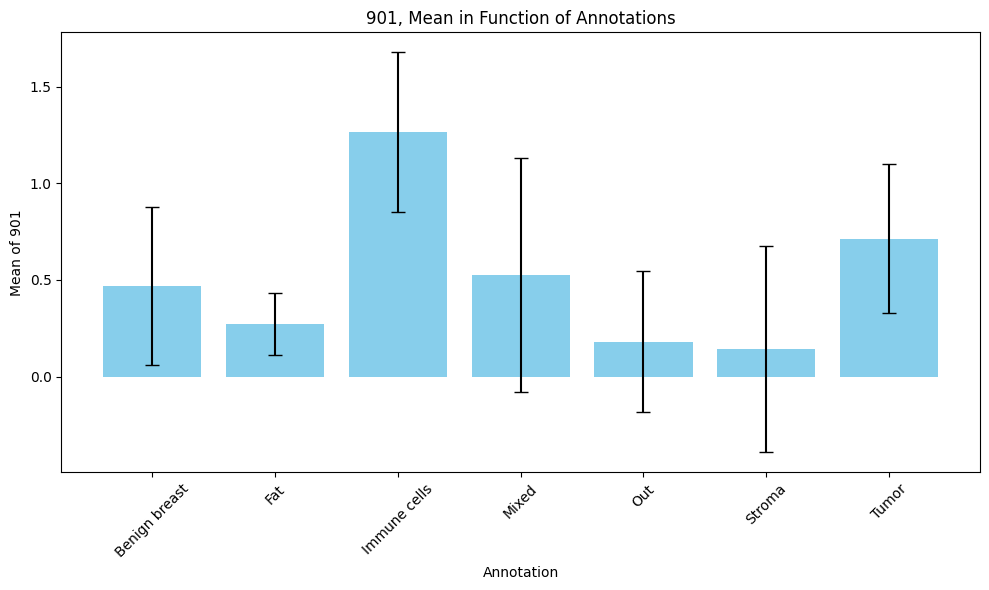

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


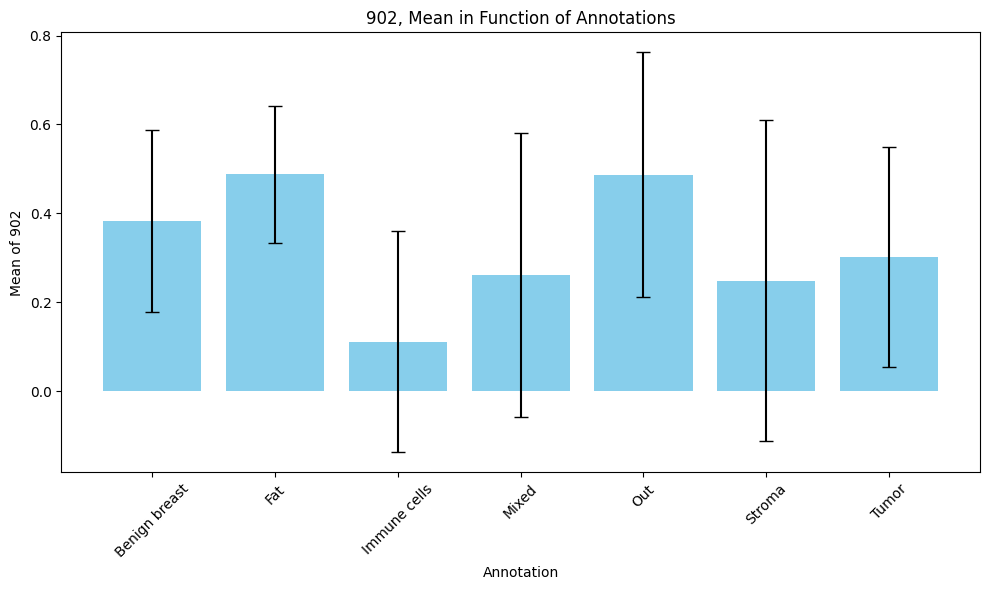

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


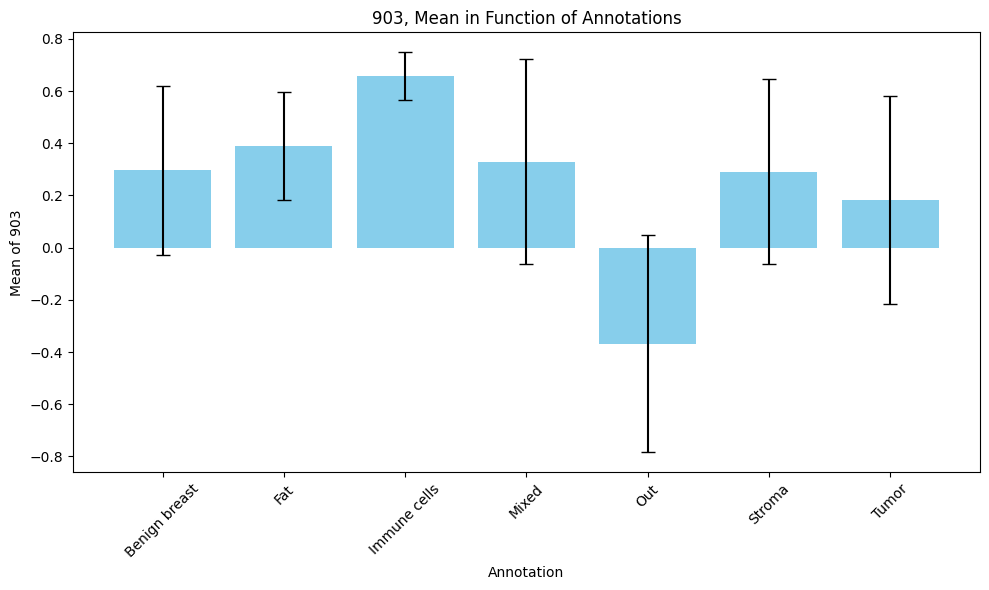

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


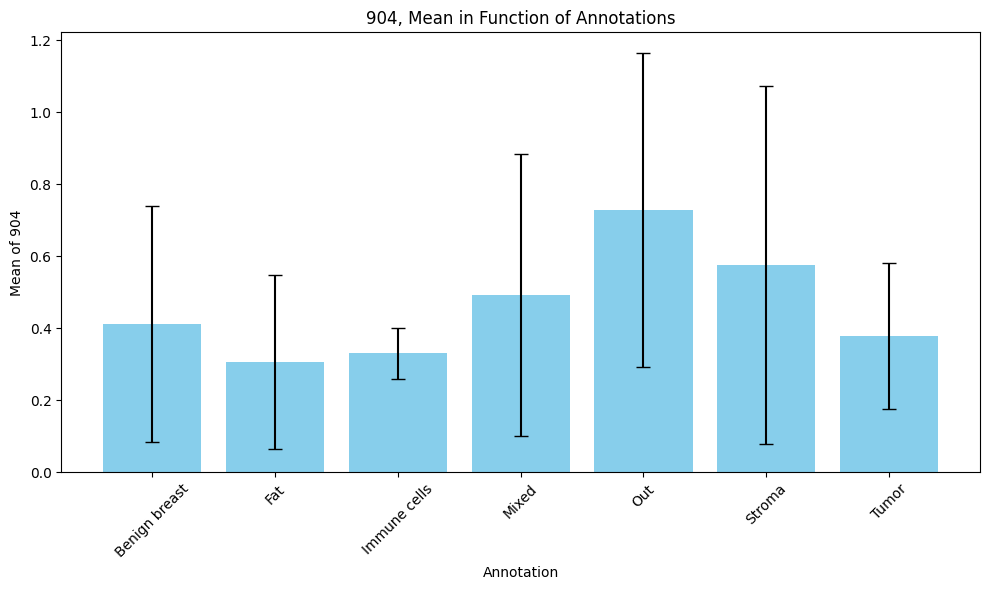

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


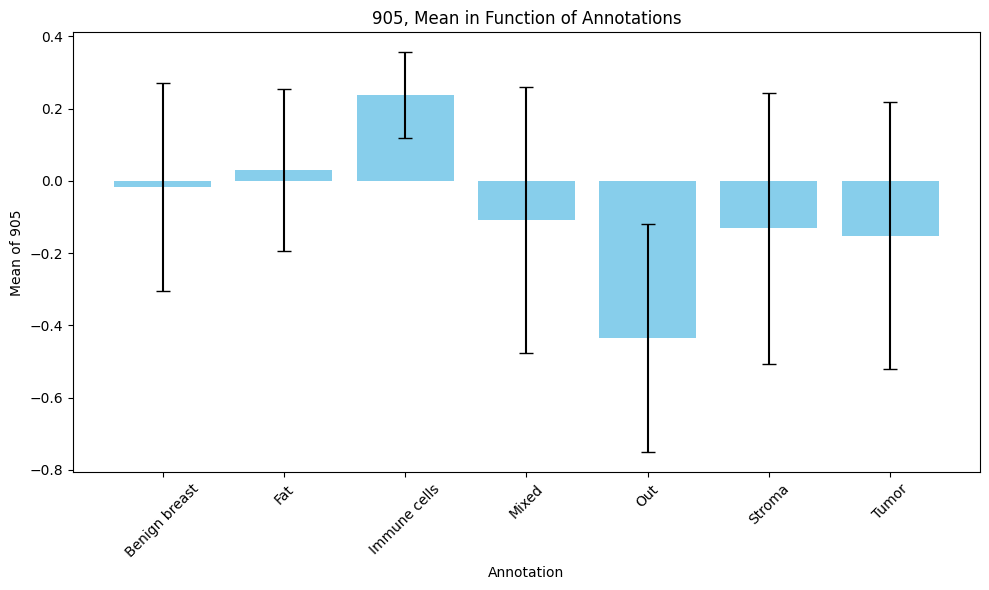

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


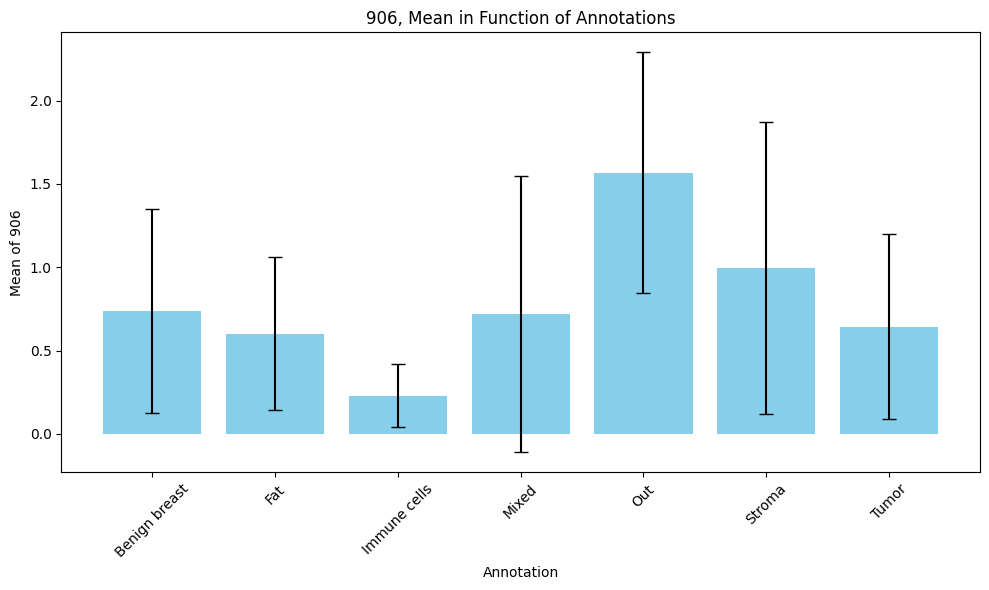

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


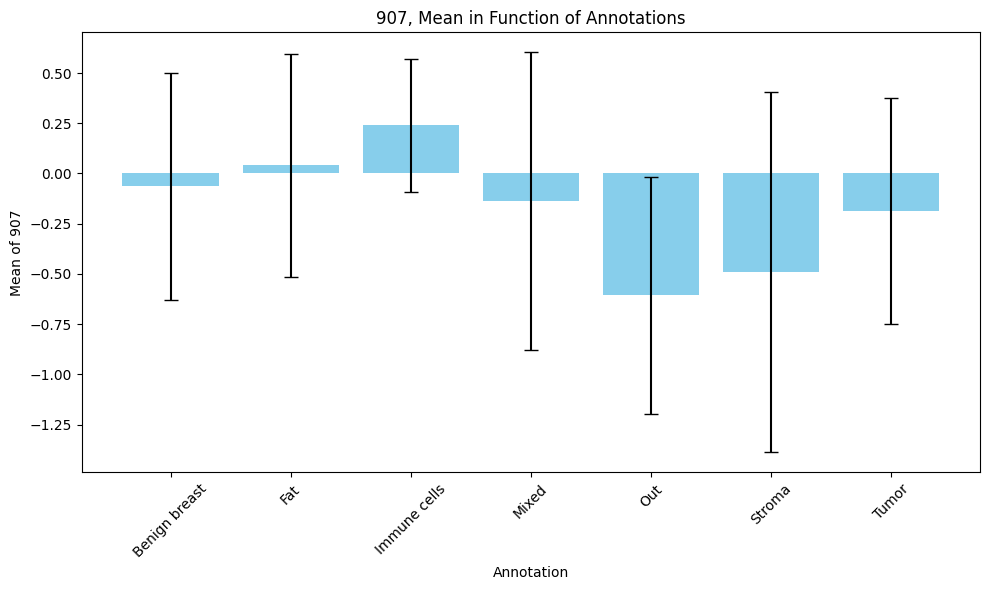

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


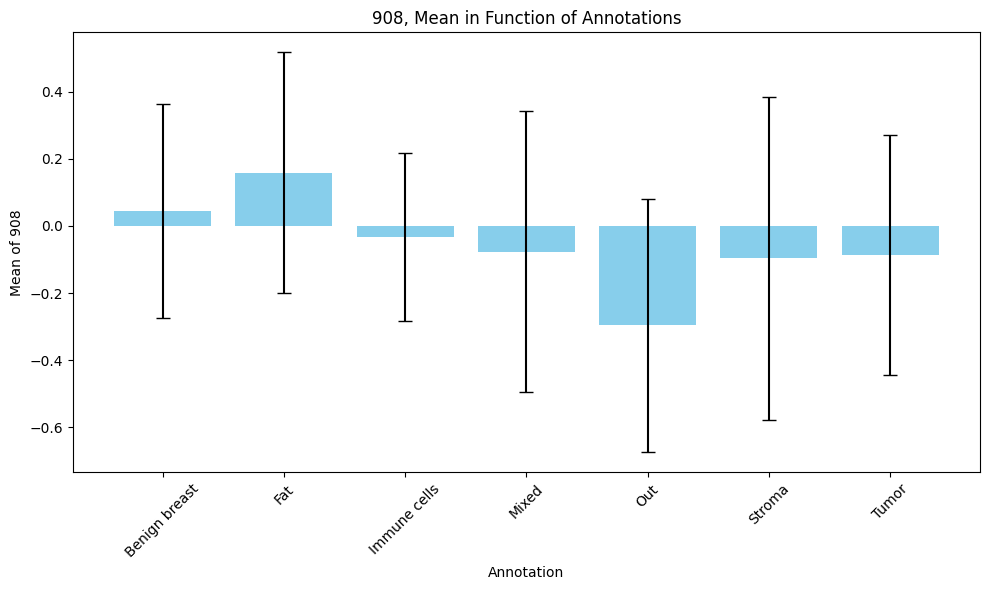

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


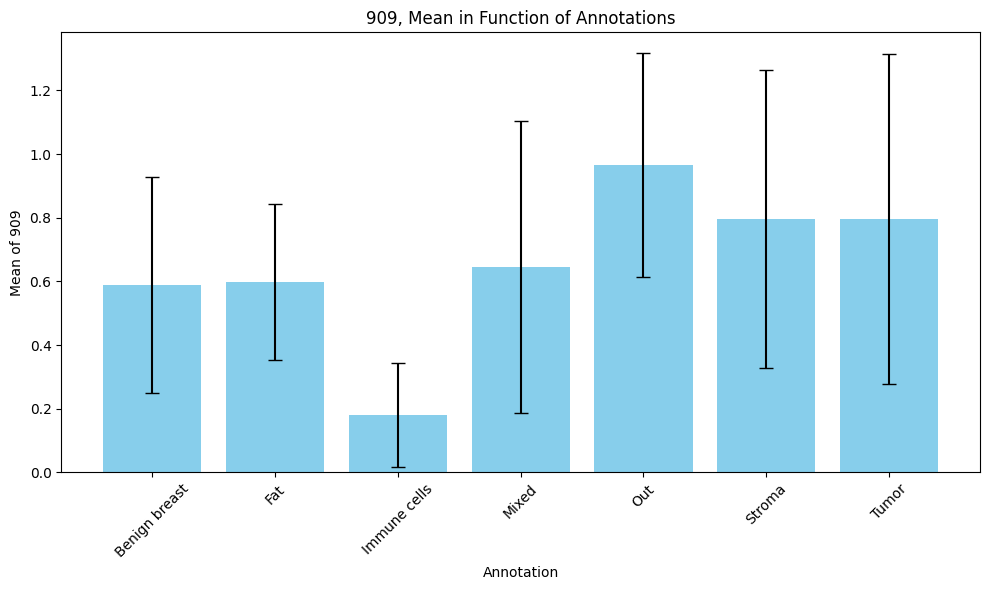

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


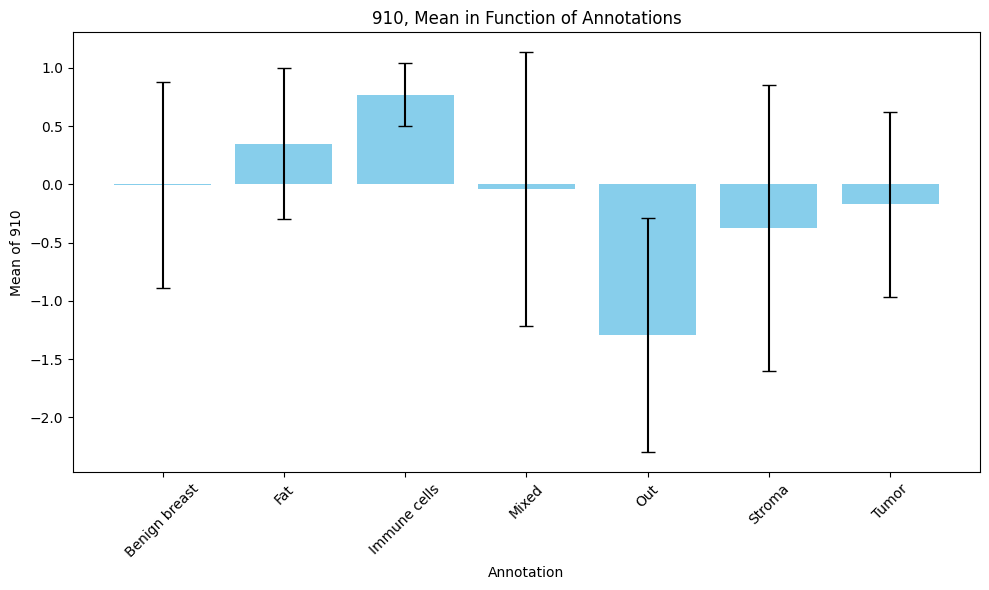

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


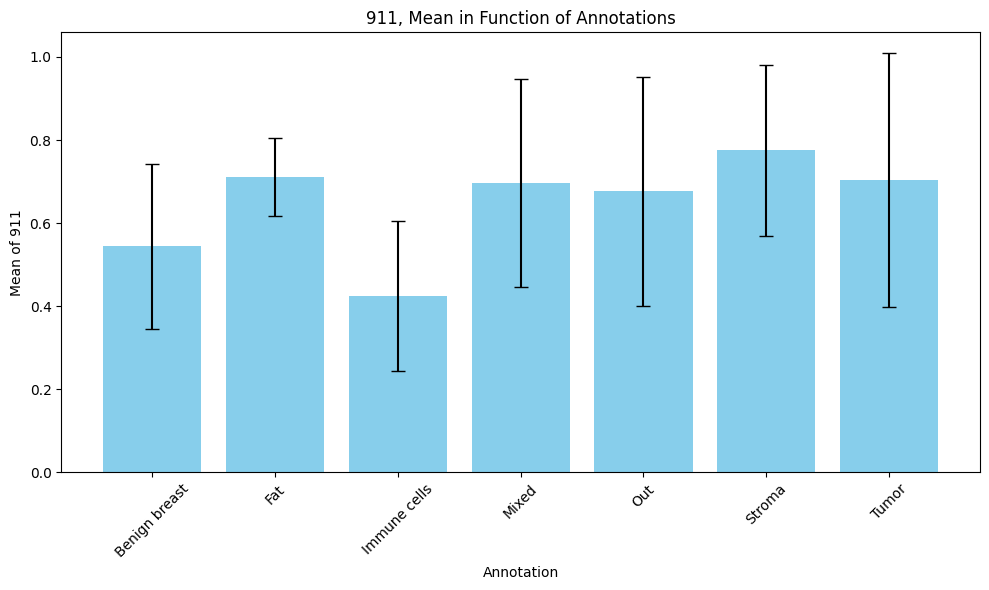

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


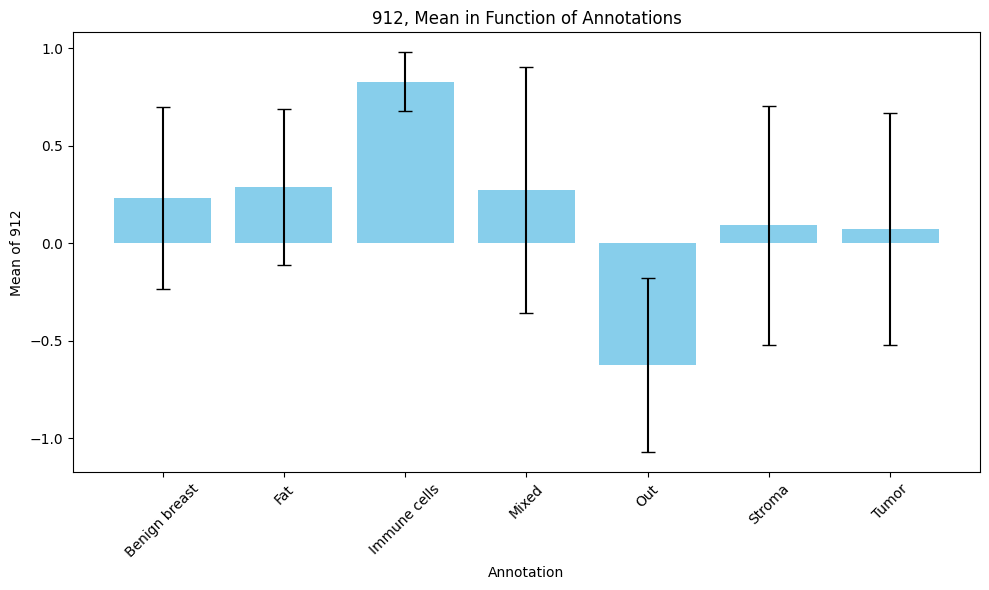

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


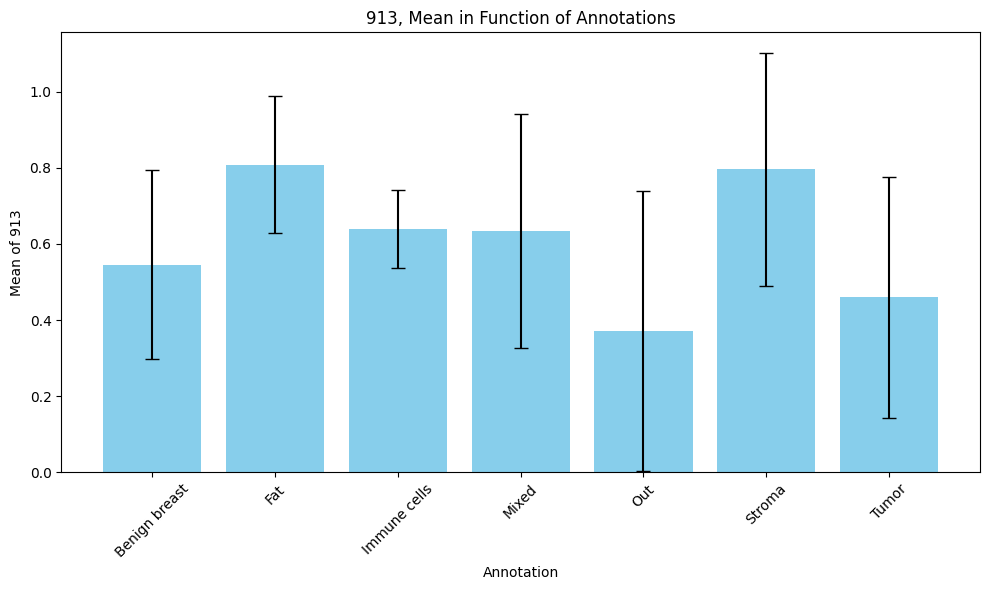

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


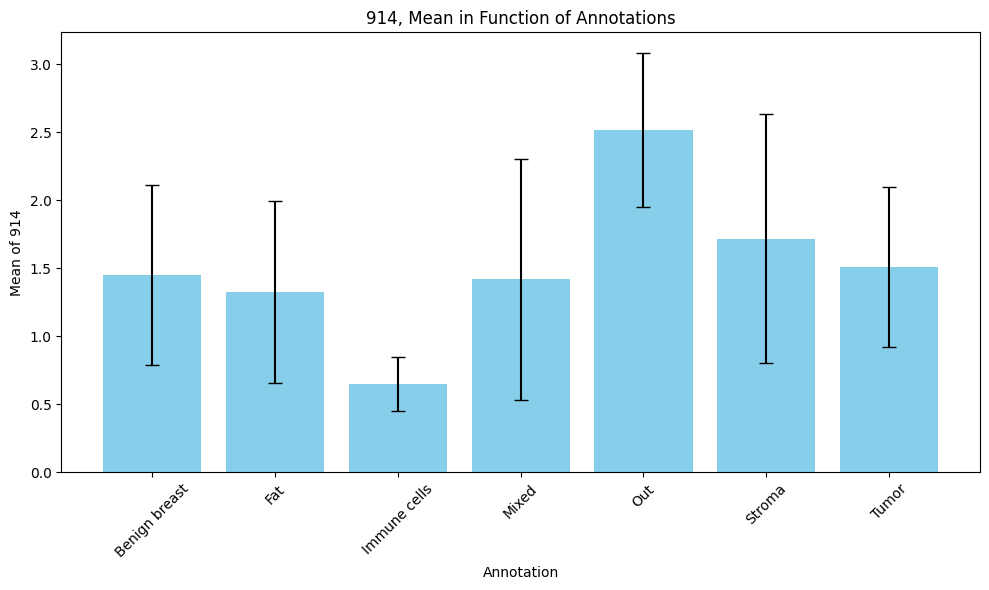

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


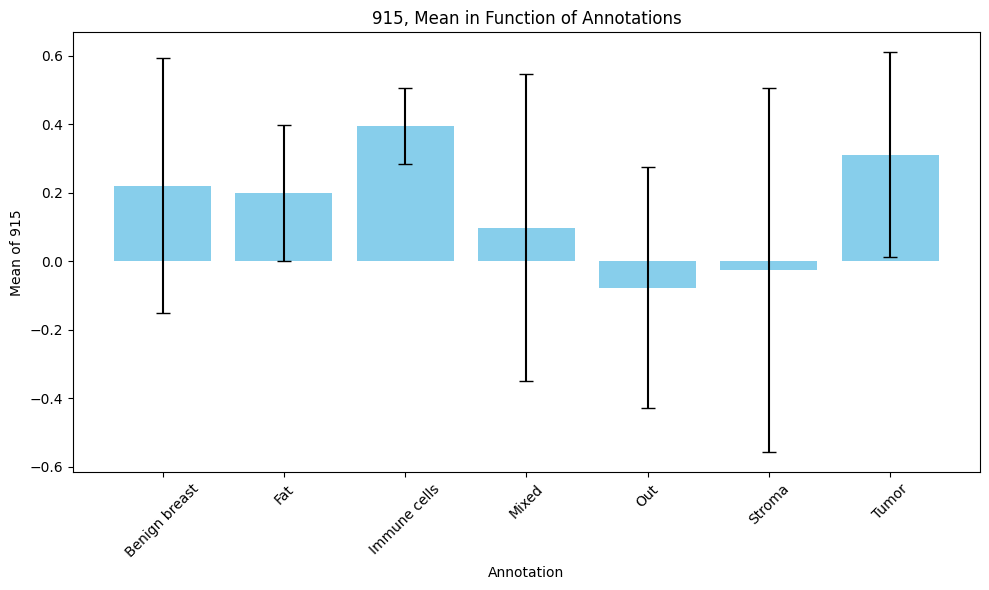

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


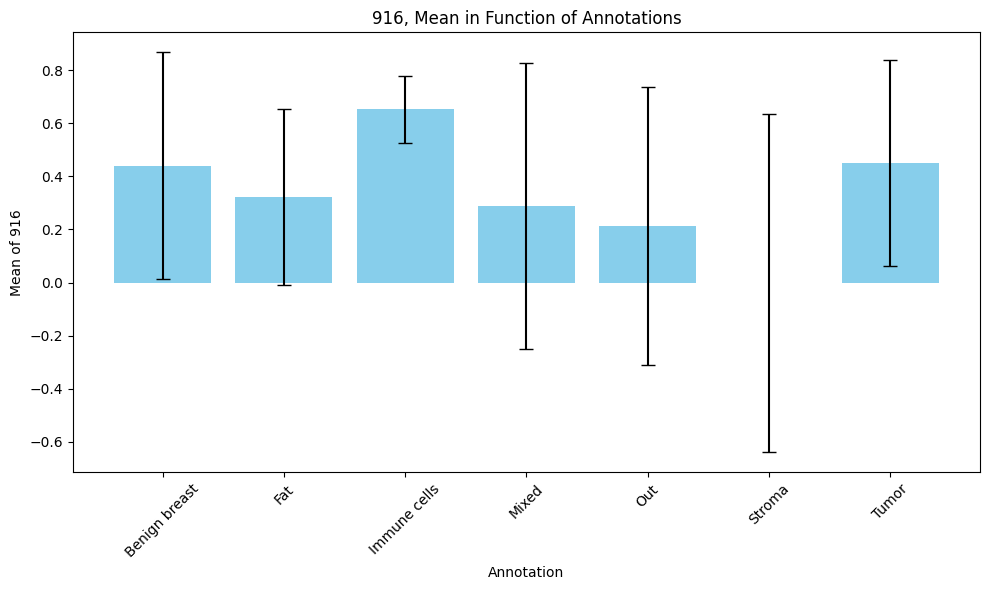

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


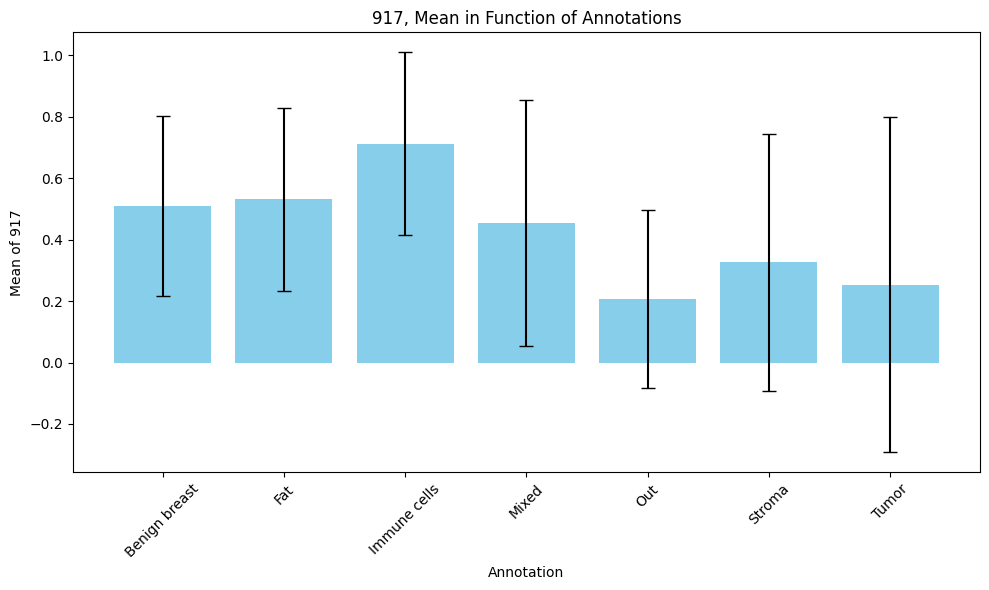

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


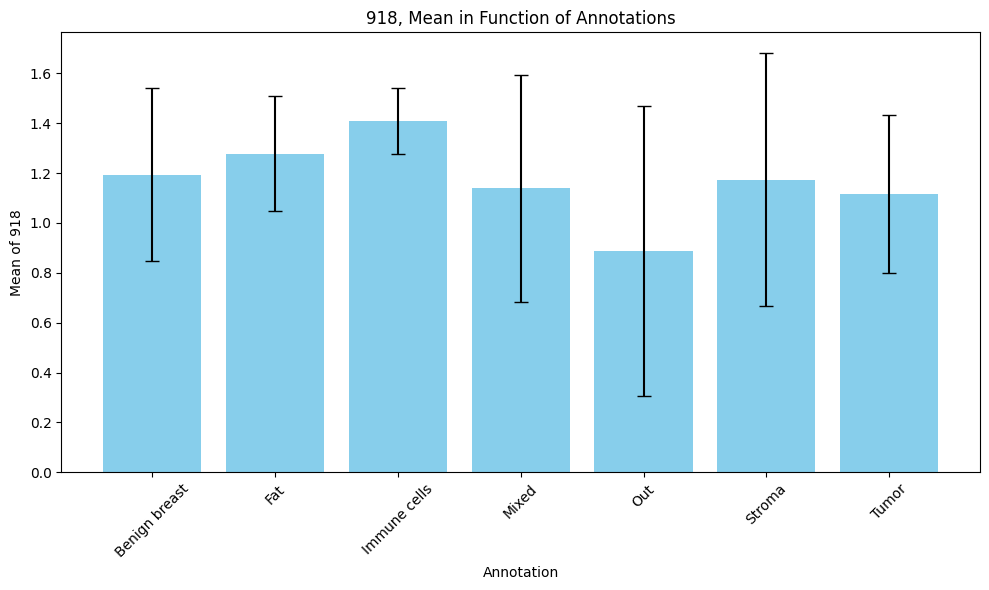

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


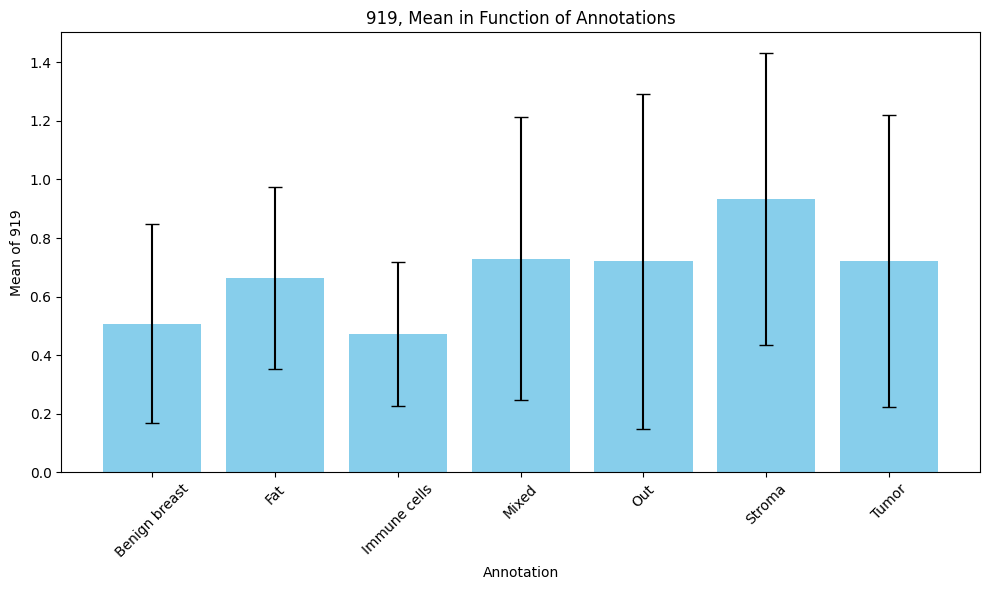

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


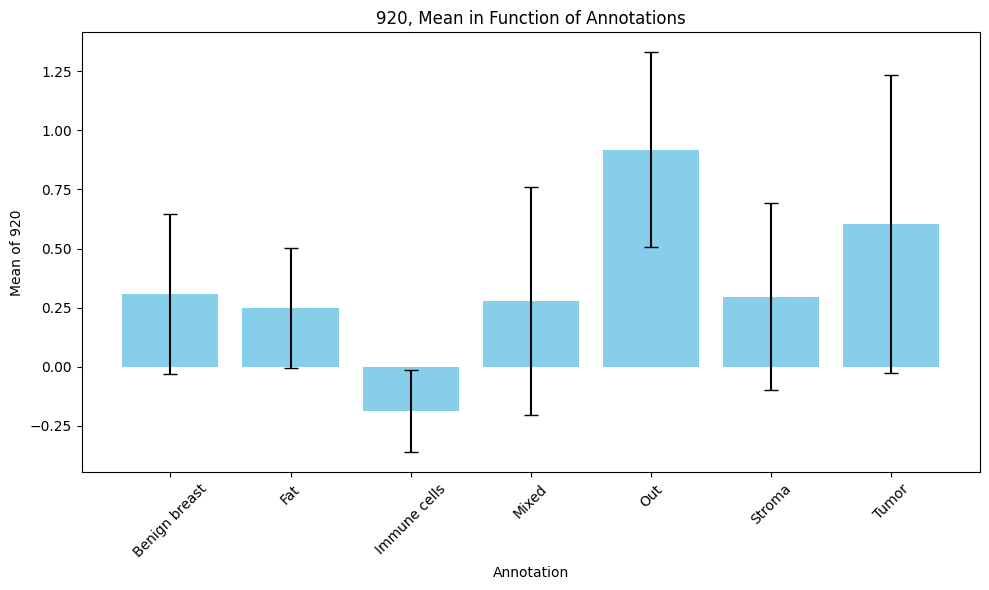

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


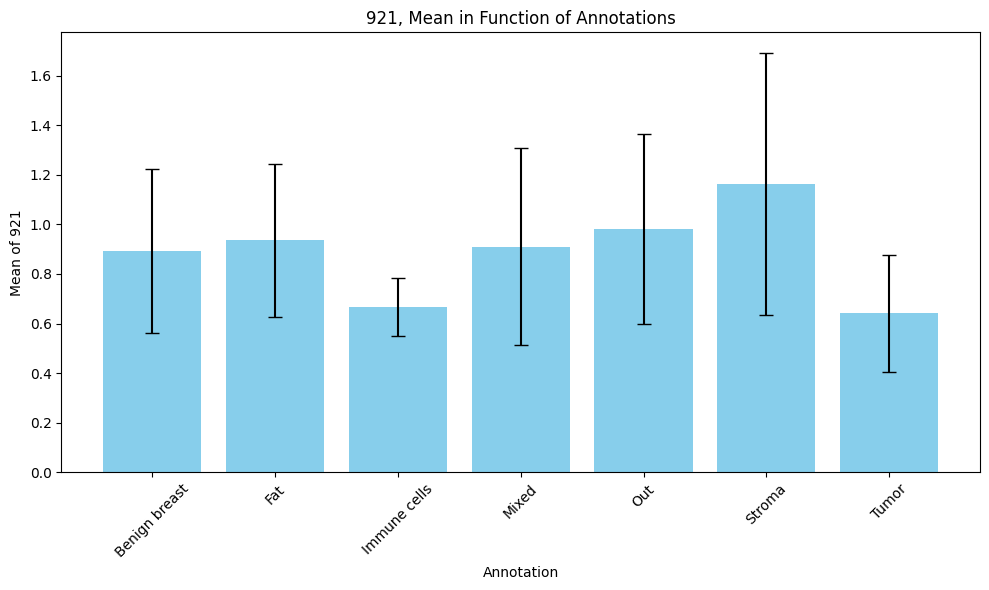

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


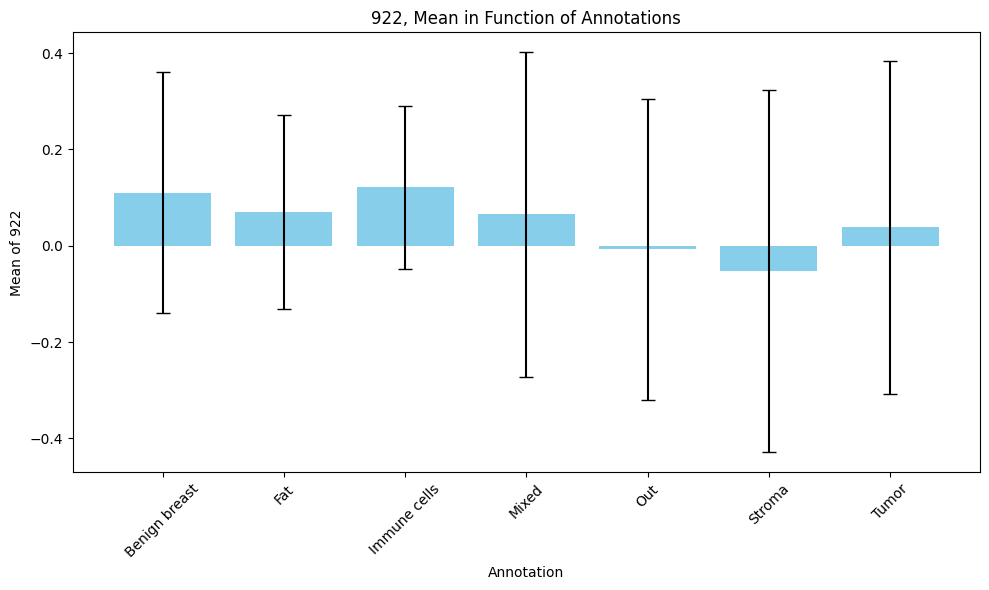

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


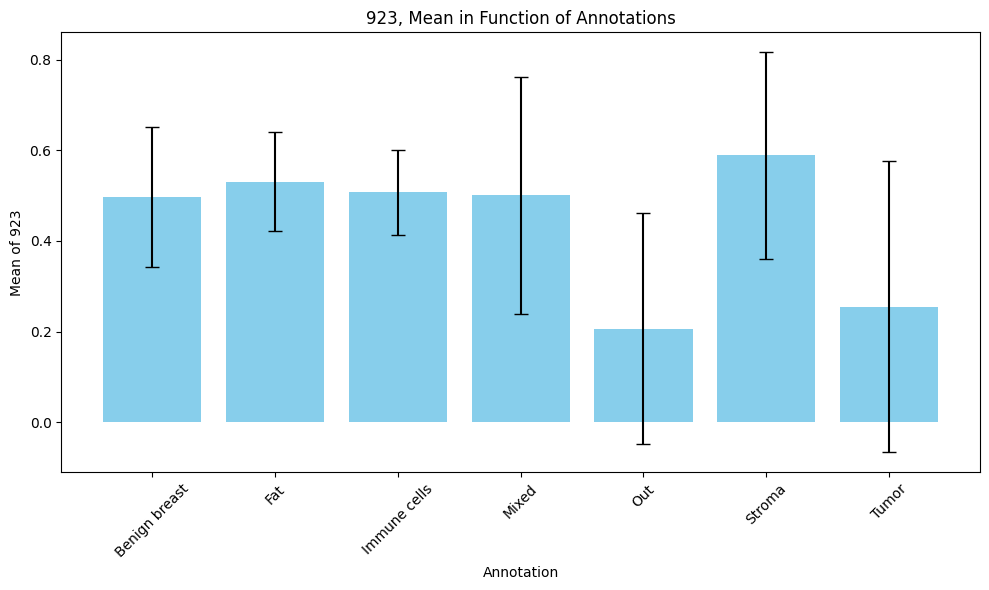

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


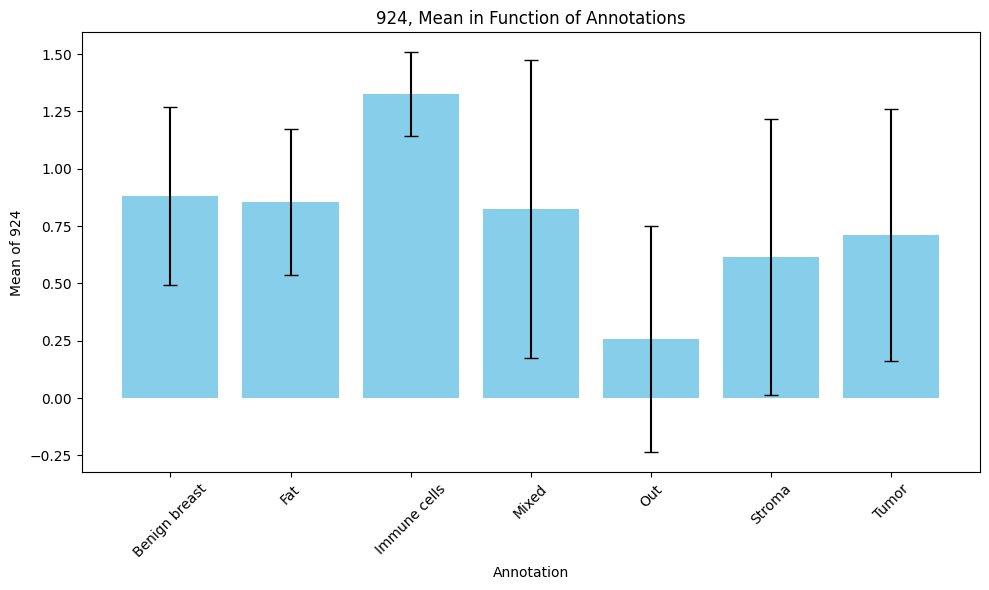

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


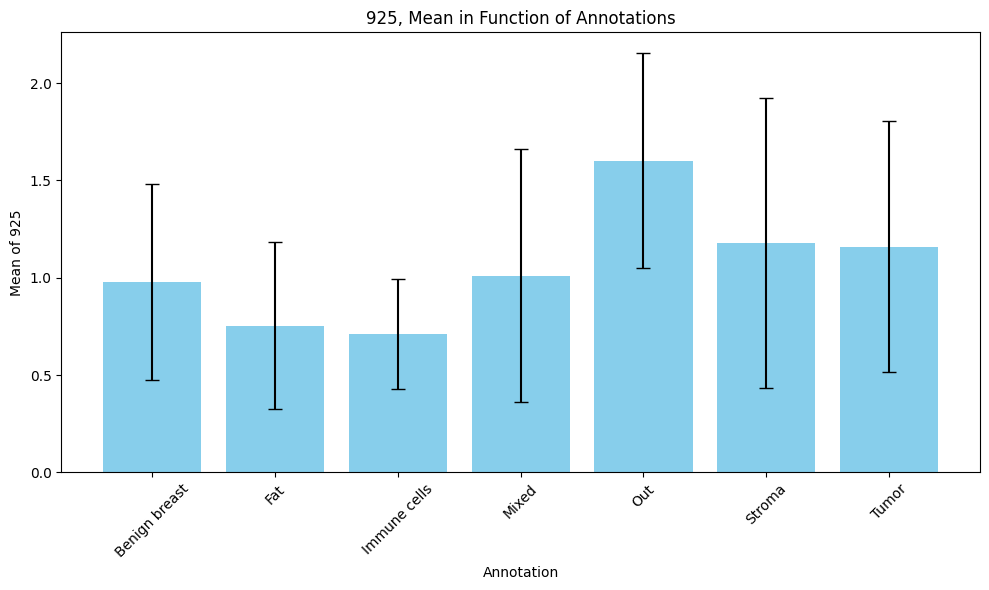

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


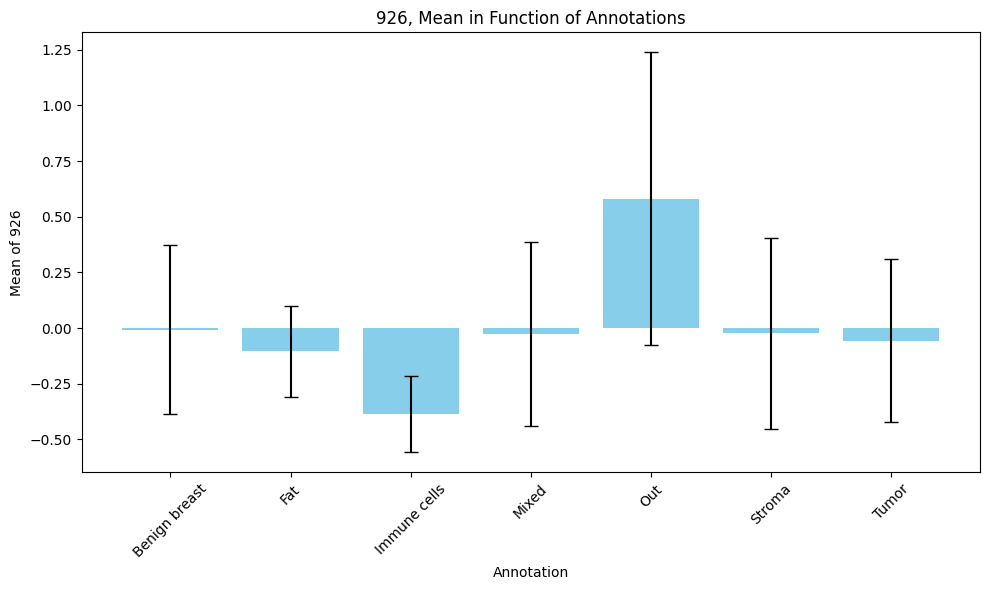

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


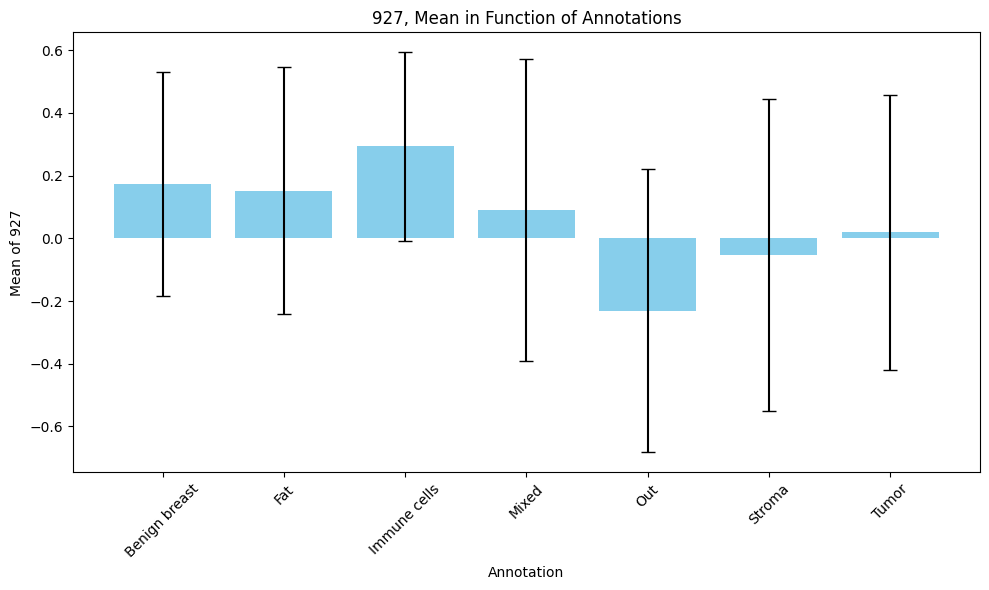

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


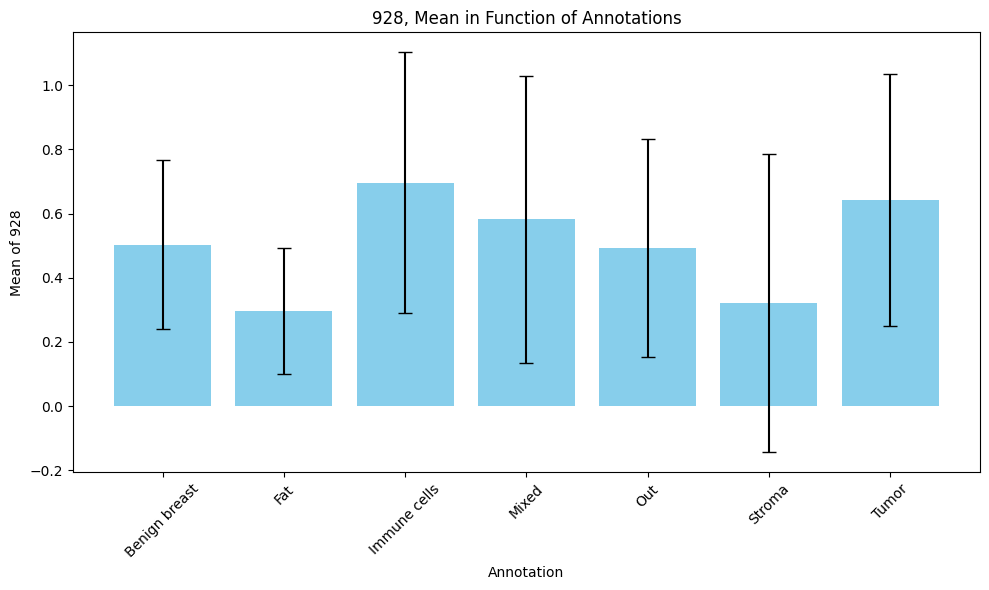

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


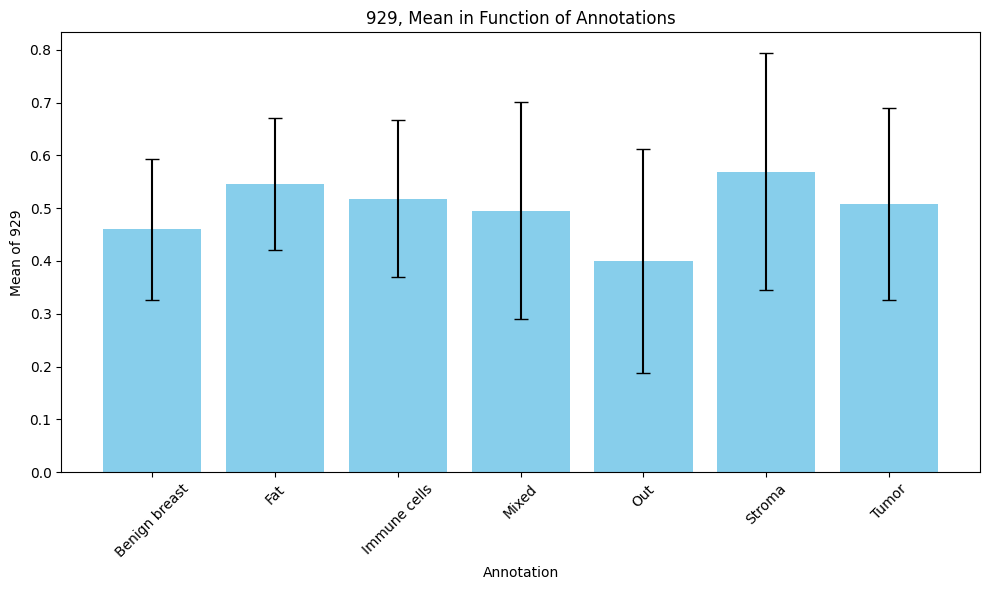

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


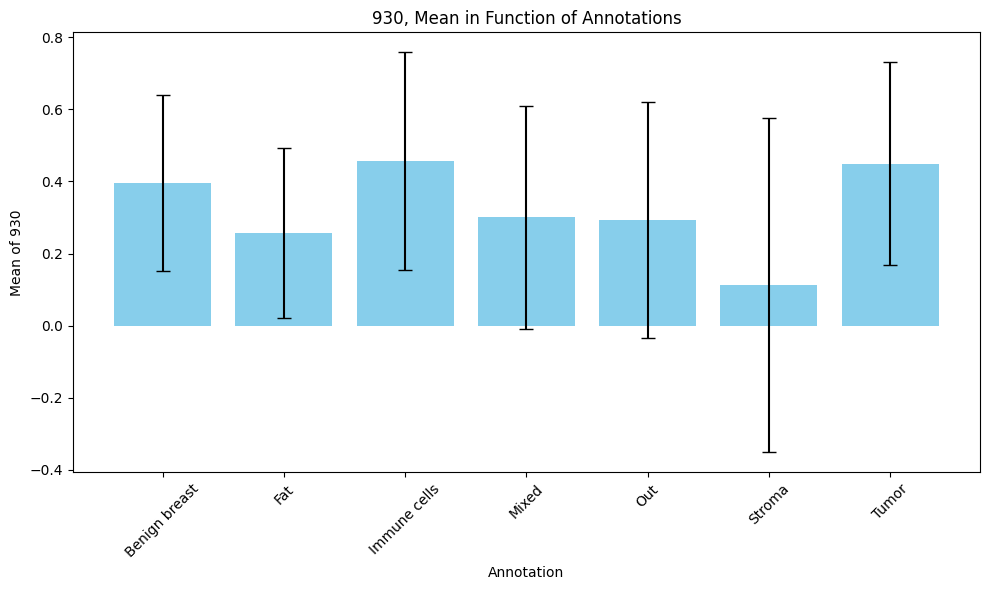

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


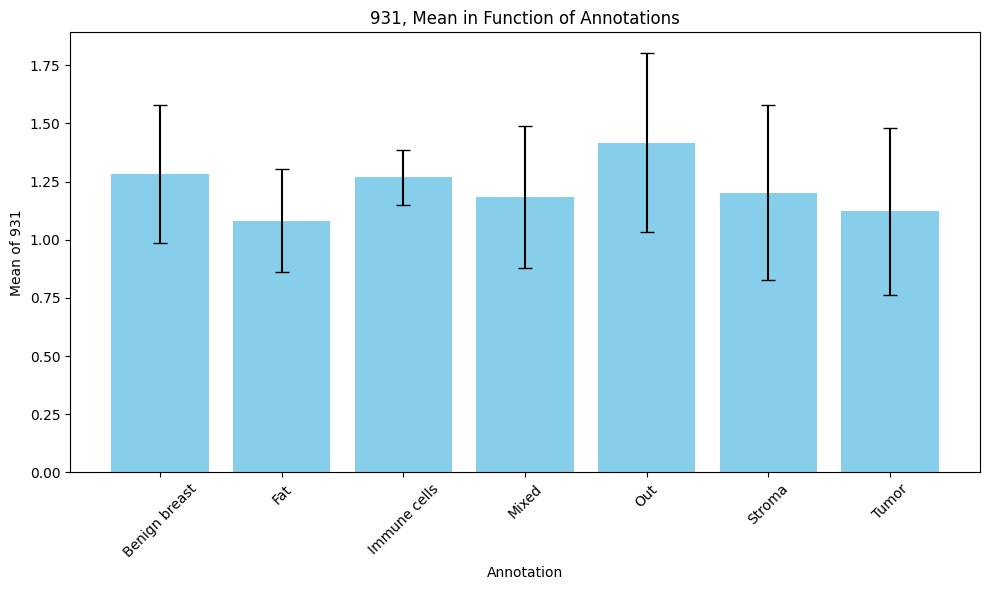

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


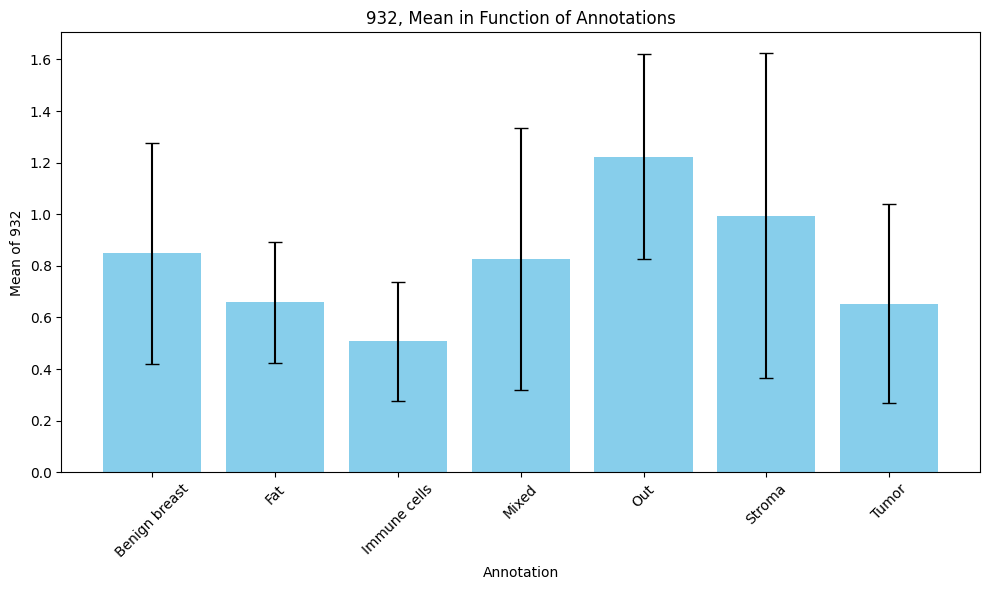

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


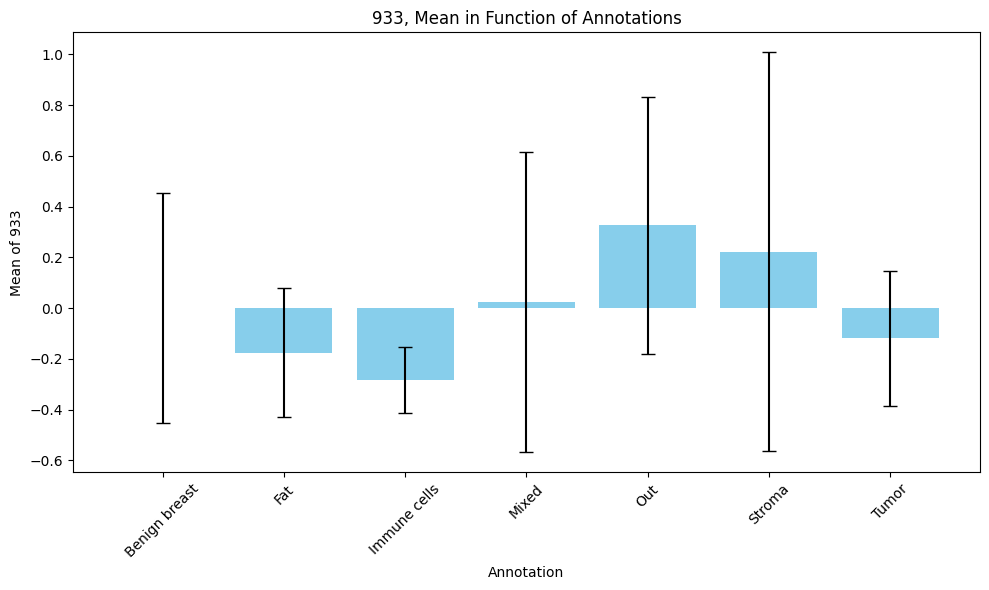

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


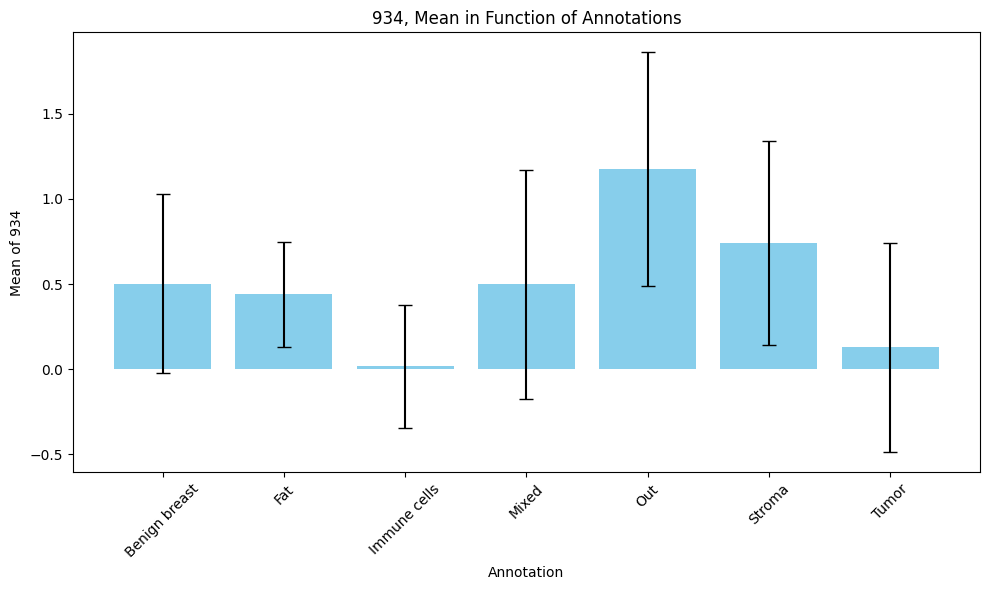

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


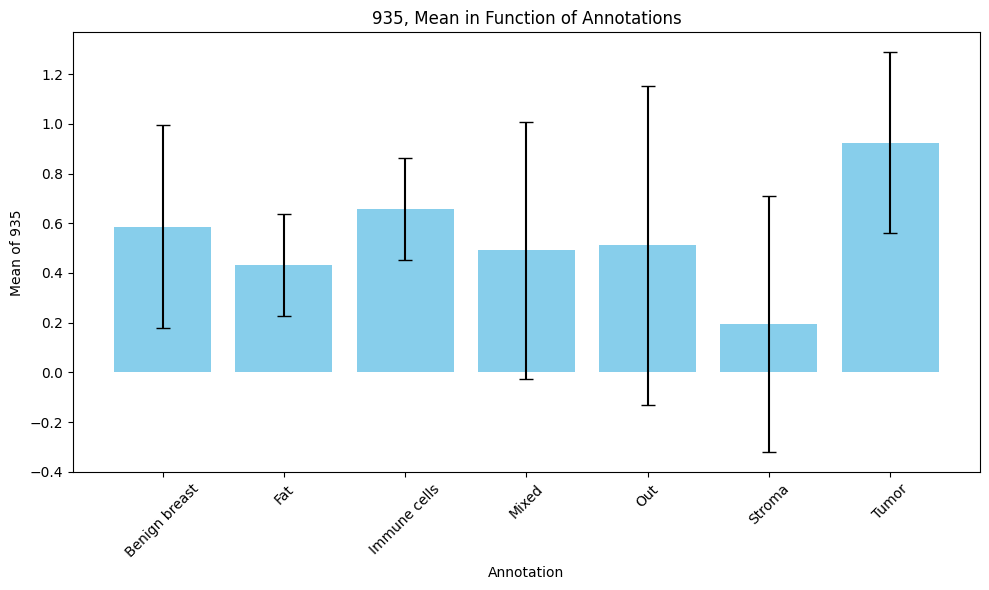

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


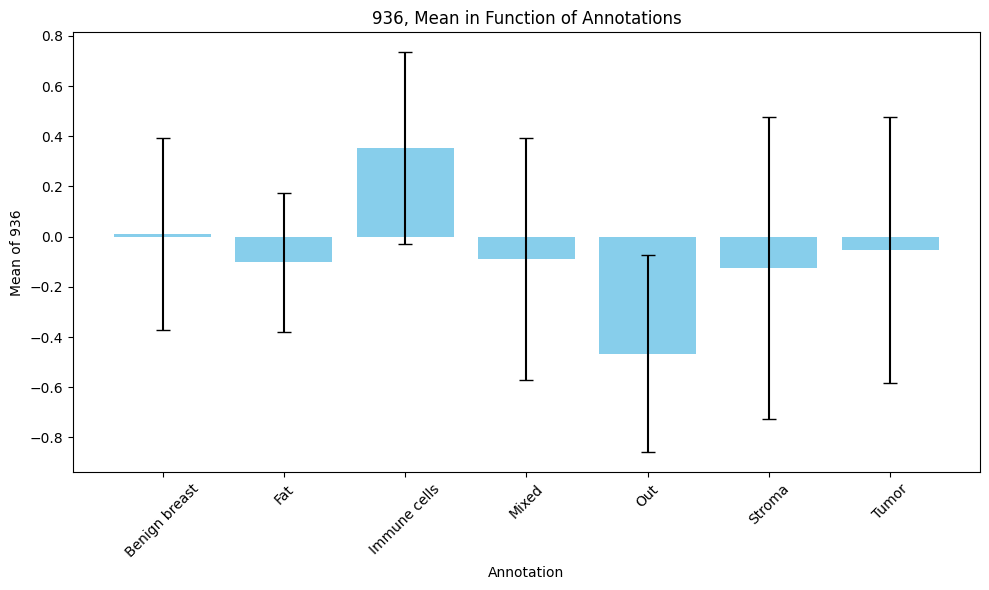

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


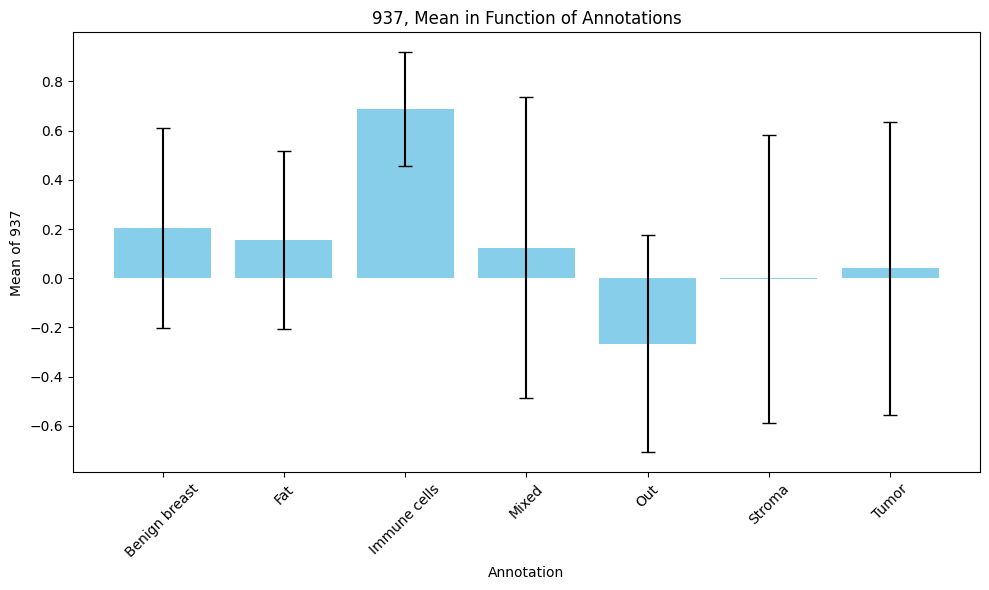

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


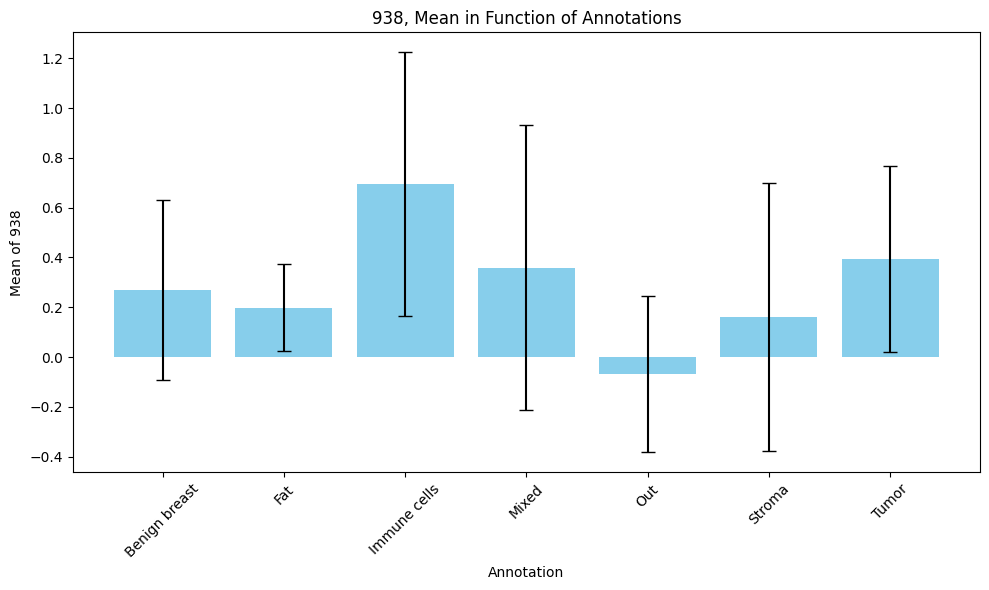

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


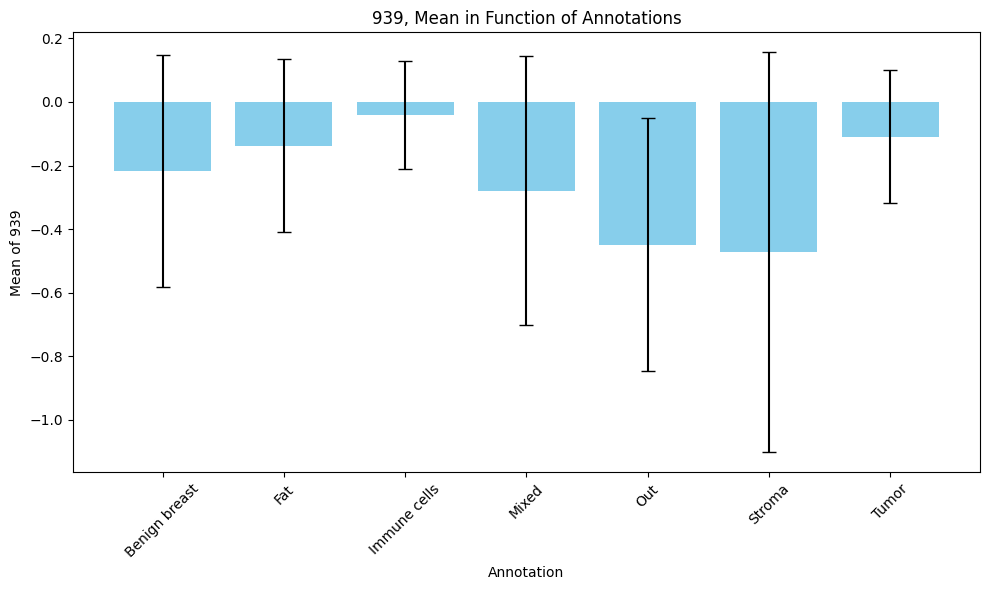

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


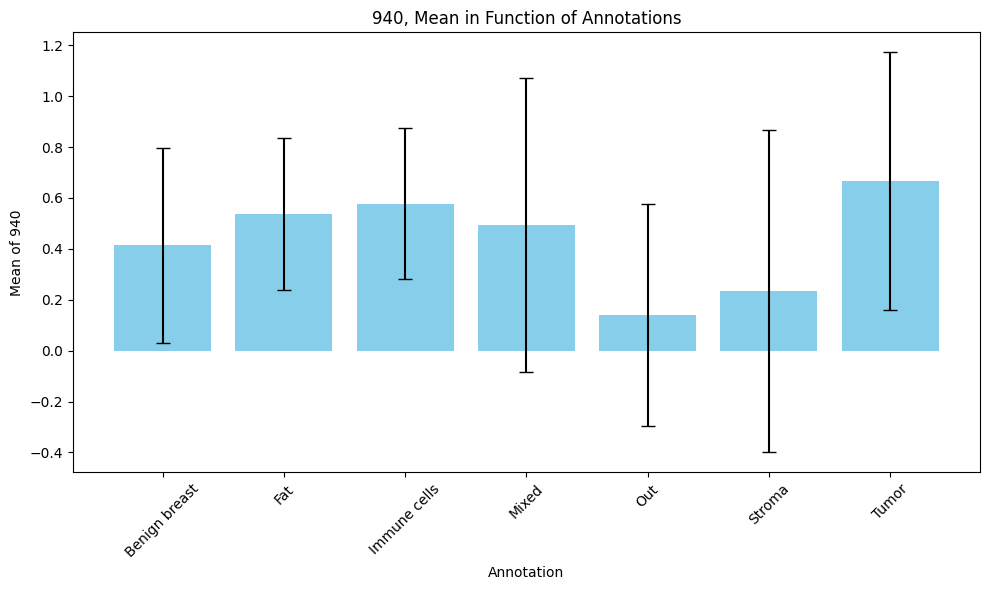

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


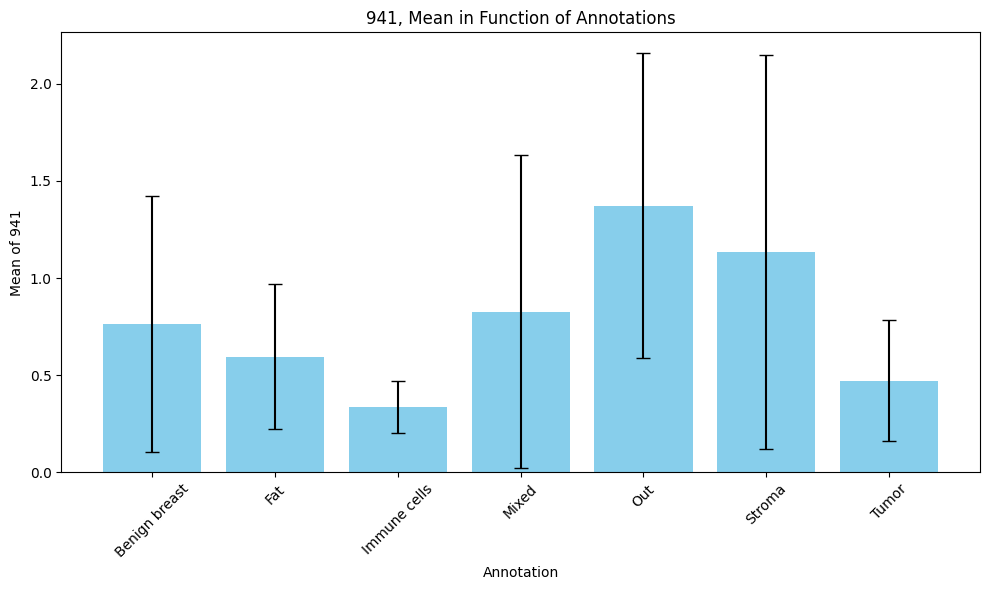

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


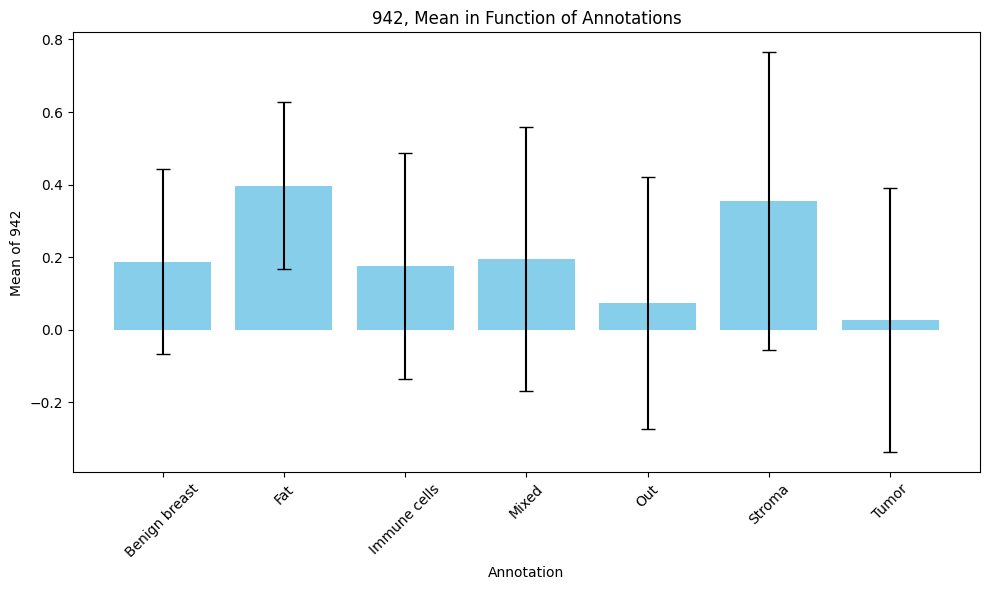

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


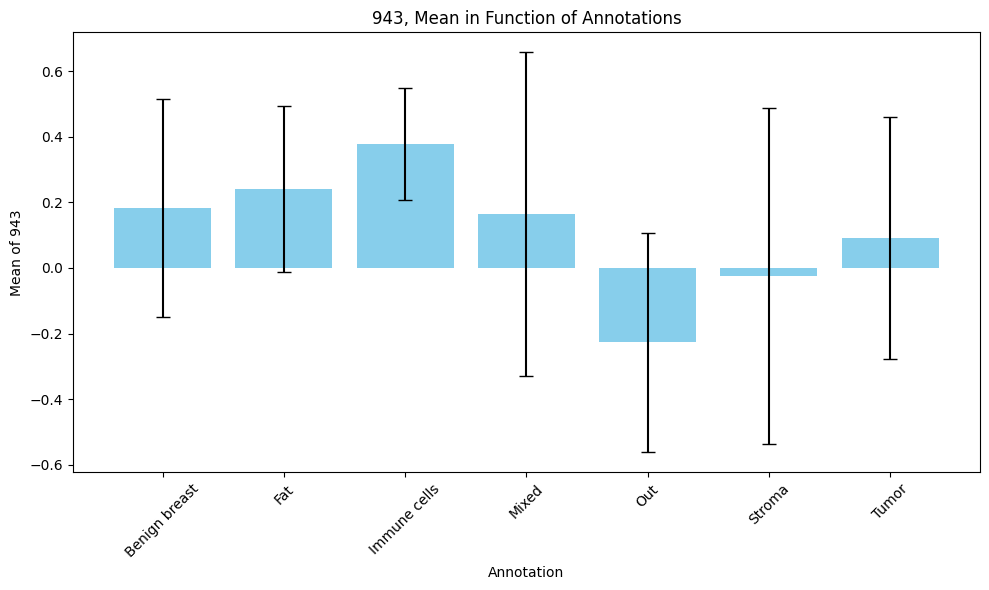

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


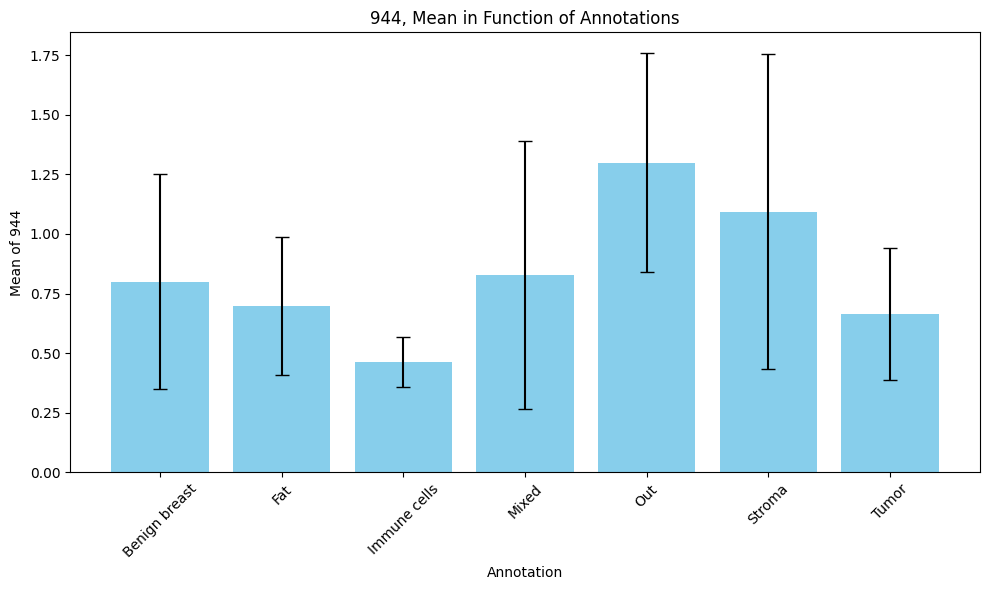

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


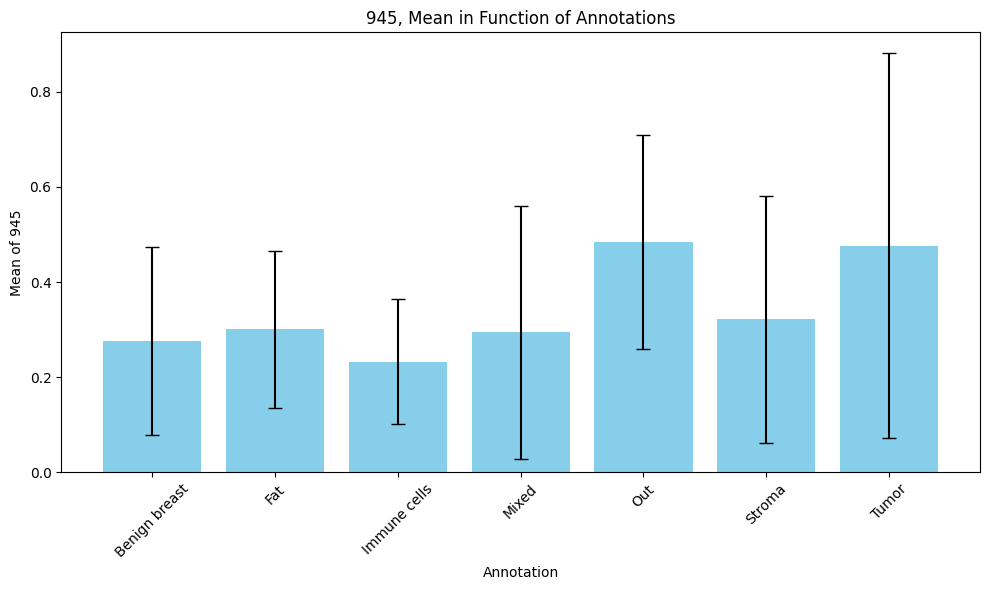

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


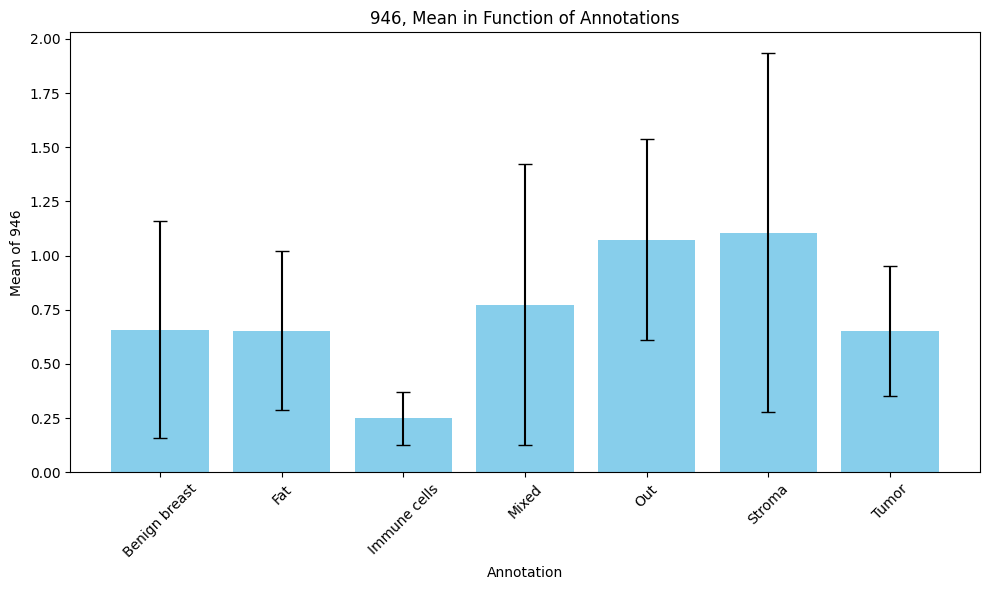

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


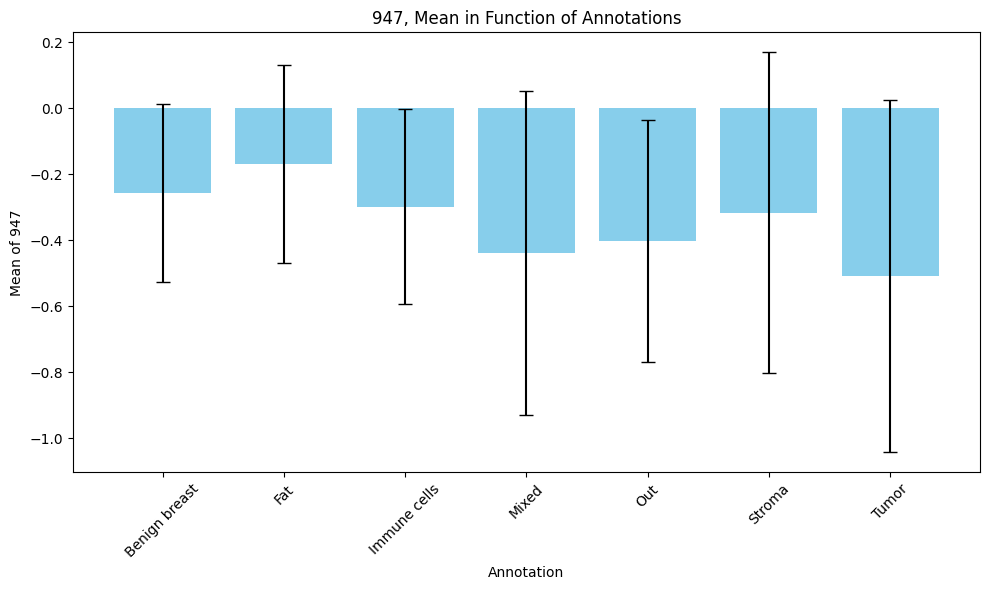

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


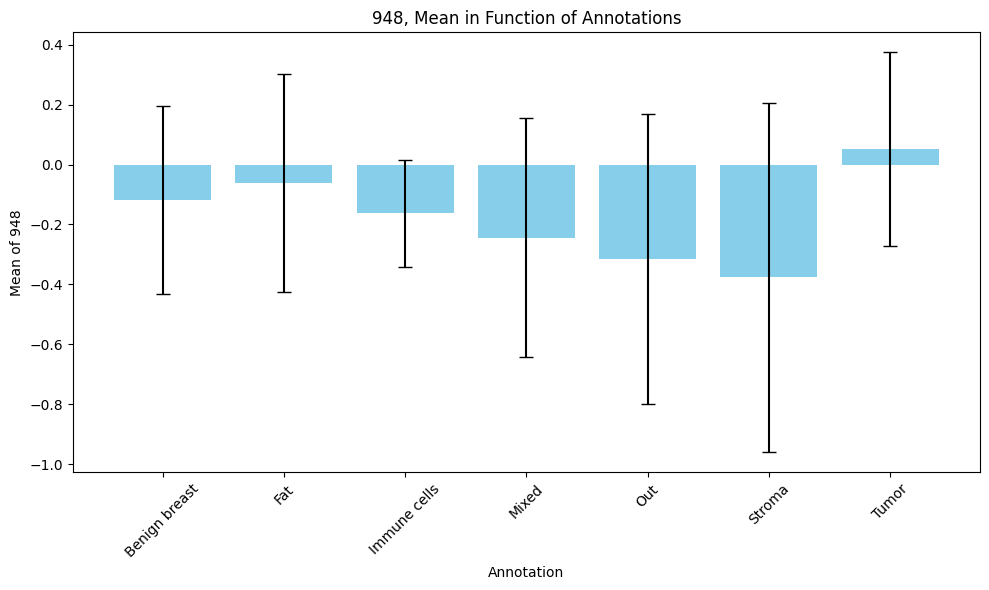

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


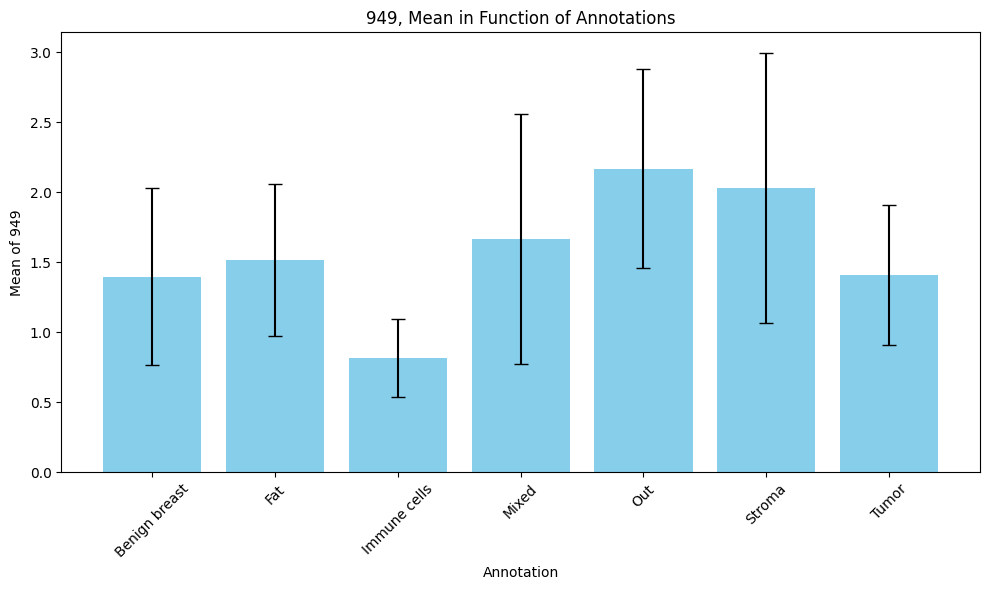

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


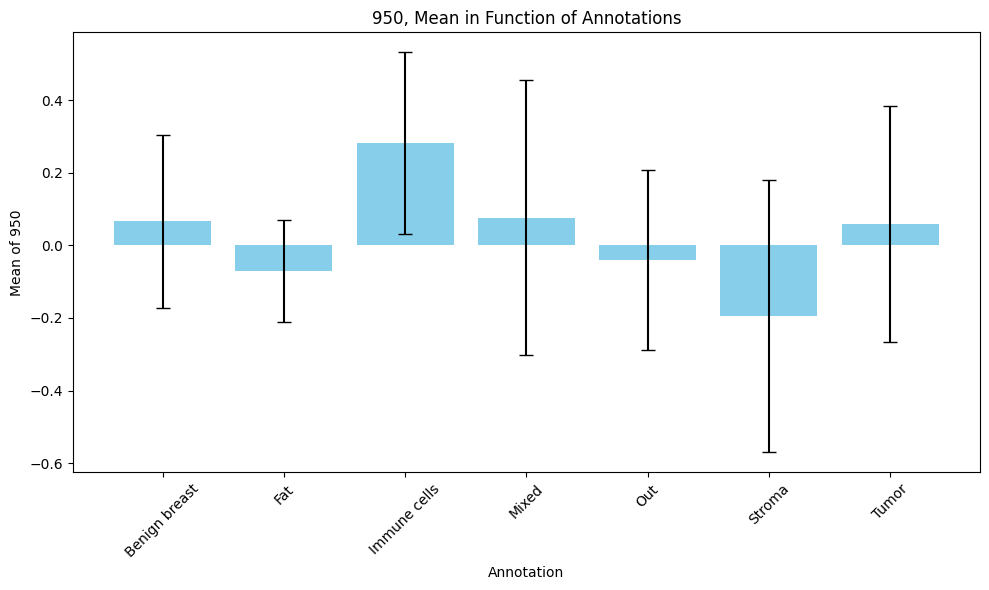

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


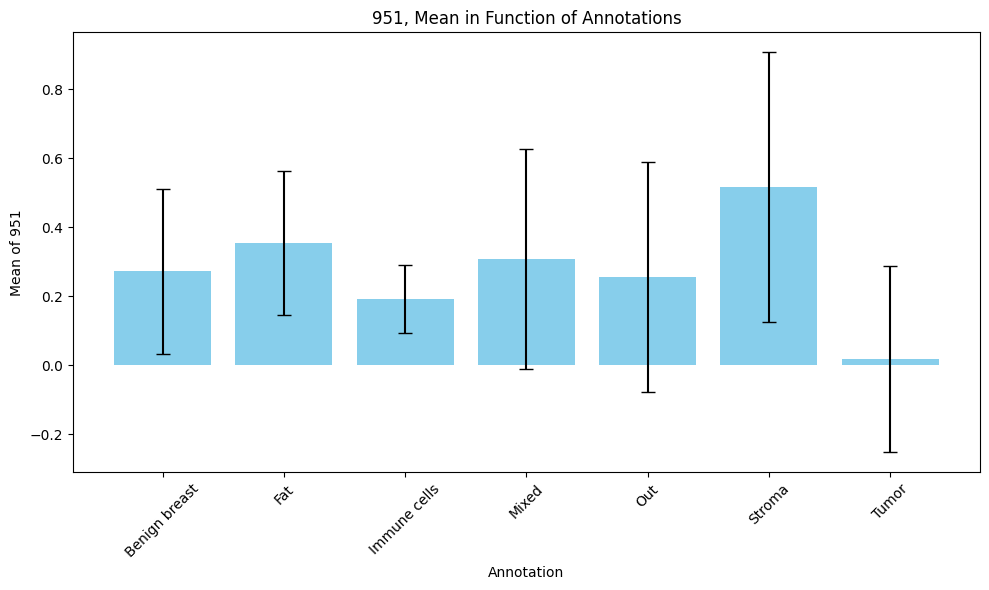

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


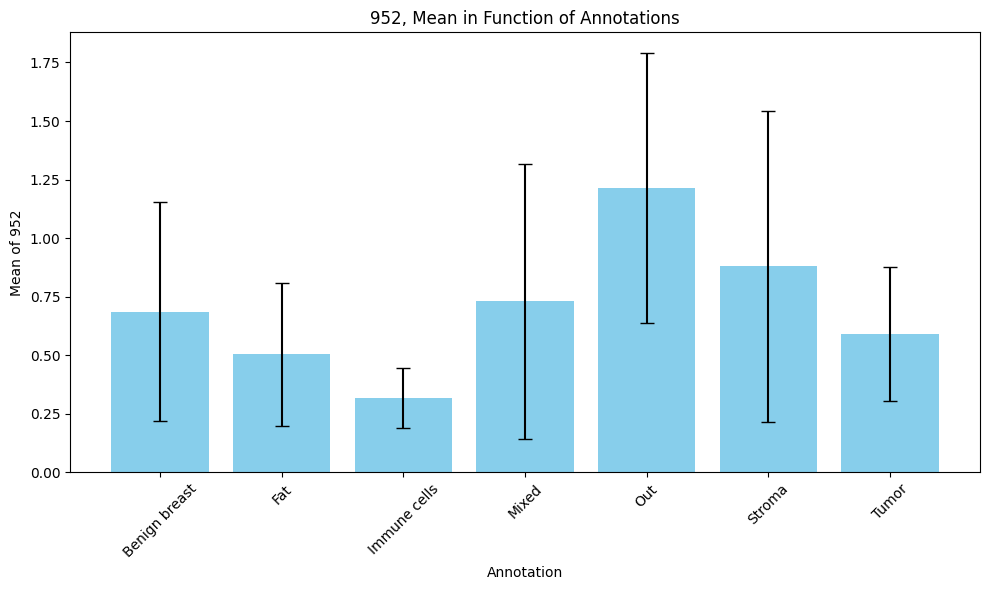

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


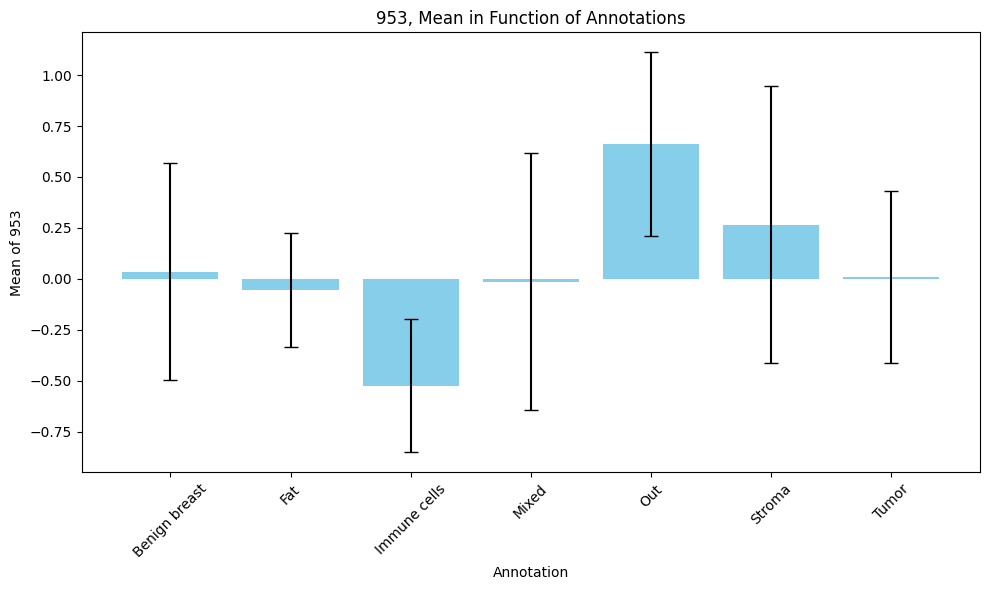

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


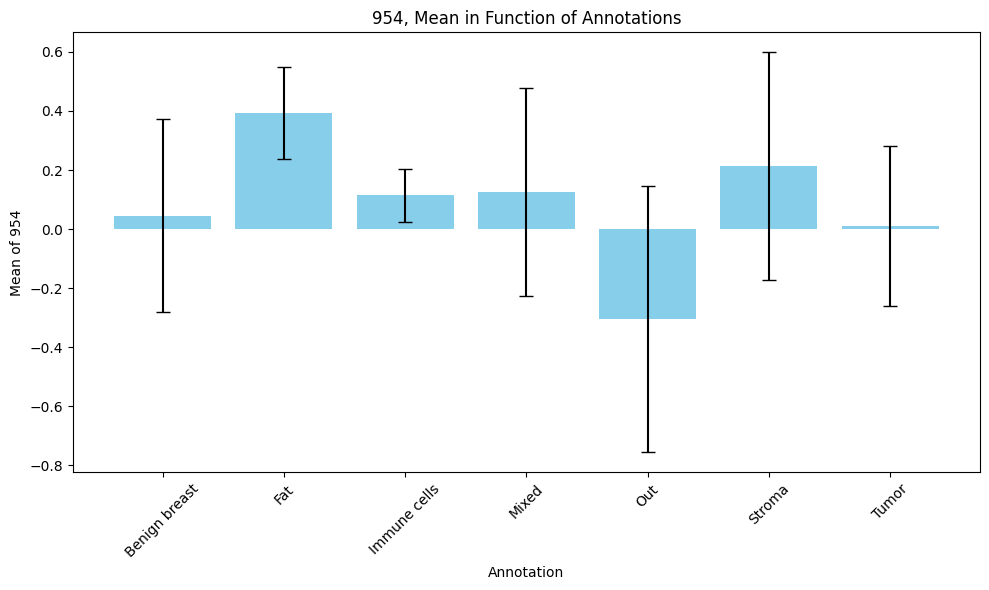

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


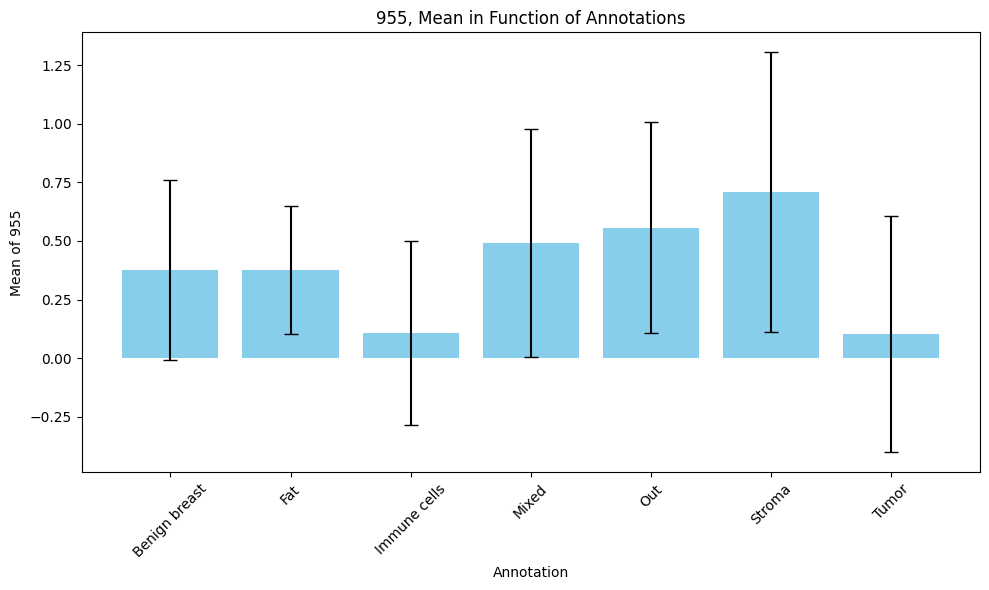

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


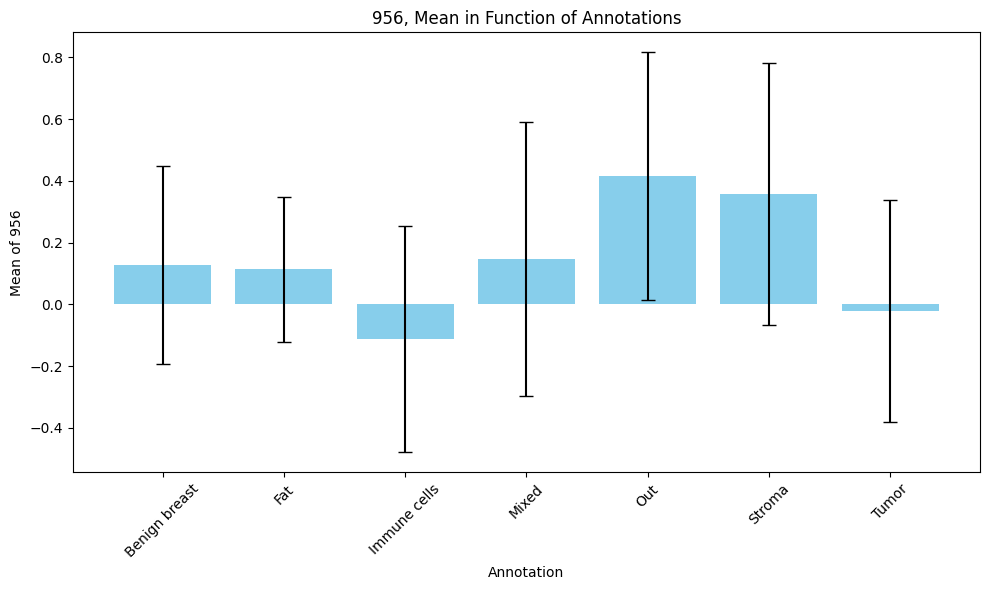

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


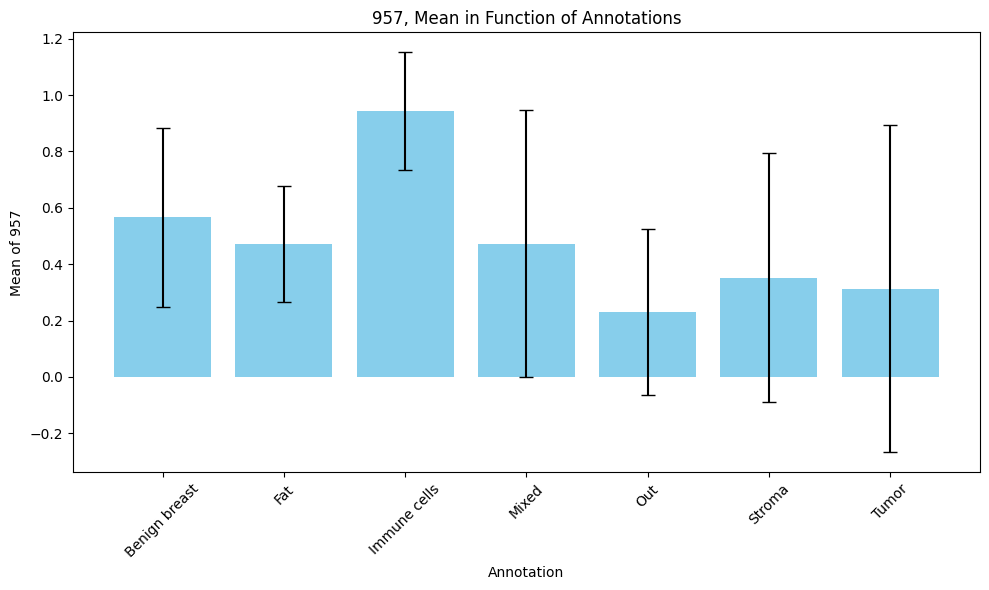

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


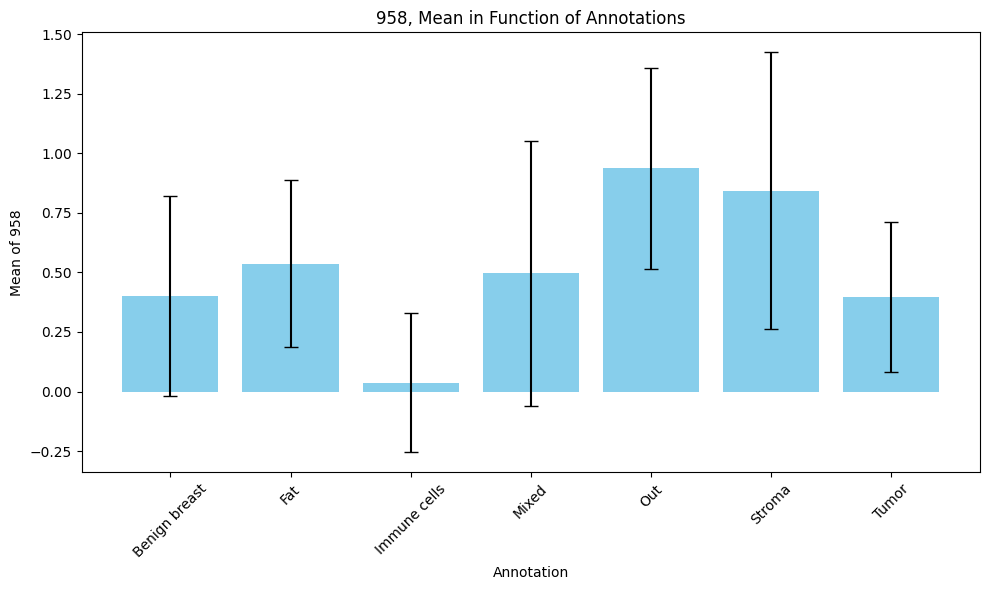

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


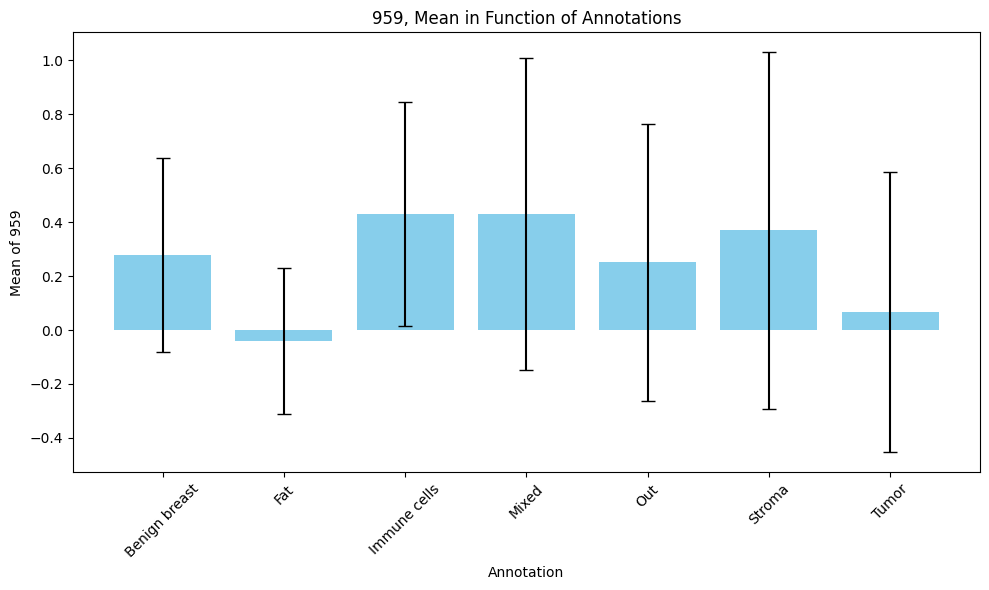

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


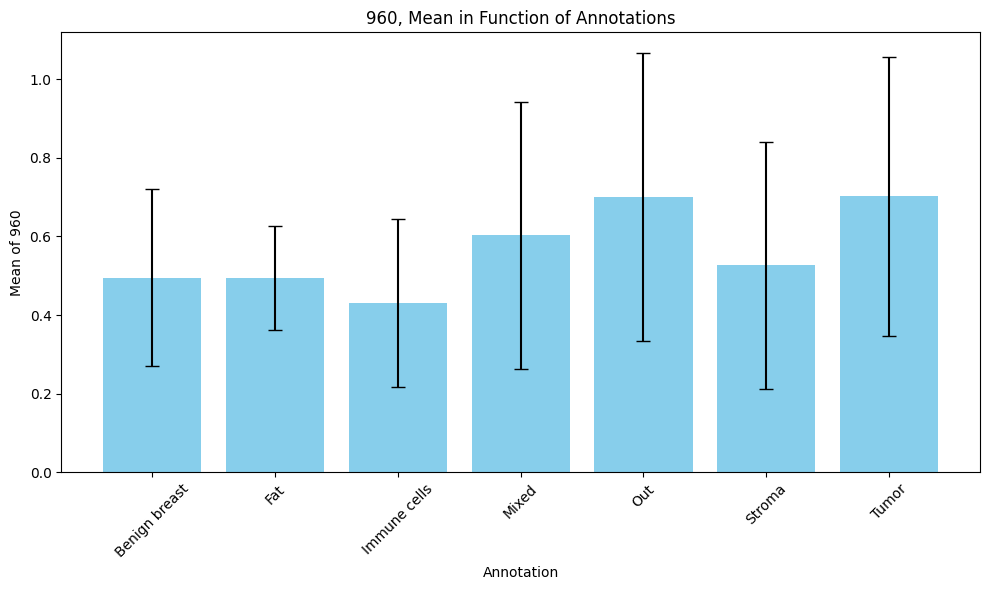

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


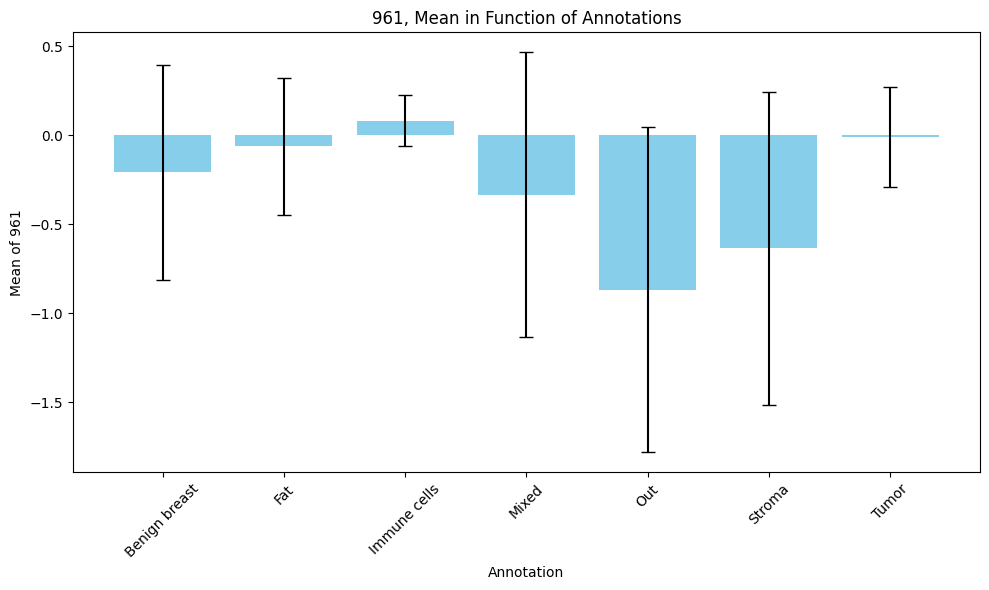

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


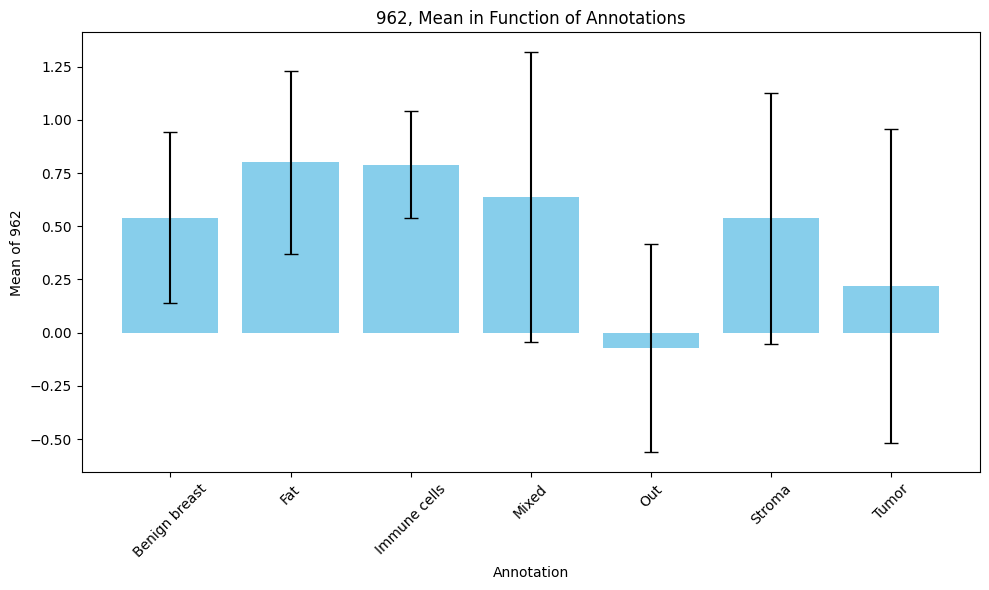

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


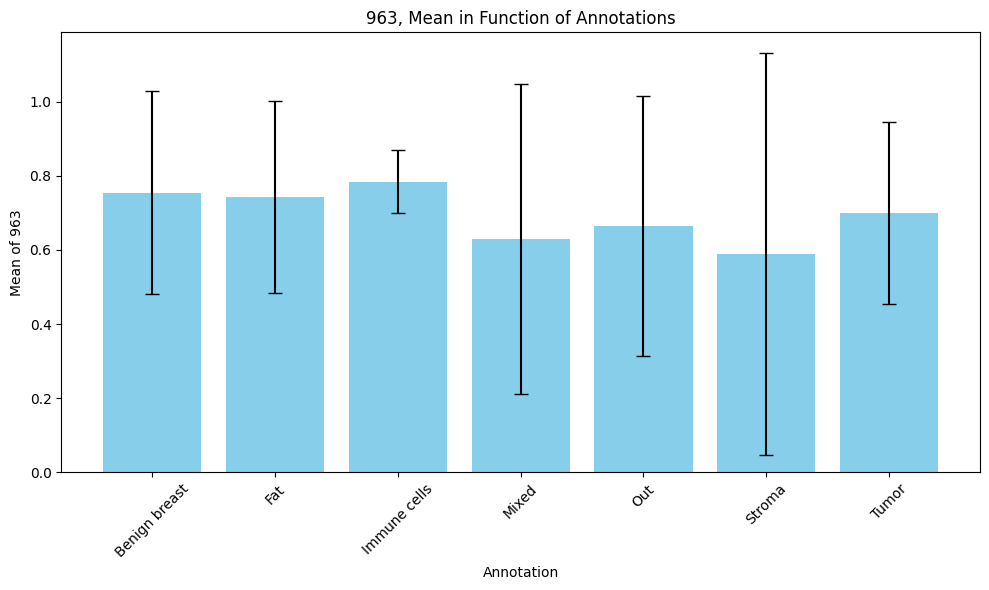

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


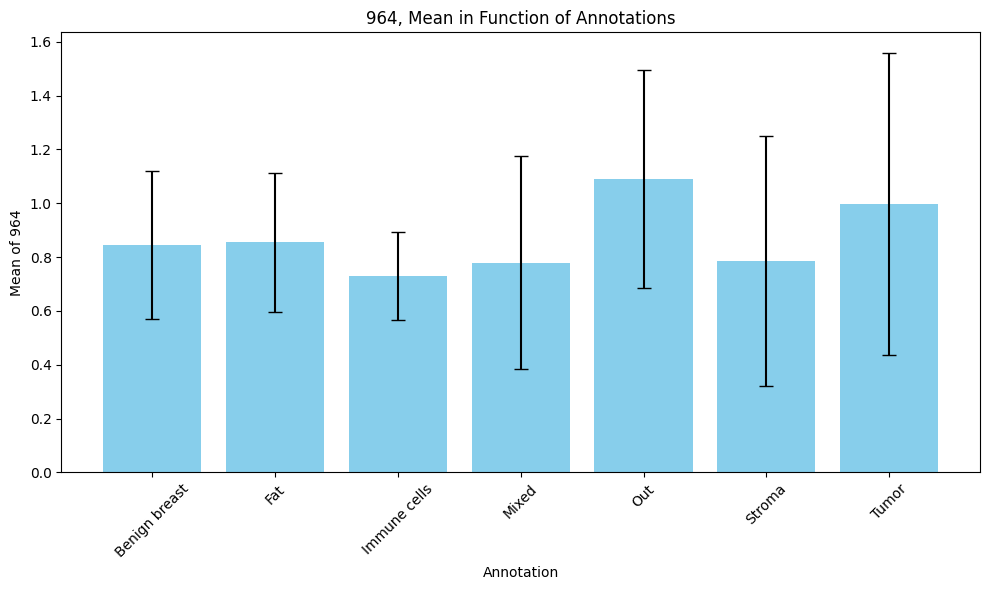

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


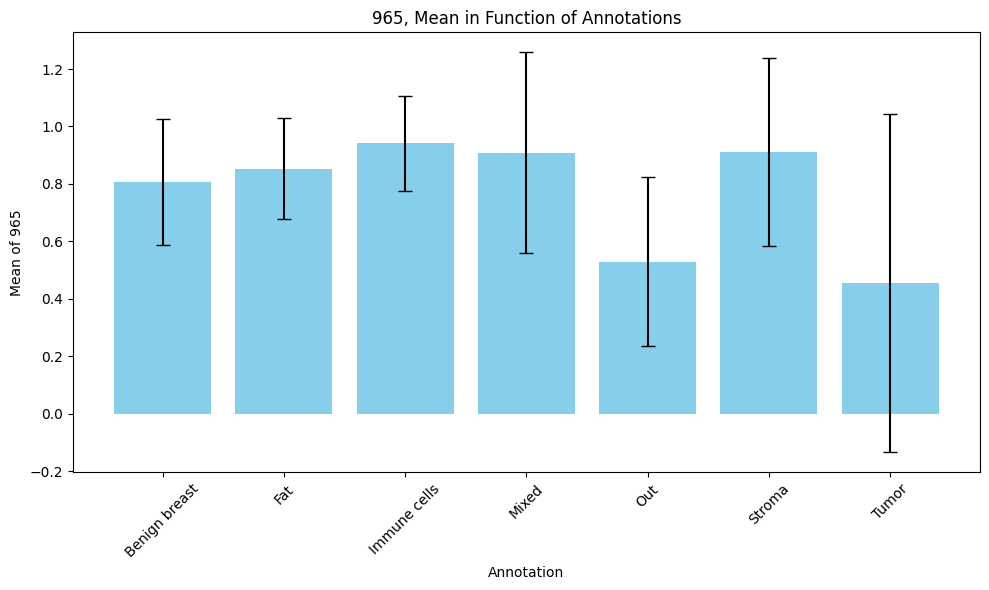

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


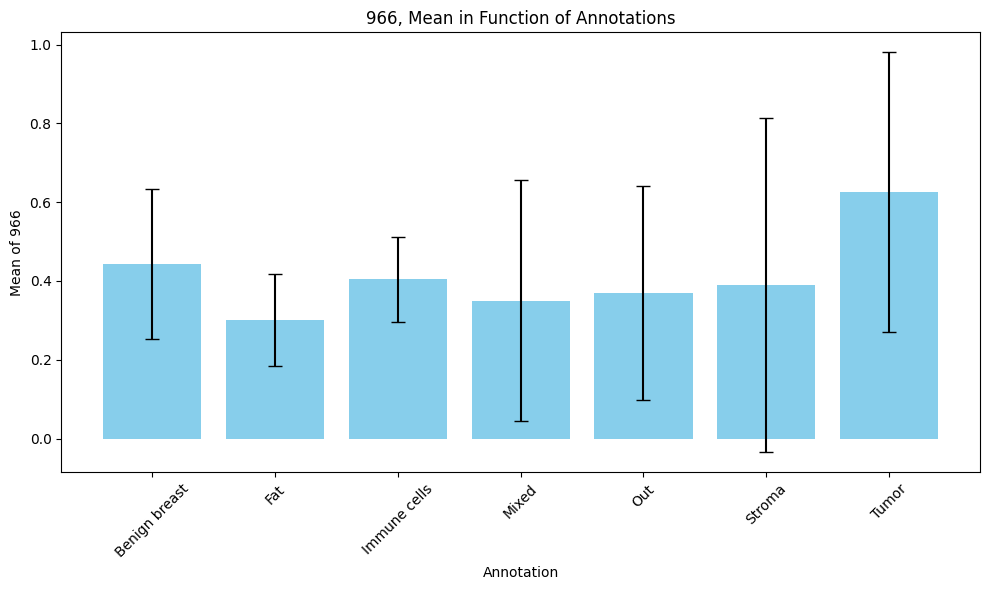

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


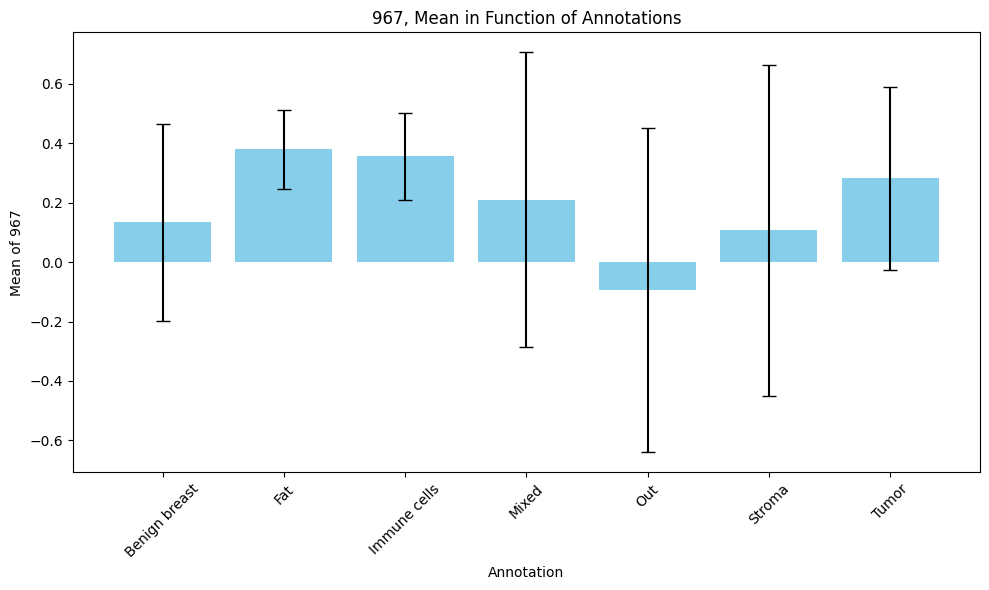

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


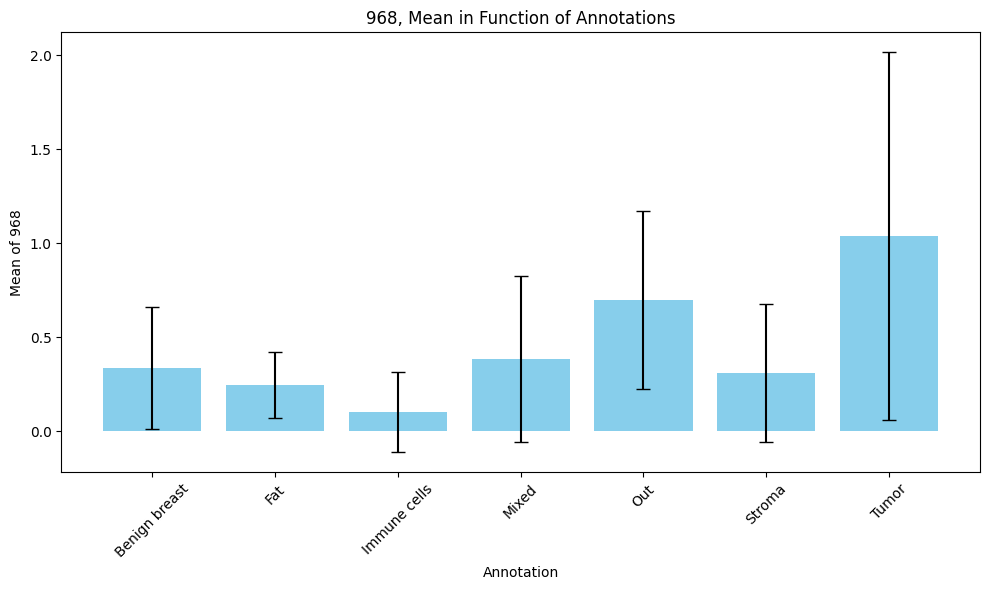

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


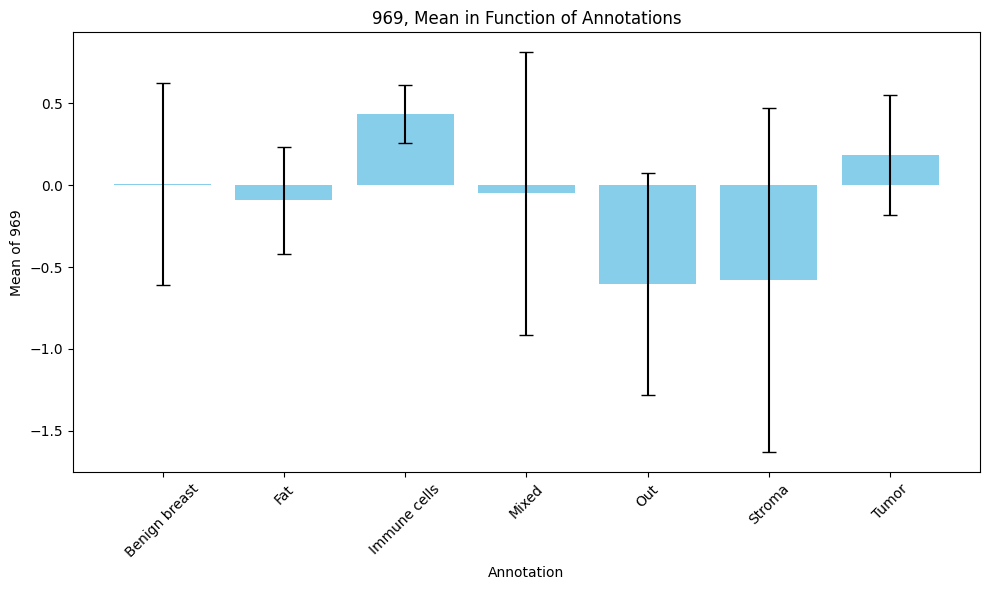

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


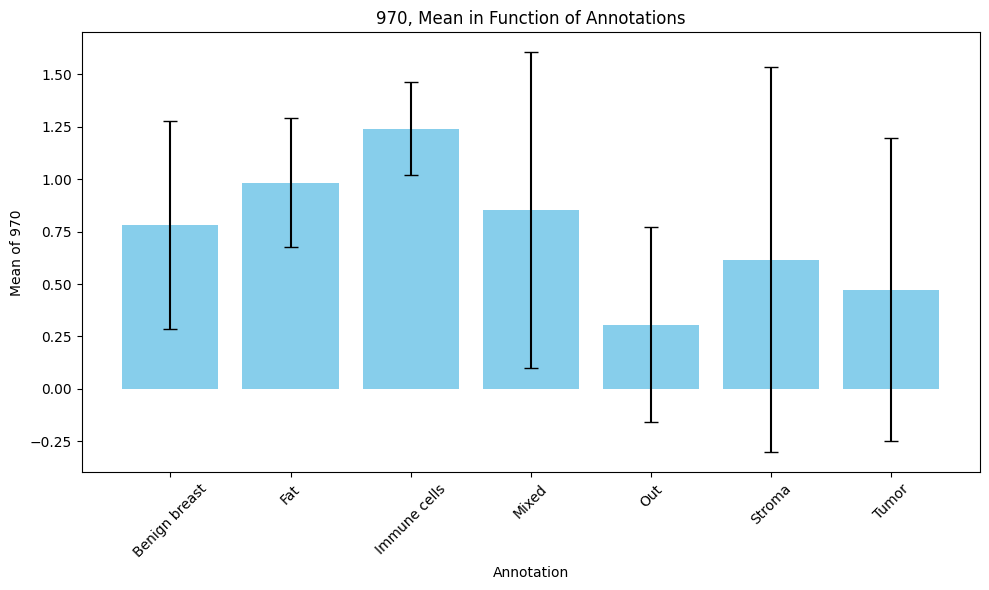

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


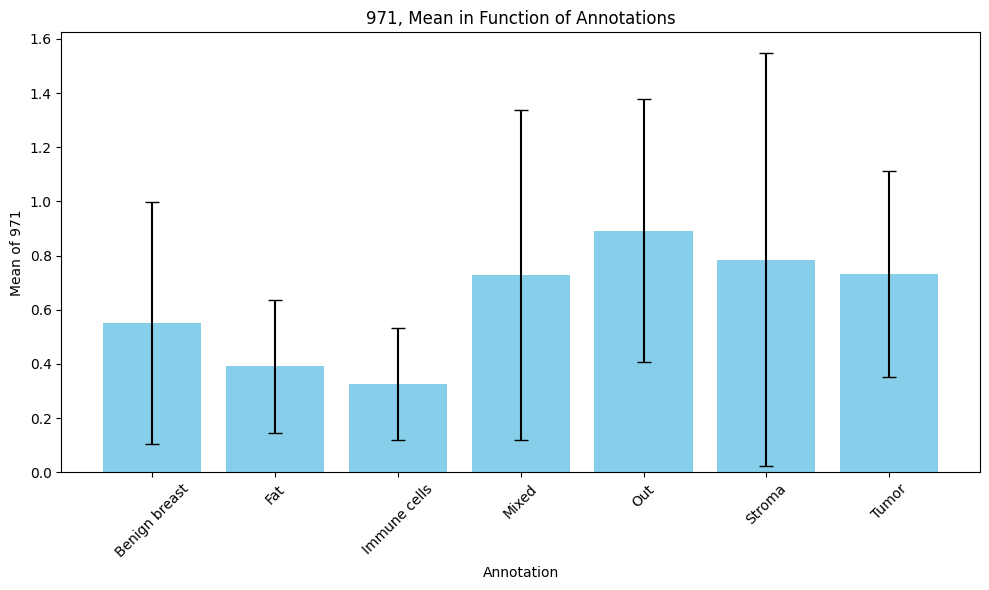

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


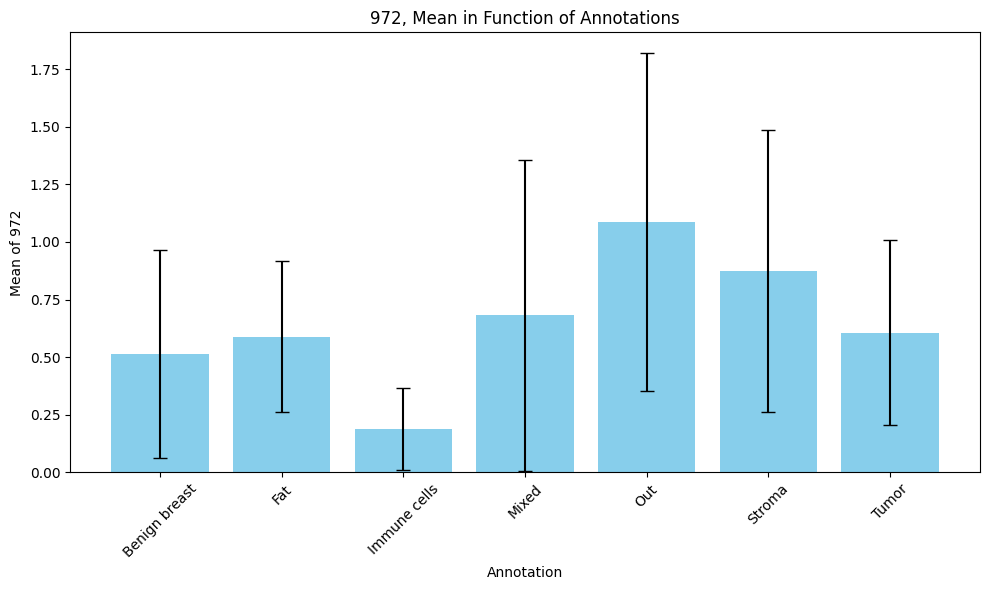

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


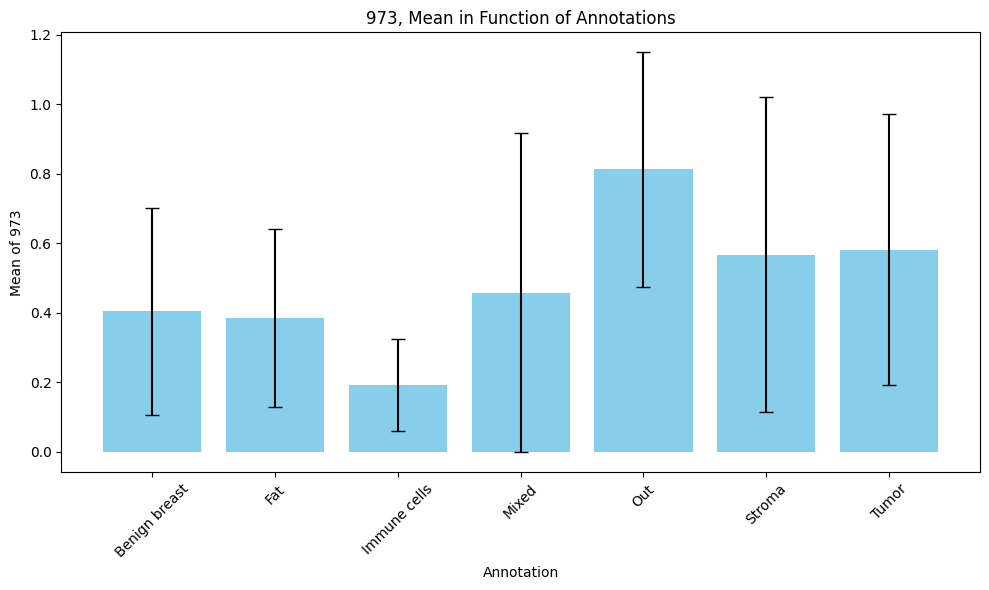

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


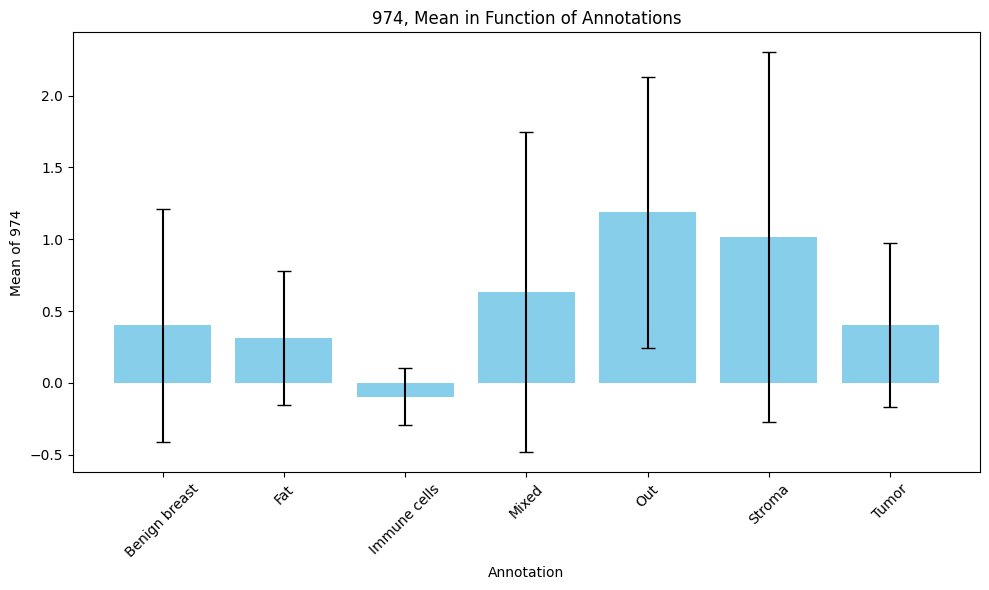

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


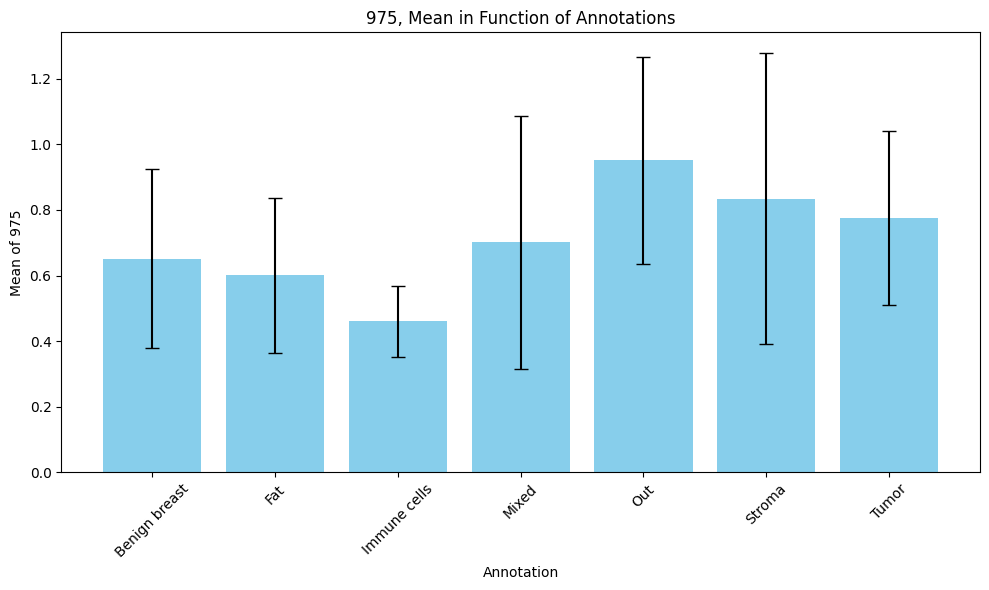

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


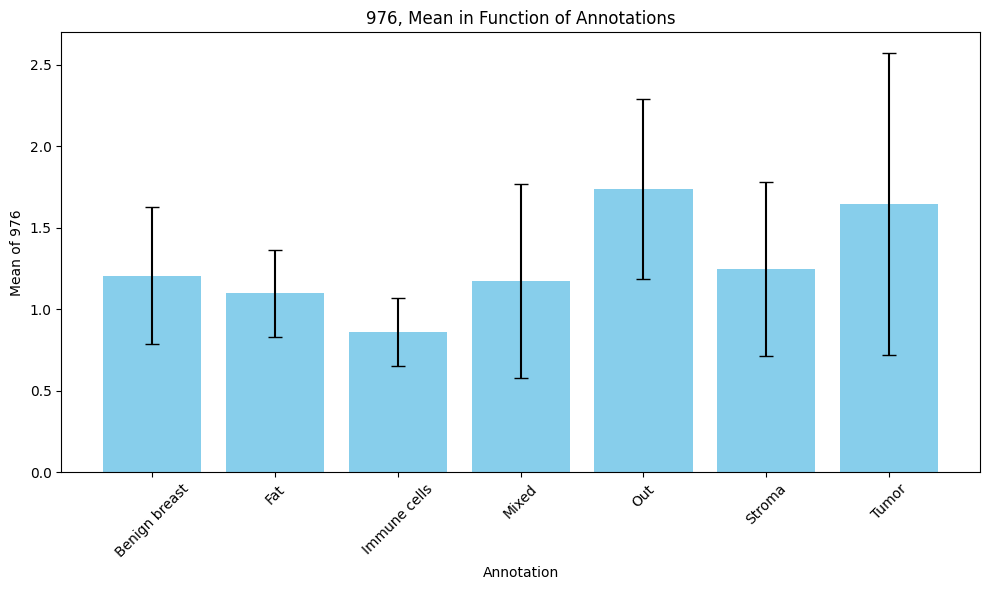

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


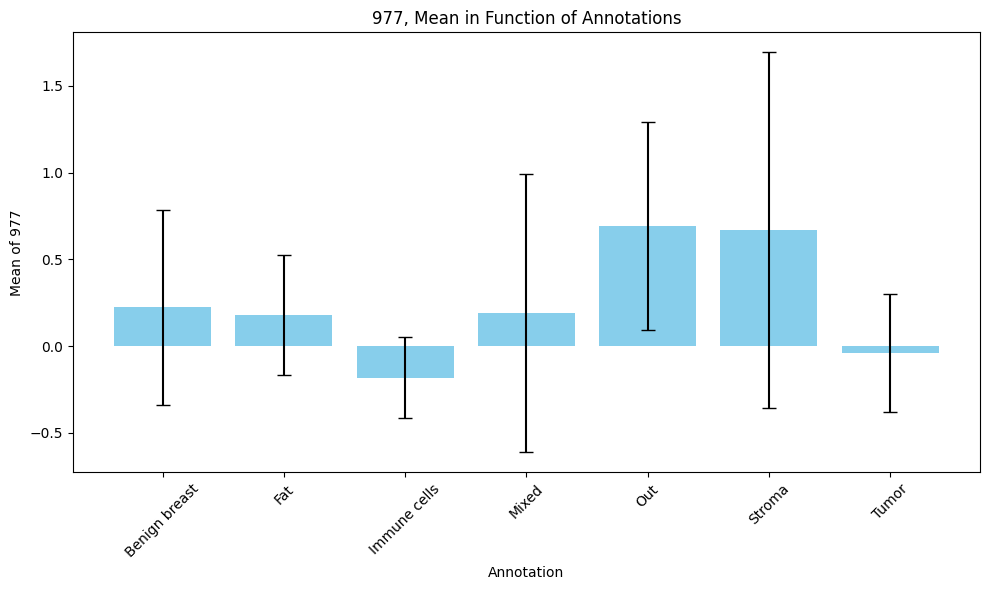

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


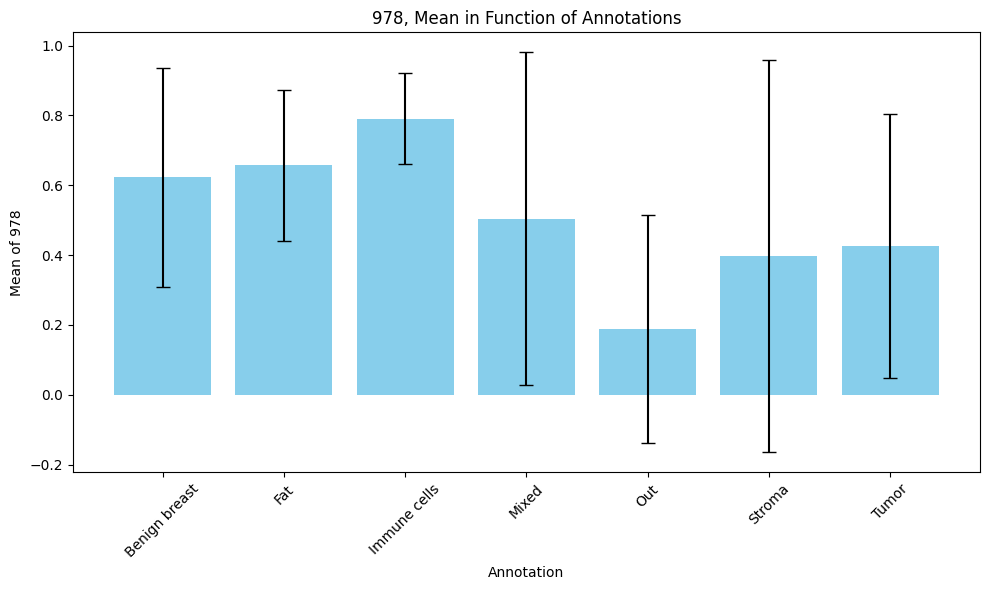

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


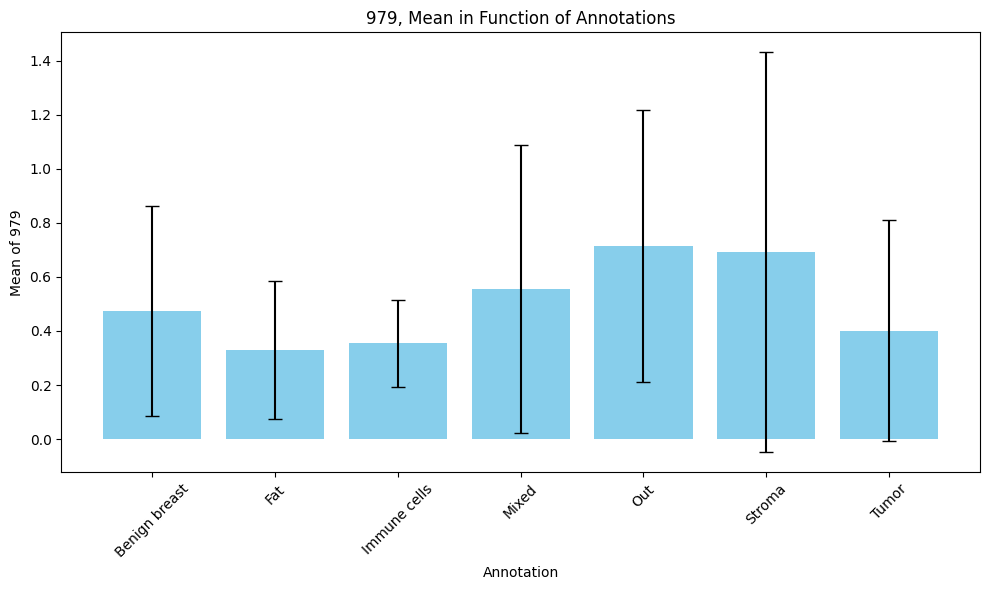

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


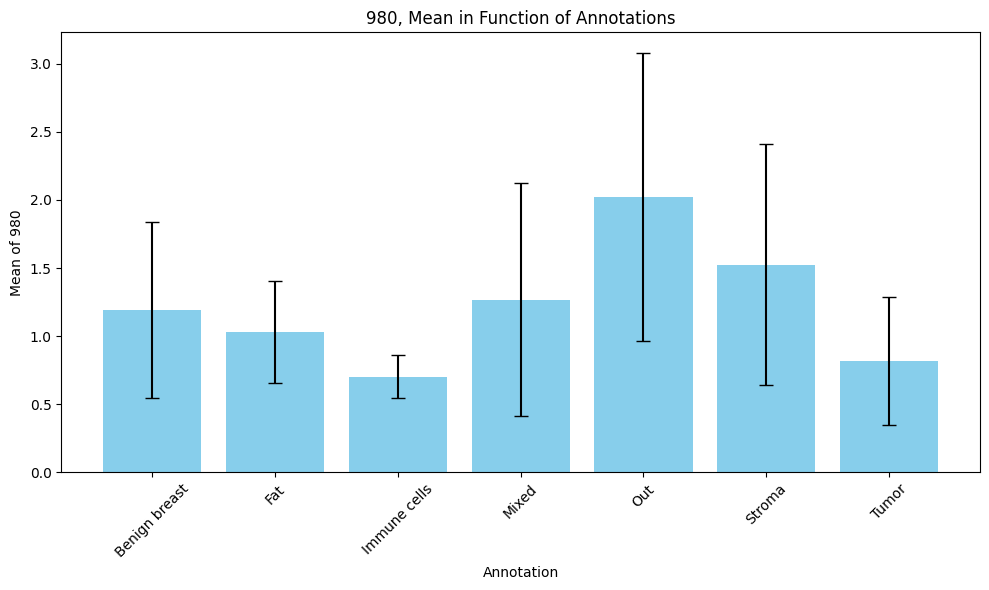

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


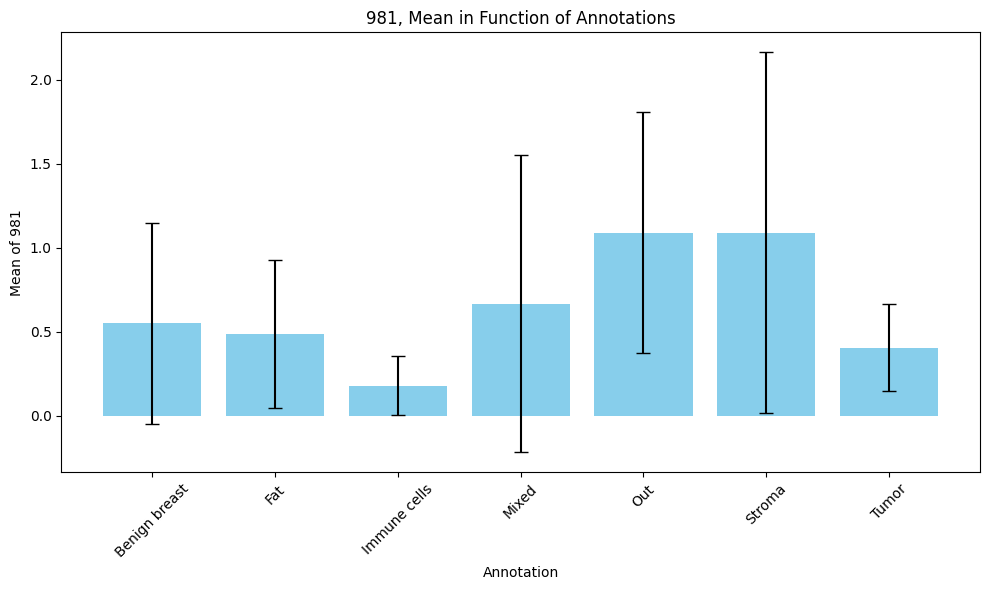

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


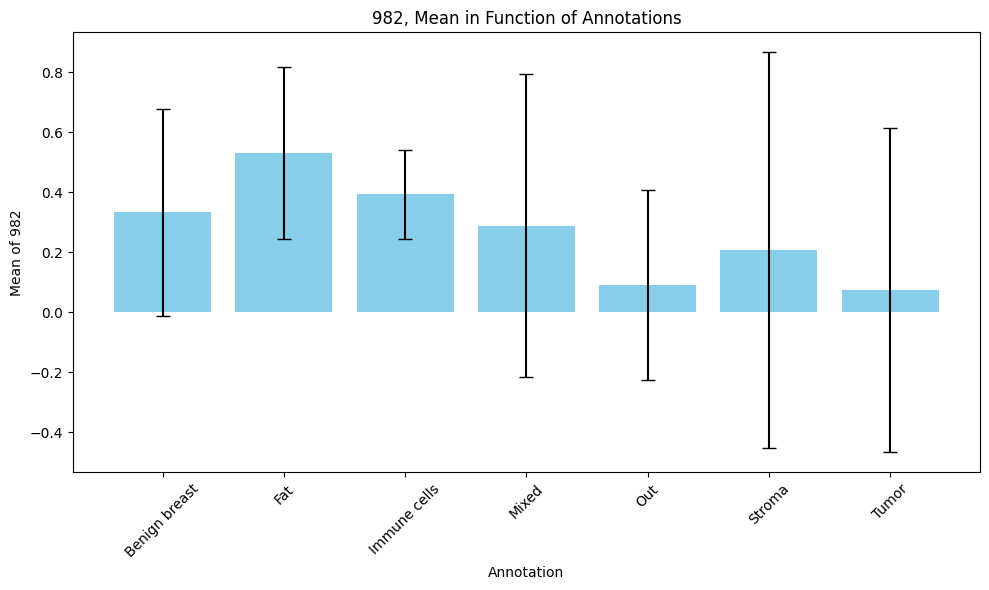

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


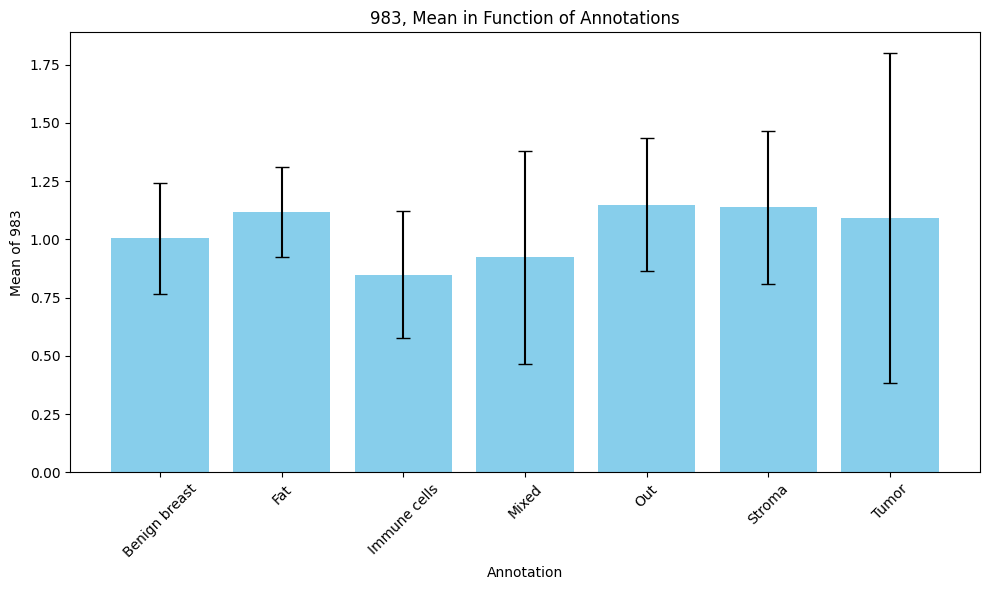

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


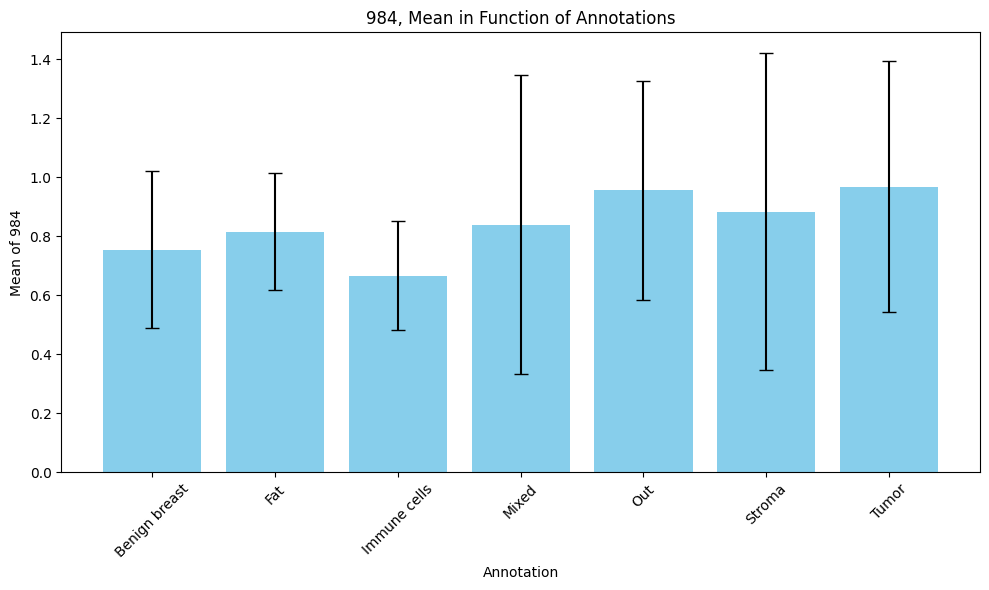

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


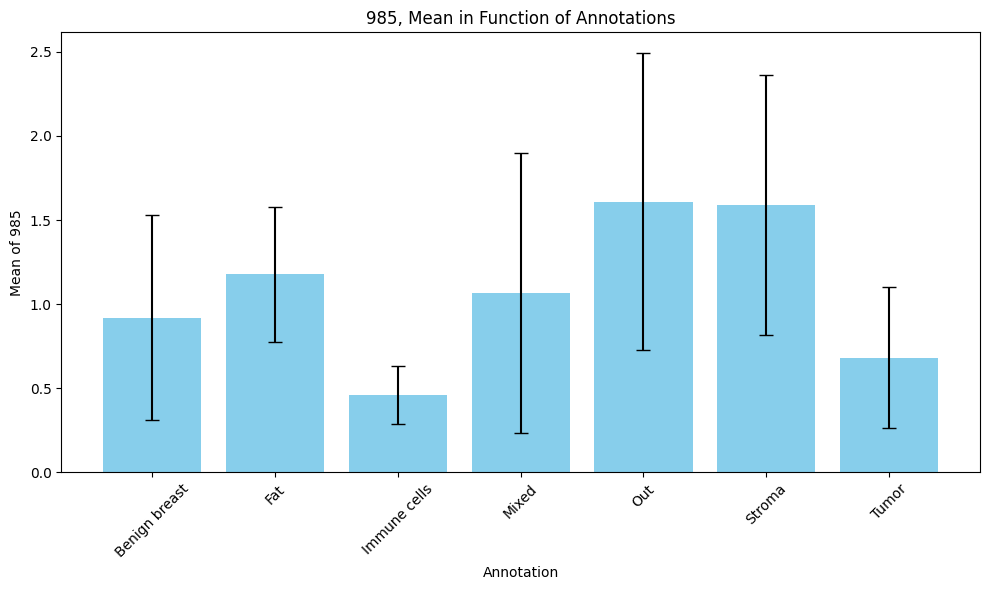

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


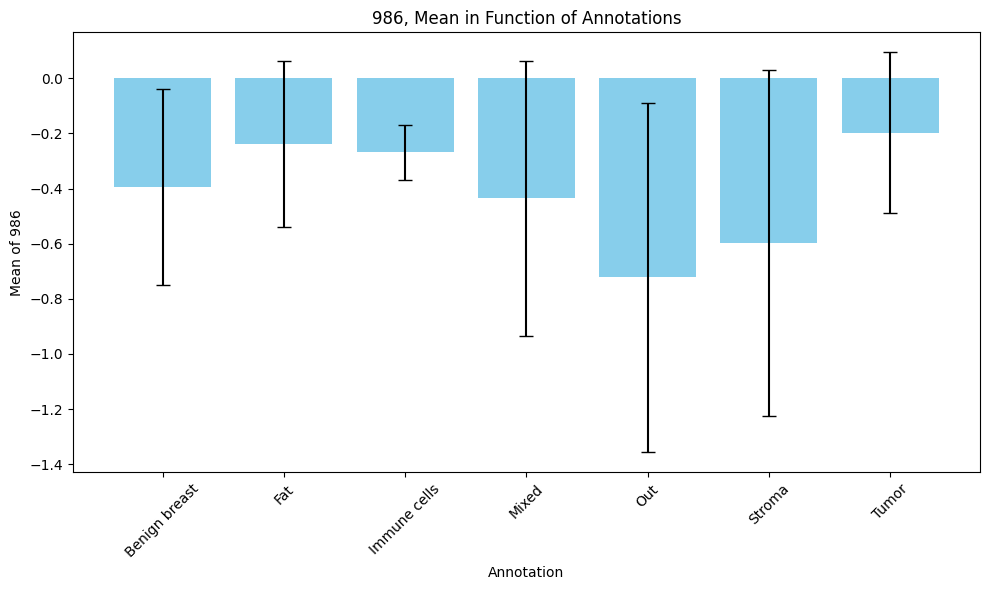

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


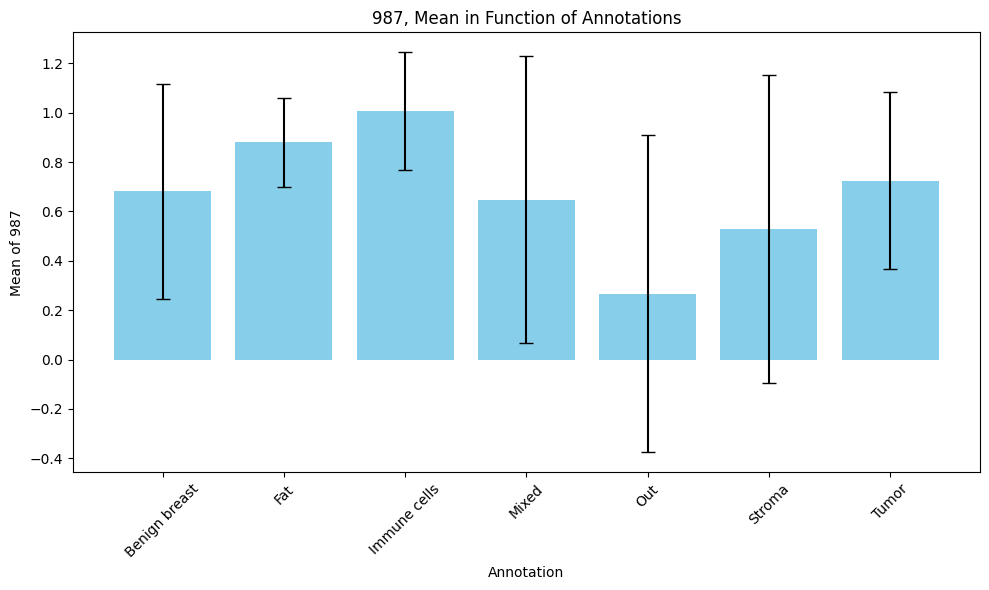

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


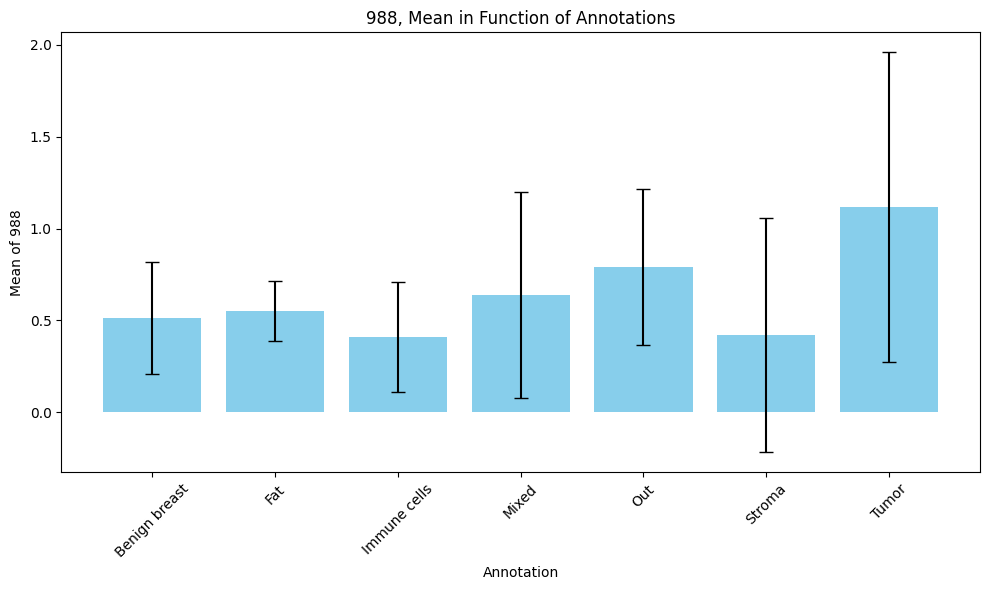

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


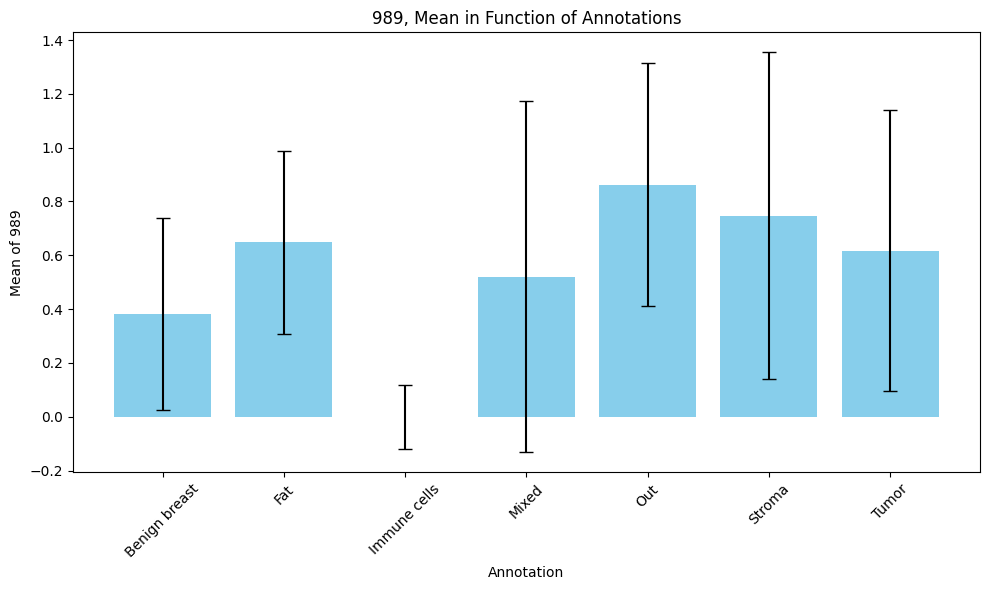

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


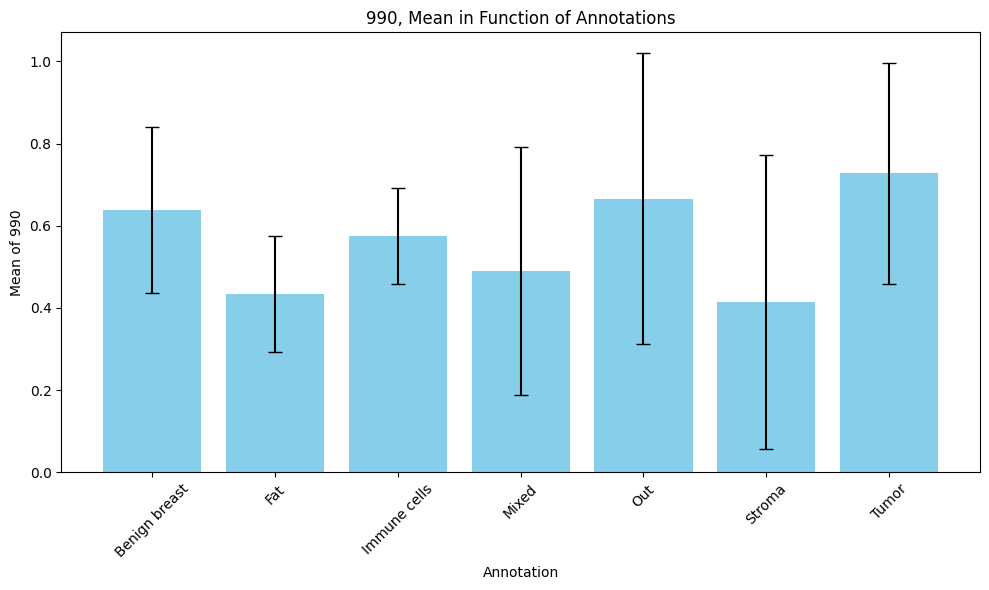

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


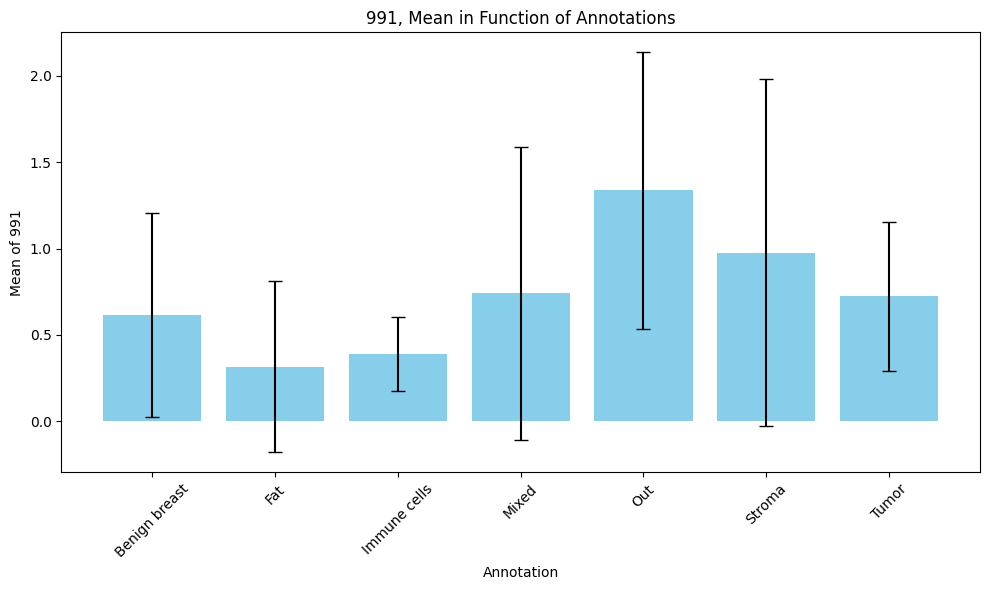

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


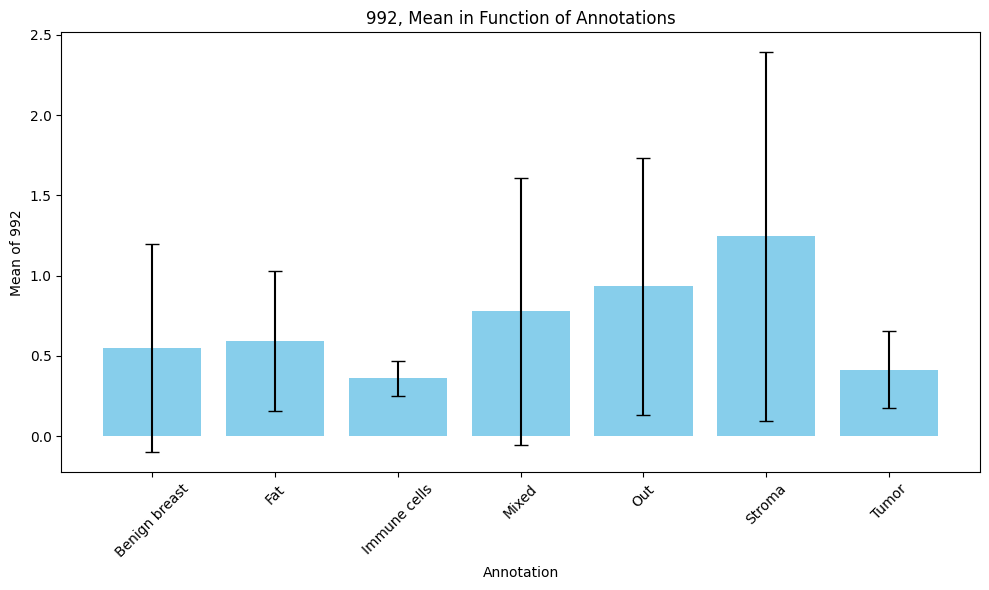

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


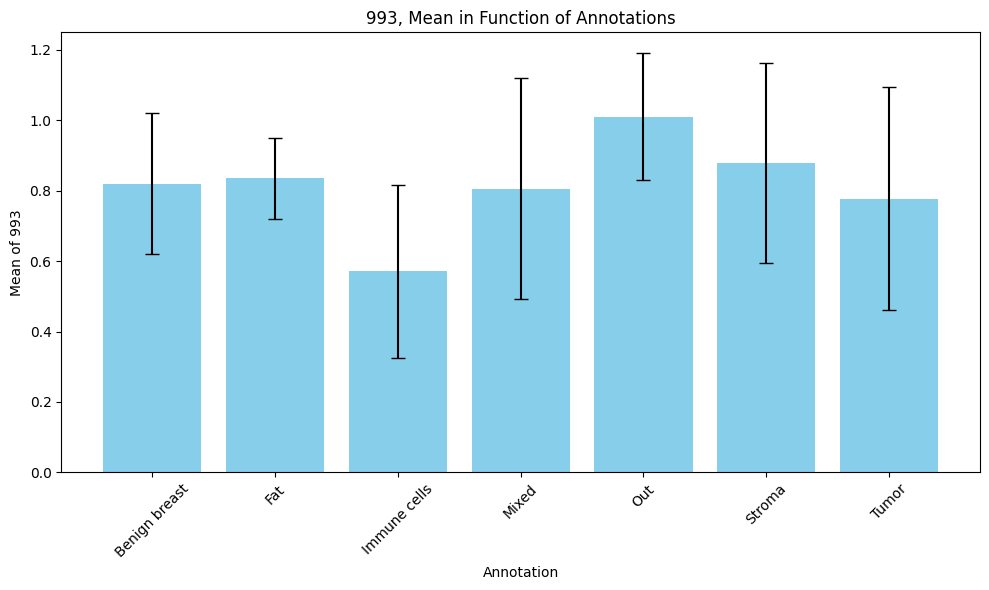

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


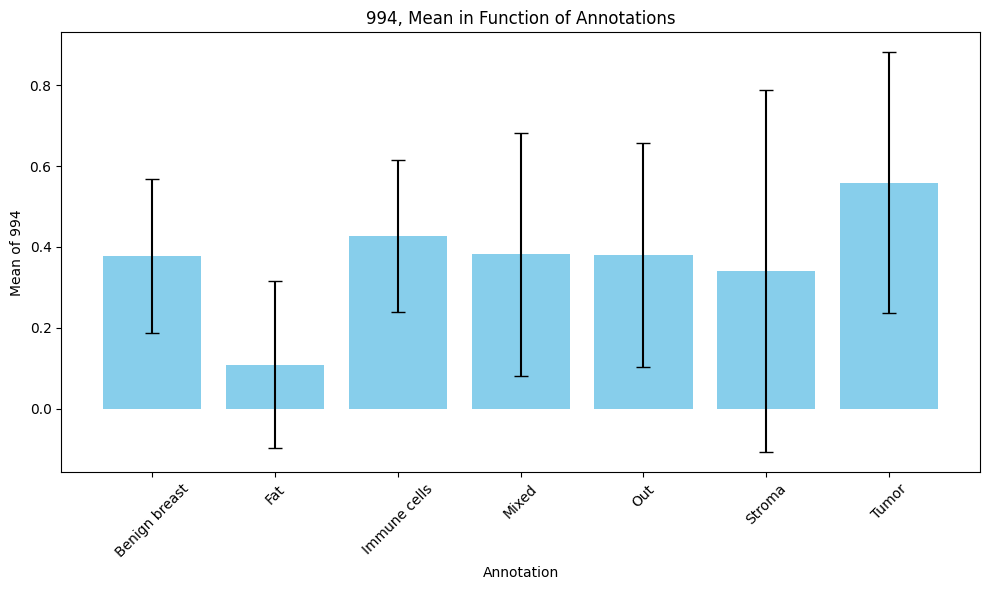

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


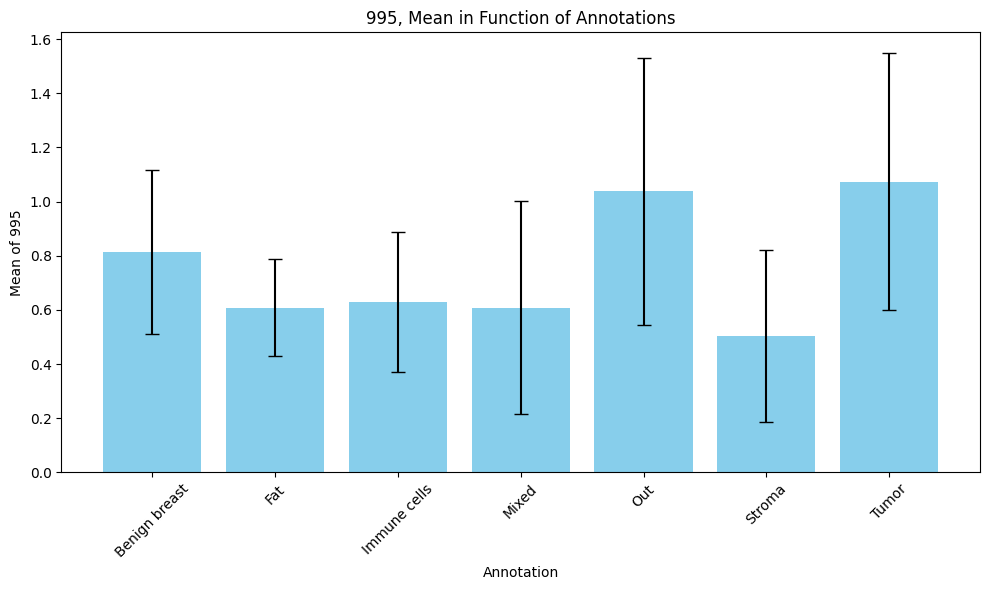

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


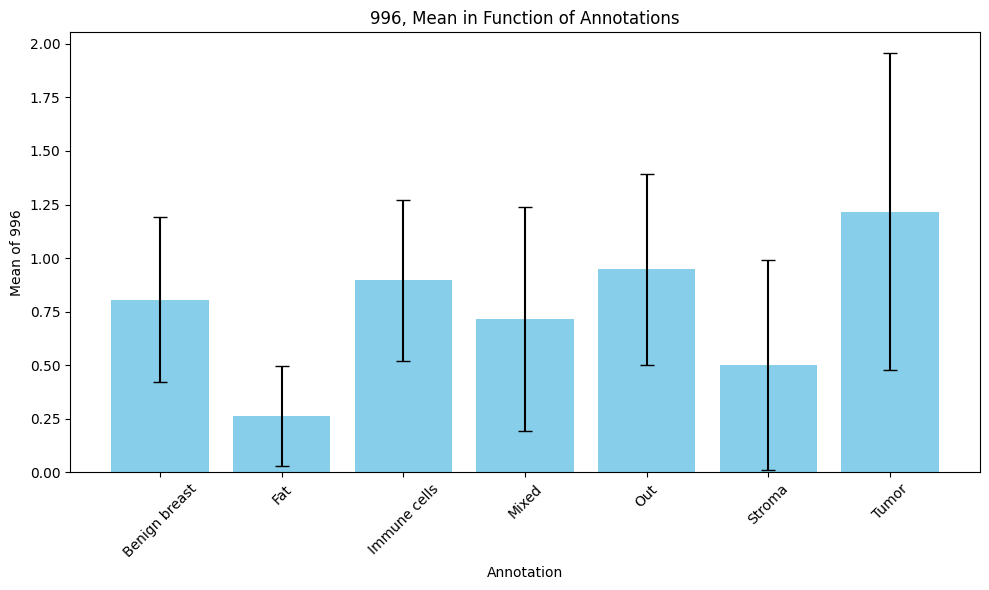

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


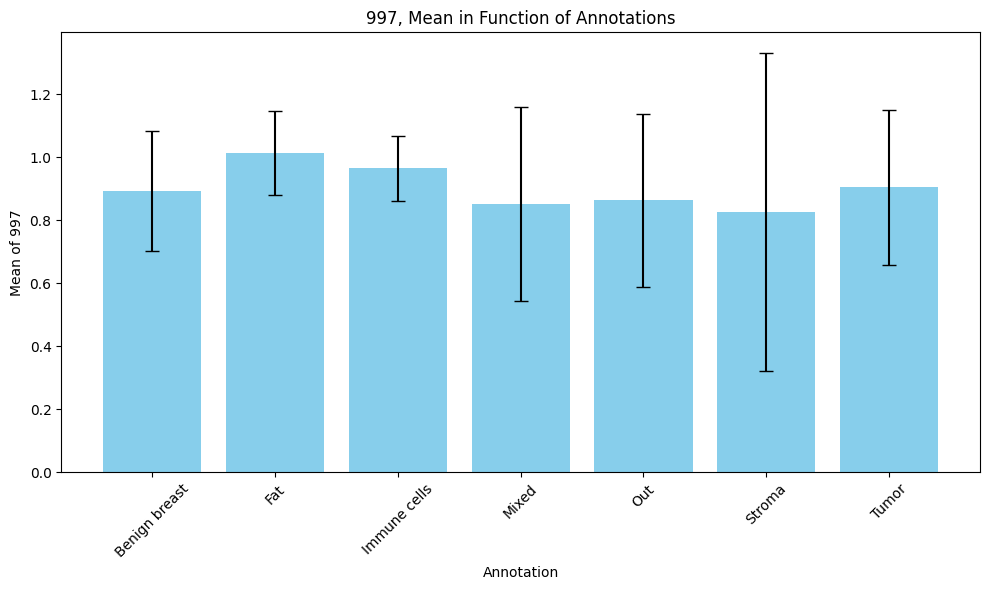

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


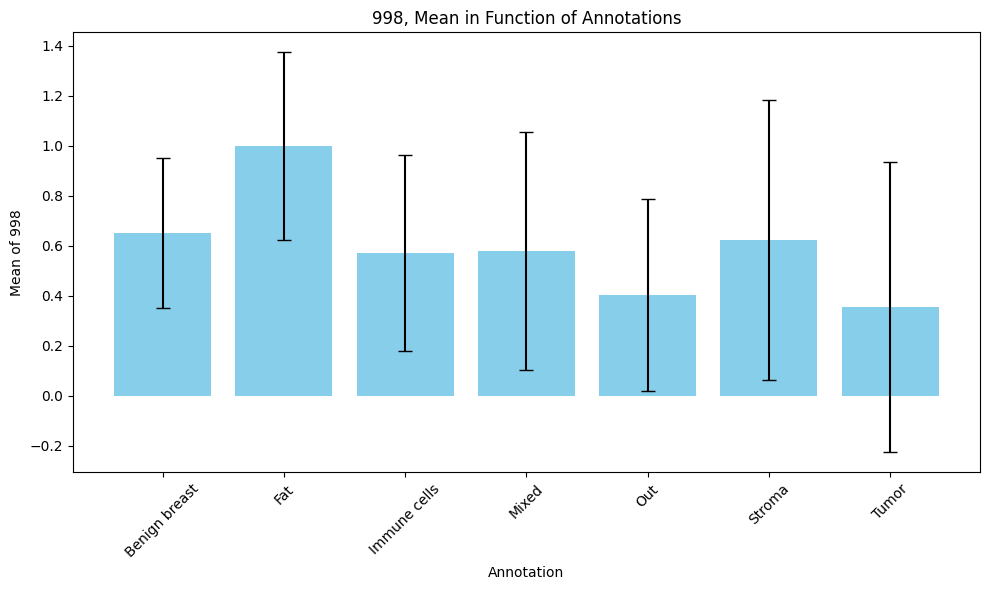

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


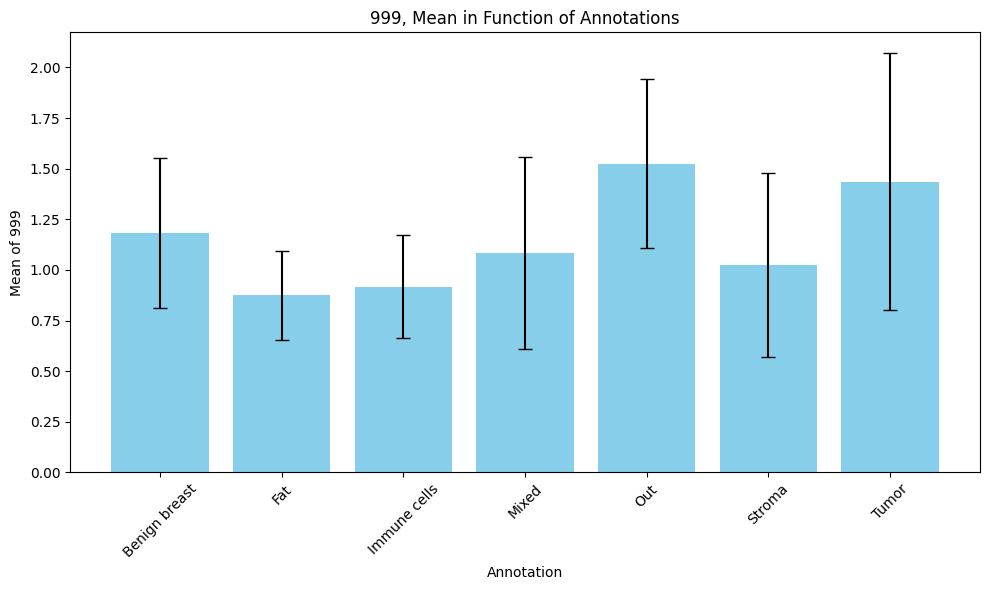

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


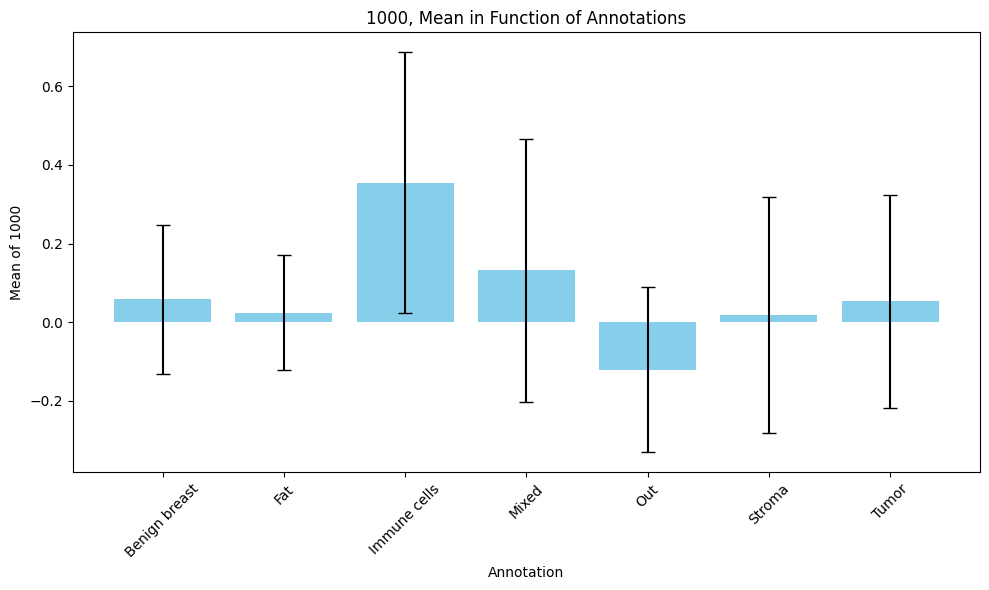

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


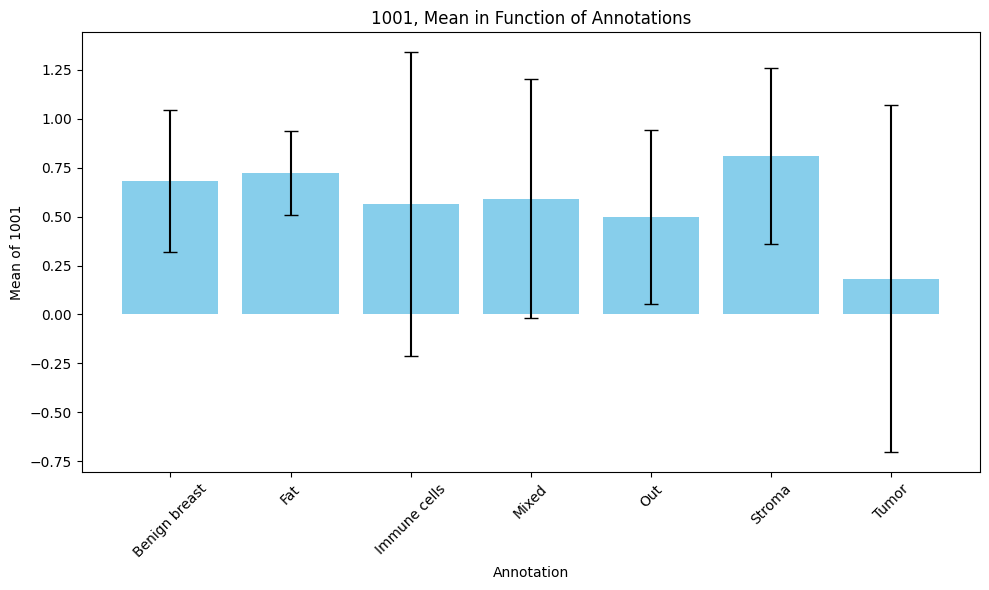

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


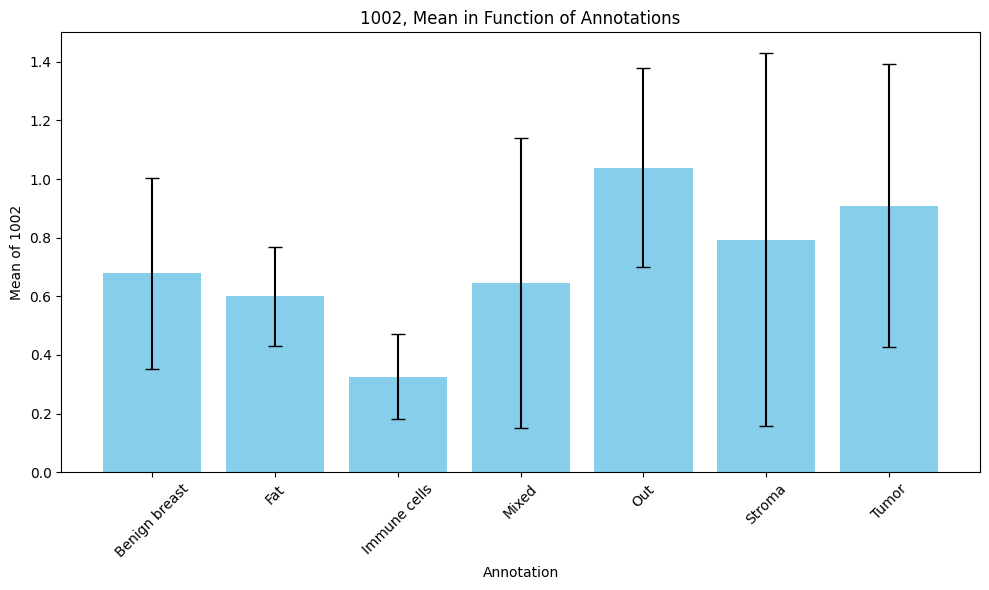

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


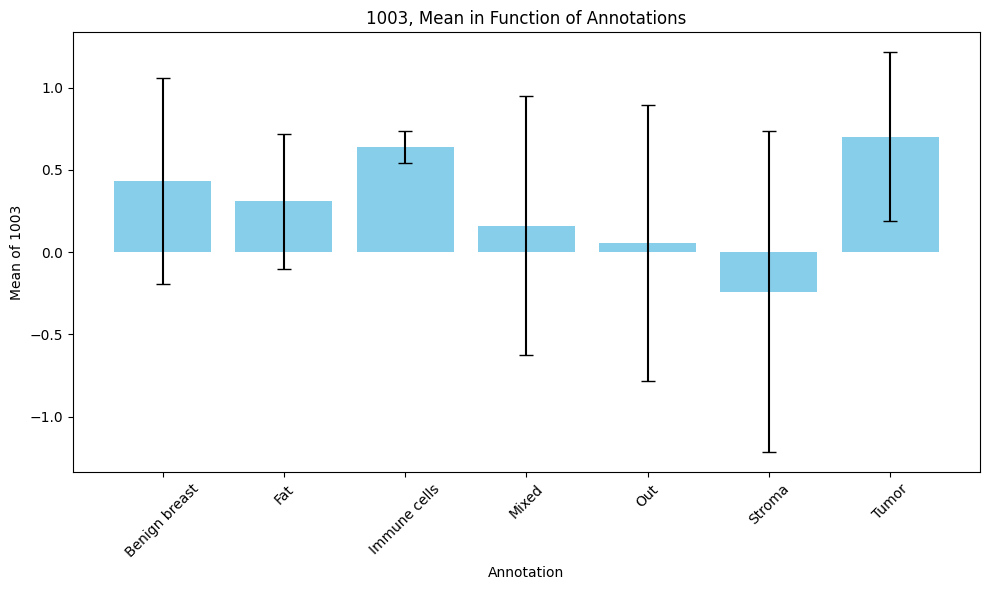

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


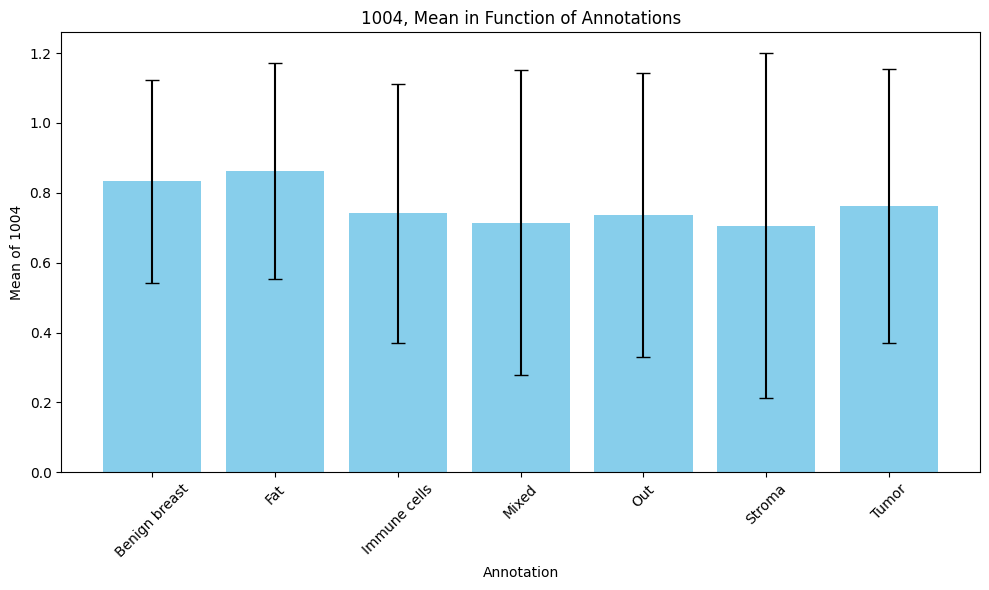

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


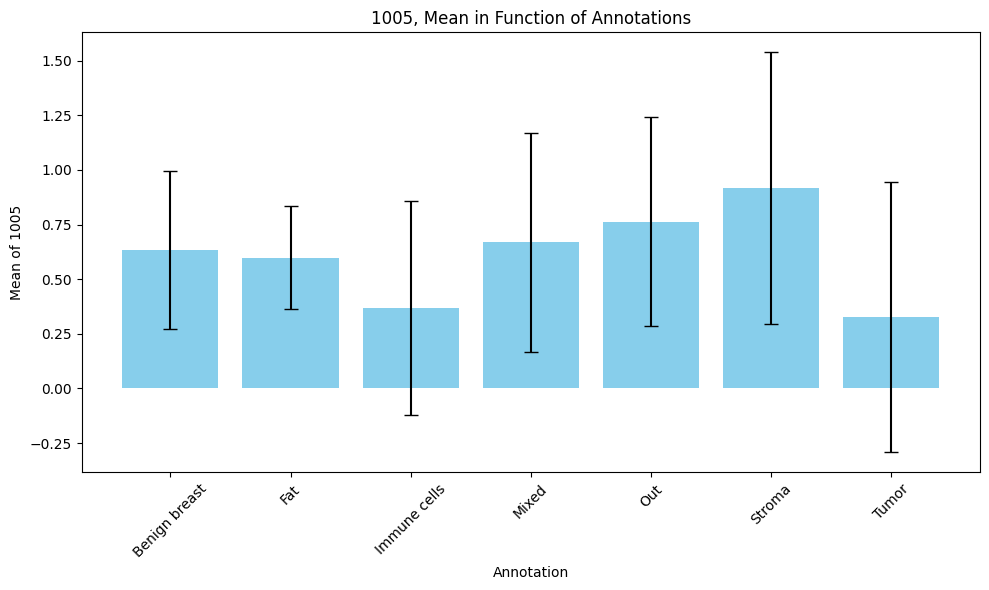

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


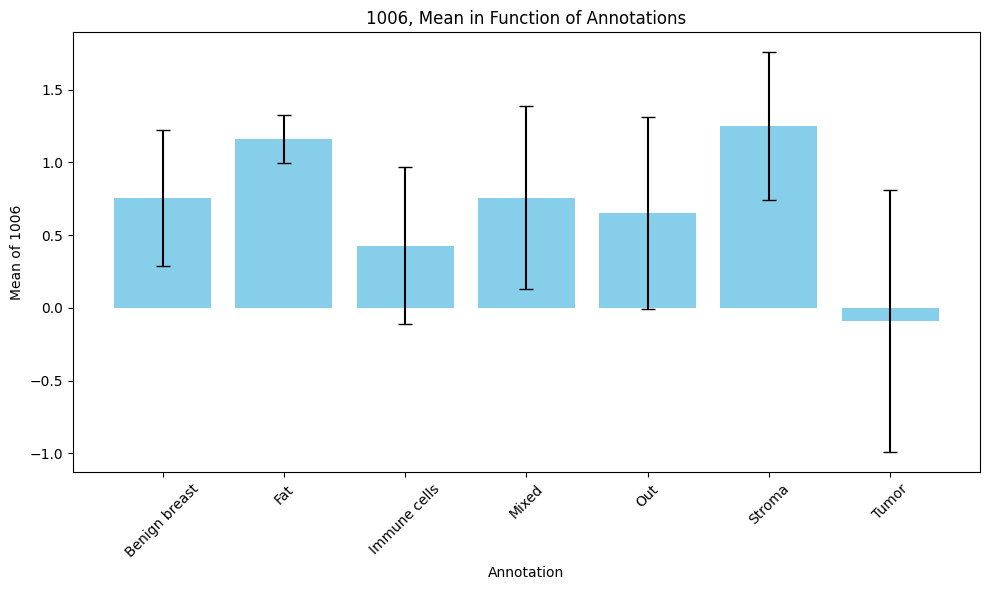

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


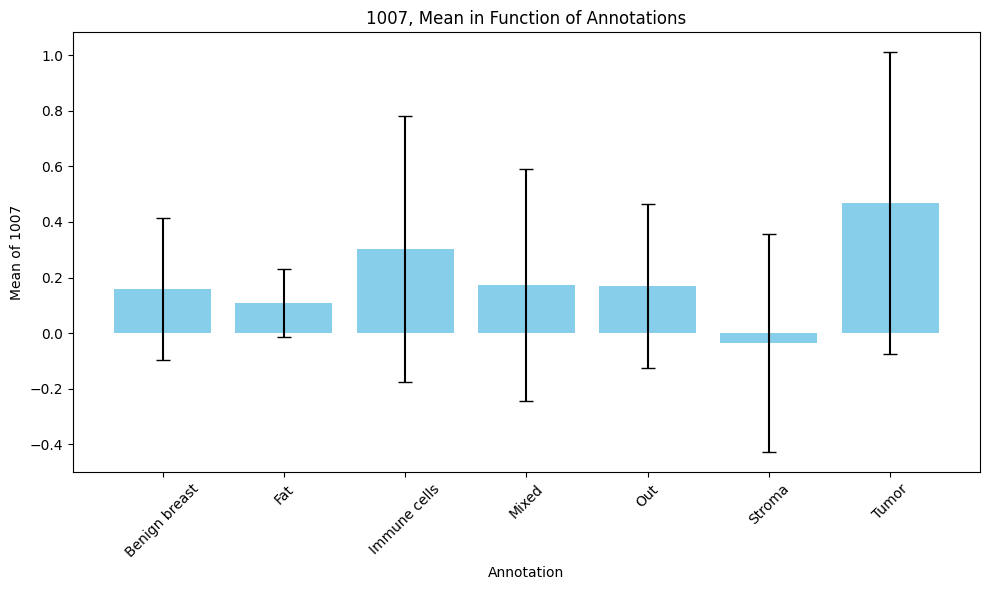

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


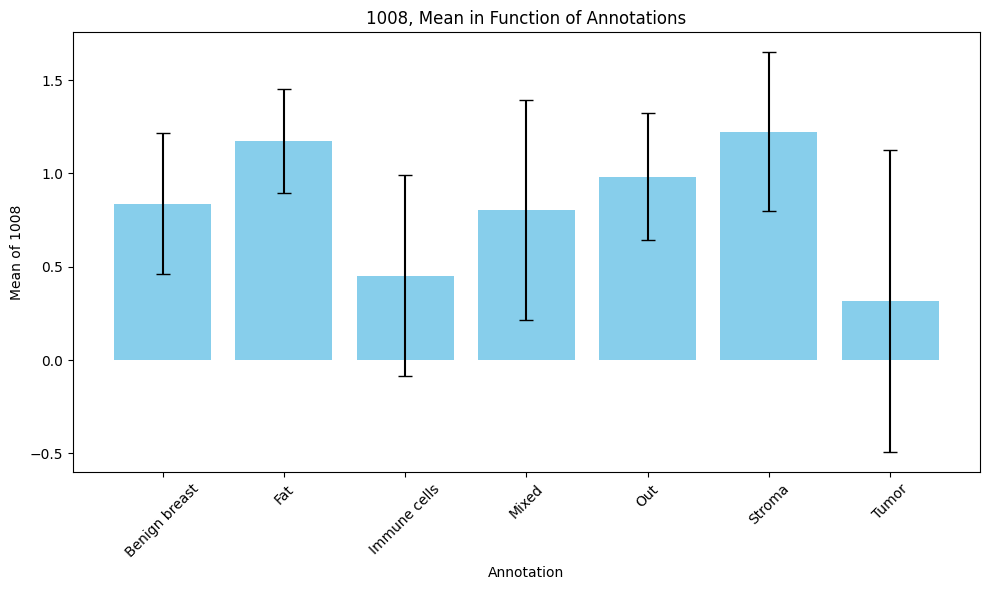

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


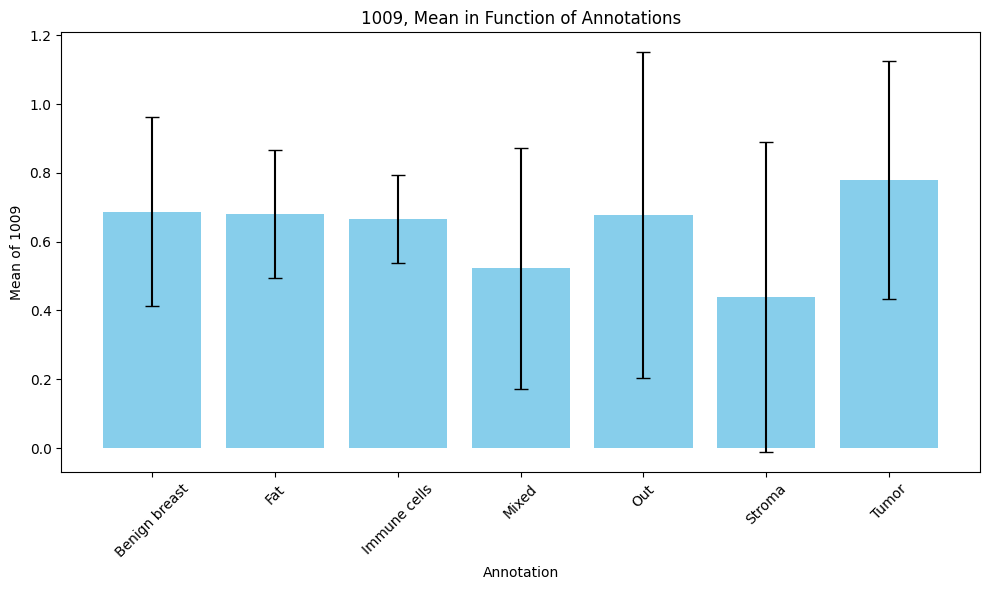

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


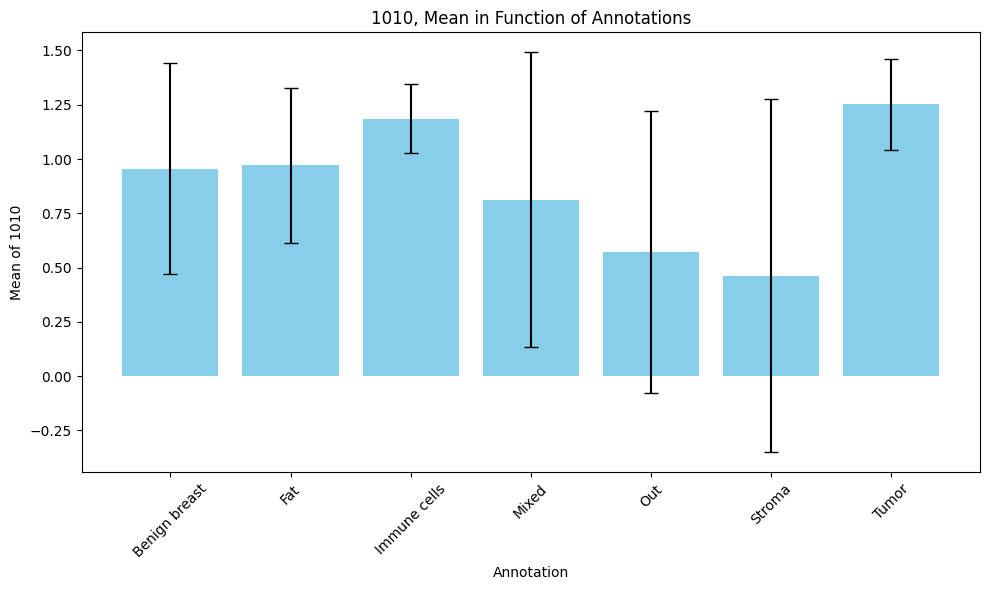

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


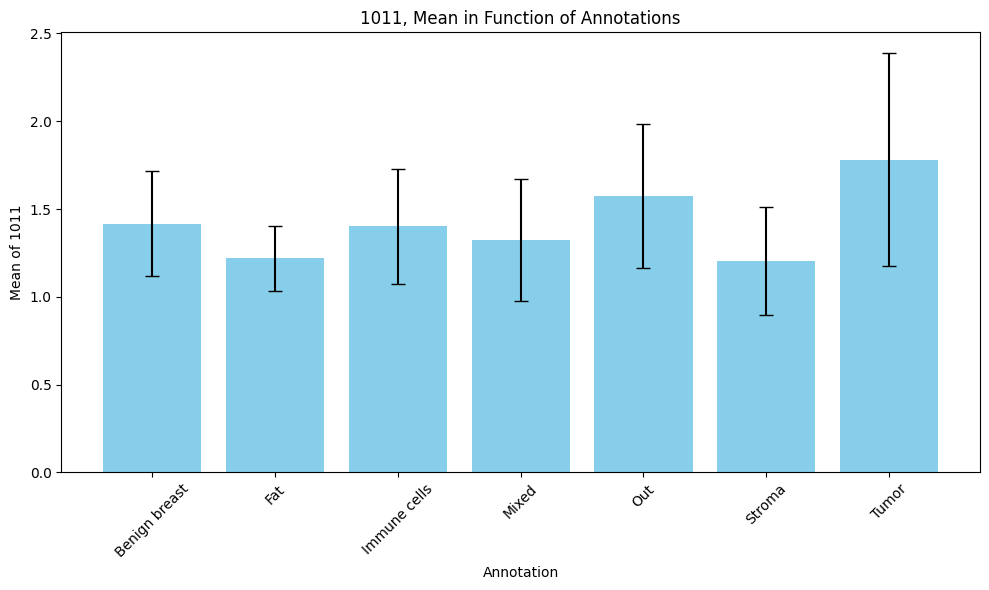

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


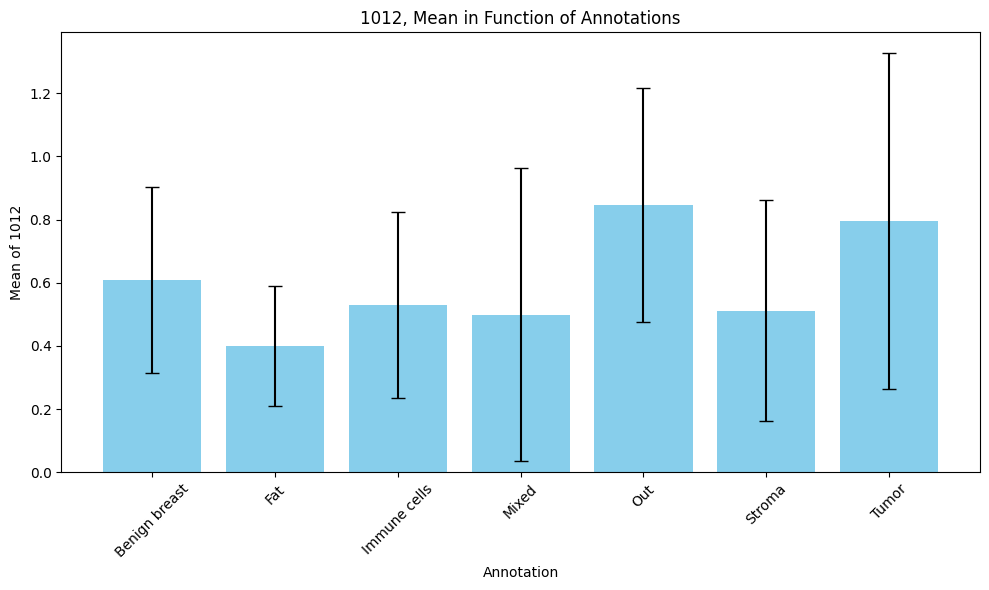

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


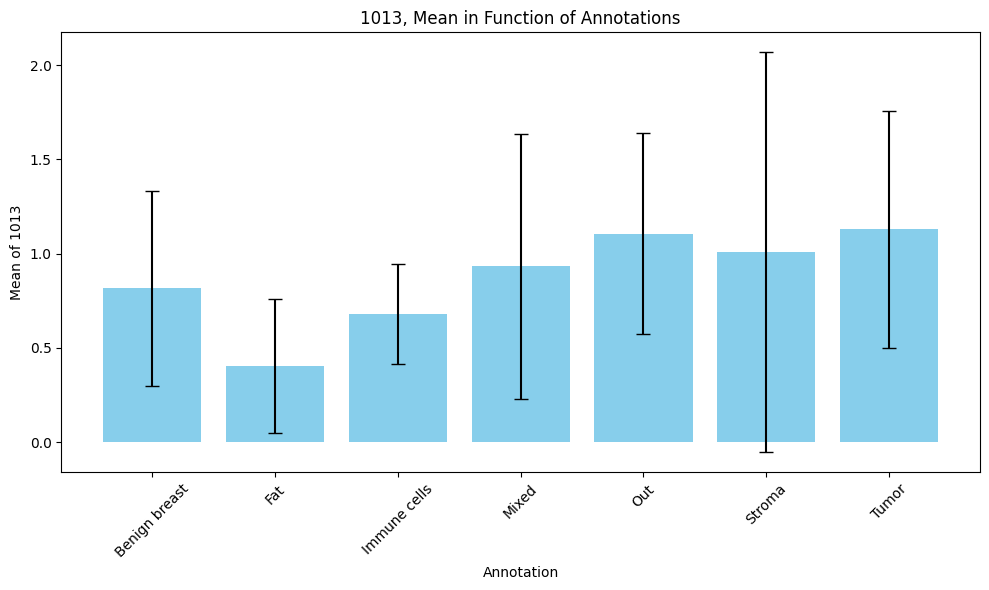

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


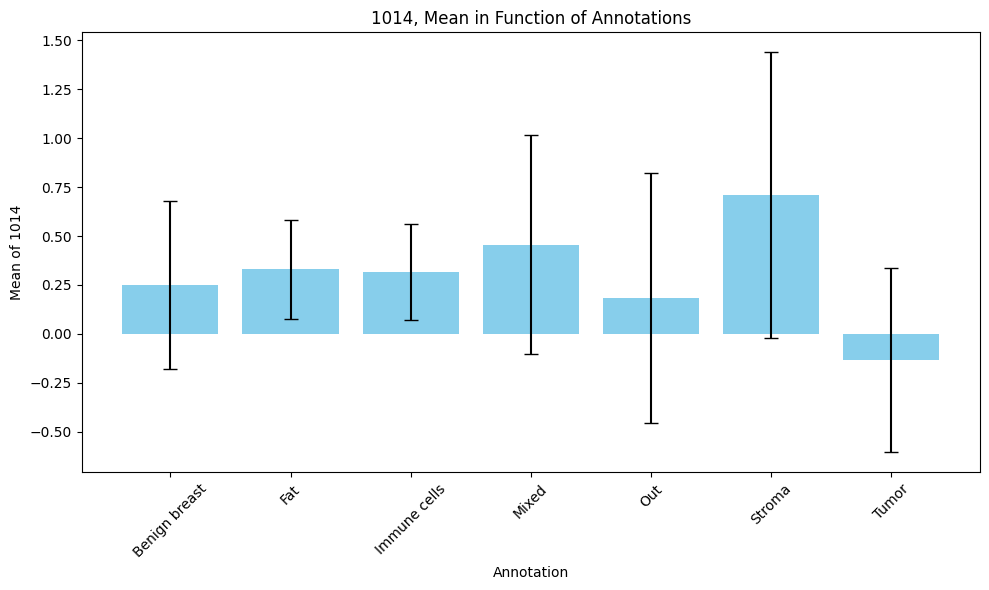

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


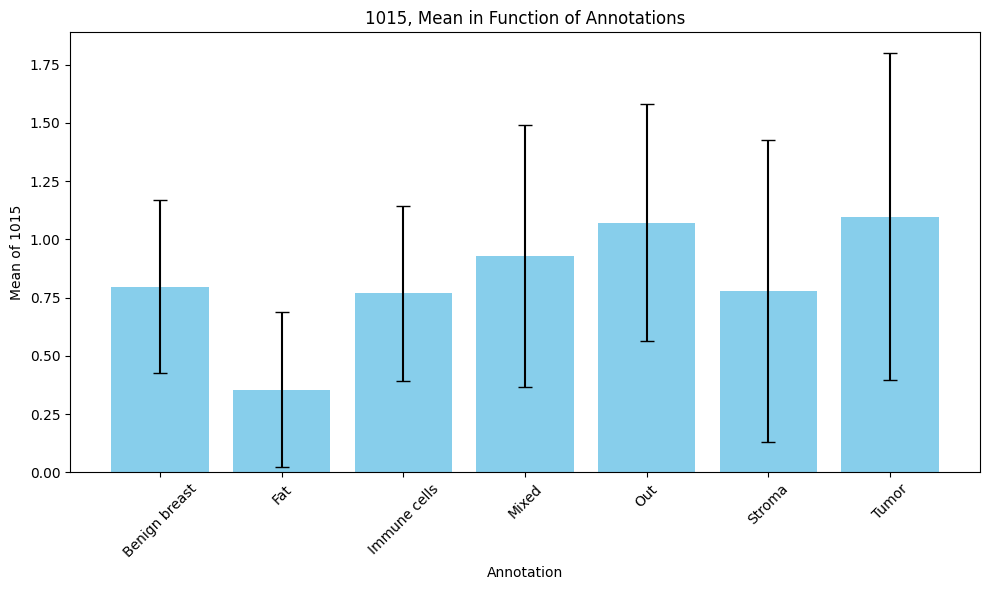

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


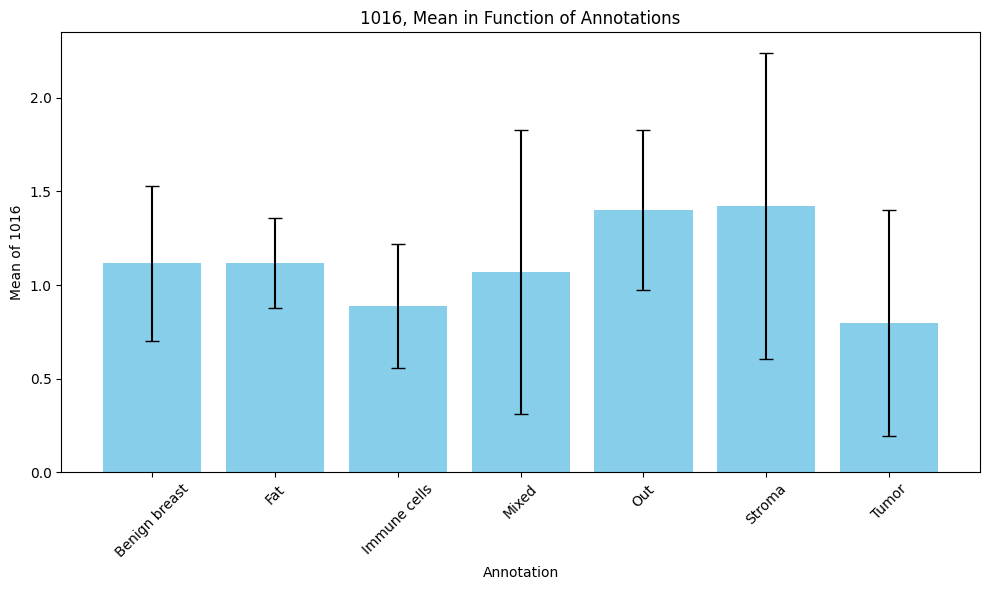

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


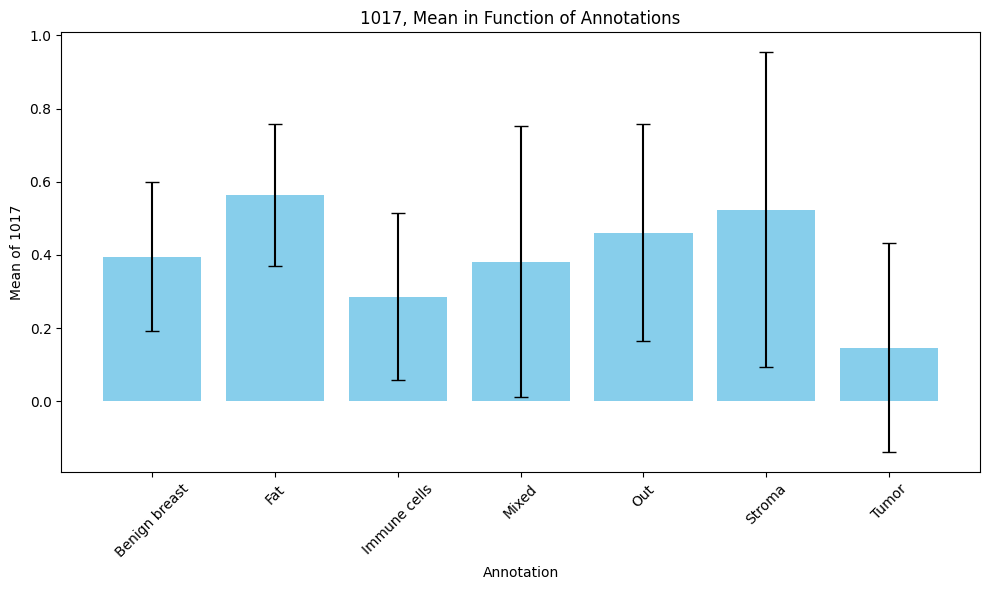

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


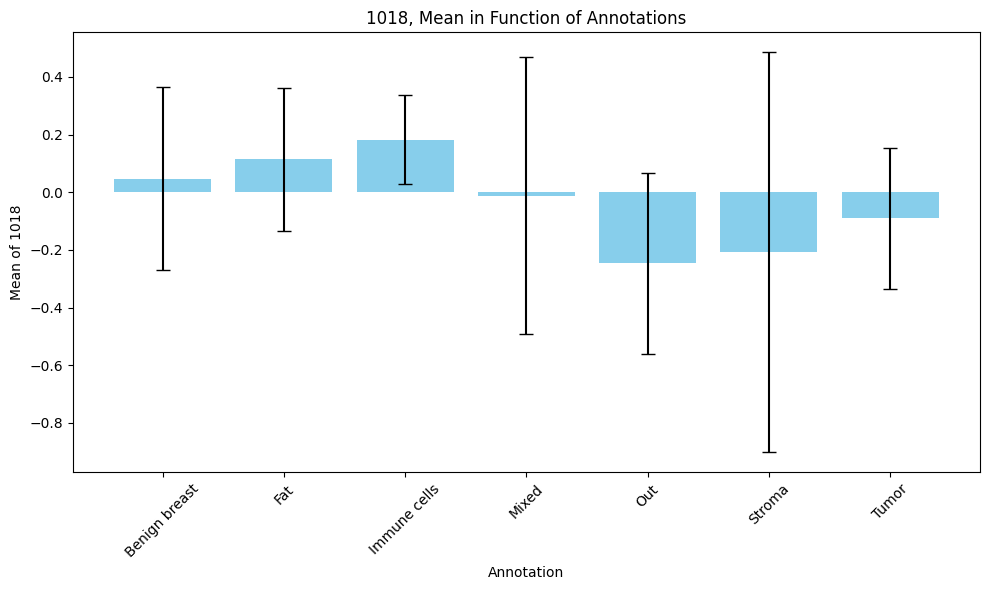

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


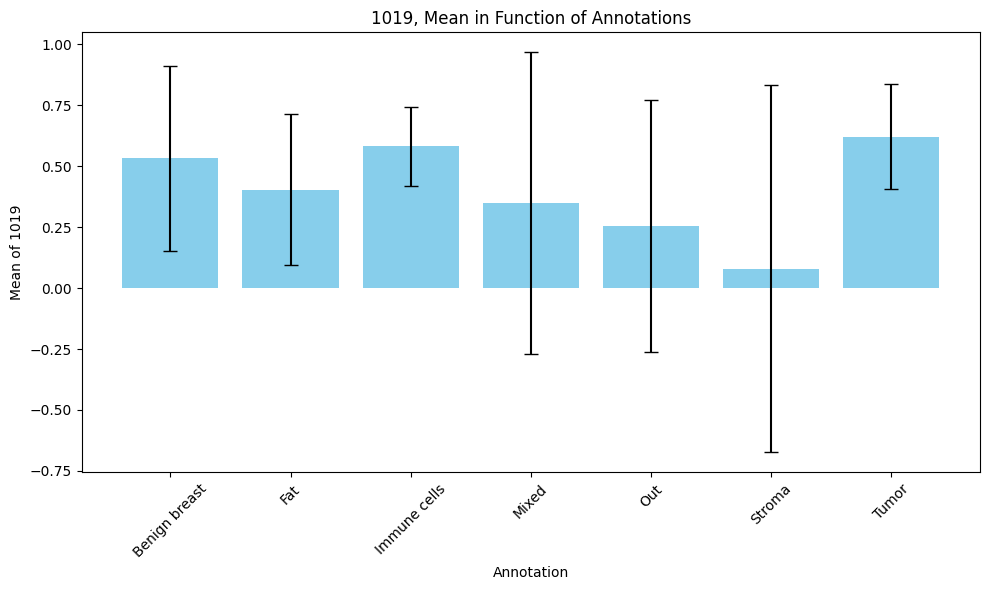

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


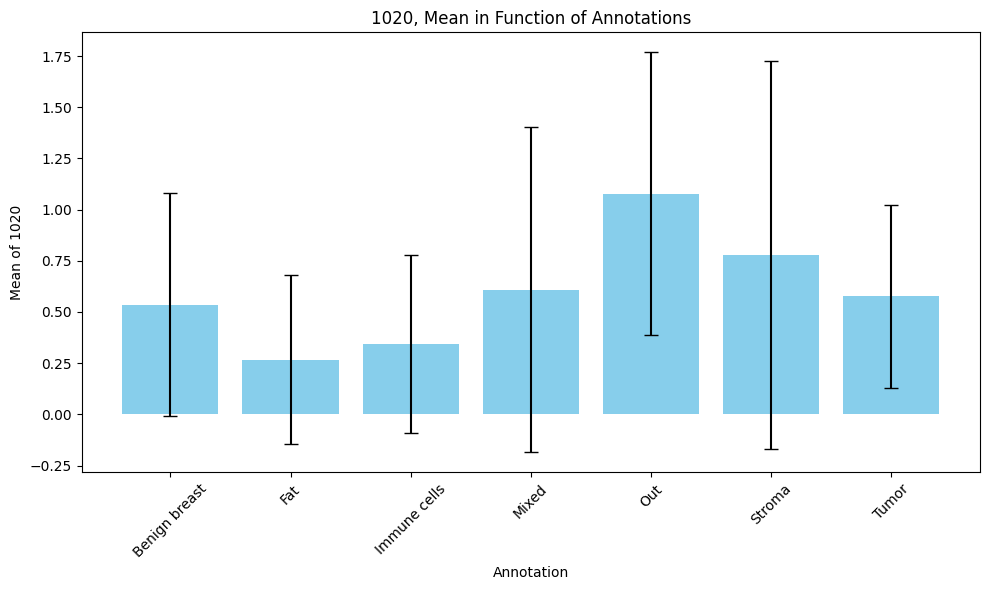

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


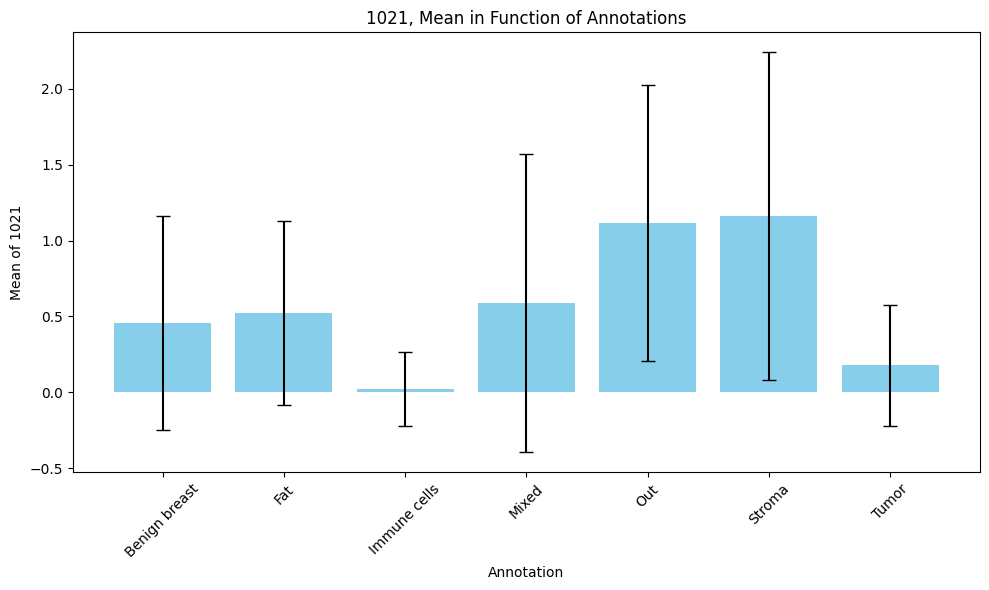

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


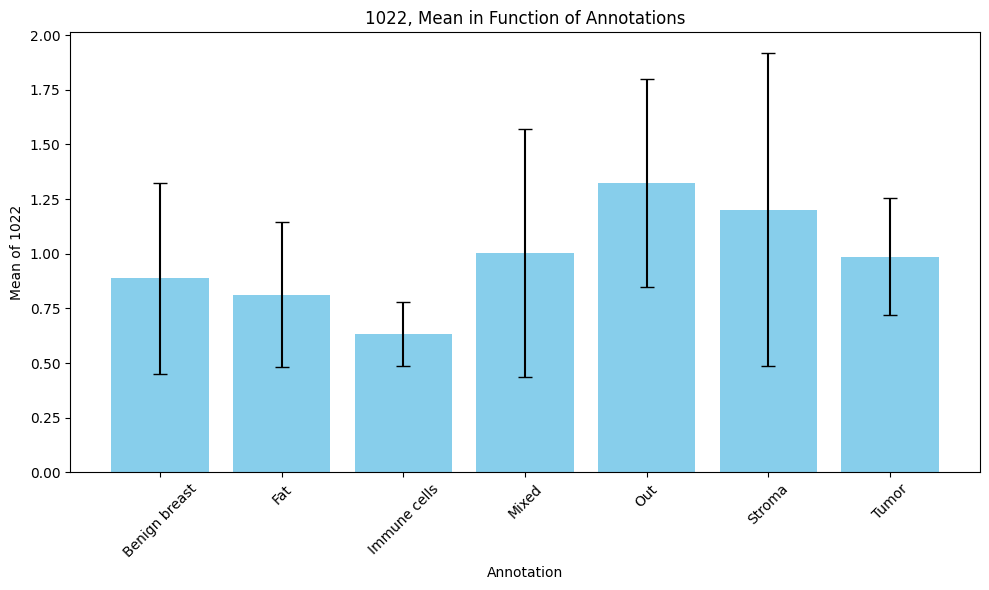

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
/tmp/ipykernel_117173/485548206.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  std_by_annotation = combined_df2.groupby('annotation')[feature].std()


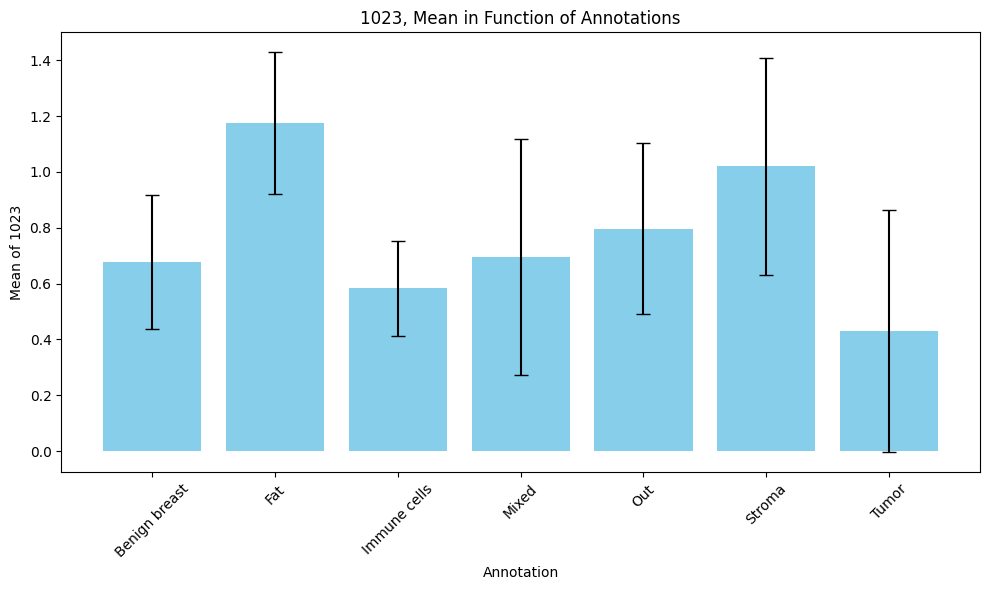

/tmp/ipykernel_117173/485548206.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()


TypeError: agg function failed [how->mean,dtype->object]

In [19]:
# Convert adata.X to a DataFrame and adata.obs to a DataFrame
data_df = pd.DataFrame(adata.X, columns=adata.var_names)
obs_df = adata.obs

# Combine the data with the information from `obs`
combined_df2 = pd.concat([data_df, obs_df.reset_index(drop=True)], axis=1)

# List of feature columns (excluding 'path' and 'annotation')
feature_columns = [col for col in combined_df2.columns if col not in ['path', 'annotation']]

# For each parameter
for feature in feature_columns:

    # Get mean and std values for each annotation
    mean_by_annotation = combined_df2.groupby('annotation')[feature].mean()
    std_by_annotation = combined_df2.groupby('annotation')[feature].std()
    
    # Convert the Series to DataFrames for easier manipulation
    mean_df = mean_by_annotation.reset_index()
    std_df = std_by_annotation.reset_index()
    
    # Merge the two DataFrames to have the means and standard deviations in the same DataFrame
    stats_df = pd.merge(mean_df, std_df, on='annotation')
    stats_df.columns = ['annotation', 'mean', 'std']
    
    # Create the bar plot with error bars
    plt.figure(figsize=(10, 6))
    plt.bar(stats_df['annotation'], stats_df['mean'], yerr=stats_df['std'], color='skyblue', capsize=5)
    plt.xlabel('Annotation')
    plt.ylabel('Mean of {}'.format(feature))
    plt.title('{}, Mean in Function of Annotations'.format(feature))
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    # Show the plot
    plt.show()